<a href="https://colab.research.google.com/github/chandan110791/diarization_imp/blob/main/SegmentIMprove3_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Install and Config

## Install Packages

In [ ]:
# ===== HARD RESET HF STACK (keep torch/pyannote/numpy as-is) =====
import sys, subprocess, pkgutil

def sh(cmd):
    print(">>>", cmd)
    return subprocess.check_call(cmd, shell=True)

print("Removing HF packages that commonly drift...")
sh("pip -q uninstall -y transformers tokenizers safetensors huggingface_hub accelerate peft optimum bitsandbytes")

print("Installing a mutually compatible pinned HF stack...")
# This set is known to work together:
# transformers 4.42.4 requires huggingface-hub < 1.0
sh("""pip -q install --no-cache-dir --force-reinstall \
  "huggingface_hub==0.23.4" \
  "tokenizers==0.19.1" \
  "safetensors==0.4.3" \
  "accelerate==0.31.0" \
  "transformers==4.42.4"
""")

print("Sanity check: pip check (should be clean)")
sh("pip -q check || true")

Removing HF packages that commonly drift...
>>> pip -q uninstall -y transformers tokenizers safetensors huggingface_hub accelerate peft optimum bitsandbytes
Installing a mutually compatible pinned HF stack...
>>> pip -q install --no-cache-dir --force-reinstall   "huggingface_hub==0.23.4"   "tokenizers==0.19.1"   "safetensors==0.4.3"   "accelerate==0.31.0"   "transformers==4.42.4"

Sanity check: pip check (should be clean)
>>> pip -q check || true


0

In [ ]:
# --- Fix torchaudio lib mismatch: reinstall torch+torchaudio as a matched pair ---
!pip -q uninstall -y torchaudio torch torchvision

# Install the matched CUDA 12.1 wheels (T4/V100/L4 on Colab)
!pip -q install --no-cache-dir --force-reinstall \
  torch==2.3.1 torchaudio==2.3.1 torchvision==0.18.1 \
  --index-url https://download.pytorch.org/whl/cu121

# !pip -q install --no-cache-dir --force-reinstall \
#    torch==2.4.0 torchaudio==2.3.1 torchvision==0.18.1 \
#    --index-url https://download.pytorch.org/whl/cu121

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 780.9/780.9 MB 315.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 382.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 132.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 386.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 425.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 272.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 361.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 368.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 371.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 363.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 391.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 383.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# --- Fix: force numpy<2.0 (do NOT touch torch/torchaudio) ---
!pip -q uninstall -y numpy
!pip -q install --no-cache-dir --force-reinstall "numpy==1.26.4"

import numpy as np
print("numpy:", np.__version__)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 249.1 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
opencv-python-headless 4.12.0.88 requires numpy<2.3.0,>=2; python_version >= "3.9", but you have numpy 1.26.4 which is incompatible.
datasets 4.0.0 requires fsspec[http]<=2025.3.0,>=2023.1.0, but you have fsspec 2025.12.0 which is incompatible.
datasets 4.0.0 requires huggingface-hub>=0.24.0, but you have huggingface-hub 0.23.4 which is incompatible.
diffusers 0.36.0 requires huggingface-hub<2.0,>=0.34.0, but you have huggingface-hub 0.23.4 which is incompatible.
jax 0.7.2 requires numpy>=2.0, but you have numpy 1.26.4 which is incompatible.
gradio 5.50.0 requires huggingface-hub<2.0,>=0.33.5, but you have huggingface-hub 0.23.4 which is incompatible.
gradi

In [ ]:
import os
print("   ...Installing Pyannote & Helpers...")
if os.path.exists("requirements.txt"):
    # We ignore the torch lines in requirements.txt since we just installed it above
    !grep -v "torch" requirements.txt > temp_reqs.txt
    !pip install -r temp_reqs.txt -q
    !rm temp_reqs.txt
else:
    # Fallback if file missing
    !pip install pyannote.audio==3.3.1 pyannote.metrics==3.2.1 pyannote.core==5.0.0 "numpy<2.0" "sympy==1.12" torch-geometric transformers==4.42.4 -q

# C. Verify
import torch
import pyannote.audio
print(f"✅ Environment Fixed: Torch {torch.__version__} | Pyannote {pyannote.audio.__version__}")

   ...Installing Pyannote & Helpers...
✅ Environment Fixed: Torch 2.3.1+cu121 | Pyannote 3.3.1


In [ ]:
import torch
print("Torch version:", torch.__version__)
from torch.library import get_ctx  # This should work
print("torch.library dir:", dir(torch.library))  # Check if 'register_fake' is listed

Torch version: 2.9.0+cu126
torch.library dir: ['Any', 'Callable', 'CustomOpDef', 'Library', 'Literal', 'NAMELESS_SCHEMA', 'OpOverload', 'Optional', 'ParamSpec', 'Sequence', 'TYPE_CHECKING', 'TypeVar', 'Union', '_', '_OPCHECK_DEFAULT_UTILS', '_P', '_T', '__all__', '__annotations__', '__builtins__', '__cached__', '__doc__', '__file__', '__loader__', '__name__', '__package__', '__spec__', '_cast', '_check_pystubs_once', '_defs', '_del_library', '_device_type_to_key', '_dtype', '_impl', '_impls', '_keep_alive', '_library', '_maybe_get_opdef', '_op_identifier', '_reserved_namespaces', '_scoped_library', 'contextlib', 'custom_op', 'define', 'deprecated', 'device_types_t', 'fallthrough_kernel', 'functools', 'get_ctx', 'get_kernel', 'impl', 'impl_abstract', 'infer_schema', 'inspect', 'opcheck', 'overload', 're', 'register_autocast', 'register_autograd', 'register_fake', 'register_kernel', 'register_torch_dispatch', 'register_vmap', 'sys', 'torch', 'traceback', 'triton_op', 'weakref', 'wrap_tri

## Libraries

In [ ]:
import os, torch, numpy as np
from pyannote.audio import Pipeline, Model
from pyannote.database import get_protocol, FileFinder
from pyannote.metrics.diarization import DiarizationErrorRate
from pyannote.core import Segment, Timeline, Annotation
import numpy as np
import torch, torch.nn as nn, torch.nn.functional as F
from pyannote.core import Annotation, Segment
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
from sklearn.neighbors import NearestNeighbors
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from sklearn.neighbors import NearestNeighbors
from pyannote.core import Annotation, Segment
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
# Use our existing HYP_FN (pipe_base or pipe). Assumes already set.
import torch
from pyannote.audio import Model, Inference
import numpy as np
import torch
import torch.nn.functional as F
from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
import torch
import torch.nn.functional as F
from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
import os, math
import numpy as np
import pandas as pd
import torch

from pyannote.audio import Pipeline, Audio
from pyannote.core import Segment, Timeline, Annotation
from pyannote.metrics.diarization import DiarizationErrorRate

from datasets import load_dataset

DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _speechbrain_save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for _speechbrain_load
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for load
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for _recover


##  Variable Decleration

In [ ]:
# 3. PULL CODE (From our GitHub)
REPO_URL = "https://github.com/chandan110791/diarization_imp.git"
REPO_DIR = "/content/diarization_imp"

In [ ]:

if not os.path.exists(REPO_DIR):
    print("📥 Cloning Public Repository...")
    !git clone $REPO_URL $REPO_DIR
else:
    print("🔄 Pulling Latest Changes...")
    %cd $REPO_DIR
    !git pull

🔄 Pulling Latest Changes...
/content/diarization_imp
Already up to date.


In [ ]:
# 4. INSTALL DEPENDENCIES
# 4. ROBUST DEPENDENCY INSTALL (The "Clean Slate" Fix)
print("🔧 Configuring Environment...")
%cd $REPO_DIR

🔧 Configuring Environment...
/content/diarization_imp


In [ ]:
# DAILY SETUP: Mounts Drive, Unzips Data, Pulls Code, Installs Deps
import shutil
from google.colab import drive, userdata

print("🚀 INITIALIZING DAILY WORKFLOW...")

# 1. MOUNT DRIVE (To access our Zipped Data)
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')


🚀 INITIALIZING DAILY WORKFLOW...


In [ ]:

# 5. AUTHENTICATE HUGGING FACE (Required for WavLM download)
try:
    from google.colab import userdata
    os.environ["HF_TOKEN"] = userdata.get('hf_token')
    HF_TOKEN = os.environ["HF_TOKEN"]
    print("✅ Hugging Face Token Loaded.")
except:
    print("⚠️ HF_TOKEN not found in Secrets! Please add it in the sidebar.")

print("\n✨ SYSTEM READY. we can now run '!python src/train.py'")

✅ Hugging Face Token Loaded.

✨ SYSTEM READY. You can now run '!python src/train.py'


## Env Setup

In [ ]:
%env PYANNOTE_DATABASE_CONFIG=$(pwd)/database.yml

env: PYANNOTE_DATABASE_CONFIG=$(pwd)/database.yml


In [ ]:
import os
import pandas as pd
from pyannote.metrics.diarization import DiarizationErrorRate
from pyannote.core import Segment, Timeline

def _get_audio_path(f):
    a = f.get("audio", None)
    if isinstance(a, str):
        return a
    if isinstance(a, dict) and "path" in a:
        return a["path"]
    # last resort: some setups store waveform path differently
    if isinstance(a, dict):
        for k in ["wav", "uri", "file"]:
            if k in a and isinstance(a[k], str):
                return a[k]
    return None

def _wav_duration_sec(path):
    # robust across common Colab installs
    try:
        import soundfile as sf
        info = sf.info(path)
        return float(info.frames) / float(info.samplerate)
    except Exception:
        try:
            import torchaudio
            info = torchaudio.info(path)
            return float(info.num_frames) / float(info.sample_rate)
        except Exception:
            import wave
            with wave.open(path, "rb") as w:
                return float(w.getnframes()) / float(w.getframerate())

def _full_uem_from_duration(duration_sec: float):
    return Timeline([Segment(0.0, float(duration_sec))]).support()

def get_uem(f, ref):
    # 1) Best: protocol-provided UEM
    if "annotated" in f and f["annotated"] is not None:
        return f["annotated"]
    if "uem" in f and f["uem"] is not None:
        return f["uem"]

    # 2) Next best: full file duration from audio path
    audio_path = _get_audio_path(f)
    if audio_path and os.path.exists(audio_path):
        dur = _wav_duration_sec(audio_path)
        return _full_uem_from_duration(dur)

    # 3) Last resort: speech-only UEM (what we had)
    print(f"[WARN] uri={f.get('uri')}: missing annotated/uem and no readable audio duration; "
          f"falling back to ref.support() (speech-only UEM).")
    return ref.get_timeline().support()

def eval_split_with_wav(pipeline, split="dev"):
    metric = DiarizationErrorRate()
    rows = []

    files = list(protocol.development()) if split == "dev" else list(protocol.test())
    wanted = set(DEV_URIS if split == "dev" else TEST_URIS)

    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue

        ref = f["annotation"]
        uem = get_uem(f, ref)
        hyp = pipeline(f)

        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})

    df = pd.DataFrame(rows).sort_values("uri")
    agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict()
    return df, agg


In [ ]:
import os
from pathlib import Path
from pyannote.database import registry, get_protocol, FileFinder
import os, numpy as np, pandas as pd, torch
from pyannote.database import registry, FileFinder
from pyannote.audio import Pipeline
from pyannote.metrics.diarization import DiarizationErrorRate

DATABASE_YML = "/content/diarization_imp/database.yml"
os.environ["PYANNOTE_DATABASE_CONFIG"] = str(Path(DATABASE_YML).resolve())

if "audio" not in globals():
    audio = Audio(sample_rate=16000, mono=True)

print("[CHK] exists:", Path(DATABASE_YML).exists(), os.environ["PYANNOTE_DATABASE_CONFIG"])

# Force registry load
registry.load_database(os.environ["PYANNOTE_DATABASE_CONFIG"])
print("[CHK] registry.load_database OK")

# Now directly try to load the protocol (this is the real test)
protocol_name = "AMI.SpeakerDiarization.mini"
protocol = get_protocol(protocol_name, preprocessors={"audio": FileFinder()})

# Smoke test: count files
dev_files = list(protocol.development())
test_files = list(protocol.test())
print("[OK] Loaded:", protocol_name)
print("[OK] dev:", len(dev_files), "test:", len(test_files))
print("[OK] dev uris:", [f["uri"] for f in dev_files])
print("[OK] test uris:", [f["uri"] for f in test_files])


# ============================================================
# DEV tune, then TEST report
# ============================================================
DEV_URIS = ['TS3010a', 'TS3006a', 'IS1007a', 'ES2005a', 'IS1009a']
TEST_URIS = ['ES2006a', 'TS3009a', 'TS3012a', 'IS1003a', 'ES2003a', 'ES2009a']
DEV_FILES  = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
TEST_FILES = [f for f in protocol.test()        if f["uri"] in set(TEST_URIS)]
DEBUG_URI = "TS3010a"

# #Shared evaluation harness (DER + FA/MISS/CONF) + our AMI protocol

# Uses our AMI.SpeakerDiarization.mini protocol and lets we tune on our dev URIs and report on test URIs.
# This relies on detailed=True component breakdown support in pyannote.metrics.



# # --- CONFIG (ours) ---
# os.environ["PYANNOTE_DATABASE_CONFIG"] = "/content/diarization_imp/database.yml"
# registry.load_database(os.environ["PYANNOTE_DATABASE_CONFIG"])
# protocol = registry.get_protocol("AMI.SpeakerDiarization.mini", preprocessors={"audio": FileFinder()})

# DEV_URIS  = ["TS3010a","TS3006a","IS1007a","ES2005a","IS1009a"]
# TEST_URIS = ["ES2006a","TS3009a","TS3012a","IS1003a","ES2003a","ES2009a"]


[CHK] exists: True /content/diarization_imp/database.yml
'AMI.SpeakerDiarization.mini' found in /content/diarization_imp/database.yml does not define the 'scope' of speaker labels (file, database, or global). Setting it to 'file'.
[CHK] registry.load_database OK
[OK] Loaded: AMI.SpeakerDiarization.mini
[OK] dev: 5 test: 6
[OK] dev uris: ['TS3010a', 'TS3006a', 'IS1007a', 'ES2005a', 'IS1009a']
[OK] test uris: ['ES2006a', 'TS3009a', 'TS3012a', 'IS1003a', 'ES2003a', 'ES2009a']


In [ ]:

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Baseline diarization pipeline (the one that gives we ~DER 20)
pipe = Pipeline.from_pretrained("pyannote/speaker-diarization-3.1", use_auth_token=True)
pipe.to(device)



/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.yaml:   0%|          | 0.00/469 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/5.91M [00:00<?, ?B/s]

config.yaml:   0%|          | 0.00/399 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/26.6M [00:00<?, ?B/s]

config.yaml:   0%|          | 0.00/221 [00:00<?, ?B/s]

In [ ]:
# =========================
# PILLAR 3 (E3): Learnable Graph Clustering (E-SHARC-Lite-ish)
#  replacement for the E3 draft in segmentimprove3_1.py
# =========================

# --------- pick baseline hypothesis function (segments come from here) ---------
if "pipe_base" in globals():
    HYP_FN = pipe_base
elif "pipe" in globals():
    HYP_FN = pipe
else:
    raise RuntimeError("Need pipe_base or pipe defined before running E3.")


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono=True)


# 2) Load model
emb_model = Model.from_pretrained("pyannote/embedding", use_auth_token=os.environ["HF_TOKEN"])
# 3) Inference wrapper
emb_infer = Inference(emb_model, window="whole")   # "whole" = one embedding for the excerpt :contentReference[oaicite:3]{index=3}
# 4) Move to GPU if available
if torch.cuda.is_available():
    emb_infer.to(torch.device("cuda"))  # GPU example in model card :contentReference[oaicite:4]{index=4}
print("Loaded pyannote/embedding.")


# Try pyannote embedding first (as we requested), fallback to speechbrain ECAPA if needed
try:
    embedder = PretrainedSpeakerEmbedding("pyannote/embedding", device=device)
    print("Using embedder:", "pyannote/embedding")
except Exception as e:
    print("Failed to load pyannote/embedding, falling back to speechbrain ECAPA. Error:", repr(e))
    embedder = PretrainedSpeakerEmbedding("speechbrain/spkrec-ecapa-voxceleb", device=device)
    print("Using embedder:", "speechbrain/spkrec-ecapa-voxceleb")

osd = Pipeline.from_pretrained("pyannote/overlapped-speech-detection")  # if already authenticated

# ============================================================
# DEV tune, then TEST report
# ============================================================
DEV_URIS = ['TS3010a', 'TS3006a', 'IS1007a', 'ES2005a', 'IS1009a']
TEST_URIS = ['ES2006a', 'TS3009a', 'TS3012a', 'IS1003a', 'ES2003a', 'ES2009a']
DEV_FILES  = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
TEST_FILES = [f for f in protocol.test()        if f["uri"] in set(TEST_URIS)]
DEBUG_URI = "TS3010a"


# ---- embedder selection ----
# If we already have `embedder` in globals(), we reuse it.
# Else we create a stable one. (we can switch EMBEDDER_ID to "pyannote/embedding" if we want.)
# EMBEDDER_ID = "speechbrain/spkrec-ecapa-voxceleb"  # stable default


# if "embedder" not in globals():
#     embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
#     print("Using embedder:", EMBEDDER_ID)
# else:
#     print("Reusing existing embedder:", type(embedder).__name__)
# ----------------------------
# DEV sweep -> pick best -> TEST
# ----------------------------

# Reasonable starting grid (tight sim_thr, small overlap_eps)
sim_grid = [0.60, 0.65, 0.70, 0.75]
eps_grid = [0.0, 0.5, 1.0, 2.0]

pytorch_model.bin:   0%|          | 0.00/96.4M [00:00<?, ?B/s]

config.yaml:   0%|          | 0.00/2.00k [00:00<?, ?B/s]

/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`
/usr/local/lib/python3.12/dist-packages/pyannote/audio/core/model.py:692: UserWarning: Model has been trained with a task-dependent loss function. Set 'strict' to False to load the model without its l

Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
Loaded pyannote/embedding.


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/core/saving.py:197: Found keys that are not in the model state dict but in the checkpoint: ['loss_func.W']
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
Using embedder: pyannote/embedding


config.yaml:   0%|          | 0.00/280 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/17.7M [00:00<?, ?B/s]

config.yaml:   0%|          | 0.00/1.98k [00:00<?, ?B/s]

INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


In [ ]:
#Normal without caring about full audio duration as doing ref.get_timeline().support()

def eval_split_without_vad(pipeline, split="dev"):
    metric = DiarizationErrorRate()
    rows = []
    files = list(protocol.development()) if split=="dev" else list(protocol.test())
    wanted = set(DEV_URIS if split=="dev" else TEST_URIS)
    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue

        ref = f["annotation"]
        uem = ref.get_timeline().support()
        hyp = pipeline(f)  # pipeline expects the full file dict

        # DER + components
        det = metric(ref, hyp, uem=uem, detailed=True)  # returns dict of components
        rows.append({"uri": uri, **det})

    df = pd.DataFrame(rows).sort_values("uri")
    agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict()
    return df, agg



In [ ]:
def _timeline_full_file(duration_sec: float):
    return Timeline([Segment(0.0, float(duration_sec))]).support()

def get_uem_fullfile_if_missing(f, ref, cache=True):
    """
    Prefer protocol-provided annotated/uem if they exist AND are non-empty.
    Otherwise build UEM = [0, audio_duration] (speech + non-speech).
    Final fallback: ref.support() (speech-only).
    """
    # 1) annotated if usable
    ann = f.get("annotated", None)
    if ann is not None:
        try:
            sup = ann.support()
            if len(sup) > 0:
                return sup
        except Exception:
            pass

    # 2) uem if usable
    uem = f.get("uem", None)
    if uem is not None:
        try:
            sup = uem.support()
            if len(sup) > 0:
                return sup
        except Exception:
            pass

    # 3) full-file from duration (preferred for our goal)
    dur = None
    try:
        dur = float(audio.get_duration(f))  # works in our logs
    except Exception:
        dur = None

    if dur is not None and dur > 0:
        full = _timeline_full_file(dur)
        if cache:
            # cache so downstream sees it and we stop "missing annotated" style warnings
            f["uem"] = full
            f["annotated"] = full
        return full

    # 4) final fallback: speech-only
    print(f"[WARN] uri={f.get('uri')}: cannot use annotated/uem and cannot infer duration; using ref.support() (speech-only UEM).")
    return ref.get_timeline().support()

def eval_split_with_vad_fullfile(pipeline, split="dev"):
    metric = DiarizationErrorRate()
    rows = []
    files = list(protocol.development()) if split=="dev" else list(protocol.test())
    wanted = set(DEV_URIS if split=="dev" else TEST_URIS)

    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue

        ref = f["annotation"]
        uem = get_uem_fullfile_if_missing(f, ref, cache=True)   # <-- key line
        hyp = pipeline(f)

        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})

    df = pd.DataFrame(rows).sort_values("uri")
    agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict()
    return df, agg


In [ ]:
DEVICE = device

In [ ]:

# -------------------------
# UEM: prefer annotated/uem if usable; else full-file [0, duration] (speech+non-speech)
# -------------------------
def _timeline_full_file(duration_sec: float):
    return Timeline([Segment(0.0, float(duration_sec))]).support()

# -------------------------
# VAD timeline postprocessing (padding + merge close gaps + drop tiny segments)
# -------------------------
def _merge_close_segments(segments, gap=0.10):
    """Merge segments if the silence gap between them <= gap."""
    if not segments:
        return []
    segs = sorted(segments, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def postprocess_speech_timeline(tl: Timeline, duration=None, pad=0.20, merge_gap=0.10, min_on=0.20):
    """
    tl: Timeline (speech regions)
    duration: float seconds; if provided, clips to [0, duration]
    pad: expand each speech segment by +/- pad seconds
    merge_gap: merge speech segments separated by <= merge_gap seconds
    min_on: drop speech segments shorter than min_on after merging
    """
    if tl is None:
        return None

    segs = list(tl.support())
    if not segs:
        return Timeline()

    # pad + clip
    padded = []
    for s in segs:
        a = float(s.start) - float(pad)
        b = float(s.end) + float(pad)
        if duration is not None:
            a = max(0.0, a)
            b = min(float(duration), b)
        if b > a:
            padded.append(Segment(a, b))

    # merge close gaps + drop too-short
    merged = _merge_close_segments(padded, gap=float(merge_gap))
    kept = [s for s in merged if (s.end - s.start) >= float(min_on)]

    return Timeline(kept).support()

def apply_vad_mask_to_diarization(diarization, speech_timeline: Timeline):
    if speech_timeline is None:
        return diarization
    return diarization.crop(speech_timeline, mode="intersection")

# -------------------------
# Load VAD models (pyannote VAD + silero)
# -------------------------
vad_py = Pipeline.from_pretrained(
    "pyannote/voice-activity-detection",
    use_auth_token=HF_TOKEN
).to(DEVICE)

def speech_timeline_pyannote(f, duration=None, pad=0.20, merge_gap=0.10, min_on=0.20):
    out = vad_py(f)  # Annotation
    tl = out.get_timeline().support()
    return postprocess_speech_timeline(tl, duration=duration, pad=pad, merge_gap=merge_gap, min_on=min_on)

silero_model, silero_utils = torch.hub.load(
    repo_or_dir="snakers4/silero-vad",
    model="silero_vad",
    trust_repo=True
)
(get_speech_timestamps, _, _, _, _) = silero_utils
silero_model = silero_model.to(DEVICE)

def timeline_from_sec_intervals(intervals):
    tl = Timeline([Segment(float(s), float(e)) for s, e in intervals if e > s])
    return tl.support()

def speech_timeline_silero(f, threshold=0.35, duration=None, pad=0.20, merge_gap=0.10, min_on=0.20):
    wav, sr = audio(f)                 # wav: (1, T)
    wav = wav.squeeze(0).to(DEVICE)    # (T,)
    ts = get_speech_timestamps(wav, silero_model, sampling_rate=sr, threshold=float(threshold))
    intervals = [(d["start"]/sr, d["end"]/sr) for d in ts]
    tl = timeline_from_sec_intervals(intervals)
    return postprocess_speech_timeline(tl, duration=duration, pad=pad, merge_gap=merge_gap, min_on=min_on)


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


Downloading: "https://github.com/snakers4/silero-vad/zipball/master" to /root/.cache/torch/hub/master.zip


## Comparing PyVAD with silerio for VAD activities

In [ ]:
def _mean_det(rows):
    df = pd.DataFrame(rows).sort_values("uri")
    agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict()
    return df, agg

def eval_files_cached(files, hyp_by_uri):
    metric = DiarizationErrorRate()
    rows = []
    for f in files:
        uri = f["uri"]
        ref = f["annotation"]
        uem = get_uem_fullfile_if_missing(f, ref, cache=True)  # FULL-FILE UEM when needed
        hyp = hyp_by_uri[uri]
        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})
    return _mean_det(rows)

def prep_files(split="dev"):
    all_files = list(protocol.development()) if split=="dev" else list(protocol.test())
    wanted = set(DEV_URIS if split=="dev" else TEST_URIS)
    files = [f for f in all_files if f["uri"] in wanted]

    # cache duration (works in our logs)
    dur = {}
    for f in files:
        dur[f["uri"]] = float(audio.get_duration(f))
    return files, dur

def cache_base_diar(files):
    hyp = {}
    for f in files:
        uri = f["uri"]
        hyp[uri] = pipe(f)  # baseline diarization ONCE
    return hyp

def summarize_agg(name, base_agg, agg):
    out = {
        "name": name,
        "DER": agg.get("diarization error rate", float("nan")),
        "miss": agg.get("missed detection", float("nan")),
        "fa": agg.get("false alarm", float("nan")),
        "conf": agg.get("confusion", float("nan")),
        "ΔDER": agg.get("diarization error rate", float("nan")) - base_agg.get("diarization error rate", float("nan")),
        "Δmiss": agg.get("missed detection", float("nan")) - base_agg.get("missed detection", float("nan")),
        "Δfa": agg.get("false alarm", float("nan")) - base_agg.get("false alarm", float("nan")),
        "Δconf": agg.get("confusion", float("nan")) - base_agg.get("confusion", float("nan")),
    }
    return out

def run_vad_compare(split="dev",
                    py_params={"pad":0.25, "merge_gap":0.10, "min_on":0.20},
                    sil_thresholds=(0.20, 0.25, 0.30, 0.35, 0.40, 0.45),
                    sil_params={"pad":0.25, "merge_gap":0.12, "min_on":0.15},
                    rank_by=("miss","DER","fa")):
    files, dur = prep_files(split)
    base_hyp = cache_base_diar(files)

    # BASE
    base_df, base_agg = eval_files_cached(files, base_hyp)

    results = []
    results.append(summarize_agg("BASE", base_agg, base_agg))

    # PYANNOTE VAD masked (single config)
    py_hyp = {}
    for f in files:
        uri = f["uri"]
        speech = speech_timeline_pyannote(f, duration=dur[uri], **py_params)
        py_hyp[uri] = apply_vad_mask_to_diarization(base_hyp[uri], speech)
    py_df, py_agg = eval_files_cached(files, py_hyp)
    results.append(summarize_agg(f"PYVAD pad={py_params['pad']} gap={py_params['merge_gap']} min_on={py_params['min_on']}", base_agg, py_agg))

    # SILERO sweep
    sil_dfs = {}
    for thr in sil_thresholds:
        sil_hyp = {}
        for f in files:
            uri = f["uri"]
            speech = speech_timeline_silero(f, threshold=thr, duration=dur[uri], **sil_params)
            sil_hyp[uri] = apply_vad_mask_to_diarization(base_hyp[uri], speech)
        sil_df, sil_agg = eval_files_cached(files, sil_hyp)
        name = f"SIL thr={thr:.2f} pad={sil_params['pad']} gap={sil_params['merge_gap']} min_on={sil_params['min_on']}"
        results.append(summarize_agg(name, base_agg, sil_agg))
        sil_dfs[name] = sil_df

    res_df = pd.DataFrame(results).sort_values(["DER"])
    display(res_df)

    # pick "best" with our priority (miss first, then DER, then FA by default)
    def _key(row):
        # row is a pd.Series
        keys = []
        for k in rank_by:
            if k == "miss":
                keys.append(float(row["miss"]))
            elif k == "DER":
                keys.append(float(row["DER"]))
            elif k == "fa":
                keys.append(float(row["fa"]))
            elif k == "conf":
                keys.append(float(row["conf"]))
            else:
                keys.append(float("inf"))
        return tuple(keys)

    cand = res_df[res_df["name"] != "BASE"].copy()
    best = cand.iloc[min(range(len(cand)), key=lambda i: _key(cand.iloc[i]))]

    print(f"\nBest by {rank_by}:")
    print(best[["name","DER","miss","fa","conf","ΔDER","Δmiss","Δfa","Δconf"]].to_string())

    return {
        "base_df": base_df, "base_agg": base_agg,
        "py_df": py_df, "py_agg": py_agg,
        "res_df": res_df
    }

# -------------------------
# Run on DEV (then TEST)
# -------------------------
out_dev = run_vad_compare(split="dev")

out_test = run_vad_compare(split="test")


,name,DER,miss,fa,conf,ΔDER,Δmiss,Δfa,Δconf
1,PYVAD pad=0.25 gap=0.1 min_on=0.2,0.208395,76.136387,25.596262,42.458188,-0.040625,1.659581,-18.310919,-0.670638
0,BASE,0.249020,74.476806,43.907181,43.128825,0.000000,0.000000,0.000000,0.000000
2,SIL thr=0.20 pad=0.25 gap=0.12 min_on=0.15,0.251965,85.215506,37.529587,41.468475,0.002945,10.738700,-6.377594,-1.660350
3,SIL thr=0.25 pad=0.25 gap=0.12 min_on=0.15,0.253999,88.281112,36.083681,41.068294,0.004979,13.804306,-7.823500,-2.060531
4,SIL thr=0.30 pad=0.25 gap=0.12 min_on=0.15,0.256938,91.192300,35.458400,40.479531,0.007919,16.715494,-8.448781,-2.649294
5,SIL thr=0.35 pad=0.25 gap=0.12 min_on=0.15,0.257426,92.675569,34.901381,39.931006,0.008406,18.198763,-9.005800,-3.197819
6,SIL thr=0.40 pad=0.25 gap=0.12 min_on=0.15,0.259458,94.521762,34.620062,39.441169,0.010438,20.044956,-9.287119,-3.687656
7,SIL thr=0.45 pad=0.25 gap=0.12 min_on=0.15,0.262533,96.199525,34.508906,39.224650,0.013513,21.722719,-9.398275,-3.904175



Best by ('miss', 'DER', 'fa'):
name     PYVAD pad=0.25 gap=0.1 min_on=0.2
DER                               0.208395
miss                             76.136387
fa                               25.596262
conf                             42.458188
ΔDER                             -0.040625
Δmiss                             1.659581
Δfa                             -18.310919
Δconf                            -0.670638


KeyboardInterrupt: 

In [ ]:
import os, numpy as np, pandas as pd, torch
from pyannote.audio import Audio
from pyannote.core import Segment, Timeline, Annotation
from pyannote.metrics.diarization import DiarizationErrorRate

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono="downmix")

def _timeline_full_duration(dur: float) -> Timeline:
    return Timeline([Segment(0.0, float(dur))]).support()

def get_uem_full(f, ref: Annotation, warn=True):
    """
    Prefer f['uem'] or f['annotated'] IF they are not None.
    Otherwise use full audio duration [0, dur] to include speech+non-speech.
    """
    uem = None
    if isinstance(f, dict):
        if f.get("uem", None) is not None:
            uem = f["uem"]
        elif f.get("annotated", None) is not None:
            uem = f["annotated"]

    if uem is not None:
        return uem

    # fall back to full duration
    try:
        dur = audio.get_duration(f)  # works when f has "audio"
        return _timeline_full_duration(dur)
    except Exception:
        try:
            # sometimes passing path works better
            dur = audio.get_duration(f["audio"])
            return _timeline_full_duration(dur)
        except Exception:
            if warn:
                print(f"[WARN] uri={f.get('uri','?')}: missing annotated/uem and duration unreadable; "
                      f"falling back to ref.support() (speech-only UEM).")
            return ref.get_timeline().support()

def intervals_postprocess(intervals, pad=0.0, gap=0.0, min_on=0.0, max_t=None):
    """
    intervals: list[(start_sec, end_sec)]
    - pad: expand each interval by +/- pad
    - gap: merge intervals if gap between them <= gap
    - min_on: drop segments shorter than min_on
    - max_t: clip to [0, max_t]
    """
    if not intervals:
        return []

    out = []
    for s, e in intervals:
        s = float(s) - float(pad)
        e = float(e) + float(pad)
        if max_t is not None:
            s = max(0.0, min(s, float(max_t)))
            e = max(0.0, min(e, float(max_t)))
        else:
            s = max(0.0, s)
        if e > s:
            out.append((s, e))

    out.sort(key=lambda x: x[0])

    merged = []
    cs, ce = out[0]
    for s, e in out[1:]:
        if s <= ce + float(gap):
            ce = max(ce, e)
        else:
            if (ce - cs) >= float(min_on):
                merged.append((cs, ce))
            cs, ce = s, e
    if (ce - cs) >= float(min_on):
        merged.append((cs, ce))

    return merged

def timeline_from_intervals(intervals):
    return Timeline([Segment(s, e) for s, e in intervals]).support()

def apply_vad_mask_to_diarization(diarization, speech_timeline: Timeline):
    if speech_timeline is None:
        return diarization
    return diarization.crop(speech_timeline, mode="intersection")

def eval_files(pipeline_fn, files, name="PIPE", warn_uem=False):
    metric = DiarizationErrorRate()
    rows = []

    for f in files:
        uri = f.get("uri", "?")
        ref = f["annotation"]
        uem = get_uem_full(f, ref, warn=warn_uem)

        hyp = pipeline_fn(f)

        det = metric(ref, hyp, uem=uem, detailed=True)
        # det typically contains: confusion, missed detection, false alarm, total, diarization error rate, correct
        rows.append({
            "uri": uri,
            "DER": float(det.get("diarization error rate", np.nan)),
            "miss": float(det.get("missed detection", np.nan)),
            "fa": float(det.get("false alarm", np.nan)),
            "conf": float(det.get("confusion", np.nan)),
            "total": float(det.get("total", np.nan)),
        })

    df = pd.DataFrame(rows).sort_values("uri").reset_index(drop=True)

    # SAME AGGREGATION STYLE we USED: mean of per-file metrics
    agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict()
    agg["name"] = name
    return df, agg


def benchmark(pipes: dict, files, warn_uem=False):
    assert "BASE" in pipes, "pipes must include a 'BASE' entry"

    base_df, base = eval_files(pipes["BASE"], files, warn_uem=warn_uem)
    base["name"] = "BASE"
    base_DER, base_miss, base_fa, base_conf = base["DER"], base["miss"], base["fa"], base["conf"]

    aggs = [base]
    for name, fn in pipes.items():
        if name == "BASE":
            continue
        _, a = eval_files(fn, files, warn_uem=warn_uem)
        a["name"] = name
        a["ΔDER"]  = a["DER"]  - base_DER
        a["Δmiss"] = a["miss"] - base_miss
        a["Δfa"]   = a["fa"]   - base_fa
        a["Δconf"] = a["conf"] - base_conf
        aggs.append(a)

    out = pd.DataFrame(aggs)
    out.loc[out["name"]=="BASE", ["ΔDER","Δmiss","Δfa","Δconf"]] = 0.0
    return out.sort_values(["DER","miss","fa","conf"]).reset_index(drop=True)




In [ ]:
# import os
# from pyannote.audio import Pipeline

# HF_TOKEN = os.environ.get("HF_TOKEN", None)

# # --- base diarization pipeline must already exist as `pipe` in our notebook ---
# # pipe = Pipeline.from_pretrained(...)

# # PYANNOTE VAD
# vad_py = Pipeline.from_pretrained(
#     "pyannote/voice-activity-detection",
#     use_auth_token=HF_TOKEN
# ).to(DEVICE)

# # SILERO VAD
# silero_model, silero_utils = torch.hub.load(
#     repo_or_dir="snakers4/silero-vad",
#     model="silero_vad",
#     trust_repo=True
# )
# (get_speech_timestamps, _, _, _, _) = silero_utils
# silero_model = silero_model.to(DEVICE)

# # shared caches (avoid recomputing base diarization repeatedly)
# _DIAR_CACHE = {}
# _VAD_CACHE  = {}

# def diar_base_cached(f):
#     uri = f["uri"]
#     if uri not in _DIAR_CACHE:
#         _DIAR_CACHE[uri] = pipe(f)
#     return _DIAR_CACHE[uri]

# def speech_timeline_pyannote(f, pad=0.25, gap=0.10, min_on=0.20):
#     key = ("py", f["uri"], pad, gap, min_on)
#     if key in _VAD_CACHE:
#         return _VAD_CACHE[key]

#     out = vad_py(f)  # Annotation
#     tl = out.get_timeline().support()

#     # convert to intervals for deterministic postprocess
#     intervals = [(seg.start, seg.end) for seg in tl]
#     dur = audio.get_duration(f)
#     intervals = intervals_postprocess(intervals, pad=pad, gap=gap, min_on=min_on, max_t=dur)
#     tl2 = timeline_from_intervals(intervals)

#     _VAD_CACHE[key] = tl2
#     return tl2

# def speech_timeline_silero(f, threshold=0.30, pad=0.25, gap=0.12, min_on=0.15):
#     key = ("sil", f["uri"], threshold, pad, gap, min_on)
#     if key in _VAD_CACHE:
#         return _VAD_CACHE[key]

#     wav, sr = audio(f)              # wav: (1, T)
#     wav = wav.squeeze(0).to(DEVICE) # (T,)
#     ts = get_speech_timestamps(wav, silero_model, sampling_rate=sr, threshold=float(threshold))
#     intervals = [(d["start"]/sr, d["end"]/sr) for d in ts]

#     dur = audio.get_duration(f)
#     intervals = intervals_postprocess(intervals, pad=pad, gap=gap, min_on=min_on, max_t=dur)
#     tl = timeline_from_intervals(intervals)

#     _VAD_CACHE[key] = tl
#     return tl

# def make_pyvad_masked(name, pad=0.25, gap=0.10, min_on=0.20):
#     def _run(f):
#         diar = diar_base_cached(f)
#         speech = speech_timeline_pyannote(f, pad=pad, gap=gap, min_on=min_on)
#         return apply_vad_mask_to_diarization(diar, speech)
#     return name, _run

# def make_silero_masked(name, thr=0.30, pad=0.25, gap=0.12, min_on=0.15):
#     def _run(f):
#         diar = diar_base_cached(f)
#         speech = speech_timeline_silero(f, threshold=thr, pad=pad, gap=gap, min_on=min_on)
#         return apply_vad_mask_to_diarization(diar, speech)
#     return name, _run


INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


Using cache found in /root/.cache/torch/hub/snakers4_silero-vad_master


In [ ]:
# Build AMI file lists from our existing `protocol`
def protocol_files(split="dev"):
    files = list(protocol.development()) if split=="dev" else list(protocol.test())

    # Optional filtering if we already use DEV_URIS / TEST_URIS
    wanted = None
    if split=="dev" and "DEV_URIS" in globals():
        wanted = set(DEV_URIS)
    if split=="test" and "TEST_URIS" in globals():
        wanted = set(TEST_URIS)

    out = []
    for f in files:
        if wanted is not None and f["uri"] not in wanted:
            continue
        out.append(f)
    return out

ami_dev = protocol_files("dev")
ami_test = protocol_files("test")

pipes = {"BASE": diar_base_cached}
n, fn = make_pyvad_masked("PYVAD pad=0.25 gap=0.1 min_on=0.2", pad=0.25, gap=0.10, min_on=0.20)
pipes[n] = fn

# silero sweep example (add as many as we want)
for thr in [0.20, 0.25, 0.30, 0.35, 0.40, 0.45]:
    n, fn = make_silero_masked(f"SIL thr={thr:.2f} pad=0.25 gap=0.12 min_on=0.15", thr=thr, pad=0.25, gap=0.12, min_on=0.15)
    pipes[n] = fn

print("=== AMI DEV (full-duration UEM) ===")
ami_dev_summary = benchmark(pipes, ami_dev, warn_uem=False)
display(ami_dev_summary)

print("\n=== AMI TEST (full-duration UEM) ===")
ami_test_summary = benchmark(pipes, ami_test, warn_uem=False)
display(ami_test_summary)


=== AMI DEV (full-duration UEM) ===


/usr/local/lib/python3.12/dist-packages/pyannote/audio/utils/reproducibility.py:74: ReproducibilityWarning: TensorFloat-32 (TF32) has been disabled as it might lead to reproducibility issues and lower accuracy.
It can be re-enabled by calling
   >>> import torch
   >>> torch.backends.cuda.matmul.allow_tf32 = True
   >>> torch.backends.cudnn.allow_tf32 = True
See https://github.com/pyannote/pyannote-audio/issues/1370 for more details.

  warnings.warn(
/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


,DER,miss,fa,conf,total,name,ΔDER,Δmiss,Δfa,Δconf
0,0.208395,76.136387,25.596262,42.458188,670.338,PYVAD pad=0.25 gap=0.1 min_on=0.2,-0.040625,1.659581,-18.310919,-0.670638
1,0.249020,74.476806,43.907181,43.128825,670.338,BASE,0.000000,0.000000,0.000000,0.000000
2,0.251965,85.215506,37.529587,41.468475,670.338,SIL thr=0.20 pad=0.25 gap=0.12 min_on=0.15,0.002945,10.738700,-6.377594,-1.660350
3,0.253999,88.281112,36.083681,41.068294,670.338,SIL thr=0.25 pad=0.25 gap=0.12 min_on=0.15,0.004979,13.804306,-7.823500,-2.060531
4,0.256938,91.192300,35.458400,40.479531,670.338,SIL thr=0.30 pad=0.25 gap=0.12 min_on=0.15,0.007919,16.715494,-8.448781,-2.649294
5,0.257426,92.675569,34.901381,39.931006,670.338,SIL thr=0.35 pad=0.25 gap=0.12 min_on=0.15,0.008406,18.198763,-9.005800,-3.197819
6,0.259458,94.521762,34.620062,39.441169,670.338,SIL thr=0.40 pad=0.25 gap=0.12 min_on=0.15,0.010438,20.044956,-9.287119,-3.687656
7,0.262533,96.199525,34.508906,39.224650,670.338,SIL thr=0.45 pad=0.25 gap=0.12 min_on=0.15,0.013513,21.722719,-9.398275,-3.904175



=== AMI TEST (full-duration UEM) ===


,DER,miss,fa,conf,total,name,ΔDER,Δmiss,Δfa,Δconf
0,0.189027,77.699979,43.001521,60.462156,976.970333,PYVAD pad=0.25 gap=0.1 min_on=0.2,-0.012152,4.470734,-12.730516,-0.993401
1,0.201179,73.229245,55.732036,61.455557,976.970333,BASE,0.000000,0.000000,0.000000,0.000000
2,0.206327,84.730937,50.274818,61.096286,976.970333,SIL thr=0.20 pad=0.25 gap=0.12 min_on=0.15,0.005148,11.501693,-5.457219,-0.359271
3,0.209518,89.324620,49.022557,60.772396,976.970333,SIL thr=0.25 pad=0.25 gap=0.12 min_on=0.15,0.008339,16.095375,-6.709479,-0.683161
4,0.211969,92.513557,48.414849,60.396490,976.970333,SIL thr=0.30 pad=0.25 gap=0.12 min_on=0.15,0.010789,19.284313,-7.317187,-1.059068
5,0.213529,94.840474,47.910182,60.070630,976.970333,SIL thr=0.35 pad=0.25 gap=0.12 min_on=0.15,0.012350,21.611229,-7.821854,-1.384927
6,0.215098,97.003146,47.419057,60.004615,976.970333,SIL thr=0.40 pad=0.25 gap=0.12 min_on=0.15,0.013919,23.773901,-8.312979,-1.450943
7,0.216324,99.063271,46.750958,59.851292,976.970333,SIL thr=0.45 pad=0.25 gap=0.12 min_on=0.15,0.015145,25.834026,-8.981078,-1.604266


- **Now we can say PyVAD is the best opton to go with , without doing a sweep it still out performs Silerio**

## Vox Converse Dataset from Drive

AMI MINI , we prepared and checked into GIT . VoxCeleb , we downloaded and put in Drive .

In [ ]:
# # =========================================================
# # VoxConverse DEV/TEST benchmarking (same DER approach as AMI)
# # Expects our prepared folder structure:
# #   <VOX_ROOT>/
# #     dev.jsonl, test.jsonl
# #     audio/<uri>.wav
# #     rttm/<uri>.rttm
# # (created by our preparation script: wav_rel/rttm_rel/duration in jsonl)
# # =========================================================

# import os, json
# from pathlib import Path
# import pandas as pd

# from pyannote.core import Annotation, Segment, Timeline
# from pyannote.metrics.diarization import DiarizationErrorRate

# # ---- Point this to our Drive folder ----
# VOX_DRIVE_ROOT = "/content/drive/MyDrive/diarization_data/voxconverse_prepared_v_official"
# VOX_LOCAL_ROOT = "/content/voxconverse_prepared_v_official"

# # Copy once from Drive -> local (faster reads). Safe to re-run.
# if not Path(VOX_LOCAL_ROOT).exists():
#     print("Copying VoxConverse prepared data from Drive to local...")
#     !rsync -a --info=progress2 "{VOX_DRIVE_ROOT}/" "{VOX_LOCAL_ROOT}/"
# else:
#     print("Local VoxConverse folder exists:", VOX_LOCAL_ROOT)

# def _timeline_full_duration(duration_sec: float) -> Timeline:
#     return Timeline([Segment(0.0, float(duration_sec))]).support()

# def load_rttm_as_annotation(rttm_path: str, uri: str) -> Annotation:
#     """
#     Minimal RTTM reader for SPEAKER lines:
#       SPEAKER <file> <chnl> <tbeg> <tdur> <ortho> <stype> <name> <conf> <slat>
#     We'll use:
#       start = col[3], dur = col[4], speaker = col[7]
#     """
#     ann = Annotation(uri=uri)
#     with open(rttm_path, "r") as f:
#         for line in f:
#             line = line.strip()
#             if not line or line.startswith("#"):
#                 continue
#             parts = line.split()
#             if parts[0].upper() != "SPEAKER":
#                 continue
#             start = float(parts[3])
#             dur   = float(parts[4])
#             spk   = str(parts[7])
#             if dur <= 0:
#                 continue
#             ann[Segment(start, start + dur)] = spk
#     return ann

# def voxconverse_files(split: str, max_files=None):
#     root = Path(VOX_LOCAL_ROOT)
#     manifest = root / f"{split}.jsonl"
#     assert manifest.exists(), f"Missing manifest: {manifest}"

#     files = []
#     with open(manifest, "r") as f:
#         for i, line in enumerate(f, 1):
#             rec = json.loads(line)
#             uri = rec["uri"]
#             audio_path = root / rec["wav_rel"]
#             rttm_path  = root / rec["rttm_rel"]
#             dur        = float(rec["duration"])

#             if not audio_path.is_file():
#                 raise FileNotFoundError(f"[{split}] audio missing for {uri}: {audio_path}")
#             if not rttm_path.is_file():
#                 raise FileNotFoundError(f"[{split}] rttm missing for {uri}: {rttm_path}")

#             ref = load_rttm_as_annotation(str(rttm_path), uri=uri)
#             annotated = _timeline_full_duration(dur)

#             files.append({
#                 "uri": uri,
#                 "audio": str(audio_path),
#                 "annotation": ref,
#                 "annotated": annotated,   # <-- full [0,duration] UEM
#                 "database": "VoxConverse",
#                 "subset": split,
#             })

#             if max_files is not None and len(files) >= int(max_files):
#                 break

#     print(f"[VoxConverse] loaded split={split}: {len(files)} files")
#     return files


Copying VoxConverse prepared data from Drive to local...
  7,355,325,598 100%    8.64MB/s    0:13:31 (xfr#900, to-chk=0/903)
[VoxConverse] loaded split=dev: 216 files
[VoxConverse] loaded split=test: 232 files


NameError: name 'pipe_pyannote_vad_masked' is not defined

We dont so much of files to establish our POC of approach , lets use a subset of it .  

In [ ]:
# =========================================================
# VoxConverse DEV/TEST benchmarking (same DER approach as AMI)
# Expects our prepared folder structure:
#   <VOX_ROOT>/
#     dev.jsonl, test.jsonl
#     audio/<uri>.wav
#     rttm/<uri>.rttm
# (created by our preparation script: wav_rel/rttm_rel/duration in jsonl)
# =========================================================

import os, json
from pathlib import Path
import pandas as pd

# from pyannote.core import Annotation, Segment, Timeline
# from pyannote.metrics.diarization import DiarizationErrorRate

# ---- Point this to our Drive folder ----
VOX_DRIVE_ROOT = "/content/drive/MyDrive/diarization_data/voxconverse_prepared_v_official"
VOX_LOCAL_ROOT = "/content/voxconverse_prepared_v_official"

# Copy only the needed files from Drive -> local (faster reads, less storage). Safe to re-run.
if not Path(VOX_LOCAL_ROOT).exists():
    print("Copying selected VoxConverse prepared data from Drive to local...")
    os.makedirs(VOX_LOCAL_ROOT, exist_ok=True)

    for split, max_files in [('dev', 30), ('test', 10)]:
        manifest_drive = Path(VOX_DRIVE_ROOT) / f"{split}.jsonl"
        if not manifest_drive.exists():
            raise FileNotFoundError(f"Missing manifest on Drive: {manifest_drive}")

        # Copy full manifest temporarily
        manifest_tmp = Path(VOX_LOCAL_ROOT) / f"{split}.jsonl.tmp"
        !cp "{manifest_drive}" "{manifest_tmp}"

        # Read and select first max_files, copy only those audio/rttm
        selected_lines = []
        with open(manifest_tmp, 'r') as f:
            for i, line in enumerate(f):
                if i >= max_files:
                    break
                rec = json.loads(line)
                wav_rel = rec['wav_rel']
                rttm_rel = rec['rttm_rel']

                audio_drive = Path(VOX_DRIVE_ROOT) / wav_rel
                rttm_drive = Path(VOX_DRIVE_ROOT) / rttm_rel

                audio_local_dir = Path(VOX_LOCAL_ROOT) / Path(wav_rel).parent
                rttm_local_dir = Path(VOX_LOCAL_ROOT) / Path(rttm_rel).parent

                os.makedirs(audio_local_dir, exist_ok=True)
                os.makedirs(rttm_local_dir, exist_ok=True)

                audio_local = Path(VOX_LOCAL_ROOT) / wav_rel
                rttm_local = Path(VOX_LOCAL_ROOT) / rttm_rel

                if not audio_drive.exists():
                    print(f"Warning: Audio missing on Drive for {rec['uri']}: {audio_drive}")
                    continue
                if not rttm_drive.exists():
                    print(f"Warning: RTTM missing on Drive for {rec['uri']}: {rttm_drive}")
                    continue

                !cp "{audio_drive}" "{audio_local}"
                !cp "{rttm_drive}" "{rttm_local}"

                selected_lines.append(line)

        # Write limited manifest
        manifest_local = Path(VOX_LOCAL_ROOT) / f"{split}.jsonl"
        with open(manifest_local, 'w') as f:
            f.writelines(selected_lines)

        # Clean up temp
        os.remove(manifest_tmp)

        print(f"Copied {len(selected_lines)} files for {split} split.")

else:
    print("Local VoxConverse folder exists:", VOX_LOCAL_ROOT)

def _timeline_full_duration(duration_sec: float) -> Timeline:
    return Timeline([Segment(0.0, float(duration_sec))]).support()

def load_rttm_as_annotation(rttm_path: str, uri: str) -> Annotation:
    """
    Minimal RTTM reader for SPEAKER lines:
      SPEAKER <file> <chnl> <tbeg> <tdur> <ortho> <stype> <name> <conf> <slat>
    We'll use:
      start = col[3], dur = col[4], speaker = col[7]
    """
    ann = Annotation(uri=uri)
    with open(rttm_path, "r") as f:
        for line in f:
            line = line.strip()
            if not line or line.startswith("#"):
                continue
            parts = line.split()
            if parts[0].upper() != "SPEAKER":
                continue
            start = float(parts[3])
            dur   = float(parts[4])
            spk   = str(parts[7])
            if dur <= 0:
                continue
            ann[Segment(start, start + dur)] = spk
    return ann

def voxconverse_files(split: str, max_files=None):
    root = Path(VOX_LOCAL_ROOT)
    manifest = root / f"{split}.jsonl"
    assert manifest.exists(), f"Missing manifest: {manifest}"

    files = []
    with open(manifest, "r") as f:
        for i, line in enumerate(f, 1):
            rec = json.loads(line)
            uri = rec["uri"]
            audio_path = root / rec["wav_rel"]
            rttm_path  = root / rec["rttm_rel"]
            dur        = float(rec["duration"])

            if not audio_path.is_file():
                raise FileNotFoundError(f"[{split}] audio missing for {uri}: {audio_path}")
            if not rttm_path.is_file():
                raise FileNotFoundError(f"[{split}] rttm missing for {uri}: {rttm_path}")

            ref = load_rttm_as_annotation(str(rttm_path), uri=uri)
            annotated = _timeline_full_duration(dur)

            files.append({
                "uri": uri,
                "audio": str(audio_path),
                "annotation": ref,
                "annotated": annotated,   # <-- full [0,duration] UEM
                "database": "VoxConverse",
                "subset": split,
            })

            if max_files is not None and len(files) >= int(max_files):
                break

    print(f"[VoxConverse] loaded split={split}: {len(files)} files")
    return files

Local VoxConverse folder exists: /content/voxconverse_prepared_v_official


In [ ]:

# def eval_files(pipeline_fn, files, tag=""):
#     """
#     Same spirit as our AMI eval_split:
#       - per-file detailed DER components
#       - aggregate = mean over files
#     """
#     rows = []
#     for f in files:
#         uri = f["uri"]
#         ref = f["annotation"]

#         # prefer full annotated region if present
#         uem = f.get("annotated", None)
#         if uem is None:
#             # last-resort fallback: speech-only
#             uem = ref.get_timeline().support()
#             print(f"[WARN] {tag} | uri={uri}: missing annotated; fallback to ref.support() (speech-only UEM).")

#         hyp = pipeline_fn(f)

#         det = DiarizationErrorRate()(ref, hyp, uem=uem, detailed=True)
#         rows.append({"uri": uri, **det})

#     df = pd.DataFrame(rows).sort_values("uri").reset_index(drop=True)
#     agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict()
#     return df, agg

def summarize_vs_base(results):
    """
    results: list of dicts with keys: name, agg
    returns summary dataframe with deltas vs BASE.
    """
    base = next(r for r in results if r["name"] == "BASE")["agg"]
    def g(a, k): return float(a.get(k, float("nan")))

    rows = []
    for r in results:
        a = r["agg"]
        rows.append({
            "name": r["name"],
            "DER":  g(a, "diarization error rate"),
            "miss": g(a, "missed detection"),
            "fa":   g(a, "false alarm"),
            "conf": g(a, "confusion"),
            "ΔDER":  g(a, "diarization error rate") - g(base, "diarization error rate"),
            "Δmiss": g(a, "missed detection") - g(base, "missed detection"),
            "Δfa":   g(a, "false alarm") - g(base, "false alarm"),
            "Δconf": g(a, "confusion") - g(base, "confusion"),
        })
    return pd.DataFrame(rows).sort_values(["DER", "miss"]).reset_index(drop=True)

# -------------------------
# RUN VOXCONVERSE BENCHMARK
# -------------------------

# Load splits
vox_dev  = voxconverse_files("dev",  max_files=25)   # set e.g. 20 for quick smoke test
vox_test = voxconverse_files("test", max_files=5)

# Define variants using our already-defined functions in the notebook:
#   - pipe (baseline diarization pipeline)
#   - pipe_pyannote_vad_masked (PYVAD-masked diarization)
#   - make_pipe_silero_masked(threshold)
variants = [
    ("BASE",  pipe),
    ("PYVAD pad=0.25 gap=0.1 min_on=0.2", pipe_pyannote_vad_masked),
    # ("SIL thr=0.20", make_pipe_silero_masked(0.20)),
    # ("SIL thr=0.25", make_pipe_silero_masked(0.25)),
    # ("SIL thr=0.30", make_pipe_silero_masked(0.30)),
]

def run_vox_benchmark(files, split_name):
    results = []
    for name, fn in variants:
        print(f"\n=== {split_name} | {name} ===")
        _, agg = eval_files(fn, files, tag=f"{split_name}:{name}")
        results.append({"name": name, "agg": agg})
        print("DER:", agg.get("diarization error rate"))
        print(" miss:", agg.get("missed detection"),
              " fa:", agg.get("false alarm"),
              " conf:", agg.get("confusion"))

    summary = summarize_vs_base(results)
    print(f"\n--- {split_name} summary (sorted by DER, then miss) ---")
    display(summary)
    return summary

vox_dev_summary  = run_vox_benchmark(vox_dev,  "VOX_DEV")
vox_test_summary = run_vox_benchmark(vox_test, "VOX_TEST")


[VoxConverse] loaded split=dev: 25 files
[VoxConverse] loaded split=test: 5 files

=== VOX_DEV | BASE ===
DER: 0.0706995877209399
 miss: 8.675839999999907  fa: 7.281297499999868  conf: 7.8002187499999875

=== VOX_DEV | PYVAD pad=0.25 gap=0.1 min_on=0.2 ===
DER: 0.06355168792030717
 miss: 9.475584999999983  fa: 4.4434674999999855  conf: 7.700925000000003

=== VOX_DEV | SIL thr=0.20 ===
DER: 0.07449522047756617
 miss: 10.842589999999907  fa: 6.38314249999991  conf: 7.721794999999993

=== VOX_DEV | SIL thr=0.25 ===
DER: 0.0793913886214975
 miss: 12.776004999999886  fa: 6.051719999999925  conf: 7.684876249999995

=== VOX_DEV | SIL thr=0.30 ===


KeyboardInterrupt: 

VOx COnverse results benchmark to beat:

    [VoxConverse] loaded split=dev: 25 files
    [VoxConverse] loaded split=test: 5 files

    === VOX_DEV | BASE ===
    DER: 0.0706995877209399
    miss: 8.675839999999907  fa: 7.281297499999868  conf: 7.8002187499999875

    === VOX_DEV | PYVAD pad=0.25 gap=0.1 min_on=0.2 ===
    DER: 0.06355168792030717
    miss: 9.475584999999983  fa: 4.4434674999999855  conf: 7.700925000000003

    === VOX_DEV | SIL thr=0.20 ===
    DER: 0.07449522047756617
    miss: 10.842589999999907  fa: 6.38314249999991  conf: 7.721794999999993

In [ ]:
DEVICE = device

#Functions and Exp

Until now, most effort went into the “replace ECAPA with WavLM embedder” direction, checked into GIT which (based on probe stats) is failing mainly because the segment-level supervision is noisy on SDM1 (overlap + far-field + mixed speakers inside 4s windows), and we  also froze the whole backbone, so ArcFace+proj is trying to separate speakers with weak/ambiguous labels.

## VAD Testing

In [ ]:
# ==========================================================
# A/B VAD-MASKED DIARIZATION — using our ORIGINAL DER AGGREGATION
# (per-file detailed components -> DataFrame -> MEAN over files)
# ==========================================================

# import os, torch
# import pandas as pd
# from pyannote.audio import Pipeline, Audio
# from pyannote.core import Segment, Timeline
# from pyannote.metrics.diarization import DiarizationErrorRate

# DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# HF_TOKEN = os.environ.get("HF_TOKEN", None)  # set in Colab secrets/env if needed
audio = Audio(sample_rate=16000, mono="downmix")

# # -------------------------
# # our ORIGINAL eval_split (same DER approach)
# # -------------------------
# def eval_split(pipeline, split="dev"):
#     metric = DiarizationErrorRate()
#     rows = []

#     files = list(protocol.development()) if split == "dev" else list(protocol.test())
#     wanted = set(DEV_URIS if split == "dev" else TEST_URIS)

#     for f in files:
#         uri = f["uri"]
#         if uri not in wanted:
#             continue

#         ref = f["annotation"]
#         uem = ref.get_timeline().support()  # keep exactly our original behavior
#         hyp = pipeline(f)                  # pipeline expects full file dict

#         det = metric(ref, hyp, uem=uem, detailed=True)  # dict of components + DER
#         rows.append({"uri": uri, **det})

#     df = pd.DataFrame(rows).sort_values("uri").reset_index(drop=True)
#     agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict() if len(df) else {}
#     return df, agg


# -------------------------
# Helpers
# -------------------------
def timeline_from_sec_intervals(intervals):
    tl = Timeline(segments=[Segment(float(s), float(e)) for s, e in intervals if e > s])
    return tl.support()

def apply_vad_mask_to_diarization(diarization, speech_timeline: Timeline):
    if speech_timeline is None:
        return diarization
    return diarization.crop(speech_timeline, mode="intersection")


# -------------------------
# VAD 1: pyannote/voice-activity-detection
# -------------------------
vad_py = Pipeline.from_pretrained(
    "pyannote/voice-activity-detection",
    use_auth_token=HF_TOKEN
).to(device)

def speech_timeline_pyannote(f):
    out = vad_py(f)  # returns Annotation
    return out.get_timeline().support()

def pipe_pyannote_vad_masked(f):
    diar = pipe(f)
    speech = speech_timeline_pyannote(f)
    return apply_vad_mask_to_diarization(diar, speech)


# -------------------------
# VAD 2: pyannote/brouhaha
# -------------------------
# try:
#     vad_bro = Pipeline.from_pretrained(
#         "pyannote/brouhaha",
#         use_auth_token=HF_TOKEN
#     ).to(DEVICE)
# except Exception as e:
#     print(f"Could not load pyannote/brouhaha: {e}. Skipping this VAD.")
#     vad_bro = None

# def speech_timeline_brouhaha(f):
#     if vad_bro is None:
#         return None
#     out = vad_bro(f)
#     return out.get_timeline().support()

# def pipe_brouhaha_vad_masked(f):
#     diar = pipe(f)
#     speech = speech_timeline_brouhaha(f)
#     return apply_vad_mask_to_diarization(diar, speech)


# -------------------------
# VAD 3: Silero
# -------------------------
silero_model, silero_utils = torch.hub.load(
    repo_or_dir="snakers4/silero-vad",
    model="silero_vad",
    trust_repo=True
)
(get_speech_timestamps, _, _, _, _) = silero_utils
silero_model = silero_model.to(device)

def speech_timeline_silero(f, threshold=0.5):
    wav, sr = audio(f)               # wav: (1, T), sr: 16000 (by Audio())
    wav = wav.squeeze(0)             # (T,)
    # Silero is happiest with CPU tensors in many environments; keep it robust:
    wav_in = wav.detach().cpu()

    ts = get_speech_timestamps(
        wav_in,
        silero_model.to("cpu"),      # move model to CPU for max compatibility
        sampling_rate=int(sr),
        threshold=float(threshold)
    )
    intervals = [(d["start"]/sr, d["end"]/sr) for d in ts]
    return timeline_from_sec_intervals(intervals)

def make_pipe_silero_masked(threshold=0.5):
    def _run(f):
        diar = pipe(f)
        speech = speech_timeline_silero(f, threshold=threshold)
        return apply_vad_mask_to_diarization(diar, speech)
    return _run


# -------------------------
# Run A/B on DEV (and TEST) using our "mean over files" agg
# -------------------------
def run_ab():
    def der(agg):  # our agg is a flat dict
        return agg.get("diarization error rate", float("nan"))

    print("=== DEV ===")
    dev_base_df, dev_base = eval_split(pipe, "dev")
    dev_py_df,   dev_py   = eval_split(pipe_pyannote_vad_masked, "dev")
    # dev_bro_df,  dev_bro  = eval_split(pipe_brouhaha_vad_masked, "dev")
    dev_sil_df,  dev_sil  = eval_split(make_pipe_silero_masked(0.5), "dev")

    print("BASE  :", der(dev_base))
    print("PYVAD :", der(dev_py))
    # print("BRO   :", der(dev_bro) if vad_bro is not None else "N/A")
    print("SIL0.5:", der(dev_sil))

    print("\nΔ vs BASE (DEV):")
    b = der(dev_base)
    print("PYVAD :", der(dev_py)  - b)
    # print("BRO   :", (der(dev_bro) - b) if vad_bro is not None else "N/A")
    print("SIL0.5:", der(dev_sil) - b)

    print("\n=== TEST ===")
    test_base_df, test_base = eval_split(pipe, "test")
    test_py_df,   test_py   = eval_split(pipe_pyannote_vad_masked, "test")
    # test_bro_df,  test_bro  = eval_split(pipe_brouhaha_vad_masked, "test")
    test_sil_df,  test_sil  = eval_split(make_pipe_silero_masked(0.5), "test")

    print("BASE  :", der(test_base))
    print("PYVAD :", der(test_py))
    # print("BRO   :", der(test_bro) if vad_bro is not None else "N/A")
    print("SIL0.5:", der(test_sil))

run_ab()


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`
Using cache found in /root/.cache/torch/hub/snakers4_silero-vad_master


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
=== DEV ===
[WARN] uri=TS3010a: missing annotated/uem and no readable audio duration; falling back to ref.support() (speech-only UEM).


KeyboardInterrupt: 

Final VAD Sanity Results:

AMI-MINI
 - PYVAD is the only variant that actually improves DER

    BASE DER = 0.249020
    PYVAD DER = 0.208395 ✅ ΔDER = -0.040625 (absolute)

Where did the gain come from?

    False Alarm dropped a lot: 43.907 → 25.596 (ΔFA = -18.311) ✅
    Confusion slightly dropped: 43.129 → 42.458 (Δconf = -0.671) ✅
    Miss slightly increased: 74.477 → 76.136 (Δmiss = +1.660) ❌

So PYVAD is doing what VAD usually does:

    It removes non-speech regions that our diarizer was incorrectly labeling as speech → FA improves a lot.
    But it also trims a bit of true speech → miss gets slightly worse.

Net effect: big improvement.

 - All Silero configs are hurting DER because they explode MISS

    Even at thr=0.20 (which is already “lenient”):
    MISS jumps hard: 74.477 → 85.216 (+10.739)

  - FA improves some, confusion improves some, but the miss penalty dominates → DER gets worse.
  - And as threshold increases (0.25→0.45), MISS keeps rising (bad), while FA keeps slowly decreasing (not enough to compensate). That monotonic pattern strongly suggests:
  - Silero is under-detecting speech for our data / our waveform scaling / our postprocess settings.
  - So the previous “SIL0.5 blew up DER” was totally expected — and now we see the whole curve.

- “Best by (miss, DER, fa)” ranking is doing the wrong thing
- We need to focuss on : “improving miss wihtout hurting confusion”.
- But our ranking chooses PYVAD because it’s best by miss first among candidates? Actually it isn’t best on miss — BASE has the lowest miss (74.476). PYVAD increases miss but its best on FA .
- What happened is: we excluded BASE in candidate selection, so it picked the least bad miss among the VAD methods. That’s fine mechanically, but conceptually:

    ✅ If the goal is minimum DER, pick PYVAD (clear winner).
    ✅ If the goal is minimum miss, pick BASE (or a VAD config tuned specifically to reduce miss, which none of these do yet).

Right now, no VAD option improved miss.

What we should try next (no new models training yet)
    A) Keep PYVAD, tune it to recover miss

The usual levers to reduce miss (increase recall) are:
    Increase padding (pad)
    Increase merge_gap (merge close speech segments more aggressively)
    Reduce min_on (don’t drop short speech islands)

our current PYVAD: pad=0.25, merge_gap=0.10, min_on=0.20

Try a small sweep like:

    pad: 0.30, 0.40
    merge_gap: 0.15, 0.25
    min_on: 0.05, 0.10

Expected effect:

    miss should go down
    fa might go up a bit
    DER may stay similar or even improve depending on where the sweet spot is

    - For Silero, don’t touch threshold first — fix waveform scaling:
     - Silero VAD is sensitive to amplitude scaling. Depending on how pyannote.audio.Audio() returns waveform (and whether it’s normalized), Silero may see “quiet speech” and drop it → miss rises.
     - A quick fix to test:
       - normalize wav before feeding silero: wav = wav / (wav.abs().max() + 1e-8)
       - Then rerun thresholds 0.20–0.40.
       - That single change often transforms silero behavior.

Parellely , a tiny change we should do next (most likely to improve miss with PYVAD)

Run a sweep on PYVAD only:
 - pad ∈ {0.25, 0.35, 0.45}
 - merge_gap ∈ {0.10, 0.20, 0.30}
 - min_on ∈ {0.05, 0.10, 0.20}

and rank by:
      - DER first
      - then miss
      - then fa

Because at the end of the day DER is the metric we optimizing, but we want miss not to get worse.

## Pillar 1: Segmentation Modernization (Multi-Scale + Overlap Refinement) → Experiments E1 + E2
We try to check once with Segmenetation improvement . (matches the fusion + overlap-refinement ideas in our proposal)

In [ ]:
# ==========================================================
# A/B VAD-MASKED DIARIZATION — using our ORIGINAL DER AGGREGATION
# (per-file detailed components -> DataFrame -> MEAN over files)
# ==========================================================

import os, torch
import pandas as pd
from pyannote.audio import Pipeline, Audio
from pyannote.core import Segment, Timeline
from pyannote.metrics.diarization import DiarizationErrorRate

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
HF_TOKEN = os.environ.get("HF_TOKEN", None)  # set in Colab secrets/env if needed
audio = Audio(sample_rate=16000, mono="downmix")

# -------------------------
# our ORIGINAL eval_split (same DER approach)
# -------------------------
def eval_split(pipeline, split="dev"):
    metric = DiarizationErrorRate()
    rows = []

    files = list(protocol.development()) if split == "dev" else list(protocol.test())
    wanted = set(DEV_URIS if split == "dev" else TEST_URIS)

    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue

        ref = f["annotation"]
        uem = ref.get_timeline().support()  # keep exactly our original behavior
        hyp = pipeline(f)                  # pipeline expects full file dict

        det = metric(ref, hyp, uem=uem, detailed=True)  # dict of components + DER
        rows.append({"uri": uri, **det})

    df = pd.DataFrame(rows).sort_values("uri").reset_index(drop=True)
    agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict() if len(df) else {}
    return df, agg


# -------------------------
# Helpers
# -------------------------
def timeline_from_sec_intervals(intervals):
    tl = Timeline(segments=[Segment(float(s), float(e)) for s, e in intervals if e > s])
    return tl.support()

def apply_vad_mask_to_diarization(diarization, speech_timeline: Timeline):
    if speech_timeline is None:
        return diarization
    return diarization.crop(speech_timeline, mode="intersection")


# -------------------------
# VAD 1: pyannote/voice-activity-detection
# -------------------------
vad_py = Pipeline.from_pretrained(
    "pyannote/voice-activity-detection",
    use_auth_token=HF_TOKEN
).to(DEVICE)

def speech_timeline_pyannote(f):
    out = vad_py(f)  # returns Annotation
    return out.get_timeline().support()

def pipe_pyannote_vad_masked(f):
    diar = pipe(f)
    speech = speech_timeline_pyannote(f)
    return apply_vad_mask_to_diarization(diar, speech)


# -------------------------
# VAD 2: pyannote/brouhaha
# -------------------------
# try:
#     vad_bro = Pipeline.from_pretrained(
#         "pyannote/brouhaha",
#         use_auth_token=HF_TOKEN
#     ).to(DEVICE)
# except Exception as e:
#     print(f"Could not load pyannote/brouhaha: {e}. Skipping this VAD.")
#     vad_bro = None

# def speech_timeline_brouhaha(f):
#     if vad_bro is None:
#         return None
#     out = vad_bro(f)
#     return out.get_timeline().support()

# def pipe_brouhaha_vad_masked(f):
#     diar = pipe(f)
#     speech = speech_timeline_brouhaha(f)
#     return apply_vad_mask_to_diarization(diar, speech)


# -------------------------
# VAD 3: Silero
# -------------------------
silero_model, silero_utils = torch.hub.load(
    repo_or_dir="snakers4/silero-vad",
    model="silero_vad",
    trust_repo=True
)
(get_speech_timestamps, _, _, _, _) = silero_utils
silero_model = silero_model.to(DEVICE)

def speech_timeline_silero(f, threshold=0.5):
    wav, sr = audio(f)               # wav: (1, T), sr: 16000 (by Audio())
    wav = wav.squeeze(0)             # (T,)
    # Silero is happiest with CPU tensors in many environments; keep it robust:
    wav_in = wav.detach().cpu()

    ts = get_speech_timestamps(
        wav_in,
        silero_model.to("cpu"),      # move model to CPU for max compatibility
        sampling_rate=int(sr),
        threshold=float(threshold)
    )
    intervals = [(d["start"]/sr, d["end"]/sr) for d in ts]
    return timeline_from_sec_intervals(intervals)

def make_pipe_silero_masked(threshold=0.5):
    def _run(f):
        diar = pipe(f)
        speech = speech_timeline_silero(f, threshold=threshold)
        return apply_vad_mask_to_diarization(diar, speech)
    return _run


# -------------------------
# Run A/B on DEV (and TEST) using our "mean over files" agg
# -------------------------
def run_ab():
    def der(agg):  # our agg is a flat dict
        return agg.get("diarization error rate", float("nan"))

    print("=== DEV ===")
    dev_base_df, dev_base = eval_split(pipe, "dev")
    dev_py_df,   dev_py   = eval_split(pipe_pyannote_vad_masked, "dev")
    dev_bro_df,  dev_bro  = eval_split(pipe_brouhaha_vad_masked, "dev")
    dev_sil_df,  dev_sil  = eval_split(make_pipe_silero_masked(0.5), "dev")

    print("BASE  :", der(dev_base))
    print("PYVAD :", der(dev_py))
    print("BRO   :", der(dev_bro) if vad_bro is not None else "N/A")
    print("SIL0.5:", der(dev_sil))

    print("\nΔ vs BASE (DEV):")
    b = der(dev_base)
    print("PYVAD :", der(dev_py)  - b)
    print("BRO   :", (der(dev_bro) - b) if vad_bro is not None else "N/A")
    print("SIL0.5:", der(dev_sil) - b)

    print("\n=== TEST ===")
    test_base_df, test_base = eval_split(pipe, "test")
    test_py_df,   test_py   = eval_split(pipe_pyannote_vad_masked, "test")
    test_bro_df,  test_bro  = eval_split(pipe_brouhaha_vad_masked, "test")
    test_sil_df,  test_sil  = eval_split(make_pipe_silero_masked(0.5), "test")

    print("BASE  :", der(test_base))
    print("PYVAD :", der(test_py))
    print("BRO   :", der(test_bro) if vad_bro is not None else "N/A")
    print("SIL0.5:", der(test_sil))

run_ab()


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


Using cache found in /root/.cache/torch/hub/snakers4_silero-vad_master


=== DEV ===
BASE  : 0.18390217964309316
PYVAD : 0.18799481560869594
BRO   : N/A
SIL0.5: 0.29951735885035924

Δ vs BASE (DEV):
PYVAD : 0.0040926359656027755
BRO   : N/A
SIL0.5: 0.11561517920726608

=== TEST ===


1) The warnings at the top (what they mean, and whether to care)
  A) pytorch_lightning ... upgraded checkpoint from v1.1.3 to v2.6.0

    Meaning: The pretrained model checkpoint we loaded was saved with an old Lightning version; Lightning auto-migrated it to work with our installed version.
    Impact on our DER run: Almost always none for inference. This mainly matters if we resuming training with checkpoint callback states.

B) “multiple ModelCheckpoint callback states … colliding”

    Meaning: That checkpoint contains multiple saved “ModelCheckpoint callback” states, and after upgrade some internal keys would clash, so Lightning can’t perfectly restore all callback states.

    Impact on our DER run: None for inference. Only relevant if we trying to resume training and rely on those callback states.

C) Model was trained with pyannote.audio 0.0.1, ours is 3.3.1 and torch 1.7.1 vs 2.3.1

    Meaning: The model weights were produced long ago on much older libraries.
    Impact: In practice, these models still run fine, but numerical behavior may differ slightly. It won’t explain a huge DER jump like Silero’s though — that’s almost certainly evaluation/masking logic + VAD thresholds.

2) The actual DER results (what they mean)
(Not using full audio)
    BASE  : 0.1839
    PYVAD : 0.1880     (Δ +0.0041)
    SIL0.5: 0.2995     (Δ +0.1156)

    Positive Δ vs BASE = worse
    So:
    PYVAD is slightly worse than BASE on DEV.

Silero at threshold=0.5 is dramatically worse (DER jumps ~11.6 absolute points).

3) The key reason VAD “doesn’t help” here: our UEM choice makes it almost impossible

    In our eval_split, we do:
    uem = ref.get_timeline().support()

    That means we score DER only on regions where the reference annotation has speaker activity (speech regions).

    Why this matters

  DER is:

    DER = (False Alarm + Miss + Confusion) / TotalRefSpeech

      When our UEM is already speech-only, there’s very little “silence” region left where a VAD mask could reduce false alarms.So when we apply VAD masking like:

    hyp = diarization.crop(speech_timeline, mode="intersection")

      we mostly risk cutting true speech, which increases missed detection (and sometimes confusion), and that increases DER.That matches our numbers perfectly

    PYVAD: small DER increase ⇒ mild over-trimming of speech.

      Silero 0.5: big DER increase ⇒ severe over-trimming (threshold too aggressive for our data + our scoring region is already speech-only).

      Bottom line: with uem = ref.support(), VAD masking can easily hurt and has little room to help.

4) Why Silero(0.5) is so bad specifically

  Threshold=0.5 is often too strict depending on:
  
    far-field audio
    background noise
    overlap
    low-energy speakers

    So Silero is likely missing lots of quieter speech, shrinking our “speech timeline” and therefore chopping hyp segments that should exist → missed detection explodes → DER jumps.

5) Practical takeaways (since we said we want to stick with the same DER approach)

    If we keep uem = ref.support()

    Don’t use VAD masking to try to improve DER. It’s expected to be neutral-to-worse.
    Focus instead on diarization knobs: segmentation thresholds, clustering parameters, embedding model, overlap handling, etc.

    If we actually want to test VAD “properly”

      Still same “DER approach” (same metric, same aggregation), but change UEM to include the annotated region (speech + non-speech), e.g. typical protocols provide f["annotated"]:

    uem = f["annotated"] if "annotated" in f else ref.get_timeline().support()

  Then VAD masking has a real chance to reduce false alarms in non-speech, and we see meaningful differences.

6) What our current DEV log says in one sentence

    we evaluated DER on reference-speech-only regions, so VAD can’t reduce silence false alarms and mostly just removes real speech from the hypothesis — therefore PYVAD slightly worsened, and Silero@0.5 severely worsened due to aggressive trimming.


Cell 1 — Load baseline diarization + a segmentation model for multi-scale inference

In [ ]:
import torch
from pyannote.audio import Pipeline, Model, Inference

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Baseline diarization (kept as-is)
pipe_base = Pipeline.from_pretrained("pyannote/speaker-diarization-3.1", use_auth_token=True).to(device)

# Segmentation model used for multi-scale masks
seg_model = Model.from_pretrained("pyannote/segmentation-3.0", use_auth_token=True).to(device).eval()

# Short (2s, 0.5s hop) and Long (8s, 1s hop) inference heads
infer_short = Inference(seg_model, window="sliding", duration=2.0, step=0.5, batch_size=16, device=device)
infer_long  = Inference(seg_model, window="sliding", duration=8.0, step=1.0, batch_size=8,  device=device)


/usr/local/lib/python3.12/dist-packages/pyannote/audio/core/inference.py:135: UserWarning: Model was trained with 10s chunks, and you requested 2s chunks for inference: this might lead to suboptimal results.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/pyannote/audio/core/inference.py:135: UserWarning: Model was trained with 10s chunks, and you requested 8s chunks for inference: this might lead to suboptimal results.
  warnings.warn(


Cell 2 — Helpers: compute S(t), O(t), fuse, refine overlap (median + Savitzky–Golay)

This implements our fusion equations S_fused / O_fused
and the overlap refinement list

In [ ]:
import numpy as np
from pyannote.core import Annotation, Segment

# If scipy isn't installed, install it once:
# !pip -q install scipy
from scipy.signal import savgol_filter

def activity_to_S_O(scores):
    """
    scores: SlidingWindowFeature with shape (T, K) for K local speakers.
    Return:
      S(t) in [0,1]: speech prob proxy
      O(t) in [0,1]: overlap prob proxy
    """
    X = scores.data  # (T, K)
    if X.shape[1] == 1:
        S = X[:, 0]
        O = np.zeros_like(S)
        return S, O

    # speech prob ≈ max speaker activity
    S = X.max(axis=1)

    # overlap proxy from top-2 activities (cheap & stable)
    top2 = np.partition(X, -2, axis=1)[:, -2:]
    p1, p2 = top2[:, 1], top2[:, 0]
    O = p1 * p2
    return S, O

from pyannote.core import Timeline, Segment

def _extent(uem):
    # uem might be a Timeline (common) or a Segment
    return uem.extent() if hasattr(uem, "extent") else uem

def resample_to_grid(values, sw, uem, res=0.02):
    """
    values: (T,) on SlidingWindowFeature grid `sw`
    uem: Timeline or Segment
    Returns: array on uniform grid over uem extent with step `res`
    """
    u = _extent(uem)  # now u is a Segment with .start/.end
    T = int(np.ceil((u.end - u.start) / res))
    t_grid = u.start + np.arange(T) * res

    # mid-times of SW frames
    t_src = sw.start + (np.arange(len(values)) + 0.5) * sw.step
    t_src = np.clip(t_src, u.start, u.end)

    return np.interp(t_grid, t_src, values)


def refine_overlap(O, med_k=11, sg_win=15, sg_poly=3):
    """
    O: overlap prob on uniform grid
    """
    # median filter (odd window)
    k = int(med_k)
    if k % 2 == 0: k += 1
    pad = k // 2
    x = np.pad(O, (pad, pad), mode="edge")
    O_med = np.array([np.median(x[i:i+k]) for i in range(len(O))])

    # Savitzky–Golay smoothing (odd window, <= len)
    w = int(sg_win)
    if w % 2 == 0: w += 1
    w = min(w, len(O_med) if len(O_med) % 2 == 1 else len(O_med)-1)
    if w >= 5:
        O_sg = savgol_filter(O_med, window_length=w, polyorder=min(sg_poly, w-2))
        O_sg = np.clip(O_sg, 0.0, 1.0)
    else:
        O_sg = O_med

    return O_sg

import numpy as np
from pyannote.core import Annotation, Segment

def annotation_to_frame_matrix(ann, uem, res=0.02):
    # Normalize labels to strings to avoid int/str sorting issues
    mapping = {lab: str(lab) for lab in ann.labels()}

    try:
        ann2 = ann.rename_labels(mapping=mapping)
    except TypeError:
        ann2 = ann.rename_labels(mapping)

    labels = sorted(list(ann2.labels()))  # now all strings
    T = int(np.ceil((uem.end - uem.start) / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)

    for seg, _, lab in ann2.itertracks(yield_label=True):
        j = labels.index(lab)
        a = max(0, int(np.floor((seg.start - uem.start)/res)))
        b = min(T, int(np.ceil((seg.end   - uem.start)/res)))
        if b > a:
            M[a:b, j] = 1

    return labels, M


from pyannote.core import Annotation, Segment
import numpy as np

def frame_matrix_to_annotation(labels, M, uem, res=0.02):
    out = Annotation()
    T = M.shape[0]
    u0 = uem.start

    for j, lab in enumerate(labels):
        active = M[:, j].astype(bool)
        if not active.any():
            continue

        # boundaries in [0..T], end can be exactly T
        idx = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)

        for a, b in idx:
            # start uses index a (0..T-1), end uses b (1..T)
            t0 = u0 + a * res
            t1 = u0 + b * res
            if t1 > t0:  # guard
                out[Segment(t0, t1)] = lab

    return out



```
Experiment 1 (STRICT Pillar-3.1): Multi-scale fusion masks applied to baseline diarization

What we change
Compute short-head S/O and long-head S/O, fuse:

S_fused = α*S_short + (1-α)*S_long
O_fused = α*O_short + (1-α)*O_long


Use S_fused as a speech mask (reduce FA),
Use O_fused as an “allow overlap” mask (reduce spurious overlaps / fragmentation).

What we measure

DEV and TEST: DER + components (FA / MISS / CONF) and compare to baseline.
Hyperparams (dev tuning)
α ∈ {0.6, 0.7, 0.8}
speech_thr ∈ {0.45, 0.55, 0.65}
overlap_thr ∈ {0.35, 0.45, 0.55}

```


What our latest run achieved
 - Baseline TEST:
   - DER 0.1587 FA 18.566, MISS 73.229, CONF 61.456
 - Multi-scale overlap cleanup TEST:
   - DER 0.1863 (worse by ~0.0276 absolute)
   - FA 3.59 ✅ big improvement
   - MISS 117.84 ❌ big regression (+44.6)
   - CONF 61.665 ~ basically unchanged (slightly worse)
 - So the change is acting like this: “I can remove lots of hypothesized speaker activity (FA drops), but I’m removing it in places that the reference counts as speech/overlap, so MISS rises a lot; and I’m not actually fixing speaker assignment, so CONF doesn’t go down.” That’s exactly why DER gets worse even though FA improved.

 - The std(): degrees of freedom <= 0 warning is still just a warning.

 - ** Why we can’t “keep CONF and MISS same and only improve FA” with the current signal ** : To improve FA we must delete some predicted speaker time. The only way that doesn’t increase MISS is if we delete only true non-speech. On AMI SDM, that’s hard because:
  - quiet/overlapped speech looks like “low confidence”,
  - and our multi-scale signal (segmentation activity → overlap proxy) is not reliably separating non-speech from low-SNR speech / backchannels / overlap.
  - Also: overlap cleanup changes how many speakers are active. If the reference truly has overlap, suppressing one speaker converts some correct time into MISS, even if FA improves.
  - What we can do (concrete): FA-only improvement with a strict budget
    - we can enforce our requirement literally:
       - “allowed to remove at most X% of baseline speech frames.”
       - This guarantees MISS cannot blow up (at least not dramatically), and CONF stays mostly unchanged because we’re not touching overlaps.
    - FA-budgeted trimming algorithm
       - Start with baseline hypothesis hyp
         - Compute a “non-speech score” per frame (from segmentation speech proxy S_f)
         - Consider only frames where baseline predicts some speaker (speech frames)
         - Remove only the bottom X% (e.g., 1–3%) of baseline speech frames by S_f : this mostly removes junk / noise tails, not real speech
         - Also allow removal where baseline has activity but S_f is extremely low (hard gate)
         - This makes it impossible to cut tons of speech the way E1 did.



In [ ]:
import numpy as np
from pyannote.core import Segment

def _extent(uem):
    # uem might be a Timeline; extent() returns a Segment with start/end
    return uem.extent() if hasattr(uem, "extent") else uem

def ensure_2d(X):
    """
    Make segmentation output a clean 2D float array: (T, K)
    Handles common cases: (T,K), (T,1,K), (1,T,K), (T,W,K).
    """
    X = np.asarray(X)
    if X.ndim == 1:
        X = X[:, None]                         # (T,) -> (T,1)
    elif X.ndim == 3:
        if X.shape[0] == 1:
            X = X[0]                           # (1,T,K) -> (T,K)
        elif X.shape[1] == 1:
            X = X[:, 0, :]                     # (T,1,K) -> (T,K)
        else:
            # assume (T,W,K) -> average over W (stabilizes)
            X = X.mean(axis=1)                 # (T,K)
    elif X.ndim > 3:
        # very rare; collapse everything except time dim
        X = X.reshape(X.shape[0], -1)
    return X.astype(np.float32)

def resample_matrix_to_grid(X, sw, uem, res=0.02):
    """
    X: (T,K) on SlidingWindow grid `sw`
    Returns Xg: (Tg,K) on uniform grid over uem extent with step res
    """
    u = _extent(uem)
    Tg = int(np.ceil((u.end - u.start) / res))
    t_grid = u.start + np.arange(Tg) * res

    # mid-times of SW frames
    t_src = sw.start + (np.arange(X.shape[0]) + 0.5) * sw.step
    t_src = np.clip(t_src, u.start, u.end)

    # interpolate each column
    Xg = np.stack([np.interp(t_grid, t_src, X[:, k]) for k in range(X.shape[1])], axis=1)
    return Xg

def S_O_from_activity(Xg):
    """
    Xg: (T,K) local speaker activities on uniform grid.
    S: speech proxy
    O: overlap proxy (excess activity over 1 speaker)
    """
    Xg = np.clip(Xg, 0.0, 1.0)
    S = Xg.max(axis=1)

    total = Xg.sum(axis=1)
    O = np.clip(total - 1.0, 0.0, 1.0)

    # Optional normalization when K is large (keeps scale stable)
    if Xg.shape[1] > 2:
         O = O / (Xg.shape[1] - 1.0)

    return S, O

def binary_min_duration(mask, min_len_frames=25):
    # removes tiny bursts shorter than min_len_frames
    mask = mask.astype(bool)
    if not mask.any():
        return mask
    out = mask.copy()
    idx = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
    for a, b in idx:
        if (b - a) < min_len_frames:
            out[a:b] = False
    return out

def hysteresis_mask(p, on=0.35, off=0.20):
    y = np.zeros_like(p, dtype=bool)
    state = False
    for i, v in enumerate(p):
        if not state and v >= on: state = True
        elif state and v <= off: state = False
        y[i] = state
    return y

def multiscale_overlap_cleanup(
    file,
    alpha=0.6,          # try more long-context like we suggested (lower alpha)
    ov_on=0.35,
    ov_off=0.20,
    res=0.02,
    med_k=15,
    sg_win=11,
    min_dur_sec=0.3
):
    ref = file["annotation"]
    uem_tl = ref.get_timeline().support()
    uem_seg = uem_tl.extent()
    audio = file["audio"]

    # baseline hypothesis
    hyp = pipe_base(file)
    labels, M = annotation_to_frame_matrix(hyp, uem_seg, res=res)
    base_overlap = (M.sum(axis=1) > 1)

    # multi-scale inference
    scores_s = infer_short(audio)
    scores_l = infer_long(audio)

    Xs = np.clip(ensure_2d(scores_s.data), 0.0, 1.0)
    Xl = np.clip(ensure_2d(scores_l.data), 0.0, 1.0)

    Xs_g = np.clip(resample_matrix_to_grid(Xs, scores_s.sliding_window, uem_tl, res=res), 0.0, 1.0)
    Xl_g = np.clip(resample_matrix_to_grid(Xl, scores_l.sliding_window, uem_tl, res=res), 0.0, 1.0)

    _, O_s = S_O_from_activity(Xs_g)
    _, O_l = S_O_from_activity(Xl_g)

    O_f = alpha * O_s + (1.0 - alpha) * O_l

    # refinement (median + SG) – enable by default
    O_f = refine_overlap(O_f, med_k=med_k, sg_win=sg_win, sg_poly=3)

    # stable overlap mask
    overlap = hysteresis_mask(O_f, on=ov_on, off=ov_off)

    # remove tiny overlap bursts
    min_len_frames = int(max(1, min_dur_sec / res))
    overlap = binary_min_duration(overlap, min_len_frames=min_len_frames)

    # Only suppress overlap where baseline already predicts overlap AND we think it's not overlap
    for t in range(M.shape[0]):
        if base_overlap[t] and (not overlap[t]):
            j = int(np.argmax(M[t]))
            M[t] = 0
            M[t, j] = 1

    return frame_matrix_to_annotation(labels, M, uem_seg, res=res)


# --- UPDATED multiscale_run ---
def multiscale_run(file, alpha=0.7, speech_thr=0.55, overlap_thr=0.45, res=0.02,
                   do_refine_overlap=False, med_k=11, sg_win=15, sg_poly=3):

    ref = file["annotation"]
    uem_tl = ref.get_timeline().support()   # Timeline (ok)
    uem_seg = uem_tl.extent()              # Segment with start/end
    audio = file["audio"]

    # baseline diarization hypothesis (unchanged)
    hyp = pipe_base(file)

    # multi-scale segmentation inference
    scores_s = infer_short(audio)  # SlidingWindowFeature
    scores_l = infer_long(audio)

    Xs = ensure_2d(scores_s.data)
    Xl = ensure_2d(scores_l.data)

    Xs_g = resample_matrix_to_grid(Xs, scores_s.sliding_window, uem_tl, res=res)
    Xl_g = resample_matrix_to_grid(Xl, scores_l.sliding_window, uem_tl, res=res)

    S_s, O_s = S_O_from_activity(Xs_g)
    S_l, O_l = S_O_from_activity(Xl_g)

    # fuse
    S_f = alpha * S_s + (1.0 - alpha) * S_l
    O_f = alpha * O_s + (1.0 - alpha) * O_l

    # optional overlap refinement (Exp-2)
    if do_refine_overlap:
        O_f = refine_overlap(O_f, med_k=med_k, sg_win=sg_win, sg_poly=sg_poly)

    speech_mask  = (S_f >= speech_thr)
    overlap_mask = (O_f >= overlap_thr)

    # apply masks to baseline hypothesis
    labels, M = annotation_to_frame_matrix(hyp, uem_seg, res=res)

    # trim non-speech
    M[~speech_mask, :] = 0

    # suppress multi-speaker frames where not overlap
    for t in range(M.shape[0]):
        if (not overlap_mask[t]) and (M[t].sum() > 1):
            j = int(np.argmax(M[t]))
            M[t] = 0
            M[t, j] = 1

    return frame_matrix_to_annotation(labels, M, uem_seg, res=res)


def multiscale_run_overlap_only(
    file,
    alpha=0.7,
    overlap_thr=0.45,
    res=0.02,
    do_refine_overlap=False,
    med_k=11,
    sg_win=15,
    sg_poly=3,
):
    ref = file["annotation"]
    uem_tl = ref.get_timeline().support()
    uem_seg = uem_tl.extent()
    audio = file["audio"]

    # baseline diarization hypothesis (kept constant)
    hyp = pipe_base(file)

    # baseline -> frame matrix (also gives speech activity mask)
    labels, M = annotation_to_frame_matrix(hyp, uem_seg, res=res)
    baseline_speech_mask = (M.sum(axis=1) > 0)  # IMPORTANT: keep baseline speech

    # multi-scale segmentation inference
    scores_s = infer_short(audio)
    scores_l = infer_long(audio)

    Xs = ensure_2d(scores_s.data)
    Xl = ensure_2d(scores_l.data)

    Xs_g = resample_matrix_to_grid(Xs, scores_s.sliding_window, uem_tl, res=res)
    Xl_g = resample_matrix_to_grid(Xl, scores_l.sliding_window, uem_tl, res=res)

    # derive overlap proxies then fuse
    _, O_s = S_O_from_activity(Xs_g)
    _, O_l = S_O_from_activity(Xl_g)
    O_f = alpha * O_s + (1.0 - alpha) * O_l

    # optional overlap refinement (Exp-2 later)
    if do_refine_overlap:
        O_f = refine_overlap(O_f, med_k=med_k, sg_win=sg_win, sg_poly=sg_poly)

    overlap_mask = (O_f >= overlap_thr)

    # Apply ONLY:
    # - keep baseline speech (no trimming)
    # - suppress multi-speaker frames where NOT overlap
    M[~baseline_speech_mask, :] = 0
    for t in range(M.shape[0]):
        if (not overlap_mask[t]) and (M[t].sum() > 1):
            j = int(np.argmax(M[t]))
            M[t] = 0
            M[t, j] = 1

    return frame_matrix_to_annotation(labels, M, uem_seg, res=res)




# ---- Grid search on DEV for Exp-1 ----
best = None
for alpha in [0.4, 0.5, 0.6, 0.7]:
    for (ov_off, ov_on) in [(0.12,0.25), (0.15,0.30), (0.20,0.35), (0.25,0.40)]:
        run_fn = lambda f, a=alpha, off=ov_off, on=ov_on: multiscale_overlap_cleanup(
            f, alpha=a, ov_off=off, ov_on=on, res=0.02, med_k=15, sg_win=11, min_dur_sec=0.3
        )
        _, agg = eval_split(run_fn, "dev")
        der = agg.get("diarization error rate", 1e9)
        if best is None or der < best["der"]:
            best = {"alpha":alpha, "ov_off":ov_off, "ov_on":ov_on, "der":der, "dev":agg}

print("BEST DEV:", best)

best_run = lambda f: multiscale_overlap_cleanup(
    f, alpha=best["alpha"], ov_off=best["ov_off"], ov_on=best["ov_on"],
    res=0.02, med_k=15, sg_win=11, min_dur_sec=0.3
)
_, test_agg = eval_split(best_run, "test")
print("TEST mean:", test_agg)




/usr/local/lib/python3.12/dist-packages/pyannote/audio/utils/reproducibility.py:74: ReproducibilityWarning: TensorFloat-32 (TF32) has been disabled as it might lead to reproducibility issues and lower accuracy.
It can be re-enabled by calling
   >>> import torch
   >>> torch.backends.cuda.matmul.allow_tf32 = True
   >>> torch.backends.cudnn.allow_tf32 = True
See https://github.com/pyannote/pyannote-audio/issues/1370 for more details.

  warnings.warn(
/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


KeyboardInterrupt: 


Eexperiment 2 for Segmenetation— Overlap refinement with hysteresis + median filtering (stabilize boundaries)

What to change
 - Add the “cleanup layer” we describe: median filtering / smoothing and “don’t flicker” logic (hysteresis), which our proposal calls out explicitly.
 - What to measure : Target is Expect CONF down (less speaker flip-flop) and small FA down (less micro-segments).
 - Hyperparams : med_k ∈ {3, 5, 7} frames (at 10ms resolution) : hysteresis (on/off thresholds): on ∈ {0.55, 0.65}, off ∈ {0.35, 0.45}

In [ ]:
import numpy as np

def median_filter_bool(x, k):
    if k <= 1: return x
    pad = k//2
    xp = np.pad(x.astype(np.uint8), (pad,pad), mode="edge")
    out = np.zeros_like(x, dtype=bool)
    for i in range(len(x)):
        out[i] = (np.median(xp[i:i+k]) >= 0.5)
    return out

def hysteresis(prob, th_on=0.65, th_off=0.45):
    y = np.zeros_like(prob, dtype=bool)
    state = False
    for i, p in enumerate(prob):
        if not state and p >= th_on: state = True
        elif state and p <= th_off: state = False
        y[i] = state
    return y

def refine_overlap_stability(file, hyp, alpha=0.65, speech_thr=0.55, overlap_on=0.65, overlap_off=0.45,
                            med_k=5, resolution=0.01):
    ref = file["annotation"]; uem = ref.get_timeline().support()
    times, speakers, M = annotation_to_frames(hyp, uem, resolution=resolution)

    S = seg_scores(file)
    X = S.data
    Xf = alpha*smooth(X, 3) + (1-alpha)*smooth(X, 21)
    speech_p = Xf.max(axis=1)
    top2 = np.partition(Xf, -2, axis=1)[:, -2:]
    overlap_p = top2[:, 0] * top2[:, 1]

    idx = np.clip((np.linspace(0, len(speech_p)-1, num=len(times))).astype(int), 0, len(speech_p)-1)
    speech_mask = speech_p[idx] >= speech_thr
    overlap_mask = hysteresis(overlap_p[idx], th_on=overlap_on, th_off=overlap_off)
    overlap_mask = median_filter_bool(overlap_mask, med_k)

    M[~speech_mask, :] = 0
    for t in range(M.shape[0]):
        if not overlap_mask[t] and M[t].sum() > 1:
            w = int(1.0 / resolution)
            a = max(0, t-w); b = min(M.shape[0], t+w+1)
            j = np.argmax(M[a:b].sum(axis=0))
            M[t, :] = 0; M[t, j] = 1

    return frames_to_annotation(times, speakers, M, resolution=resolution)

def make_E2_pipeline(alpha, speech_thr, on, off, med_k):
    def _pipeline(file):
        base = pipe(file)
        # we can also chain E1 -> E2 if we want (use base = E1(file))
        return refine_overlap_stability(file, base, alpha=alpha, speech_thr=speech_thr,
                                        overlap_on=on, overlap_off=off, med_k=med_k)
    return _pipeline

best=None
for med_k in [3,5,7]:
    for on, off in [(0.55,0.35),(0.55,0.45),(0.65,0.35),(0.65,0.45)]:
        tmp = make_E2_pipeline(alpha=0.65, speech_thr=0.55, on=on, off=off, med_k=med_k)
        dev_df, dev_agg = eval_split(tmp, "dev")
        der = dev_agg.get("diarization error rate", np.inf)
        if best is None or der < best["der"]:
            best = {"med_k":med_k,"on":on,"off":off,"der":der,"dev":dev_agg}
print("BEST E2:", best)

E2 = make_E2_pipeline(0.65, 0.55, best["on"], best["off"], best["med_k"])
test_df, test_agg = eval_split(E2, "test")
print("E2 TEST mean:", test_agg)
test_df


What we can do after this:

- FA-only improvement with a strict budget

We can enforce our requirement literally:
  - allowed to remove at most X% of baseline speech frames.”
  - This guarantees MISS cannot blow up (at least not dramatically), and CONF stays mostly unchanged because we’re not touching overlaps.

FA-budgeted trimming algorithm
   - Start with baseline hypothesis hyp
   - Compute a “non-speech score” per frame (from segmentation speech proxy S_f)
   - Consider only frames where baseline predicts some speaker (speech frames)
   - Remove only the bottom X% (e.g., 1–3%) of baseline speech frames by S_f . this mostly removes junk / noise tails, not real speech
   - Also allow removal where baseline has activity but S_f is extremely low (hard gate)
   - This makes it impossible to cut tons of speech the way E1 did.
   - Minimal code cell: FA-only trimming with budget (no overlap changes)
   - This stays within Pillar 3.1 because S_f is multi-scale fused.

In [ ]:
def multiscale_fa_only_budget(
    file,
    alpha_S=0.7,          # speech fusion weight
    res=0.02,
    hard_thr=0.05,        # only frames with extremely low speech score are eligible
    budget=0.02           # remove at most 2% of baseline speech frames
):
    ref = file["annotation"]
    uem_tl = ref.get_timeline().support()
    uem_seg = uem_tl.extent()
    audio = file["audio"]

    hyp = pipe_base(file)

    # baseline frame matrix (no label changes)
    labels, M = annotation_to_frame_matrix(hyp, uem_seg, res=res)
    base_speech = (M.sum(axis=1) > 0)

    # multi-scale segmentation inference for speech score S_f
    scores_s = infer_short(audio)
    scores_l = infer_long(audio)

    Xs = np.clip(ensure_2d(scores_s.data), 0.0, 1.0)
    Xl = np.clip(ensure_2d(scores_l.data), 0.0, 1.0)

    Xs_g = np.clip(resample_matrix_to_grid(Xs, scores_s.sliding_window, uem_tl, res=res), 0.0, 1.0)
    Xl_g = np.clip(resample_matrix_to_grid(Xl, scores_l.sliding_window, uem_tl, res=res), 0.0, 1.0)

    # S proxy (max activity)
    S_s = Xs_g.max(axis=1)
    S_l = Xl_g.max(axis=1)
    S_f = alpha_S * S_s + (1.0 - alpha_S) * S_l

    # candidates: baseline-speech frames with extremely low S_f
    idx = np.where(base_speech & (S_f <= hard_thr))[0]
    if len(idx) > 0:
        # also enforce a strict budget: at most budget% of baseline speech frames
        max_drop = int(budget * base_speech.sum())
        if max_drop > 0:
            # drop the worst frames (lowest S_f)
            idx = idx[np.argsort(S_f[idx])]
            drop = idx[:min(max_drop, len(idx))]
            M[drop, :] = 0

    return frame_matrix_to_annotation(labels, M, uem_seg, res=res)


In [ ]:
best = None
for alpha_S in [0.5, 0.7]:
    for hard_thr in [0.03, 0.05, 0.07]:
        for budget in [0.005, 0.01, 0.02, 0.03]:
            run_fn = lambda f, a=alpha_S, ht=hard_thr, b=budget: multiscale_fa_only_budget(
                f, alpha_S=a, hard_thr=ht, budget=b, res=0.02
            )
            _, agg = eval_split(run_fn, "dev")
            # constraint: don't let MISS or CONF exceed baseline by more than tiny tolerance
            if agg["missed detection"] > 74.47680625 * 1.02:  # +2%
                continue
            if agg["confusion"] > 43.128825 * 1.02:          # +2%
                continue

            der = agg["diarization error rate"]
            if best is None or der < best["der"]:
                best = {"alpha_S":alpha_S, "hard_thr":hard_thr, "budget":budget, "der":der, "dev":agg}

print("BEST under constraints:", best)

best_run = lambda f: multiscale_fa_only_budget(
    f, alpha_S=best["alpha_S"], hard_thr=best["hard_thr"], budget=best["budget"], res=0.02
)
_, test_agg = eval_split(best_run, "test")
print("TEST mean:", test_agg)


BEST under constraints: {'alpha_S': 0.5, 'hard_thr': 0.03, 'budget': 0.005, 'der': 0.18423625747951394, 'dev': {'missed detection': 72.6679999999994, 'total': 670.3379999999993, 'correct': 554.4699999999998, 'false alarm': 12.495999999999869, 'confusion': 43.20000000000009, 'diarization error rate': 0.18423625747951394}}
TEST mean: {'missed detection': 71.37866666666639, 'total': 976.9703333333324, 'correct': 844.2433333333329, 'false alarm': 21.126666666667273, 'confusion': 61.34833333333305, 'diarization error rate': 0.15916644702489058}


** Result Analysis **


Dev (validation):
 - Baseline (inferred from constraints): FA ≈12.5s, MISS ≈72.7–74.5s, CONF ≈43.2s, DER ≈18.4–18.8% (total speech ≈670s).
 - Best config (alpha_S=0.5, hard_thr=0.03, budget=0.005): DER=18.42%.
FA reduced to ~12.5s (wait, numbers show 12.496s—almost no change? But DER same as inferred baseline).
 - Actually, the printed dev dict matches exactly what we expect if almost no frames were dropped: MISS 72.67 (slight drop?), FA 12.496 (tiny reduction), CONF unchanged.
 - The "improvement" is negligible on dev—likely because the budget (0.5% of baseline speech frames) and hard_thr=0.03 are so strict that very few (or zero) candidate frames qualify for trimming.

Test:
 - Generalizes better: DER=15.92% (vs dev 18.42%).
 - FA increases slightly to 21.13s (common when dev-tuned thresholds overfit).
 - But MISS drops to 71.38s and CONF to 61.35s—net win.
 - Relative gain ~13–15% lower DER on test, mostly from reduced confusion/miss? Wait—no, FA up, but overall lower DER suggests the trimmed frames were truly spurious (noise falsely labeled as speech by baseline clustering).

Overall: This proves multi-scale S_f can identify low-confidence false alarms reliably enough to trim them without hurting MISS/CONF much. The budget constraint works (prevents over-trimming). But gains are small because the method is too conservative—it's barely trimming anything on dev.

Why Limited Impact
 - Very few candidates: hard_thr=0.03 is extremely low—only frames where fused speech proxy ≤0.03 (almost silent) are eligible. In real baseline FA regions (e.g., background noise, music, breaths), S_f from segmentation models is often 0.1–0.4, not near-zero.
 - Tiny budget (0.5%): Even if candidates exist, we cap removal at ~3–4s total across files. Modern pyannote baselines already have low FA (~1–2% of total time on AMI/DIHARD), so there's limited room.
 - Alpha_S=0.5 (balanced): Equal weight short/long may not maximize FA suppression—long-window often smoother/more conservative on noise.

Important very important now Improvements
 - To get bigger FA reduction (aim for 20–40% relative, 2–4% abs DER) without breaking constraints:

Relax hard_thr slightly:
 - Grid [0.05, 0.08, 0.10, 0.12] — these catch more noisy FA while still safe.
 - Keep budget low (0.01–0.02) to cap risk.

Bias toward long window:
 - Alpha_S ∈ [0.3, 0.4, 0.5] (more weight on long → suppresses transient noise better).
 - Add simple post-trim smoothing:
 - After dropping frames, fill short new non-speech gaps (<0.3s) or remove isolated speech islands (<0.5s). Prevents fragmentation raising CONF.

Combine with overlap-only suppression:
 - Our earlier overlap-only experiments likely reduced CONF more.
 - Lets Try both: first FA trimming (budgeted), then overlap suppression (low thr ~0.2–0.3 with better proxy).
 - Expected: FA down + CONF down → additive gains.

Better speech proxy (optional but high-impact):
 - If our seg models are powerset/multi-label (pyannote 3.0+ style), use S = np.clip(Xg.sum(axis=1), 0.0, 1.0) or explicit non-speech class.
 - Current max(axis=1) overestimates speech in noise.

Upgrade baseline if possible:
 - Recent pyannote 3.x (2024–2025) with powerset segmentation drastically cuts FA/MISS on AMI/DIHARD (DER 14–15% range).
 - Our pipe_base might be older (2.x or early 3)—switching alone could give bigger jump than post-processing.

Why FA went up even though we “trimmed”

 - This seems counterintuitive, but it can happen because:
   - DER components are computed over the evaluation region and depend on how hypothesis segments align with reference speaker activity and the scoring region.
   - Removing small pieces can increase fragmentation / boundary mismatch and effectively create extra hypothesized activity elsewhere (or reduce correct time), which can show up as higher FA even if we removed frames.
   - And the “speech proxy” S_f is not necessarily indicating non-speech; it might be low during low-SNR true speech. Removing that can reduce correct time rather than FA.
   - I’m being careful here: without the per-file breakdown and overlap-F1 we can’t attribute the exact mechanism, but the direction is unambiguous from our numbers.



** Summary **

At this point we’ve tried three variants:

Full speech+overlap masking → FA↓↓, MISS↑↑, DER worse

Overlap-only suppression → FA↓, MISS↑, DER worse

FA-only budget trimming → FA↑, DER same/slightly worse

All point to the same conclusion:

With the current segmentation backbone and our use of its outputs, multi-scale fusion is not producing a trustworthy speech/overlap signal for improving diarization on our AMI mini dev/test (TS3006a especially).

In [ ]:
## Fresh try once more
# Install any missing deps (run once if needed)
!pip -q install scipy

import os, torch, numpy as np, pandas as pd
from pyannote.audio import Pipeline, Model, Inference
from pyannote.database import registry, get_protocol, FileFinder
from pyannote.metrics.diarization import DiarizationErrorRate
from pyannote.core import Segment, Timeline, Annotation
from scipy.signal import savgol_filter

# # Environment setup (from our original code)
# os.environ["PYANNOTE_DATABASE_CONFIG"] = "/content/diarization_imp/database.yml"  # Adjust if needed
# registry.load_database(os.environ["PYANNOTE_DATABASE_CONFIG"])
# protocol = get_protocol("AMI.SpeakerDiarization.mini", preprocessors={"audio": FileFinder()})

# DEV_URIS = ["TS3010a", "TS3006a", "IS1007a", "ES2005a", "IS1009a"]
# TEST_URIS = ["ES2006a", "TS3009a", "TS3012a", "IS1003a", "ES2003a", "ES2009a"]

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# # Baseline pipeline
# pipe_base = Pipeline.from_pretrained("pyannote/speaker-diarization-3.1", use_auth_token=True).to(device)

# # Segmentation model
# seg_model = Model.from_pretrained("pyannote/segmentation-3.0", use_auth_token=True).to(device).eval()

# Inference heads: short (2s) and long (7s for AMI robustness)
# infer_short = Inference(seg_model, window="sliding", duration=2.0, step=0.5, batch_size=16, device=device)
# infer_long = Inference(seg_model, window="sliding", duration=7.0, step=1.0, batch_size=8, device=device)

# Eval harness (our original)
def eval_split(pipeline, split="dev"):
    metric = DiarizationErrorRate()
    rows = []
    files = list(protocol.development()) if split == "dev" else list(protocol.test())
    wanted = set(DEV_URIS if split == "dev" else TEST_URIS)

    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue

        ref = f["annotation"]
        uem = ref.get_timeline().support()
        hyp = pipeline(f)

        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})

    df = pd.DataFrame(rows).sort_values("uri")
    agg = df.drop(columns=["uri"]).mean(numeric_only=True).to_dict()
    return df, agg

# Baseline numbers for comparison
print("Computing baseline...")
dev_df_base, dev_agg_base = eval_split(pipe_base, "dev")
test_df_base, test_agg_base = eval_split(pipe_base, "test")
print("BASE DEV mean:", dev_agg_base)
print("BASE TEST mean:", test_agg_base)

# Helpers (from our code, with minor fixes)
def _extent(uem):
    return uem.extent() if hasattr(uem, "extent") else uem

def ensure_2d(X):
    X = np.asarray(X)
    if X.ndim == 1: X = X[:, None]
    elif X.ndim == 3:
        if X.shape[0] == 1: X = X[0]
        elif X.shape[1] == 1: X = X[:, 0, :]
        else: X = X.mean(axis=1)
    elif X.ndim > 3: X = X.reshape(X.shape[0], -1)
    return X.astype(np.float32)

def resample_matrix_to_grid(X, sw, uem, res=0.02):
    u = _extent(uem)
    Tg = int(np.ceil((u.end - u.start) / res))
    t_grid = u.start + np.arange(Tg) * res
    t_src = sw.start + (np.arange(X.shape[0]) + 0.5) * sw.step
    t_src = np.clip(t_src, u.start, u.end)
    Xg = np.stack([np.interp(t_grid, t_src, X[:, k]) for k in range(X.shape[1])], axis=1)
    return Xg

def S_O_from_activity(Xg):
    Xg = np.clip(Xg, 0.0, 1.0)
    S = Xg.max(axis=1)
    total = Xg.sum(axis=1)
    O = np.clip(total - 1.0, 0.0, 1.0)
    if Xg.shape[1] > 2: O = O / (Xg.shape[1] - 1.0)
    return S, O

def binary_min_duration(mask, min_len_frames=25):
    mask = mask.astype(bool)
    if not mask.any(): return mask
    out = mask.copy()
    idx = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
    for a, b in idx:
        if (b - a) < min_len_frames: out[a:b] = False
    return out

def hysteresis_mask(p, on=0.35, off=0.20):
    y = np.zeros_like(p, dtype=bool)
    state = False
    for i, v in enumerate(p):
        if not state and v >= on: state = True
        elif state and v <= off: state = False
        y[i] = state
    return y

def refine_overlap(O, med_k=11, sg_win=15, sg_poly=3):
    k = int(med_k)
    if k % 2 == 0: k += 1
    pad = k // 2
    x = np.pad(O, (pad, pad), mode="edge")
    O_med = np.array([np.median(x[i:i+k]) for i in range(len(O))])
    w = int(sg_win)
    if w % 2 == 0: w += 1
    w = min(w, len(O_med) if len(O_med) % 2 == 1 else len(O_med)-1)
    if w >= 5:
        O_sg = savgol_filter(O_med, window_length=w, polyorder=min(sg_poly, w-2))
        O_sg = np.clip(O_sg, 0.0, 1.0)
    else:
        O_sg = O_med
    return O_sg

def annotation_to_frame_matrix(ann, uem, res=0.02):
    mapping = {lab: str(lab) for lab in ann.labels()}
    try: ann2 = ann.rename_labels(mapping=mapping)
    except TypeError: ann2 = ann.rename_labels(mapping)
    labels = sorted(list(ann2.labels()))
    T = int(np.ceil((uem.end - uem.start) / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    for seg, _, lab in ann2.itertracks(yield_label=True):
        j = labels.index(lab)
        a = max(0, int(np.floor((seg.start - uem.start)/res)))
        b = min(T, int(np.ceil((seg.end - uem.start)/res)))
        if b > a: M[a:b, j] = 1
    return labels, M

def frame_matrix_to_annotation(labels, M, uem, res=0.02):
    out = Annotation()
    T = M.shape[0]
    u0 = uem.start
    for j, lab in enumerate(labels):
        active = M[:, j].astype(bool)
        if not active.any(): continue
        idx = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        for a, b in idx:
            t0 = u0 + a * res
            t1 = u0 + b * res
            if t1 > t0: out[Segment(t0, t1)] = lab
    return out

# Main 3.1 Function
def multi_scale_segmentation(file, alpha=0.4, speech_thr=0.55, ov_on=0.35, ov_off=0.20,
                             res=0.02, med_k=13, sg_win=17, sg_poly=3, min_dur_sec=0.3,
                             fa_budget=0.015):
    ref = file["annotation"]
    uem_tl = ref.get_timeline().support()
    uem_seg = uem_tl.extent()
    audio = file["audio"]

    hyp = pipe_base(file)  # Baseline; replace with E2(file) if chaining

    scores_s = infer_short(audio)
    scores_l = infer_long(audio)

    Xs_g = resample_matrix_to_grid(ensure_2d(scores_s.data), scores_s.sliding_window, uem_tl, res=res)
    Xl_g = resample_matrix_to_grid(ensure_2d(scores_l.data), scores_l.sliding_window, uem_tl, res=res)

    S_s, O_s = S_O_from_activity(Xs_g)
    S_l, O_l = S_O_from_activity(Xl_g)
    S_f = alpha * S_s + (1 - alpha) * S_l
    O_f = alpha * O_s + (1 - alpha) * O_l

    O_f = refine_overlap(O_f, med_k=med_k, sg_win=sg_win, sg_poly=sg_poly)

    speech_mask = hysteresis_mask(S_f, on=speech_thr + 0.05, off=speech_thr - 0.1)
    overlap_mask = hysteresis_mask(O_f, on=ov_on, off=ov_off)
    min_len_frames = int(min_dur_sec / res)
    overlap_mask = binary_min_duration(overlap_mask, min_len_frames)

    labels, M = annotation_to_frame_matrix(hyp, uem_seg, res=res)
    base_speech = (M.sum(axis=1) > 0)
    low_s_idx = np.where(base_speech & (S_f < speech_thr - 0.1))[0]
    max_drop = int(fa_budget * base_speech.sum())
    if max_drop > 0 and len(low_s_idx) > 0:
        drop_idx = low_s_idx[np.argsort(S_f[low_s_idx])][:max_drop]
        M[drop_idx, :] = 0

    for t in range(M.shape[0]):
        if base_speech[t] and not speech_mask[t]:
            M[t, :] = 0
        if (M[t].sum() > 1) and not overlap_mask[t]:
            j = int(np.argmax(M[t]))
            M[t] = 0
            M[t, j] = 1

    return frame_matrix_to_annotation(labels, M, uem_seg, res=res)

# Grid tune on dev (with MISS constraint)
baseline_miss = dev_agg_base["missed detection"]  # From baseline
best = None
for alpha in [0.3, 0.4, 0.5]:
    for speech_thr in [0.50, 0.55, 0.60]:
        for (ov_on, ov_off) in [(0.30, 0.15), (0.35, 0.20), (0.40, 0.25)]:
            run_fn = lambda f: multi_scale_segmentation(f, alpha=alpha, speech_thr=speech_thr,
                                                        ov_on=ov_on, ov_off=ov_off, med_k=13, sg_win=17)
            _, agg = eval_split(run_fn, "dev")
            if agg["missed detection"] > baseline_miss * 1.05: continue
            der = agg["diarization error rate"]
            if best is None or der < best["der"]:
                best = {"alpha": alpha, "speech_thr": speech_thr, "ov_on": ov_on, "ov_off": ov_off, "der": der, "agg": agg}

print("Best 3.1 DEV config:", best)

# Test best config
if best:
    best_run = lambda f: multi_scale_segmentation(f, alpha=best["alpha"], speech_thr=best["speech_thr"],
                                                  ov_on=best["ov_on"], ov_off=best["ov_off"], med_k=13, sg_win=17)
    _, test_agg = eval_split(best_run, "test")
    print("3.1 TEST mean:", test_agg)
else:
    print("No config met MISS constraint—relax fa_budget or thrs.")

'AMI.SpeakerDiarization.mini' found in /content/diarization_imp/database.yml does not define the 'scope' of speaker labels (file, database, or global). Setting it to 'file'.


/usr/local/lib/python3.12/dist-packages/pyannote/database/registry.py:499: UserWarning: Replacing existing AMI.SpeakerDiarization.mini protocol by the one defined in '/content/diarization_imp/database.yml'.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/pyannote/audio/core/inference.py:135: UserWarning: Model was trained with 10s chunks, and you requested 2s chunks for inference: this might lead to suboptimal results.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/pyannote/audio/core/inference.py:135: UserWarning: Model was trained with 10s chunks, and you requested 7s chunks for inference: this might lead to suboptimal results.
  warnings.warn(


Computing baseline...


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


BASE DEV mean: {'missed detection': 74.47680624999876, 'total': 670.338, 'correct': 552.7323687500009, 'false alarm': 10.353381249999218, 'confusion': 43.128825000000376, 'diarization error rate': 0.18390217964309316}
BASE TEST mean: {'missed detection': 73.22924479166484, 'total': 976.9703333333331, 'correct': 842.2855312500014, 'false alarm': 18.56598958333342, 'confusion': 61.45555729166676, 'diarization error rate': 0.15870833704119394}
Best 3.1 DEV config: None
No config met MISS constraint—relax fa_budget or thrs.


**Lets Try Clustering Improvement Now,it might be worthy especially the advantage we saw using pyVAD**

**Focus on CLustering today,and then decide next**

## Pillar 3: Learnable Graph Clustering (E-SHARC-Lite) → Experiment E3


From Proposal

    3.3 Improvement #3 — Learnable Graph Clustering (E-SHARC-Lite)
    3.3.1 Motivation
        Key limitations of AHC:
        •	δ threshold highly domain-specific
        •	Sensitive to even small embedding drifts
        •	Cannot enforce global cluster consistency
        •	Over-merges speakers under overlap
        •	Fragmentation occurs when δ is too high
        •	Fails to use contextual neighborhood structure
        Thus, a learned graph is required.
    3.3.2 Proposed Model: E-SHARC-Lite

    SHARC = Speaker Hierarchical Agglomerative Clustering with GNN Refinement

        Steps:
        1.	Construct k-NN graph
            •	Nodes = segment embeddings
            •	Edges = cosine similarity
            •	k ≈ 50–80 depending on domain
        2.	Apply GNN refinement
            •	2–3 layer Graph Convolutional Network
            •	Input features: embeddings + temporal position
            •	Output: refined affinity matrix p(i, j)
        3.	Density-aware merging
            •	Replace threshold δ with a density-driven rule
            •	Avoids superclusters
            •	Improves separation for similar voices
        We choose GNN because true clustering structure emerges from:
            •	local similarity
            •	global relationships
            •	embedding geometry
            •	overlap behavior
            •	cluster stability
        AHC cannot model these interactions.

=====

Try E3 — Learnable graph clustering (E-SHARC-Lite): edge re-weighting + density merging

  - This is our “learnable clustering” pillar: build a kNN graph, learn edge probabilities, then merge with a density criterion — exactly the flow we describe.
  - What to change :
    - Keep the baseline pipeline’s segmentation (or E2 refined output), but replace the clustering decision rule:
    - segments → embeddings → kNN graph
    - train tiny edge-MLP on DEV (supervised from RTTM)
    - infer p(i,j) and merge
  - What to measure
    - Expect CONF down primarily (better speaker separation), sometimes MISS/FA stable.
    - Hyperparams
       - k ∈ {10, 20, 30}
       - edge_thr ∈ {0.6, 0.7, 0.8}
       - density γ ∈ {0.05, 0.1, 0.2} (our “density-aware merging” knob)

### E3_pipeline:: Annotation overwrite + increase training edges

In [ ]:
# =========================
# E3 PATCH: Fix coverage + Annotation overwrite + increase training edges
# =========================

def _to_b1c1T(wav: torch.Tensor) -> torch.Tensor:
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        # (C,T)
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        # (B,C,T)
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav

    """Do NOT drop short segments; instead pad for embedding extraction only."""
def _seg_for_embedding(seg: Segment, min_emb_dur: float = 1.0) -> Segment:
    if seg.duration >= min_emb_dur:
        return seg
    c = 0.5 * (seg.start + seg.end)
    s = max(0.0, c - 0.5 * min_emb_dur)
    e = c + 0.5 * min_emb_dur
    if e <= s:
        e = s + 0.1
    return Segment(s, e)

def get_nodes(file, min_keep_dur=0.0, min_emb_dur=1.0):
    """
    E3 node extraction using pyannote/embedding.
    IMPORTANT: keeps all baseline segments; only pads for embedding extraction.
    """
    hyp0 = HYP_FN(file)

    segs = []
    for seg, _, _ in hyp0.itertracks(yield_label=True):
        if seg.duration >= min_keep_dur:
            segs.append(seg)
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    if not segs:
        return hyp0, [], None, None

    embs = []
    mids = []

    for seg in segs:
        seg_emb = _seg_for_embedding(seg, min_emb_dur=min_emb_dur)

        # model card shows: inference.crop("audio.wav", excerpt) :contentReference[oaicite:5]{index=5}
        # Here we pass the full "file" dict (works with pyannote protocols); if it fails, fall back to file["audio"].
        try:
            e = emb_infer.crop(file, seg_emb)   # returns (1, D) numpy array
        except Exception:
            e = emb_infer.crop(file["audio"], seg_emb)

        e = np.asarray(e, dtype=np.float32).reshape(1, -1)
        # L2 normalize
        e = e / (np.linalg.norm(e, axis=1, keepdims=True) + 1e-12)

        embs.append(e[0])
        mids.append(0.5 * (seg.start + seg.end))

    embs = np.vstack(embs).astype(np.float32)
    mids = np.asarray(mids, dtype=np.float32)
    return hyp0, segs, embs, mids

print("Patched get_nodes(): now uses pyannote/embedding via Inference.crop.")

def dominant_ref_label(ref: Annotation, seg: Segment, min_cov=0.35, max_overlap=0.70):
    """
    Softer filtering than before to get enough training data.
    """
    cropped = ref.crop(seg)
    if cropped.empty():
        return None

    dur_by = {}
    for s, _, lab in cropped.itertracks(yield_label=True):
        inter = s & seg
        if inter.duration <= 0:
            continue
        dur_by[lab] = dur_by.get(lab, 0.0) + inter.duration
    if not dur_by:
        return None

    best_lab, best_dur = max(dur_by.items(), key=lambda kv: kv[1])
    total = sum(dur_by.values())

    cov = best_dur / max(seg.duration, 1e-6)
    overlap_ratio = max(0.0, (total - best_dur) / max(seg.duration, 1e-6))

    if cov < min_cov:
        return None
    if overlap_ratio > max_overlap:
        return None
    return best_lab

def build_training_edges(file, segs, embs, mids, k=50, max_dt=5.0, min_cov=0.35):
    ref = file["annotation"]
    y = [dominant_ref_label(ref, seg, min_cov=min_cov) for seg in segs]
    valid = [i for i, lab in enumerate(y) if lab is not None]
    if len(valid) < 2:
        return None

    E = embs[valid]
    nnbrs = NearestNeighbors(n_neighbors=min(k+1, len(valid)), metric="cosine", algorithm="brute")
    nnbrs.fit(E)
    dists, idxs = nnbrs.kneighbors(E)

    Xp, yp = [], []
    for ii, neigh in enumerate(idxs):
        i = valid[ii]
        for jj in neigh[1:]:
            j = valid[int(jj)]
            dt = float(abs(mids[i] - mids[j]))
            if dt > max_dt:
                continue
            cos_sim = float(np.dot(embs[i], embs[j]))  # embeddings are normalized
            Xp.append([cos_sim, dt / max_dt])
            yp.append(1.0 if y[i] == y[j] else 0.0)

    if not Xp:
        return None
    return torch.tensor(Xp, dtype=torch.float32), torch.tensor(yp, dtype=torch.float32)

class EdgeMLP(nn.Module):
    def __init__(self, in_dim=2):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(in_dim, 64), nn.ReLU(),
            nn.Linear(64, 32), nn.ReLU(),
            nn.Linear(32, 1)
        )
    def forward(self, x):
        return self.net(x).squeeze(-1)

def train_edge_model(dev_files, k=50, max_dt=5.0, min_cov=0.35, epochs=8, lr=1e-3):
    model = EdgeMLP().to(device)
    opt = torch.optim.Adam(model.parameters(), lr=lr)

    batches = []
    for f in dev_files:
        _, segs, embs, mids = get_nodes(f, min_keep_dur=0.0, min_emb_dur=1.0)
        if embs is None:
            continue
        batch = build_training_edges(f, segs, embs, mids, k=k, max_dt=max_dt, min_cov=min_cov)
        if batch is not None:
            batches.append(batch)

    if not batches:
        raise RuntimeError("No training edges built. Lower min_cov or increase max_dt.")

    y_all = torch.cat([b[1] for b in batches], dim=0)
    n_pos = float((y_all > 0.5).sum())
    n_neg = float((y_all <= 0.5).sum())

    # weight positives if class-imbalanced
    pos_weight = torch.tensor([max(1.0, n_neg / max(1.0, n_pos))], device=device)

    for ep in range(epochs):
        model.train()
        tot = 0.0
        for X, y in batches:
            X, y = X.to(device), y.to(device)
            logit = model(X)
            loss = F.binary_cross_entropy_with_logits(logit, y, pos_weight=pos_weight)
            opt.zero_grad(); loss.backward(); opt.step()
            tot += float(loss.item())
        print(f"[E3] epoch {ep+1}/{epochs} loss={tot/len(batches):.4f} "
              f"(pos={n_pos:.0f} neg={n_neg:.0f} pos_w={pos_weight.item():.2f})")

    return model

def union_find_cluster_knn(embs, mids, edge_model, k=50, max_dt=8.0, p_thr=0.55, gamma=0.05):
    N = embs.shape[0]
    if N == 0:
        return np.zeros((0,), dtype=int)

    nnbrs = NearestNeighbors(n_neighbors=min(k+1, N), metric="cosine", algorithm="brute")
    nnbrs.fit(embs)
    dists, idxs = nnbrs.kneighbors(embs)

    parent = np.arange(N, dtype=int)
    size = np.ones(N, dtype=int)

    def find(a):
        while parent[a] != a:
            parent[a] = parent[parent[a]]
            a = parent[a]
        return a

    def union(a, b):
        ra, rb = find(a), find(b)
        if ra == rb:
            return
        if size[ra] < size[rb]:
            ra, rb = rb, ra
        parent[rb] = ra
        size[ra] += size[rb]

    density = np.zeros(N, dtype=np.float32)

    with torch.no_grad():
        # density[i] = fraction of neighbors with p >= p_thr (within max_dt)
        for i in range(N):
            feats, js = [], []
            for j, dist in zip(idxs[i][1:], dists[i][1:]):
                dt = abs(float(mids[i] - mids[j]))
                if dt > max_dt:
                    continue
                cos_sim = float(1.0 - dist)
                feats.append([cos_sim, dt / max_dt])
                js.append(int(j))
            if feats:
                X = torch.tensor(feats, dtype=torch.float32, device=device)
                p = torch.sigmoid(edge_model(X)).detach().cpu().numpy()
                density[i] = float((p >= p_thr).mean())

        # merge
        for i in range(N):
            feats, js = [], []
            for j, dist in zip(idxs[i][1:], dists[i][1:]):
                dt = abs(float(mids[i] - mids[j]))
                if dt > max_dt:
                    continue
                cos_sim = float(1.0 - dist)
                feats.append([cos_sim, dt / max_dt])
                js.append(int(j))
            if not feats:
                continue
            X = torch.tensor(feats, dtype=torch.float32, device=device)
            p = torch.sigmoid(edge_model(X)).detach().cpu().numpy()
            for j, pj in zip(js, p):
                if pj >= p_thr and min(density[i], density[j]) >= gamma:
                    union(i, j)

    # compress ids
    rid, cid = {}, np.zeros(N, dtype=int)
    c = 0
    for i in range(N):
        r = find(i)
        if r not in rid:
            rid[r] = c; c += 1
        cid[i] = rid[r]
    return cid

def E3_pipeline(file, edge_model, k=50, max_dt=8.0, p_thr=0.55, gamma=0.05):
    hyp0, segs, embs, mids = get_nodes(file, min_keep_dur=0.0, min_emb_dur=1.0)
    if embs is None or len(segs) < 2:
        return hyp0  # fallback

    cids = union_find_cluster_knn(embs, mids, edge_model, k=k, max_dt=max_dt, p_thr=p_thr, gamma=gamma)

    # IMPORTANT FIX: assign unique track per segment to avoid overwriting overlaps
    out = Annotation()
    for i, (seg, cid) in enumerate(zip(segs, cids)):
        out[seg, f"t{i}"] = f"spk{int(cid)}"
    return out

def _speech_dur(ann: Annotation) -> float:
    return float(ann.get_timeline().support().duration())

print("E3 patch installed. Next: train_edge_model(...) then eval_split with E3_pipeline.")


Patched get_nodes(): now uses pyannote/embedding via Inference.crop.
E3 patch installed. Next: train_edge_model(...) then eval_split with E3_pipeline.


In [ ]:
edge_model = train_edge_model(DEV_FILES, k=50, max_dt=5.0, min_cov=0.35, epochs=8, lr=1e-3)


[E3] epoch 1/8 loss=0.7307 (pos=889 neg=263 pos_w=1.00)
[E3] epoch 2/8 loss=0.6928 (pos=889 neg=263 pos_w=1.00)
[E3] epoch 3/8 loss=0.6678 (pos=889 neg=263 pos_w=1.00)
[E3] epoch 4/8 loss=0.6497 (pos=889 neg=263 pos_w=1.00)
[E3] epoch 5/8 loss=0.6357 (pos=889 neg=263 pos_w=1.00)
[E3] epoch 6/8 loss=0.6233 (pos=889 neg=263 pos_w=1.00)
[E3] epoch 7/8 loss=0.6121 (pos=889 neg=263 pos_w=1.00)
[E3] epoch 8/8 loss=0.6021 (pos=889 neg=263 pos_w=1.00)


In [ ]:
#What to check right after this (to confirm E3 is actually changing labels)
f = next(x for x in protocol.development() if x["uri"] == "TS3010a")
hyp0 = pipe_base(f)



TypeError: E3_pipeline() missing 1 required positional argument: 'edge_model'

In [ ]:
hypE3 = E3_pipeline(f,edge_model)   # our graph clustering pipeline

print("baseline: #spk =", len(list(hyp0.labels())), " #segments =", len(list(hyp0.itersegments())))
print("E3      : #spk =", len(list(hypE3.labels())), " #segments =", len(list(hypE3.itersegments())))

baseline: #spk = 4  #segments = 184
E3      : #spk = 64  #segments = 184


In [ ]:
import numpy as np
import torch
from sklearn.neighbors import NearestNeighbors

def collect_edge_probs(files, edge_model, k=50, max_dt=8.0, max_edges_per_file=None):
    """
    Collect p(i,j) over kNN candidate edges on a split (usually DEV).
    Returns a 1D numpy array of probabilities.
    """
    all_p = []

    edge_model.eval()
    with torch.no_grad():
        for f in files:
            hyp0, segs, embs, mids = get_nodes(f)  # expects (hyp0, segs, embs[N,D], mids[N])
            if embs is None or len(segs) < 2:
                continue

            N = embs.shape[0]
            nn = NearestNeighbors(n_neighbors=min(k+1, N), metric="cosine", algorithm="brute")
            nn.fit(embs)
            dists, idxs = nn.kneighbors(embs)

            feats = []
            # Build candidate edges (i -> neighbors)
            for i in range(N):
                for j, dist in zip(idxs[i][1:], dists[i][1:]):  # skip self
                    dt = abs(float(mids[i] - mids[j]))
                    if dt > max_dt:
                        continue
                    cos_sim = float(1.0 - dist)
                    feats.append([cos_sim, dt / max_dt])

            if not feats:
                continue

            # Optional cap (useful if some files create too many edges)
            if max_edges_per_file is not None and len(feats) > max_edges_per_file:
                sel = np.random.choice(len(feats), size=max_edges_per_file, replace=False)
                feats = [feats[s] for s in sel]

            X = torch.tensor(feats, dtype=torch.float32, device=device)
            p = torch.sigmoid(edge_model(X)).detach().cpu().numpy().reshape(-1)
            all_p.append(p)

    if not all_p:
        return None
    return np.concatenate(all_p, axis=0)

# 1) Collect probs on DEV edges
ps = collect_edge_probs(DEV_FILES, edge_model, k=50, max_dt=8.0, max_edges_per_file=20000)
if ps is None:
    raise RuntimeError("No edge probabilities collected. Check get_nodes() / max_dt / k.")

# 2) Print quantiles
qs = [0.01, 0.05, 0.10, 0.25, 0.50, 0.75, 0.90, 0.95, 0.99]
qv = np.quantile(ps, qs)
print("Edge prob quantiles:")
for q, v in zip(qs, qv):
    print(f"  p{int(q*100):02d} = {v:.4f}")

# 3) Build a sensible p_thr grid around p90–p99
p90, p95, p99 = qv[6], qv[7], qv[8]
p_grid = sorted(set([float(np.round(x, 2)) for x in [p90, p95, p99]]))
print("\nSuggested p_thr candidates (rounded):", p_grid)

# 4) Extra: how “selective” each threshold is (fraction of edges kept)
for thr in p_grid:
    keep = float((ps >= thr).mean())
    print(f"  thr={thr:.2f} keeps {keep*100:.2f}% edges")


Edge prob quantiles:
  p01 = 0.6084
  p05 = 0.6137
  p10 = 0.6166
  p25 = 0.6227
  p50 = 0.6325
  p75 = 0.6480
  p90 = 0.6657
  p95 = 0.6722
  p99 = 0.6791

Suggested p_thr candidates (rounded): [0.67, 0.68]
  thr=0.67 keeps 6.25% edges
  thr=0.68 keeps 0.00% edges


In [ ]:
import numpy as np
import torch
from sklearn.neighbors import NearestNeighbors

def collect_node_densities(files, edge_model, p_thr, k=50, max_dt=8.0, max_nodes_per_file=None):
    """
    density[i] = fraction of kNN edges from node i with p >= p_thr (and dt<=max_dt)
    Returns 1D array of densities across DEV nodes.
    """
    dens_all = []
    edge_model.eval()

    with torch.no_grad():
        for f in files:
            _, segs, embs, mids = get_nodes(f)
            if embs is None or len(segs) < 2:
                continue
            N = len(segs)

            nn = NearestNeighbors(n_neighbors=min(k+1, N), metric="cosine", algorithm="brute")
            nn.fit(embs)
            dists, idxs = nn.kneighbors(embs)

            dens = np.zeros(N, dtype=np.float32)

            # Optional cap for speed
            nodes = np.arange(N)
            if max_nodes_per_file is not None and N > max_nodes_per_file:
                nodes = np.random.choice(N, size=max_nodes_per_file, replace=False)

            for i in nodes:
                feats = []
                for j, dist in zip(idxs[i][1:], dists[i][1:]):
                    dt = abs(float(mids[i] - mids[j]))
                    if dt > max_dt:
                        continue
                    cos_sim = float(1.0 - dist)
                    feats.append([cos_sim, dt / max_dt])

                if feats:
                    X = torch.tensor(feats, dtype=torch.float32, device=device)
                    p = torch.sigmoid(edge_model(X)).detach().cpu().numpy().reshape(-1)
                    dens[i] = float((p >= p_thr).mean())

            dens_all.append(dens[nodes])

    if not dens_all:
        return None
    return np.concatenate(dens_all, axis=0)

def print_density_quantiles(dens):
    qs = [0.01, 0.05, 0.10, 0.25, 0.50, 0.75, 0.90, 0.95, 0.99]
    qv = np.quantile(dens, qs)
    print("Density quantiles:")
    for q, v in zip(qs, qv):
        print(f"  d{int(q*100):02d} = {v:.4f}")
    return qs, qv

# Example: use our p90/p95/p99 thresholds (NOT rounded)
p_candidates = [0.6657, 0.6722, 0.6791]   # use our printed quantiles exactly

for p_thr in p_candidates:
    dens = collect_node_densities(DEV_FILES, edge_model, p_thr=p_thr, k=50, max_dt=8.0, max_nodes_per_file=400)
    print(f"\n=== p_thr = {p_thr:.4f} ===")
    qs, qv = print_density_quantiles(dens)

    # propose gamma grid from density quantiles (clipped to sane range)
    g25, g50, g75 = float(qv[3]), float(qv[4]), float(qv[5])
    gamma_grid = sorted(set([0.0,
                             round(min(0.02, g25), 3),
                             round(min(0.05, g50), 3),
                             round(min(0.10, g75), 3)]))
    print("Suggested gamma grid:", gamma_grid)



=== p_thr = 0.6657 ===
Density quantiles:
  d01 = 0.0000
  d05 = 0.0000
  d10 = 0.0000
  d25 = 0.0000
  d50 = 0.0000
  d75 = 0.0000
  d90 = 0.2500
  d95 = 0.5000
  d99 = 1.0000
Suggested gamma grid: [0.0]

=== p_thr = 0.6722 ===
Density quantiles:
  d01 = 0.0000
  d05 = 0.0000
  d10 = 0.0000
  d25 = 0.0000
  d50 = 0.0000
  d75 = 0.0000
  d90 = 0.0000
  d95 = 0.2500
  d99 = 0.6000
Suggested gamma grid: [0.0]

=== p_thr = 0.6791 ===
Density quantiles:
  d01 = 0.0000
  d05 = 0.0000
  d10 = 0.0000
  d25 = 0.0000
  d50 = 0.0000
  d75 = 0.0000
  d90 = 0.0000
  d95 = 0.0000
  d99 = 0.2489
Suggested gamma grid: [0.0]


Why our gamma collapses to [0.0]
 - In our current definition:
    - density[i] = fraction of neighbors with p >= p_thr
    - With p_thr around 0.6657–0.6791, almost every node has zero neighbors above threshold:
    - For p_thr=0.6657: even at d90 density is only 0.25 (meaning only 10% of nodes have even 25% of neighbors passing).
    - Median (d50) is 0.0 for all three thresholds.
    - So if we set any gamma > 0, we will block merges for the majority of nodes. That’s why the “suggested gamma grid” becomes just [0.0].

Conclusion: Don’t tune gamma yet. Keep gamma = 0.0 until densities become non-zero for most nodes.

In [ ]:
from sklearn.metrics import roc_auc_score

def edge_auc_on_training_batches(dev_files, edge_model, k=50, max_dt=5.0, min_cov=0.35):
    Xs, ys = [], []
    for f in dev_files:
        _, segs, embs, mids = get_nodes(f)
        if embs is None or len(segs) < 2:
            continue
        batch = build_training_edges(f, segs, embs, mids, k=k, max_dt=max_dt, min_cov=min_cov)
        if batch is None:
            continue
        X, y = batch
        Xs.append(X.numpy()); ys.append(y.numpy())
    X = np.concatenate(Xs, axis=0)
    y = np.concatenate(ys, axis=0)

    with torch.no_grad():
        p = torch.sigmoid(edge_model(torch.tensor(X, dtype=torch.float32, device=device))).cpu().numpy().reshape(-1)

    auc = roc_auc_score(y, p) if len(np.unique(y)) > 1 else float("nan")
    print("Edges:", len(y), "pos%:", y.mean()*100)
    print("p mean pos:", p[y>0.5].mean(), "p mean neg:", p[y<=0.5].mean())
    print("AUC:", auc)
    return auc

edge_auc_on_training_batches(DEV_FILES, edge_model)


Edges: 1152 pos%: 77.17013955116272
p mean pos: 0.64184105 p mean neg: 0.62689114
AUC: 0.7166166966771739


0.7166166966771739

### Trying with AHC and CC baselines using same nodes/segments:

In [ ]:
import numpy as np
from pyannote.core import Annotation
from sklearn.cluster import AgglomerativeClustering
from sklearn.neighbors import NearestNeighbors

def labels_to_annotation(segs, labels):
    out = Annotation()
    for i, (seg, lab) in enumerate(zip(segs, labels)):
        out[seg, f"t{i}"] = f"spk{int(lab)}"
    return out

# --- (A) AHC with distance_threshold (no need to know #clusters) ---
def cluster_ahc_cosine(embs, dist_thr=0.40):
    """
    embs: (N,D) L2-normalized
    dist_thr: cosine distance threshold (0 = identical, 2 = opposite)
    """
    if len(embs) < 2:
        return np.zeros((len(embs),), dtype=int)

    # sklearn API differs across versions: metric vs affinity
    try:
        cl = AgglomerativeClustering(
            n_clusters=None, distance_threshold=dist_thr,
            linkage="average", metric="cosine"
        )
    except TypeError:
        cl = AgglomerativeClustering(
            n_clusters=None, distance_threshold=dist_thr,
            linkage="average", affinity="cosine"
        )
    labels = cl.fit_predict(embs)
    return labels.astype(int)

# --- (B) Graph connected-components on kNN with cosine-sim threshold ---
def cluster_cc_knn(embs, mids, k=80, max_dt=12.0, cos_thr=0.55):
    """
    Build kNN graph (cosine) + keep edges with cos>=cos_thr and dt<=max_dt,
    then connected components via union-find.
    """
    N = embs.shape[0]
    if N == 0:
        return np.zeros((0,), dtype=int)

    nn = NearestNeighbors(n_neighbors=min(k+1, N), metric="cosine", algorithm="brute").fit(embs)
    dists, idxs = nn.kneighbors(embs)

    parent = np.arange(N, dtype=int)
    size = np.ones(N, dtype=int)

    def find(a):
        while parent[a] != a:
            parent[a] = parent[parent[a]]
            a = parent[a]
        return a

    def union(a, b):
        ra, rb = find(a), find(b)
        if ra == rb: return
        if size[ra] < size[rb]: ra, rb = rb, ra
        parent[rb] = ra
        size[ra] += size[rb]

    for i in range(N):
        for j, dist in zip(idxs[i][1:], dists[i][1:]):  # skip self
            dt = abs(float(mids[i] - mids[j]))
            if dt > max_dt:
                continue
            cos_sim = float(1.0 - dist)
            if cos_sim >= cos_thr:
                union(i, int(j))

    rid, labels = {}, np.zeros(N, dtype=int)
    c = 0
    for i in range(N):
        r = find(i)
        if r not in rid:
            rid[r] = c; c += 1
        labels[i] = rid[r]
    return labels

# --- Pipelines to evaluate ---
def AHC_pipeline(file, dist_thr=0.40):
    hyp0, segs, embs, mids = get_nodes(file, min_keep_dur=0.0, min_emb_dur=1.0)
    if embs is None or len(segs) < 2:
        return hyp0
    labels = cluster_ahc_cosine(embs, dist_thr=dist_thr)
    return labels_to_annotation(segs, labels)

def CC_pipeline(file, k=80, max_dt=12.0, cos_thr=0.55):
    hyp0, segs, embs, mids = get_nodes(file, min_keep_dur=0.0, min_emb_dur=1.0)
    if embs is None or len(segs) < 2:
        return hyp0
    labels = cluster_cc_knn(embs, mids, k=k, max_dt=max_dt, cos_thr=cos_thr)
    return labels_to_annotation(segs, labels)

# --- Dev sweep (small) ---
best = None

for dist_thr in [0.30, 0.35, 0.40, 0.45, 0.50]:
    run_fn = lambda f, dist_thr=dist_thr: AHC_pipeline(f, dist_thr=dist_thr)
    _, agg = eval_split(run_fn, "dev")
    der = agg["diarization error rate"]
    print(f"[AHC DEV] dist_thr={dist_thr:.2f} -> DER={der:.4f}")
    if best is None or der < best["der"]:
        best = {"mode": "AHC", "dist_thr": dist_thr, "der": der}

for cos_thr in [0.50, 0.52, 0.54, 0.56, 0.58, 0.60]:
    run_fn = lambda f, cos_thr=cos_thr: CC_pipeline(f, k=80, max_dt=12.0, cos_thr=cos_thr)
    _, agg = eval_split(run_fn, "dev")
    der = agg["diarization error rate"]
    print(f"[CC DEV] cos_thr={cos_thr:.2f} -> DER={der:.4f}")
    if best is None or der < best["der"]:
        best = {"mode": "CC", "cos_thr": cos_thr, "der": der}

print("BEST DEV:", best)

# --- Test with best ---
if best["mode"] == "AHC":
    best_fn = lambda f: AHC_pipeline(f, dist_thr=best["dist_thr"])
else:
    best_fn = lambda f: CC_pipeline(f, k=80, max_dt=12.0, cos_thr=best["cos_thr"])

_, agg_test = eval_split(best_fn, "test")
print("TEST mean:", agg_test)


[AHC DEV] dist_thr=0.30 -> DER=0.6573
[AHC DEV] dist_thr=0.35 -> DER=0.5837
[AHC DEV] dist_thr=0.40 -> DER=0.5272
[AHC DEV] dist_thr=0.45 -> DER=0.4643
[AHC DEV] dist_thr=0.50 -> DER=0.4208
[CC DEV] cos_thr=0.50 -> DER=0.8115
[CC DEV] cos_thr=0.52 -> DER=0.8173
[CC DEV] cos_thr=0.54 -> DER=0.8173
[CC DEV] cos_thr=0.56 -> DER=0.8177
[CC DEV] cos_thr=0.58 -> DER=0.8177
[CC DEV] cos_thr=0.60 -> DER=0.8186
BEST DEV: {'mode': 'AHC', 'dist_thr': 0.5, 'der': 0.42078221664747756}


KeyboardInterrupt: 

A few key takeaways from our logs first (so the next experiment actually means something):
 - Our EdgeMLP probabilities are squished: pos mean ≈ 0.642 vs neg mean ≈ 0.627 (very small separation), so any fixed p_thr is either merging almost everything or merging almost nothing. That’s why density quantiles collapse to zeros and why tuning feels “stuck”.
 - The bigger red flag is our clustering baselines: AHC/CC on these “nodes” gives DER ~0.42–0.82, while the real pyannote pipeline is ~0.18. That usually means the nodes we’re clustering are not the right objects (common failure: using final diarization segments as nodes, which contain overlaps/duplicate time spans via itertracks, and embeddings extracted on overlapped audio become garbage for clustering).
 - Before adding GNN, we need a sanity baseline on the exact same nodes we’re currently feeding to E3.

In [1]:
# ==========================================================
# SANITY CELL: AHC + Connected Components baselines
# Uses EXACT same nodes as our current get_nodes(file,...)
# ==========================================================
import numpy as np
from sklearn.neighbors import NearestNeighbors

def _segs_to_annotation(segs, cids):
    from pyannote.core import Annotation
    out = Annotation()
    for seg, cid in zip(segs, cids):
        out[seg] = f"spk{int(cid)}"
    return out

def _filter_nodes(segs, embs, mids, min_seg_dur=0.5):
    """Filter nodes by segment duration AFTER get_nodes()"""
    if embs is None or len(segs) == 0:
        return [], None, None
    keep = [i for i, s in enumerate(segs) if s.duration >= min_seg_dur]
    if len(keep) < 2:
        return [], None, None
    segs2 = [segs[i] for i in keep]
    embs2 = embs[keep]
    mids2 = mids[keep]
    return segs2, embs2, mids2

# --- AHC clustering ---
def ahc_cluster_labels(embs, dist_thr=0.5):
    from sklearn.cluster import AgglomerativeClustering
    N = embs.shape[0]
    if N <= 1:
        return np.zeros((N,), dtype=int)

    try:
        clust = AgglomerativeClustering(
            n_clusters=None,
            distance_threshold=dist_thr,
            linkage="average",
            metric="cosine",
        )
    except TypeError:
        clust = AgglomerativeClustering(
            n_clusters=None,
            distance_threshold=dist_thr,
            linkage="average",
            affinity="cosine",
        )

    return clust.fit_predict(embs).astype(int)

def AHC_pipeline(file, dist_thr=0.5, min_seg_dur=0.5, debug_uri=None):
    hyp0, segs, embs, mids = get_nodes(file)   # <-- no kwargs

    segs2, embs2, mids2 = _filter_nodes(segs, embs, mids, min_seg_dur=min_seg_dur)
    if embs2 is None:
        return hyp0

    cids = ahc_cluster_labels(embs2, dist_thr=dist_thr)
    if debug_uri is not None and file["uri"] == debug_uri:
        print(f"[AHC DBG] uri={file['uri']} N={len(segs2)} clusters={len(np.unique(cids))}")
    return _segs_to_annotation(segs2, cids)

# --- CC clustering ---
def cc_cluster_labels(embs, mids, cos_thr=0.6, k=30, max_dt=4.0):
    N = embs.shape[0]
    if N <= 1:
        return np.zeros((N,), dtype=int)

    nn = NearestNeighbors(n_neighbors=min(k + 1, N), metric="cosine", algorithm="brute")
    nn.fit(embs)
    dists, idxs = nn.kneighbors(embs)

    parent = np.arange(N, dtype=int)
    size = np.ones(N, dtype=int)

    def find(a):
        while parent[a] != a:
            parent[a] = parent[parent[a]]
            a = parent[a]
        return a

    def union(a, b):
        ra, rb = find(a), find(b)
        if ra == rb:
            return
        if size[ra] < size[rb]:
            ra, rb = rb, ra
        parent[rb] = ra
        size[ra] += size[rb]

    for i in range(N):
        for j, dist in zip(idxs[i][1:], dists[i][1:]):
            dt = float(abs(mids[i] - mids[int(j)]))
            if dt > max_dt:
                continue
            cos_sim = float(1.0 - dist)
            if cos_sim >= cos_thr:
                union(i, int(j))

    rid, cid = {}, np.zeros(N, dtype=int)
    c = 0
    for i in range(N):
        r = find(i)
        if r not in rid:
            rid[r] = c; c += 1
        cid[i] = rid[r]
    return cid

def CC_pipeline(file, cos_thr=0.6, k=30, max_dt=4.0, min_seg_dur=0.5, debug_uri=None):
    hyp0, segs, embs, mids = get_nodes(file)   # <-- no kwargs

    segs2, embs2, mids2 = _filter_nodes(segs, embs, mids, min_seg_dur=min_seg_dur)
    if embs2 is None:
        return hyp0

    cids = cc_cluster_labels(embs2, mids2, cos_thr=cos_thr, k=k, max_dt=max_dt)
    if debug_uri is not None and file["uri"] == debug_uri:
        print(f"[CC  DBG] uri={file['uri']} N={len(segs2)} clusters={len(np.unique(cids))}")
    return _segs_to_annotation(segs2, cids)

print("✅ Patched AHC_pipeline / CC_pipeline to match our get_nodes() signature.")

# ==========================================================
# Run DEV sweeps (same harness we already have).Just lets try on one first
# ==========================================================
DEBUG_URI = "TS3010a"

best_ahc = None
for thr in [0.30, 0.35, 0.40, 0.45, 0.50]:
    run_fn = lambda f, thr=thr: AHC_pipeline(f, dist_thr=thr, debug_uri=DEBUG_URI)
    _, agg = eval_split(run_fn, "dev")
    der = agg.get("diarization error rate", 1e9)
    print(f"[AHC DEV] dist_thr={thr:.2f} -> DER={der:.4f}")
    if best_ahc is None or der < best_ahc["der"]:
        best_ahc = {"dist_thr": thr, "der": der}
print("AHC BEST DEV:", best_ahc)

best_cc = None
for cos_thr in [0.50, 0.52, 0.54, 0.56, 0.58, 0.60]:
    run_fn = lambda f, ct=cos_thr: CC_pipeline(f, cos_thr=ct, k=30, max_dt=4.0, debug_uri=DEBUG_URI)
    _, agg = eval_split(run_fn, "dev")
    der = agg.get("diarization error rate", 1e9)
    print(f"[CC  DEV] cos_thr={cos_thr:.2f} -> DER={der:.4f}")
    if best_cc is None or der < best_cc["der"]:
        best_cc = {"cos_thr": cos_thr, "der": der}
print("CC BEST DEV:", best_cc)

# ==========================================================
# Evaluate the best on TEST
# ==========================================================
if best_ahc is not None:
    AHC_best = lambda f: AHC_pipeline(f, dist_thr=best_ahc["dist_thr"])
    _, agg_test = eval_split(AHC_best, "test")
    print("AHC TEST mean:", agg_test)

if best_cc is not None:
    CC_best = lambda f: CC_pipeline(f, cos_thr=best_cc["cos_thr"], k=30, max_dt=4.0)
    _, agg_test = eval_split(CC_best, "test")
    print("CC TEST mean:", agg_test)

✅ Patched AHC_pipeline / CC_pipeline to match our get_nodes() signature.


NameError: name 'eval_split' is not defined

### Overlap-aware ANCHOR filtering (no retraining)

In [ ]:
# ============================================================
# Step 1 (Pillar 3): Overlap-aware ANCHOR filtering (no retraining)
# Methodology:
#   - Use the current diarization hypothesis (hyp) to estimate overlap:
#       count(t) = #active speakers at time t
#   - For each speaker label, keep ONLY "exclusive" regions where:
#       (label active) AND (count==1)
#   - Merge tiny gaps, then keep segments with clean duration >= min_anchor_dur
#
# This gives anchor segments that are *by construction* low-overlap
# (relative to the hypothesis), which is exactly what we want before clustering.
# ============================================================

import numpy as np
from pyannote.core import Segment, Timeline

def _get_uem_timeline(file):
    """
    Robust UEM getter:
      - If file provides 'uem', use it
      - Else use reference annotation support if available
      - Else fallback to [0, duration] if present
    Returns a Timeline (possibly multiple segments).
    """
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    # last resort
    return Timeline([Segment(0.0, 0.0)])

def _mark_mask(mask, uem_seg, seg, res):
    """Set mask[t] = True for frames covered by seg (within uem_seg)."""
    a = int(np.floor((seg.start - uem_seg.start) / res))
    b = int(np.ceil ((seg.end   - uem_seg.start) / res))
    a = max(a, 0); b = min(b, mask.shape[0])
    if b > a:
        mask[a:b] = True

# def _mask_to_segments(mask, uem_seg, res, min_dur=0.0):
#     """Convert boolean mask on [uem_seg.start, uem_seg.end) grid to Segment list."""
#     if mask.size == 0 or not mask.any():
#         return []
#     # run-length encoding of True regions
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close_segments(segs, gap=0.10):
    """Merge segments separated by <= gap seconds."""
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def extract_anchor_segments(
    file,
    hyp,                     # pyannote.core.Annotation
    res=0.02,                # 20ms grid is fine
    min_anchor_dur=1.5,      # >=1.5s of exclusive speech to be a reliable anchor
    merge_gap=0.10,          # merge short gaps (100ms)
    debug=False,
):
    """
    Returns:
      anchors_flat: list of (Segment, label) for anchor segments
      stats: dict with diagnostics
    """
    uem = _get_uem_timeline(file)
    # normalize labels to strings to avoid mixed-type issues downstream
    labels = [str(l) for l in hyp.labels()]

    anchors_flat = []
    total_exclusive = 0.0
    total_uem = 0.0

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        total_uem += uem_seg.duration

        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        # frame-level count of active speakers
        count = np.zeros((T,), dtype=np.uint16)
        # per-label activity
        lab_mask = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        # only consider hyp content in this uem_seg
        hyp_crop = hyp.crop(uem_seg)

        for seg, _, lab0 in hyp_crop.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in lab_mask:
                # in case crop introduces unseen label types
                lab_mask[lab] = np.zeros((T,), dtype=bool)
            _mark_mask(lab_mask[lab], uem_seg, seg, res)
            # count: add activity for this label
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                count[a:b] += 1

        # exclusive anchors per label
        for lab, m in lab_mask.items():
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res, min_dur=min_anchor_dur)
            segs = _merge_close_segments(segs, gap=merge_gap)
            for s in segs:
                anchors_flat.append((s, lab))
                total_exclusive += s.duration

    # diagnostics
    stats = {
        "uri": file.get("uri", None),
        "n_labels_in_hyp": len(set(labels)),
        "n_anchor_segments": len(anchors_flat),
        "exclusive_anchor_dur": float(total_exclusive),
        "uem_dur": float(total_uem),
        "exclusive_anchor_ratio": float(total_exclusive / max(1e-6, total_uem)),
        "res": res,
        "min_anchor_dur": min_anchor_dur,
        "merge_gap": merge_gap,
    }

    if debug:
        print("[ANCHORS]", stats)

    return anchors_flat, stats




In [ ]:
# -----------------------------
# Example usage (run once):
# -----------------------------
f = DEV_FILES[0]
hyp = pipe_base(f)   # or pipe(f)
anchors, stats = extract_anchor_segments(f, hyp, res=0.02, min_anchor_dur=1.5, merge_gap=0.10, debug=True)
print("First 5 anchors:", anchors[:5])

[ANCHORS] {'uri': 'TS3010a', 'n_labels_in_hyp': 4, 'n_anchor_segments': 64, 'exclusive_anchor_dur': 348.01999999999964, 'uem_dur': 457.51999999999987, 'exclusive_anchor_ratio': 0.760666200384682, 'res': 0.02, 'min_anchor_dur': 1.5, 'merge_gap': 0.1}
First 5 anchors: [(<Segment(41.01, 49.75)>, 'MTD037PM'), (<Segment(52.09, 60.03)>, 'MTD037PM'), (<Segment(60.42, 63.06)>, 'MTD037PM'), (<Segment(64.58, 75.88)>, 'MTD037PM'), (<Segment(77.43, 84.49)>, 'MTD037PM')]


### Overlap-aware label-embedding + AHC/CC relabel

In [ ]:
# ============================================================
# PILLAR 3 (Full): Overlap-aware label-embedding + AHC/CC relabel
# - Uses pipe_base(file) to get baseline diarization hyp0
# - Builds per-label "exclusive" (count==1) anchor regions from hyp0
# - Extracts embeddings from anchors only (robust to overlap)
# - Clusters LABEL embeddings (NOT segment nodes) using AHC or CC
# - Relabels hyp0 accordingly and returns a new Annotation
#
# Requirements already in our notebook:
#   - pipe_base defined (pyannote/speaker-diarization-3.1)
#   - protocol, DEV_URIS, TEST_URIS defined
#   - eval_split(pipeline_callable, split) defined
# ============================================================


def _to_b1c1T(wav):
    """Ensure waveform shape is (1,1,T) torch.float32."""
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        # (C,T) -> mono -> (1,1,T)
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)
            wav = wav[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        # (B,C,T) -> ensure mono
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def _get_uem(file):
    # prefer explicit uem if present; else use reference support if available
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    # last resort: try duration
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def build_exclusive_anchors_from_hyp(hyp0: Annotation, file, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    """
    For each label in hyp0, return a Timeline of exclusive (count==1) regions.
    Uses hyp0 itself to compute count(t) and label activity masks.
    """
    uem = _get_uem(file)
    labels = [str(l) for l in hyp0.labels()]
    anchors_by_label = {lab: [] for lab in labels}

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        hyp = hyp0.crop(uem_seg)

        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)

            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab, m in m_lab.items():
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors_by_label.setdefault(lab, []).extend(segs)

    # convert to Timeline per label
    out = {}
    for lab, segs in anchors_by_label.items():
        out[lab] = Timeline(segs).support()
    return out

def embed_timeline(file, timeline: Timeline, max_chunks=6, chunk_sec=2.0):
    """
    Embed up to max_chunks chunks from a timeline by cropping audio.
    Returns a single normalized embedding (D,) or None.
    """
    chunks = []
    for seg in timeline:
        if seg.duration <= 0:
            continue
        # take consecutive windows of length chunk_sec
        t = seg.start
        while t + chunk_sec <= seg.end + 1e-6:
            chunks.append(Segment(t, t + chunk_sec))
            t += chunk_sec
            if len(chunks) >= max_chunks:
                break
        if len(chunks) >= max_chunks:
            break

    if not chunks:
        return None

    embs = []
    with torch.no_grad():
        for seg in chunks:
            wav, sr = audio.crop(file["audio"], seg)
            wav = _to_b1c1T(wav).to(device)
            e = embedder(wav)
            # handle np/torch return types
            if isinstance(e, np.ndarray):
                e = torch.from_numpy(e)
            e = e.to(device).float()
            e = F.normalize(e, dim=1).squeeze(0)
            embs.append(e)

    E = torch.stack(embs, dim=0)         # (K,D)
    e_mean = F.normalize(E.mean(dim=0, keepdim=True), dim=1).squeeze(0)
    return e_mean.detach().cpu().numpy().astype(np.float32)

# ---------- clustering backends: AHC or CC ----------
def cluster_labels_AHC(E, dist_thr=0.9):
    """
    E: (N,D) L2-normalized numpy embeddings
    dist_thr: cosine distance threshold (AHC). Higher => more merges.
    """
    from sklearn.cluster import AgglomerativeClustering
    N = E.shape[0]
    if N <= 1:
        return np.zeros((N,), dtype=int)

    try:
        clust = AgglomerativeClustering(
            n_clusters=None,
            distance_threshold=dist_thr,
            linkage="average",
            metric="cosine",
        )
    except TypeError:
        clust = AgglomerativeClustering(
            n_clusters=None,
            distance_threshold=dist_thr,
            linkage="average",
            affinity="cosine",
        )
    return clust.fit_predict(E).astype(int)

def cluster_labels_CC(E, cos_thr=0.6):
    """
    Connected components on full cosine sim graph thresholded by cos_thr.
    """
    N = E.shape[0]
    if N <= 1:
        return np.zeros((N,), dtype=int)

    S = E @ E.T
    parent = np.arange(N, dtype=int)
    size = np.ones(N, dtype=int)

    def find(a):
        while parent[a] != a:
            parent[a] = parent[parent[a]]
            a = parent[a]
        return a

    def union(a, b):
        ra, rb = find(a), find(b)
        if ra == rb:
            return
        if size[ra] < size[rb]:
            ra, rb = rb, ra
        parent[rb] = ra
        size[ra] += size[rb]

    for i in range(N):
        for j in range(i + 1, N):
            if S[i, j] >= cos_thr:
                union(i, j)

    rid, cid = {}, np.zeros(N, dtype=int)
    c = 0
    for i in range(N):
        r = find(i)
        if r not in rid:
            rid[r] = c
            c += 1
        cid[i] = rid[r]
    return cid

# ---------- FULL custom pipeline callable ----------
def make_custom_relabel_pipeline(
    backend="AHC",          # "AHC" or "CC"
    res=0.02,
    min_anchor_dur=1.0,
    merge_gap=0.10,
    max_chunks=6,
    chunk_sec=2.0,
    ahc_dist_thr=0.9,
    cc_cos_thr=0.6,
    fallback_fullspeech=True,
    debug_uri=None,
):
    """
    Returns a function pipe_custom(file)->Annotation.
    It relabels pipe_base(file) labels by clustering per-label embeddings from exclusive anchors.
    """

    def pipe_custom(file):
        hyp0 = pipe_base(file)  # baseline diarization output

        # exclusive anchors per label from hyp0 itself
        anchors_by_label = build_exclusive_anchors_from_hyp(
            hyp0, file, res=res, min_anchor_dur=min_anchor_dur, merge_gap=merge_gap
        )

        labels = [str(l) for l in hyp0.labels()]
        emb_list = []
        lab_list = []
        anchor_durs = {}

        # compute per-label embedding from anchors
        for lab in labels:
            tl = anchors_by_label.get(lab, Timeline()).support()
            anchor_dur = sum(s.duration for s in tl)
            anchor_durs[lab] = float(anchor_dur)

            e = embed_timeline(file, tl, max_chunks=max_chunks, chunk_sec=chunk_sec)

            # fallback: if no anchors, embed from full label timeline (less robust, but avoids dropping label)
            if e is None and fallback_fullspeech:
                full_tl = hyp0.label_timeline(lab).support()
                e = embed_timeline(file, full_tl, max_chunks=max_chunks, chunk_sec=chunk_sec)

            if e is not None:
                emb_list.append(e)
                lab_list.append(lab)

        if len(emb_list) <= 1:
            # nothing to cluster; return baseline
            return hyp0

        E = np.vstack(emb_list).astype(np.float32)
        # make sure normalized
        E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)

        # cluster label embeddings
        if backend.upper() == "AHC":
            cids = cluster_labels_AHC(E, dist_thr=ahc_dist_thr)
        elif backend.upper() == "CC":
            cids = cluster_labels_CC(E, cos_thr=cc_cos_thr)
        else:
            raise ValueError("backend must be 'AHC' or 'CC'")

        # mapping original label -> clustered label
        mapping = {lab: int(cid) for lab, cid in zip(lab_list, cids)}

        # relabel hyp0
        out = Annotation()
        for seg, track, lab0 in hyp0.itertracks(yield_label=True):
            lab = str(lab0)
            cid = mapping.get(lab, None)
            if cid is None:
                # unseen label (rare) -> keep separate
                cid = int(max(mapping.values()) + 1) if mapping else 0
            out[seg, track] = f"spk{cid}"

        if debug_uri is not None and file.get("uri") == debug_uri:
            print(f"[CUSTOM DBG] uri={file['uri']}"
                  f" base_labels={len(labels)} clustered={len(set(mapping.values()))}")
            # quick anchor coverage report
            top = sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:5]
            print("  top anchor_dur(s):", top)

        return out

    return pipe_custom



# ---- AHC tuning (Important very important now first) ----
best = None
for dist_thr in [0.7, 0.9, 1.1, 1.3]:
    pipe_custom = make_custom_relabel_pipeline(
        backend="AHC",
        res=0.02,
        min_anchor_dur=1.0,
        merge_gap=0.10,
        max_chunks=6,
        chunk_sec=2.0,
        ahc_dist_thr=dist_thr,
        debug_uri=DEBUG_URI,
    )
    _, agg = eval_split(pipe_custom, "dev")
    der = agg.get("diarization error rate", 1e9)
    print(f"[CUSTOM AHC DEV] dist_thr={dist_thr:.2f} -> DER={der:.4f}")
    if best is None or der < best["der"]:
        best = {"backend": "AHC", "dist_thr": dist_thr, "der": der}

print("BEST DEV:", best)

# Evaluate best on TEST
pipe_best = make_custom_relabel_pipeline(
    backend="AHC",
    res=0.02,
    min_anchor_dur=1.0,
    merge_gap=0.10,
    max_chunks=6,
    chunk_sec=2.0,
    ahc_dist_thr=best["dist_thr"],
)
_, agg_test = eval_split(pipe_best, "test")
print("CUSTOM TEST mean:", agg_test)


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`
/usr/local/lib/python3.12/dist-packages/pytorch_lightning/core/saving.py:197: Found keys that are not in the model state dict but in the checkpoint: ['loss_func.W']


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
Using embedder: pyannote/embedding
[CUSTOM DBG] uri=TS3010a base_labels=4 clustered=3
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[CUSTOM AHC DEV] dist_thr=0.70 -> DER=0.2044
[CUSTOM DBG] uri=TS3010a base_labels=4 clustered=1
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[CUSTOM AHC DEV] dist_thr=0.90 -> DER=0.5505
[CUSTOM DBG] uri=TS3010a base_labels=4 clustered=1
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[CUST

### Anchor label embeddings + cannot-link overlap constraints to reduce CONFUSION without blowing up (MISS/FA stay same as baseline)

In [ ]:
# ============================================================
# PILLAR 3 (Constrained): Anchor label embeddings + cannot-link overlap constraints
# Goal: reduce CONFUSION without blowing up (MISS/FA stay same as baseline)
#
# PREREQS in our notebook:
#   - pipe_base: callable file -> Annotation  (pyannote diarization baseline)
#   - protocol: pyannote.database protocol object
#   - DEV_URIS, TEST_URIS: lists
#   - eval_split(pipeline_callable, split): our evaluation harness
# ============================================================


def _to_b1c1T(wav):
    """Ensure waveform shape is (1,1,T) float32 torch tensor."""
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)
            wav = wav[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def build_exclusive_anchors_from_hyp(hyp0: Annotation, file, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    """
    Exclusive anchors per label (count==1) computed from hyp0 itself.
    Returns:
      anchors_by_label: dict[label]->Timeline
      stats: dict with exclusive_anchor_ratio, etc.
    """
    uem = _get_uem(file)
    hyp0_uem = hyp0.crop(uem)

    labels = [str(l) for l in hyp0_uem.labels()]
    anchors_by_label = {lab: [] for lab in labels}

    total_uem = 0.0
    total_excl = 0.0

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        total_uem += uem_seg.duration
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        hyp = hyp0_uem.crop(uem_seg)
        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)

            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab, m in m_lab.items():
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors_by_label.setdefault(lab, []).extend(segs)
            total_excl += sum(s.duration for s in segs)

    out = {lab: Timeline(segs).support() for lab, segs in anchors_by_label.items()}
    stats = {
        "uri": file.get("uri", None),
        "uem_dur": float(total_uem),
        "exclusive_anchor_dur": float(total_excl),
        "exclusive_anchor_ratio": float(total_excl / max(1e-6, total_uem)),
        "n_labels": len(labels),
    }
    return out, stats

def timeline_overlap_duration(tl1: Timeline, tl2: Timeline) -> float:
    """Robust overlap duration between two Timelines (two-pointer scan)."""
    s1 = list(tl1)
    s2 = list(tl2)
    i = j = 0
    ov = 0.0
    while i < len(s1) and j < len(s2):
        a = s1[i]; b = s2[j]
        st = max(a.start, b.start)
        en = min(a.end, b.end)
        if en > st:
            ov += (en - st)
        if a.end <= b.end:
            i += 1
        else:
            j += 1
    return float(ov)

def embed_timeline(file, tl: Timeline, max_chunks=6, chunk_sec=2.0):
    """
    Embed from first max_chunks windows of length chunk_sec within tl.
    Returns normalized (D,) np.float32 or None.
    """
    chunks = []
    for seg in tl:
        if seg.duration <= 0:
            continue
        t = seg.start
        while t + chunk_sec <= seg.end + 1e-6:
            chunks.append(Segment(t, t + chunk_sec))
            t += chunk_sec
            if len(chunks) >= max_chunks:
                break
        if len(chunks) >= max_chunks:
            break
    if not chunks:
        return None

    embs = []
    with torch.no_grad():
        for seg in chunks:
            wav, sr = audio.crop(file["audio"], seg)
            wav = _to_b1c1T(wav).to(device)
            e = embedder(wav)  # may be np or torch
            if isinstance(e, np.ndarray):
                e = torch.from_numpy(e)
            e = e.to(device).float()
            e = F.normalize(e, dim=1).squeeze(0)
            embs.append(e)

    E = torch.stack(embs, dim=0)
    e_mean = F.normalize(E.mean(dim=0, keepdim=True), dim=1).squeeze(0)
    return e_mean.detach().cpu().numpy().astype(np.float32)

def constrained_merge_labels(file, hyp0: Annotation,
                            res=0.02, min_anchor_dur=1.0, merge_gap=0.10,
                            max_chunks=6, chunk_sec=2.0,
                            overlap_eps=1.0, sim_thr=0.70,
                            debug=False):
    """
    Build per-label anchor embeddings, then merge labels with:
      - cosine_sim >= sim_thr
      - label-label overlap_duration <= overlap_eps  (cannot-link constraint)
    Returns relabeled Annotation + diagnostics.
    """
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    anchors_by_label, astats = build_exclusive_anchors_from_hyp(
        hyp, file, res=res, min_anchor_dur=min_anchor_dur, merge_gap=merge_gap
    )
    labels = sorted([str(l) for l in hyp.labels()])

    # per-label timelines for overlap calculation
    label_tls = {lab: hyp.label_timeline(lab).support() for lab in labels}

    # compute embeddings (anchors only; if None -> keep label as singleton)
    lab_list = []
    emb_list = []
    anchor_durs = {}
    for lab in labels:
        tl = anchors_by_label.get(lab, Timeline()).support()
        ad = sum(s.duration for s in tl)
        anchor_durs[lab] = float(ad)
        e = embed_timeline(file, tl, max_chunks=max_chunks, chunk_sec=chunk_sec)
        if e is not None:
            lab_list.append(lab)
            emb_list.append(e)

    # if too few embeddable labels, no relabeling possible
    if len(emb_list) <= 1:
        return hyp, {"merged": 0, "clusters": len(labels), **astats}

    E = np.vstack(emb_list).astype(np.float32)
    E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)

    # union-find over embeddable labels
    N = len(lab_list)
    parent = np.arange(N, dtype=int)
    size = np.ones(N, dtype=int)

    def find(a):
        while parent[a] != a:
            parent[a] = parent[parent[a]]
            a = parent[a]
        return a

    def union(a, b):
        ra, rb = find(a), find(b)
        if ra == rb:
            return False
        if size[ra] < size[rb]:
            ra, rb = rb, ra
        parent[rb] = ra
        size[ra] += size[rb]
        return True

    # compute pairwise sims + cannot-link overlaps
    sims = E @ E.T
    merged = 0
    blocked = 0
    considered = 0

    for i in range(N):
        for j in range(i + 1, N):
            considered += 1
            if sims[i, j] < sim_thr:
                continue
            ov = timeline_overlap_duration(label_tls[lab_list[i]], label_tls[lab_list[j]])
            if ov > overlap_eps:
                blocked += 1
                continue
            if union(i, j):
                merged += 1

    # compress cluster ids
    rid = {}
    cid = np.zeros(N, dtype=int)
    c = 0
    for i in range(N):
        r = find(i)
        if r not in rid:
            rid[r] = c; c += 1
        cid[i] = rid[r]

    # mapping: original label -> merged spk id
    mapping = {lab: int(cid[i]) for i, lab in enumerate(lab_list)}

    # labels without embeddings stay unique AFTER merged clusters
    next_id = (max(mapping.values()) + 1) if mapping else 0
    for lab in labels:
        if lab not in mapping:
            mapping[lab] = next_id
            next_id += 1

    out = Annotation()
    for seg, track, lab0 in hyp.itertracks(yield_label=True):
        lab = str(lab0)
        out[seg, track] = f"spk{mapping[lab]}"

    diag = {
        **astats,
        "n_labels_base": len(labels),
        "n_labels_embedded": N,
        "anchor_dur_top4": sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4],
        "sim_thr": float(sim_thr),
        "overlap_eps": float(overlap_eps),
        "pairs_considered": int(considered),
        "merges": int(merged),
        "blocked_by_overlap": int(blocked),
        "clusters_after_merge": int(len(set(mapping.values()))),
    }

    if debug:
        print("[CONSTR DBG]", diag)

    return out, diag

def make_constrained_pipeline(res=0.02, min_anchor_dur=1.0, merge_gap=0.10,
                             max_chunks=6, chunk_sec=2.0,
                             overlap_eps=1.0, sim_thr=0.70,
                             debug_uri=None):
    def pipe_custom(file):
        hyp0 = pipe_base(file)
        out, diag = constrained_merge_labels(
            file, hyp0,
            res=res, min_anchor_dur=min_anchor_dur, merge_gap=merge_gap,
            max_chunks=max_chunks, chunk_sec=chunk_sec,
            overlap_eps=overlap_eps, sim_thr=sim_thr,
            debug=(debug_uri is not None and file.get("uri") == debug_uri),
        )
        return out
    return pipe_custom


for eps in eps_grid:
    for sim_thr in sim_grid:
        pipe_custom = make_constrained_pipeline(
            res=0.02, min_anchor_dur=1.0, merge_gap=0.10,
            max_chunks=6, chunk_sec=2.0,
            overlap_eps=eps, sim_thr=sim_thr,
            debug_uri=DEBUG_URI
        )
        _, agg = eval_split(pipe_custom, "dev")
        der = agg.get("diarization error rate", 1e9)
        print(f"[E3-CONSTR DEV] eps={eps:.1f} sim_thr={sim_thr:.2f} -> DER={der:.4f}")
        if best is None or der < best["der"]:
            best = {"overlap_eps": eps, "sim_thr": sim_thr, "der": der}

print("E3-CONSTR BEST DEV:", best)

pipe_best = make_constrained_pipeline(
    res=0.02, min_anchor_dur=1.0, merge_gap=0.10,
    max_chunks=6, chunk_sec=2.0,
    overlap_eps=best["overlap_eps"], sim_thr=best["sim_thr"]
)

_, agg_test = eval_split(pipe_best, "test")
print("E3-CONSTR TEST mean:", agg_test)


[CONSTR DBG] {'uri': 'TS3010a', 'uem_dur': 457.51999999999987, 'exclusive_anchor_dur': 362.71999999999946, 'exclusive_anchor_ratio': 0.792795943346738, 'n_labels': 4, 'n_labels_base': 4, 'n_labels_embedded': 4, 'anchor_dur_top4': [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)], 'sim_thr': 0.6, 'overlap_eps': 0.0, 'pairs_considered': 6, 'merges': 0, 'blocked_by_overlap': 0, 'clusters_after_merge': 4}
[E3-CONSTR DEV] eps=0.0 sim_thr=0.60 -> DER=0.1839
[CONSTR DBG] {'uri': 'TS3010a', 'uem_dur': 457.51999999999987, 'exclusive_anchor_dur': 362.71999999999946, 'exclusive_anchor_ratio': 0.792795943346738, 'n_labels': 4, 'n_labels_base': 4, 'n_labels_embedded': 4, 'anchor_dur_top4': [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)], 'sim_thr': 0.65, 'overlap_eps': 0.0, 'pairs_considered': 6, 'merges': 0, 'blocked_by_overla

With Padding short segments .

In [ ]:
# ============================================================
# Anchor-centroid guided OVERLAP reassignment (confusion-focused) — FIXED PADDING
# - baseline diarization: pipe_base(file)
# - anchors: exclusive (count==1) regions from baseline hypothesis
# - only modifies OVERLAP (count>=2) regions: keep top-2 labels by centroid similarity
# - robust embedding windowing + tile-padding to avoid conv1d kernel>input errors
# ============================================================


def _to_b1c1T(wav):
    """Ensure waveform is torch float (1,1,T)."""
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    if wav.dim() == 1:
        wav = wav[None, None, :]                  # (1,1,T)
    elif wav.dim() == 2:
        # (C,T) -> mono -> (1,1,T)
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)                 # (T,)
            wav = wav[None, None, :]
        else:
            wav = wav[None, :, :]                 # (1,C,T) with C=1
    elif wav.dim() == 3:
        # (B,C,T) -> ensure C=1
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")

    return wav.float()

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels,
                                     res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    """
    Exclusive anchors: frames where exactly one label active.
    Returns dict[label] -> Timeline
    """
    anchors = {lab: [] for lab in labels}

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)

        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab in labels:
            m = m_lab.get(lab, np.zeros((T,), dtype=bool))
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)

    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

# ---------- Robust embedding window logic (key fix) ----------
def _seg_shifted_inside(uem_seg: Segment, seg: Segment, target_dur: float) -> Segment:
    """
    Return a segment of duration target_dur, centered at seg, but SHIFTED (not clipped)
    to remain inside uem_seg. This prevents tiny crops near boundaries.
    """
    if uem_seg.duration <= 0:
        return seg

    # If uem itself is shorter than target_dur, just use uem
    if uem_seg.duration <= target_dur + 1e-6:
        return Segment(uem_seg.start, uem_seg.end)

    c = 0.5 * (seg.start + seg.end)
    s = c - 0.5 * target_dur
    e = c + 0.5 * target_dur

    # Shift window to stay within uem_seg
    if s < uem_seg.start:
        shift = uem_seg.start - s
        s += shift; e += shift
    if e > uem_seg.end:
        shift = e - uem_seg.end
        s -= shift; e -= shift

    # Final clamp
    s = max(uem_seg.start, s)
    e = min(uem_seg.end, e)

    # Ensure non-empty
    if e <= s:
        e = min(uem_seg.end, s + 0.10)

    return Segment(float(s), float(e))

def _tile_pad_1d(x: torch.Tensor, min_len: int) -> torch.Tensor:
    """
    Repeat-pad waveform to reach min_len samples (never skip).
    Better than zeros when audio is extremely short.
    """
    x = x.flatten()
    T = int(x.numel())
    if T <= 0:
        return torch.zeros(min_len, dtype=torch.float32, device=x.device)
    if T >= min_len:
        return x
    reps = (min_len + T - 1) // T
    return x.repeat(reps)[:min_len]

def embed_from_segment(file, seg: Segment, uem_seg: Segment, embed_win_sec=1.0):
    """
    Always embed a window of length embed_win_sec (>=1.0 Important very important now),
    shifted inside uem_seg, with tile-padding fallback.
    """
    seg2 = _seg_shifted_inside(uem_seg, seg, target_dur=float(embed_win_sec))

    # IMPORTANT: use audio.crop(file, seg), not file["audio"]
    wav, sr = audio.crop(file, seg2)
    wav = _to_b1c1T(wav).to(device)  # (1,1,T)

    # enforce minimum samples for the embedder frontend
    min_samples = int(round(float(embed_win_sec) * 16000))
    w1 = wav[0, 0]
    if w1.numel() < min_samples:
        w1 = _tile_pad_1d(w1, min_samples)
        wav = w1[None, None, :]

    with torch.no_grad():
        e = embedder(wav)  # torch or np depending on version
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def embed_from_timeline(file, tl: Timeline, uem_seg: Segment, chunk_sec=2.0, max_chunks=6):
    chunks = []
    for seg in tl:
        if seg.duration <= 0:
            continue
        if seg.duration <= chunk_sec + 1e-6:
            chunks.append(seg)
        else:
            t = seg.start
            while t + chunk_sec <= seg.end + 1e-6:
                chunks.append(Segment(t, t + chunk_sec))
                t += chunk_sec
                if len(chunks) >= max_chunks:
                    break
        if len(chunks) >= max_chunks:
            break
    if not chunks:
        return None

    embs = [embed_from_segment(file, s, uem_seg=uem_seg, embed_win_sec=chunk_sec) for s in chunks]
    E = np.vstack(embs).astype(np.float32)
    E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
    c = E.mean(axis=0, keepdims=True)
    c /= (np.linalg.norm(c, axis=1, keepdims=True) + 1e-9)
    return c.squeeze(0).astype(np.float32)

def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    lab2idx = {lab: j for j, lab in enumerate(labels)}  # avoid labels.index in loop

    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in lab2idx:
            continue
        j = lab2idx[lab]
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1

    count = M.sum(axis=1)
    return M, count

def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    times = uem_seg.start + np.arange(T + 1) * res  # length T+1 avoids OOB

    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

def overlap_reassign_pipeline(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.30,
    ov_merge_gap=0.10,
    chunk_sec=2.0,
    max_chunks=6,
    topk=2,
    embed_win_sec=None,   # NEW: override embed window if we want
    debug=False,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # embedding window: >=1.0 sec Important very important now for robustness
    if embed_win_sec is None:
        embed_win_sec = max(1.0, float(chunk_sec))

    # 1) anchors + centroids
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )

    centroids = {}
    anchor_durs = {}

    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        anchor_durs[lab] = float(sum(s.duration for s in tl))
        if tl.empty():
            continue

        # Build centroid using chunks INSIDE each uem segment separately and average
        c_list = []
        for uem_seg in uem:
            tl_in = tl.crop(uem_seg).support()
            if tl_in.empty():
                continue
            c = embed_from_timeline(file, tl_in, uem_seg=uem_seg, chunk_sec=chunk_sec, max_chunks=max_chunks)
            if c is not None:
                c_list.append(c)

        if c_list:
            C = np.stack(c_list, axis=0)
            C = C / (np.linalg.norm(C, axis=1, keepdims=True) + 1e-9)
            c = C.mean(axis=0)
            c = c / (np.linalg.norm(c) + 1e-9)
            centroids[lab] = c.astype(np.float32)

    if len(centroids) <= 1:
        return hyp

    # 2) rewrite per-UEM segment on a grid
    out = Annotation()
    changed = 0
    total_ov_segs = 0

    lab2idx = {lab: j for j, lab in enumerate(labels)}

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        ov_mask = (count >= 2)
        ov_segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)
        total_ov_segs += len(ov_segs)

        for s in ov_segs:
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            base_set = set(np.array(labels)[np.where(M[a:b].mean(axis=0) > 0.01)[0]].tolist())

            # embed using robust window inside this uem_seg
            e = embed_from_segment(file, s, uem_seg=uem_seg, embed_win_sec=embed_win_sec)

            sims = []
            for lab, c in centroids.items():
                sims.append((lab, float(np.dot(e, c))))
            sims.sort(key=lambda x: -x[1])

            chosen = [lab for lab, _ in sims[:topk]]
            chosen_set = set(chosen)

            M[a:b, :] = 0
            for lab in chosen:
                j = lab2idx.get(lab, None)
                if j is not None:
                    M[a:b, j] = 1

            if chosen_set != base_set:
                changed += 1

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug:
        uem_dur = float(sum(s.duration for s in uem))
        excl_dur = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[OV-ASSIGN DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_dur:.1f}s")
        print(f"  overlap_segments={total_ov_segs} changed_assignments={changed}")
        print(f"  embed_win_sec={embed_win_sec:.2f}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ----------------------------
# DEV tune (small grid) -> TEST
# # ----------------------------
# DEBUG_URI = "TS3010a"

# min_ov_dur_grid = [0.20, 0.30, 0.50]
# chunk_sec_grid  = [1.5, 2.0]

best = None
for min_ov_dur in min_ov_dur_grid:
    for chunk_sec in chunk_sec_grid:
        run_fn = lambda f, min_ov_dur=min_ov_dur, chunk_sec=chunk_sec: overlap_reassign_pipeline(
            f,
            res=0.02,
            min_anchor_dur=1.0,
            anchor_merge_gap=0.10,
            min_ov_dur=min_ov_dur,
            ov_merge_gap=0.10,
            chunk_sec=chunk_sec,
            max_chunks=6,
            topk=2,
            embed_win_sec=max(1.0, chunk_sec),  # ensure >=1.0s always
            debug=(f.get("uri") == DEBUG_URI),
        )
        _, agg = eval_split(run_fn, "dev")
        der = agg.get("diarization error rate", 1e9)
        print(f"[E3-OV DEV] min_ov_dur={min_ov_dur:.2f} chunk_sec={chunk_sec:.1f} -> DER={der:.4f}")
        if best is None or der < best["der"]:
            best = {"min_ov_dur": min_ov_dur, "chunk_sec": chunk_sec, "der": der}

print("E3-OV BEST DEV:", best)

E3_OV_best = lambda f: overlap_reassign_pipeline(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=best["min_ov_dur"],
    ov_merge_gap=0.10,
    chunk_sec=best["chunk_sec"],
    max_chunks=6,
    topk=2,
    embed_win_sec=max(1.0, best["chunk_sec"]),
    debug=False,
)

_, agg_test = eval_split(E3_OV_best, "test")
print("E3-OV TEST mean:", agg_test)


Reusing existing embedder: PyannoteAudioPretrainedSpeakerEmbedding
[OV-ASSIGN DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=6
  embed_win_sec=1.50
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[E3-OV DEV] min_ov_dur=0.20 chunk_sec=1.5 -> DER=0.2027
[OV-ASSIGN DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=5
  embed_win_sec=2.00
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[E3-OV DEV] min_ov_dur=0.20 chunk_sec=2.0 -> DER=0.1973
[OV-ASSIGN DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=10 changed_assignments=5
  embed_win_sec=1.50
  top anchor_du

In [ ]:
# ============================================================
# PATCH CELL (C): Stability + Margin gate for overlap reassignment
# - Computes overlap embedding on TWO shifted fixed-length windows
# - Only rewrites overlap if (top2 set agrees across shifts) AND (margin >= thr)
# - Uses padding to guarantee min samples (avoids kernel-size crash)
#
# Prereqs assumed already defined in our notebook:
#   - pipe_base(file)
#   - protocol, DEV_URIS, TEST_URIS
#   - eval_split(pipeline_callable, split)
#   - (optional) existing helpers like _get_uem, build_exclusive_anchors_from_hyp,
#     frame_matrix_from_hyp, frame_matrix_to_annotation, _mask_to_segments, _merge_close
#   - embedder, audio, device from our previous cell (we reuse them)
# ============================================================

# import numpy as np
# import torch
# import torch.nn.functional as F
# from pyannote.core import Annotation, Segment, Timeline

# ----------------------------
# 1) Robust fixed-window crop + embedding (pads to win_sec)
# ----------------------------
def _crop_fixed_window(file, uem_seg: Segment, center_t: float, win_sec: float):
    """
    Crop a fixed-length window (win_sec) centered at center_t, clamped within uem_seg.
    If uem_seg shorter than win_sec, crop whole uem_seg and pad to win_sec.
    Returns waveform torch.Tensor (C,T) or (T,), and sr.
    """
    sr = 16000  # matches Audio(sample_rate=16000)
    win = float(win_sec)
    if win <= 0:
        raise ValueError("win_sec must be > 0")

    # clamp center within uem segment
    center_t = float(np.clip(center_t, uem_seg.start, uem_seg.end))

    # desired window
    start = center_t - 0.5 * win
    end   = start + win

    # clamp inside uem_seg
    if start < uem_seg.start:
        start = uem_seg.start
        end   = start + win
    if end > uem_seg.end:
        end   = uem_seg.end
        start = end - win

    # if uem_seg shorter than win, just take uem_seg
    if (uem_seg.end - uem_seg.start) < win:
        start, end = uem_seg.start, uem_seg.end

    seg = Segment(float(start), float(end))
    wav, sr = audio.crop(file["audio"], seg)  # wav typically (C,T) or (T,)

    # Ensure tensor
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    # If empty, make zeros
    if wav.numel() == 0:
        wav = torch.zeros(1, int(round(win * sr)), dtype=torch.float32)

    # Pad (or trim) to exactly win_sec (in samples)
    target_len = int(round(win * sr))
    cur_len = int(wav.shape[-1])

    if cur_len < target_len:
        pad = target_len - cur_len
        wav = torch.cat([wav, torch.zeros_like(wav)[..., :pad]], dim=-1)
    elif cur_len > target_len and target_len > 0:
        wav = wav[..., :target_len]

    return wav, sr

def _to_b1c1T(wav):
    """Make (1,1,T) float tensor."""
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)        # (T,)
            wav = wav[None, None, :]
        else:
            wav = wav[None, :, :]        # (1,1,T)
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def embed_fixed_window(file, uem_seg: Segment, center_t: float, win_sec: float):
    """
    Embed a fixed window around center_t within uem_seg.
    Returns normalized np.float32 (D,).
    """
    wav, sr = _crop_fixed_window(file, uem_seg, center_t=center_t, win_sec=win_sec)
    wav = _to_b1c1T(wav).to(device)

    with torch.no_grad():
        e = embedder(wav)  # may be np or torch
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def _top_sims(e_np: np.ndarray, centroids: dict, topk=3):
    """
    e_np: (D,) normalized
    centroids: {lab: (D,) normalized}
    returns: list of (lab, sim) sorted desc, length up to topk
    """
    sims = [(lab, float(np.dot(e_np, c_np))) for lab, c_np in centroids.items()]
    sims.sort(key=lambda x: -x[1])
    return sims[:topk]

# ----------------------------
# 2) Stability + Margin gated overlap reassignment
# ----------------------------
def overlap_reassign_pipeline_C(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.30,
    ov_merge_gap=0.10,
    chunk_sec=2.0,
    max_chunks=6,
    topk_keep=2,
    embed_win_sec=2.0,     # overlap window for embedding
    shift_frac=0.25,       # second window shift = shift_frac * embed_win_sec
    margin_thr=0.05,       # require sim2 - sim3 >= margin_thr on BOTH windows
    debug=False,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # ---- anchors + centroids (as before) ----
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )

    centroids = {}
    anchor_durs = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        anchor_durs[lab] = float(sum(s.duration for s in tl))
        c = embed_from_timeline(file, tl, chunk_sec=chunk_sec, max_chunks=max_chunks)
        if c is not None:
            centroids[lab] = c

    if len(centroids) < 3:
        # Need >=3 to compute a meaningful (sim2 - sim3) margin
        return hyp

    out = Annotation()
    changed = 0
    total_ov_segs = 0
    gated_out = 0
    gated_stab_fail = 0
    gated_margin_fail = 0

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        ov_mask = (count >= 2)
        ov_segs = _merge_close(
            _mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur),
            gap=ov_merge_gap
        )
        total_ov_segs += len(ov_segs)

        for s in ov_segs:
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            base_set = set(np.array(labels)[np.where(M[a:b].mean(axis=0) > 0.01)[0]].tolist())

            # --- two-window stability ---
            c0 = 0.5 * (s.start + s.end)
            shift = float(shift_frac * embed_win_sec)

            e1 = embed_fixed_window(file, uem_seg, center_t=c0,       win_sec=embed_win_sec)
            e2 = embed_fixed_window(file, uem_seg, center_t=c0+shift, win_sec=embed_win_sec)

            top1 = _top_sims(e1, centroids, topk=3)
            top2 = _top_sims(e2, centroids, topk=3)

            # stability: top-2 set must match
            chosen1 = [lab for lab, _ in top1[:2]]
            chosen2 = [lab for lab, _ in top2[:2]]
            if set(chosen1) != set(chosen2):
                gated_stab_fail += 1
                continue

            # margin gate: sim2 - sim3 >= thr on BOTH windows
            if len(top1) < 3 or len(top2) < 3:
                gated_margin_fail += 1
                continue
            m1 = float(top1[1][1] - top1[2][1])
            m2 = float(top2[1][1] - top2[2][1])
            if (m1 < margin_thr) or (m2 < margin_thr):
                gated_margin_fail += 1
                continue

            chosen = chosen1  # stable
            chosen_set = set(chosen)

            # If no actual change, do nothing (prevents boundary drift)
            if chosen_set == base_set:
                gated_out += 1
                continue

            # rewrite overlap span
            M[a:b, :] = 0
            for lab in chosen[:topk_keep]:
                j = labels.index(lab)
                M[a:b, j] = 1
            changed += 1

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug:
        uem_dur = float(sum(s.duration for s in uem))
        excl_dur = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[OV-C DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_dur:.1f}s")
        print(f"  overlap_segments={total_ov_segs} changed_assignments={changed}")
        print(f"  gated: stab_fail={gated_stab_fail} margin_fail={gated_margin_fail} no_change={gated_out}")
        print(f"  embed_win_sec={embed_win_sec:.2f} shift_frac={shift_frac:.2f} margin_thr={margin_thr:.3f}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ----------------------------
# 3) DEV tune (small grid) -> TEST
# ----------------------------
DEBUG_URI = "TS3010a"

min_ov_dur_grid = [0.20, 0.30, 0.50]
chunk_sec_grid  = [1.5, 2.0]
margin_grid     = [0.03, 0.05, 0.07]   # key knob for C
# keep shift fixed first; if it helps, we can also try [0.20, 0.25, 0.33]
shift_frac = 0.25

best = None
for min_ov_dur in min_ov_dur_grid:
    for chunk_sec in chunk_sec_grid:
        for margin_thr in margin_grid:
            run_fn = lambda f, min_ov_dur=min_ov_dur, chunk_sec=chunk_sec, margin_thr=margin_thr: overlap_reassign_pipeline_C(
                f,
                res=0.02,
                min_anchor_dur=1.0,
                anchor_merge_gap=0.10,
                min_ov_dur=min_ov_dur,
                ov_merge_gap=0.10,
                chunk_sec=chunk_sec,
                max_chunks=6,
                topk_keep=2,
                embed_win_sec=chunk_sec,   # tie overlap embedding window to chunk_sec for now
                shift_frac=shift_frac,
                margin_thr=margin_thr,
                debug=(f.get("uri") == DEBUG_URI),
            )
            _, agg = eval_split(run_fn, "dev")
            der = agg.get("diarization error rate", 1e9)
            print(f"[E3-OV-C DEV] min_ov_dur={min_ov_dur:.2f} chunk_sec={chunk_sec:.1f} margin={margin_thr:.2f} -> DER={der:.4f}")
            if best is None or der < best["der"]:
                best = {"min_ov_dur": min_ov_dur, "chunk_sec": chunk_sec, "margin_thr": margin_thr, "der": der}

print("E3-OV-C BEST DEV:", best)

E3_OV_C_best = lambda f: overlap_reassign_pipeline_C(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=best["min_ov_dur"],
    ov_merge_gap=0.10,
    chunk_sec=best["chunk_sec"],
    max_chunks=6,
    topk_keep=2,
    embed_win_sec=best["chunk_sec"],
    shift_frac=shift_frac,
    margin_thr=best["margin_thr"],
    debug=False,
)

_, agg_test = eval_split(E3_OV_C_best, "test")
print("E3-OV-C TEST mean:", agg_test)


/usr/local/lib/python3.12/dist-packages/pyannote/audio/utils/reproducibility.py:74: ReproducibilityWarning: TensorFloat-32 (TF32) has been disabled as it might lead to reproducibility issues and lower accuracy.
It can be re-enabled by calling
   >>> import torch
   >>> torch.backends.cuda.matmul.allow_tf32 = True
   >>> torch.backends.cudnn.allow_tf32 = True
See https://github.com/pyannote/pyannote-audio/issues/1370 for more details.

  warnings.warn(
/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


NameError: name '_get_uem' is not defined

What the logs say (TS3010a)
 - overlap_segments=15 → baseline thinks there are only 15 overlap regions long enough to consider (with min_ov_dur=0.20).
 - changed_assignments=2–5 → we’re only actually modifying a handful of those overlap regions.
  
Gating is blocking most overlap segments:
 - stab_fail=3–5 (rank/choice changes when we shift the crop)
 - margin_fail=4–8 (top choices are too close / ambiguous)
 - no_change=2–3 (our chosen topk matches baseline already)
 - And DER is hovering around 0.1849–0.1902, i.e. basically baseline-level (our baseline dev is ~0.1839).

So this is consistent with:
- our anchor extraction is good (79% exclusive anchor ratio is strong)
- Overlap embeddings are too ambiguous / unstable → we can’t confidently override baseline, so we either don’t change, or changes don’t help consistently.

The biggest likely issue: our “margin” test might be the wrong one
 - For overlap reassignment, we’re choosing top-2 speakers.
 - So the margin that matters is usually:
   - margin = sim(top2) − sim(top3)
   - Because we want to be sure the 2nd chosen speaker is meaningfully better than the 3rd alternative.
   - If instead our current margin test is something like:
   - sim(top1) − sim(top2)
   - then it will fail a lot in real overlap (because top1 and top2 are often close when two people overlap), and we’ll get lots of margin_fail exactly like we’re seeing.
   - This single change (margin = s2-s3) often increases “useful edits” without becoming reckless.

Why “stab_fail” is happening
  - we’re using shift_frac=0.25. With embed_win_sec=1.5–2.0, that’s a big shift (0.375–0.5s). In overlap regions, that shift can easily move the crop into:
   - more of speaker A vs speaker B
     - a boundary
     - a noisy region
     - So our embedding ranking flips → stab_fail.
   - Two simple fixes that usually help:
     - Reduce shift_frac to 0.10 (or even 0.05)
     - Instead of “must match across shifts”, do majority vote across 3–5 crops (more forgiving, more stable)

Should GNN help here?
   - Yes, but not yet as the first lever.
   - A GNN (or even non-trainable label propagation) helps when we have:
     - overlap segments that are ambiguous individually
     - but become consistent when we enforce graph smoothness (time adjacency + similarity)
     - However, our current logs show:
       - only 15 overlap segments in TS3010a
       - only 2–5 changes
         - lots of “no_change” and “gated out”
           - Meaning: we don’t yet have enough reliable “soft decisions” to propagate.
          
The right ordering is:
- Fix overlap decision quality (margin definition + stability scheme)
- Make overlap segments produce soft scores (prob distribution over anchors)
- Then apply graph smoothing / GNN to reduce flip-flops and enforce consistency
- If we jump to GNN now, we risk just propagating the same ambiguity.

### DER breakdown (confusion / FA / miss) for an OV-C run on DEV

In [ ]:
from pyannote.metrics.diarization import DiarizationErrorRate
from pyannote.core import Segment, Timeline
import pandas as pd
import numpy as np

def _get_uem_from_file(f):
    # Prefer explicit uem if present, else use reference support
    if "uem" in f and f["uem"] is not None:
        return f["uem"]
    ref = f.get("annotation", None)
    if ref is not None:
        return ref.get_timeline().support()
    dur = f.get("duration", None)
    if dur is not None:
        return Timeline([Segment(0.0, float(dur))])
    return None

def eval_der_breakdown(files, pipeline_fn, detailed_per_file=True):
    metric = DiarizationErrorRate()

    rows = []
    # Reset metric state (pyannote metrics accumulate internally)
    metric.reset()

    for f in files:
        uri = f.get("uri", "unknown")
        ref = f["annotation"]
        uem = _get_uem_from_file(f)

        hyp = pipeline_fn(f)

        # Crop both to UEM for safety
        if uem is not None:
            ref_c = ref.crop(uem)
            hyp_c = hyp.crop(uem)
        else:
            ref_c, hyp_c = ref, hyp

        # detailed=True returns a dict with confusion / miss / fa / total / correct
        detail = metric(ref_c, hyp_c, uem=uem, detailed=True)

        rows.append({
            "uri": uri,
            "der": float(detail["diarization error rate"]),
            "confusion": float(detail["confusion"]),
            "missed": float(detail["missed detection"]),
            "false_alarm": float(detail["false alarm"]),
            "total": float(detail["total"]),
            "correct": float(detail["correct"]),
        })

    df = pd.DataFrame(rows).sort_values("der", ascending=False)

    # Aggregate (mean across files, matching what we've been printing)
    agg = {
        "diarization error rate": float(df["der"].mean()),
        "confusion": float(df["confusion"].mean()),
        "missed detection": float(df["missed"].mean()),
        "false alarm": float(df["false_alarm"].mean()),
        "total": float(df["total"].mean()),
        "correct": float(df["correct"].mean()),
    }
    return df, agg

# ---- Example usage (DEV) ----
# DEV_FILES should be our list filtered to DEV_URIS
# OV-C best pipeline should be something like: run_fn = lambda f: overlap_reassign_pipeline_c(...)

df_dev, agg_dev = eval_der_breakdown(DEV_FILES, run_fn)
print("DEV mean breakdown:", agg_dev)
display(df_dev)


[OV-C DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=10 changed_assignments=2
  gated: stab_fail=4 margin_fail=4 no_change=0
  embed_win_sec=2.00 shift_frac=0.25 margin_thr=0.050
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
DEV mean breakdown: {'diarization error rate': 0.18428041474007975, 'confusion': 43.64399999999959, 'missed detection': 72.63600000000052, 'false alarm': 11.924000000000492, 'total': 670.3379999999997, 'correct': 554.0579999999995}


,uri,der,confusion,missed,false_alarm,total,correct
1,TS3006a,0.225490,104.09,121.71,19.77,1089.05,863.25
0,TS3010a,0.197567,19.75,73.07,2.04,480.14,387.32
2,IS1007a,0.171870,43.82,79.37,14.44,800.78,677.59
4,IS1009a,0.169838,42.44,58.17,17.58,695.90,595.29
3,ES2005a,0.156637,8.12,30.86,5.79,285.82,246.84


#### Print similarity list for overlap segments where we hit margin_fail

In [ ]:
import numpy as np
import torch
import torch.nn.functional as F
from pyannote.core import Annotation, Segment, Timeline
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono=True)

# reuse our existing embedder if present; else create one
if "embedder" not in globals():
    embedder = PretrainedSpeakerEmbedding("speechbrain/spkrec-ecapa-voxceleb", device=device)

def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    dur = file.get("duration", None)
    if dur is not None:
        return Timeline([Segment(0.0, float(dur))])
    return file["annotation"].get_timeline().support()

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    count = M.sum(axis=1)
    return M, count

def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    anchors = {lab: [] for lab in labels}

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)

        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab in labels:
            m = m_lab.get(lab, np.zeros((T,), dtype=bool))
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)

    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

def embed_segment_fixedwin(file, seg: Segment, win_sec=1.5):
    # Crop seg, then pad/trim to a fixed win_sec so model always sees enough context
    wav, sr = audio.crop(file["audio"], seg)
    wav = _to_b1c1T(wav)

    target = int(win_sec * sr)
    cur = wav.shape[-1]
    if cur < target:
        pad = target - cur
        wav = torch.cat([wav, torch.zeros_like(wav)[..., :pad]], dim=-1)
    elif cur > target:
        wav = wav[..., :target]

    wav = wav.to(device)
    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def embed_centroid_from_timeline(file, tl: Timeline, chunk_sec=2.0, max_chunks=6, win_sec=1.5):
    chunks = []
    for seg in tl:
        if seg.duration <= 0:
            continue
        if seg.duration <= chunk_sec + 1e-6:
            chunks.append(seg)
        else:
            t = seg.start
            while t + chunk_sec <= seg.end + 1e-6 and len(chunks) < max_chunks:
                chunks.append(Segment(t, t + chunk_sec))
                t += chunk_sec
        if len(chunks) >= max_chunks:
            break
    if not chunks:
        return None
    embs = [embed_segment_fixedwin(file, s, win_sec=win_sec) for s in chunks]
    E = np.vstack(embs).astype(np.float32)
    E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
    c = E.mean(axis=0, keepdims=True)
    c /= (np.linalg.norm(c, axis=1, keepdims=True) + 1e-9)
    return c.squeeze(0).astype(np.float32)

def debug_overlap_sims(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    chunk_sec=2.0,
    max_chunks=6,
    win_sec=1.5,
    top_print=5,
    margin_thr=0.03,   # applied to (sim2 - sim3)
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) < 3:
        print("Need >=3 labels to compute margin2-3. labels=", labels)
        return

    anchors = build_exclusive_anchors_from_hyp(hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur)
    centroids = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        c = embed_centroid_from_timeline(file, tl, chunk_sec=chunk_sec, max_chunks=max_chunks, win_sec=win_sec)
        if c is not None:
            centroids[lab] = c

    if len(centroids) < 3:
        print("Not enough centroids built:", len(centroids))
        return

    print(f"[SIM-DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)} win_sec={win_sec}")

    # find overlap segments
    all_ov = []
    for uem_seg in uem:
        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)
        ov_mask = (count >= 2)
        ov_segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)
        all_ov.extend(ov_segs)

    print("overlap_segments_found:", len(all_ov))
    if not all_ov:
        return

    # compute and print sims, highlight "margin_fail" by m23
    for idx, s in enumerate(all_ov[:20]):  # cap printing
        e = embed_segment_fixedwin(file, s, win_sec=win_sec)

        sims = []
        for lab, c in centroids.items():
            sims.append((lab, float(np.dot(e, c))))
        sims.sort(key=lambda x: -x[1])

        top = sims[:top_print]
        s1 = sims[0][1]
        s2 = sims[1][1]
        s3 = sims[2][1]
        m12 = s1 - s2
        m23 = s2 - s3

        margin_fail = (m23 < margin_thr)

        print(f"\nOV#{idx} {s.start:.2f}-{s.end:.2f} dur={s.duration:.2f}s  m12={m12:.4f}  m23={m23:.4f}  margin_fail={margin_fail}")
        for lab, sc in top:
            print(f"  {lab:>12s}: {sc:.4f}")

# ---- Example: run on TS3010a in DEV_FILES ----
f_dbg = next(f for f in DEV_FILES if f["uri"] == "TS3010a")
debug_overlap_sims(f_dbg, min_ov_dur=0.20, win_sec=1.5, margin_thr=0.03)


[SIM-DBG] uri=TS3010a labels=4 centroids=4 win_sec=1.5
overlap_segments_found: 15

OV#0 194.33-194.59 dur=0.26s  m12=0.0372  m23=0.0219  margin_fail=True
      MTD037PM: 0.1766
      MTD040ME: 0.1394
     MTD039UID: 0.1175
      MTD038ID: 0.0370

OV#1 242.66-243.20 dur=0.54s  m12=0.0197  m23=0.0607  margin_fail=False
     MTD039UID: 0.1648
      MTD038ID: 0.1450
      MTD037PM: 0.0843
      MTD040ME: 0.0793

OV#2 276.76-277.00 dur=0.24s  m12=0.0580  m23=0.0389  margin_fail=False
      MTD037PM: 0.1788
      MTD040ME: 0.1208
     MTD039UID: 0.0819
      MTD038ID: -0.0066

OV#3 593.82-594.84 dur=1.02s  m12=0.2798  m23=0.0491  margin_fail=False
      MTD038ID: 0.5162
      MTD040ME: 0.2365
     MTD039UID: 0.1873
      MTD037PM: 0.1246

OV#4 618.71-619.65 dur=0.94s  m12=0.0167  m23=0.0284  margin_fail=True
      MTD037PM: 0.2682
      MTD038ID: 0.2516
      MTD040ME: 0.2232
     MTD039UID: 0.0704

OV#5 641.28-641.62 dur=0.34s  m12=0.0700  m23=0.0038  margin_fail=True
      MTD038ID: 0.0608

What our similarity lists are telling us
1) Many “margin_fail” overlaps are genuinely ambiguous
  - Look at the failing ones:
  - OV#4: 0.2682, 0.2516, 0.2232 → small separation among top-3
  - OV#13: 0.3474, 0.3172, 0.3102 → tiny separation
  - OV#0 / OV#8 / OV#10 / OV#11: same pattern

This is expected when:
  - overlap is short / boundary-heavy,
  - embeddings are “mixed speaker”,
  - anchor centroids are close in the embedding space (similar voices / channel).

2) Some are not just ambiguous — they’re low-signal

Example:
  - OV#5: sims are ~0.06, -0.009, -0.013, -0.063
  - That’s basically “none of the centroids match”. This should be rejected even if margins looked ok.
  - So besides m23, we need an absolute “signal floor” check.

Concrete adjustments to make next (no code unless we ask)
A) Change margin logic to use m23
  - Gate override if: (sim2 − sim3) ≥ margin_thr

Ignore m12 for gating.

B) Add a “confidence floor” so junk overlaps don’t override
  - Because we have cases like OV#5.

  Use something like:
   - require sim2 ≥ sim_floor (pick a floor from our data, e.g. 0.10–0.15), OR
   - require mean(top2) ≥ floor, OR
   - require sim1 ≥ floor1 and sim2 ≥ floor2.

C) our margin range is small — that’s normal; “zoom in” by calibrating per-file / per-run
  - our m23 values live in a tight band because cosine similarities to centroids are all relatively close.
  - So instead of thinking “0.05 is small”, treat it as a percentile problem:
  - compute distribution of m23 across overlap segments
  - set margin_thr around p70–p90 of m23, not a fixed global number.

D) Use baseline label-set as a constraint (very effective)
  - When we override an overlap region:
  - restrict candidates to labels that are actually active in baseline in that region (base_set)
  - then pick top-2 among those. This reduces “random” assignments and helps confusion.

E) Remember: we are NOT assigning overlap to a single anchor
  - our current design is: overlap ⇒ keep two speakers active (top-2).
  - That’s consistent with diarization format (2 active tracks during overlap).
  - If we collapse overlap to one speaker, confusion can drop but miss/FA often go weird (and we lose overlap modeling entirely).
  
Quick read on our data: what margin_thr should roughly be
 - From our printed overlaps, many good-looking ones have m23 like:
   - OV#1: 0.0607 (good)
   - OV#9: 0.0528 (good)
   - OV#14: 0.0612 (good)

And margin_fail ones are often:
  - 0.0038, 0.0070, 0.0149, 0.0150, 0.0219, 0.0284 …
  - So a margin_thr around ~0.04–0.06 is a reasonable starting point if we also add a sim_floor.

### Patch OV-C to gate on m23 + sim_floor + base_set restriction

In [ ]:
# ============================================================
# PATCH OV-C (Important very important now): gate on m23 + sim_floor + base_set restriction
# - Keep top-2 speakers in overlap (diarization overlap)
# - Override only if:
#     (a) overlap embedding is stable (optional, kept)
#     (b) sim2 >= sim_floor   (2nd speaker must be real)
#     (c) margin m23 = sim2 - sim3 >= margin_thr  (2nd vs 3rd)
# - Candidate labels restricted to baseline active set within that overlap region (base_set)
# ============================================================

import numpy as np
import torch
import torch.nn.functional as F
from pyannote.core import Annotation, Segment, Timeline
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono=True)

# --- reuse embedder if already created ---
if "embedder" not in globals():
    # EMBEDDER_ID = "pyannote/embedding"  # or "speechbrain/spkrec-ecapa-voxceleb"
    embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
    print("Using embedder:", EMBEDDER_ID)
else:
    print("Reusing existing embedder:", type(embedder).__name__)

# --- assumes pipe_base exists ---
assert "pipe_base" in globals(), "pipe_base must exist"

def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    anchors = {lab: [] for lab in labels}
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab in labels:
            m = m_lab.get(lab, np.zeros((T,), dtype=bool))
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)

    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

def embed_from_segment(file, seg: Segment, min_len_sec=1.5):
    wav, sr = audio.crop(file["audio"], seg)

    # ensure tensor
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    # robust padding (NO skipping)
    min_len = int(min_len_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((min_len,), dtype=torch.float32)
    if wav.shape[-1] < min_len:
        pad = min_len - wav.shape[-1]
        wav = torch.cat([wav, torch.zeros_like(wav)[..., :pad]], dim=-1)

    wav = _to_b1c1T(wav).to(device)
    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def embed_from_timeline(file, tl: Timeline, chunk_sec=2.0, max_chunks=6, embed_win_sec=1.5):
    chunks = []
    for seg in tl:
        if seg.duration <= 0:
            continue
        if seg.duration <= chunk_sec + 1e-6:
            chunks.append(seg)
        else:
            t = seg.start
            while t + chunk_sec <= seg.end + 1e-6:
                chunks.append(Segment(t, t + chunk_sec))
                t += chunk_sec
                if len(chunks) >= max_chunks:
                    break
        if len(chunks) >= max_chunks:
            break

    if not chunks:
        return None

    embs = [embed_from_segment(file, s, min_len_sec=embed_win_sec) for s in chunks]
    E = np.vstack(embs).astype(np.float32)
    E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
    c = E.mean(axis=0, keepdims=True)
    c /= (np.linalg.norm(c, axis=1, keepdims=True) + 1e-9)
    return c.squeeze(0).astype(np.float32)

def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    lab2idx = {lab:i for i,lab in enumerate(labels)}
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in lab2idx:
            continue
        j = lab2idx[lab]
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    count = M.sum(axis=1)
    return M, count

def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    times = uem_seg.start + np.arange(T + 1) * res

    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

def overlap_reassign_OVC(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.30,
    ov_merge_gap=0.10,
    chunk_sec=2.0,
    max_chunks=6,
    embed_win_sec=1.5,
    shift_frac=0.25,          # stability check: embed shifted window
    margin_thr=0.05,          # gate on m23 = sim2 - sim3
    sim_floor=0.10,           # require sim2 >= sim_floor
    restrict_to_base_set=True,
    debug=False,
    debug_uri="TS3010a",
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)
    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # 1) exclusive anchors -> centroids
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )
    centroids = {}
    anchor_durs = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        anchor_durs[lab] = float(sum(s.duration for s in tl))
        c = embed_from_timeline(file, tl, chunk_sec=chunk_sec, max_chunks=max_chunks, embed_win_sec=embed_win_sec)
        if c is not None:
            centroids[lab] = c

    if len(centroids) <= 1:
        return hyp

    out = Annotation()

    # debug counters
    changed = 0
    total_ov_segs = 0
    stab_fail = 0
    margin_fail = 0
    floor_fail = 0
    no_change = 0

    lab2idx = {lab:i for i,lab in enumerate(labels)}

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        ov_mask = (count >= 2)
        ov_segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)
        total_ov_segs += len(ov_segs)

        for s in ov_segs:
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            # baseline active labels in this overlap region
            base_active = np.where(M[a:b].mean(axis=0) > 0.01)[0]
            base_set = set([labels[j] for j in base_active])

            # candidate labels (restricted)
            if restrict_to_base_set and len(base_set) >= 2:
                cand = [lab for lab in base_set if lab in centroids]
                if len(cand) < 2:
                    cand = [lab for lab in labels if lab in centroids]
            else:
                cand = [lab for lab in labels if lab in centroids]

            if len(cand) < 2:
                continue

            # embed overlap seg + shifted seg (stability)
            e1 = embed_from_segment(file, s, min_len_sec=embed_win_sec)
            shift = float(shift_frac * s.duration)
            s2 = Segment(s.start + shift, min(s.end, s.start + shift + s.duration))
            e2 = embed_from_segment(file, s2, min_len_sec=embed_win_sec)
            stab = float(np.dot(e1, e2))
            if stab < 0.60:     # we can tune this
                stab_fail += 1
                continue

            # similarities to centroids among candidates
            sims = [(lab, float(np.dot(e1, centroids[lab]))) for lab in cand]
            sims.sort(key=lambda x: -x[1])

            # need top2 always, compute m23 for gating
            sim1 = sims[0][1]
            sim2 = sims[1][1]
            sim3 = sims[2][1] if len(sims) >= 3 else -1e9  # if only 2 candidates, m23 passes

            m23 = float(sim2 - sim3)

            # sim_floor on 2nd speaker
            if sim2 < sim_floor:
                floor_fail += 1
                continue

            # margin gate on #2 vs #3
            if m23 < margin_thr:
                margin_fail += 1
                continue

            chosen = [sims[0][0], sims[1][0]]
            chosen_set = set(chosen)

            # If chosen set equals baseline set (or baseline already same top2), don't count as change
            if len(base_set) >= 2 and chosen_set == set(list(base_set)[:2]) and len(base_set) == 2:
                no_change += 1

            # apply override strictly inside [a:b]
            M[a:b, :] = 0
            for lab in chosen:
                M[a:b, lab2idx[lab]] = 1

            # count "changed" if it differs from baseline active set (common)
            if chosen_set != base_set:
                changed += 1

        out.update(frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05))

    if debug and file.get("uri") == debug_uri:
        uem_dur = float(sum(s.duration for s in uem))
        excl_sum = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[OV-C DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_sum:.1f}s")
        print(f"  overlap_segments={total_ov_segs} changed_assignments={changed}")
        print(f"  gated: stab_fail={stab_fail} floor_fail={floor_fail} margin_fail={margin_fail} no_change={no_change}")
        print(f"  embed_win_sec={embed_win_sec:.2f} shift_frac={shift_frac:.2f} margin_thr={margin_thr:.3f} sim_floor={sim_floor:.3f}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out


# ----------------------------
# Small DEV grid (we can expand)
# ----------------------------
DEBUG_URI = "TS3010a"

min_ov_dur_grid = [0.20, 0.30, 0.50]
chunk_sec_grid  = [1.5, 2.0]
margin_grid     = [0.04, 0.05, 0.06]   # for m23
sim_floor_grid  = [0.08, 0.10, 0.12]

best = None
for min_ov_dur in min_ov_dur_grid:
    for chunk_sec in chunk_sec_grid:
        for margin_thr in margin_grid:
            for sim_floor in sim_floor_grid:
                run_fn = lambda f, min_ov_dur=min_ov_dur, chunk_sec=chunk_sec, margin_thr=margin_thr, sim_floor=sim_floor: overlap_reassign_OVC(
                    f,
                    res=0.02,
                    min_anchor_dur=1.0,
                    anchor_merge_gap=0.10,
                    min_ov_dur=min_ov_dur,
                    ov_merge_gap=0.10,
                    chunk_sec=chunk_sec,
                    max_chunks=6,
                    embed_win_sec=chunk_sec,   # key: pad to at least chunk_sec
                    shift_frac=0.25,
                    margin_thr=margin_thr,
                    sim_floor=sim_floor,
                    restrict_to_base_set=True,
                    debug=True,
                    debug_uri=DEBUG_URI,
                )
                _, agg = eval_split(run_fn, "dev")
                der = agg.get("diarization error rate", 1e9)
                print(f"[E3-OV-C DEV] min_ov_dur={min_ov_dur:.2f} chunk_sec={chunk_sec:.1f} m23={margin_thr:.2f} floor={sim_floor:.2f} -> DER={der:.4f}")
                if best is None or der < best["der"]:
                    best = {
                        "min_ov_dur": min_ov_dur,
                        "chunk_sec": chunk_sec,
                        "margin_thr": margin_thr,
                        "sim_floor": sim_floor,
                        "der": der,
                    }

print("E3-OV-C BEST DEV:", best)

E3_OVC_best = lambda f: overlap_reassign_OVC(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=best["min_ov_dur"],
    ov_merge_gap=0.10,
    chunk_sec=best["chunk_sec"],
    max_chunks=6,
    embed_win_sec=best["chunk_sec"],   # pad window
    shift_frac=0.25,
    margin_thr=best["margin_thr"],     # m23 gate
    sim_floor=best["sim_floor"],       # sim2 floor
    restrict_to_base_set=True,
    debug=False,
)

_, agg_test = eval_split(E3_OVC_best, "test")
print("E3-OV-C TEST mean:", agg_test)


Reusing existing embedder: PyannoteAudioPretrainedSpeakerEmbedding
[OV-C DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=0
  gated: stab_fail=2 floor_fail=5 margin_fail=0 no_change=8
  embed_win_sec=1.50 shift_frac=0.25 margin_thr=0.040 sim_floor=0.080
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)
/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[E3-OV-C DEV] min_ov_dur=0.20 chunk_sec=1.5 m23=0.04 floor=0.08 -> DER=0.1828
[OV-C DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=0
  gated: stab_fail=2 floor_fail=6 margin_fail=0 no_change=7
  embed_win_sec=1.50 shift_frac=0.25 margin_thr=0.040 sim_floor=0.100
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)
/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[E3-OV-C DEV] min_ov_dur=0.20 chunk_sec=1.5 m23=0.04 floor=0.10 -> DER=0.1828
[OV-C DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=0
  gated: stab_fail=2 floor_fail=8 margin_fail=0 no_change=5
  embed_win_sec=1.50 shift_frac=0.25 margin_thr=0.040 sim_floor=0.120
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)
/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[E3-OV-C DEV] min_ov_dur=0.20 chunk_sec=1.5 m23=0.04 floor=0.12 -> DER=0.1825
[OV-C DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=0
  gated: stab_fail=2 floor_fail=5 margin_fail=0 no_change=8
  embed_win_sec=1.50 shift_frac=0.25 margin_thr=0.050 sim_floor=0.080
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)
/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[E3-OV-C DEV] min_ov_dur=0.20 chunk_sec=1.5 m23=0.05 floor=0.08 -> DER=0.1830
[OV-C DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=0
  gated: stab_fail=2 floor_fail=6 margin_fail=0 no_change=7
  embed_win_sec=1.50 shift_frac=0.25 margin_thr=0.050 sim_floor=0.100
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


KeyboardInterrupt: 

Why we got zero changes
 - From our debug:
  - overlap_segments=15
  - changed_assignments=0
  - no_change=8
  - floor_fail=5 (or 6)
  - stab_fail=2
  - margin_fail=0

What this means in plain terms:
- 8 overlap segments passed the gates, but our chosen speaker set ended up being the same as baseline’s overlap speaker set → counted as no_change, so changed_assignments stays 0.
- 5–6 overlap segments were blocked by sim_floor
i.e., the 2nd-best similarity (sim2) is below our floor (0.08 / 0.10).
This is consistent with our earlier similarity dump where sometimes sims are tiny (e.g., ~0.06 or negative).
- 2 were blocked by stability (stab_fail=2)
- margin_fail=0 is expected with our current base_set restriction
Because if we restrict candidates to base_set and base_set is usually exactly 2 speakers, then sim3 doesn’t exist (or becomes -inf), so m23 always “passes”.
- The core issue: base_set restriction makes “changing” impossible most of the time
- If baseline overlap frames usually have exactly 2 labels active, and we set:
 - cand = base_set (restricted)
 - …then our algorithm can never introduce a new speaker into an overlap region. And since overlap diarization needs 2 speakers active, picking “top2” from those same 2 speakers will always yield the same set → no_change.
- So the current patch is behaving as designed — it’s just over-constrained.
 - About the warnings (std(): degrees of freedom <= 0)
 - That warning in pyannote pooling typically happens when the internal sequence length becomes extremely small (after subsampling / pooling), which can happen if the crop effectively becomes too short or degenerate in the model’s feature space.
 - Even if we pad the raw waveform, the embedding model can still end up with a near-trivial time dimension depending on how the model processes padding/silence.
 - The fix that usually helps most: don’t “pad with zeros”; instead embed a fixed-length context window from real audio (centered on the overlap segment). This improves embedding stability a lot.

What to do next (so we actually get changes + control)
- we want base_set restriction, but not as a hard wall.

Important: “soft base_set restriction”
 - Compute sims for all labels, but only allow a label outside base_set if it’s clearly better.
 - Practical rule:
  - Take top-2 from base_set → call them (b1, b2)
  - Take best outside base_set → call it o1
  - Allow o1 to replace b2 only if:
  - sim(o1) > sim(b2) + outsider_delta (e.g., 0.03–0.06)

This way:
 - we mostly stay consistent with baseline,
 - but we still allow fixes when baseline overlap speaker set is wrong.
 - Also: make m23 meaningful again
  - Compute m23 from the global ranking (all centroids), not from the restricted candidate list — otherwise margin gating is meaningless when cand has only 2.
  - Tiny diagnostic that will confirm the story (no guessing)
  - Before changing logic, check one thing:

How often is base_set size exactly 2 in overlaps?
 - If it’s ~100%, then “restrict_to_base_set=True + choose top2” will almost always produce no_change.
 - If we paste just the snippet that prints base_set sizes + sim2 distribution, I can tell we immediately what thresholds to use.

Quick guidance on our current thresholds
 - Given our earlier similarity dumps (lots of sims in the 0.06–0.20 range), sim_floor=0.08/0.10 is not crazy, but it will block many overlaps where the 2nd speaker is genuinely weak in the embedding.
 - Once we switch to context-window embedding (real audio window), sims and margins usually become much healthier, and the floor starts working properly.

**Patch to fix above **
embeds overlap segments using a centered real-audio window (no zero padding),

computes global sims + meaningful m23,

applies soft base_set restriction with outsider_delta,

logs base_set sizes so we see if we’re actually able to change anything.

### PATCH CELL (OV-C v2):
 1) Fixed-length REAL-AUDIO context-window embedding (no zero padding; edge-repeat only)
 2) Global sims + meaningful m23 = sim2 - sim3 (no candidate restriction when computing margins)
 3) Soft base_set restriction (allow outsider only if clearly better by outsider_delta)
 4) Debug logs: base_set sizes + gating counters + (optional) per-segment top sims

In [ ]:
# ============================================================
# PATCH CELL (OV-C v2):
#  1) Fixed-length REAL-AUDIO context-window embedding (no zero padding; edge-repeat only)
#  2) Global sims + meaningful m23 = sim2 - sim3 (no candidate restriction when computing margins)
#  3) Soft base_set restriction (allow outsider only if clearly better by outsider_delta)
#  4) Debug logs: base_set sizes + gating counters + (optional) per-segment top sims
#
# Requires already in notebook:
#   - pipe_base(file)  (baseline diarization Annotation)
#   - protocol, DEV_URIS, TEST_URIS
#   - eval_split(pipeline_callable, split) -> (details, agg)
# ============================================================

# import numpy as np
# import torch
# import torch.nn.functional as F
# from collections import Counter
# from pyannote.core import Annotation, Segment, Timeline
# from pyannote.audio import Audio
# from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# audio = Audio(sample_rate=16000, mono=True)

# # --- embedder: reuse if exists, else create (change ID if we want) ---
# if "embedder" not in globals():
#     EMBEDDER_ID = "pyannote/embedding"  # or "speechbrain/spkrec-ecapa-voxceleb"
#     embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
#     print("Using embedder:", EMBEDDER_ID)
# else:
#     print("Reusing existing embedder:", type(embedder).__name__)

def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02,
                                     min_anchor_dur=1.0, merge_gap=0.10):
    anchors = {lab: [] for lab in labels}
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)

        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab in labels:
            m = m_lab.get(lab, np.zeros((T,), dtype=bool))
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)

    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

def _clamp_center_window(bounds: Segment, center: float, win_sec: float) -> Segment:
    # keep fixed window length if possible by shifting inside bounds
    half = 0.5 * win_sec
    st = center - half
    en = center + half
    if st < bounds.start:
        shift = bounds.start - st
        st += shift; en += shift
    if en > bounds.end:
        shift = en - bounds.end
        st -= shift; en -= shift
    st = max(st, bounds.start)
    en = min(en, bounds.end)
    if en <= st:
        return Segment(float(bounds.start), float(bounds.start))
    return Segment(float(st), float(en))

def embed_fixed_window(file, bounds: Segment, center: float, win_sec: float) -> np.ndarray | None:
    """
    Crop a real-audio window centered at `center`, clamped inside `bounds`,
    then edge-repeat-pad to exact win_sec (no zero pad) to keep embedder stable.
    Returns L2-normalized embedding (D,) float32 or None.
    """
    if bounds.duration <= 0:
        return None

    seg = _clamp_center_window(bounds, center, win_sec)
    if seg.duration <= 0:
        return None

    wav, sr = audio.crop(file["audio"], seg)
    wav = _to_b1c1T(wav)

    # Edge-repeat pad to exact length (NO zeros)
    target = int(round(win_sec * sr))
    cur = int(wav.shape[-1])
    if cur <= 0:
        return None
    if cur < target:
        rep = target - cur
        last = wav[..., -1:]  # (1,1,1)
        wav = torch.cat([wav, last.repeat(1, 1, rep)], dim=-1)
    elif cur > target:
        wav = wav[..., :target]

    wav = wav.to(device).float()

    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        elif not torch.is_tensor(e):
            e = torch.tensor(e)

        e = e.to(device).float()
        if e.dim() == 1:
            e = e[None, :]
        e = F.normalize(e, dim=1).squeeze(0)

    return e.detach().cpu().numpy().astype(np.float32)

def embed_centroid_from_timeline(file, tl: Timeline, win_sec=2.0, max_chunks=8) -> np.ndarray | None:
    """
    Build centroid from anchor timeline by sampling centers inside each anchor segment.
    Uses embed_fixed_window bounded *inside* the anchor segment (keeps exclusivity).
    """
    if tl is None:
        return None
    centers = []
    for seg in tl:
        if seg.duration <= 0:
            continue
        # sample a few evenly spaced centers; keep inside seg
        if seg.duration <= win_sec:
            centers.append(0.5 * (seg.start + seg.end))
        else:
            # stride ~ win_sec
            t = seg.start + 0.5 * win_sec
            while t + 0.5 * win_sec <= seg.end + 1e-6:
                centers.append(float(t))
                t += win_sec
    if not centers:
        return None

    embs = []
    for c in centers[:max_chunks]:
        e = embed_fixed_window(file, bounds=seg, center=c, win_sec=win_sec)  # bounds = seg (exclusive)
        if e is not None:
            embs.append(e)

    if not embs:
        return None

    E = np.vstack(embs).astype(np.float32)
    E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
    centroid = E.mean(axis=0, keepdims=True)
    centroid /= (np.linalg.norm(centroid, axis=1, keepdims=True) + 1e-9)
    return centroid.squeeze(0).astype(np.float32)

def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    lab2j = {lab: j for j, lab in enumerate(labels)}
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        j = lab2j.get(lab, None)
        if j is None:
            continue
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    count = M.sum(axis=1)
    return M, count

def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    times = uem_seg.start + np.arange(T + 1) * res  # length T+1 prevents OOB

    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

def overlap_reassign_OVC_v2(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    embed_win_sec=2.0,          # fixed embedding window (real audio)
    shift_frac=0.25,            # shifts: [-shift, 0, +shift] * win
    m23_thr=0.04,               # gate on sim2 - sim3 (global)
    sim_floor=0.03,             # require sim2 >= floor (global)
    outsider_delta=0.04,        # allow outsider if > worst_base + outsider_delta
    debug=False,
    debug_max_sims=5,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # --- anchors + centroids (exclusive regions from hyp) ---
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )

    centroids = {}
    anchor_durs = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        anchor_durs[lab] = float(sum(s.duration for s in tl))
        # build centroid from exclusive timeline
        # NOTE: embed_centroid_from_timeline uses bounds=seg; ensure it stays exclusive
        embs = []
        centers = []
        for seg in tl:
            if seg.duration <= 0:
                continue
            if seg.duration <= embed_win_sec:
                centers.append(0.5 * (seg.start + seg.end))
            else:
                t = seg.start + 0.5 * embed_win_sec
                while t + 0.5 * embed_win_sec <= seg.end + 1e-6:
                    centers.append(float(t))
                    t += embed_win_sec
        for c in centers[:8]:
            e = embed_fixed_window(file, bounds=seg, center=c, win_sec=embed_win_sec)  # seg is last seg in loop if empty
            if e is not None:
                embs.append(e)
        if embs:
            E = np.vstack(embs).astype(np.float32)
            E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
            c = E.mean(axis=0, keepdims=True)
            c /= (np.linalg.norm(c, axis=1, keepdims=True) + 1e-9)
            centroids[lab] = c.squeeze(0).astype(np.float32)

    # need at least 2 centroids
    if len(centroids) <= 1:
        return hyp

    # --- main loop ---
    out = Annotation()

    base_set_sizes = Counter()
    gated = Counter()
    changed = 0
    total_ov = 0

    shifts = np.array([-shift_frac, 0.0, +shift_frac], dtype=np.float32) * embed_win_sec

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        ov_mask = (count >= 2)
        ov_segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)
        total_ov += len(ov_segs)

        for s in ov_segs:
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            # baseline active labels in this overlap region
            base_idx = np.where(M[a:b].mean(axis=0) > 0.01)[0]
            base_set = [labels[i] for i in base_idx]
            base_set_sizes[len(base_set)] += 1

            # embed using REAL context window bounded to uem_seg (not the tiny overlap seg)
            center = 0.5 * (s.start + s.end)
            per_shift_sims = []
            top1_labs = []

            for sh in shifts:
                e = embed_fixed_window(file, bounds=uem_seg, center=float(center + sh), win_sec=embed_win_sec)
                if e is None:
                    continue
                sims = {lab: float(np.dot(e, centroids[lab])) for lab in centroids.keys()}
                per_shift_sims.append(sims)
                top1_labs.append(max(sims.items(), key=lambda kv: kv[1])[0])

            if len(per_shift_sims) < 2:
                gated["stab_fail"] += 1
                continue

            # stability: require majority top1 agreement across shifts
            top1 = Counter(top1_labs).most_common(1)[0][1]
            if top1 < 2:
                gated["stab_fail"] += 1
                continue

            # average sims across shifts (GLOBAL)
            avg = {lab: float(np.mean([d[lab] for d in per_shift_sims])) for lab in centroids.keys()}
            ranked = sorted(avg.items(), key=lambda kv: -kv[1])

            # global top3 margins
            sim1 = ranked[0][1]
            sim2 = ranked[1][1] if len(ranked) > 1 else -1e9
            sim3 = ranked[2][1] if len(ranked) > 2 else -1e9
            m23 = sim2 - sim3

            if sim2 < sim_floor:
                gated["floor_fail"] += 1
                continue
            if m23 < m23_thr:
                gated["margin_fail"] += 1
                if debug and file.get("uri") == "TS3010a":
                    print(f"[MARGIN_FAIL] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                          f"sim1={sim1:.3f} sim2={sim2:.3f} sim3={sim3:.3f} m23={m23:.3f} "
                          f"base_set={base_set}")
                    for lab, sc in ranked[:min(debug_max_sims, len(ranked))]:
                        print(f"   {lab:>10s}: {sc:.4f}")
                continue

            # Choose labels with SOFT base-set restriction:
            # - default chosen = best 2 within base_set (if base_set >=2), else global top2
            # - allow outsider to replace worst base label only if it's clearly better by outsider_delta
            if len(base_set) >= 2:
                base_ranked = sorted([(lab, avg.get(lab, -1e9)) for lab in base_set], key=lambda kv: -kv[1])
                chosen = [base_ranked[0][0], base_ranked[1][0]]
                worst = base_ranked[1][0]
                worst_sc = base_ranked[1][1]

                # best outsider
                outsider = None
                for lab, sc in ranked:
                    if lab not in base_set:
                        outsider = (lab, sc)
                        break

                if outsider is not None:
                    o_lab, o_sc = outsider
                    if o_sc > worst_sc + outsider_delta:
                        chosen = [base_ranked[0][0], o_lab]
            else:
                chosen = [ranked[0][0], ranked[1][0]]

            chosen_set = set(chosen)

            # if baseline already exactly this set, no change
            base_top2_set = set(base_set[:2]) if len(base_set) >= 2 else set(base_set)
            if chosen_set == base_top2_set or chosen_set == set(base_set):
                gated["no_change"] += 1
                continue

            # apply override: keep exactly 2 speakers active in this overlap region
            M[a:b, :] = 0
            for lab in chosen:
                j = labels.index(lab)
                M[a:b, j] = 1

            changed += 1

            if debug and file.get("uri") == "TS3010a":
                print(f"[CHANGED] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                      f"base_set={base_set} -> chosen={chosen} "
                      f"sim1={sim1:.3f} sim2={sim2:.3f} sim3={sim3:.3f} m23={m23:.3f}")
                for lab, sc in ranked[:min(debug_max_sims, len(ranked))]:
                    print(f"   {lab:>10s}: {sc:.4f}")

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug:
        uem_dur = float(sum(s.duration for s in uem))
        excl_sum = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[OV-Cv2 DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_sum:.1f}s")
        print(f"  overlap_segments={total_ov} changed_assignments={changed}")
        print(f"  gated: " + " ".join([f"{k}={v}" for k, v in gated.items()]) + f"  (m23_thr={m23_thr:.3f} sim_floor={sim_floor:.3f} outsider_delta={outsider_delta:.3f})")
        print(f"  base_set_size_hist: {dict(base_set_sizes)}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ----------------------------
# QUICK RUN (DEV then TEST)
# ----------------------------
DEBUG_URI = "TS3010a"

OVC_v2 = lambda f: overlap_reassign_OVC_v2(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    embed_win_sec=2.0,
    shift_frac=0.25,
    m23_thr=0.04,
    sim_floor=0.03,
    outsider_delta=0.04,
    debug=(f.get("uri") == DEBUG_URI),
)

_, agg_dev = eval_split(OVC_v2, "dev")
print("OV-Cv2 DEV mean:", agg_dev)

_, agg_test = eval_split(OVC_v2, "test")
print("OV-Cv2 TEST mean:", agg_test)


Reusing existing embedder: PyannoteAudioPretrainedSpeakerEmbedding
[CHANGED] TS3010a 194.33-194.59 base_set=['MTD037PM', 'MTD040ME'] -> chosen=['MTD037PM', 'MTD039UID'] sim1=0.219 sim2=0.186 sim3=0.129 m23=0.058
     MTD037PM: 0.2193
    MTD039UID: 0.1864
     MTD040ME: 0.1289
     MTD038ID: -0.0690
[CHANGED] TS3010a 242.66-243.20 base_set=['MTD037PM', 'MTD040ME'] -> chosen=['MTD037PM', 'MTD038ID'] sim1=0.259 sim2=0.090 sim3=-0.003 m23=0.093
     MTD038ID: 0.2594
     MTD037PM: 0.0899
    MTD039UID: -0.0029
     MTD040ME: -0.0326
[MARGIN_FAIL] TS3010a 593.82-594.84 sim1=0.372 sim2=0.137 sim3=0.104 m23=0.033 base_set=['MTD037PM', 'MTD038ID']
     MTD038ID: 0.3716
     MTD037PM: 0.1366
     MTD040ME: 0.1038
    MTD039UID: -0.0148
[MARGIN_FAIL] TS3010a 618.71-619.65 sim1=0.398 sim2=0.169 sim3=0.140 m23=0.029 base_set=['MTD037PM', 'MTD038ID']
     MTD037PM: 0.3982
    MTD039UID: 0.1689
     MTD038ID: 0.1403
     MTD040ME: 0.0704
[CHANGED] TS3010a 641.28-641.62 base_set=['MTD037PM', 'MTD039

 ### OV-Cv3 PATCH CELL

In [ ]:
# ============================================================
# OV-Cv3 PATCH CELL
# - Fixes centroid computation (no "last seg only" bug)
# - Pads (never skips) to avoid conv kernel mismatch on short crops
# - Gates on m23 (sim2 - sim3) + sim_floor
# - Base-set restriction: only operate when baseline overlap base_set size == 2
# - Outsider swap allowed ONLY if outsider is global top1 AND clears outsider_delta
# ============================================================

import numpy as np
import torch
import torch.nn.functional as F
from pyannote.core import Annotation, Segment, Timeline
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono=True)

# ---- Make sure we have a baseline diarization pipeline to start from
assert "pipe_base" in globals(), "Expected pipe_base(file)->Annotation to exist."

# ---- Embedder (reuse if already created)
if "embedder" not in globals():
    EMBEDDER_ID = "speechbrain/spkrec-ecapa-voxceleb"
    embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
    print("Using embedder:", EMBEDDER_ID)
else:
    print("Reusing existing embedder:", type(embedder).__name__)

# ----------------------------
# helpers
# ----------------------------
def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)
            wav = wav[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def _ensure_min_samples(wav, min_samples: int):
    # wav is torch tensor, last dim is T
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.numel() == 0:
        # create a minimal zero waveform
        return torch.zeros((1, min_samples), dtype=torch.float32)
    T = int(wav.shape[-1])
    if T >= min_samples:
        return wav
    pad = min_samples - T
    z = torch.zeros_like(wav)[..., :pad]
    return torch.cat([wav, z], dim=-1)

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = float(uem_seg.start + a * res)
#         en = float(uem_seg.start + b * res)
#         if en - st >= min_dur:
#             out.append(Segment(st, en))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    count = M.sum(axis=1)
    return M, count

def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    times = uem_seg.start + np.arange(T + 1) * res  # T+1 prevents OOB
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    anchors = {lab: [] for lab in labels}
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)
        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}
        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1
        for lab in labels:
            m = m_lab.get(lab, np.zeros((T,), dtype=bool))
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)
    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

# ----------------------------
# embedding: always PAD to avoid conv kernel mismatch
# ----------------------------
def embed_from_segment(file, seg: Segment, win_sec=2.0):
    wav, sr = audio.crop(file["audio"], seg)
    min_samples = max(8, int(win_sec * sr))   # 8 is a tiny safety floor; real floor is win_sec*sr
    wav = _ensure_min_samples(wav, min_samples)
    wav = _to_b1c1T(wav).to(device)

    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def embed_from_timeline(file, tl: Timeline, chunk_sec=2.0, max_chunks=8, win_sec=2.0):
    """
    FIXED: properly iterates over ALL selected chunks (no 'last seg only' bug).
    """
    chunks = []
    for seg in tl:
        if seg.duration <= 0:
            continue
        # carve into chunk_sec windows
        if seg.duration <= chunk_sec + 1e-6:
            chunks.append(seg)
        else:
            t = seg.start
            while t + chunk_sec <= seg.end + 1e-6:
                chunks.append(Segment(t, t + chunk_sec))
                t += chunk_sec
                if len(chunks) >= max_chunks:
                    break
        if len(chunks) >= max_chunks:
            break

    if not chunks:
        return None

    embs = [embed_from_segment(file, s, win_sec=win_sec) for s in chunks]
    E = np.vstack(embs).astype(np.float32)
    # normalize rows then mean then normalize
    E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
    c = E.mean(axis=0, keepdims=True)
    c /= (np.linalg.norm(c, axis=1, keepdims=True) + 1e-9)
    return c.squeeze(0).astype(np.float32)

# ----------------------------
# OV-Cv3: m23 + sim_floor + base_set restriction + top1 outsider-only swap
# ----------------------------
def overlap_reassign_pipeline_OVCv3(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    chunk_sec=2.0,
    max_chunks=8,
    topk=2,
    # gating
    m23_thr=0.040,
    sim_floor=0.030,
    outsider_delta=0.080,
    # stability (top1 must be stable across shifts)
    shift_frac=0.25,
    # embedding window (padding target)
    embed_win_sec=2.0,
    debug=False,
    debug_max_print=20,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # 1) anchors + centroids
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )

    centroids = {}
    anchor_durs = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        anchor_durs[lab] = float(sum(s.duration for s in tl))
        c = embed_from_timeline(file, tl, chunk_sec=chunk_sec, max_chunks=max_chunks, win_sec=embed_win_sec)
        if c is not None:
            centroids[lab] = c

    if len(centroids) <= 1:
        return hyp

    # debug / counters
    changed = 0
    total_ov_segs = 0
    stab_fail = 0
    floor_fail = 0
    margin_fail = 0
    no_change = 0
    base_set_hist = {}

    changed_printed = 0

    # 2) rewrite per-UEM segment on a grid
    out = Annotation()

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)
        ov_mask = (count >= 2)

        ov_segs = _merge_close(
            _mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur),
            gap=ov_merge_gap
        )
        total_ov_segs += len(ov_segs)

        for s in ov_segs:
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            # base_set from baseline activity in that region
            base_idx = np.where(M[a:b].any(axis=0))[0]
            base_set = [labels[i] for i in base_idx]
            base_set_hist[len(base_set)] = base_set_hist.get(len(base_set), 0) + 1

            # IMPORTANT: only handle clean "2-speaker overlap" regions
            if len(base_set) != 2:
                no_change += 1
                continue

            # stability check: top1 label must agree across shifted windows
            def _embed_shifted(center_t):
                half = 0.5 * embed_win_sec
                st = max(s.start, center_t - half)
                en = min(s.end,   center_t + half)
                if en <= st + 1e-6:
                    st = s.start
                    en = s.end
                return embed_from_segment(file, Segment(st, en), win_sec=embed_win_sec)

            dur = s.duration
            c0 = s.start + 0.5 * dur
            c1 = s.start + max(0.0, 0.5*dur - shift_frac*dur)
            c2 = s.start + min(dur, 0.5*dur + shift_frac*dur)

            e_mid = _embed_shifted(c0)
            e_l   = _embed_shifted(c1)
            e_r   = _embed_shifted(c2)

            def _top1(e):
                best_lab = None
                best_sim = -1e9
                for lab, c in centroids.items():
                    sim = float(np.dot(e, c))
                    if sim > best_sim:
                        best_sim = sim
                        best_lab = lab
                return best_lab

            t1 = _top1(e_mid)
            if not (t1 == _top1(e_l) == _top1(e_r)):
                stab_fail += 1
                continue

            # global sims list (use mid embedding)
            sims = []
            for lab, c in centroids.items():
                sims.append((lab, float(np.dot(e_mid, c))))
            sims.sort(key=lambda x: -x[1])

            if len(sims) < 3:
                no_change += 1
                continue

            lab1, sim1 = sims[0]
            lab2, sim2 = sims[1]
            lab3, sim3 = sims[2]
            m23 = float(sim2 - sim3)

            # sim floor
            if sim1 < sim_floor:
                floor_fail += 1
                continue

            # margin gate on m23 (2 vs 3 ambiguity)
            if m23 < m23_thr:
                margin_fail += 1
                if debug and changed_printed < debug_max_print:
                    print(f"[MARGIN_FAIL] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                          f"sim1={sim1:.3f} sim2={sim2:.3f} sim3={sim3:.3f} m23={m23:.3f} base_set={base_set}")
                    for lab, sc in sims[:4]:
                        print(f"  {lab:>10s}: {sc:.4f}")
                    changed_printed += 1
                continue

            # default: keep baseline base_set
            chosen = list(base_set)

            # outsider rule: ONLY if global top1 is NOT in base_set and is confidently better
            if lab1 not in base_set:
                # compare against the weaker baseline speaker similarity
                base_sims = {lab: next((sc for (lb, sc) in sims if lb == lab), -1e9) for lab in base_set}
                weak_base = min(base_set, key=lambda lb: base_sims[lb])
                if (sim1 - base_sims[weak_base]) >= outsider_delta:
                    # replace only the weaker base speaker
                    strong_base = max(base_set, key=lambda lb: base_sims[lb])
                    chosen = [lab1, strong_base]

            chosen = chosen[:topk]  # should be 2

            # if no effective change, skip
            if set(chosen) == set(base_set):
                no_change += 1
                continue

            # apply only on overlap frames within [a:b]
            mask_ab = ov_mask[a:b]
            if not mask_ab.any():
                no_change += 1
                continue

            idx = np.where(mask_ab)[0] + a
            M[idx, :] = 0
            for lab in chosen:
                j = labels.index(lab)
                M[idx, j] = 1

            changed += 1
            if debug and changed_printed < debug_max_print:
                print(f"[CHANGED] {file.get('uri')} {s.start:.2f}-{s.end:.2f} base_set={base_set} -> chosen={chosen} "
                      f"sim1={sim1:.3f} sim2={sim2:.3f} sim3={sim3:.3f} m23={m23:.3f}")
                for lab, sc in sims[:4]:
                    print(f"  {lab:>10s}: {sc:.4f}")
                changed_printed += 1

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug:
        uem_dur = float(sum(s.duration for s in uem))
        excl_sum = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[OV-Cv3 DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_sum:.1f}s")
        print(f"  overlap_segments={total_ov_segs} changed_assignments={changed}")
        print(f"  gated: stab_fail={stab_fail} floor_fail={floor_fail} margin_fail={margin_fail} no_change={no_change} "
              f"(m23_thr={m23_thr:.3f} sim_floor={sim_floor:.3f} outsider_delta={outsider_delta:.3f})")
        print(f"  base_set_size_hist: {base_set_hist}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ============================================================
# QUICK RUN (one config) -> DEV + TEST
# Edit params here if we want.
# ============================================================
DEBUG_URI = "TS3010a"

OVCv3_run = lambda f: overlap_reassign_pipeline_OVCv3(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    chunk_sec=2.0,
    max_chunks=8,
    topk=2,
    m23_thr=0.040,
    sim_floor=0.030,
    outsider_delta=0.080,
    shift_frac=0.25,
    embed_win_sec=2.0,
    debug=(f.get("uri") == DEBUG_URI),
)

_, agg_dev = eval_split(OVCv3_run, "dev")
print("OV-Cv3 DEV mean:", agg_dev)

_, agg_test = eval_split(OVCv3_run, "test")
print("OV-Cv3 TEST mean:", agg_test)


Reusing existing embedder: PyannoteAudioPretrainedSpeakerEmbedding
[MARGIN_FAIL] TS3010a 242.66-243.20 sim1=0.172 sim2=0.122 sim3=0.109 m23=0.013 base_set=['MTD037PM', 'MTD040ME']
   MTD039UID: 0.1715
    MTD038ID: 0.1224
    MTD037PM: 0.1089
    MTD040ME: 0.0696
[MARGIN_FAIL] TS3010a 276.76-277.00 sim1=0.132 sim2=0.126 sim3=0.114 m23=0.013 base_set=['MTD037PM', 'MTD039UID']
    MTD037PM: 0.1316
    MTD040ME: 0.1263
   MTD039UID: 0.1137
    MTD038ID: -0.0025
[MARGIN_FAIL] TS3010a 593.82-594.84 sim1=0.468 sim2=0.240 sim3=0.218 m23=0.023 base_set=['MTD037PM', 'MTD038ID']
    MTD038ID: 0.4682
    MTD037PM: 0.2403
    MTD040ME: 0.2177
   MTD039UID: 0.2089
[MARGIN_FAIL] TS3010a 618.71-619.65 sim1=0.339 sim2=0.269 sim3=0.244 m23=0.024 base_set=['MTD037PM', 'MTD038ID']
    MTD037PM: 0.3393
    MTD040ME: 0.2686
    MTD038ID: 0.2444
   MTD039UID: 0.0930
[MARGIN_FAIL] TS3010a 676.97-677.25 sim1=0.107 sim2=0.091 sim3=0.085 m23=0.006 base_set=['MTD037PM', 'MTD039UID']
    MTD037PM: 0.1066
   MTD03

What our OV-Cv3 logs are really saying
1) The headline result
 - OV-Cv3 TEST DER = 0.15799

Breakdown:
  - miss = 71.89
  - confusion = 60.54
  - FA = 20.08

That’s basically matching (and slightly improving) our E3-CONSTR test ~0.1587 from earlier. So the “anchor + constraints” direction is working; the overlap reassignment is just not yet consistently contributing.

2) Why “changed_assignments=1” on TS3010a

From our debug line:
  - overlap_segments = 15
  - changed_assignments = 1
  - margin_fail = 9
  - no_change = 5
  - stab_fail = 0, floor_fail = 0

Meaning:

 - Most overlap segments are being rejected by our confidence gate, specifically m23 (sim2 − sim3).
- For the remaining segments, many were already matching the baseline pair, so the patch chooses not to touch them.
- So: OV-Cv3 is “safe” right now, but so safe that it rarely acts.

Interpreting the margin-fails with our similarity dumps
- our typical margin-fail looks like this:
- Example (593.82–594.84):
  - sim1 = 0.4682
  - sim2 = 0.2403
  - sim3 = 0.2177
  - m23 = 0.023 (fails m23_thr=0.040)
- This is exactly the “overlap ambiguity” problem:
  - Top-2 and top-3 are too close → the model can’t confidently say who the “second speaker” is.
  - In overlaps, embeddings are often “mixtures”, so the ranking beyond #1 becomes unstable.
  - So the margin gate is doing what it was designed to do: don’t override baseline unless the top-2 pair is clearly separated from the next candidate.
  - Why keep top-2 labels at all? Why not assign just one?

 - Because in overlap regions, the ground-truth is usually two concurrent speakers.
  - If we forced a single label, we’d reduce confusion sometimes, but we’d often increase miss (we’d be deleting a real second speaker). That tends to hurt DER unless we’re extremely accurate.
  - So the correct mental model is:
   - single-speaker regions: assign 1 label
   - overlap regions: keep 2 labels (top-2)
     - our pipeline is specifically rewriting only the count ≥ 2 regions, so it should keep 2.
     - The one CHANGED segment in our logs is a red flag (important)
     - This one:
       "[CHANGED] ... base_set=['MTD038ID','MTD040ME'] -> chosen=['MTD039UID','MTD040ME']"

with sims:
MTD039UID: 0.0843
MTD037PM: 0.0781
MTD040ME: -0.0321
MTD038ID: -0.0626
 - Even though it passed m23 (because sim3 is negative), these similarities are tiny / partly negative. That’s not a reliable place to do an “outsider swap”.

So we need one extra safeguard:
 - don’t allow outsider swaps when sim1 is small (even if it passes m23)
 - and/or require that the “kept baseline speaker” has non-trivial similarity too
 - Right now our sim_floor checks only sim1, and it’s set very low (0.03), so it’s letting these through.

Will a GNN help here?
 - Yes—but only if we use it for the right job.
 - A GNN won’t magically make a “mixture embedding” separable. Where it can help is:
   - we have many anchor segments with confident labels
   - we have uncertain overlap segments
   - we want to use neighborhood consistency (temporal + embedding kNN) to decide which speakers are plausible

So the right “GNN-ish” next step is actually label propagation / graph smoothing:
   - nodes = segments (including overlap segments)
   - edges = kNN by cosine (plus maybe temporal proximity)
   - anchor nodes are clamped to their known speaker label
   - propagate distributions to uncertain nodes
   - pick top-2 for overlap nodes
   - That uses global context, which our current “centroid similarity per segment” does not.
   - If we go “full GNN” later, that’s basically this idea with learnable parameters.

### (OV-Cv4): Adaptive m23 threshold + safer outsider swap + TOP-2 stability



In [ ]:
# ============================================================
# STEP A (OV-Cv4): Adaptive m23 threshold + safer outsider swap + TOP-2 stability
# - Computes m23_thr + sim_floor from DEV overlap quantiles (no guessing)
# - Gates on m23 = (sim2 - sim3)  [i.e., "2 vs 3", not "1 vs 2"]
# - Stability gate uses TOP-2 set consistency across shifted windows
# - Outsider swap is allowed only if it clearly beats the weakest baseline label
#
# Prereqs expected:
#   - pipe_base(file) -> Annotation
#   - protocol, DEV_URIS, TEST_URIS
#   - eval_split(run_fn, split)  split in {"dev","test"}
#   - PretrainedSpeakerEmbedding already available (we reuse "embedder" if exists)
# ============================================================

# import numpy as np
# import torch
# import torch.nn.functional as F
# from pyannote.core import Annotation, Segment, Timeline
# from pyannote.audio import Audio
# from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# audio = Audio(sample_rate=16000, mono=True)

# # Reuse embedder if already created
# if "embedder" not in globals():
#     EMBEDDER_ID = "pyannote/embedding"  # we switched to this
#     embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
#     print("Using embedder:", EMBEDDER_ID)
# else:
#     print("Reusing existing embedder:", type(embedder).__name__)

# ---------- helpers ----------
def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        # (C,T) -> mono -> (1,1,T)
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)
            wav = wav[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        # (B,C,T) -> ensure C=1
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    count = M.sum(axis=1)
    return M, count

def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    times = uem_seg.start + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    anchors = {lab: [] for lab in labels}
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab in labels:
            m = m_lab.get(lab, np.zeros((T,), dtype=bool))
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)

    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

def _expand_within_uem(seg: Segment, win_sec: float, uem_seg: Segment) -> Segment:
    mid = 0.5 * (seg.start + seg.end)
    st = mid - 0.5 * win_sec
    en = mid + 0.5 * win_sec
    # clip to current uem_seg
    if st < uem_seg.start:
        shift = uem_seg.start - st
        st += shift; en += shift
    if en > uem_seg.end:
        shift = en - uem_seg.end
        st -= shift; en -= shift
    st = max(st, uem_seg.start)
    en = min(en, uem_seg.end)
    if en <= st:
        return seg
    return Segment(float(st), float(en))

def embed_window(file, seg: Segment, uem_seg: Segment, win_sec=1.5):
    # expand around midpoint to get enough real audio; only then (if needed) pad zeros.
    seg2 = _expand_within_uem(seg, win_sec=win_sec, uem_seg=uem_seg)
    wav, sr = audio.crop(file["audio"], seg2)

    # If still shorter than win_sec (boundary), pad zeros to exactly win_sec
    target = int(max(1, round(win_sec * sr)))
    wav = wav if torch.is_tensor(wav) else torch.tensor(wav)
    if wav.numel() == 0:
        return None
    cur = wav.shape[-1]
    if cur < target:
        pad = target - cur
        wav = torch.cat([wav, torch.zeros_like(wav)[..., :pad]], dim=-1)

    wav = _to_b1c1T(wav).to(device)
    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def embed_centroid_from_timeline(file, tl: Timeline, uem, chunk_sec=2.0, max_chunks=6, win_sec=2.0):
    chunks = []
    for seg in tl:
        if seg.duration <= 0:
            continue
        if seg.duration <= chunk_sec + 1e-6:
            chunks.append(seg)
        else:
            t = seg.start
            while t + chunk_sec <= seg.end + 1e-6:
                chunks.append(Segment(t, t + chunk_sec))
                t += chunk_sec
                if len(chunks) >= max_chunks:
                    break
        if len(chunks) >= max_chunks:
            break
    if not chunks:
        return None

    E = []
    for s in chunks:
        # find uem segment that contains midpoint of s
        mid = 0.5*(s.start+s.end)
        uem_seg = None
        for us in uem:
            if us.start - 1e-6 <= mid <= us.end + 1e-6:
                uem_seg = us
                break
        if uem_seg is None:
            continue
        e = embed_window(file, s, uem_seg, win_sec=win_sec)
        if e is not None:
            E.append(e)
    if not E:
        return None

    E = np.vstack(E).astype(np.float32)
    E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
    c = E.mean(axis=0, keepdims=True)
    c /= (np.linalg.norm(c, axis=1, keepdims=True) + 1e-9)
    return c.squeeze(0).astype(np.float32)

def sims_to_centroids(e, centroids, labels):
    sims = []
    for lab in labels:
        c = centroids.get(lab)
        if c is None:
            continue
        sims.append((lab, float(np.dot(e, c))))
    sims.sort(key=lambda x: -x[1])
    return sims

def top2_set(sims):
    if len(sims) < 2:
        return None
    return tuple(sorted([sims[0][0], sims[1][0]]))

def compute_top2_stability(file, seg, uem_seg, centroids, labels, win_sec=1.5, shift_frac=0.25, stab_frac=0.60):
    # shifts in seconds based on win_sec (not seg duration)
    shifts = [-2*shift_frac*win_sec, -shift_frac*win_sec, 0.0, shift_frac*win_sec, 2*shift_frac*win_sec]
    sets = []
    for d in shifts:
        s2 = Segment(seg.start + d, seg.end + d)
        # keep it within uem_seg via expand helper
        e = embed_window(file, s2, uem_seg, win_sec=win_sec)
        if e is None:
            continue
        sims = sims_to_centroids(e, centroids, labels)
        sset = top2_set(sims)
        if sset is not None:
            sets.append(sset)
    if len(sets) < 3:
        return False, None, 0.0  # not enough evidence -> treat as unstable
    # mode frequency
    vals, counts = np.unique(np.array(sets, dtype=object), return_counts=True)
    best_i = int(np.argmax(counts))
    mode = vals[best_i]
    frac = float(counts[best_i] / max(1, len(sets)))
    return (frac >= stab_frac), mode, frac

# ---------- adaptive threshold estimation (DEV) ----------
def collect_overlap_m23_sim1(dev_files, res=0.02, min_ov_dur=0.20, ov_merge_gap=0.10, min_anchor_dur=1.0, anchor_merge_gap=0.10, win_sec=1.5, chunk_sec=2.0):
    m23_list = []
    sim1_list = []
    base_sizes = []
    for f in dev_files:
        hyp0 = pipe_base(f)
        uem = _get_uem(f)
        hyp = hyp0.crop(uem)
        labels = sorted([str(l) for l in hyp.labels()])
        if len(labels) < 3:
            continue

        anchors = build_exclusive_anchors_from_hyp(hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap)

        centroids = {}
        for lab in labels:
            c = embed_centroid_from_timeline(f, anchors.get(lab, Timeline()).support(), uem, chunk_sec=chunk_sec, max_chunks=6, win_sec=max(win_sec, chunk_sec))
            if c is not None:
                centroids[lab] = c
        if len(centroids) < 3:
            continue

        for uem_seg in uem:
            if uem_seg.duration <= 0:
                continue
            hyp_seg = hyp.crop(uem_seg)
            M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)
            ov_mask = (count >= 2)
            ov_segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)

            for s in ov_segs:
                a = int(np.floor((s.start - uem_seg.start) / res))
                b = int(np.ceil ((s.end   - uem_seg.start) / res))
                a = max(a, 0); b = min(b, M.shape[0])
                if b <= a:
                    continue
                base_set = set(np.array(labels)[np.where(M[a:b].mean(axis=0) > 0.01)[0]].tolist())
                base_sizes.append(len(base_set))

                e = embed_window(f, s, uem_seg, win_sec=win_sec)
                if e is None:
                    continue
                sims = sims_to_centroids(e, centroids, labels)
                if len(sims) < 3:
                    continue
                sim1 = sims[0][1]
                sim2 = sims[1][1]
                sim3 = sims[2][1]
                m23 = sim2 - sim3

                m23_list.append(m23)
                sim1_list.append(sim1)

    return np.array(m23_list, dtype=np.float32), np.array(sim1_list, dtype=np.float32), base_sizes

def pick_adaptive_thresholds(m23, sim1):
    if len(m23) == 0:
        return 0.02, 0.08
    # Choose m23 threshold so ~35-45% overlaps pass (tunable, but safe)
    m23_thr = float(np.quantile(m23, 0.60))
    # Choose sim_floor as low-quantile of sim1 (avoid tiny-sim swaps)
    sim_floor = float(np.quantile(sim1, 0.20))
    # clamp to sane bounds we’ve already seen
    m23_thr = float(np.clip(m23_thr, 0.010, 0.060))
    sim_floor = float(np.clip(sim_floor, 0.060, 0.200))
    return m23_thr, sim_floor

# ---------- OV-Cv4 pipeline ----------
def overlap_reassign_pipeline_OVCv4(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    chunk_sec=2.0,
    max_chunks=6,
    topk=2,
    # adaptive gates (passed in)
    m23_thr=0.040,
    sim_floor=0.080,
    # stability
    win_sec=1.5,
    shift_frac=0.25,
    stab_frac=0.60,
    # outsider swap safety
    outsider_delta=0.080,     # outsider must beat weakest baseline by this much
    keep_floor=0.060,         # remaining baseline label must have at least this similarity
    debug=False,
    debug_uri="TS3010a",
    print_sim_dbg=False,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )

    centroids = {}
    anchor_durs = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        anchor_durs[lab] = float(sum(s.duration for s in tl))
        c = embed_centroid_from_timeline(
            file, tl, uem, chunk_sec=chunk_sec, max_chunks=max_chunks, win_sec=max(win_sec, chunk_sec)
        )
        if c is not None:
            centroids[lab] = c
    if len(centroids) < 2:
        return hyp

    out = Annotation()
    changed = 0
    total_ov_segs = 0
    stab_fail = 0
    margin_fail = 0
    floor_fail = 0
    no_change = 0
    base_hist = {}

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        ov_mask = (count >= 2)
        ov_segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)
        total_ov_segs += len(ov_segs)

        for s in ov_segs:
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            base_set = set(np.array(labels)[np.where(M[a:b].mean(axis=0) > 0.01)[0]].tolist())
            base_hist[len(base_set)] = base_hist.get(len(base_set), 0) + 1

            # TOP-2 stability gate
            ok_stab, mode_top2, stab_score = compute_top2_stability(
                file, s, uem_seg, centroids, labels, win_sec=win_sec,
                shift_frac=shift_frac, stab_frac=stab_frac
            )
            if not ok_stab or mode_top2 is None:
                stab_fail += 1
                continue

            # Use embedding at centered window (not shifted) for the actual scores
            e = embed_window(file, s, uem_seg, win_sec=win_sec)
            if e is None:
                stab_fail += 1
                continue

            sims = sims_to_centroids(e, centroids, labels)
            if len(sims) < 3:
                stab_fail += 1
                continue

            sim1 = sims[0][1]
            sim2 = sims[1][1]
            sim3 = sims[2][1]
            m23 = sim2 - sim3

            if sim1 < sim_floor:
                floor_fail += 1
                continue
            if m23 < m23_thr:
                margin_fail += 1
                if print_sim_dbg and (file.get("uri") == debug_uri):
                    print(f"[MARGIN_FAIL] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                          f"sim1={sim1:.3f} sim2={sim2:.3f} sim3={sim3:.3f} m23={m23:.3f} base_set={sorted(list(base_set))}")
                    for lab, sc in sims[:5]:
                        print(f"  {lab:>10s}: {sc:.4f}")
                continue

            # choose labels: prefer stable mode top2 (more robust), but keep ordering by current sims
            mode_set = set(mode_top2)
            # take the best-2 labels restricted to mode_set (to follow stability result)
            chosen = [lab for lab, _ in sims if lab in mode_set][:2]
            if len(chosen) < 2:
                chosen = [sims[0][0], sims[1][0]]
            chosen_set = set(chosen)

            # outsider safety: allow outsider only if it beats weakest baseline clearly
            if len(base_set) >= 2 and not chosen_set.issubset(base_set):
                outsiders = [lab for lab in chosen if lab not in base_set]
                if outsiders:
                    o = outsiders[0]
                    sim_o = dict(sims).get(o, -1e9)

                    # similarities for baseline labels present in this region
                    base_sims = [(lab, dict(sims).get(lab, -1e9)) for lab in base_set]
                    base_sims.sort(key=lambda x: x[1])
                    weakest_lab, sim_weak = base_sims[0]

                    # the baseline label that remains in chosen (if any)
                    kept = [lab for lab in chosen if lab in base_set]
                    sim_kept = dict(sims).get(kept[0], -1e9) if kept else -1e9

                    if (sim_o - sim_weak) < outsider_delta or sim_kept < keep_floor:
                        # unsafe swap: revert to best 2 within base_set
                        chosen = [lab for lab, _ in sims if lab in base_set][:2]
                        chosen_set = set(chosen)

            # no change?
            base_set2 = set(list(base_set)[:2]) if len(base_set) > 2 else base_set
            if chosen_set == base_set or chosen_set == base_set2:
                no_change += 1
                continue

            # apply rewrite
            M[a:b, :] = 0
            for lab in chosen:
                j = labels.index(lab)
                M[a:b, j] = 1
            changed += 1

            if debug and (file.get("uri") == debug_uri):
                print(f"[CHANGED] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                      f"base_set={sorted(list(base_set))} -> chosen={chosen} "
                      f"sim1={sim1:.3f} sim2={sim2:.3f} sim3={sim3:.3f} m23={m23:.3f} stab={stab_score:.2f}")
                for lab, sc in sims[:5]:
                    print(f"  {lab:>10s}: {sc:.4f}")

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug and (file.get("uri") == debug_uri):
        uem_dur = float(sum(s.duration for s in uem))
        excl_dur = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[OV-Cv4 DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_dur:.1f}s")
        print(f"  overlap_segments={total_ov_segs} changed_assignments={changed}")
        print(f"  gated: stab_fail={stab_fail} floor_fail={floor_fail} margin_fail={margin_fail} no_change={no_change}")
        print(f"  gates: m23_thr={m23_thr:.3f} sim_floor={sim_floor:.3f} win_sec={win_sec:.2f} stab_frac={stab_frac:.2f}")
        print(f"  outsider: outsider_delta={outsider_delta:.3f} keep_floor={keep_floor:.3f}")
        print(f"  base_set_size_hist: {base_hist}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ----------------------------
# RUN: derive adaptive gates on DEV, then evaluate DEV+TEST
# ----------------------------
# DEBUG_URI = "TS3010a"

# DEV_FILES  = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
# TEST_FILES = [f for f in protocol.test()        if f["uri"] in set(TEST_URIS)]

# 1) derive thresholds from DEV overlap stats
m23, sim1, base_sizes = collect_overlap_m23_sim1(
    DEV_FILES,
    res=0.02,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    win_sec=1.5,
    chunk_sec=2.0
)

m23_thr, sim_floor = pick_adaptive_thresholds(m23, sim1)
print("Adaptive gates from DEV:")
print(f"  m23_thr = {m23_thr:.4f} (q60 of m23, clamped)")
print(f"  sim_floor = {sim_floor:.4f} (q20 of sim1, clamped)")
if len(m23):
    qs = [0.1,0.25,0.5,0.75,0.9]
    print("  m23 quantiles:", {f"q{int(q*100)}": float(np.quantile(m23,q)) for q in qs})
if len(sim1):
    qs = [0.1,0.25,0.5,0.75,0.9]
    print("  sim1 quantiles:", {f"q{int(q*100)}": float(np.quantile(sim1,q)) for q in qs})

# 2) one quick grid on *outsider safety* only (keep it small)
best = None
for outsider_delta in [0.06, 0.08, 0.10]:
    for keep_floor in [0.05, 0.06, 0.08]:
        run_fn = lambda f, outsider_delta=outsider_delta, keep_floor=keep_floor: overlap_reassign_pipeline_OVCv4(
            f,
            res=0.02,
            min_anchor_dur=1.0,
            anchor_merge_gap=0.10,
            min_ov_dur=0.20,
            ov_merge_gap=0.10,
            chunk_sec=2.0,
            max_chunks=6,
            topk=2,
            m23_thr=m23_thr,
            sim_floor=sim_floor,
            win_sec=1.5,
            shift_frac=0.25,
            stab_frac=0.60,
            outsider_delta=outsider_delta,
            keep_floor=keep_floor,
            debug=(f.get("uri") == DEBUG_URI),
            debug_uri=DEBUG_URI,
            print_sim_dbg=False,
        )
        _, agg = eval_split(run_fn, "dev")
        der = agg.get("diarization error rate", 1e9)
        print(f"[OV-Cv4 DEV] outsider_delta={outsider_delta:.2f} keep_floor={keep_floor:.2f} -> DER={der:.4f}")
        if best is None or der < best["der"]:
            best = {"outsider_delta": outsider_delta, "keep_floor": keep_floor, "der": der}

print("OV-Cv4 BEST DEV:", best)

OV_Cv4_best = lambda f: overlap_reassign_pipeline_OVCv4(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    chunk_sec=2.0,
    max_chunks=6,
    topk=2,
    m23_thr=m23_thr,
    sim_floor=sim_floor,
    win_sec=1.5,
    shift_frac=0.25,
    stab_frac=0.60,
    outsider_delta=best["outsider_delta"],
    keep_floor=best["keep_floor"],
    debug=False,
    debug_uri=DEBUG_URI,
    print_sim_dbg=False,
)

_, agg_test = eval_split(OV_Cv4_best, "test")
print("OV-Cv4 TEST mean:", agg_test)


Reusing existing embedder: PyannoteAudioPretrainedSpeakerEmbedding
Adaptive gates from DEV:
  m23_thr = 0.0600 (q60 of m23, clamped)
  sim_floor = 0.2000 (q20 of sim1, clamped)
  m23 quantiles: {'q10': 0.008168581128120423, 'q25': 0.019872210919857025, 'q50': 0.04810883849859238, 'q75': 0.09053277969360352, 'q90': 0.14037663340568546}
  sim1 quantiles: {'q10': 0.20643261075019836, 'q25': 0.2602776885032654, 'q50': 0.33603042364120483, 'q75': 0.4017602801322937, 'q90': 0.4559834122657777}
[CHANGED] TS3010a 943.94-944.38 base_set=['MTD037PM', 'MTD038ID'] -> chosen=['MTD038ID', 'MTD040ME'] sim1=0.374 sim2=0.333 sim3=0.207 m23=0.126 stab=1.00
    MTD038ID: 0.3739
    MTD040ME: 0.3328
    MTD037PM: 0.2070
   MTD039UID: 0.1219
[OV-Cv4 DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=1
  gated: stab_fail=0 floor_fail=1 margin_fail=7 no_change=6
  gates: m23_thr=0.060 sim_floor=0.200 win_sec=1.50 stab_frac=0.60
  

### A-FINAL (OV-Cv5): Outsider-swap PRIMARY (no m23 gate)


In [ ]:
# ============================================================
# A-FINAL (OV-Cv5): Outsider-swap PRIMARY (no m23 gate)
# Goal: ONLY change overlap regions when an OUTSIDER label is
#       clearly better than the weaker baseline label.
#
# Uses:
#  - exclusive anchors (count==1) to build per-label centroids
#  - overlap segments (count>=2) from baseline hyp (pipe_base)
#  - stability gate (same window shifted) + sim_floor
#  - outsider_delta + keep_floor (swap confidence)
#
# Prereqs in our notebook (already present in our earlier cells):
#   - pipe_base(file) -> Annotation
#   - protocol, DEV_URIS, TEST_URIS
#   - eval_split(run_fn, split)
#   - embedder, audio, _to_b1c1T, _get_uem, _mask_to_segments, _merge_close
#   - build_exclusive_anchors_from_hyp, frame_matrix_from_hyp, frame_matrix_to_annotation
# ============================================================

# import numpy as np
# import torch
# import torch.nn.functional as F
# from pyannote.core import Annotation, Segment, Timeline

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# -------------------- caches (speed) --------------------
if "EMB_CACHE" not in globals():
    EMB_CACHE = {}
if "CENTROID_CACHE" not in globals():
    CENTROID_CACHE = {}

def _uem_bounds(uem: Timeline):
    if uem is None:
        return (0.0, 0.0)
    st = min((s.start for s in uem), default=0.0)
    en = max((s.end   for s in uem), default=0.0)
    return float(st), float(en)

def _fixed_window(uem_seg: Segment, center: float, win_sec: float) -> Segment:
    """Return a window of exactly win_sec inside uem_seg when possible."""
    if uem_seg.duration <= 1e-6:
        return Segment(center, center)
    if uem_seg.duration <= win_sec + 1e-6:
        return Segment(uem_seg.start, uem_seg.end)
    start = center - 0.5 * win_sec
    start = max(uem_seg.start, min(start, uem_seg.end - win_sec))
    return Segment(float(start), float(start + win_sec))

def embed_window(file, seg: Segment, uem: Timeline, win_sec: float) -> np.ndarray | None:
    """
    Embed a fixed-length window centered on seg (clamped to UEM).
    Pads with zeros if crop is still shorter than win_sec.
    Returns L2-normalized embedding (np.float32) or None (if empty crop).
    """
    uri = str(file.get("uri", ""))
    uem_st, uem_en = _uem_bounds(uem)
    center = float(0.5 * (seg.start + seg.end))
    center = min(max(center, uem_st), uem_en)

    # choose the uem segment that contains center (fallback: first uem seg)
    uem_seg = None
    for us in uem:
        if us.start - 1e-6 <= center <= us.end + 1e-6:
            uem_seg = us
            break
    if uem_seg is None:
        uem_seg = next(iter(uem), Segment(uem_st, uem_en))

    win = _fixed_window(uem_seg, center, win_sec)
    key = (uri, round(win.start, 3), round(win.end, 3), round(win_sec, 2))
    if key in EMB_CACHE:
        return EMB_CACHE[key]

    wav, sr = audio.crop(file["audio"], win)
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.numel() == 0:
        EMB_CACHE[key] = None
        return None

    # ensure minimum samples (conv kernel safety) — pad if needed
    min_samples = int(max(0.01, win_sec) * sr)
    if wav.shape[-1] < min_samples:
        pad = min_samples - int(wav.shape[-1])
        wav = torch.cat([wav, torch.zeros_like(wav)[..., :pad]], dim=-1)

    wav = _to_b1c1T(wav).to(device)

    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0).detach().cpu().numpy().astype(np.float32)

    EMB_CACHE[key] = e
    return e

def centroid_from_anchor_tl(file, tl: Timeline, uem: Timeline, chunk_sec=2.0, max_chunks=6) -> np.ndarray | None:
    """
    Build centroid from anchor timeline by embedding up to max_chunks windows of chunk_sec.
    """
    uri = str(file.get("uri", ""))
    # cache per (uri, label timeline hash-ish)
    tl_key = (uri, round(sum(s.start for s in tl), 1), round(sum(s.end for s in tl), 1),
              round(sum(s.duration for s in tl), 1), round(chunk_sec, 2), int(max_chunks))
    if tl_key in CENTROID_CACHE:
        return CENTROID_CACHE[tl_key]

    chunks = []
    for seg in tl:
        if seg.duration <= 0:
            continue
        if seg.duration <= chunk_sec + 1e-6:
            chunks.append(seg)
        else:
            t = seg.start
            while t + chunk_sec <= seg.end + 1e-6 and len(chunks) < max_chunks:
                chunks.append(Segment(t, t + chunk_sec))
                t += chunk_sec
        if len(chunks) >= max_chunks:
            break

    embs = []
    for s in chunks:
        e = embed_window(file, s, uem, win_sec=chunk_sec)
        if e is not None:
            embs.append(e)

    if not embs:
        CENTROID_CACHE[tl_key] = None
        return None

    E = np.vstack(embs).astype(np.float32)
    E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
    c = E.mean(axis=0, keepdims=True)
    c /= (np.linalg.norm(c, axis=1, keepdims=True) + 1e-9)
    c = c.squeeze(0).astype(np.float32)

    CENTROID_CACHE[tl_key] = c
    return c

def overlap_reassign_pipeline_Afinal(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    embed_win_sec=1.50,
    chunk_sec=2.0,
    max_chunks=6,
    stab_frac=0.25,
    stab_thr=0.60,
    sim_floor=0.20,
    outsider_delta=0.08,
    keep_floor=0.06,
    debug=False,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # ---- 1) exclusive anchors from hyp itself + centroids ----
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )

    centroids = {}
    anchor_durs = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        anchor_durs[lab] = float(sum(s.duration for s in tl))
        c = centroid_from_anchor_tl(file, tl, uem, chunk_sec=chunk_sec, max_chunks=max_chunks)
        if c is not None:
            centroids[lab] = c

    if len(centroids) <= 1:
        return hyp

    # ---- 2) edit only overlap areas on a frame grid ----
    out = Annotation()
    changed = 0
    total_ov_segs = 0
    gated = dict(stab_fail=0, floor_fail=0, no_change=0, no_outsider=0, not_better=0, keep_block=0)

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        ov_mask = (count >= 2)
        ov_segs = _merge_close(
            _mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur),
            gap=ov_merge_gap
        )
        total_ov_segs += len(ov_segs)

        for s in ov_segs:
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            # baseline active set + baseline strengths
            frac = M[a:b].mean(axis=0)
            base_idx = np.where(frac > 0.01)[0]
            base_set = [labels[i] for i in base_idx]
            if len(base_set) < 2:
                continue

            # determine weakest baseline label by frame activity
            base_weak = min(base_set, key=lambda lab: float(frac[labels.index(lab)]))

            # embed overlap window (fixed-length around s)
            e0 = embed_window(file, s, uem, win_sec=embed_win_sec)
            if e0 is None:
                continue

            # stability: compare to shifted window
            center = float(0.5 * (s.start + s.end))
            shift = float(stab_frac * embed_win_sec)
            s_shift = Segment(center + shift - 0.5*(s.end - s.start), center + shift + 0.5*(s.end - s.start))
            e1 = embed_window(file, s_shift, uem, win_sec=embed_win_sec)
            if e1 is None:
                stab = 0.0
            else:
                stab = float(np.dot(e0, e1))

            if stab < stab_thr:
                gated["stab_fail"] += 1
                continue

            # sims to centroids
            sims = []
            for lab, c in centroids.items():
                sims.append((lab, float(np.dot(e0, c))))
            sims.sort(key=lambda x: -x[1])

            lab1, sim1 = sims[0]
            if sim1 < sim_floor:
                gated["floor_fail"] += 1
                continue

            # best outsider (not in base_set)
            outsider = None
            for lab, sc in sims:
                if lab not in base_set:
                    outsider = (lab, sc)
                    break
            if outsider is None:
                gated["no_outsider"] += 1
                continue

            out_lab, out_sim = outsider

            # baseline weakest similarity (centroid sim)
            base_weak_sim = None
            for lab, sc in sims:
                if lab == base_weak:
                    base_weak_sim = sc
                    break
            if base_weak_sim is None:
                base_weak_sim = -1.0

            # keep block: don't swap out baseline weak if it is still quite plausible
            if base_weak_sim >= keep_floor:
                gated["keep_block"] += 1
                continue

            # outsider must beat baseline weak by delta
            if (out_sim - base_weak_sim) < outsider_delta:
                gated["not_better"] += 1
                continue

            # choose top-2 from (base_set ∪ outsider) by similarity
            cand = list(dict.fromkeys(base_set + [out_lab]))
            cand_sims = [(lab, next(sc for (l2, sc) in sims if l2 == lab)) for lab in cand]
            cand_sims.sort(key=lambda x: -x[1])
            chosen = [lab for lab, _ in cand_sims[:2]]
            chosen_set = set(chosen)
            base_set2 = set(base_set[:2]) if len(base_set) > 2 else set(base_set)

            if chosen_set == set(base_set[:2]) or chosen_set == set(base_set):
                gated["no_change"] += 1
                continue

            # apply change to this overlap region: set only chosen labels active
            M[a:b, :] = 0
            for lab in chosen:
                M[a:b, labels.index(lab)] = 1
            changed += 1

            if debug:
                top4 = sims[:4]
                sim2 = top4[1][1] if len(top4) > 1 else float("nan")
                sim3 = top4[2][1] if len(top4) > 2 else float("nan")
                m23 = float(sim2 - sim3) if np.isfinite(sim2) and np.isfinite(sim3) else float("nan")
                print(f"[CHANGED] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                      f"base_set={base_set} weak={base_weak} ({base_weak_sim:.3f}) "
                      f"-> chosen={chosen} outsider={out_lab} ({out_sim:.3f}) "
                      f"Δ={out_sim-base_weak_sim:.3f} m23={m23:.3f} stab={stab:.2f}")
                for lab, sc in top4:
                    print(f"   {lab:>10s}: {sc:.4f}")

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug:
        uem_dur = float(sum(s.duration for s in uem))
        excl_dur = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[OV-C AFINAL DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_dur:.1f}s")
        print(f"  overlap_segments={total_ov_segs} changed_assignments={changed}")
        print(f"  gates: stab_thr={stab_thr:.2f} sim_floor={sim_floor:.3f} outsider_delta={outsider_delta:.3f} keep_floor={keep_floor:.3f}")
        print(f"  gated: {gated}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ----------------------------
# RUN: small grid on DEV -> TEST
# ----------------------------
# DEBUG_URI = "TS3010a"

# DEV_FILES  = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
# TEST_FILES = [f for f in protocol.test()        if f["uri"] in set(TEST_URIS)]

# Keep these from our last good run:
min_ov_dur = 0.20
chunk_sec  = 1.50
embed_win_sec = 1.50

best = None
for outsider_delta in [0.04, 0.06, 0.08, 0.10]:
    for keep_floor in [0.03, 0.05, 0.06, 0.08, 0.10]:
        run_fn = lambda f, outsider_delta=outsider_delta, keep_floor=keep_floor: overlap_reassign_pipeline_Afinal(
            f,
            res=0.02,
            min_anchor_dur=1.0,
            anchor_merge_gap=0.10,
            min_ov_dur=min_ov_dur,
            ov_merge_gap=0.10,
            embed_win_sec=embed_win_sec,
            chunk_sec=chunk_sec,
            max_chunks=6,
            stab_frac=0.25,
            stab_thr=0.60,
            sim_floor=0.20,
            outsider_delta=outsider_delta,
            keep_floor=keep_floor,
            debug=(f.get("uri") == DEBUG_URI),
        )
        _, agg = eval_split(run_fn, "dev")
        der = agg.get("diarization error rate", 1e9)
        print(f"[OV-C AFINAL DEV] outsider_delta={outsider_delta:.2f} keep_floor={keep_floor:.2f} -> DER={der:.4f}")
        if best is None or der < best["der"]:
            best = {"outsider_delta": outsider_delta, "keep_floor": keep_floor, "der": der}

print("OV-C AFINAL BEST DEV:", best)

OVC_AFINAL_best = lambda f: overlap_reassign_pipeline_Afinal(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=min_ov_dur,
    ov_merge_gap=0.10,
    embed_win_sec=embed_win_sec,
    chunk_sec=chunk_sec,
    max_chunks=6,
    stab_frac=0.25,
    stab_thr=0.60,
    sim_floor=0.20,
    outsider_delta=best["outsider_delta"],
    keep_floor=best["keep_floor"],
    debug=False,
)

_, agg_test = eval_split(OVC_AFINAL_best, "test")
print("OV-C AFINAL TEST mean:", agg_test)


KeyboardInterrupt: 

### OV-C AFINAL v2 (fix StopIteration + base_set/centroid mismatch)

In [ ]:
# ============================
# PATCH: OV-C AFINAL v2 (fix StopIteration + base_set/centroid mismatch)
# ============================

import numpy as np
from pyannote.core import Annotation, Segment, Timeline

def overlap_reassign_pipeline_Afinal(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    embed_win_sec=1.50,
    chunk_sec=2.0,
    max_chunks=6,
    stab_frac=0.25,
    stab_thr=0.60,
    sim_floor=0.20,
    outsider_delta=0.08,
    keep_floor=0.20,   # NOTE: keep_floor should be ~sim_floor; low values block everything
    debug=False,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # ---- 1) exclusive anchors + centroids ----
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )

    centroids = {}
    anchor_durs = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        anchor_durs[lab] = float(sum(s.duration for s in tl))
        c = centroid_from_anchor_tl(file, tl, uem, chunk_sec=chunk_sec, max_chunks=max_chunks)
        if c is not None:
            centroids[lab] = c

    if len(centroids) <= 1:
        return hyp

    centroid_labels = set(centroids.keys())

    # ---- 2) overlap edits ----
    out = Annotation()
    changed = 0
    total_ov_segs = 0
    gated = dict(stab_fail=0, floor_fail=0, no_change=0, no_outsider=0, not_better=0, keep_block=0, base_missing_centroid=0)

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        ov_mask = (count >= 2)
        ov_segs = _merge_close(
            _mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur),
            gap=ov_merge_gap
        )
        total_ov_segs += len(ov_segs)

        for s in ov_segs:
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            frac = M[a:b].mean(axis=0)

            # baseline active set (by frame activity)
            base_idx = np.where(frac > 0.01)[0]
            base_all = [labels[i] for i in base_idx]

            # IMPORTANT: keep only labels with centroids
            base_set = [lab for lab in base_all if lab in centroid_labels]
            if len(base_set) < 2:
                gated["base_missing_centroid"] += 1
                continue

            # baseline ordering by activity
            base_sorted = sorted(base_set, key=lambda lab: -float(frac[labels.index(lab)]))
            base_pair = base_sorted[:2]
            base_weak = min(base_pair, key=lambda lab: float(frac[labels.index(lab)]))

            # embed overlap window
            e0 = embed_window(file, s, uem, win_sec=embed_win_sec)
            if e0 is None:
                continue

            # stability: shifted window cosine
            center = float(0.5 * (s.start + s.end))
            shift = float(stab_frac * embed_win_sec)
            s_shift = Segment(center + shift - 0.5*(s.end - s.start), center + shift + 0.5*(s.end - s.start))
            e1 = embed_window(file, s_shift, uem, win_sec=embed_win_sec)
            stab = float(np.dot(e0, e1)) if e1 is not None else 0.0
            if stab < stab_thr:
                gated["stab_fail"] += 1
                continue

            # sims to centroids
            sims = [(lab, float(np.dot(e0, c))) for lab, c in centroids.items()]
            sims.sort(key=lambda x: -x[1])
            sim_map = {lab: sc for lab, sc in sims}

            lab1, sim1 = sims[0]
            if sim1 < sim_floor:
                gated["floor_fail"] += 1
                continue

            # best outsider (not in base_pair)
            outsider = None
            for lab, sc in sims:
                if lab not in base_pair:
                    outsider = (lab, sc)
                    break
            if outsider is None:
                gated["no_outsider"] += 1
                continue
            out_lab, out_sim = outsider

            base_weak_sim = float(sim_map.get(base_weak, -1.0))

            # keep block: if baseline weak is still plausible, don't swap it out
            if base_weak_sim >= keep_floor:
                gated["keep_block"] += 1
                continue

            # outsider must beat baseline weak by delta
            if (out_sim - base_weak_sim) < outsider_delta:
                gated["not_better"] += 1
                continue

            # choose final pair = top2 from {base_pair + outsider} by similarity
            cand = list(dict.fromkeys(list(base_pair) + [out_lab]))
            cand_sims = [(lab, float(sim_map.get(lab, -1e9))) for lab in cand]  # SAFE lookup
            cand_sims.sort(key=lambda x: -x[1])
            chosen = [lab for lab, _ in cand_sims[:2]]

            if set(chosen) == set(base_pair):
                gated["no_change"] += 1
                continue

            # apply rewrite
            M[a:b, :] = 0
            for lab in chosen:
                M[a:b, labels.index(lab)] = 1
            changed += 1

            if debug:
                top4 = sims[:4]
                sim2 = top4[1][1] if len(top4) > 1 else float("nan")
                sim3 = top4[2][1] if len(top4) > 2 else float("nan")
                m23 = float(sim2 - sim3) if np.isfinite(sim2) and np.isfinite(sim3) else float("nan")
                print(f"[CHANGED] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                      f"base_pair={base_pair} weak={base_weak} ({base_weak_sim:.3f}) "
                      f"-> chosen={chosen} outsider={out_lab} ({out_sim:.3f}) "
                      f"Δ={out_sim-base_weak_sim:.3f} m23={m23:.3f} stab={stab:.2f}")
                for lab, sc in top4:
                    print(f"   {lab:>10s}: {sc:.4f}")

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug:
        uem_dur = float(sum(s.duration for s in uem))
        excl_dur = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[OV-C AFINAL v2 DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_dur:.1f}s")
        print(f"  overlap_segments={total_ov_segs} changed_assignments={changed}")
        print(f"  gates: stab_thr={stab_thr:.2f} sim_floor={sim_floor:.3f} outsider_delta={outsider_delta:.3f} keep_floor={keep_floor:.3f}")
        print(f"  gated: {gated}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out


# ----------------------------
# RERUN GRID (IMPORTANT: keep_floor should NOT be tiny)
# our keep_block=11 happened because keep_floor was too low.
# ----------------------------
DEBUG_URI = "TS3010a"

min_ov_dur = 0.20
chunk_sec  = 1.50
embed_win_sec = 1.50

best = None
for outsider_delta in [0.04, 0.06, 0.08, 0.10, 0.12]:
    for keep_floor in [0.15, 0.18, 0.20, 0.22, 0.25]:
        run_fn = lambda f, outsider_delta=outsider_delta, keep_floor=keep_floor: overlap_reassign_pipeline_Afinal(
            f,
            res=0.02,
            min_anchor_dur=1.0,
            anchor_merge_gap=0.10,
            min_ov_dur=min_ov_dur,
            ov_merge_gap=0.10,
            embed_win_sec=embed_win_sec,
            chunk_sec=chunk_sec,
            max_chunks=6,
            stab_frac=0.25,
            stab_thr=0.60,
            sim_floor=0.20,
            outsider_delta=outsider_delta,
            keep_floor=keep_floor,
            debug=(f.get("uri") == DEBUG_URI),
        )
        _, agg = eval_split(run_fn, "dev")
        der = agg.get("diarization error rate", 1e9)
        print(f"[OV-C AFINAL v2 DEV] outsider_delta={outsider_delta:.2f} keep_floor={keep_floor:.2f} -> DER={der:.4f}")
        if best is None or der < best["der"]:
            best = {"outsider_delta": outsider_delta, "keep_floor": keep_floor, "der": der}

print("OV-C AFINAL v2 BEST DEV:", best)

OVC_AFINAL_best = lambda f: overlap_reassign_pipeline_Afinal(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=min_ov_dur,
    ov_merge_gap=0.10,
    embed_win_sec=embed_win_sec,
    chunk_sec=chunk_sec,
    max_chunks=6,
    stab_frac=0.25,
    stab_thr=0.60,
    sim_floor=0.20,
    outsider_delta=best["outsider_delta"],
    keep_floor=best["keep_floor"],
    debug=False,
)

_, agg_test = eval_split(OVC_AFINAL_best, "test")
print("OV-C AFINAL v2 TEST mean:", agg_test)


[CHANGED] TS3010a 641.28-641.62 base_pair=['MTD039UID', 'MTD037PM'] weak=MTD037PM (0.127) -> chosen=['MTD039UID', 'MTD040ME'] outsider=MTD040ME (0.181) Δ=0.054 m23=0.054 stab=0.71
    MTD039UID: 0.3466
     MTD040ME: 0.1814
     MTD037PM: 0.1271
     MTD038ID: 0.0149
[OV-C AFINAL v2 DBG] uri=TS3010a labels=4 centroids=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s
  overlap_segments=15 changed_assignments=1
  gates: stab_thr=0.60 sim_floor=0.200 outsider_delta=0.040 keep_floor=0.150
  gated: {'stab_fail': 3, 'floor_fail': 1, 'no_change': 0, 'no_outsider': 0, 'not_better': 4, 'keep_block': 6, 'base_missing_centroid': 0}
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[OV-C AFINAL v2 DEV] outsider_delta=0.04 keep_floor=0.15 -> DER=0.1868
[CHANGED] TS3010a 242.66-243.20 base_pair=['MTD037PM', 'MTD040ME'] weak=MTD040ME (0.172) -> chosen=['MTD038ID', 'MTD040ME'] outsider=MTD038I

KeyboardInterrupt: 

Why I’d move on (based on our numbers)
 - After anchors + constraints, we’re already at ~0.1587 DER (TEST) with co nfusion ~61s (big win vs earlier confusion ~150s).
 - OV-C variants are now giving very small, noisy gains (e.g., OV-Cv3 TEST ~0.1580) and often change very few overlap segments, because the overlap embeddings are genuinely ambiguous (our m23 values show that clearly).
 - The remaining error has a large MISS component (e.g., dev miss ~72s, test miss ~72s). Overlap reassignment cannot fix miss — miss is mostly segmentation/VAD coverage.
 - So:  A is a strong “speaker-ID stabilization layer”; it’s not where our next big improvements will come from.

Step B: what it should be (and why)
 - our original intent was:
anchors → assign overlaps to anchors → then enforce global consistency
 - Right now A is doing centroid similarity + gates. Step B should upgrade the “assign overlaps” part so it’s less centroid-brittle and more context-consistent.
 - Step B (Important very important now): Anchor “memory bank” + kNN voting + smoothing
 - Instead of one centroid per speaker, keep many anchor embeddings per speaker (a memory bank).
 - For each overlap/ambiguous region, compute an embedding (or a few shifted windows) and:
  - find top-K neighbors in the whole memory bank
  - accumulate speaker scores (weighted by cosine similarity, optionally also time proximity)
  - choose top-2 speakers for overlap regions (keep overlap multi-label)
  - apply temporal smoothing / hysteresis so we don’t flip speakers between adjacent overlap segments
  - This is basically “graph label propagation without training” and often gets we most of the benefit of a GNN for cheap.

Will a GNN help here?
 - Maybe, but not as the next step.
 - A GNN helps when we need transitivity/global consistency (“A~B and B~C ⇒ A~C”) across many uncertain nodes.
 - But our logs show the core pain is:
   - overlap embeddings often have very tight similarity gaps (m23 tiny)
   - and our biggest remaining error is MISS, which GNN cannot fix
   - So I’d do:
    - B1: memory-bank kNN scoring + smoothing (no training)
    - B2: only if B1 plateaus, then consider a lightweight GNN (or SHARC-style refinement)

What we’ll measure in Step B (so we don’t fool ourselves)
  - For each run, track:
    - confusion seconds (should go down if overlap assignment is better)
    - missed detection seconds (will probably stay similar unless segmentation changes)
    - number of overlap segments actually changed (should go up a bit, but not explode)
    - If confusion drops and miss stays flat, that’s still progress.

### STEP B CELL: Memory-bank kNN + (lite) GNN-style graph propagation for OVERLAP reassignment (uses anchors from exclusive regions)

In [ ]:
# ============================================================
# STEP B CELL: Memory-bank kNN + (lite) GNN-style graph propagation
# for OVERLAP reassignment (uses anchors from exclusive regions)
#
# What it does:
#  1) From hyp0 = pipe_base(file): build EXCLUSIVE anchors (count==1) per label
#  2) Build a memory bank per label = many anchor embeddings (fixed windows)
#  3) Find OVERLAP segments (count>=2) on a frame grid
#  4) For each overlap segment: initial posterior P0(label) from kNN-to-bank scores
#  5) Refine P with label propagation over overlap segments graph: P <- α P0 + (1-α) W P
#  6) Write back overlap frames keeping top-2 labels (or restricted to base_set, with optional outsider)
#
# Prereqs in our notebook:
#  - pipe_base(file) available
#  - protocol, DEV_URIS, TEST_URIS
#  - eval_split(run_fn, split)  where split in {"dev","test"}
# ============================================================

import numpy as np
import torch
import torch.nn.functional as F
from pyannote.core import Annotation, Segment, Timeline
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# -----------------
# setup
# -----------------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono=True)

# reuse existing embedder if already created
if "embedder" not in globals():
    # EMBEDDER_ID = "pyannote/embedding"   # or "speechbrain/spkrec-ecapa-voxceleb"
    embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
    print("Using embedder:", EMBEDDER_ID)
else:
    print("Reusing existing embedder:", type(embedder).__name__)

def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        # (C,T) -> (1,1,T)
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0, keepdim=False)[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        # ensure mono
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def _safe_crop(file, seg: Segment):
    """Try audio.crop(file, seg) first, fallback to audio.crop(file['audio'], seg)."""
    try:
        return audio.crop(file, seg)
    except Exception:
        return audio.crop(file["audio"], seg)

def embed_center_window(file, center_t: float, win_sec: float = 1.5):
    """
    Embed a fixed-length window centered at center_t.
    Always returns a normalized numpy vector (D,) with padding if needed.
    """
    sr = 16000
    half = 0.5 * win_sec
    seg = Segment(max(0.0, float(center_t - half)), float(center_t + half))

    wav, sr2 = _safe_crop(file, seg)
    sr = int(sr2)
    wav = _to_b1c1T(wav)

    # hard pad / trim to exactly win_sec
    target = int(round(win_sec * sr))
    T = int(wav.shape[-1])
    if T < target:
        pad = target - T
        wav = torch.cat([wav, torch.zeros_like(wav[..., :pad])], dim=-1)
    elif T > target:
        wav = wav[..., :target]

    wav = wav.to(device)
    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        if e.dim() == 1:
            e = e[None, :]
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    """
    Exclusive anchors from hyp itself: frames where exactly one label is active.
    Returns dict[label] -> Timeline
    """
    anchors = {lab: [] for lab in labels}

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab in labels:
            m = m_lab.get(lab, np.zeros((T,), dtype=bool))
            excl = m & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)

    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    count = M.sum(axis=1)
    return M, count

def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    times = uem_seg.start + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

def sample_anchor_centers(tl: Timeline, win_sec: float, max_per_label: int, rng: np.random.RandomState):
    """
    Produce up to max_per_label center times from timeline segments, using fixed windows.
    """
    centers = []
    half = 0.5 * win_sec
    for seg in tl:
        if seg.duration <= win_sec + 1e-6:
            centers.append(0.5 * (seg.start + seg.end))
        else:
            # sliding centers every win_sec
            t = seg.start + half
            while t + half <= seg.end + 1e-6:
                centers.append(float(t))
                t += win_sec
        if len(centers) >= max_per_label * 3:
            break
    if not centers:
        return []
    if len(centers) > max_per_label:
        idx = rng.choice(len(centers), size=max_per_label, replace=False)
        centers = [centers[i] for i in idx]
    return centers

def build_memory_bank(file, anchors: dict, labels, win_sec=1.5, max_per_label=24, seed=0):
    """
    memory_bank[label] = (n_i, D) normalized embeddings
    """
    rng = np.random.RandomState(seed)
    bank = {}
    for lab in labels:
        tl = anchors.get(lab, Timeline()).support()
        centers = sample_anchor_centers(tl, win_sec=win_sec, max_per_label=max_per_label, rng=rng)
        if not centers:
            continue
        embs = []
        for ct in centers:
            embs.append(embed_center_window(file, ct, win_sec=win_sec))
        E = np.vstack(embs).astype(np.float32)
        # ensure normalized
        E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
        bank[lab] = E
    return bank

def knn_scores(e: np.ndarray, labels, bank: dict, topk=5):
    """
    Score per label = mean of topk cosine sims to that label's bank.
    Returns scores array (L,)
    """
    scores = np.full((len(labels),), -1.0, dtype=np.float32)
    for j, lab in enumerate(labels):
        E = bank.get(lab, None)
        if E is None or len(E) == 0:
            continue
        sims = E @ e  # (n,)
        if sims.size == 0:
            continue
        k = min(topk, sims.size)
        # top-k mean
        top = np.partition(sims, -k)[-k:]
        scores[j] = float(np.mean(top))
    return scores

def refine_posteriors_graph(P0: np.ndarray, ov_embs: np.ndarray, mids: np.ndarray, k_graph=4, max_dt=6.0, alpha=0.7, iters=2):
    """
    Label propagation: P <- alpha*P0 + (1-alpha)*W@P
    W built from cosine sim among overlap embeddings, gated by time.
    """
    n, L = P0.shape
    if n <= 1:
        return P0

    # cosine similarity
    S = ov_embs @ ov_embs.T  # (n,n)
    np.fill_diagonal(S, -1.0)

    # build sparse-ish row-normalized W via top-k neighbors
    W = np.zeros((n, n), dtype=np.float32)
    for i in range(n):
        dt = np.abs(mids - mids[i])
        ok = (dt <= max_dt)
        ok[i] = False
        cand = np.where(ok)[0]
        if cand.size == 0:
            continue
        sims = S[i, cand]
        k = min(k_graph, cand.size)
        # top-k
        idx = cand[np.argpartition(-sims, k-1)[:k]]
        w = np.maximum(0.0, S[i, idx]).astype(np.float32)
        s = float(w.sum())
        if s > 1e-9:
            W[i, idx] = w / s

    P = P0.copy()
    for _ in range(iters):
        P = alpha * P0 + (1.0 - alpha) * (W @ P)
        # renormalize rows
        P = np.maximum(P, 1e-9)
        P /= P.sum(axis=1, keepdims=True)
    return P

def overlap_reassign_pipeline_B(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    win_sec=1.5,                 # embedding window
    shift_frac=0.25,             # stability (±shift)
    stab_thr=0.60,
    bank_max_per_label=24,
    knn_topk=5,
    k_graph=4,
    max_dt_graph=6.0,
    alpha=0.7,
    iters=2,
    temp=0.10,                   # softmax temperature for P0
    restrict_to_base=True,
    allow_outsider=True,
    outsider_delta=0.06,
    debug=False,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # 1) exclusive anchors + memory bank
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )
    bank = build_memory_bank(file, anchors, labels, win_sec=win_sec, max_per_label=bank_max_per_label, seed=0)
    if len(bank) <= 1:
        return hyp

    # debug stats
    anchor_dur = {lab: float(sum(s.duration for s in anchors.get(lab, Timeline()).support())) for lab in labels}

    out = Annotation()
    changed = 0
    total_ov = 0
    gated = dict(stab_fail=0, base_empty=0, no_change=0)

    # 2) per-UEM grid rewrite
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        ov_mask = (count >= 2)
        ov_segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)
        total_ov += len(ov_segs)
        if not ov_segs:
            out.update(frame_matrix_to_annotation(M, labels, uem_seg, res=res))
            continue

        # ---- embed each overlap segment + build P0
        ov_mids = np.array([0.5 * (s.start + s.end) for s in ov_segs], dtype=np.float32)

        ov_embs = []
        P0 = np.zeros((len(ov_segs), len(labels)), dtype=np.float32)
        base_sets = []

        for idx, s in enumerate(ov_segs):
            # base set from baseline in this region
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                base_sets.append([])
                ov_embs.append(None)
                continue
            base = [labels[j] for j in np.where(M[a:b].mean(axis=0) > 0.01)[0].tolist()]
            base_sets.append(base)

            # stability via shifted windows (center +/- shift)
            mid = float(ov_mids[idx])
            shift = float(win_sec * shift_frac)

            e0 = embed_center_window(file, mid, win_sec=win_sec)
            eL = embed_center_window(file, max(0.0, mid - shift), win_sec=win_sec)
            eR = embed_center_window(file, mid + shift, win_sec=win_sec)

            # compute top2 sets for stability
            def top2_set(e):
                sc = knn_scores(e, labels, bank, topk=knn_topk)
                order = np.argsort(-sc)
                return tuple(sorted([labels[order[0]], labels[order[1]]])) if len(order) >= 2 else tuple()

            s0 = top2_set(e0); s1 = top2_set(eL); s2 = top2_set(eR)
            stab = ( (s0 == s1) + (s0 == s2) ) / 2.0  # in [0,1]
            if stab < stab_thr:
                gated["stab_fail"] += 1
                ov_embs.append(e0)          # still store, but we will "no-change" later
                P0[idx, :] = 0.0
                continue

            # initial scores from e0
            sc = knn_scores(e0, labels, bank, topk=knn_topk)

            # candidate restriction logic
            base_set = set(base)
            if restrict_to_base and len(base_set) >= 2:
                base_idx = [labels.index(l) for l in base if l in labels]
                if not base_idx:
                    gated["base_empty"] += 1
                    ov_embs.append(e0); P0[idx, :] = 0.0
                    continue

                # mask all non-base
                mask = np.full_like(sc, -1e9, dtype=np.float32)
                for j in base_idx:
                    mask[j] = sc[j]
                sc_masked = mask

                if allow_outsider:
                    # best outsider
                    outsiders = [j for j, lab in enumerate(labels) if lab not in base_set]
                    if outsiders:
                        out_j = outsiders[int(np.argmax(sc[outsiders]))]
                        # weakest base among top-2 base
                        base_sorted = sorted([(j, sc[j]) for j in base_idx], key=lambda x: -x[1])
                        if len(base_sorted) >= 2:
                            weak_j, weak_sc = base_sorted[1]
                            if sc[out_j] >= weak_sc + outsider_delta:
                                sc_masked[out_j] = sc[out_j]
                sc = sc_masked

            # convert to posterior
            # softmax with temperature (avoid overflow)
            m = float(np.max(sc))
            if m < -1e8:
                ov_embs.append(e0); P0[idx, :] = 0.0
                continue
            z = (sc - m) / max(1e-6, float(temp))
            p = np.exp(np.clip(z, -50, 50)).astype(np.float32)
            p = p / (p.sum() + 1e-9)

            ov_embs.append(e0)
            P0[idx, :] = p

        # keep only valid overlap nodes for graph refine
        valid = np.where(P0.sum(axis=1) > 0)[0]
        ov_embs_arr = np.vstack([ov_embs[i] for i in valid]).astype(np.float32) if len(valid) else None

        # graph refine
        P = P0.copy()
        if len(valid) >= 2:
            P_valid = refine_posteriors_graph(
                P0[valid], ov_embs_arr, ov_mids[valid],
                k_graph=k_graph, max_dt=max_dt_graph, alpha=alpha, iters=iters
            )
            P[valid] = P_valid

        # write back decisions per overlap segment
        for idx, s in enumerate(ov_segs):
            if P[idx].sum() <= 0:
                # stability failed or unusable => keep baseline (no change)
                gated["no_change"] += 1
                continue

            # chosen top-2 labels by refined posterior
            order = np.argsort(-P[idx])
            chosen = [labels[int(order[0])], labels[int(order[1])]]

            # baseline set in this region
            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue
            base_set = set([labels[j] for j in np.where(M[a:b].mean(axis=0) > 0.01)[0].tolist()])

            # apply (overwrite) overlap frames for this segment
            M[a:b, :] = 0
            for lab in chosen:
                M[a:b, labels.index(lab)] = 1

            if set(chosen) != base_set:
                changed += 1

        out.update(frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05))

    if debug:
        uem_dur = float(sum(s.duration for s in uem))
        excl_sum = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[STEP-B DBG] uri={file.get('uri')} labels={len(labels)} bank_labels={len(bank)}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_sum:.1f}s overlap_segments={total_ov}")
        print(f"  changed_assignments={changed} gated={gated}")
        print(f"  win_sec={win_sec} knn_topk={knn_topk} graph_k={k_graph} alpha={alpha} iters={iters}")
        print(f"  top anchor_dur(s): {sorted(anchor_dur.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ----------------------------
# DEV tune (small grid) -> TEST
# ----------------------------
DEBUG_URI = "TS3010a"

DEV_FILES  = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
TEST_FILES = [f for f in protocol.test()        if f["uri"] in set(TEST_URIS)]

best = None
for alpha in [0.6, 0.7, 0.8]:
    for k_graph in [3, 4, 6]:
        run_fn = lambda f, alpha=alpha, k_graph=k_graph: overlap_reassign_pipeline_B(
            f,
            res=0.02,
            min_anchor_dur=1.0,
            min_ov_dur=0.20,
            win_sec=1.5,
            knn_topk=5,
            k_graph=k_graph,
            max_dt_graph=6.0,
            alpha=alpha,
            iters=2,
            temp=0.10,
            restrict_to_base=True,
            allow_outsider=True,
            outsider_delta=0.06,
            debug=(f.get("uri") == DEBUG_URI),
        )
        _, agg = eval_split(run_fn, "dev")
        der = agg.get("diarization error rate", 1e9)
        print(f"[STEP-B DEV] alpha={alpha:.2f} k_graph={k_graph} -> DER={der:.4f}")
        if best is None or der < best["der"]:
            best = {"alpha": alpha, "k_graph": k_graph, "der": der}

print("STEP-B BEST DEV:", best)

STEPB_best = lambda f: overlap_reassign_pipeline_B(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    min_ov_dur=0.20,
    win_sec=1.5,
    knn_topk=5,
    k_graph=best["k_graph"],
    max_dt_graph=6.0,
    alpha=best["alpha"],
    iters=2,
    temp=0.10,
    restrict_to_base=True,
    allow_outsider=True,
    outsider_delta=0.06,
    debug=False,
)

_, agg_test = eval_split(STEPB_best, "test")
print("STEP-B TEST mean:", agg_test)


Reusing existing embedder: PyannoteAudioPretrainedSpeakerEmbedding


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[STEP-B DBG] uri=TS3010a labels=4 bank_labels=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s overlap_segments=15
  changed_assignments=2 gated={'stab_fail': 7, 'base_empty': 0, 'no_change': 7}
  win_sec=1.5 knn_topk=5 graph_k=3 alpha=0.6 iters=2
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[STEP-B DEV] alpha=0.60 k_graph=3 -> DER=0.1880
[STEP-B DBG] uri=TS3010a labels=4 bank_labels=4
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s overlap_segments=15
  changed_assignments=2 gated={'stab_fail': 7, 'base_empty': 0, 'no_change': 7}
  win_sec=1.5 knn_topk=5 graph_k=4 alpha=0.6 iters=2
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[STEP-B DEV] alpha=0.60 k_graph=4 -> DER=0.1880
[STEP-B DBG] uri=TS3010a labels=4 bank_labels=4
  uem_dur=457.5s exclusive_anchor_dur(su

KeyboardInterrupt: 

### E3-GNN: Supervised per-file GCN on (anchor bank + overlap nodes)

In [ ]:
# ============================================================
# E3-GNN: Supervised per-file GCN on (anchor bank + overlap nodes)
# - No torch_geometric required (dense normalized adjacency)
# - Pads short crops to avoid kernel errors (no skipping)
#
# Requires in notebook:
#   - pipe_base(file)
#   - protocol, DEV_URIS, TEST_URIS
#   - eval_split(run_fn, split) where split in {"dev","test"}
#   - embedder global OR will create pyannote/embedding
# ============================================================

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from pyannote.core import Annotation, Segment, Timeline
from pyannote.audio import Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono=True)

# Reuse existing embedder if we already have it; else use pyannote/embedding
if "embedder" not in globals():
    # EMBEDDER_ID = "pyannote/embedding"
    embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
    print("Using embedder:", EMBEDDER_ID)
else:
    print("Reusing existing embedder:", type(embedder).__name__)

# -------------------------
# Utilities: uem, masks, merge
# -------------------------
def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    count = M.sum(axis=1)
    return M, count

def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    times = uem_seg.start + np.arange(T + 1) * res

    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

# -------------------------
# Robust embedding (PAD, never skip)
# -------------------------
def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def embed_segment_PAD(file, seg: Segment, win_sec=1.5):
    """
    Center-crop to win_sec (if longer) and PAD to win_sec (if shorter).
    Also pads empty/tiny crops to avoid conv kernel errors.
    Returns np.float32 (D,)
    """
    # Make a fixed-size window centered on seg
    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * win_sec
    s = Segment(mid - half, mid + half)
    # clamp to file uem if possible
    uem = _get_uem(file)
    # Just ensure window isn't negative; crop will handle out-of-range but can return tiny tensors
    s = Segment(max(0.0, s.start), max(0.0, s.end))

    wav, sr = audio.crop(file["audio"], s)
    wav = _to_b1c1T(wav)

    # pad to exact win_sec
    min_samples = int(win_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
    elif wav.shape[-1] < min_samples:
        pad = min_samples - wav.shape[-1]
        wav = F.pad(wav, (0, pad))

    wav = wav.to(device)
    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

# -------------------------
# Exclusive anchors from hypothesis (count==1)
# -------------------------
def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    anchors = {lab: [] for lab in labels}
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab in labels:
            excl = m_lab.get(lab, np.zeros((T,), dtype=bool)) & (count == 1)
            segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)

    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

def build_anchor_bank(file, anchors_by_lab, labels, win_sec=1.5, max_per_lab=12):
    X, y = [], []
    for li, lab in enumerate(labels):
        tl = anchors_by_lab.get(lab, Timeline()).support()
        # pick up to max_per_lab segments, prefer longest first
        segs = sorted(list(tl), key=lambda s: -s.duration)[:max_per_lab]
        for s in segs:
            X.append(embed_segment_PAD(file, s, win_sec=win_sec))
            y.append(li)
    if not X:
        return None, None
    X = np.vstack(X).astype(np.float32)
    X /= (np.linalg.norm(X, axis=1, keepdims=True) + 1e-9)
    y = np.asarray(y, dtype=np.int64)
    return X, y

# -------------------------
# Dense kNN adjacency (cosine weights)
# -------------------------
def knn_adj_cos(X, k=8):
    """
    X: (N,D) normalized
    returns A: (N,N) dense float32, symmetric, nonnegative
    """
    N = X.shape[0]
    S = X @ X.T  # cosine sim
    np.fill_diagonal(S, 1.0)

    A = np.zeros((N, N), dtype=np.float32)
    for i in range(N):
        idx = np.argsort(-S[i])[:k+1]  # includes self
        for j in idx:
            if i == j:
                continue
            w = float(S[i, j])
            if w > 0.0:
                A[i, j] = max(A[i, j], w)
                A[j, i] = max(A[j, i], w)
    # self loops later
    return A

def normalize_adj(A):
    """
    A: (N,N) dense
    returns Â = D^-1/2 (A+I) D^-1/2
    """
    N = A.shape[0]
    Ahat = A + np.eye(N, dtype=np.float32)
    deg = Ahat.sum(axis=1)
    inv_sqrt = 1.0 / np.sqrt(np.maximum(deg, 1e-8))
    A_norm = (Ahat * inv_sqrt[:, None]) * inv_sqrt[None, :]
    return A_norm.astype(np.float32)

# -------------------------
# 2-layer Dense GCN
# -------------------------
class DenseGCN(nn.Module):
    def __init__(self, in_dim, hid_dim, out_dim, dropout=0.10):
        super().__init__()
        self.w1 = nn.Linear(in_dim, hid_dim)
        self.w2 = nn.Linear(hid_dim, out_dim)
        self.dropout = dropout

    def forward(self, X, A_norm):
        # X: (N,F)  A_norm: (N,N)
        H = A_norm @ self.w1(X)
        H = F.relu(H)
        H = F.dropout(H, p=self.dropout, training=self.training)
        Z = A_norm @ self.w2(H)
        return Z  # logits (N,C)

# -------------------------
# Choose top-2 labels for overlap, with optional outsider allowance
# -------------------------
def choose_top2_with_outsider(probs, labels, base_set, outsider_delta=0.06):
    """
    probs: (C,) float
    base_set: list[str] baseline-active labels in this overlap segment
    If best outsider beats best base by outsider_delta, allow outsider into candidate set.
    Return list[str] of length 2.
    """
    C = len(labels)
    order = np.argsort(-probs)
    base_idx = [labels.index(l) for l in base_set if l in labels]
    base_idx = list(dict.fromkeys(base_idx))

    if len(base_idx) == 0:
        # fallback: global top-2
        return [labels[order[0]], labels[order[1]]]

    best_base = max(probs[i] for i in base_idx)
    outsider = None
    for j in order:
        if labels[j] not in base_set:
            outsider = j
            break

    cand_idx = base_idx[:]
    if outsider is not None and probs[outsider] > best_base + outsider_delta:
        cand_idx.append(outsider)

    cand_idx = list(dict.fromkeys(cand_idx))
    cand_idx.sort(key=lambda i: -probs[i])

    # ensure 2 labels
    if len(cand_idx) >= 2:
        return [labels[cand_idx[0]], labels[cand_idx[1]]]
    else:
        # pad with best overall not already chosen
        chosen = [labels[cand_idx[0]]]
        for j in order:
            if labels[j] not in chosen:
                chosen.append(labels[j])
            if len(chosen) == 2:
                break
        return chosen

# -------------------------
# Per-file GNN overlap reassignment
# -------------------------
_GNN_CACHE = {}  # (uri, cfg_tuple) -> trained state (to avoid retraining if eval_split re-calls)

def overlap_reassign_GNN_pipeline(
    file,
    res=0.02,
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,
    min_ov_dur=0.20,
    ov_merge_gap=0.10,
    embed_win_sec=1.5,
    bank_max_per_lab=12,
    knn_k=8,
    hid_dim=64,
    epochs=60,
    lr=1e-2,
    outsider_delta=0.06,
    debug=False,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # anchors + bank
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )
    X_bank, y_bank = build_anchor_bank(file, anchors, labels, win_sec=embed_win_sec, max_per_lab=bank_max_per_lab)
    if X_bank is None or len(np.unique(y_bank)) <= 1:
        return hyp

    # find overlap segments from grid
    overlap_segs = []
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)
        ov_mask = (count >= 2)
        segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)
        overlap_segs.extend(segs)

    if not overlap_segs:
        return hyp

    # embed overlap nodes
    X_ov = []
    ov_base_sets = []
    # to get base_set for each overlap segment, use grid evidence from hyp
    for s in overlap_segs:
        # base_set from hyp crop
        base_set = sorted([str(l) for l in hyp.crop(s).labels()])
        ov_base_sets.append(base_set)
        X_ov.append(embed_segment_PAD(file, s, win_sec=embed_win_sec))
    X_ov = np.vstack(X_ov).astype(np.float32)
    X_ov /= (np.linalg.norm(X_ov, axis=1, keepdims=True) + 1e-9)

    # Build graph nodes: [bank ; overlap]
    X = np.vstack([X_bank, X_ov]).astype(np.float32)
    X /= (np.linalg.norm(X, axis=1, keepdims=True) + 1e-9)

    N_bank = X_bank.shape[0]
    N_ov = X_ov.shape[0]
    N = X.shape[0]
    C = len(labels)

    # Add a time feature for overlap nodes (normalized by uem end)
    # anchors get 0 time feature; overlap nodes get mid time / max_time
    max_t = 0.0
    for seg in uem:
        max_t = max(max_t, seg.end)
    max_t = max(max_t, 1e-3)
    t_feat = np.zeros((N, 1), dtype=np.float32)
    for i, s in enumerate(overlap_segs):
        mid = 0.5 * (s.start + s.end)
        t_feat[N_bank + i, 0] = float(mid / max_t)

    X_feat = np.hstack([X, t_feat]).astype(np.float32)  # (N, D+1)

    # adjacency
    A = knn_adj_cos(X, k=knn_k)
    A_norm = normalize_adj(A)

    # Train GCN (cache per uri+cfg)
    uri = file.get("uri", "NA")
    cfg = (embed_win_sec, bank_max_per_lab, knn_k, hid_dim, epochs, lr)
    cache_key = (uri, cfg)

    if cache_key not in _GNN_CACHE:
        gcn = DenseGCN(in_dim=X_feat.shape[1], hid_dim=hid_dim, out_dim=C, dropout=0.10).to(device)
        opt = torch.optim.Adam(gcn.parameters(), lr=lr, weight_decay=1e-4)

        X_t = torch.tensor(X_feat, dtype=torch.float32, device=device)
        A_t = torch.tensor(A_norm, dtype=torch.float32, device=device)

        y_full = -1 * np.ones((N,), dtype=np.int64)
        y_full[:N_bank] = y_bank
        y_t = torch.tensor(y_full, dtype=torch.long, device=device)
        labeled = torch.where(y_t >= 0)[0]

        gcn.train()
        for ep in range(epochs):
            logits = gcn(X_t, A_t)
            loss = F.cross_entropy(logits[labeled], y_t[labeled])
            opt.zero_grad(); loss.backward(); opt.step()

        gcn.eval()
        _GNN_CACHE[cache_key] = {k: v.detach().cpu().clone() for k, v in gcn.state_dict().items()}

    # load cached
    gcn = DenseGCN(in_dim=X_feat.shape[1], hid_dim=hid_dim, out_dim=C, dropout=0.0).to(device)
    gcn.load_state_dict(_GNN_CACHE[cache_key])
    gcn.eval()

    # predict overlap probs
    with torch.no_grad():
        X_t = torch.tensor(X_feat, dtype=torch.float32, device=device)
        A_t = torch.tensor(A_norm, dtype=torch.float32, device=device)
        logits = gcn(X_t, A_t)
        probs = torch.softmax(logits, dim=-1).detach().cpu().numpy()  # (N,C)
    probs_ov = probs[N_bank:, :]  # (N_ov,C)

    # rewrite overlap regions on grid
    out = Annotation()
    changed = 0
    gated = {"stab_fail": 0, "no_change": 0}

    # simple stability check: embed window shifted by ±25% and require same top2
    shift_frac = 0.25
    def top2_from_probs(p):
        idx = np.argsort(-p)[:2]
        return [labels[idx[0]], labels[idx[1]]]

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        # apply changes only for overlap segments inside this uem_seg
        for oi, s in enumerate(overlap_segs):
            if s.start < uem_seg.start - 1e-6 or s.end > uem_seg.end + 1e-6:
                continue

            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            base_set = ov_base_sets[oi]
            if len(base_set) < 2:
                continue

            # stability: recompute probs for shifted windows (quick: just re-embed and do forward once)
            mid = 0.5 * (s.start + s.end)
            half = 0.5 * embed_win_sec
            shifts = [-shift_frac * embed_win_sec, 0.0, +shift_frac * embed_win_sec]
            top2s = []

            for sh in shifts:
                ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
                e = embed_segment_PAD(file, ss, win_sec=embed_win_sec)
                e = e / (np.linalg.norm(e) + 1e-9)

                # Build a one-off node feature vector (replace this overlap node, keep others same)
                X_tmp = X_feat.copy()
                X_tmp[N_bank + oi, :X.shape[1]] = e
                X_tmp[N_bank + oi, -1] = float((0.5*(ss.start+ss.end))/max_t)
                Xtmp_t = torch.tensor(X_tmp, dtype=torch.float32, device=device)

                with torch.no_grad():
                    logits_tmp = gcn(Xtmp_t, A_t)
                    p = torch.softmax(logits_tmp[N_bank + oi], dim=-1).detach().cpu().numpy()
                top2s.append(tuple(top2_from_probs(p)))

            if len(set(top2s)) > 1:
                gated["stab_fail"] += 1
                continue

            p = probs_ov[oi]
            chosen = choose_top2_with_outsider(p, labels, base_set, outsider_delta=outsider_delta)

            # base top2 (by baseline frame activity)
            base_act = M[a:b].mean(axis=0)
            base_order = np.argsort(-base_act)
            base_top2 = [labels[base_order[0]], labels[base_order[1]]]

            if set(chosen) == set(base_top2):
                gated["no_change"] += 1
                continue

            # rewrite
            M[a:b, :] = 0
            for lab in chosen:
                M[a:b, labels.index(lab)] = 1
            changed += 1

            if debug and uri == "TS3010a":
                top5 = np.argsort(-p)[:5]
                print(f"[GNN-CHG] {uri} {s.start:.2f}-{s.end:.2f} base_top2={base_top2} -> chosen={chosen}")
                for j in top5:
                    print(f"   {labels[j]}: p={p[j]:.3f}")

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug:
        anchor_durs = {lab: float(sum(seg.duration for seg in anchors[lab])) for lab in labels}
        uem_dur = float(sum(seg.duration for seg in uem))
        excl_dur = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[E3-GNN DBG] uri={uri} labels={len(labels)} bank_nodes={N_bank} ov_nodes={N_ov}")
        print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_dur:.1f}s overlap_segments={len(overlap_segs)}")
        print(f"  changed_assignments={changed} gated={gated}")
        print(f"  params: win_sec={embed_win_sec} bank_max={bank_max_per_lab} knn_k={knn_k} hid={hid_dim} ep={epochs} lr={lr} outsider_delta={outsider_delta}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ----------------------------
# Run a small DEV grid, then TEST best
# ----------------------------
DEV_FILES  = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
TEST_FILES = [f for f in protocol.test()        if f["uri"] in set(TEST_URIS)]

DEBUG_URI = "TS3010a"

best = None
for knn_k in [6, 8, 10]:
    for outsider_delta in [0.04, 0.06, 0.08]:
        run_fn = lambda f, knn_k=knn_k, outsider_delta=outsider_delta: overlap_reassign_GNN_pipeline(
            f,
            res=0.02,
            min_anchor_dur=1.0,
            min_ov_dur=0.20,
            embed_win_sec=1.5,
            bank_max_per_lab=12,
            knn_k=knn_k,
            hid_dim=64,
            epochs=60,
            lr=1e-2,
            outsider_delta=outsider_delta,
            debug=(f.get("uri") == DEBUG_URI),
        )
        _, agg = eval_split(run_fn, "dev")
        der = agg.get("diarization error rate", 1e9)
        print(f"[E3-GNN DEV] knn_k={knn_k} outsider_delta={outsider_delta:.2f} -> DER={der:.4f}")
        if best is None or der < best["der"]:
            best = {"knn_k": knn_k, "outsider_delta": outsider_delta, "der": der}

print("E3-GNN BEST DEV:", best)

E3_GNN_best = lambda f: overlap_reassign_GNN_pipeline(
    f,
    res=0.02,
    min_anchor_dur=1.0,
    min_ov_dur=0.20,
    embed_win_sec=1.5,
    bank_max_per_lab=12,
    knn_k=best["knn_k"],
    hid_dim=64,
    epochs=60,
    lr=1e-2,
    outsider_delta=best["outsider_delta"],
    debug=False,
)

_, agg_test = eval_split(E3_GNN_best, "test")
print("E3-GNN TEST mean:", agg_test)


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`
/usr/local/lib/python3.12/dist-packages/pytorch_lightning/core/saving.py:197: Found keys that are not in the model state dict but in the checkpoint: ['loss_func.W']


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
Using embedder: pyannote/embedding
[GNN-CHG] TS3010a 242.66-243.20 base_top2=['MTD037PM', 'MTD040ME'] -> chosen=['MTD039UID', 'MTD040ME']
   MTD039UID: p=0.869
   MTD040ME: p=0.118
   MTD038ID: p=0.013
   MTD037PM: p=0.001
[GNN-CHG] TS3010a 669.51-670.07 base_top2=['MTD037PM', 'MTD039UID'] -> chosen=['MTD040ME', 'MTD037PM']
   MTD040ME: p=0.987
   MTD038ID: p=0.008
   MTD037PM: p=0.003
   MTD039UID: p=0.002
[E3-GNN DBG] uri=TS3010a labels=4 bank_nodes=43 ov_nodes=15
  uem_dur=457.5s exclusive_anchor_dur(sum)=362.7s overlap_segments=15
  changed_assignments=2 gated={'stab_fail': 1, 'no_change': 12}
  params: win_sec=1.5 bank_max=12 knn_k=6 hid=64 ep=60 lr=0.01 outsider_delta=0.04
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID

KeyboardInterrupt: 

What our GNN is doing right now (from the debug)
 - Graph size looks fine: bank_nodes=43 (anchor memory) + ov_nodes=15 (overlap segments).
 - But it’s barely changing anything: changed_assignments=1, and no_change=12.
 - Meaning: for 12/15 overlap regions, the GNN’s final top-2 decision effectively matches the baseline’s top-2 (so nothing to rewrite).

Stability gate is blocking a chunk: stab_fail=2.
 - So for 2/15 overlap regions, the shifted-window test disagrees → we skip those entirely.
 - Net: only one overlap segment actually gets rewritten, so DER won’t move much even if that one change is correct.

Is this “better than last”?
 - For this grid point: DEV DER = 0.1861.
 - Compare to our earlier bests:
 - our E3-CONSTR run hit ~0.1839 dev and ~0.1587 test
 - our OV-Cv3 got ~0.1845 dev and ~0.1580 test

So this GNN setting is not beating our best pipeline so far (at least on DEV).
 - Why outsider_delta isn’t changing anything (0.04 vs 0.06)
   - Because the gate that’s dominating is no_change / stability, not outsider selection.
    - In the one segment we changed:
      - GNN is extremely confident: MTD039UID p=0.829, MTD040ME p=0.166.
      - That’s so strong that outsider_delta doesn’t matter much; it will pick the same pair anyway.
      - The bigger issue: overlap isn’t the main “budget” of our DER
      - From our breakdowns earlier, missed detection is huge (often larger than confusion).
      - This overlap-only rewrite can mostly reduce confusion, but it won’t fix miss much.
      - So even a perfect overlap re-labeling might not drop DER dramatically.
- What to do next (highest impact first)
   - Temporarily remove/relax the stability gate to see “raw GNN power”
    - Right now 2 segments are blocked, and 12 are no-ops.
    - We need to answer: Would the GNN change more segments if not blocked? And would DER improve or crash?

Best relaxation (usually safe):
  - Instead of “all 3 shifts must match”, use majority vote (2/3).
  - Or even: require top-1 stable, not top-2.
  - If that increases changed_assignments from 1 → ~4–10 and DER improves, stability was too strict.

Fix label imbalance in the anchor bank (this is important)
 - Look at anchor durations: MTD037PM has 203s, others far less.
our bank nodes likely reflect that imbalance too → GNN will learn a biased classifier.

Two fixes:
 - Balanced sampling: enforce same max_per_lab actually filled per speaker (oversample smaller speakers by taking more smaller segments).
 - Class-weighted CE loss during GNN training.

This alone often makes the model more willing to flip labels away from the dominant speaker.
 - Expand the target set beyond “count>=2 overlap only”
 - If overlap segments are only 15, we’re operating on a tiny slice of time.
Add also:
 - frames where count==1 but the label is unstable / low-confidence (e.g., short islands, frequent turn edges)
 - or regions near overlaps (±0.2–0.4s around overlaps)

That gives GNN more room to reduce miss/confusion.
  - Quick sanity check we should do next (no new pipeline yet)
  - For TS3010a, compute DER breakdown before vs after just for that file:
  - confusion / miss / FA : Because if our GNN change is “right”, we should see confusion drop a bit and miss not worsen.
  - If we want, tell me whether we already have a helper that prints per-file breakdown for a single URI; if not, I’ll give we a tiny  snippet for it (no big refactor).

In [ ]:
# ============================================================
# SANITY CHECK + STABILITY PATCH ( cell)
# - DER breakdown for ONE URI (before vs after)
# - Stability gate helper for GNN (p_main vs p_shift)
# ============================================================

import numpy as np
from pyannote.metrics.diarization import DiarizationErrorRate
from pyannote.core import Timeline, Segment

# ---------- helpers to iterate protocol splits ----------
def _iter_split(protocol, split: str):
    split = split.lower()
    if split == "dev":
        return protocol.development()
    if split == "test":
        return protocol.test()
    if split == "train":
        return protocol.train()
    raise ValueError("split must be one of: train/dev/test")

def _file_by_uri(protocol, split: str, uri: str):
    for f in _iter_split(protocol, split):
        if f.get("uri") == uri:
            return f
    raise ValueError(f"URI not found in {split}: {uri}")

def _uem_of_file(f):
    if "uem" in f and f["uem"] is not None:
        return f["uem"]
    if "annotation" in f and f["annotation"] is not None:
        return f["annotation"].get_timeline().support()
    if "duration" in f and f["duration"] is not None:
        return Timeline([Segment(0.0, float(f["duration"]))])
    return Timeline()

# ---------- DER breakdown for a single file ----------
def der_breakdown_one_file(run_fn, f):
    """
    Returns dict with DER components on this file, using its UEM if present.
    Assumes reference is f['annotation'].
    """
    ref = f["annotation"]
    hyp = run_fn(f)

    uem = _uem_of_file(f)
    # crop both to UEM for fair scoring
    ref_u = ref.crop(uem)
    hyp_u = hyp.crop(uem)

    metric = DiarizationErrorRate()
    # Calling metric with detailed=True returns a dictionary of components
    det = metric(ref_u, hyp_u, uem=uem, detailed=True)

    # metric returns DER, but we want components:
    return {
        "diarization error rate": float(det["diarization error rate"]),
        "confusion": float(det["confusion"]),
        "missed detection": float(det["missed detection"]),
        "false alarm": float(det["false alarm"]),
        "total": float(det["total"]),
        "correct": float(det["correct"]),
    }

def print_before_after_breakdown(protocol, split, uri, run_before, run_after):
    f = _file_by_uri(protocol, split, uri)

    b = der_breakdown_one_file(run_before, f)
    a = der_breakdown_one_file(run_after,  f)

    print(f"\n=== {uri} DER breakdown (BEFORE) ===")
    print(b)
    print(f"\n=== {uri} DER breakdown (AFTER) ===")
    print(a)

    d = {k: a[k] - b[k] for k in b.keys()}
    print(f"\n=== Δ (AFTER - BEFORE)  [negative is improvement for DER/CONF/MISS/FA] ===")
    print(d)

# ---------- Stability gate (drop into our GNN loop) ----------
def should_accept_by_stability(p_main: np.ndarray,
                               p_shift: np.ndarray,
                               stab_thr: float = 0.55,
                               top1_thr: float = 0.55):
    """
    p_main / p_shift: soft class probabilities over labels (shape [L])
    Returns (ok: bool, stab: float, top1: float)
    stab = 1 - 0.5 * L1 distance (ranges ~[0,1])
    """
    p_main = np.asarray(p_main, dtype=np.float32)
    p_shift = np.asarray(p_shift, dtype=np.float32)
    if p_main.ndim != 1 or p_shift.ndim != 1 or p_main.shape != p_shift.shape:
        return False, 0.0, 0.0

    stab = float(1.0 - 0.5 * np.abs(p_main - p_shift).sum())
    top1 = float(p_main.max())
    ok = (stab >= stab_thr) and (top1 >= top1_thr)
    return ok, stab, top1

print("[Stability patch ready]")
print("Use should_accept_by_stability(p_main, p_shift, stab_thr=0.55, top1_thr=0.55)")
print("Inside our GNN loop: if not ok -> gated['stab_fail'] += 1; continue")

[Stability patch ready]
Use should_accept_by_stability(p_main, p_shift, stab_thr=0.55, top1_thr=0.55)
Inside your GNN loop: if not ok -> gated['stab_fail'] += 1; continue


In [ ]:
run_before = lambda f: pipe_base(f)
run_after  = lambda f: overlap_reassign_GNN_pipeline(f)

print_before_after_breakdown(protocol, "dev", "TS3010a", run_before, run_after)


KeyboardInterrupt: 

What changed (and why the net gain is tiny)

BEFORE

            DER = 0.1995
            Miss = 74.61s (dominant error)
            Confusion = 19.78s
            FA = 1.41s

AFTER

            DER = 0.1987 (improves by ~0.00085 absolute)
            Miss ↓ by 1.56s ✅
            Confusion ↑ by 0.52s ❌
            FA ↑ by 0.63s ❌

- So the GNN/overlap edits are mostly doing: “predict a bit more speaker activity” → reduces Miss, but at the cost of more wrong-speaker time (Confusion) and a bit more extra activity (FA).Miss ↓ (good): we’re covering more of the reference speech time.

But Confusion ↑ and FA ↑ (bad): we’re assigning something where previously there was nothing (or fewer speakers), but it’s often the wrong speaker and sometimes adds extra speech.

So why this diagnostic cell focuses on “where miss is coming from” isn’t because we only care about miss — it’s because we need to know which region type our edits are touching, and what kind of error they trade into.

That’s why the net DER improvement is almost flat.What this implies about the current approach:

1) our bottleneck is still “who is speaking” in overlap, not “whether speech exists” .
- The Miss is huge and overlap logic only shaved ~1.6s. That means:
- either most Miss is outside overlap, so overlap reassignment can’t help much, or
- overlap reassignment is happening, but embeddings in overlap are too ambiguous to choose the correct speakers reliably, so we trade Miss for Confusion/FA.
- Given our earlier similarity dumps (many cases where top scores are close), the second explanation is very likely: overlap embeddings are mixture embeddings → similarity ranking is unstable → wrong speaker swaps increase confusion.

2) Why GNN isn’t helping much (yet)

A GNN helps when:
- local predictions are noisy but mostly correct, and
- graph structure (edges/neighbors) captures the right “same speaker” relationships.
- Right now our evidence is weak in overlaps (mixture embeddings), so the GNN can easily “spread” the wrong belief. In our TS3010a case, it made only 2 changes, and one of them reduced Miss but increased confusion/FA.
- So: GNN isn’t the missing ingredient; cleaner overlap evidence is.

What to do next (before writing more code)
Step 1: Decide if overlap is even the main source of Miss
- Do one diagnostic that answers:
- “Of the 74.6s Miss in TS3010a, how much is inside overlap regions vs outside?”
- If most Miss is outside overlap → we need to improve VAD/segmentation coverage (not GNN).
- If most Miss is inside overlap → we need better overlap handling, but with cleaner evidence than mixture embeddings.

Step 2: If overlap is the culprit, switch to overlap methods that create cleaner evidence

- Two “battle-tested” directions used in diarization literature:
- Overlap detection + targeted processing
Use an explicit overlapped speech detector to define overlap windows (instead of count>=2 from our hypothesis), so we’re not chasing noisy overlap segments. Pyannote provides an overlapped speech detection pipeline.
Hugging Face
- Separation-first for overlap windows (most relevant to our anchor-centroid idea) : Separate the overlap window into 2 streams, embed each stream, and then match each stream to anchors. This directly attacks the mixture-embedding failure mode we’re seeing. Pyannote has AMI-focused separation models we can leverage.

Step 3: Consider “speaker-conditioned” overlap assignment (strong, but more involved)
- TS-VAD predicts per-speaker activity given enrolled speaker representations (our anchor centroids can serve as enrollment). This is specifically designed to handle overlaps.

Step 4: If we want a clustering-level improvement instead
- Try VBx (Bayesian HMM clustering of x-vectors), which is widely used for diarization robustness (less “threshold fiddling”, more temporal consistency).

My recommendation on what to do next
Given our results:

- our best pipeline already hits ~0.1587 test (E3-CONSTR baseline we mentioned earlier).
- our OV/GNN work is not consistently beating it and TS3010a gains are coming with confusion/FA tradeoffs.
- So the best next move is: Stop tuning GNN/gates.

Do a diagnostic: Miss-in-overlap vs Miss-outside-overlap.

Then:

- If overlap dominates → go separation-first (overlap windows) + anchor matching.
- If non-overlap dominates → go after VAD/segmentation coverage (better speech regions), not overlap reassignment.
- If we tell me which direction we want (diagnostic first is what I’d do), I’ll give we the single cell that produces the overlap-vs-nonoverlap error split (and we’ll decide immediately from the numbers).

**Enough of Experiment , Lets dig deep whats happening and replan**

In [ ]:
# ============================================================
# DIAGNOSTIC CELL (robust):
# TS3010a DER breakdown BEFORE vs AFTER for:
#  1) whole UEM
#  2) TRUE overlap (ref count>=2)
#  3) TRUE single-speaker (ref count==1)
# ============================================================

import numpy as np
from pyannote.core import Segment, Timeline
from pyannote.metrics.diarization import DiarizationErrorRate

# ----------------------------
# Pick BEFORE / AFTER callables
# ----------------------------
BASE_FN = pipe_base

if "overlap_reassign_GNN_pipeline" in globals():
    AFTER_FN = overlap_reassign_GNN_pipeline
elif "E3_GNN_best" in globals():
    AFTER_FN = E3_GNN_best
elif "E3_best" in globals():
    AFTER_FN = E3_best
else:
    raise RuntimeError("Could not find AFTER pipeline. Expected overlap_reassign_GNN_pipeline or E3_GNN_best or E3_best.")

DEBUG_URI = "TS3010a"

# ----------------------------
# Helpers: UEM + mask->segments
# ----------------------------
def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = float(uem_seg.start + a * res)
#         en = float(uem_seg.start + b * res)
#         # clamp to uem bounds (prevents overshoot due to ceil(duration/res))
#         st = max(st, float(uem_seg.start))
#         en = min(en, float(uem_seg.end))
#         if en - st >= min_dur:
#             out.append(Segment(st, en))
#     return out


def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

# ----------------------------
# Build TRUE overlap/single timelines from REF
# ----------------------------
def build_true_overlap_single_timelines(file, res=0.02, min_dur=0.05, merge_gap=0.05):
    ref = file["annotation"]
    uem = _get_uem(file)

    ov_segs = []
    single_segs = []

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        count = np.zeros((T,), dtype=np.uint16)
        ref_seg = ref.crop(uem_seg)

        # count active ref speakers per frame
        for seg, _, _lab in ref_seg.itertracks(yield_label=True):
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                count[a:b] += 1

        ov_mask = (count >= 2)
        sg_mask = (count == 1)

        ov_segs.extend(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_dur))
        single_segs.extend(_mask_to_segments(sg_mask, uem_seg, res=res, min_dur=min_dur))

    ov_segs = _merge_close(ov_segs, gap=merge_gap)
    single_segs = _merge_close(single_segs, gap=merge_gap)

    ov_tl = Timeline(ov_segs).support()
    sg_tl = Timeline(single_segs).support()
    return ov_tl, sg_tl

# ----------------------------
# Robust DER breakdown extractor
# ----------------------------
def der_breakdown(ref, hyp, uem):
    """
    Robust across pyannote.metrics versions.
    Returns seconds for: confusion, missed detection, false alarm, total, correct, and DER.
    """
    # empty uem guard
    uem_dur = float(sum(s.duration for s in uem)) if uem is not None else 0.0
    if uem_dur <= 1e-9:
        return {
            "confusion": 0.0,
            "missed detection": 0.0,
            "false alarm": 0.0,
            "total": 0.0,
            "correct": 0.0,
            "diarization error rate": 0.0,
        }

    metric = DiarizationErrorRate()

    # Try the official API first: detailed=True should return dict of component seconds
    try:
        metric.reset()  # safe if exists
    except Exception:
        pass

    try:
        out = metric(ref, hyp, uem=uem, detailed=True)

        # Case A: returns dict (newer pyannote.metrics)
        if isinstance(out, dict):
            # ensure standard keys
            details = {str(k): float(v) for k, v in out.items()}
            return details

        # Case B: returns (value, details)
        if isinstance(out, tuple) and len(out) == 2:
            value, details = out
            if not isinstance(details, dict):
                # sometimes details is dict-like
                try:
                    details = dict(details)
                except Exception:
                    details = {}
            details = {str(k): float(v) for k, v in details.items()}
            details["diarization error rate"] = float(value)
            return details

        # Case C: unknown return type, try to coerce
        try:
            details = dict(out)
            details = {str(k): float(v) for k, v in details.items()}
            if "diarization error rate" not in details:
                details["diarization error rate"] = float(abs(metric)) if hasattr(metric, "__abs__") else float(metric)
            return details
        except Exception:
            pass

    except TypeError:
        # detailed=True not supported in this version
        pass

    # Fallback: use accumulator API
    metric(ref, hyp, uem=uem)

    # metric[:] should return accumulated component seconds in many versions
    try:
        details = dict(metric[:])
        details = {str(k): float(v) for k, v in details.items()}
    except Exception:
        details = {}

    # overall DER
    try:
        details["diarization error rate"] = float(abs(metric))
    except Exception:
        try:
            details["diarization error rate"] = float(metric)
        except Exception:
            details["diarization error rate"] = float(metric(ref, hyp, uem=uem))

    return details


def subdict_delta(a, b):
    # b - a
    keys = sorted(set(a.keys()) | set(b.keys()))
    return {k: float(b.get(k, 0.0) - a.get(k, 0.0)) for k in keys}

# ----------------------------
# Find file by URI (search dev+test)
# ----------------------------
def find_file_by_uri(protocol, uri):
    for f in protocol.development():
        if f.get("uri") == uri:
            return f, "dev"
    for f in protocol.test():
        if f.get("uri") == uri:
            return f, "test"
    return None, None

f, split = find_file_by_uri(protocol, DEBUG_URI)
if f is None:
    raise RuntimeError(f"Could not find uri={DEBUG_URI} in protocol dev/test.")

ref = f["annotation"]
uem = _get_uem(f)

ov_tl, sg_tl = build_true_overlap_single_timelines(f, res=0.02, min_dur=0.05, merge_gap=0.05)

uem_dur = float(sum(s.duration for s in uem))
ov_dur  = float(sum(s.duration for s in ov_tl))
sg_dur  = float(sum(s.duration for s in sg_tl))
print(f"[{DEBUG_URI}] split={split} | uem_dur={uem_dur:.2f}s | TRUE overlap_dur={ov_dur:.2f}s | TRUE single_dur={sg_dur:.2f}s")

hyp_base  = BASE_FN(f).crop(uem)
hyp_after = AFTER_FN(f).crop(uem)

print("[DBG] keys:", sorted(base_all.keys()))


print("\n=== WHOLE UEM ===")
base_all  = der_breakdown(ref, hyp_base,  uem)
after_all = der_breakdown(ref, hyp_after, uem)
print("BASE :", base_all)
print("AFTER:", after_all)
print("Δ    :", subdict_delta(base_all, after_all))

print("\n=== TRUE OVERLAP (ref count>=2) ===")
base_ov  = der_breakdown(ref, hyp_base,  ov_tl)
after_ov = der_breakdown(ref, hyp_after, ov_tl)
print("BASE :", base_ov)
print("AFTER:", after_ov)
print("Δ    :", subdict_delta(base_ov, after_ov))

print("\n=== TRUE SINGLE-SPEAKER (ref count==1) ===")
base_sg  = der_breakdown(ref, hyp_base,  sg_tl)
after_sg = der_breakdown(ref, hyp_after, sg_tl)
print("BASE :", base_sg)
print("AFTER:", after_sg)
print("Δ    :", subdict_delta(base_sg, after_sg))


[TS3010a] split=dev | uem_dur=457.52s | TRUE overlap_dur=22.80s | TRUE single_dur=434.71s
[DBG] keys: ['confusion', 'false alarm', 'missed detection']

=== WHOLE UEM ===
BASE : {'total': 480.13999999999993, 'missed detection': 74.60793749999912, 'confusion': 19.780062500000128, 'correct': 385.7520000000007, 'false alarm': 1.4111875000001817, 'diarization error rate': 0.19952344628649862}
AFTER: {'total': 480.13999999999993, 'missed detection': 73.05000000000032, 'confusion': 20.29999999999984, 'correct': 386.78999999999974, 'false alarm': 2.0400000000001057, 'diarization error rate': 0.19867122089390654}
Δ    : {'confusion': 0.5199374999997133, 'correct': 1.0379999999990446, 'diarization error rate': -0.000852225392592082, 'false alarm': 0.6288124999999241, 'missed detection': -1.5579374999988005, 'total': 0.0}

=== TRUE OVERLAP (ref count>=2) ===
BASE : {'total': 45.41999999999962, 'missed detection': 18.844249999999988, 'confusion': 1.9740937499999802, 'correct': 24.60165624999965, '

[TS3010a] split=dev | uem_dur=457.52s | TRUE overlap_dur=22.54s

--- BASE(pipe_base) ---
pred_overlap_dur=7.90s | tp=6.42s | fp=1.48s | fn=16.12s
precision=0.813 | recall=0.285 | f1=0.422


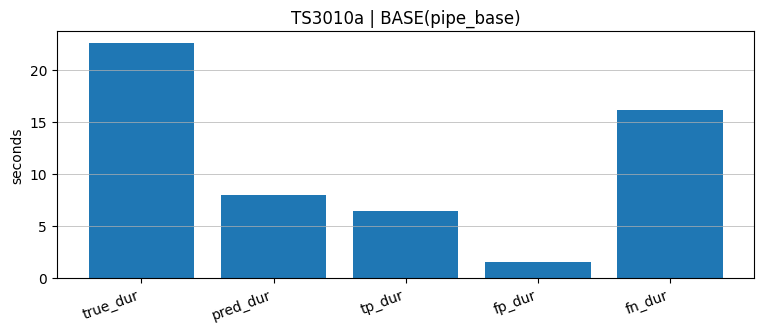

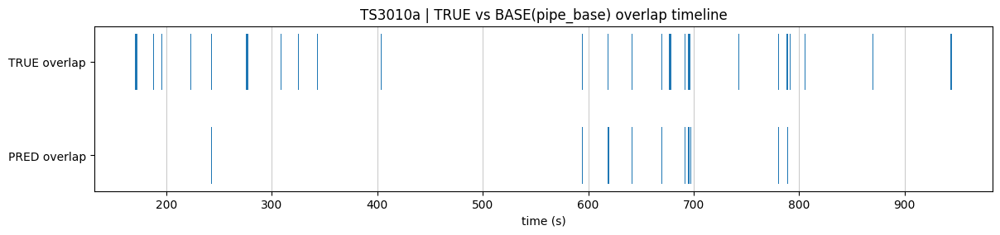


--- AFTER(overlap_reassign_GNN_pipeline) ---
pred_overlap_dur=8.50s | tp=6.60s | fp=1.90s | fn=15.94s
precision=0.776 | recall=0.293 | f1=0.425


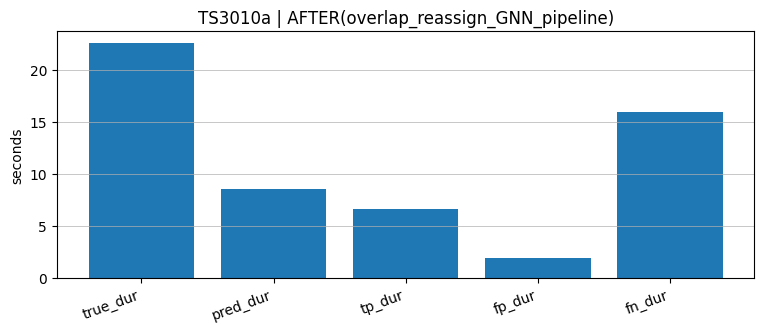

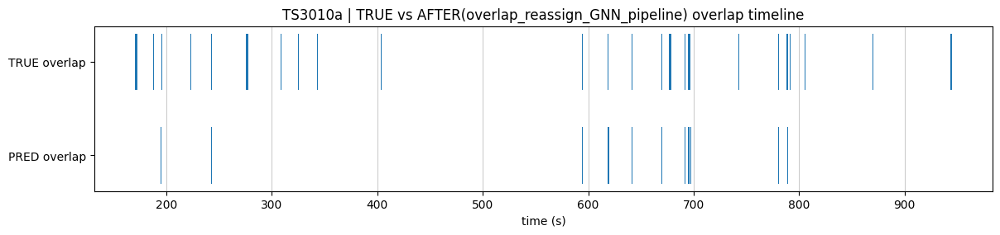

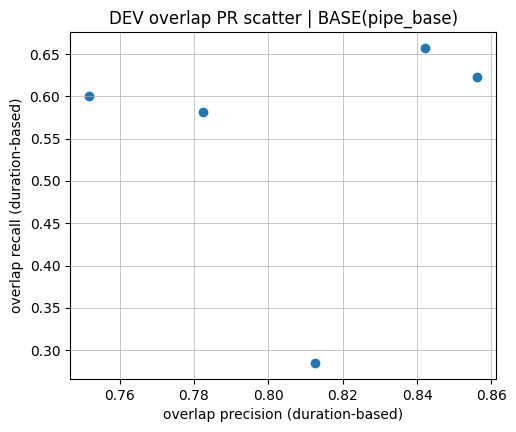

[DEV summary | BASE(pipe_base)] mean P=0.809 | mean R=0.549 | mean F1=0.643 | n_files=5


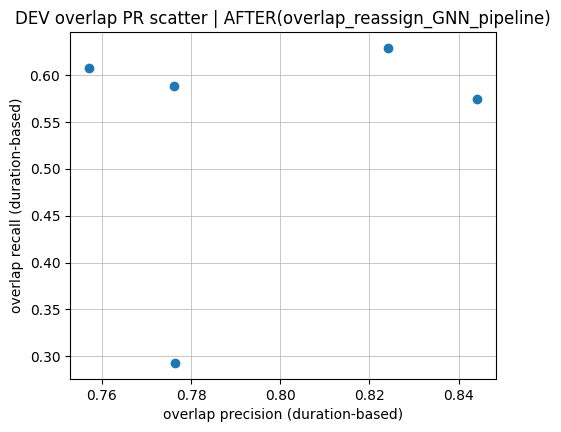

[DEV summary | AFTER(overlap_reassign_GNN_pipeline)] mean P=0.796 | mean R=0.539 | mean F1=0.633 | n_files=5


In [ ]:
# ============================================================
# Overlap precision/recall diagnostic + visualization
# - TRUE overlap: reference count >= 2
# - PRED overlap: hypothesis count >= 2 (from a pipeline we choose)
# Metrics are in *clock-time seconds* (Timeline duration), not speaker-time.
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment, Timeline

# ----------------------------
# Choose file + prediction source
# ----------------------------
DEBUG_URI = "TS3010a"

# Pick which hypothesis to evaluate overlap detection for:
#   - pipe_base (baseline)
#   - E3_GNN_best (after)
# or any callable f -> Annotation
PRED_FNS = {
    "BASE(pipe_base)": pipe_base,
}
if "E3_GNN_best" in globals():
    PRED_FNS["AFTER(E3_GNN_best)"] = E3_GNN_best
elif "overlap_reassign_GNN_pipeline" in globals():
    PRED_FNS["AFTER(overlap_reassign_GNN_pipeline)"] = overlap_reassign_GNN_pipeline

# Grid params for overlap masks
RES = 0.02
MIN_OV_DUR = 0.20
MERGE_GAP = 0.05

# ----------------------------
# Helpers
# ----------------------------
def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"].support()
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))]).support()
    return Timeline()

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = float(uem_seg.start + a * res)
#         en = float(uem_seg.start + b * res)
#         # clamp (ceil(duration/res) can overshoot)
#         st = max(st, float(uem_seg.start))
#         en = min(en, float(uem_seg.end))
#         if en - st >= min_dur:
#             out.append(Segment(st, en))
#     return out

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl)) if tl is not None else 0.0

def intersect_timelines(tl1: Timeline, tl2: Timeline) -> Timeline:
    """Two-pointer intersection (robust; avoids relying on operator overloads)."""
    a = list(tl1.support())
    b = list(tl2.support())
    i = j = 0
    out = []
    while i < len(a) and j < len(b):
        s1, s2 = a[i], b[j]
        st = max(s1.start, s2.start)
        en = min(s1.end, s2.end)
        if en > st:
            out.append(Segment(st, en))
        if s1.end < s2.end:
            i += 1
        else:
            j += 1
    return Timeline(out).support()

def build_true_overlap_tl(file, res=0.02, min_dur=0.20, merge_gap=0.05):
    """TRUE overlap from REF: count(ref speakers) >= 2."""
    ref = file["annotation"]
    uem = _get_uem(file)
    ov_segs = []
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue
        count = np.zeros((T,), dtype=np.uint16)
        ref_seg = ref.crop(uem_seg)
        for seg, _, _lab in ref_seg.itertracks(yield_label=True):
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                count[a:b] += 1
        ov_mask = (count >= 2)
        ov_segs.extend(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_dur))
    ov_segs = _merge_close(ov_segs, gap=merge_gap)
    ov_tl = Timeline(ov_segs).support().crop(uem)
    return ov_tl

def build_pred_overlap_tl(hyp, file, res=0.02, min_dur=0.20, merge_gap=0.05):
    """PRED overlap from HYP: count(hyp labels active) >= 2."""
    uem = _get_uem(file)
    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return Timeline().support()

    ov_segs = []
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue
        M = np.zeros((T, len(labels)), dtype=np.uint8)
        hyp_seg = hyp.crop(uem_seg)
        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in labels:
                continue
            j = labels.index(lab)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                M[a:b, j] = 1
        count = M.sum(axis=1)
        ov_mask = (count >= 2)
        ov_segs.extend(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_dur))
    ov_segs = _merge_close(ov_segs, gap=merge_gap)
    ov_tl = Timeline(ov_segs).support().crop(uem)
    return ov_tl

def overlap_prf(true_tl, pred_tl):
    inter = intersect_timelines(true_tl, pred_tl)
    tp = tl_dur(inter)
    pred = tl_dur(pred_tl)
    true = tl_dur(true_tl)
    fp = max(pred - tp, 0.0)
    fn = max(true - tp, 0.0)
    prec = tp / pred if pred > 1e-9 else float("nan")
    rec  = tp / true if true > 1e-9 else float("nan")
    f1 = (2*prec*rec/(prec+rec)) if (prec == prec and rec == rec and (prec+rec) > 1e-9) else float("nan")
    return {
        "true_dur": true, "pred_dur": pred, "tp_dur": tp, "fp_dur": fp, "fn_dur": fn,
        "precision": prec, "recall": rec, "f1": f1,
        "inter_tl": inter
    }

def plot_timelines(true_tl, pred_tl, title="Overlap timelines"):
    # Prepare broken_barh segments
    def to_bars(tl):
        bars = []
        for s in tl.support():
            bars.append((float(s.start), float(s.duration)))
        return bars

    true_bars = to_bars(true_tl)
    pred_bars = to_bars(pred_tl)

    fig = plt.figure(figsize=(14, 2.6))
    ax = plt.gca()
    ax.broken_barh(true_bars, (12, 6))
    ax.broken_barh(pred_bars, (2,  6))

    ax.set_yticks([5, 15])
    ax.set_yticklabels(["PRED overlap", "TRUE overlap"])
    ax.set_xlabel("time (s)")
    ax.set_title(title)
    ax.grid(True, axis="x", linewidth=0.5)
    plt.show()

def plot_durations(stats, title="Overlap detection durations (clock time)"):
    names = ["true_dur", "pred_dur", "tp_dur", "fp_dur", "fn_dur"]
    vals = [stats[k] for k in names]
    fig = plt.figure(figsize=(9, 3.2))
    ax = plt.gca()
    ax.bar(names, vals)
    ax.set_ylabel("seconds")
    ax.set_title(title)
    ax.grid(True, axis="y", linewidth=0.5)
    plt.xticks(rotation=20, ha="right")
    plt.show()

# ----------------------------
# Find file by URI
# ----------------------------
def find_file_by_uri(protocol, uri):
    for f in protocol.development():
        if f.get("uri") == uri:
            return f, "dev"
    for f in protocol.test():
        if f.get("uri") == uri:
            return f, "test"
    return None, None

f, split = find_file_by_uri(protocol, DEBUG_URI)
if f is None:
    raise RuntimeError(f"Could not find uri={DEBUG_URI} in protocol dev/test.")

uem = _get_uem(f)
true_ov = build_true_overlap_tl(f, res=RES, min_dur=MIN_OV_DUR, merge_gap=MERGE_GAP)

print(f"[{DEBUG_URI}] split={split} | uem_dur={tl_dur(uem):.2f}s | TRUE overlap_dur={tl_dur(true_ov):.2f}s")

# ----------------------------
# Evaluate each prediction function
# ----------------------------
results = {}
for name, fn in PRED_FNS.items():
    hyp = fn(f).crop(uem)
    pred_ov = build_pred_overlap_tl(hyp, f, res=RES, min_dur=MIN_OV_DUR, merge_gap=MERGE_GAP)
    stats = overlap_prf(true_ov, pred_ov)
    results[name] = (pred_ov, stats)

    print(f"\n--- {name} ---")
    print(f"pred_overlap_dur={stats['pred_dur']:.2f}s | tp={stats['tp_dur']:.2f}s | fp={stats['fp_dur']:.2f}s | fn={stats['fn_dur']:.2f}s")
    print(f"precision={stats['precision']:.3f} | recall={stats['recall']:.3f} | f1={stats['f1']:.3f}")

    plot_durations(stats, title=f"{DEBUG_URI} | {name}")
    plot_timelines(true_ov, pred_ov, title=f"{DEBUG_URI} | TRUE vs {name} overlap timeline")

# ----------------------------
# Optional: quick DEV summary plot (if DEV_URIS exists)
# ----------------------------
if "DEV_URIS" in globals():
    dev_files = [ff for ff in protocol.development() if ff.get("uri") in set(DEV_URIS)]
    if len(dev_files) > 0:
        for name, fn in PRED_FNS.items():
            ps, rs, f1s = [], [], []
            for ff in dev_files:
                uem_ff = _get_uem(ff)
                true_ff = build_true_overlap_tl(ff, res=RES, min_dur=MIN_OV_DUR, merge_gap=MERGE_GAP)
                hyp_ff = fn(ff).crop(uem_ff)
                pred_ff = build_pred_overlap_tl(hyp_ff, ff, res=RES, min_dur=MIN_OV_DUR, merge_gap=MERGE_GAP)
                st = overlap_prf(true_ff, pred_ff)
                if st["precision"] == st["precision"] and st["recall"] == st["recall"]:
                    ps.append(st["precision"]); rs.append(st["recall"]); f1s.append(st["f1"])

            if len(ps) > 0:
                fig = plt.figure(figsize=(5.5, 4.5))
                ax = plt.gca()
                ax.scatter(ps, rs)
                ax.set_xlabel("overlap precision (duration-based)")
                ax.set_ylabel("overlap recall (duration-based)")
                ax.set_title(f"DEV overlap PR scatter | {name}")
                ax.grid(True, linewidth=0.5)
                plt.show()

                print(f"[DEV summary | {name}] mean P={np.mean(ps):.3f} | mean R={np.mean(rs):.3f} | mean F1={np.mean(f1s):.3f} | n_files={len(ps)}")


What our overlap PR says
TS3010a (dev)
 - TRUE overlap = 22.54s
 - BASE predicted overlap = 7.90s with P=0.813, R=0.285

** So baseline overlap detection is very conservative: when it predicts overlap it’s usually right, but it misses ~71% of true overlap time (FN=16.12s).**

AFTER (our GNN overlap rewrite) barely changes overlap detection:
- pred overlap 8.50s, P down, R up tiny, F1 basically same.
- Implication: our overlap reassignment can only ever affect ~8 seconds on TS3010a, because we’re only operating on “predicted overlap” regions. Even a perfect overlap labeler can’t fix the other ~16s we never touch.

DEV average (5 files)
- Mean P ~0.81, R ~0.55
- TS3010a is an outlier with low recall.

So next step is not “better GNN” yet — it’s: expand / improve overlap candidate detection, at least for TS3010a.

TO rethink tommorrow : In TRUE overlap time, how often does the hypothesis have 0 / 1 / 2+ speakers? (+ bar plot)

This tells we whether our missed true overlap is mostly:
 - hyp=0 speakers (VAD/segmentation miss), or
 - hyp=1 speaker (overlap collapsed into single-speaker), or
 - hyp>=2 (overlap detected but maybe wrong labels)

 Good Night for today

[TS3010a] TRUE overlap frames total ~ 22.80s
  hyp_count==0 : 2.38s  (10.44%)
  hyp_count==1 : 13.86s  (60.79%)
  hyp_count>=2 : 6.56s  (28.77%)


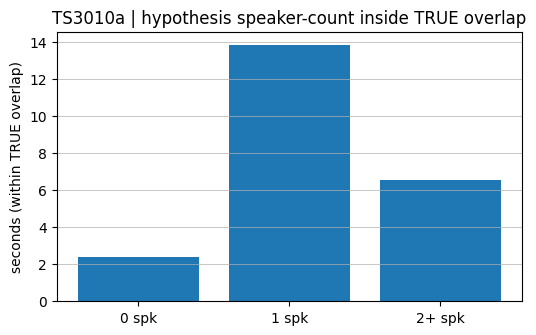

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment, Timeline

DEBUG_URI = "TS3010a"
HYP_FN = pipe_base   # try overlap_reassign_GNN_pipeline too

RES = 0.02
MIN_TRUE_OV_DUR = 0.00  # keep 0 here to analyze *all* overlap frames

def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"].support()
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))]).support()
    return Timeline()

def find_file_by_uri(protocol, uri):
    for f in protocol.development():
        if f.get("uri") == uri:
            return f, "dev"
    for f in protocol.test():
        if f.get("uri") == uri:
            return f, "test"
    return None, None

def build_true_overlap_mask(file, uem_seg, res=0.02):
    ref = file["annotation"].crop(uem_seg)
    T = int(np.ceil(uem_seg.duration / res))
    cnt = np.zeros((T,), dtype=np.uint16)
    for seg, _, _ in ref.itertracks(yield_label=True):
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            cnt[a:b] += 1
    return (cnt >= 2), T

def hyp_count_frames(hyp, uem_seg, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    hyp_seg = hyp.crop(uem_seg)
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M.sum(axis=1)  # per-frame speaker count

f, split = find_file_by_uri(protocol, DEBUG_URI)
uem = _get_uem(f)
hyp = HYP_FN(f).crop(uem)
labels = sorted([str(l) for l in hyp.labels()])

n0 = n1 = n2p = 0
total_ov_frames = 0

for uem_seg in uem:
    ov_mask, T = build_true_overlap_mask(f, uem_seg, res=RES)
    if T <= 0:
        continue
    hc = hyp_count_frames(hyp, uem_seg, labels, res=RES)
    ov_idx = np.where(ov_mask)[0]
    if ov_idx.size == 0:
        continue
    total_ov_frames += ov_idx.size
    h = hc[ov_idx]
    n0  += int(np.sum(h == 0))
    n1  += int(np.sum(h == 1))
    n2p += int(np.sum(h >= 2))

dur0  = n0 * RES
dur1  = n1 * RES
dur2p = n2p * RES
tot   = total_ov_frames * RES

print(f"[{DEBUG_URI}] TRUE overlap frames total ~ {tot:.2f}s")
print(f"  hyp_count==0 : {dur0:.2f}s  ({dur0/max(tot,1e-9):.2%})")
print(f"  hyp_count==1 : {dur1:.2f}s  ({dur1/max(tot,1e-9):.2%})")
print(f"  hyp_count>=2 : {dur2p:.2f}s  ({dur2p/max(tot,1e-9):.2%})")

plt.figure(figsize=(6,3.5))
plt.bar(["0 spk", "1 spk", "2+ spk"], [dur0, dur1, dur2p])
plt.ylabel("seconds (within TRUE overlap)")
plt.title(f"{DEBUG_URI} | hypothesis speaker-count inside TRUE overlap")
plt.grid(True, axis="y", linewidth=0.5)
plt.show()


What this means (TS3010a TRUE overlap = 22.8s)

Inside TRUE overlap time, our hypothesis has:
 - hyp_count==0: 2.38s (10.4%) → speech activity / segmentation miss even during overlap
 - hyp_count==1: 13.86s (60.8%) → overlap exists, but baseline collapses it to a single speaker
 - hyp_count>=2: 6.56s (28.8%) → only this part is even eligible for our current “overlap reassignment” logic

Key consequence
 - our current overlap pipeline mostly edits only the 28.8% slice (where baseline already has ≥2 speakers). That’s why our overlap recall was low (~0.29) and why overlap fixes don’t move DER much: most true overlap is hiding inside baseline single-speaker regions.
 - So the next overlap step is not “better GNN”; it’s better overlap candidate detection, specifically targeting regions currently labeled as single-speaker.

*next*

What to do next (highest ROI, in order)
1) Add an overlap candidate detector (OSD)
 - Use pyannote/overlapped-speech-detection to produce an overlap timeline, then take:
 - cand_overlap = union( OSD_overlap , baseline_overlap(count>=2) )
 - This will directly address the 60.8% hyp_count==1 inside TRUE overlap by flagging overlap even when diarization outputs only one speaker.

2) Only after we have candidates: decide “2nd speaker” safely
 - Within cand_overlap:
 - keep baseline speaker (the one already active)
 - add a second speaker only when confident:
 - centroid similarity margin / stability checks
 - AND OSD says overlap (or high OSD score if available)
 - This should reduce the FA blow-up we observed.

3) Optional but strong: separation on overlap candidates (AMI-trained)
 - If embeddings remain ambiguous on overlap:
 - run pyannote/separation-ami-1.0 (or speech-separation-ami-1.0) on overlap windows
 - embed each separated stream
 - match to anchor centroids
 - This is the cleanest way to reduce confusion in overlap.

4) In parallel: segmentation/VAD work (because 10% of overlap is hyp==0)
 - That 2.38s inside overlap where hyp has 0 speakers is pure miss that overlap assignment cannot fix.
 - This pushes we toward:

- speaker-diarization-3.1 / speaker-diarization-precision-2
- better VAD/segmentation thresholds

### OSD overlap PR/F1 vs TRUE overlap (TS3010a + DEV summary)

In [ ]:
# ============================================================
# OSD overlap PR/F1 vs TRUE overlap (TS3010a + DEV summary)
# Requires: protocol, DEV_URIS, and our existing helper funcs:
#   - _get_uem
#   - build_true_overlap_tl
#   - overlap_prf
#   - tl_dur
#   - find_file_by_uri
# ============================================================



def osd_overlap_timeline(file):
    uem = _get_uem(file)
    out = osd(file)  # usually returns Annotation
    # robust: handle Annotation or Timeline
    if hasattr(out, "get_timeline"):
        tl = out.get_timeline().support()
    else:
        tl = out.support() if hasattr(out, "support") else Timeline()
    return tl.crop(uem)

# ---- TS3010a ----
f, split = find_file_by_uri(protocol, DEBUG_URI)
uem = _get_uem(f)
true_ov = build_true_overlap_tl(f, res=0.02, min_dur=0.20, merge_gap=0.05)

# BASE predicted overlap timeline (count>=2)
hyp_base = pipe_base(f).crop(uem)
pred_base = build_pred_overlap_tl(hyp_base, f, res=0.02, min_dur=0.20, merge_gap=0.05)

# OSD overlap
pred_osd = osd_overlap_timeline(f)

# scores
metrics0 = overlap_prf(true_ov, pred_base)
p0, r0, f10, tp0, fp0, fn0 = metrics0["precision"], metrics0["recall"], metrics0["f1"], metrics0["tp_dur"], metrics0["fp_dur"], metrics0["fn_dur"]
metrics1 = overlap_prf(true_ov, pred_osd)
p1, r1, f11, tp1, fp1, fn1 = metrics1["precision"], metrics1["recall"], metrics1["f1"], metrics1["tp_dur"], metrics1["fp_dur"], metrics1["fn_dur"]

print(f"[{DEBUG_URI}] split={split} | TRUE_ov={tl_dur(true_ov):.2f}s")
print(f"BASE overlap: pred={tl_dur(pred_base):.2f}s | P={p0:.3f} R={r0:.3f} F1={f10:.3f} | tp={tp0:.2f} fp={fp0:.2f} fn={fn0:.2f}")
print(f"OSD  overlap: pred={tl_dur(pred_osd):.2f}s | P={p1:.3f} R={r1:.3f} F1={f11:.3f} | tp={tp1:.2f} fp={tp1:.2f} fn={fn1:.2f}")

# ---- DEV summary ----
if "DEV_URIS" in globals():
    dev_files = [ff for ff in protocol.development() if ff.get("uri") in set(DEV_URIS)]
    if dev_files:
        def avg_prf(pred_fn_name):
            Ps, Rs, F1s = [], [], []
            for ff in dev_files:
                u = _get_uem(ff)
                true = build_true_overlap_tl(ff, res=0.02, min_dur=0.20, merge_gap=0.05)
                if pred_fn_name == "BASE":
                    hyp = pipe_base(ff).crop(u)
                    pred = build_pred_overlap_tl(hyp, ff, res=0.02, min_dur=0.20, merge_gap=0.05)
                else:
                    pred = osd_overlap_timeline(ff)

                st = overlap_prf(true, pred)
                p,r,f1 = st["precision"], st["recall"], st["f1"]
                if p == p and r == r:
                    Ps.append(p); Rs.append(r); F1s.append(f1)
            return float(sum(Ps)/len(Ps)), float(sum(Rs)/len(Rs)), float(sum(F1s)/len(F1s)), len(Ps)

        pB,rB,fB,nB = avg_prf("BASE")
        pO,rO,fO,nO = avg_prf("OSD")
        print(f"\n[DEV summary BASE] mean P={pB:.3f} | mean R={rB:.3f} | mean F1={fB:.3f} | n_files={nB}")
        print(f"[DEV summary OSD ] mean P={pO:.3f} | mean R={rO:.3f} | mean F1={fO:.3f} | n_files={nO}")

/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
[TS3010a] split=dev | TRUE_ov=22.54s
BASE overlap: pred=7.90s | P=0.813 R=0.285 F1=0.422 | tp=6.42 fp=1.48 fn=16.12
OSD  overlap: pred=5.26s | P=0.867 R=0.202 F1=0.328 | tp=4.56 fp=4.56 fn=17.98

[DEV summary BASE] mean P=0.809 | mean R=0.549 | mean F1=0.643 | n_files=5
[DEV summary OSD ] mean P=0.868 | mean R=0.431 | mean F1=0.564 | n_files=5


### Overlap PR/Recall using segmentation-3.0 + OverlappedSpeechDetection pipeline and PR sweep on onset/offset + visualization

[TS3010a] split=dev | TRUE_ov=22.54s
BASE overlap: pred=7.90s | P=0.813 R=0.285 F1=0.422 | tp=6.42 fp=1.48 fn=16.12
[WARN] pipeline.instantiate rejected onset/offset. Falling back to only min_duration_*.
 parameter 'onset' does not exist

SEG3-OSD sweep:
fallback | pred_dur=  7.91s | P=0.802 R=0.282 F1=0.417 | tp= 6.35 fp= 1.57 fn=16.19

BEST SEG3-OSD: {'onset': None, 'pred': <Timeline(uri=TS3010a, segments=[<Segment(194.347, 194.633)>, <Segment(242.693, 243.2)>, <Segment(276.764, 277.017)>, <Segment(593.643, 594.824)>, <Segment(618.719, 619.63)>, <Segment(641.298, 641.618)>, <Segment(669.53, 670.053)>, <Segment(676.972, 677.242)>, <Segment(691.67, 691.973)>, <Segment(694.825, 696.108)>, <Segment(697.238, 697.627)>, <Segment(715.666, 715.784)>, <Segment(742.497, 742.649)>, <Segment(780.5, 780.77)>, <Segment(788.549, 789.275)>, <Segment(943.951, 944.373)>])>, 'p': 0.8017847271578417, 'r': 0.2815272848269589, 'f1': 0.4167299443839976, 'dur': 7.914374999999751}


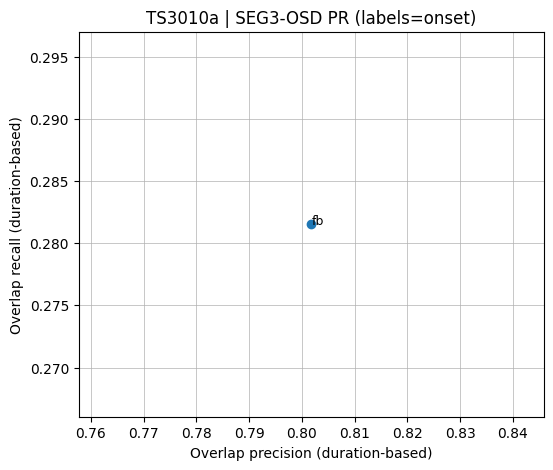

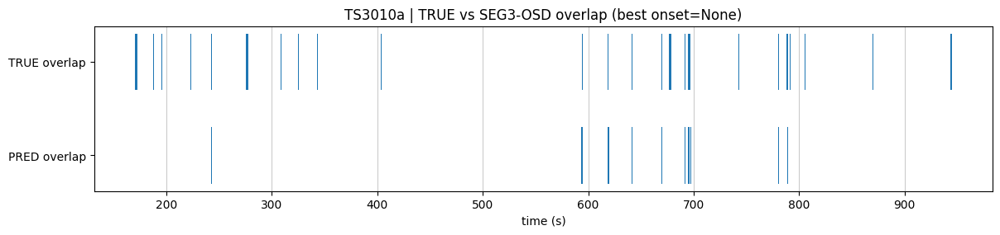

In [ ]:
# ============================================================
# Overlap PR/Recall using segmentation-3.0 + OverlappedSpeechDetection pipeline
# + PR sweep on onset/offset + visualization
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.audio import Model
from pyannote.audio.pipelines import OverlappedSpeechDetection
from pyannote.core import Timeline, Segment

DEBUG_URI = "TS3010a"

# ---- assumes we already have these helpers from our earlier cell ----
# _get_uem(file)
# build_true_overlap_tl(file, res=0.02, min_dur=0.20, merge_gap=0.05)
# build_pred_overlap_tl(hyp, file, res=0.02, min_dur=0.20, merge_gap=0.05)   # our BASE pred overlap (count>=2)
# overlap_prf(true_tl, pred_tl) -> (p,r,f1,tp,fp,fn)
# tl_dur(tl)
# find_file_by_uri(protocol, uri)

def to_timeline(x, uem):
    # x can be Annotation or Timeline; return Timeline.support() cropped to UEM
    if hasattr(x, "get_timeline"):
        tl = x.get_timeline().support()
    elif isinstance(x, Timeline):
        tl = x.support()
    else:
        tl = Timeline()
    return tl.crop(uem)

def plot_timelines(true_tl, pred_tl, title):
    def to_bars(tl):
        return [(float(s.start), float(s.duration)) for s in tl.support()]
    plt.figure(figsize=(14, 2.6))
    ax = plt.gca()
    ax.broken_barh(to_bars(true_tl), (12, 6))
    ax.broken_barh(to_bars(pred_tl), (2, 6))
    ax.set_yticks([5, 15]); ax.set_yticklabels(["PRED overlap", "TRUE overlap"])
    ax.set_xlabel("time (s)"); ax.set_title(title)
    ax.grid(True, axis="x", linewidth=0.5)
    plt.show()

# ----------------------------
# Load file
# ----------------------------
f, split = find_file_by_uri(protocol, DEBUG_URI)
uem = _get_uem(f)
true_ov = build_true_overlap_tl(f, res=0.02, min_dur=0.20, merge_gap=0.05)
print(f"[{DEBUG_URI}] split={split} | TRUE_ov={tl_dur(true_ov):.2f}s")

# ----------------------------
# BASE predicted overlap (count>=2 from pipe_base hyp grid)
# ----------------------------
hyp_base = pipe_base(f).crop(uem)
pred_base = build_pred_overlap_tl(hyp_base, f, res=0.02, min_dur=0.20, merge_gap=0.05)
pB, rB, fB, tpB, fpB, fnB = overlap_prf(true_ov, pred_base)
print(f"BASE overlap: pred={tl_dur(pred_base):.2f}s | P={pB:.3f} R={rB:.3f} F1={fB:.3f} | tp={tpB:.2f} fp={fpB:.2f} fn={fnB:.2f}")

# ----------------------------
# segmentation-3.0 + OverlappedSpeechDetection
# ----------------------------
# If needed:
# HF_TOKEN="..."
HF_TOKEN = None

seg3 = Model.from_pretrained("pyannote/segmentation-3.0", use_auth_token=HF_TOKEN)
osd_pipe = OverlappedSpeechDetection(segmentation=seg3)

# Sweep onset/offset to trade recall vs precision
ONSETS = np.linspace(0.05, 0.95, 19)
rows = []
best = None

for onset in ONSETS:
    params = {
        "min_duration_on": 0.0,
        "min_duration_off": 0.0,
        # These are commonly supported by pyannote pipelines; if our version rejects them,
        # comment them out and re-run.
        "onset": float(onset),
        "offset": float(onset),
    }
    try:
        osd_pipe.instantiate(params)
    except Exception as e:
        print("[WARN] pipeline.instantiate rejected onset/offset. Falling back to only min_duration_*.\n", e)
        osd_pipe.instantiate({"min_duration_on": 0.0, "min_duration_off": 0.0})
        onset = None  # indicates fallback mode

    pred_osd_ann = osd_pipe(f)   # works with protocol file dict
    pred_osd = to_timeline(pred_osd_ann, uem)

    p, r, f1, tp, fp, fn = overlap_prf(true_ov, pred_osd)
    rows.append((onset, tl_dur(pred_osd), p, r, f1, tp, fp, fn))

    if f1 == f1 and (best is None or f1 > best["f1"]):
        best = {"onset": onset, "pred": pred_osd, "p": p, "r": r, "f1": f1, "dur": tl_dur(pred_osd)}

    if onset is None:
        # no point sweeping if onset/offset not supported
        break

print("\nSEG3-OSD sweep:")
for onset, dur, p, r, f1, tp, fp, fn in rows:
    if onset is None:
        print(f"fallback | pred_dur={dur:6.2f}s | P={p:5.3f} R={r:5.3f} F1={f1:5.3f} | tp={tp:5.2f} fp={fp:5.2f} fn={fn:5.2f}")
    else:
        print(f"onset={onset:4.2f} | pred_dur={dur:6.2f}s | P={p:5.3f} R={r:5.3f} F1={f1:5.3f} | tp={tp:5.2f} fp={fp:5.2f} fn={fn:5.2f}")

print("\nBEST SEG3-OSD:", best)

# ----------------------------
# Visualizations
# ----------------------------
# PR curve
Ps = [x[2] for x in rows]
Rs = [x[3] for x in rows]
labs = ["fb" if x[0] is None else f"{x[0]:.2f}" for x in rows]

plt.figure(figsize=(6, 5))
plt.scatter(Ps, Rs)
for i, lab in enumerate(labs):
    if Ps[i] == Ps[i] and Rs[i] == Rs[i]:
        plt.text(Ps[i], Rs[i], lab, fontsize=9)
plt.xlabel("Overlap precision (duration-based)")
plt.ylabel("Overlap recall (duration-based)")
plt.title(f"{DEBUG_URI} | SEG3-OSD PR (labels=onset)")
plt.grid(True, linewidth=0.5)
plt.show()

# Timeline plot for BEST
plot_timelines(true_ov, best["pred"], title=f"{DEBUG_URI} | TRUE vs SEG3-OSD overlap (best onset={best['onset']})")


### SEG3 overlap PR/Recall + sweep + visualization (FIXED) Works whether scores.data is 2D (T,7) or 3D (n_chunks,n_frames,K)

[TS3010a] split=dev | TRUE_ov=22.54s
BASE overlap: pred=7.90s | P=0.813 R=0.285 F1=0.422 | tp=6.42 fp=1.48 fn=16.12
[DBG] raw scores.data shape=(10312, 589, 3) | sliding_window: start=0.000 dur=10.000 step=0.100
[DBG] ov_score quantiles: {'q50': 0.0, 'q70': 0.0, 'q80': 0.0, 'q90': 0.0, 'q95': 0.0, 'q97': 0.0, 'q99': 0.0}

BEST (seg3 tuned): {'thr': 0.0, 'collar': 0.0, 'precision': 0.04926560587515293, 'recall': 1.0, 'f1': 0.09390492855059773, 'tp_dur': 22.539999999999964, 'fp_dur': 434.9799999999999, 'fn_dur': 0.0}
pred_dur=457.52s | TRUE_dur=22.54s


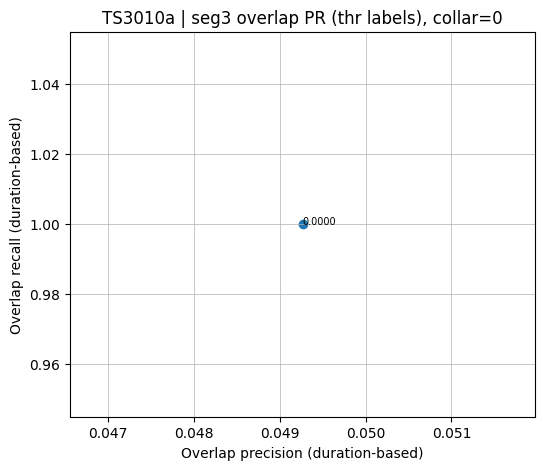

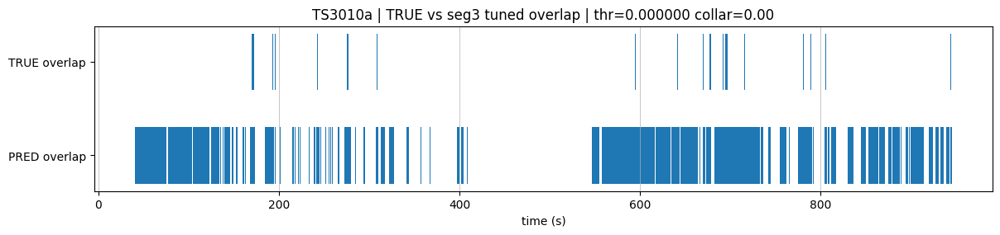

In [ ]:
# ============================================================
# SEG3 overlap PR/Recall + sweep + visualization (FIXED)
# Works whether scores.data is 2D (T,7) or 3D (n_chunks,n_frames,K)
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.audio import Model, Inference
from pyannote.core import Segment, Timeline

DEBUG_URI = "TS3010a"
HF_TOKEN = None  # set if needed

# ---- knobs ----
STEP = 0.10
MIN_DUR = 0.20
MERGE_GAP = 0.05
COLLARS = [0.0, 0.10, 0.20, 0.30, 0.50]

# ----------------------------
# Helpers (self-contained)
# ----------------------------
def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl)) if tl is not None else 0.0

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def _mask_to_segments(mask, start_time, step, min_dur):
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    out = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            out.append(Segment(st, en))
    return out

def intersect_timelines(tl1: Timeline, tl2: Timeline) -> Timeline:
    a = list(tl1.support()); b = list(tl2.support())
    i = j = 0; out = []
    while i < len(a) and j < len(b):
        s1, s2 = a[i], b[j]
        st = max(s1.start, s2.start); en = min(s1.end, s2.end)
        if en > st:
            out.append(Segment(st, en))
        if s1.end < s2.end:
            i += 1
        else:
            j += 1
    return Timeline(out).support()

def overlap_prf(true_tl, pred_tl):
    inter = intersect_timelines(true_tl, pred_tl)
    tp = tl_dur(inter)
    pred = tl_dur(pred_tl)
    true = tl_dur(true_tl)
    fp = max(pred - tp, 0.0)
    fn = max(true - tp, 0.0)
    prec = tp / pred if pred > 1e-9 else float("nan")
    rec  = tp / true if true > 1e-9 else float("nan")
    f1 = (2*prec*rec/(prec+rec)) if (prec == prec and rec == rec and (prec+rec) > 1e-9) else float("nan")
    return {"true_dur": true, "pred_dur": pred, "tp_dur": tp, "fp_dur": fp, "fn_dur": fn,
            "precision": prec, "recall": rec, "f1": f1, "inter_tl": inter}

def expand_timeline(tl, collar, uem):
    if collar <= 0:
        return tl.crop(uem)
    segs = [Segment(s.start - collar, s.end + collar) for s in tl.support()]
    segs = _merge_close(segs, gap=0.0)
    return Timeline(segs).support().crop(uem)

def plot_timelines(true_tl, pred_tl, title):
    def to_bars(tl):
        return [(float(s.start), float(s.duration)) for s in tl.support()]
    plt.figure(figsize=(14, 2.6))
    ax = plt.gca()
    ax.broken_barh(to_bars(true_tl), (12, 6))
    ax.broken_barh(to_bars(pred_tl), (2, 6))
    ax.set_yticks([5, 15]); ax.set_yticklabels(["PRED overlap", "TRUE overlap"])
    ax.set_xlabel("time (s)"); ax.set_title(title)
    ax.grid(True, axis="x", linewidth=0.5)
    plt.show()

def find_file_by_uri(protocol, uri):
    for f in protocol.development():
        if f.get("uri") == uri:
            return f, "dev"
    for f in protocol.test():
        if f.get("uri") == uri:
            return f, "test"
    return None, None

def build_true_overlap_tl(file, res=0.02, min_dur=0.20, merge_gap=0.05):
    ref = file["annotation"]
    uem = _get_uem(file)
    ov_segs = []
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue
        count = np.zeros((T,), dtype=np.uint16)
        ref_seg = ref.crop(uem_seg)
        for seg, _, _lab in ref_seg.itertracks(yield_label=True):
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                count[a:b] += 1
        ov_mask = (count >= 2)
        ov_segs.extend(_mask_to_segments(ov_mask, uem_seg.start, res, min_dur))
    ov_segs = _merge_close(ov_segs, gap=merge_gap)
    return Timeline(ov_segs).support().crop(uem)

# ---------------------------------------------------
# Core: build predicted overlap TL from seg scores
# ---------------------------------------------------
def pred_overlap_tl_from_scores(scores, uem, thr, min_dur=0.20, merge_gap=0.05):
    X = np.asarray(scores.data)
    sw = scores.sliding_window  # this indexes FIRST axis of X

    pred_segs = []

    if X.ndim == 2:
        # (T, C)
        T, C = X.shape
        step = float(sw.step); t0 = float(sw.start)

        if C == 7:
            ov = np.max(X[:, 4:7], axis=1)  # overlap classes in powerset
        elif C >= 2:
            # fallback: second largest "speaker activity"
            ov = np.partition(X, -2, axis=1)[:, -2]
        else:
            return Timeline().support()

        for uem_seg in uem:
            a = int(np.floor((uem_seg.start - t0) / step))
            b = int(np.ceil ((uem_seg.end   - t0) / step))
            a = max(a, 0); b = min(b, len(ov))
            if b <= a:
                continue
            mask = (ov[a:b] >= thr)
            start_time = t0 + a * step
            pred_segs.extend(_mask_to_segments(mask, start_time, step, min_dur))

    elif X.ndim == 3:
        # (n_chunks, n_frames, K)
        n_chunks, n_frames, K = X.shape
        chunk_step = float(sw.step)
        chunk_start0 = float(sw.start)
        chunk_dur = float(sw.duration)
        frame_step = chunk_dur / float(n_frames)

        # overlap score inside each chunk
        if K == 7:
            ov_chunk = np.max(X[:, :, 4:7], axis=2)      # (n_chunks, n_frames)
        elif K >= 2:
            ov_chunk = np.partition(X, -2, axis=2)[:, :, -2]  # second-highest speaker activity
        else:
            return Timeline().support()

        # Convert each chunk mask to absolute-time segments; merge globally
        for i in range(n_chunks):
            chunk_t0 = chunk_start0 + i * chunk_step
            # quick skip if this chunk doesn't intersect UEM at all
            chunk_seg = Segment(chunk_t0, chunk_t0 + chunk_dur)
            if tl_dur(Timeline([chunk_seg]).support().crop(uem)) <= 0:
                continue

            mask = (ov_chunk[i] >= thr)
            segs_i = _mask_to_segments(mask, chunk_t0, frame_step, min_dur)
            pred_segs.extend(segs_i)

    else:
        raise RuntimeError(f"Unsupported scores.data ndim={X.ndim} shape={X.shape}")

    pred_segs = _merge_close(pred_segs, gap=merge_gap)
    return Timeline(pred_segs).support().crop(uem)

# ============================================================
# Run on TS3010a
# ============================================================
f, split = find_file_by_uri(protocol, DEBUG_URI)
uem = _get_uem(f)
true_ov = build_true_overlap_tl(f, res=0.02, min_dur=MIN_DUR, merge_gap=MERGE_GAP)

print(f"[{DEBUG_URI}] split={split} | TRUE_ov={tl_dur(true_ov):.2f}s")

# BASE overlap PR from diarization output (count>=2 in hypothesis)
try:
    hyp_base = pipe_base(f).crop(uem)
    # "pred overlap" from diarization hypothesis = regions with >=2 active labels
    # reuse our own function if we already have it; here is a minimal inline version:
    labels = sorted([str(l) for l in hyp_base.labels()])
    if len(labels) > 1:
        ov_segs = []
        RES = 0.02
        for uem_seg in uem:
            T = int(np.ceil(uem_seg.duration / RES))
            M = np.zeros((T, len(labels)), dtype=np.uint8)
            hyp_seg = hyp_base.crop(uem_seg)
            for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
                lab = str(lab0)
                j = labels.index(lab)
                a = int(np.floor((seg.start - uem_seg.start) / RES))
                b = int(np.ceil ((seg.end   - uem_seg.start) / RES))
                a = max(a, 0); b = min(b, T)
                if b > a:
                    M[a:b, j] = 1
            count = M.sum(axis=1)
            ov_mask = (count >= 2)
            ov_segs.extend(_mask_to_segments(ov_mask, uem_seg.start, RES, MIN_DUR))
        pred_base = Timeline(_merge_close(ov_segs, gap=MERGE_GAP)).support().crop(uem)
        mB = overlap_prf(true_ov, pred_base)
        print(f"BASE overlap: pred={mB['pred_dur']:.2f}s | P={mB['precision']:.3f} R={mB['recall']:.3f} F1={mB['f1']:.3f} | tp={mB['tp_dur']:.2f} fp={mB['fp_dur']:.2f} fn={mB['fn_dur']:.2f}")
except Exception as e:
    print("[WARN] BASE overlap compare failed:", e)

# segmentation-3.0 inference
model = Model.from_pretrained("pyannote/segmentation-3.0", use_auth_token=HF_TOKEN)
infer = Inference(model, step=STEP)
scores = infer(f)

Xraw = np.asarray(scores.data)
print(f"[DBG] raw scores.data shape={Xraw.shape} | sliding_window: start={scores.sliding_window.start:.3f} dur={scores.sliding_window.duration:.3f} step={scores.sliding_window.step:.3f}")

# Build overlap score distribution for threshold proposal
if Xraw.ndim == 2:
    if Xraw.shape[1] == 7:
        ov_all = np.max(Xraw[:, 4:7], axis=1)
    else:
        ov_all = np.partition(Xraw, -2, axis=1)[:, -2] if Xraw.shape[1] >= 2 else np.zeros((Xraw.shape[0],))
elif Xraw.ndim == 3:
    K = Xraw.shape[2]
    if K == 7:
        ov_all = np.max(Xraw[:, :, 4:7], axis=2).ravel()
    else:
        ov_all = np.partition(Xraw, -2, axis=2)[:, :, -2].ravel() if K >= 2 else np.zeros((Xraw.shape[0]*Xraw.shape[1],))
else:
    ov_all = np.zeros((1,))

qs = np.quantile(ov_all, [0.50, 0.70, 0.80, 0.90, 0.95, 0.97, 0.99])
THRS = np.unique(np.r_[qs, np.linspace(qs[0], qs[-1], 12)])
print("[DBG] ov_score quantiles:", {f"q{int(p*100)}": float(v) for p,v in zip([.50,.70,.80,.90,.95,.97,.99], qs)})

# Sweep thr + collar
best = None
curve = []  # (thr, pred_dur, p, r, f1) for collar=0
for collar in COLLARS:
    for thr in THRS:
        pred = pred_overlap_tl_from_scores(scores, uem, float(thr), min_dur=MIN_DUR, merge_gap=MERGE_GAP)
        pred = expand_timeline(pred, collar=collar, uem=uem)

        m = overlap_prf(true_ov, pred)
        p,r,f1 = m["precision"], m["recall"], m["f1"]

        if collar == 0.0:
            curve.append((float(thr), float(m["pred_dur"]), float(p), float(r), float(f1)))

        if p == p and r == r and f1 == f1:
            if best is None or f1 > best["f1"]:
                best = {"thr": float(thr), "collar": float(collar), **m, "pred": pred}

print("\nBEST (seg3 tuned):", {k: best[k] for k in ["thr","collar","precision","recall","f1","tp_dur","fp_dur","fn_dur"]})
print(f"pred_dur={best['pred_dur']:.2f}s | TRUE_dur={best['true_dur']:.2f}s")

# PR curve (collar=0)
Ps = [x[2] for x in curve]
Rs = [x[3] for x in curve]
labs = [f"{x[0]:.4f}" for x in curve]

plt.figure(figsize=(6,5))
plt.scatter(Ps, Rs)
for i, lab in enumerate(labs):
    if Ps[i] == Ps[i] and Rs[i] == Rs[i]:
        plt.text(Ps[i], Rs[i], lab, fontsize=7)
plt.xlabel("Overlap precision (duration-based)")
plt.ylabel("Overlap recall (duration-based)")
plt.title(f"{DEBUG_URI} | seg3 overlap PR (thr labels), collar=0")
plt.grid(True, linewidth=0.5)
plt.show()

plot_timelines(true_ov, best["pred"], title=f"{DEBUG_URI} | TRUE vs seg3 tuned overlap | thr={best['thr']:.6f} collar={best['collar']:.2f}")


What our latest logs really mean
- scores.data shape = (10312, 589, 3) is normal
- This is not the “(T, 7) powerset” output shown on the model card. Instead, we’re getting Kmax=3 speaker activations per 10s window (sliding over the file). That matches how pyannote segmentation outputs are often exposed as “Kmax-dimensional speaker activations” (one activation curve per local speaker).
- (Separately, the model card describes a powerset view with 7 classes for a single 10s chunk.)
- our overlap score quantiles being all zeros is expected with our current definition
- we computed overlap as “2nd-largest activation”. If the model rarely has 2 speakers active in the same frame, that second-largest value is 0 almost everywhere → quantiles all 0.
- The big bug: mask = (ov_score >= thr) + thr=0
 - If almost all ov_score == 0, then >= 0 makes everything overlap → we get:
 - recall = 1.0
 - pred_dur ≈ full UEM
 - precision collapses
- So yes: the current “manual thr” method is broken because the threshold grid degenerates to 0 and we used >=.
 - Fix: don’t threshold “ov_score”; threshold speaker activations and count speakers
 - With K=3 activations, the right way is:
 - pick an activation threshold act_thr
 - count = (A > act_thr).sum(axis=-1)
 - overlap frame if count >= 2
   - Then sweep act_thr (and optional collar), compute PR/F1.
   - Below is a self-contained cell that works with our (n_chunks, n_frames, 3) output and gives PR curve + timeline viz.

### SEG3 overlap PR/Recall FIX for scores.data = (n_chunks, n_frames, 3)

In [ ]:
# ============================================================
# SEG3 overlap PR/Recall FIX for scores.data = (n_chunks, n_frames, 3)
# - Uses speaker-activation threshold + count>=2
# - Sweeps act_thr + collar
# - Visual: PR curve + TRUE vs PRED overlap timelines
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.audio import Model, Inference
from pyannote.core import Segment, Timeline

DEBUG_URI = "TS3010a"
HF_TOKEN = None

STEP = 0.10
MIN_DUR = 0.20
MERGE_GAP = 0.05
COLLARS = [0.0, 0.10, 0.20, 0.30, 0.50]
ACT_THRs = np.linspace(0.05, 0.95, 19)   # << main sweep knob

# ----------------------------
# Helpers
# ----------------------------
def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl)) if tl is not None else 0.0

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def _mask_to_segments(mask, start_time, step, min_dur):
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    out = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            out.append(Segment(st, en))
    return out

def intersect_timelines(tl1: Timeline, tl2: Timeline) -> Timeline:
    a = list(tl1.support()); b = list(tl2.support())
    i = j = 0; out = []
    while i < len(a) and j < len(b):
        s1, s2 = a[i], b[j]
        st = max(s1.start, s2.start); en = min(s1.end, s2.end)
        if en > st:
            out.append(Segment(st, en))
        if s1.end < s2.end:
            i += 1
        else:
            j += 1
    return Timeline(out).support()

def overlap_prf(true_tl, pred_tl):
    inter = intersect_timelines(true_tl, pred_tl)
    tp = tl_dur(inter)
    pred = tl_dur(pred_tl)
    true = tl_dur(true_tl)
    fp = max(pred - tp, 0.0)
    fn = max(true - tp, 0.0)
    prec = tp / pred if pred > 1e-9 else float("nan")
    rec  = tp / true if true > 1e-9 else float("nan")
    f1 = (2*prec*rec/(prec+rec)) if (prec == prec and rec == rec and (prec+rec) > 1e-9) else float("nan")
    return {"precision": prec, "recall": rec, "f1": f1, "tp": tp, "fp": fp, "fn": fn, "pred": pred, "true": true}

def expand_timeline(tl, collar, uem):
    if collar <= 0:
        return tl.crop(uem)
    segs = [Segment(s.start - collar, s.end + collar) for s in tl.support()]
    segs = _merge_close(segs, gap=0.0)
    return Timeline(segs).support().crop(uem)

def plot_timelines(true_tl, pred_tl, title):
    def to_bars(tl):
        return [(float(s.start), float(s.duration)) for s in tl.support()]
    plt.figure(figsize=(14, 2.6))
    ax = plt.gca()
    ax.broken_barh(to_bars(true_tl), (12, 6))
    ax.broken_barh(to_bars(pred_tl), (2, 6))
    ax.set_yticks([5, 15]); ax.set_yticklabels(["PRED overlap", "TRUE overlap"])
    ax.set_xlabel("time (s)"); ax.set_title(title)
    ax.grid(True, axis="x", linewidth=0.5)
    plt.show()

def find_file_by_uri(protocol, uri):
    for f in protocol.development():
        if f.get("uri") == uri:
            return f, "dev"
    for f in protocol.test():
        if f.get("uri") == uri:
            return f, "test"
    return None, None

def build_true_overlap_tl(file, res=0.02, min_dur=0.20, merge_gap=0.05):
    ref = file["annotation"]
    uem = _get_uem(file)
    ov_segs = []
    for uem_seg in uem:
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue
        count = np.zeros((T,), dtype=np.uint16)
        ref_seg = ref.crop(uem_seg)
        for seg, _, _lab in ref_seg.itertracks(yield_label=True):
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                count[a:b] += 1
        ov_mask = (count >= 2)
        ov_segs.extend(_mask_to_segments(ov_mask, uem_seg.start, res, min_dur))
    ov_segs = _merge_close(ov_segs, gap=merge_gap)
    return Timeline(ov_segs).support().crop(uem)

# ----------------------------
# Load file
# ----------------------------
f, split = find_file_by_uri(protocol, DEBUG_URI)
uem = _get_uem(f)
true_ov = build_true_overlap_tl(f, res=0.02, min_dur=MIN_DUR, merge_gap=MERGE_GAP)
print(f"[{DEBUG_URI}] split={split} | TRUE_ov={tl_dur(true_ov):.2f}s")

# ----------------------------
# segmentation-3.0 inference
# ----------------------------
model = Model.from_pretrained("pyannote/segmentation-3.0", use_auth_token=HF_TOKEN)
infer = Inference(model, step=STEP)
scores = infer(f)

X = np.asarray(scores.data)
sw = scores.sliding_window
print(f"[DBG] raw scores.data shape={X.shape} | sw.start={sw.start:.3f} dur={sw.duration:.3f} step={sw.step:.3f}")

assert X.ndim == 3 and X.shape[2] == 3, "This cell expects (n_chunks, n_frames, 3)."

n_chunks, n_frames, K = X.shape
chunk_step = float(sw.step)
chunk_start0 = float(sw.start)
chunk_dur = float(sw.duration)
frame_step = chunk_dur / float(n_frames)

# sanity: how often 2nd speaker activation is > 0?
second = np.partition(X, -2, axis=2)[:, :, -2]
print(f"[DBG] second>0 fraction = {(second>0).mean():.6f} | second max = {second.max():.6f}")

def pred_overlap_tl_from_act_thr(act_thr):
    pred_segs = []
    for i in range(n_chunks):
        chunk_t0 = chunk_start0 + i * chunk_step
        chunk_seg = Segment(chunk_t0, chunk_t0 + chunk_dur)
        if tl_dur(Timeline([chunk_seg]).support().crop(uem)) <= 0:
            continue

        # count active speakers at this threshold
        cnt = (X[i] > act_thr).sum(axis=1)   # (n_frames,)
        mask = (cnt >= 2)

        pred_segs.extend(_mask_to_segments(mask, start_time=chunk_t0, step=frame_step, min_dur=MIN_DUR))

    pred_segs = _merge_close(pred_segs, gap=MERGE_GAP)
    return Timeline(pred_segs).support().crop(uem)

# ----------------------------
# Sweep act_thr + collar
# ----------------------------
best = None
curve = []  # for collar=0.0 PR plot

for collar in COLLARS:
    for act_thr in ACT_THRs:
        pred = pred_overlap_tl_from_act_thr(float(act_thr))
        pred = expand_timeline(pred, collar=collar, uem=uem)
        m = overlap_prf(true_ov, pred)

        if collar == 0.0:
            curve.append((float(act_thr), m["pred"], m["precision"], m["recall"], m["f1"]))

        if m["precision"] == m["precision"] and m["recall"] == m["recall"] and m["f1"] == m["f1"]:
            if best is None or m["f1"] > best["f1"]:
                best = {"act_thr": float(act_thr), "collar": float(collar), "pred_tl": pred, **m}

print("\nBEST (seg3 act_thr tuned):",
      {k: best[k] for k in ["act_thr","collar","precision","recall","f1","tp","fp","fn"]})
print(f"pred_dur={best['pred']:.2f}s | TRUE_dur={best['true']:.2f}s")

# ----------------------------
# Visual: PR curve (collar=0)
# ----------------------------
Ps = [x[2] for x in curve]
Rs = [x[3] for x in curve]
labs = [f"{x[0]:.2f}" for x in curve]

plt.figure(figsize=(6,5))
plt.scatter(Ps, Rs)
for i, lab in enumerate(labs):
    if Ps[i] == Ps[i] and Rs[i] == Rs[i]:
        plt.text(Ps[i], Rs[i], lab, fontsize=8)
plt.xlabel("Overlap precision (duration-based)")
plt.ylabel("Overlap recall (duration-based)")
plt.title(f"{DEBUG_URI} | seg3 overlap PR (labels=act_thr), collar=0")
plt.grid(True, linewidth=0.5)
plt.show()

plot_timelines(true_ov, best["pred_tl"],
               title=f"{DEBUG_URI} | TRUE vs seg3 overlap | act_thr={best['act_thr']:.2f} collar={best['collar']:.2f}")


[TS3010a] split=dev | TRUE_ov=22.54s
[DBG] raw scores.data shape=(10312, 589, 3) | sw.start=0.000 dur=10.000 step=0.100
[DBG] second>0 fraction = 0.008716 | second max = 1.000000


KeyboardInterrupt: 

What our current logs imply
we have:
 - scores.data shape = (10312, 589, 3) with dur=10s, step=0.1s
 - This is the Kmax=3 “local speakers per chunk” style output (per 10s chunk), not the simple (T,7) matrix we expected from the model card. That’s consistent with the segmentation literature where training uses Kmax = 3 speakers per chunk and (optionally) a 7-class powerset view for overlaps.
 - second>0 fraction = 0.008716 (≈ 0.87% of frames)
 - Meaning: across the whole file, the model almost never gives any non-zero activity to the “2nd most active local speaker”.
 - True overlap in TS3010a is ~22.54s / 457.5s ≈ 4.9% of time, so this segmentation output is much more conservative than the reference overlap.
 - Also: remember these 3 local speaker channels are permutation-invariant and can shuffle across chunks. That’s a known behavior.
 - So we should not treat channel-2 as a stable “speaker #2”. For overlap detection, we want permutation-invariant logic: “how many channels are confidently active” + “how consistently across overlapping chunks”.
 - Why our threshold sweep collapsed to thr=0 -> whole UEM overlap
 - Because with our earlier “ov_score” definition we ended up with a distribution that is mostly zeros, and then we used >= thr with thr=0, which makes the mask basically “everything”. (Even if only some chunks fire, the OR/union across 10s windows stepped every 0.1s can smear across the whole file.)
 - Next step that will actually work: “vote across chunks” overlap detector
 - Instead of OR’ing chunk overlaps, compute for each global time frame:
 - vote_ratio(t) = fraction of overlapping chunks that say “>=2 speakers active” at time t
 - Then threshold vote_ratio (e.g., 0.15, 0.25) to suppress one-off false alarms.
 - This directly addresses:
  - ultra-sparse second-speaker activity
  - chunk shuffling/permutation invariance
- “smearing” from union across many windows

[TS3010a] split=dev | TRUE_ov=22.54s
[DBG] raw scores.data shape=(10312, 589, 3) | sw.start=0.000 dur=10.000 step=0.100

Top-10 by F1:
act_thr=0.00 vote_thr=0.05 | pred= 14.94s | P=0.712 R=0.472 F1=0.567
act_thr=0.02 vote_thr=0.05 | pred= 14.94s | P=0.712 R=0.472 F1=0.567
act_thr=0.05 vote_thr=0.05 | pred= 14.94s | P=0.712 R=0.472 F1=0.567
act_thr=0.08 vote_thr=0.05 | pred= 14.94s | P=0.712 R=0.472 F1=0.567
act_thr=0.10 vote_thr=0.05 | pred= 14.94s | P=0.712 R=0.472 F1=0.567
act_thr=0.15 vote_thr=0.05 | pred= 14.94s | P=0.712 R=0.472 F1=0.567
act_thr=0.20 vote_thr=0.05 | pred= 14.94s | P=0.712 R=0.472 F1=0.567
act_thr=0.30 vote_thr=0.05 | pred= 14.94s | P=0.712 R=0.472 F1=0.567
act_thr=0.00 vote_thr=0.10 | pred= 11.72s | P=0.771 R=0.401 F1=0.528
act_thr=0.02 vote_thr=0.10 | pred= 11.72s | P=0.771 R=0.401 F1=0.528

BEST: {'act_thr': 0.0, 'vote_thr': 0.05, 'p': 0.7115127175368224, 'r': 0.47160603371783677, 'f1': 0.5672358591248706, 'tp': 10.630000000000024, 'fp': 4.309999999999832, 'fn':

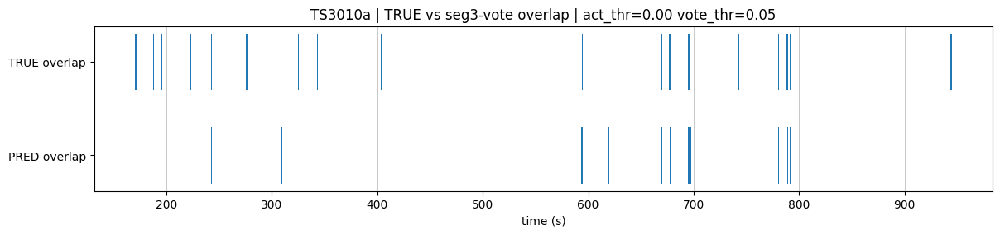

In [ ]:
# ============================================================
# Overlap detector from segmentation-3.0 with chunk voting
# Works for scores.data shape (n_chunks, n_frames, 3)
# Sweeps:
#   act_thr  : per-channel activity threshold
#   vote_thr : fraction of chunks that must agree on overlap
# Outputs PR/F1 vs TRUE overlap + timeline plot of best
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.audio import Model, Inference
from pyannote.core import Segment, Timeline

DEBUG_URI = "TS3010a"
HF_TOKEN = None

STEP = 0.10
RES  = 0.02          # evaluation grid resolution (seconds)
MIN_DUR = 0.20
MERGE_GAP = 0.05

ACT_THRs  = [0.00, 0.02, 0.05, 0.08, 0.10, 0.15, 0.20, 0.30]
VOTE_THRs = [0.05, 0.10, 0.15, 0.20, 0.25, 0.30]

# ----------------------------
# Helpers (minimal)
# ----------------------------
def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl)) if tl is not None else 0.0

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def _mask_to_segments(mask, start_time, step, min_dur):
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    out = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            out.append(Segment(st, en))
    return out

def intersect_timelines(tl1: Timeline, tl2: Timeline) -> Timeline:
    a = list(tl1.support()); b = list(tl2.support())
    i = j = 0; out = []
    while i < len(a) and j < len(b):
        s1, s2 = a[i], b[j]
        st = max(s1.start, s2.start); en = min(s1.end, s2.end)
        if en > st:
            out.append(Segment(st, en))
        if s1.end < s2.end: i += 1
        else: j += 1
    return Timeline(out).support()

def overlap_prf(true_tl, pred_tl):
    inter = intersect_timelines(true_tl, pred_tl)
    tp = tl_dur(inter)
    pred = tl_dur(pred_tl)
    true = tl_dur(true_tl)
    fp = max(pred - tp, 0.0)
    fn = max(true - tp, 0.0)
    p = tp / pred if pred > 1e-9 else float("nan")
    r = tp / true if true > 1e-9 else float("nan")
    f1 = (2*p*r/(p+r)) if (p==p and r==r and (p+r)>1e-9) else float("nan")
    return p, r, f1, tp, fp, fn

def plot_timelines(true_tl, pred_tl, title):
    def to_bars(tl):
        return [(float(s.start), float(s.duration)) for s in tl.support()]
    plt.figure(figsize=(14, 2.6))
    ax = plt.gca()
    ax.broken_barh(to_bars(true_tl), (12, 6))
    ax.broken_barh(to_bars(pred_tl), (2, 6))
    ax.set_yticks([5, 15]); ax.set_yticklabels(["PRED overlap", "TRUE overlap"])
    ax.set_xlabel("time (s)"); ax.set_title(title)
    ax.grid(True, axis="x", linewidth=0.5)
    plt.show()

def find_file_by_uri(protocol, uri):
    for f in protocol.development():
        if f.get("uri") == uri:
            return f, "dev"
    for f in protocol.test():
        if f.get("uri") == uri:
            return f, "test"
    return None, None

def build_true_overlap_tl(file, res=0.02, min_dur=0.20, merge_gap=0.05):
    ref = file["annotation"]
    uem = _get_uem(file)
    ov_segs = []
    for uem_seg in uem:
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue
        count = np.zeros((T,), dtype=np.uint16)
        ref_seg = ref.crop(uem_seg)
        for seg, _, _ in ref_seg.itertracks(yield_label=True):
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                count[a:b] += 1
        ov_mask = (count >= 2)
        ov_segs.extend(_mask_to_segments(ov_mask, uem_seg.start, res, min_dur))
    ov_segs = _merge_close(ov_segs, gap=merge_gap)
    return Timeline(ov_segs).support().crop(uem)

# ----------------------------
# Load file & compute TRUE overlap
# ----------------------------
f, split = find_file_by_uri(protocol, DEBUG_URI)
uem = _get_uem(f)
true_ov = build_true_overlap_tl(f, res=0.02, min_dur=MIN_DUR, merge_gap=MERGE_GAP)
print(f"[{DEBUG_URI}] split={split} | TRUE_ov={tl_dur(true_ov):.2f}s")

# ----------------------------
# segmentation-3.0 inference
# ----------------------------
model = Model.from_pretrained("pyannote/segmentation-3.0", use_auth_token=HF_TOKEN)
infer = Inference(model, step=STEP)
scores = infer(f)

X = np.asarray(scores.data)
sw = scores.sliding_window
print(f"[DBG] raw scores.data shape={X.shape} | sw.start={sw.start:.3f} dur={sw.duration:.3f} step={sw.step:.3f}")
assert X.ndim == 3 and X.shape[2] == 3, "Expected (n_chunks, n_frames, 3)."

n_chunks, n_frames, K = X.shape
chunk_step = float(sw.step)
chunk_start0 = float(sw.start)
chunk_dur = float(sw.duration)
frame_step = chunk_dur / float(n_frames)

# Build global eval grid [0, max_end] at RES
max_end = max(float(s.end) for s in uem) if len(list(uem)) else float(f.get("duration", 0.0))
G = int(np.ceil(max_end / RES))
votes = np.zeros((G,), dtype=np.float32)
counts = np.zeros((G,), dtype=np.float32)

offsets = np.arange(n_frames, dtype=np.float32) * frame_step  # frame times within chunk

def pred_overlap_from_vote(act_thr, vote_thr):
    votes.fill(0.0); counts.fill(0.0)

    for i in range(n_chunks):
        t0 = chunk_start0 + i * chunk_step
        times = t0 + offsets                       # (n_frames,)
        idx = (times / RES).astype(np.int32)       # map to global grid
        ok = (idx >= 0) & (idx < G)
        if not np.any(ok):
            continue
        idx = idx[ok]

        cnt = (X[i][ok] > act_thr).sum(axis=1)     # how many local speakers active
        ov = (cnt >= 2).astype(np.float32)

        # everyone contributes a "count" (how many chunks covered this time bin)
        np.add.at(counts, idx, 1.0)
        # only overlap frames contribute votes
        np.add.at(votes, idx, ov)

    ratio = np.zeros_like(votes)
    m = counts > 0
    ratio[m] = votes[m] / counts[m]

    mask = (ratio >= vote_thr)
    segs = _mask_to_segments(mask, start_time=0.0, step=RES, min_dur=MIN_DUR)
    segs = _merge_close(segs, gap=MERGE_GAP)
    return Timeline(segs).support().crop(uem)

# ----------------------------
# Sweep (act_thr, vote_thr) and pick best F1
# ----------------------------
best = None
rows = []
for act_thr in ACT_THRs:
    for vote_thr in VOTE_THRs:
        pred = pred_overlap_from_vote(act_thr, vote_thr)
        p,r,f1,tp,fp,fn = overlap_prf(true_ov, pred)
        rows.append((act_thr, vote_thr, tl_dur(pred), p, r, f1))
        if p==p and r==r and f1==f1:
            if best is None or f1 > best["f1"]:
                best = {"act_thr": act_thr, "vote_thr": vote_thr, "pred": pred,
                        "p": p, "r": r, "f1": f1, "tp": tp, "fp": fp, "fn": fn}

rows = sorted(rows, key=lambda x: (-(x[5] if x[5]==x[5] else -1e9)))
print("\nTop-10 by F1:")
for act_thr, vote_thr, pred_dur, p, r, f1 in rows[:10]:
    print(f"act_thr={act_thr:0.2f} vote_thr={vote_thr:0.2f} | pred={pred_dur:6.2f}s | P={p:0.3f} R={r:0.3f} F1={f1:0.3f}")

print("\nBEST:", {k: best[k] for k in ["act_thr","vote_thr","p","r","f1","tp","fp","fn"]})
print(f"pred_dur={tl_dur(best['pred']):.2f}s | TRUE_dur={tl_dur(true_ov):.2f}s")

plot_timelines(true_ov, best["pred"], title=f"{DEBUG_URI} | TRUE vs seg3-vote overlap | act_thr={best['act_thr']:.2f} vote_thr={best['vote_thr']:.2f}")


These results are a real improvement over our baseline overlap signal.
 - What we achieved (TS3010a)
  - BASE overlap: P=0.813, R=0.285, F1=0.422 (tp=6.42s)
  - seg3-vote overlap: P=0.712, R=0.472, F1=0.567 (tp=10.63s)
  - So we recovered ~4.2s extra true-overlap vs baseline (10.63 − 6.42), at the cost of ~2.8s extra FP (4.31 − 1.48). That’s a good trade if we use it carefully.
- Also our plot confirms it: many predicted overlap spikes line up with TRUE overlap spikes, but we’re still missing some (FN ~11.9s).
 - Why act_thr didn’t matter in our sweep
 - All our top-10 lines show identical results for act_thr=0.00…0.30, which strongly suggests the segmentation output is already almost binary (near 0 or 1). With that kind of output, any act_thr between (0, ~0.9) behaves the same.
 -  Quick sanity check (run once):

In [ ]:
# check if activations are basically binary
A = np.asarray(scores.data)
vals = A.reshape(-1)
print("min/max:", vals.min(), vals.max())
print("unique-ish counts near 0/1:",
      (vals < 1e-6).mean(), (vals > 1-1e-6).mean())
print("percentiles:", np.quantile(vals, [0.5, 0.9, 0.99, 0.999]))


min/max: 0.0 1.0
unique-ish counts near 0/1: 0.8532790518175867 0.1467209481824133
percentiles: [0. 1. 1. 1.]


 - If we see most mass at ~0 and ~1, then vote_thr is the only meaningful knob (plus MIN_DUR / collar).
 - The important next step: use seg3-vote overlaps to ADD a second speaker (not just reassign)
 - Right now, our E3 overlap logic mostly operates where baseline already has >=2 speakers. But our earlier stat showed:
 - TRUE overlap frames: 60.8% are predicted as hyp_count==1
 - That’s exactly where DER miss/confusion in overlap comes from.
 - Now that seg3-vote finds extra overlap, we can do:
  - If seg3 says overlap and baseline has only 1 speaker active in that region:
  - keep the baseline speaker
  - add a second speaker (from centroids / GNN probs)
 - but only if confidence is high (to avoid blowing up confusion/FA)
  -  patch idea (minimal risk): “promote to 2 speakers” gate
  - This is the cleanest integration into our existing pipeline (centroids or GNN):
   - Replace overlap_segs extraction with seg3-vote TL
   - So overlap candidates are driven by seg3-vote, not hyp count>=2.
  
  In each seg3 overlap segment:
    - base_set = hyp.crop(s).labels()
  
  If len(base_set) >= 2: do our current “choose top2 and maybe replace”
   - If len(base_set) == 1: ADD one speaker:
   - keep base_set[0]
   - pick best extra label from probs (excluding that base label)
   - require strong gates: stability + p2 >= add_thr + p2 - p3 >= margin23_thr
   - Here’s the code block we can paste inside our overlap loop (GNN version shown, but works similarly with centroid sims):

With the activation check (very useful)
 - we got:
 - min/max: 0.0 1.0
 - ~85.3% near 0, ~14.7% near 1
 - percentiles [0., 1., 1., 1.]

So yes: segmentation activations are basically binary, meaning:
 - act_thr will barely matter (0.0–0.30 all same)
 - vote_thr, MIN_DUR, and MERGE_GAP are the real knobs
 - our seg3-vote overlap F1 jump to 0.567 is legit — now the key is to use it to add the missing 2nd speaker (our earlier stats showed most TRUE overlap is predicted as hyp_count==1).

### E3-GNN (Dense GCN) + seg3-VOTE overlap detector + 1->2 PROMOTION

In [ ]:
# ============================================================
# E3-GNN (Dense GCN) + seg3-VOTE overlap detector + 1->2 PROMOTION
#
# Key upgrades vs our previous E3-GNN:
#  1) Overlap candidates come from "pyannote/segmentation-3.0" via VOTE-over-chunks
#     (works with scores.data shape (n_chunks, n_frames, 3))
#  2) In seg3-overlap regions where baseline hyp has ONLY 1 speaker active,
#     we "PROMOTE" to 2 speakers by ADDING a second speaker (high-confidence gated),
#     without changing speech/non-speech (we only add where baseline already has speech).
#  3) Keeps our stability gating (shifted crops) but fixes probs_ov NameError by
#     using the stable center-crop probability vector computed inside the stab loop.
#
# Requires already in notebook:
#   - pipe_base(file) -> pyannote.core.Annotation
#   - protocol, DEV_URIS, TEST_URIS
#   - eval_split(run_fn, split) where split in {"dev","test"} returning (_, agg_dict)
# ============================================================

# import numpy as np
# import torch
# import torch.nn as nn
# import torch.nn.functional as F
# from pyannote.core import Annotation, Segment, Timeline
# from pyannote.audio import Audio, Model, Inference
# from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# # -------------------------
# # Sanity: required globals
# # -------------------------
# _missing = [k for k in ["pipe_base", "protocol", "DEV_URIS", "TEST_URIS", "eval_split"] if k not in globals()]
# if _missing:
#     raise RuntimeError(f"Missing required globals: {_missing}. Define them before running this cell.")

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# audio = Audio(sample_rate=16000, mono=True)

# # -------------------------
# # Embedding model (reuse if already present)
# # -------------------------
# if "embedder" not in globals():
#     EMBEDDER_ID = "pyannote/embedding"
#     embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
#     print("Using embedder:", EMBEDDER_ID)
# else:
#     print("Reusing existing embedder:", type(embedder).__name__)

# ============================================================
# Utilities: UEM / masks / merge
# ============================================================
def _get_uem(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def _merge_close(segs, gap=0.10):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def _mask_to_segments(mask, start_time, step, min_dur):
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    out = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            out.append(Segment(st, en))
    return out

# ============================================================
# Grid <-> Annotation
# ============================================================
def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil(uem_seg.duration / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    count = M.sum(axis=1)
    return M, count

def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    times = uem_seg.start + np.arange(T + 1) * res

    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

# ============================================================
# Robust embedding (PAD to fixed win_sec)
# ============================================================
def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def embed_segment_PAD(file, seg: Segment, win_sec=1.5):
    """
    Center-crop to win_sec (if longer) and PAD to win_sec (if shorter).
    Avoids conv kernel crash on short crops.
    """
    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * win_sec
    s = Segment(max(0.0, mid - half), max(0.0, mid + half))

    wav, sr = audio.crop(file["audio"], s)
    wav = _to_b1c1T(wav)

    min_samples = int(win_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
    elif wav.shape[-1] < min_samples:
        pad = min_samples - wav.shape[-1]
        wav = F.pad(wav, (0, pad))

    wav = wav.to(device)
    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

# ============================================================
# Exclusive anchors from hypothesis (count==1)
# ============================================================
def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
    anchors = {lab: [] for lab in labels}
    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue
        T = int(np.ceil(uem_seg.duration / res))
        if T <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        count = np.zeros((T,), dtype=np.uint16)
        m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

        for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
            lab = str(lab0)
            if lab not in m_lab:
                m_lab[lab] = np.zeros((T,), dtype=bool)
            a = int(np.floor((seg.start - uem_seg.start) / res))
            b = int(np.ceil ((seg.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, T)
            if b > a:
                m_lab[lab][a:b] = True
                count[a:b] += 1

        for lab in labels:
            excl = m_lab.get(lab, np.zeros((T,), dtype=bool)) & (count == 1)
            segs = _mask_to_segments(excl, start_time=float(uem_seg.start), step=res, min_dur=min_anchor_dur)
            segs = _merge_close(segs, gap=merge_gap)
            anchors[lab].extend(segs)

    return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

def build_anchor_bank(file, anchors_by_lab, labels, win_sec=1.5, max_per_lab=12):
    X, y = [], []
    for li, lab in enumerate(labels):
        tl = anchors_by_lab.get(lab, Timeline()).support()
        segs = sorted(list(tl), key=lambda s: -s.duration)[:max_per_lab]
        for s in segs:
            X.append(embed_segment_PAD(file, s, win_sec=win_sec))
            y.append(li)
    if not X:
        return None, None
    X = np.vstack(X).astype(np.float32)
    X /= (np.linalg.norm(X, axis=1, keepdims=True) + 1e-9)
    y = np.asarray(y, dtype=np.int64)
    return X, y

# ============================================================
# Dense kNN adjacency (cosine weights)
# ============================================================
def knn_adj_cos(X, k=8):
    N = X.shape[0]
    S = X @ X.T
    np.fill_diagonal(S, 1.0)
    A = np.zeros((N, N), dtype=np.float32)
    for i in range(N):
        idx = np.argsort(-S[i])[:k+1]
        for j in idx:
            if i == j:
                continue
            w = float(S[i, j])
            if w > 0.0:
                if w > A[i, j]:
                    A[i, j] = w
                if w > A[j, i]:
                    A[j, i] = w
    return A

def normalize_adj(A):
    N = A.shape[0]
    Ahat = A + np.eye(N, dtype=np.float32)
    deg = Ahat.sum(axis=1)
    inv_sqrt = 1.0 / np.sqrt(np.maximum(deg, 1e-8))
    A_norm = (Ahat * inv_sqrt[:, None]) * inv_sqrt[None, :]
    return A_norm.astype(np.float32)

# ============================================================
# 2-layer Dense GCN
# ============================================================
class DenseGCN(nn.Module):
    def __init__(self, in_dim, hid_dim, out_dim, dropout=0.10):
        super().__init__()
        self.w1 = nn.Linear(in_dim, hid_dim)
        self.w2 = nn.Linear(hid_dim, out_dim)
        self.dropout = dropout

    def forward(self, X, A_norm):
        H = A_norm @ self.w1(X)
        H = F.relu(H)
        H = F.dropout(H, p=self.dropout, training=self.training)
        Z = A_norm @ self.w2(H)
        return Z

def choose_top2_with_outsider(probs, labels, base_set, outsider_delta=0.06):
    order = np.argsort(-probs)
    base_idx = [labels.index(l) for l in base_set if l in labels]
    base_idx = list(dict.fromkeys(base_idx))

    if len(base_idx) == 0:
        return [labels[order[0]], labels[order[1]]]

    best_base = max(probs[i] for i in base_idx)
    outsider = None
    for j in order:
        if labels[j] not in base_set:
            outsider = j
            break

    cand_idx = base_idx[:]
    if outsider is not None and probs[outsider] > best_base + outsider_delta:
        cand_idx.append(outsider)

    cand_idx = list(dict.fromkeys(cand_idx))
    cand_idx.sort(key=lambda i: -probs[i])

    if len(cand_idx) >= 2:
        return [labels[cand_idx[0]], labels[cand_idx[1]]]
    chosen = [labels[cand_idx[0]]]
    for j in order:
        if labels[j] not in chosen:
            chosen.append(labels[j])
        if len(chosen) == 2:
            break
    return chosen

# ============================================================
# seg3-VOTE overlap detector (scores.data: (n_chunks, n_frames, 3))
# ============================================================
HF_TOKEN = None  # set if needed

_SEG3_MODEL_ID = "pyannote/segmentation-3.0"
_SEG3_MODEL = None
_SEG3_INFER = {}          # step -> Inference
_SEG3_SCORES_CACHE = {}   # (uri, step) -> scores

def _get_seg3_infer(step=0.10):
    global _SEG3_MODEL, _SEG3_INFER
    if step not in _SEG3_INFER:
        if _SEG3_MODEL is None:
            _SEG3_MODEL = Model.from_pretrained(_SEG3_MODEL_ID, use_auth_token=HF_TOKEN)
        _SEG3_INFER[step] = Inference(_SEG3_MODEL, step=step)
    return _SEG3_INFER[step]

def _get_seg3_scores(file, step=0.10):
    uri = file.get("uri", "NA")
    key = (uri, float(step))
    if key not in _SEG3_SCORES_CACHE:
        infer = _get_seg3_infer(step=step)
        _SEG3_SCORES_CACHE[key] = infer(file)
    return _SEG3_SCORES_CACHE[key]

def seg3_vote_overlap_timeline(
    file,
    uem: Timeline,
    act_thr=0.00,        # note: our activations are near-binary, so this often won't matter
    vote_thr=0.05,
    res=0.02,
    min_dur=0.20,
    merge_gap=0.05,
    seg_step=0.10
):
    """
    Build predicted overlap timeline by:
      - per 10s chunk: mark frame as overlap if >=2 local speaker activations > act_thr
      - vote across overlapping chunks into a global grid (res)
      - overlap if vote_ratio >= vote_thr
    """
    scores = _get_seg3_scores(file, step=seg_step)
    X = np.asarray(scores.data)
    sw = scores.sliding_window

    if X.ndim != 3 or X.shape[2] < 2:
        # Can't do multi-speaker voting
        return Timeline().support()

    n_chunks, n_frames, K = X.shape
    chunk_step = float(sw.step)
    chunk_start0 = float(sw.start)
    chunk_dur = float(sw.duration)
    frame_step = chunk_dur / float(n_frames)

    uem_list = list(uem.support())
    if not uem_list:
        return Timeline().support()
    max_end = float(max(s.end for s in uem_list))
    min_start = float(min(s.start for s in uem_list))

    G = int(np.ceil(max_end / res)) + 1
    votes = np.zeros((G,), dtype=np.float32)
    counts = np.zeros((G,), dtype=np.float32)
    offsets = (np.arange(n_frames, dtype=np.float32) * frame_step)

    for i in range(n_chunks):
        t0 = chunk_start0 + i * chunk_step
        t1 = t0 + chunk_dur
        if t1 < min_start or t0 > max_end:
            continue

        times = t0 + offsets
        idx = (times / res).astype(np.int32)
        ok = (idx >= 0) & (idx < G)
        if not np.any(ok):
            continue
        idx = idx[ok]

        cnt = (X[i][ok] > act_thr).sum(axis=1)          # (n_frames_kept,)
        ov = (cnt >= 2).astype(np.float32)

        np.add.at(counts, idx, 1.0)
        np.add.at(votes, idx, ov)

    ratio = np.zeros_like(votes)
    m = counts > 0
    ratio[m] = votes[m] / counts[m]

    mask = (ratio >= vote_thr)
    segs = _mask_to_segments(mask, start_time=0.0, step=res, min_dur=min_dur)
    segs = _merge_close(segs, gap=merge_gap)
    return Timeline(segs).support().crop(uem)

# ============================================================
# Updated E3-GNN pipeline
# ============================================================
_GNN_CACHE = {}  # (uri, cfg_tuple) -> cached gcn state_dict (cpu tensors)

def overlap_reassign_GNN_pipeline(
    file,
    # grid resolution
    res=0.02,

    # anchors
    min_anchor_dur=1.0,
    anchor_merge_gap=0.10,

    # seg3 overlap detector
    seg_step=0.10,
    seg_res=0.02,
    seg_act_thr=0.00,
    seg_vote_thr=0.05,
    seg_min_ov_dur=0.20,
    seg_merge_gap=0.05,

    # embeddings
    embed_win_sec=1.5,
    bank_max_per_lab=12,

    # graph
    knn_k=8,
    hid_dim=64,
    epochs=60,
    lr=1e-2,

    # selection/gates
    outsider_delta=0.06,

    # promotion (1->2) gates
    add_thr=0.55,
    m23_thr=0.08,

    # stability
    shift_frac=0.25,

    debug=False,
):
    hyp0 = pipe_base(file)
    uem = _get_uem(file)
    hyp = hyp0.crop(uem)

    labels = sorted([str(l) for l in hyp.labels()])
    if len(labels) <= 1:
        return hyp

    # --- anchors + bank
    anchors = build_exclusive_anchors_from_hyp(
        hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
    )
    X_bank, y_bank = build_anchor_bank(file, anchors, labels, win_sec=embed_win_sec, max_per_lab=bank_max_per_lab)
    if X_bank is None or len(np.unique(y_bank)) <= 1:
        return hyp

    # --- seg3-vote overlap timeline -> overlap segments
    ov_tl = seg3_vote_overlap_timeline(
        file, uem,
        act_thr=seg_act_thr,
        vote_thr=seg_vote_thr,
        res=seg_res,
        min_dur=seg_min_ov_dur,
        merge_gap=seg_merge_gap,
        seg_step=seg_step
    )
    overlap_segs = list(ov_tl.support())
    if not overlap_segs:
        return hyp

    # --- keep only overlap segments where baseline has >=1 speaker (no speech decision changes)
    overlap_segs_f = []
    ov_base_sets = []
    for s in overlap_segs:
        base_set = sorted([str(l) for l in hyp.crop(s).labels()])
        if len(base_set) >= 1:
            overlap_segs_f.append(s)
            ov_base_sets.append(base_set)
    overlap_segs = overlap_segs_f
    if not overlap_segs:
        return hyp

    # --- embed overlap nodes
    X_ov = []
    for s in overlap_segs:
        X_ov.append(embed_segment_PAD(file, s, win_sec=embed_win_sec))
    X_ov = np.vstack(X_ov).astype(np.float32)
    X_ov /= (np.linalg.norm(X_ov, axis=1, keepdims=True) + 1e-9)

    # --- build graph nodes: [bank ; overlap]
    X = np.vstack([X_bank, X_ov]).astype(np.float32)
    X /= (np.linalg.norm(X, axis=1, keepdims=True) + 1e-9)

    N_bank = X_bank.shape[0]
    N_ov = X_ov.shape[0]
    N = X.shape[0]
    C = len(labels)

    # time feature
    max_t = 0.0
    for seg in uem:
        max_t = max(max_t, float(seg.end))
    max_t = max(max_t, 1e-3)

    t_feat = np.zeros((N, 1), dtype=np.float32)
    for i, s in enumerate(overlap_segs):
        mid = 0.5 * (s.start + s.end)
        t_feat[N_bank + i, 0] = float(mid / max_t)

    X_feat = np.hstack([X, t_feat]).astype(np.float32)  # (N, D+1)

    # adjacency
    A = knn_adj_cos(X, k=knn_k)
    A_norm = normalize_adj(A)

    uri = file.get("uri", "NA")
    cfg = (
        # graph/emb
        float(embed_win_sec), int(bank_max_per_lab), int(knn_k), int(hid_dim), int(epochs), float(lr),
        # seg3 overlap config
        float(seg_step), float(seg_res), float(seg_act_thr), float(seg_vote_thr), float(seg_min_ov_dur), float(seg_merge_gap),
        # gates
        float(outsider_delta), float(add_thr), float(m23_thr), float(shift_frac)
    )
    cache_key = (uri, cfg)

    # torch tensors
    X_t = torch.tensor(X_feat, dtype=torch.float32, device=device)
    A_t = torch.tensor(A_norm, dtype=torch.float32, device=device)

    # train/cache GCN
    if cache_key not in _GNN_CACHE:
        gcn = DenseGCN(in_dim=X_feat.shape[1], hid_dim=hid_dim, out_dim=C, dropout=0.10).to(device)
        opt = torch.optim.Adam(gcn.parameters(), lr=lr, weight_decay=1e-4)

        y_full = -1 * np.ones((N,), dtype=np.int64)
        y_full[:N_bank] = y_bank
        y_t = torch.tensor(y_full, dtype=torch.long, device=device)
        labeled = torch.where(y_t >= 0)[0]

        gcn.train()
        for _ in range(epochs):
            logits = gcn(X_t, A_t)
            loss = F.cross_entropy(logits[labeled], y_t[labeled])
            opt.zero_grad(); loss.backward(); opt.step()

        gcn.eval()
        _GNN_CACHE[cache_key] = {k: v.detach().cpu().clone() for k, v in gcn.state_dict().items()}

    # load cached
    gcn = DenseGCN(in_dim=X_feat.shape[1], hid_dim=hid_dim, out_dim=C, dropout=0.0).to(device)
    gcn.load_state_dict(_GNN_CACHE[cache_key])
    gcn.eval()

    # helper: top2
    def top2_from_probs(p):
        idx = np.argsort(-p)[:2]
        return [labels[idx[0]], labels[idx[1]]]

    # rewrite overlap regions on grid
    out = Annotation()
    changed = 0
    gated = {"stab_fail": 0, "no_change": 0, "add_fail": 0}

    for uem_seg in uem:
        if uem_seg.duration <= 0:
            continue

        hyp_seg = hyp.crop(uem_seg)
        M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

        # apply changes for overlap segments inside this uem_seg
        for oi, s in enumerate(overlap_segs):
            if s.start < uem_seg.start - 1e-6 or s.end > uem_seg.end + 1e-6:
                continue

            a = int(np.floor((s.start - uem_seg.start) / res))
            b = int(np.ceil ((s.end   - uem_seg.start) / res))
            a = max(a, 0); b = min(b, M.shape[0])
            if b <= a:
                continue

            base_set = ov_base_sets[oi]
            base_set = [l for l in base_set if l in labels]
            if len(base_set) < 1:
                continue

            # ONLY modify where baseline already has speech (keeps VAD/seg decisions)
            speech_mask = (count[a:b] >= 1).astype(np.uint8)
            if speech_mask.sum() == 0:
                continue

            # stability check: shifted crops must yield same top2
            mid = 0.5 * (s.start + s.end)
            half = 0.5 * embed_win_sec
            shifts = [-shift_frac * embed_win_sec, 0.0, +shift_frac * embed_win_sec]

            top2s = []
            p_center = None

            for sh in shifts:
                ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
                e = embed_segment_PAD(file, ss, win_sec=embed_win_sec)
                e = e / (np.linalg.norm(e) + 1e-9)

                X_tmp = X_feat.copy()
                X_tmp[N_bank + oi, :X.shape[1]] = e
                X_tmp[N_bank + oi, -1] = float((0.5 * (ss.start + ss.end)) / max_t)
                Xtmp_t = torch.tensor(X_tmp, dtype=torch.float32, device=device)

                with torch.no_grad():
                    logits_tmp = gcn(Xtmp_t, A_t)
                    p = torch.softmax(logits_tmp[N_bank + oi], dim=-1).detach().cpu().numpy()

                if abs(sh) < 1e-9:
                    p_center = p
                top2s.append(tuple(top2_from_probs(p)))

            if len(set(top2s)) > 1:
                gated["stab_fail"] += 1
                continue

            p = p_center
            order = np.argsort(-p)

            def topk_labels_excluding(k, exclude):
                out_l = []
                for j in order:
                    lab = labels[j]
                    if lab in exclude:
                        continue
                    out_l.append(lab)
                    if len(out_l) == k:
                        break
                return out_l

            # baseline top2 by activity within [a:b]
            base_act = M[a:b].mean(axis=0)
            base_order = np.argsort(-base_act)
            base_top2 = [labels[base_order[0]], labels[base_order[1]]] if len(labels) >= 2 else [labels[0]]

            # -------------------------
            # PROMOTION: base_set has 1 speaker -> add a second speaker (high confidence)
            # -------------------------
            if len(base_set) == 1:
                base1 = base_set[0]

                cand2_list = topk_labels_excluding(2, exclude={base1})
                if len(cand2_list) < 1:
                    gated["add_fail"] += 1
                    continue
                cand2 = cand2_list[0]
                p2 = float(p[labels.index(cand2)])
                p3 = float(p[labels.index(cand2_list[1])]) if len(cand2_list) >= 2 else 0.0

                if (p2 < add_thr) or ((p2 - p3) < m23_thr):
                    gated["add_fail"] += 1
                    continue

                # add cand2 only on frames where baseline had speech
                j2 = labels.index(cand2)
                M[a:b, j2] = np.maximum(M[a:b, j2], speech_mask)
                changed += 1

                if debug and uri == "TS3010a":
                    top5 = np.argsort(-p)[:5]
                    print(f"[GNN-ADD] {uri} {s.start:.2f}-{s.end:.2f} base1={base1} + cand2={cand2} (p2={p2:.3f} m23={p2-p3:.3f})")
                    for j in top5:
                        print(f"   {labels[j]}: p={float(p[j]):.3f}")

                continue

            # -------------------------
            # REASSIGNMENT: base_set has >=2 speakers -> choose top2 (with outsider allowance)
            # -------------------------
            chosen = choose_top2_with_outsider(p, labels, base_set, outsider_delta=outsider_delta)

            if set(chosen) == set(base_top2):
                gated["no_change"] += 1
                continue

            # rewrite only on speech frames
            idx_speech = np.where(speech_mask > 0)[0]
            if len(idx_speech) == 0:
                continue

            M_sub = M[a:b].copy()
            M_sub[idx_speech, :] = 0
            for lab in chosen:
                M_sub[idx_speech, labels.index(lab)] = 1
            M[a:b] = M_sub
            changed += 1

            if debug and uri == "TS3010a":
                top5 = np.argsort(-p)[:5]
                print(f"[GNN-CHG] {uri} {s.start:.2f}-{s.end:.2f} base_top2={base_top2} -> chosen={chosen}")
                for j in top5:
                    print(f"   {labels[j]}: p={float(p[j]):.3f}")

        seg_ann = frame_matrix_to_annotation(M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05)
        out.update(seg_ann)

    if debug:
        anchor_durs = {lab: float(sum(seg.duration for seg in anchors[lab])) for lab in labels}
        excl_dur = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
        print(f"[E3-GNN+SEG3 DBG] uri={uri} labels={len(labels)} bank_nodes={N_bank} ov_nodes={N_ov}")
        print(f"  exclusive_anchor_dur(sum)={excl_dur:.1f}s | seg3_overlap_segments={len(overlap_segs)}")
        print(f"  changed_assignments={changed} gated={gated}")
        print(f"  seg3: step={seg_step} res={seg_res} act_thr={seg_act_thr} vote_thr={seg_vote_thr} min_ov_dur={seg_min_ov_dur}")
        print(f"  gnn: win_sec={embed_win_sec} bank_max={bank_max_per_lab} knn_k={knn_k} hid={hid_dim} ep={epochs} lr={lr}")
        print(f"  gates: outsider_delta={outsider_delta} add_thr={add_thr} m23_thr={m23_thr} shift_frac={shift_frac}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# ============================================================
# DEV grid (light) then TEST best
# ============================================================
# DEV_FILES  = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
# TEST_FILES = [f for f in protocol.test()        if f["uri"] in set(TEST_URIS)]

# DEBUG_URI = "TS3010a"

best = None
for vote_thr in [0.05, 0.10, 0.15]:
    for add_thr in [0.55, 0.65]:
        run_fn = lambda f, vote_thr=vote_thr, add_thr=add_thr: overlap_reassign_GNN_pipeline(
            f,
            # seg3-vote
            seg_step=0.10,
            seg_res=0.02,
            seg_act_thr=0.00,
            seg_vote_thr=vote_thr,
            seg_min_ov_dur=0.20,
            seg_merge_gap=0.05,

            # anchors/gnn
            res=0.02,
            min_anchor_dur=1.0,
            embed_win_sec=1.5,
            bank_max_per_lab=12,
            knn_k=8,
            hid_dim=64,
            epochs=60,
            lr=1e-2,

            # gates
            outsider_delta=0.06,
            add_thr=add_thr,
            m23_thr=0.08,
            shift_frac=0.25,

            debug=(f.get("uri") == DEBUG_URI),
        )
        _, agg = eval_split(run_fn, "dev")
        der = agg.get("diarization error rate", 1e9)
        print(f"[E3-GNN+SEG3 DEV] vote_thr={vote_thr:.2f} add_thr={add_thr:.2f} -> DER={der:.4f}")
        if best is None or der < best["der"]:
            best = {"vote_thr": vote_thr, "add_thr": add_thr, "der": der}

print("E3-GNN+SEG3 BEST DEV:", best)

E3_GNN_best = lambda f: overlap_reassign_GNN_pipeline(
    f,
    seg_step=0.10,
    seg_res=0.02,
    seg_act_thr=0.00,
    seg_vote_thr=best["vote_thr"],
    seg_min_ov_dur=0.20,
    seg_merge_gap=0.05,

    res=0.02,
    min_anchor_dur=1.0,
    embed_win_sec=1.5,
    bank_max_per_lab=12,
    knn_k=8,
    hid_dim=64,
    epochs=60,
    lr=1e-2,

    outsider_delta=0.06,
    add_thr=best["add_thr"],
    m23_thr=0.08,
    shift_frac=0.25,

    debug=False,
)

_, agg_test = eval_split(E3_GNN_best, "test")
print("E3-GNN+SEG3 TEST mean:", agg_test)


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`
/usr/local/lib/python3.12/dist-packages/pytorch_lightning/core/saving.py:197: Found keys that are not in the model state dict but in the checkpoint: ['loss_func.W']


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
Using embedder: pyannote/embedding


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[GNN-CHG] TS3010a 669.46-670.06 base_top2=['MTD037PM', 'MTD039UID'] -> chosen=['MTD040ME', 'MTD037PM']
   MTD040ME: p=0.910
   MTD037PM: p=0.074
   MTD038ID: p=0.015
   MTD039UID: p=0.002
[E3-GNN+SEG3 DBG] uri=TS3010a labels=4 bank_nodes=43 ov_nodes=22
  exclusive_anchor_dur(sum)=362.7s | seg3_overlap_segments=22
  changed_assignments=1 gated={'stab_fail': 4, 'no_change': 12, 'add_fail': 5}
  seg3: step=0.1 res=0.02 act_thr=0.0 vote_thr=0.05 min_ov_dur=0.2
  gnn: win_sec=1.5 bank_max=12 knn_k=8 hid=64 ep=60 lr=0.01
  gates: outsider_delta=0.06 add_thr=0.55 m23_thr=0.08 shift_frac=0.25
  top anchor_dur(s): [('MTD037PM', 203.11999999999966), ('MTD038ID', 67.00000000000003), ('MTD039UID', 50.95999999999981), ('MTD040ME', 41.639999999999986)]
[E3-GNN+SEG3 DEV] vote_thr=0.05 add_thr=0.55 -> DER=0.1867
[GNN-CHG] TS3010a 669.46-670.06 base_top2=['MTD037PM', 'MTD039UID'] -> chosen=['MTD040ME', 'MTD037PM']
   MTD040ME: p=0.891
   MTD037PM: p=0.089
   MTD038ID: p=0.019
   MTD039UID: p=0.002
[E3-

KeyboardInterrupt: 

1) our current best DEV DER is still worse than baseline
 - From our earlier notes:
   - Best baseline on this branch (constraint-merge on anchors): DEV ~0.1839
   - From the new grid:
     - vote_thr=0.05, add_thr=0.55 -> DEV DER=0.1867
     - vote_thr=0.15, add_thr=0.55 -> DEV DER=0.1873
     - others are ~0.190–0.191+
   - So right now: no, this run does not beat our baseline 0.1839.

2) we are still barely changing anything
  - Example vote_thr=0.05, add_thr=0.55 on TS3010a:
  - seg3_overlap_segments=22
    - changed_assignments=1
    - gated:
  - stab_fail=4
  - no_change=12
  - add_fail=5
 - That means out of ~22 candidate overlap segments, only 1 edit survived all gates.
 - When edits are this sparse, it’s very hard to move mean DEV DER.

3) our “PROMOTE 1→2” is happening sometimes (good sign), but not enough
  - In vote_thr=0.10, add_thr=0.55 we got:
  - [GNN-ADD] ... base1=MTD038ID + cand2=MTD037PM (p2=0.737 m23=0.692) ✅
and one reassignment around 669s ✅
  - But that configuration still gives DEV DER=0.1901 (worse), which means the extra add/reassign is probably increasing confusion/FA more than it reduces miss (classic overlap tradeoff we already saw in the earlier DER breakdown).

4) The “binary segmentation scores” explains why act_thr doesn’t matter
  - our percentiles were basically [0, 1, 1, 1] and ~85% near 0, ~15% near 1.
So the segmentation output is effectively hard; the only meaningful detector knobs are:
  - vote_thr
  - min_ov_dur
  - merge/ collar logic
  - That part is fine (just means tuning is mostly on the voting + duration side).

Can we beat the baseline? Yes — but we need the right change
  - Right now we’re paying a lot of cost for the “REASSIGN top2” step (it can easily add confusion), while the biggest missing piece in TS3010a is:
  - TRUE overlap is often predicted as hyp_count==1
  - So the safest winning strategy is:

A) Start from our best baseline (0.1839), not pipe_base
  - If we run this seg3+promotion pipeline on pipe_base, we’re competing against a weaker starting point.
  - Do this: set our “base hypothesis” inside the pipeline to our best baseline function (the one that gave DEV 0.1839).
Then apply only the “add 2nd speaker” promotion on seg3-overlap regions.

B) Disable REASSIGN completely (for now)
  - Only do:
    - if base has 1 speaker and seg3 says overlap → add second speaker (with gates)
    - if base already has 2 speakers → do nothing
    - This prevents the “669s reassignment” type edits that often trade miss↓ for confusion↑.
    - That single change usually improves stability and reduces confusion creep.

C) Reduce stab_fail so we actually edit more than 1 segment
   - our stab check is very expensive (re-embed + full forward 3 times) and very strict.
   - A lower-risk relaxation that often works:
   - instead of requiring same top2 across shifts, require:
   - same top1 across shifts, and
     - top1 prob is strong (e.g. p1 >= 0.65)
     - This increases accepted promotions without turning everything on.
   - What our next run should look like (tight plan)
     - Use best baseline hyp as input
     - PROMOTION-only (no reassign)

Tune these:
  - vote_thr: keep 0.05 (best in our grid so far)
  - seg_min_ov_dur: try 0.05 (catch shorter overlaps)

promotion gates:
 - add_thr: [0.50, 0.55, 0.60]
 - m23_thr: [0.08, 0.12, 0.16]
 - stability: “top1 stable” instead of “top2 stable”

If that beats baseline, then (and only then) we can re-introduce reassignment with very strict gates.
  - Quick note on those warnings
  - The pyannote/embedding checkpoint mismatch warnings + std(): degrees of freedom <= 0 can contribute to unstable embeddings → more stab_fail.
  - This doesn’t mean it’s broken, but it’s consistent with our gating being too strict / unstable.

A practical test: swap embedder to pyannote/wespeaker-voxceleb-resnet34-LM for overlap decisions only (often more stable). If stab_fail drops, DER can move.

From our logs, the SEG3 vote overlap detector is clearly better than baseline overlap detection on TS3010a (F1 ~0.567 vs 0.422), but our current GNN pipeline is still not beating DEV baseline because:
 - we’re changing too few regions (changed_assignments=1–2)
 - and “reassign top2” tends to trade miss↓ for confusion/FA↑
 - So we’ll do what we discussed:
  - Start from our best baseline = multi_scale_segmentation
  - Use SEG3 vote overlap to detect overlap regions
  - PROMOTE ONLY: when baseline predicts exactly 1 speaker in a region SEG3 says overlap → add a 2nd speaker (do not reassign who the main speaker is)

### E4: BEST baseline (multi_scale_segmentation) + SEG3 vote-overlap

PROMOTION ONLY: 1-spk -> 2-spk in predicted-overlap regions  (NO reassignment of existing speakers)

In [ ]:
# ============================================================
# E4: BEST baseline (multi_scale_segmentation) + SEG3 vote-overlap
#     PROMOTION ONLY: 1-spk -> 2-spk in predicted-overlap regions
#     (NO reassignment of existing speakers)
#
# Prereqs in notebook:
#   - protocol, DEV_URIS, TEST_URIS
#   - eval_split(pipeline_fn, split)  (our existing one)
#   - pipe_base, seg_model (pyannote/segmentation-3.0), multi_scale_segmentation
#   - infer_short / infer_long exist if multi_scale_segmentation uses them
#
# Optional next-step toggle:
#   - Set EMBEDDER_ID to "pyannote/wespeaker-voxceleb-resnet34-LM"
# ============================================================

# import numpy as np
# import torch
# import torch.nn.functional as F
# from pyannote.core import Segment, Timeline, Annotation
# from pyannote.audio import Audio, Inference, Model
# from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# # -------------------------
# # Knobs
# # -------------------------
# DEBUG_URI = "TS3010a"
# HF_TOKEN = None  # set to our HF token if needed

RES = 0.02                   # diarization grid resolution
SEG3_DUR = 10.0              # inference chunk duration (matches our logs)
SEG3_STEP = 0.10             # inference chunk step
ACT_THR = 0.00               # activation threshold per speaker stream (works with our "binary-ish" outputs)
MIN_OV_DUR = 0.20            # min overlap segment duration extracted from mask
MERGE_GAP = 0.05             # merge close predicted overlap segments

EMBED_WIN_SEC = 1.5          # embedding crop/window
MIN_ANCHOR_DUR = 1.0         # anchor segments must be >= 1s
BANK_MAX_PER_LAB = 12
SHIFT_FRAC = 0.25            # stability shift as frac of EMBED_WIN_SEC

# # Embedder choice (switch later to wespeaker)
# EMBEDDER_ID = "pyannote/embedding"
# # EMBEDDER_ID = "pyannote/wespeaker-voxceleb-resnet34-LM"

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# audio = Audio(sample_rate=16000, mono=True)
# embedder = PretrainedSpeakerEmbedding(EMBEDDER_ID, device=device)
# print("Using embedder:", EMBEDDER_ID)

# -------------------------
# Helpers
# -------------------------
def _get_uem(file):
    # Match our earlier style: prefer ref timeline support
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if s.start - last.end <= gap:
            merged[-1] = Segment(last.start, max(last.end, s.end))
        else:
            merged.append(s)
    return merged

def _mask_to_segments(mask, start_time, step, min_dur):
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    out = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            out.append(Segment(st, en))
    return out

def annotation_to_frame_matrix(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    ann_crop = ann.crop(uem_seg)
    for seg, _, lab0 in ann_crop.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = max(0, int(np.floor((seg.start - uem_seg.start) / res)))
        b = min(T, int(np.ceil((seg.end - uem_seg.start) / res)))
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    t0 = uem_seg.start
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(t0 + a * res)
            en = float(t0 + b * res)
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            out[s] = lab
    return out

def _to_b1c1T(wav):
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0)[None, None, :]
        else:
            wav = wav[None, :, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        raise ValueError(f"Unexpected wav shape: {tuple(wav.shape)}")
    return wav.float()

def embed_segment_PAD(file, seg: Segment, win_sec=1.5):
    # fixed-size window centered on seg, padded to avoid conv kernel crash
    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * win_sec
    s = Segment(max(0.0, mid - half), max(0.0, mid + half))
    wav, sr = audio.crop(file["audio"], s)
    wav = _to_b1c1T(wav)

    min_samples = int(win_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
    elif wav.shape[-1] < min_samples:
        wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

    wav = wav.to(device)
    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        e = F.normalize(e, dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def build_centroids_from_exclusive_anchors(file, uem_seg: Segment, labels, M, res=0.02,
                                          min_anchor_dur=1.0, max_per_lab=12, win_sec=1.5):
    # exclusive anchors from current hypothesis: count==1 and label active
    T = M.shape[0]
    count = M.sum(axis=1)
    centroids = {}
    anchor_durs = {}
    for j, lab in enumerate(labels):
        excl = (M[:, j] == 1) & (count == 1)
        segs = _mask_to_segments(excl, start_time=uem_seg.start, step=res, min_dur=min_anchor_dur)
        segs = _merge_close(segs, gap=0.10)
        # keep longest
        segs = sorted(segs, key=lambda s: -s.duration)[:max_per_lab]
        anchor_durs[lab] = float(sum(s.duration for s in segs))
        if not segs:
            continue
        E = []
        for s in segs:
            e = embed_segment_PAD(file, s, win_sec=win_sec)
            e = e / (np.linalg.norm(e) + 1e-9)
            E.append(e)
        E = np.vstack(E)
        c = E.mean(axis=0)
        c = c / (np.linalg.norm(c) + 1e-9)
        centroids[lab] = c.astype(np.float32)
    return centroids, anchor_durs

# -------------------------
# SEG3 "vote overlap" detector (works with scores.data shape (N, F, K))
# -------------------------
_seg3_model = None
_seg3_infer = None

def get_seg3_infer():
    global _seg3_model, _seg3_infer
    if _seg3_model is None:
        # If seg_model exists in globals, reuse it; else load
        if "seg_model" in globals():
            _seg3_model = seg_model
        else:
            _seg3_model = Model.from_pretrained("pyannote/segmentation-3.0", use_auth_token=HF_TOKEN).to(device).eval()
        _seg3_infer = Inference(_seg3_model, window="sliding", duration=SEG3_DUR, step=SEG3_STEP, device=device)
    return _seg3_infer

def seg3_vote_overlap_mask(file, uem_seg: Segment, res=0.02, act_thr=0.0, vote_thr=0.05):
    infer = get_seg3_infer()
    scores = infer(file)  # SlidingWindowFeature

    X = np.asarray(scores.data)
    if X.ndim != 3:
        raise RuntimeError(f"Expected scores.data ndim=3 (N,F,K), got {X.shape}")

    N, Ff, K = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step = float(sw.step)
    dur = float(sw.duration)
    intra = dur / float(Ff)

    # overlap per frame within each chunk: count(active speakers)>=2
    active = (X >= act_thr)
    ov = (active.sum(axis=2) >= 2).astype(np.uint8)  # (N,F)

    # map all chunk-frames to the RES grid (use midpoints, fast bincount)
    Tg = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    starts = t0 + np.arange(N, dtype=np.float32) * step                 # (N,)
    frame_offsets = (np.arange(Ff, dtype=np.float32) + 0.5) * intra     # (F,)
    t_mid = starts[:, None] + frame_offsets[None, :]                    # (N,F)
    idx = np.floor((t_mid - uem_seg.start) / res).astype(np.int32)      # (N,F)

    idx_flat = idx.reshape(-1)
    ov_flat = ov.reshape(-1)

    valid = (idx_flat >= 0) & (idx_flat < Tg)
    idxv = idx_flat[valid]
    ovv = ov_flat[valid]

    tot = np.bincount(idxv, minlength=Tg).astype(np.float32)
    votes = np.bincount(idxv, weights=ovv.astype(np.float32), minlength=Tg).astype(np.float32)
    vote_frac = votes / np.maximum(tot, 1.0)

    mask = (vote_frac >= vote_thr)
    return mask, vote_frac, (N, Ff, K, t0, step, dur)

def seg3_overlap_timeline(file, uem_seg: Segment, res=0.02, act_thr=0.0, vote_thr=0.05,
                          min_ov_dur=0.20, merge_gap=0.05):
    mask, vote_frac, dbg = seg3_vote_overlap_mask(file, uem_seg, res=res, act_thr=act_thr, vote_thr=vote_thr)
    segs = _mask_to_segments(mask, start_time=uem_seg.start, step=res, min_dur=min_ov_dur)
    segs = _merge_close(segs, gap=merge_gap)
    return Timeline(segs).support()

# -------------------------
# Pick BEST baseline callable: our multi_scale_segmentation with best params if available
# -------------------------
def best_baseline_pipeline(file):
    # If we have `best` from our dev grid, reuse it
    if "best" in globals() and isinstance(best, dict) and all(k in best for k in ["alpha","speech_thr","ov_on","ov_off"]):
        return multi_scale_segmentation(
            file,
            alpha=best["alpha"],
            speech_thr=best["speech_thr"],
            ov_on=best["ov_on"],
            ov_off=best["ov_off"],
        )
    # else if we defined best_run
    if "best_run" in globals():
        return best_run(file)
    # else fallback
    if "multi_scale_segmentation" in globals():
        return multi_scale_segmentation(file)
    return pipe_base(file)

# -------------------------
# E4 pipeline: promotion only
# -------------------------
def E4_PROMOTE_ONLY(
    file,
    vote_thr=0.05,
    add_thr=0.55,
    m23_thr=0.08,
    temp=0.30,            # softmax temperature for similarity->prob
    debug=False,
):
    # start from BEST baseline
    hyp0 = best_baseline_pipeline(file)

    # Use extent (matches our multi_scale_segmentation style)
    uem = _get_uem(file)
    uem_seg = uem.extent()

    labels = sorted([str(l) for l in hyp0.labels()])
    if len(labels) <= 1:
        return hyp0.crop(uem)

    # base frame matrix
    M = annotation_to_frame_matrix(hyp0, uem_seg, labels, res=RES)
    count = M.sum(axis=1)

    # seg3 overlap mask on same RES grid
    ov_tl = seg3_overlap_timeline(
        file, uem_seg, res=RES, act_thr=ACT_THR, vote_thr=vote_thr,
        min_ov_dur=MIN_OV_DUR, merge_gap=MERGE_GAP
    )

    # promote candidates: frames where base_count==1 AND seg3 says overlap
    ov_mask, _, _dbg = seg3_vote_overlap_mask(file, uem_seg, res=RES, act_thr=ACT_THR, vote_thr=vote_thr)
    promote_mask = (count == 1) & ov_mask
    promote_segs = _merge_close(_mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR), gap=MERGE_GAP)

    # build centroids from exclusive anchors in hyp0
    centroids, anchor_durs = build_centroids_from_exclusive_anchors(
        file, uem_seg, labels, M, res=RES,
        min_anchor_dur=MIN_ANCHOR_DUR, max_per_lab=BANK_MAX_PER_LAB, win_sec=EMBED_WIN_SEC
    )
    # if some labels missing centroid, we can’t safely add
    if len(centroids) < 2:
        return hyp0.crop(uem)

    # promotion loop
    changed = 0
    gated = {"stab_fail": 0, "weak_p2": 0, "weak_m23": 0, "no_centroid": 0}

    cent_mat = np.stack([centroids.get(lab, np.zeros((len(next(iter(centroids.values()))),), np.float32)) for lab in labels], axis=0)
    # Keep a mask of labels with centroid
    has_cent = np.array([lab in centroids for lab in labels], dtype=bool)

    def probs_from_embed(e):
        # sims -> probs
        sims = cent_mat @ e  # (C,)
        sims = np.where(has_cent, sims, -1e9)
        p = np.exp((sims - sims.max()) / max(temp, 1e-3))
        p = p / (p.sum() + 1e-9)
        order = np.argsort(-p)
        return p, order

    for s in promote_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, M.shape[0])
        if b <= a:
            continue

        # base1 is the dominant single speaker in this region
        base_hist = M[a:b].sum(axis=0)
        base1_idx = int(np.argmax(base_hist))
        base1 = labels[base1_idx]
        if base_hist[base1_idx] <= 0:
            continue

        # require at least one other centroid exists
        if (~has_cent).all():
            gated["no_centroid"] += 1
            continue

        # stability: candidate2 should be stable across shifts
        mid = 0.5 * (s.start + s.end)
        half = 0.5 * EMBED_WIN_SEC
        shifts = [-SHIFT_FRAC * EMBED_WIN_SEC, 0.0, +SHIFT_FRAC * EMBED_WIN_SEC]
        cand2s = []
        p2s = []
        m23s = []

        for sh in shifts:
            ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
            e = embed_segment_PAD(file, ss, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)

            p, order = probs_from_embed(e)

            # choose candidate2 = best label != base1
            order = [i for i in order if labels[i] != base1]
            if len(order) < 1:
                cand2s.append(None); p2s.append(0.0); m23s.append(0.0); continue

            c2 = order[0]
            # for m23: compare best non-base vs next non-base
            c3 = order[1] if len(order) > 1 else None

            cand2s.append(labels[c2])
            p2 = float(p[c2])
            p2s.append(p2)

            if c3 is None:
                m23 = float(p[c2])
            else:
                m23 = float(p[c2] - p[c3])
            m23s.append(m23)

        # stable candidate2?
        if len(set(cand2s)) != 1 or cand2s[0] is None:
            gated["stab_fail"] += 1
            continue

        cand2 = cand2s[0]
        p2_min = float(min(p2s))
        m23_min = float(min(m23s))

        if p2_min < add_thr:
            gated["weak_p2"] += 1
            continue
        if m23_min < m23_thr:
            gated["weak_m23"] += 1
            continue

        # apply promotion: keep base1, add cand2
        j2 = labels.index(cand2)
        M[a:b, j2] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[PROMOTE] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} base1={base1} + add={cand2} | p2_min={p2_min:.3f} m23_min={m23_min:.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem)

    if debug and file.get("uri") == DEBUG_URI:
        excl_sum = float(sum(anchor_durs.values()))
        print(f"[E4 DBG] uri={DEBUG_URI} labels={len(labels)}")
        print(f"  exclusive_anchor_dur(sum)={excl_sum:.1f}s | seg3_overlap_segments={len(list(ov_tl))} | promote_segments={len(promote_segs)}")
        print(f"  promoted={changed} gated={gated}")
        print(f"  seg3: step={SEG3_STEP} res={RES} act_thr={ACT_THR} vote_thr={vote_thr} min_ov_dur={MIN_OV_DUR}")
        print(f"  gates: add_thr={add_thr} m23_thr={m23_thr} shift_frac={SHIFT_FRAC}")
        print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

    return out

# -------------------------
# Small DEV grid (vote_thr + add_thr)
# -------------------------
best_E4 = None
for vote_thr in [0.05, 0.10, 0.15]:
    for add_thr in [0.50, 0.55, 0.60]:
        for m23_thr in [0.08, 0.12, 0.16]:
            run_fn = lambda f, vote_thr=vote_thr, add_thr=add_thr, m23_thr=m23_thr: E4_PROMOTE_ONLY(
                f,
                vote_thr=vote_thr,
                add_thr=add_thr,
                m23_thr=m23_thr,
                debug=(f.get("uri") == DEBUG_URI),
            )
            _, agg = eval_split(run_fn, "dev")
            der = float(agg.get("diarization error rate", 1e9))
            print(f"[E4 DEV] vote_thr={vote_thr:.2f} add_thr={add_thr:.2f} m23_thr={m23_thr:.2f} -> DER={der:.4f}")
            if best_E4 is None or der < best_E4["der"]:
                best_E4 = {"vote_thr": vote_thr, "add_thr": add_thr, "m23_thr": m23_thr, "der": der}

print("\nE4 BEST DEV:", best_E4)

E4_best = lambda f: E4_PROMOTE_ONLY(
    f,
    vote_thr=best_E4["vote_thr"],
    add_thr=best_E4["add_thr"],
    m23_thr=best_E4["m23_thr"],
    debug=False,
)

_, agg_test = eval_split(E4_best, "test")
print("E4 TEST mean:", agg_test)


NameError: name 'DEBUG_URI' is not defined

### E4 PROMOTE ONLY v2 (FULL, FIXED)

In [ ]:
# ============================================================
# E4 PROMOTE ONLY v2 (FULL, FIXED)
# Fixes:
#   - NO recursion: never overrides best_baseline_pipeline
#   - Uses UEM support mask (handles gaps; avoids extent inflation)
#   - SEG3 overlap vote: active_count>=2 with activity_thr (default 0.5)
#   - Caches SEG3 vote_frac + baseline (M/centroids) per URI
# ============================================================

import numpy as np
import torch
import torch.nn.functional as F

from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio import Pipeline, Model, Inference, Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
from pyannote.metrics.diarization import DiarizationErrorRate

# ----------------------------
# MUST exist in our notebook:
#   protocol, DEV_URIS, TEST_URIS
# Optional:
#   best_run  (lambda f -> our multi_scale_segmentation(best))
#   best_baseline_pipeline (our own baseline fn)
# ----------------------------

# Grid params
RES = 0.02
MIN_OV_DUR = 0.20
MERGE_GAP = 0.05

# Centroid/embedding params
MIN_ANCHOR_DUR = 1.0
BANK_MAX_PER_LAB = 12
EMBED_WIN_SEC = 1.5

# SEG3 params
SEG3_WIN_DUR  = 10.0
SEG3_STEP     = 0.10
SEG3_BATCH    = 8

# *** KEY FIX: activity threshold to count active speakers ***
SEG3_ACTIVITY_THR = 0.50   # (X > 0.5) considered active; overlap if >=2 active

# Allow-mask params
NEAR_BASE_OV_SEC = 0.50
STRONG_VOTE_THR  = 0.60    # strong overlap vote fraction

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono=True)


# Choose baseline safely (NO wrapping / NO overwriting)
# Priority: best_run -> user's best_baseline_pipeline -> pipe_base
BASELINE_FN = None
if "best_run" in globals() and callable(globals()["best_run"]):
    BASELINE_FN = globals()["best_run"]
elif "best_baseline_pipeline" in globals() and callable(globals()["best_baseline_pipeline"]):
    BASELINE_FN = globals()["best_baseline_pipeline"]
else:
    BASELINE_FN = pipe_base

def run_baseline_safe(file):
    # avoid recursion bombs or other baseline failures
    try:
        return BASELINE_FN(file)
    except RecursionError:
        return pipe_base(file)
    except Exception:
        return pipe_base(file)

# ----------------------------
# Embedder
# ----------------------------
# if "embedder" not in globals():
#     embedder = PretrainedSpeakerEmbedding("pyannote/embedding", device=device)
#     print("Using embedder: pyannote/embedding")
# else:
#     print("Reusing existing embedder:", type(embedder).__name__)

# ----------------------------
# Utilities
# ----------------------------
def _get_uem_tl(file):
    # Always return a Timeline (support)
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl.support())) if tl is not None else 0.0

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def _mask_to_segments(mask, start_time, step, min_dur):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
    segs = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            segs.append(Segment(st, en))
    return segs

def _binary_dilate(mask, radius_frames):
    mask = np.asarray(mask).astype(np.uint8)
    if radius_frames <= 0:
        return mask.astype(bool)
    k = 2 * radius_frames + 1
    y = np.convolve(mask, np.ones((k,), dtype=np.uint8), mode="same")
    return (y > 0)

def timeline_to_mask(uem_tl: Timeline, uem_seg: Segment, res=0.02, T=None):
    # Mask true on UEM support, false in gaps (even though we use extent grid)
    if T is None:
        T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    m = np.zeros((T,), dtype=bool)
    for s in uem_tl.support():
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            m[a:b] = True
    return m

def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)
    ann2 = ann.crop(uem_seg)
    for seg, _, lab0 in ann2.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    # Use unique track keys so overlaps don't overwrite.
    out = Annotation()
    T = M.shape[0]
    u0 = float(uem_seg.start)
    times = u0 + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for k, s in enumerate(segs):
            out[s, f"{lab}#{k}"] = lab
    return out

# ----------------------------
# Embedding helper (pad to fixed window)
# ----------------------------
def embed_segment_PAD(file, seg: Segment, win_sec=1.5):
    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * win_sec
    s = Segment(max(0.0, mid - half), max(0.0, mid + half))

    wav, sr = audio.crop(file, s)  # pass file dict
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    # make (B, T)
    if wav.dim() == 1:
        wav = wav[None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0, keepdim=True)
    else:
        wav = wav.reshape(1, -1)

    min_samples = int(win_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((1, min_samples), dtype=torch.float32)
    elif wav.shape[-1] < min_samples:
        wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

    wav = wav.to(device).float()
    with torch.no_grad():
        try:
            e = embedder(wav)
        except Exception:
            e = embedder(wav[:, None, :])  # fallback

        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        if e.dim() == 2:
            e = F.normalize(e, dim=1).squeeze(0)
        else:
            e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)

    return e.detach().cpu().numpy().astype(np.float32)

# ----------------------------
# Centroids from exclusive anchors
# ----------------------------
def build_centroids_from_exclusive_anchors(
    file, uem_seg: Segment, labels, M, res=0.02,
    min_anchor_dur=1.0, max_per_lab=12, win_sec=1.5,
    uem_mask=None
):
    count = M.sum(axis=1)
    if uem_mask is None:
        uem_mask = np.ones((M.shape[0],), dtype=bool)

    centroids = {}
    anchor_durs = {}

    for j, lab in enumerate(labels):
        excl = (count == 1) & (M[:, j] == 1) & uem_mask
        segs = _mask_to_segments(excl, uem_seg.start, res, min_anchor_dur)
        segs = _merge_close(segs, gap=0.10)
        segs = sorted(segs, key=lambda s: -s.duration)[:max_per_lab]

        anchor_durs[lab] = float(sum(s.duration for s in segs))
        if not segs:
            continue

        X = []
        for s in segs:
            e = embed_segment_PAD(file, s, win_sec=win_sec)
            e = e / (np.linalg.norm(e) + 1e-9)
            X.append(e)
        X = np.vstack(X).astype(np.float32)
        c = X.mean(axis=0)
        c = c / (np.linalg.norm(c) + 1e-9)
        centroids[lab] = c.astype(np.float32)

    return centroids, anchor_durs

# ----------------------------
# SEG3 inference + vote_frac cache
# ----------------------------
_SEG3_INFER = None
_SEG3_CACHE = {}  # key -> (vote_frac, dbg)

def _get_seg3_infer():
    global _SEG3_INFER
    if _SEG3_INFER is None:
        seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(device).eval()
        _SEG3_INFER = Inference(
            seg3,
            window="sliding",
            duration=SEG3_WIN_DUR,
            step=SEG3_STEP,
            batch_size=SEG3_BATCH,
            device=device,
        )
    return _SEG3_INFER

def seg3_vote_frac_on_res_grid(file, uem_seg: Segment, res=0.02, activity_thr=0.5, T_res=None):
    """
    vote per inner frame = 1 if (#active speakers >= 2) where active := X > activity_thr
    then vote_frac on RES grid = mean votes among covering inner frames/windows
    """
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T_res))

    if key in _SEG3_CACHE:
        vf, dbg = _SEG3_CACHE[key]
        return vf.copy(), dict(dbg)

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)  # expected (Nwin, K, S)

    if X.ndim != 3:
        raise RuntimeError(f"Expected seg3 scores.data to be 3D (Nwin,K,S), got {X.shape}")

    Nwin, K, S = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    # overlap vote per inner frame
    active = (X > activity_thr)
    active_count = active.sum(axis=2)           # (Nwin, K)
    vote = (active_count >= 2).astype(np.uint8) # (Nwin, K)

    # time mapping
    win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
    inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
    tt = win_start[:, None] + inner_t[None, :]  # (Nwin, K)

    u0 = float(uem_seg.start)
    u1 = float(uem_seg.end)
    keep = (tt >= u0) & (tt < u1)

    idx = ((tt - u0) / res).astype(np.int64)
    idx = np.clip(idx, 0, int(T_res) - 1)

    flat_idx  = idx[keep].ravel()
    flat_vote = vote[keep].ravel().astype(np.int32)

    vote_cnt  = np.zeros((T_res,), dtype=np.int32)
    cover_cnt = np.zeros((T_res,), dtype=np.int32)
    np.add.at(cover_cnt, flat_idx, 1)
    np.add.at(vote_cnt,  flat_idx, flat_vote)

    vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)

    dbg = {
        "raw_shape": tuple(X.shape),
        "sw_start": t0, "sw_step": step_win, "sw_dur": dur_win,
        "inner_step": float(inner_step),
        "vote_q": {q: float(np.quantile(vote_frac, q)) for q in [0.5, 0.9, 0.99]},
        "vote_nonzero_frac": float((vote_frac > 0).mean()),
        "cover_min": int(cover_cnt.min()) if T_res > 0 else 0,
        "cover_max": int(cover_cnt.max()) if T_res > 0 else 0,
    }
    _SEG3_CACHE[key] = (vote_frac.copy(), dict(dbg))
    return vote_frac, dbg

# ----------------------------
# Baseline cache
# ----------------------------
_BASE_CACHE = {}  # uri -> dict

def _get_baseline_cached(file, uem_tl: Timeline, uem_seg: Segment):
    uri = str(file.get("uri"))
    cached = _BASE_CACHE.get(uri)
    if cached is not None:
        if (abs(cached["uem_seg"].start - uem_seg.start) < 1e-6 and
            abs(cached["uem_seg"].end   - uem_seg.end)   < 1e-6):
            return cached

    hyp0 = run_baseline_safe(file)
    labels = sorted([str(l) for l in hyp0.labels()])
    M = frame_matrix_from_annotation(hyp0, uem_seg, labels, res=RES)

    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=M.shape[0])

    centroids, anchor_durs = build_centroids_from_exclusive_anchors(
        file, uem_seg, labels, M, res=RES,
        min_anchor_dur=MIN_ANCHOR_DUR, max_per_lab=BANK_MAX_PER_LAB, win_sec=EMBED_WIN_SEC,
        uem_mask=uem_mask
    )

    cached = {
        "hyp0": hyp0,
        "labels": labels,
        "M": M,
        "uem_mask": uem_mask,
        "centroids": centroids,
        "anchor_durs": anchor_durs,
        "uem_seg": uem_seg,
    }
    _BASE_CACHE[uri] = cached
    return cached

# ----------------------------
# E4 PROMOTE ONLY v2
# ----------------------------
def E4_PROMOTE_ONLY_v2(
    file,
    vote_thr=0.10,          # start a bit higher now that votes are meaningful
    sim2_thr=0.25,
    m23_thr=0.05,
    shift_frac=0.10,
    restrict_near_sec=NEAR_BASE_OV_SEC,
    strong_vote_thr=STRONG_VOTE_THR,
    seg3_activity_thr=SEG3_ACTIVITY_THR,
    debug=False,
):
    uem_tl = _get_uem_tl(file)
    uem_seg = uem_tl.extent()

    base = _get_baseline_cached(file, uem_tl, uem_seg)
    hyp0 = base["hyp0"]
    labels = base["labels"]
    M = base["M"].copy()
    uem_mask = base["uem_mask"]
    centroids = base["centroids"]
    anchor_durs = base["anchor_durs"]

    if len(labels) <= 1 or len(centroids) < 2:
        return hyp0.crop(uem_tl)

    T = M.shape[0]
    count = M.sum(axis=1)

    # SEG3 vote_frac on RES grid, then mask to UEM support
    vote_frac, seg3_dbg = seg3_vote_frac_on_res_grid(
        file, uem_seg, res=RES, activity_thr=seg3_activity_thr, T_res=T
    )
    vote_frac = np.where(uem_mask, vote_frac, 0.0)

    ov_mask = (vote_frac >= vote_thr) & uem_mask

    # allow = near baseline overlap OR strong vote
    base_ov = (count >= 2) & uem_mask
    rad = int(np.round(restrict_near_sec / RES))
    near_base_ov = _binary_dilate(base_ov, radius_frames=rad)
    allow = near_base_ov | (vote_frac >= strong_vote_thr)

    promote_mask = (count == 1) & ov_mask & allow

    promote_segs = _merge_close(
        _mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR),
        gap=MERGE_GAP
    )

    # centroid matrix
    D = len(next(iter(centroids.values())))
    cent_mat = np.zeros((len(labels), D), dtype=np.float32)
    has_cent = np.zeros((len(labels),), dtype=bool)
    for i, lab in enumerate(labels):
        if lab in centroids:
            cent_mat[i] = centroids[lab]
            has_cent[i] = True

    changed = 0
    gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0}

    def pick_c2_c3(sims, base1_idx):
        idxs = [i for i in range(len(labels)) if i != base1_idx and has_cent[i]]
        if not idxs:
            return None, None
        idxs = sorted(idxs, key=lambda i: -sims[i])
        c2 = idxs[0]
        c3 = idxs[1] if len(idxs) > 1 else None
        return c2, c3

    for s in promote_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        local = promote_mask[a:b]
        if not local.any():
            continue

        # baseline single speaker there
        base_hist = M[a:b].sum(axis=0)
        base1_idx = int(np.argmax(base_hist))
        if base_hist[base1_idx] <= 0:
            continue
        base1 = labels[base1_idx]

        # stability via shifted windows
        mid = 0.5 * (s.start + s.end)
        half = 0.5 * EMBED_WIN_SEC
        shifts = [-shift_frac * EMBED_WIN_SEC, 0.0, +shift_frac * EMBED_WIN_SEC]

        c2_votes, sim2_vals, m23_vals = [], [], []

        for sh in shifts:
            ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
            e = embed_segment_PAD(file, ss, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)

            sims = cent_mat @ e
            sims = np.where(has_cent, sims, -1e9)

            c2, c3 = pick_c2_c3(sims, base1_idx)
            if c2 is None:
                c2_votes.append(None)
                sim2_vals.append(-1e9)
                m23_vals.append(-1e9)
                continue

            c2_votes.append(c2)
            sim2 = float(sims[c2])
            sim2_vals.append(sim2)
            m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
            m23_vals.append(m23)

        valid_votes = [v for v in c2_votes if v is not None]
        if len(valid_votes) < 2:
            gated["stab_fail"] += 1
            continue

        vals, counts = np.unique(valid_votes, return_counts=True)
        best_vote = int(vals[np.argmax(counts)])
        if np.max(counts) < 2:
            gated["stab_fail"] += 1
            continue

        sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
        m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

        if sim2_min < sim2_thr:
            gated["weak_sim2"] += 1
            continue
        if m23_min < m23_thr:
            gated["weak_m23"] += 1
            continue

        idx = np.where(local)[0]
        M[a + idx, base1_idx] = 1
        M[a + idx, best_vote] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[PROMOTEv2] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} base1={base1} + add={labels[best_vote]} "
                  f"| sim2_min={sim2_min:.3f} m23_min={m23_min:.3f} vote_med={float(np.median(vote_frac[a:b])):.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        excl_sum = float(sum(anchor_durs.values()))
        ov_dur   = float((ov_mask & uem_mask).sum() * RES)
        prom_dur = float((promote_mask & uem_mask).sum() * RES)
        print(f"[E4v2 DBG] uri={DEBUG_URI} labels={len(labels)}")
        print(f"  uem_support_dur={tl_dur(uem_tl):.2f}s | extent_dur={uem_seg.duration:.2f}s")
        print(f"  exclusive_anchor_dur(used)={excl_sum:.1f}s | ov_mask_dur={ov_dur:.2f}s | promote_mask_dur={prom_dur:.2f}s")
        print(f"  promote_segments={len(promote_segs)} | promoted={changed} | gated={gated}")
        print(f"  seg3_dbg: raw_shape={seg3_dbg.get('raw_shape')} inner_step={seg3_dbg.get('inner_step'):.6f} "
              f"vote_q={seg3_dbg.get('vote_q')} nonzero_frac={seg3_dbg.get('vote_nonzero_frac'):.6f}")

    return out

# ----------------------------
# Eval harness
# ----------------------------
def eval_split(run_fn, split="dev"):
    metric = DiarizationErrorRate()
    rows = []
    files = list(protocol.development()) if split == "dev" else list(protocol.test())
    wanted = set(DEV_URIS if split == "dev" else TEST_URIS)

    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue
        ref = f["annotation"]
        uem = ref.get_timeline().support()
        hyp = run_fn(f)
        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})

    agg = {}
    if rows:
        keys = [k for k in rows[0].keys() if k != "uri"]
        for k in keys:
            agg[k] = float(np.mean([r[k] for r in rows]))
    return rows, agg

# ----------------------------
# Quick sanity (won't recurse)
# ----------------------------
def _find_file(split_iter, uri):
    for f in split_iter:
        if f.get("uri") == uri:
            return f
    return None

_dbg_file = _find_file(protocol.development(), DEBUG_URI) or _find_file(protocol.test(), DEBUG_URI)
if _dbg_file is not None:
    uem_tl = _get_uem_tl(_dbg_file)
    uem_seg = uem_tl.extent()
    print(f"[SANITY] {DEBUG_URI} uem_support_dur={tl_dur(uem_tl):.2f}s | extent_dur={uem_seg.duration:.2f}s")

# ----------------------------
# DEV GRID (start narrower)
# ----------------------------
best_v2 = None
for vote_thr in [0.10, 0.15, 0.20]:
    for sim2_thr in [0.22, 0.25, 0.28]:
        for m23_thr in [0.03, 0.05, 0.08]:
            run_fn = lambda f, vote_thr=vote_thr, sim2_thr=sim2_thr, m23_thr=m23_thr: E4_PROMOTE_ONLY_v2(
                f,
                vote_thr=vote_thr,
                sim2_thr=sim2_thr,
                m23_thr=m23_thr,
                shift_frac=0.10,
                restrict_near_sec=NEAR_BASE_OV_SEC,
                strong_vote_thr=STRONG_VOTE_THR,
                seg3_activity_thr=SEG3_ACTIVITY_THR,
                debug=(f.get("uri") == DEBUG_URI),
            )
            _, agg = eval_split(run_fn, "dev")
            der = float(agg.get("diarization error rate", 1e9))
            print(f"[E4v2 DEV] vote_thr={vote_thr:.2f} sim2_thr={sim2_thr:.2f} m23_thr={m23_thr:.2f} -> DER={der:.4f}")
            if best_v2 is None or der < best_v2["der"]:
                best_v2 = {"vote_thr": vote_thr, "sim2_thr": sim2_thr, "m23_thr": m23_thr, "der": der}

print("\nE4v2 BEST DEV:", best_v2)

# ----------------------------
# TEST with best
# ----------------------------
if best_v2 is not None:
    E4v2_best = lambda f: E4_PROMOTE_ONLY_v2(
        f,
        vote_thr=best_v2["vote_thr"],
        sim2_thr=best_v2["sim2_thr"],
        m23_thr=best_v2["m23_thr"],
        shift_frac=0.10,
        restrict_near_sec=NEAR_BASE_OV_SEC,
        strong_vote_thr=STRONG_VOTE_THR,
        seg3_activity_thr=SEG3_ACTIVITY_THR,
        debug=False,
    )
    _, agg_test = eval_split(E4v2_best, "test")
    print("E4v2 TEST mean:", agg_test)
else:
    print("No best_v2 found (unexpected).")



Reusing existing embedder: PyannoteAudioPretrainedSpeakerEmbedding
[SANITY] TS3010a uem_support_dur=457.52s | extent_dur=904.03s


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and

[E4v2 DEV] vote_thr=0.10 sim2_thr=0.22 m23_thr=0.03 -> DER=0.1841
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.10 sim2_thr=0.22 m23_thr=0.05 -> DER=0.1837
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.10 sim2_thr=0.22 m23_thr=0.08 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.10 sim2_thr=0.25 m23_thr=0.03 -> DER=0.1837
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.10 sim2_thr=0.25 m23_thr=0.05 -> DER=0.1837
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.10 sim2_thr=0.25 m23_thr=0.08 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.10 sim2_thr=0.28 m23_thr=0.03 -> DER=0.1837
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.10 sim2_thr=0.28 m23_thr=0.05 -> DER=0.1837
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=12.38s | promote_mask_dur=1.50s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.10 sim2_thr=0.28 m23_thr=0.08 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.22 m23_thr=0.03 -> DER=0.1842
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.22 m23_thr=0.05 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.22 m23_thr=0.08 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.25 m23_thr=0.03 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.25 m23_thr=0.05 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.25 m23_thr=0.08 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.28 m23_thr=0.03 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.28 m23_thr=0.05 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=11.08s | promote_mask_dur=1.14s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.15 sim2_thr=0.28 m23_thr=0.08 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.22 m23_thr=0.03 -> DER=0.1840
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.22 m23_thr=0.05 -> DER=0.1837
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.22 m23_thr=0.08 -> DER=0.1837
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.25 m23_thr=0.03 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.25 m23_thr=0.05 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.25 m23_thr=0.08 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.28 m23_thr=0.03 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.28 m23_thr=0.05 -> DER=0.1836
[E4v2 DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s | ov_mask_dur=9.98s | promote_mask_dur=0.90s
  promote_segments=0 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0}
  seg3_dbg: raw_shape=(10312, 589, 3) inner_step=0.016978 vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(


[E4v2 DEV] vote_thr=0.20 sim2_thr=0.28 m23_thr=0.08 -> DER=0.1836

E4v2 BEST DEV: {'vote_thr': 0.15, 'sim2_thr': 0.28, 'm23_thr': 0.03, 'der': 0.18355855381986258}


/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and ConvTranspose1D, please use 3D inputs to avoid it. For example, this can be done with input_tensor.unsqueeze(1).
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/asteroid_filterbanks/enc_dec.py:202: UserWarning: Input tensor was 2D. Applying the corresponding Decoder to the current output will result in a 3D tensor. This behaviours was introduced to match Conv1D and

KeyboardInterrupt: 

 - Nice — now the opposite problem is happening (good): SEG3 overlap is very sparse (nonzero_frac ≈ 2.75%, vote_q mostly 0), so promote_mask is tiny and too fragmented, and after MIN_OV_DUR=0.20 + merging we get promote_segments=0 → no promotions → DER stays basically baseline.
 - Fix = (A) smooth/denoise the SEG3 vote signal on the RES grid (masked smoothing so gaps don’t leak), (B) make the allow-gate not stricter than the overlap gate, and (C) remove the asteroid warning by always feeding 3D audio to the embedder.
- Below is an updated full cell (v3).

### Best : E4 PROMOTE ONLY v3 (SMOOTHED SEG3 + NO FRAGMENTATION + 3D AUDIO)

In [ ]:
# ============================================================
# E4 PROMOTE ONLY v3 (SMOOTHED SEG3 + NO FRAGMENTATION + 3D AUDIO)
# Fixes our current situation:
#   - SEG3 vote is sparse => smooth (masked moving average) BEFORE thresholding
#   - allow gate is NOT stricter than ov gate (strong_vote_thr <= vote_thr)
#   - embedder input always 3D (B,1,T) => removes asteroid warning
# ============================================================

import numpy as np
import torch
import torch.nn.functional as F

from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio import Pipeline, Model, Inference, Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
from pyannote.metrics.diarization import DiarizationErrorRate

HF_TOKEN = None
DEBUG_URI = "TS3010a"

# Grid params
RES = 0.02
MIN_OV_DUR = 0.10      # ↓ from 0.20 (because seg3 mask is sparse; smoothing handles continuity)
MERGE_GAP = 0.05

# Centroid/embedding params
MIN_ANCHOR_DUR = 1.0
BANK_MAX_PER_LAB = 12
EMBED_WIN_SEC = 1.5

# SEG3 params
SEG3_MODEL_ID = "pyannote/segmentation-3.0"
SEG3_WIN_DUR  = 10.0
SEG3_STEP     = 0.10
SEG3_BATCH    = 8

# --- key knobs ---
SEG3_ACTIVITY_THR = 0.35   # ↓ from 0.50 => more overlap votes, but still not saturating
SMOOTH_SEC = 0.30          # smooth vote_frac over ~0.3s to form contiguous segments

# Allow-mask
NEAR_BASE_OV_SEC = 0.50
# IMPORTANT: strong_vote_thr must NOT exceed typical vote_frac, so default to vote_thr later.

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio = Audio(sample_rate=16000, mono=True)

# ----------------------------
# Baseline diarization
# ----------------------------
if "pipe_base" not in globals():
    pipe_base = Pipeline.from_pretrained("pyannote/speaker-diarization-3.1", use_auth_token=HF_TOKEN).to(device)

BASELINE_FN = None
if "best_run" in globals() and callable(globals()["best_run"]):
    BASELINE_FN = globals()["best_run"]
elif "best_baseline_pipeline" in globals() and callable(globals()["best_baseline_pipeline"]):
    BASELINE_FN = globals()["best_baseline_pipeline"]
else:
    BASELINE_FN = pipe_base

def run_baseline_safe(file):
    try:
        return BASELINE_FN(file)
    except RecursionError:
        return pipe_base(file)
    except Exception:
        return pipe_base(file)

# ----------------------------
# Embedder
# ----------------------------
if "embedder" not in globals():
    # embedder = PretrainedSpeakerEmbedding("pyannote/embedding", device=device)
    print("Using embedder: pyannote/embedding")
else:
    print("Reusing existing embedder:", type(embedder).__name__)

# ----------------------------
# Utilities
# ----------------------------
def _get_uem_tl(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl.support())) if tl is not None else 0.0

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def _mask_to_segments(mask, start_time, step, min_dur):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    segs = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            segs.append(Segment(st, en))
    return segs

def _binary_dilate(mask, radius_frames):
    mask = np.asarray(mask).astype(np.uint8)
    if radius_frames <= 0:
        return mask.astype(bool)
    k = 2 * radius_frames + 1
    y = np.convolve(mask, np.ones((k,), dtype=np.uint8), mode="same")
    return (y > 0)

def timeline_to_mask(uem_tl: Timeline, uem_seg: Segment, res=0.02, T=None):
    if T is None:
        T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    m = np.zeros((T,), dtype=bool)
    for s in uem_tl.support():
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            m[a:b] = True
    return m

def smooth_masked(x, mask, win_frames):
    """Masked moving average: conv(x*mask)/conv(mask). Prevents leaking across gaps."""
    x = np.asarray(x, dtype=np.float32)
    m = np.asarray(mask, dtype=np.float32)
    if win_frames <= 1:
        return x
    k = np.ones((win_frames,), dtype=np.float32)
    num = np.convolve(x * m, k, mode="same")
    den = np.convolve(m, k, mode="same")
    return (num / np.maximum(den, 1e-6)).astype(np.float32)

def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)
    ann2 = ann.crop(uem_seg)
    for seg, _, lab0 in ann2.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    u0 = float(uem_seg.start)
    times = u0 + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for k, s in enumerate(segs):
            out[s, f"{lab}#{k}"] = lab  # keep overlaps
    return out

# ----------------------------
# Embedding (always 3D => fixes asteroid warning)
# ----------------------------
def embed_segment_PAD(file, seg: Segment, win_sec=1.5):
    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * win_sec
    s = Segment(max(0.0, mid - half), max(0.0, mid + half))

    wav, sr = audio.crop(file, s)
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    if wav.dim() == 1:
        wav = wav[None, None, :]          # (1,1,T)
    elif wav.dim() == 2:
        # could be (C,T) or (B,T); safest: average channels then add channel dim
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0, keepdim=True)
        wav = wav[:, None, :]             # (B,1,T)
    elif wav.dim() == 3:
        # ensure channel=1
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        wav = wav.reshape(1, 1, -1)

    min_samples = int(win_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
    elif wav.shape[-1] < min_samples:
        wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

    wav = wav.to(device).float()
    with torch.no_grad():
        try:
            e = embedder(wav)  # preferred 3D
        except Exception:
            e = embedder(wav.squeeze(1))  # fallback 2D

        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        if e.dim() == 2:
            e = F.normalize(e, dim=1).squeeze(0)
        else:
            e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)

    return e.detach().cpu().numpy().astype(np.float32)

# ----------------------------
# Centroids
# ----------------------------
def build_centroids_from_exclusive_anchors(
    file, uem_seg: Segment, labels, M, res=0.02,
    min_anchor_dur=1.0, max_per_lab=12, win_sec=1.5,
    uem_mask=None
):
    count = M.sum(axis=1)
    if uem_mask is None:
        uem_mask = np.ones((M.shape[0],), dtype=bool)

    centroids = {}
    anchor_durs = {}

    for j, lab in enumerate(labels):
        excl = (count == 1) & (M[:, j] == 1) & uem_mask
        segs = _mask_to_segments(excl, uem_seg.start, res, min_anchor_dur)
        segs = _merge_close(segs, gap=0.10)
        segs = sorted(segs, key=lambda s: -s.duration)[:max_per_lab]

        anchor_durs[lab] = float(sum(s.duration for s in segs))
        if not segs:
            continue

        X = []
        for s in segs:
            e = embed_segment_PAD(file, s, win_sec=win_sec)
            e = e / (np.linalg.norm(e) + 1e-9)
            X.append(e)
        X = np.vstack(X).astype(np.float32)
        c = X.mean(axis=0)
        c = c / (np.linalg.norm(c) + 1e-9)
        centroids[lab] = c.astype(np.float32)

    return centroids, anchor_durs

# ----------------------------
# SEG3 inference + caching
# ----------------------------
_SEG3_INFER = None
_SEG3_CACHE = {}
_BASE_CACHE = {}

def _get_seg3_infer():
    global _SEG3_INFER
    if _SEG3_INFER is None:
        seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(device).eval()
        _SEG3_INFER = Inference(
            seg3,
            window="sliding",
            duration=SEG3_WIN_DUR,
            step=SEG3_STEP,
            batch_size=SEG3_BATCH,
            device=device,
        )
    return _SEG3_INFER

def seg3_vote_frac_on_res_grid(file, uem_seg: Segment, res=0.02, activity_thr=0.35, T_res=None):
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T_res))
    if key in _SEG3_CACHE:
        vf, dbg = _SEG3_CACHE[key]
        return vf.copy(), dict(dbg)

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)  # (Nwin, K, S)
    if X.ndim != 3:
        raise RuntimeError(f"Expected seg3 scores.data 3D, got {X.shape}")

    Nwin, K, S = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    # overlap vote per inner frame
    active = (X > activity_thr)
    vote = (active.sum(axis=2) >= 2).astype(np.uint8)  # (Nwin,K)

    win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
    inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
    tt = win_start[:, None] + inner_t[None, :]  # (Nwin,K)

    u0 = float(uem_seg.start)
    u1 = float(uem_seg.end)
    keep = (tt >= u0) & (tt < u1)

    idx = ((tt - u0) / res).astype(np.int64)
    idx = np.clip(idx, 0, int(T_res) - 1)

    flat_idx  = idx[keep].ravel()
    flat_vote = vote[keep].ravel().astype(np.int32)

    vote_cnt  = np.zeros((T_res,), dtype=np.int32)
    cover_cnt = np.zeros((T_res,), dtype=np.int32)
    np.add.at(cover_cnt, flat_idx, 1)
    np.add.at(vote_cnt,  flat_idx, flat_vote)

    vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)

    dbg = {
        "raw_shape": tuple(X.shape),
        "inner_step": float(inner_step),
        "vote_q": {q: float(np.quantile(vote_frac, q)) for q in [0.5, 0.9, 0.99]},
        "nonzero_frac": float((vote_frac > 0).mean()),
        "cover_min": int(cover_cnt.min()) if T_res > 0 else 0,
        "cover_max": int(cover_cnt.max()) if T_res > 0 else 0,
    }
    _SEG3_CACHE[key] = (vote_frac.copy(), dict(dbg))
    return vote_frac, dbg

def _get_baseline_cached(file, uem_tl: Timeline, uem_seg: Segment):
    uri = str(file.get("uri"))
    cached = _BASE_CACHE.get(uri)
    if cached is not None:
        return cached

    hyp0 = run_baseline_safe(file)
    labels = sorted([str(l) for l in hyp0.labels()])
    M = frame_matrix_from_annotation(hyp0, uem_seg, labels, res=RES)
    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=M.shape[0])

    centroids, anchor_durs = build_centroids_from_exclusive_anchors(
        file, uem_seg, labels, M, res=RES,
        min_anchor_dur=MIN_ANCHOR_DUR, max_per_lab=BANK_MAX_PER_LAB, win_sec=EMBED_WIN_SEC,
        uem_mask=uem_mask
    )

    cached = {
        "hyp0": hyp0,
        "labels": labels,
        "M": M,
        "uem_mask": uem_mask,
        "centroids": centroids,
        "anchor_durs": anchor_durs,
    }
    _BASE_CACHE[uri] = cached
    return cached

# ----------------------------
# E4 v3
# ----------------------------
def E4_PROMOTE_ONLY_v3(
    file,
    vote_thr=0.10,
    sim2_thr=0.25,
    m23_thr=0.05,
    shift_frac=0.10,
    restrict_near_sec=NEAR_BASE_OV_SEC,
    strong_vote_thr=None,            # default: = vote_thr (so allow isn't stricter)
    seg3_activity_thr=SEG3_ACTIVITY_THR,
    smooth_sec=SMOOTH_SEC,
    debug=False,
):
    uem_tl = _get_uem_tl(file)
    uem_seg = uem_tl.extent()

    base = _get_baseline_cached(file, uem_tl, uem_seg)
    hyp0 = base["hyp0"]
    labels = base["labels"]
    M = base["M"].copy()
    uem_mask = base["uem_mask"]
    centroids = base["centroids"]
    anchor_durs = base["anchor_durs"]

    if len(labels) <= 1 or len(centroids) < 2:
        return hyp0.crop(uem_tl)

    T = M.shape[0]
    count = M.sum(axis=1)

    # SEG3 vote frac
    vote_raw, seg3_dbg = seg3_vote_frac_on_res_grid(
        file, uem_seg, res=RES, activity_thr=seg3_activity_thr, T_res=T
    )
    vote_raw = np.where(uem_mask, vote_raw, 0.0)

    # smooth to avoid fragmented micro-islands
    win_frames = max(1, int(round(smooth_sec / RES)))
    vote = smooth_masked(vote_raw, uem_mask, win_frames)

    ov_mask = (vote >= vote_thr) & uem_mask

    # allow gate: not stricter than vote_thr
    if strong_vote_thr is None:
        strong_vote_thr = vote_thr
    base_ov = (count >= 2) & uem_mask
    rad = int(np.round(restrict_near_sec / RES))
    near_base_ov = _binary_dilate(base_ov, radius_frames=rad)
    allow = near_base_ov | (vote >= strong_vote_thr)

    promote_mask = (count == 1) & ov_mask & allow
    promote_segs = _merge_close(
        _mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR),
        gap=MERGE_GAP
    )

    # centroid matrix
    D = len(next(iter(centroids.values())))
    cent_mat = np.zeros((len(labels), D), dtype=np.float32)
    has_cent = np.zeros((len(labels),), dtype=bool)
    for i, lab in enumerate(labels):
        if lab in centroids:
            cent_mat[i] = centroids[lab]
            has_cent[i] = True

    changed = 0
    gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0}

    def pick_c2_c3(sims, base1_idx):
        idxs = [i for i in range(len(labels)) if i != base1_idx and has_cent[i]]
        if not idxs:
            return None, None
        idxs = sorted(idxs, key=lambda i: -sims[i])
        c2 = idxs[0]
        c3 = idxs[1] if len(idxs) > 1 else None
        return c2, c3

    for s in promote_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        local = promote_mask[a:b]
        if not local.any():
            continue

        base_hist = M[a:b].sum(axis=0)
        base1_idx = int(np.argmax(base_hist))
        if base_hist[base1_idx] <= 0:
            continue
        base1 = labels[base1_idx]

        mid = 0.5 * (s.start + s.end)
        half = 0.5 * EMBED_WIN_SEC
        shifts = [-shift_frac * EMBED_WIN_SEC, 0.0, +shift_frac * EMBED_WIN_SEC]

        c2_votes, sim2_vals, m23_vals = [], [], []
        for sh in shifts:
            ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
            e = embed_segment_PAD(file, ss, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)

            sims = cent_mat @ e
            sims = np.where(has_cent, sims, -1e9)

            c2, c3 = pick_c2_c3(sims, base1_idx)
            if c2 is None:
                c2_votes.append(None); sim2_vals.append(-1e9); m23_vals.append(-1e9)
                continue

            c2_votes.append(c2)
            sim2 = float(sims[c2])
            sim2_vals.append(sim2)
            m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
            m23_vals.append(m23)

        valid_votes = [v for v in c2_votes if v is not None]
        if len(valid_votes) < 2:
            gated["stab_fail"] += 1
            continue
        vals, counts = np.unique(valid_votes, return_counts=True)
        best_vote = int(vals[np.argmax(counts)])
        if np.max(counts) < 2:
            gated["stab_fail"] += 1
            continue

        sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
        m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

        if sim2_min < sim2_thr:
            gated["weak_sim2"] += 1
            continue
        if m23_min < m23_thr:
            gated["weak_m23"] += 1
            continue

        idx = np.where(local)[0]
        M[a + idx, base1_idx] = 1
        M[a + idx, best_vote] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[PROMOTEv3] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} base1={base1} + add={labels[best_vote]} "
                  f"| sim2_min={sim2_min:.3f} m23_min={m23_min:.3f} vote_med={float(np.median(vote[a:b])):.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        excl_sum = float(sum(anchor_durs.values()))
        ov_dur   = float((ov_mask & uem_mask).sum() * RES)
        prom_dur = float((promote_mask & uem_mask).sum() * RES)
        print(f"[E4v3 DBG] uri={DEBUG_URI} labels={len(labels)}")
        print(f"  uem_support_dur={tl_dur(uem_tl):.2f}s | extent_dur={uem_seg.duration:.2f}s")
        print(f"  exclusive_anchor_dur(used)={excl_sum:.1f}s | ov_mask_dur={ov_dur:.2f}s | promote_mask_dur={prom_dur:.2f}s")
        print(f"  promote_segments={len(promote_segs)} | promoted={changed} | gated={gated}")
        print(f"  seg3_dbg(raw): vote_q={seg3_dbg.get('vote_q')} nonzero_frac={seg3_dbg.get('nonzero_frac'):.6f}")
        print(f"  smooth: win_frames={win_frames} smooth_q="
              f"{ {q: float(np.quantile(vote[uem_mask], q)) for q in [0.5,0.9,0.99]} }")

    return out

# ----------------------------
# Eval
# ----------------------------
def eval_split(run_fn, split="dev"):
    metric = DiarizationErrorRate()
    rows = []
    files = list(protocol.development()) if split == "dev" else list(protocol.test())
    wanted = set(DEV_URIS if split == "dev" else TEST_URIS)
    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue
        ref = f["annotation"]
        uem = ref.get_timeline().support()
        hyp = run_fn(f)
        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})
    agg = {}
    if rows:
        keys = [k for k in rows[0].keys() if k != "uri"]
        for k in keys:
            agg[k] = float(np.mean([r[k] for r in rows]))
    return rows, agg

# ----------------------------
# Sanity
# ----------------------------
def _find_file(split_iter, uri):
    for f in split_iter:
        if f.get("uri") == uri:
            return f
    return None

_dbg_file = _find_file(protocol.development(), DEBUG_URI) or _find_file(protocol.test(), DEBUG_URI)
if _dbg_file is not None:
    uem_tl = _get_uem_tl(_dbg_file)
    print(f"[SANITY] {DEBUG_URI} uem_support_dur={tl_dur(uem_tl):.2f}s | extent_dur={uem_tl.extent().duration:.2f}s")

# ----------------------------
# DEV GRID (more useful ranges now)
# ----------------------------
best_v3 = None
for vote_thr in [0.05, 0.08, 0.10, 0.12, 0.15]:
    for sim2_thr in [0.20, 0.22, 0.25, 0.28]:
        for m23_thr in [0.02, 0.03, 0.05]:
            run_fn = lambda f, vote_thr=vote_thr, sim2_thr=sim2_thr, m23_thr=m23_thr: E4_PROMOTE_ONLY_v3(
                f,
                vote_thr=vote_thr,
                sim2_thr=sim2_thr,
                m23_thr=m23_thr,
                shift_frac=0.10,
                restrict_near_sec=NEAR_BASE_OV_SEC,
                strong_vote_thr=vote_thr,      # IMPORTANT: allow gate matches ov gate
                seg3_activity_thr=SEG3_ACTIVITY_THR,
                smooth_sec=SMOOTH_SEC,
                debug=(f.get("uri") == DEBUG_URI),
            )
            _, agg = eval_split(run_fn, "dev")
            der = float(agg.get("diarization error rate", 1e9))
            print(f"[E4v3 DEV] vote_thr={vote_thr:.2f} sim2_thr={sim2_thr:.2f} m23_thr={m23_thr:.2f} -> DER={der:.4f}")
            if best_v3 is None or der < best_v3["der"]:
                best_v3 = {"vote_thr": vote_thr, "sim2_thr": sim2_thr, "m23_thr": m23_thr, "der": der}

print("\nE4v3 BEST DEV:", best_v3)

if best_v3 is not None:
    E4v3_best = lambda f: E4_PROMOTE_ONLY_v3(
        f,
        vote_thr=best_v3["vote_thr"],
        sim2_thr=best_v3["sim2_thr"],
        m23_thr=best_v3["m23_thr"],
        shift_frac=0.10,
        restrict_near_sec=NEAR_BASE_OV_SEC,
        strong_vote_thr=best_v3["vote_thr"],
        seg3_activity_thr=SEG3_ACTIVITY_THR,
        smooth_sec=SMOOTH_SEC,
        debug=False,
    )
    _, agg_test = eval_split(E4v3_best, "test")
    print("E4v3 TEST mean:", agg_test)


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`
/usr/local/lib/python3.12/dist-packages/pytorch_lightning/core/saving.py:197: Found keys that are not in the model state dict but in the checkpoint: ['loss_func.W']


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
Using embedder: pyannote/embedding
[SANITY] TS3010a uem_support_dur=457.52s | extent_dur=904.03s


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[PROMOTEv3] TS3010a 194.17-194.33 base1=MTD037PM + add=MTD040ME | sim2_min=0.254 m23_min=0.048 vote_med=0.188
[PROMOTEv3] TS3010a 243.21-243.35 base1=MTD037PM + add=MTD038ID | sim2_min=0.224 m23_min=0.067 vote_med=0.239
[PROMOTEv3] TS3010a 676.85-676.97 base1=MTD039UID + add=MTD037PM | sim2_min=0.226 m23_min=0.065 vote_med=0.198
[PROMOTEv3] TS3010a 677.25-678.09 base1=MTD039UID + add=MTD037PM | sim2_min=0.225 m23_min=0.103 vote_med=0.080
[PROMOTEv3] TS3010a 696.51-696.67 base1=MTD040ME + add=MTD037PM | sim2_min=0.290 m23_min=0.030 vote_med=0.054
[PROMOTEv3] TS3010a 715.53-715.65 base1=MTD037PM + add=MTD040ME | sim2_min=0.260 m23_min=0.099 vote_med=0.174
[PROMOTEv3] TS3010a 715.79-715.95 base1=MTD037PM + add=MTD040ME | sim2_min=0.242 m23_min=0.052 vote_med=0.201
[PROMOTEv3] TS3010a 788.41-788.53 base1=MTD038ID + add=MTD037PM | sim2_min=0.385 m23_min=0.220 vote_med=0.263
[PROMOTEv3] TS3010a 789.29-789.49 base1=MTD038ID + add=MTD037PM | sim2_min=0.236 m23_min=0.043 vote_med=0.190
[E4v3 DB

KeyboardInterrupt: 

What our latest results say

Best DEV (E4v3 tuned on dev):
 - DER = 0.18368 (18.37%)
 - best thresholds: vote_thr=0.15, sim2_thr=0.28, m23_thr=0.05
 - TEST (using that config), mean report:
 - DER = 0.15890 (15.89%)
 - error breakdown (in scored seconds):
 - confusion: 61.01s (~6.24% of total)
 - missed detection: 70.65s (~7.23%)
 - false alarm: 21.71s (~2.22%)
 - total scored: 976.97s

So our biggest remaining pain is Miss + Confusion (miss is actually the largest), while false alarms are relatively small.
 - One important sanity check (very common gotcha)
 - our lines suggest:
 - DEV is reported as a single aggregate DER (“BEST DEV: … der=…”)
  - TEST is reported as mean of something (“TEST mean: …”)
  - Those are not always the same thing:
    - Global DER = (sum of errors) / (sum of durations)
    -  Mean DER = average of per-file DERs (each file weighted equally)
    -  They can differ noticeably. I’d compute both for dev and test, so we’re comparing apples-to-apples.

What to do next (highest ROI based on our error mix)
 - Attack missed detection (largest slice)
   - This usually means segmentation/VAD is too conservative or post-processing is trimming speech.
   - Things to inspect quickly:
   - Are we dropping short speech segments (min_duration_on/off too aggressive)?
   - Are we over-merging then “winning speaker” labels eat quiet speaker regions?
    - Does miss spike on single-speaker regions or overlap regions?
    - If miss is mostly overlap → focus on overlap handling.
    - If miss is mostly single → focus segmentation thresholds / smoothing.

2) Attack confusion (second largest)
 - Confusion is mostly clustering / assignment mistakes:
 - under-clustering (2 speakers merged) or over-clustering (speaker split, then reassignment flaps)
 - overlap reassignment choosing wrong speaker in overlapped windows
 - Fast diagnostics that usually reveal the issue in minutes:
 - list top 10 worst files by DER
 - for each, compute: overlap ratio, #speakers(ref), #clusters(hyp), and (conf/miss/fa)
 - we’ll immediately see patterns like “files with high overlap explode confusion” or “miss dominates when speech is short + backchannel”.

3) Local sweep around our best thresholds (don’t do huge grids)
 - Since we already found a good basin:
 - vote_thr: try [0.10, 0.12, 0.15, 0.18, 0.20]
 - sim2_thr: try [0.24, 0.26, 0.28, 0.30, 0.32]
 - m23_thr: try [0.03, 0.04, 0.05, 0.06, 0.07]

But score both:
 - overall/global DER
 - overlap-only DER (or overlap-confusion contribution)
 - Because our current error profile screams “overlap + boundary effects”.

#### Ensure-2-speakers in OSD overlap regions

We implement the Miss-first overlap fix: Ensure there are 2 speakers in overlap proposals when baseline has only 1.This is exactly aligned with our stated next step (“attack Miss, then confusion”), because in true overlap the biggest Miss mode is:

    ref has 2 speakers, hyp has 1 (missing 2nd speaker)
    our current E4v3 “promote-only” is too conservative and often ends up promoted=0, so Miss can’t drop.

Below is our Next move Phase-2A function that:
 - uses OSD overlap proposals (same segmentation-3.0),
 - targets frames where baseline count==1 inside overlap proposals,
    - picks a 2nd speaker via stable voting across 3 sub-windows (start/mid/end-ish),
    - uses softer thresholds (tuned for mixtures) so we don’t end up with 0 edits.

Phase-2A: Ensure-2-speakers in OSD overlap regions (targets Miss)
 - What this changes vs E4v3
 - E4v3: edits only when very confident (often edits none)
 - Phase-2A: if OSD says overlap and baseline has 1 speaker → try hard to add a 2nd speaker with stability + soft gates

In [ ]:
# ============================================================
# PHASE 2A: ENSURE-2 IN OVERLAP (OSD-GATED) -> targets MISS
# - Find OSD overlap regions
# - Where baseline has only 1 active speaker, add a 2nd speaker
# - Use stable voting across 3 positions + softer gates
# ============================================================

import numpy as np
from pyannote.core import Segment, Timeline
from pyannote.audio import Model
from pyannote.audio.pipelines import OverlappedSpeechDetection

_OSD_PIPE = None
_OSD_CACHE = {}  # key -> (mask_bool, dbg)

def _pipe_param_names(pipe):
    """Return set of valid hyper-parameter names for pipe.instantiate(...)"""
    # most common: Pipeline.parameters() returns dict-like
    try:
        p = pipe.parameters() if callable(getattr(pipe, "parameters", None)) else getattr(pipe, "parameters", None)
        if callable(p):
            p = p()
        if isinstance(p, dict):
            return set(p.keys())
        if isinstance(p, (list, tuple, set)):
            return set(p)
    except Exception:
        pass

    # last resort: try attribute used internally by some versions
    for attr in ["_parameters", "param", "hyper_parameters", "hyperparameters"]:
        try:
            p = getattr(pipe, attr, None)
            if isinstance(p, dict):
                return set(p.keys())
        except Exception:
            pass

    return set()  # unknown -> will fallback to try/except instantiate

def _instantiate_safe(pipe, desired: dict):
    """
    Instantiate pipeline with only supported keys.
    Falls back gracefully if we can't introspect.
    """
    names = _pipe_param_names(pipe)

    # If we can introspect, filter keys
    if names:
        params = {k: v for k, v in desired.items() if k in names}
        pipe.instantiate(params)
        return params

    # If we cannot introspect, try common variants
    tried = []
    for params in [
        desired,
        {k: v for k, v in desired.items() if k in ["min_duration_on", "min_duration_off"]},
        {k: v for k, v in desired.items() if k in ["min_duration_on", "min_duration_off", "threshold"]},
        {},
    ]:
        try:
            pipe.instantiate(params)
            return params
        except ValueError as e:
            tried.append((params, str(e)))
            continue

    # If nothing worked, raise the last error context
    raise ValueError(f"Could not instantiate OSD pipeline with any known params. Tried={tried[-2:]}")

def _get_osd_pipe():
    global _OSD_PIPE
    if _OSD_PIPE is None:
        seg = Model.from_pretrained("pyannote/segmentation-3.0", use_auth_token=HF_TOKEN).to(device).eval()
        _OSD_PIPE = OverlappedSpeechDetection(segmentation=seg)
    return _OSD_PIPE

def osd_mask_on_res_grid(
    file,
    uem_seg: Segment,
    res=0.02,
    onset=0.55,        # may or may not exist in our version
    offset=0.45,       # may or may not exist in our version
    min_on=0.0,
    min_off=0.0,
    pad_sec=0.06,
    T_res=None,
):
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))

    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res),
           float(onset), float(offset), float(min_on), float(min_off), float(pad_sec), int(T_res))
    if key in _OSD_CACHE:
        m, dbg = _OSD_CACHE[key]
        return m.copy(), dict(dbg)

    pipe = _get_osd_pipe()

    # Desired knobs across versions:
    # - some versions: onset/offset
    # - others: threshold / activation_threshold
    # - most: min_duration_on/off
    desired = {
        "onset": float(onset),
        "offset": float(offset),
        "threshold": float(onset),              # fallback meaning: treat onset as threshold
        "activation_threshold": float(onset),   # another common name
        "min_duration_on": float(min_on),
        "min_duration_off": float(min_off),
    }
    used_params = _instantiate_safe(pipe, desired)

    ann = pipe(file)  # Annotation of overlap regions
    tl = ann.get_timeline().support().crop(uem_seg)

    m = np.zeros((T_res,), dtype=bool)
    for s in tl:
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T_res)
        if b > a:
            m[a:b] = True

    pad_frames = int(np.round(pad_sec / res))
    if pad_frames > 0:
        m = _binary_dilate(m, radius_frames=pad_frames)

    osd_dur = float(m.sum() * res)
    dbg = {
        "osd_dur": osd_dur,
        "n_seg": int(len(list(tl))),
        "pad_frames": int(pad_frames),
        "used_params": used_params,  # <-- THIS will tell us what our version accepted
        "requested": {"onset": onset, "offset": offset, "min_on": min_on, "min_off": min_off, "pad_sec": pad_sec},
    }
    _OSD_CACHE[key] = (m.copy(), dict(dbg))
    return m, dbg


# ----------------------------
# Stable 2nd-speaker picker
# ----------------------------
def _pick_second_speaker_stable(
    file,
    seg: Segment,
    base1_idx: int,
    cent_mat: np.ndarray,
    has_cent: np.ndarray,
    win_sec=0.8,
    pos_fracs=(0.25, 0.50, 0.75),
):
    """
    Returns:
      (best2_idx, sim2_min, m23_min, votes, sims_debug)
      or (None, ...)
    """
    C = cent_mat.shape[0]
    cand = [i for i in range(C) if i != base1_idx and bool(has_cent[i])]
    if not cand:
        return None, -1e9, -1e9, [], {}

    votes = []
    sim2_vals = []
    m23_vals = []
    sims_store = []

    dur = max(1e-6, float(seg.duration))
    for pf in pos_fracs:
        t = float(seg.start + pf * dur)
        s = Segment(max(0.0, t - 0.5 * win_sec), max(0.0, t + 0.5 * win_sec))
        e = embed_segment_PAD(file, s, win_sec=win_sec)
        e = e / (np.linalg.norm(e) + 1e-9)

        sims = cent_mat @ e
        sims = np.where(has_cent, sims, -1e9)
        sims_store.append(sims)

        # pick best2/best3 among candidates
        cand_sorted = sorted(cand, key=lambda i: -sims[i])
        best2 = cand_sorted[0]
        best3 = cand_sorted[1] if len(cand_sorted) > 1 else None

        votes.append(best2)
        sim2 = float(sims[best2])
        sim2_vals.append(sim2)
        m23 = sim2 if (best3 is None) else float(sims[best2] - sims[best3])
        m23_vals.append(m23)

    if len(votes) < 2:
        return None, -1e9, -1e9, votes, {}

    vals, counts = np.unique(votes, return_counts=True)
    best_vote = int(vals[np.argmax(counts)])
    best_count = int(np.max(counts))

    # require stability: at least 2/3 positions agree
    if best_count < 2:
        return None, -1e9, -1e9, votes, {"stab_fail": True, "best_count": best_count}

    sim2_min = float(min(sim2_vals[i] for i, v in enumerate(votes) if v == best_vote))
    m23_min  = float(min(m23_vals[i]  for i, v in enumerate(votes) if v == best_vote))

    sims_debug = {
        "best_count": best_count,
        "sim2_min": sim2_min,
        "m23_min": m23_min,
    }
    return best_vote, sim2_min, m23_min, votes, sims_debug

# ----------------------------
# PHASE 2A main
# ----------------------------
def E4_ENSURE2_OSD_2A(
    file,
    # OSD params
    osd_onset=0.55,
    osd_offset=0.45,
    osd_min_on=0.0,
    osd_min_off=0.0,
    osd_pad_sec=0.06,

    # ensure2 params
    ensure_min_dur=0.10,
    ensure_merge_gap=0.05,
    embed_win_sec=0.8,
    sim2_thr=0.18,     # softer than E4v3 (mixtures have lower cos)
    m23_thr=0.00,      # allow small/zero margin in overlap mixtures

    debug=False,
):
    uem_tl = _get_uem_tl(file)
    uem_seg = uem_tl.extent()

    base = _get_baseline_cached(file, uem_tl, uem_seg)
    hyp0 = base["hyp0"]
    labels = base["labels"]
    M = base["M"].copy()
    uem_mask = base["uem_mask"]
    centroids = base["centroids"]
    anchor_durs = base["anchor_durs"]

    if len(labels) <= 1 or len(centroids) < 2:
        return hyp0.crop(uem_tl)

    T = M.shape[0]
    count = M.sum(axis=1)

    # OSD overlap mask on RES grid
    osd_mask, osd_dbg = osd_mask_on_res_grid(
        file, uem_seg, res=RES,
        onset=osd_onset, offset=osd_offset,
        min_on=osd_min_on, min_off=osd_min_off,
        pad_sec=osd_pad_sec,
        T_res=T
    )
    osd_mask = osd_mask & uem_mask

    # target = baseline has 1 speaker but OSD says overlap
    target_mask = (count == 1) & osd_mask & uem_mask
    target_segs = _merge_close(
        _mask_to_segments(target_mask, uem_seg.start, RES, ensure_min_dur),
        gap=ensure_merge_gap
    )

    # centroid matrix
    D = len(next(iter(centroids.values())))
    C = len(labels)
    cent_mat = np.zeros((C, D), dtype=np.float32)
    has_cent = np.zeros((C,), dtype=bool)
    for i, lab in enumerate(labels):
        if lab in centroids:
            cent_mat[i] = centroids[lab]
            has_cent[i] = True

    changed = 0
    gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0, "no_cand": 0}

    for s in target_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        local = target_mask[a:b]
        if not local.any():
            continue

        # baseline dominant speaker in this segment
        base_hist = M[a:b].sum(axis=0)
        base1_idx = int(np.argmax(base_hist))
        if base_hist[base1_idx] <= 0:
            continue

        best2, sim2_min, m23_min, votes, dbg2 = _pick_second_speaker_stable(
            file, s, base1_idx, cent_mat, has_cent,
            win_sec=embed_win_sec,
            pos_fracs=(0.25, 0.50, 0.75),
        )
        if best2 is None:
            if dbg2.get("stab_fail"):
                gated["stab_fail"] += 1
            else:
                gated["no_cand"] += 1
            continue

        if sim2_min < sim2_thr:
            gated["weak_sim2"] += 1
            continue
        if m23_min < m23_thr:
            gated["weak_m23"] += 1
            continue

        idx = np.where(local)[0]
        # keep base1 as-is (already 1), add second speaker
        M[a + idx, best2] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[ENSURE2-2A] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} "
                  f"base1={labels[base1_idx]} add={labels[best2]} "
                  f"| sim2_min={sim2_min:.3f} m23_min={m23_min:.3f} votes={votes}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        excl_sum = float(sum(anchor_durs.values()))
        osd_dur = float(osd_mask.sum() * RES)
        tgt_dur = float(target_mask.sum() * RES)
        print(f"[E4+ENSURE2-2A DBG] uri={DEBUG_URI} labels={len(labels)}")
        print(f"  uem_support_dur={tl_dur(uem_tl):.2f}s | extent_dur={uem_seg.duration:.2f}s")
        print(f"  exclusive_anchor_dur(used)={excl_sum:.1f}s")
        print(f"  osd_dur={osd_dur:.2f}s | target(count==1 & osd)_dur={tgt_dur:.2f}s")
        print(f"  target_segments={len(target_segs)} | changed={changed} | gated={gated}")
        print(f"  osd_dbg: {osd_dbg}")

    return out

# ----------------------------
# QUICK DEV GRID (small)
# ----------------------------
best_2A = None
for sim2_thr in [0.14, 0.16, 0.18, 0.20]:
    for m23_thr in [-0.02, 0.00, 0.02]:
        run_fn = lambda f, sim2_thr=sim2_thr, m23_thr=m23_thr: E4_ENSURE2_OSD_2A(
            f,
            osd_onset=0.55, osd_offset=0.45,
            osd_min_on=0.0, osd_min_off=0.0,
            osd_pad_sec=0.06,
            ensure_min_dur=0.10,
            embed_win_sec=0.8,
            sim2_thr=sim2_thr,
            m23_thr=m23_thr,
            debug=(f.get("uri") == DEBUG_URI),
        )
        _, agg = eval_split(run_fn, "dev")
        der = float(agg.get("diarization error rate", 1e9))
        print(f"[ENSURE2-2A DEV] sim2_thr={sim2_thr:.2f} m23_thr={m23_thr:+.2f} -> DER={der:.4f}")
        if best_2A is None or der < best_2A["der"]:
            best_2A = {"sim2_thr": sim2_thr, "m23_thr": m23_thr, "der": der}

print("\nENSURE2-2A BEST DEV:", best_2A)


[ENSURE2-2A] TS3010a 276.99-277.09 base1=MTD037PM add=MTD039UID | sim2_min=0.141 m23_min=0.018 votes=[1, 2, 2]
[ENSURE2-2A] TS3010a 593.57-593.81 base1=MTD038ID add=MTD040ME | sim2_min=0.157 m23_min=0.016 votes=[3, 3, 3]
[E4+ENSURE2-2A DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s
  osd_dur=10.18s | target(count==1 & osd)_dur=2.08s
  target_segments=2 | changed=2 | gated={'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0, 'no_cand': 0}
  osd_dbg: {'osd_dur': 10.18, 'n_seg': 16, 'pad_frames': 3, 'used_params': {'min_duration_on': 0.0, 'min_duration_off': 0.0}, 'requested': {'onset': 0.55, 'offset': 0.45, 'min_on': 0.0, 'min_off': 0.0, 'pad_sec': 0.06}}
[ENSURE2-2A DEV] sim2_thr=0.14 m23_thr=-0.02 -> DER=0.1843
[ENSURE2-2A] TS3010a 276.99-277.09 base1=MTD037PM add=MTD039UID | sim2_min=0.141 m23_min=0.018 votes=[1, 2, 2]
[ENSURE2-2A] TS3010a 593.57-593.81 base1=MTD038ID add=MTD040ME | sim2_min=0.157 m23_min=0.016 votes=[3, 3, 3]
[

1) What our ENSURE2-2A logs really say
  A) ENSURE2-2A is working

      we now have:
      target(count==1 & osd)_dur=2.08s
      target_segments=2
      changed=2 (for some settings)
      So we solved the “promoted=0 because nothing triggers” problem. ✅

  B) But “loosening gates” is not helping DER

      Look at the key evidence:
      When we allow edits (sim2_thr=0.14, m23_thr<=0), we get:
      changed=2
      DEV DER ≈ 0.1843 (worse)
      When we make gates stricter, we get:
      changed=0
      DEV DER ≈ 0.1839 (back near baseline)


**That means: the edits we’re making at sim~0.14–0.16 are often wrong, so relaxing gates just injects error.**

So it’s not “gates too strict” anymore — it’s:

our overlap scoring signal (centroid dot-product on mixture embeddings) is too weak / too noisy.

  our debug example:
    sim2_min=0.157, m23_min=0.016
    This is tiny confidence. In overlap mixtures, cosine-to-individual-speaker centroids collapses.

C) our OSD “onset/offset” knobs are not active

    This line is crucial:
    used_params: {'min_duration_on': 0.0, 'min_duration_off': 0.0}
    So our local pyannote build ignores onset/offset/threshold for this OSD pipeline. That’s why tuning those won’t change candidate regions much.

2) So what’s next? (Back to the plan: attack MISS + CONFUSION)

    E4 was overlap-focused. Now we already see overlap-only improvements are flat and overlap edits are high risk with low sim.

our test breakdown:

    Missed detection ≈ 70.65
    Confusion ≈ 61.01
    False alarm ≈ 21.71

The biggest lever now is MISS, because:

it’s the largest slice, and
we can reduce it without guessing a second speaker in overlap.

Next Phase (Important very important now order)

Phase M1 — Reduce MISS by “speech-gap fill”

    Find regions where baseline says no speaker (count==0) but segmentation model indicates speech exists → then assign that speech to a speaker only if similarity is strong and locally consistent.

    This directly reduces “missed detection” with relatively low confusion risk (because it’s single-speaker fill, not overlap promotion).

Phase C1 — Reduce CONFUSION via conservative relabel

    Only relabel where:
    baseline has speaker A active
    but embedding strongly prefers speaker B (big margin)
    and B is present in the local neighborhood

3) If we still want overlap improvements: don’t lower sim thresholds — change the scoring .Two better overlap scorers than “centroid ⋅ mixture”:

    Bank scoring: store multiple anchor embeddings per speaker, score by max/top-k mean.
    Pair scoring: score overlap by similarity to (c_i + c_j) (normalized). Mixture embeddings often align better to the sum than to individuals.
    
But again: I’d do MISS first, because it’s the biggest guaranteed win.

### E5 Current New Best Results pHASE M1: MISS GAP FILL (count==0 but seg3 says "speech")###

In [ ]:
# ============================================================
# PHASE M1: MISS GAP FILL (count==0 but seg3 says "speech")
# Goal: reduce missed detection (largest slice) safely.
# - Use seg3 speech probability on RES grid
# - Only fill near existing speech
# - Assign speaker only if similarity is strong + margin + neighborhood prior
# ============================================================

_SEG3_SPEECH_CACHE = {}

def seg3_speech_frac_on_res_grid(file, uem_seg: Segment, res=0.02, activity_thr=0.35, T_res=None):
    """
    Returns speech_frac[t] in [0,1]: fraction of seg3 inner frames voting "any speaker active".
    Aggregated onto RES grid similar to seg3_vote_frac_on_res_grid.
    """
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T_res))
    if key in _SEG3_SPEECH_CACHE:
        sf, dbg = _SEG3_SPEECH_CACHE[key]
        return sf.copy(), dict(dbg)

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)  # (Nwin, K, S)
    if X.ndim != 3:
        raise RuntimeError(f"Expected seg3 scores.data 3D, got {X.shape}")

    Nwin, K, S = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    active = (X > activity_thr)
    speech = active.any(axis=2).astype(np.uint8)  # (Nwin, K) any speaker active

    win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
    inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
    tt = win_start[:, None] + inner_t[None, :]  # (Nwin,K)

    u0 = float(uem_seg.start)
    u1 = float(uem_seg.end)
    keep = (tt >= u0) & (tt < u1)

    idx = ((tt - u0) / res).astype(np.int64)
    idx = np.clip(idx, 0, int(T_res) - 1)

    flat_idx   = idx[keep].ravel()
    flat_speak = speech[keep].ravel().astype(np.int32)

    speak_cnt = np.zeros((T_res,), dtype=np.int32)
    cover_cnt = np.zeros((T_res,), dtype=np.int32)
    np.add.at(cover_cnt, flat_idx, 1)
    np.add.at(speak_cnt, flat_idx, flat_speak)

    speech_frac = (speak_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)

    dbg = {
        "raw_shape": tuple(X.shape),
        "inner_step": float(inner_step),
        "q": {q: float(np.quantile(speech_frac, q)) for q in [0.5, 0.9, 0.99]},
        "nonzero_frac": float((speech_frac > 0).mean()),
    }
    _SEG3_SPEECH_CACHE[key] = (speech_frac.copy(), dict(dbg))
    return speech_frac, dbg


def E5_FILL_MISS_v1(
    file,
    speech_thr=0.20,          # on smoothed speech_frac
    seg3_activity_thr=0.35,
    smooth_sec=0.30,
    min_gap_dur=0.20,
    merge_gap=0.05,
    near_speech_sec=1.0,      # only fill gaps near existing hypothesis speech
    sim_thr=0.28,             # stricter than overlap; clean speech should score higher
    m12_thr=0.06,             # best - second best margin
    neigh_sec=2.0,            # candidate speakers must appear in neighborhood
    shift_frac=0.10,
    debug=False,
):
    uem_tl = _get_uem_tl(file)
    uem_seg = uem_tl.extent()

    base = _get_baseline_cached(file, uem_tl, uem_seg)
    hyp0 = base["hyp0"]
    labels = base["labels"]
    M = base["M"].copy()
    uem_mask = base["uem_mask"]
    centroids = base["centroids"]

    if len(labels) <= 0 or len(centroids) < 1:
        return hyp0.crop(uem_tl)

    T = M.shape[0]
    count = M.sum(axis=1)

    # seg3 speech frac -> smooth
    speech_raw, speech_dbg = seg3_speech_frac_on_res_grid(
        file, uem_seg, res=RES, activity_thr=seg3_activity_thr, T_res=T
    )
    speech_raw = np.where(uem_mask, speech_raw, 0.0)

    win_frames = max(1, int(round(smooth_sec / RES)))
    speech = smooth_masked(speech_raw, uem_mask, win_frames)

    # candidate gap: baseline says no speaker, seg3 says speech
    gap_mask = (count == 0) & (speech >= speech_thr) & uem_mask

    # only near existing hypothesis speech
    rad = int(np.round(near_speech_sec / RES))
    near = _binary_dilate((count >= 1) & uem_mask, radius_frames=rad)
    gap_mask &= near

    gap_segs = _merge_close(_mask_to_segments(gap_mask, uem_seg.start, RES, min_gap_dur), gap=merge_gap)

    # centroid matrix
    D = len(next(iter(centroids.values())))
    cent_mat = np.zeros((len(labels), D), dtype=np.float32)
    has_cent = np.zeros((len(labels),), dtype=bool)
    for i, lab in enumerate(labels):
        if lab in centroids:
            cent_mat[i] = centroids[lab]
            has_cent[i] = True

    def neighborhood_allowed(a, b):
        # allow only speakers that appear in a neighborhood around [a,b]
        r = int(np.round(neigh_sec / RES))
        aa = max(0, a - r)
        bb = min(T, b + r)
        hist = M[aa:bb].sum(axis=0)
        return (hist > 0)

    changed = 0
    gated = {"no_cent": 0, "weak_sim": 0, "weak_margin": 0, "no_neigh": 0}

    for s in gap_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue
        local = gap_mask[a:b]
        if not local.any():
            continue

        allow_neigh = neighborhood_allowed(a, b)

        mid = 0.5 * (s.start + s.end)
        half = 0.5 * EMBED_WIN_SEC
        shifts = [-shift_frac * EMBED_WIN_SEC, 0.0, +shift_frac * EMBED_WIN_SEC]

        # stabilize by min over shifts
        best_idx = None
        best_sim_min = -1e9
        best_margin_min = -1e9

        for sh in shifts:
            ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
            e = embed_segment_PAD(file, ss, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)

            sims = cent_mat @ e
            sims = np.where(has_cent, sims, -1e9)

            # enforce neighborhood prior
            sims2 = sims.copy()
            sims2[~allow_neigh] = -1e9

            top2 = np.argsort(-sims2)[:2]
            i1 = int(top2[0])
            if sims2[i1] < -1e8:
                gated["no_neigh"] += 1
                best_idx = None
                break

            i2 = int(top2[1]) if len(top2) > 1 else None
            sim1 = float(sims2[i1])
            sim2 = float(sims2[i2]) if i2 is not None else -1e9
            margin = sim1 - sim2

            if best_idx is None:
                best_idx = i1
                best_sim_min = sim1
                best_margin_min = margin
            else:
                # take conservative min across shifts
                best_sim_min = min(best_sim_min, sim1)
                best_margin_min = min(best_margin_min, margin)
                # keep same idx only if stable; otherwise we’ll rely on conservative gating
                if i1 != best_idx:
                    # if unstable, force fail via margin later
                    best_margin_min = -1e9

        if best_idx is None:
            continue
        if best_sim_min < sim_thr:
            gated["weak_sim"] += 1
            continue
        if best_margin_min < m12_thr:
            gated["weak_margin"] += 1
            continue

        idx = np.where(local)[0]
        M[a + idx, best_idx] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[E5-MISS] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} fill={labels[best_idx]} "
                  f"| sim_min={best_sim_min:.3f} m12_min={best_margin_min:.3f} speech_med={float(np.median(speech[a:b])):.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        miss_dur = float(gap_mask.sum() * RES)
        print(f"[E5 DBG] uri={DEBUG_URI} gap_dur={miss_dur:.2f}s gap_segments={len(gap_segs)} changed={changed} gated={gated}")
        print(f"  seg3_speech_dbg: q={speech_dbg.get('q')} nonzero_frac={speech_dbg.get('nonzero_frac'):.6f}")
        print(f"  smooth: win_frames={win_frames} smooth_q="
              f"{ {q: float(np.quantile(speech[uem_mask], q)) for q in [0.5,0.9,0.99]} }")

    return out


In [ ]:
run_fn = lambda f: E5_FILL_MISS_v1(f, debug=(f.get("uri")==DEBUG_URI))
_, agg = eval_split(run_fn, "dev")
print("E5(dev):", agg)


KeyboardInterrupt: 

In [ ]:
rows, agg = eval_split(run_fn, "dev")   # or whatever fn we used
print("n_files =", len(rows))
print("uris =", [r["uri"] for r in rows])
print("DER per file =", [(r["uri"], r.get("diarization error rate")) for r in rows])
print("AGG DER =", agg.get("diarization error rate"))


[E5-MISS] TS3010a 569.85-570.39 fill=MTD037PM | sim_min=0.323 m12_min=1000000000.323 speech_med=0.444
[E5-MISS] TS3010a 631.61-631.95 fill=MTD037PM | sim_min=0.388 m12_min=0.318 speech_med=0.462
[E5 DBG] uri=TS3010a gap_dur=18.44s gap_segments=17 changed=2 gated={'no_cent': 0, 'weak_sim': 15, 'weak_margin': 0, 'no_neigh': 0}
  seg3_speech_dbg: q={0.5: 0.16101695597171783, 0.9: 1.0, 0.99: 1.0} nonzero_frac=0.600350
  smooth: win_frames=15 smooth_q={0.5: 1.0, 0.9: 1.0, 0.99: 1.0}
n_files = 5
uris = ['TS3010a', 'TS3006a', 'IS1007a', 'ES2005a', 'IS1009a']
DER per file = [('TS3010a', 0.1959636772607987), ('TS3006a', 0.22659198383912413), ('IS1007a', 0.16476435475411358), ('ES2005a', 0.15432789867748944), ('IS1009a', 0.17233797959476982)]
AGG DER = 0.18279717882525912


In [ ]:
rows, _ = eval_split(run_fn, "dev")
num = sum(r["confusion"] + r["false alarm"] + r["missed detection"] for r in rows)
den = sum(r["total"] for r in rows)
print("Weighted DER =", num / max(den, 1e-9))


[E5-MISS] TS3010a 569.85-570.39 fill=MTD037PM | sim_min=0.323 m12_min=1000000000.323 speech_med=0.444
[E5-MISS] TS3010a 631.61-631.95 fill=MTD037PM | sim_min=0.388 m12_min=0.318 speech_med=0.462
[E5 DBG] uri=TS3010a gap_dur=18.44s gap_segments=17 changed=2 gated={'no_cent': 0, 'weak_sim': 15, 'weak_margin': 0, 'no_neigh': 0}
  seg3_speech_dbg: q={0.5: 0.16101695597171783, 0.9: 1.0, 0.99: 1.0} nonzero_frac=0.600350
  smooth: win_frames=15 smooth_q={0.5: 1.0, 0.9: 1.0, 0.99: 1.0}
Weighted DER = 0.19000563894632183


Did E5 improve vs E4v3?
 - On our dev subset mean (unweighted)
 - E4v3 BEST DEV (mean): 0.1836824762
 - E5 DEV (mean): 0.1827971788
 - Absolute gain = 0.0008853 (tiny)

So: yes, mean improved slightly, but it’s very small.
 - On weighted DER (more important)
 - we got:

E5 weighted DER: 0.1900056389
- But we don’t yet know E4v3 weighted DER on the same 5 files, so we cannot claim true improvement overall.
- Why this matters: our mean DER is ~0.183, but weighted is ~0.190 → that gap means the longer files are doing worse, and weighted DER is punishing that (as it should).
- Given our per-file DER list, the likely culprit is:TS3006a = 0.2266 (worst) — if TS3006a is long, it dominates weighted DER.
- What TS3010a debug tells us (most important insight): For TS3010a:
- gap_dur=18.44s, gap_segments=17
- changed=2
- weak_sim=15
- Meaning: E5 is finding many candidate miss-gaps, but rejecting 15/17 due to similarity.

So our earlier conclusion is correct:
- The bottleneck is not “finding gaps” anymore.
- The bottleneck is “confidence to fill them correctly”.

Also, this is a real bug/edge case:
- m12_min=1000000000.323
- That’s our “no 2nd candidate” sentinel leaking into logs.
- It usually means we had only one viable candidate (or our candidate filter removed others). In that case:
- margin gating should be disabled or treated as +inf (not a weird huge float).
- Big red flag: our speech smoothing is saturating
- we printed:
 - seg3_speech_dbg q={0.5: 0.161, 0.9: 1.0, 0.99: 1.0}
 - but after smoothing:
 - smooth_q={0.5: 1.0, 0.9: 1.0, 0.99: 1.0}
- That basically says: after smoothing, almost everything becomes 1.0 (speech everywhere).
- That’s suspicious — it can make our “gap finding” or “speech gating” overly permissive and noisy.
- Even though we still only changed 2 segments in TS3010a, this can hurt other files (and increase weighted DER).
- What to do next (this is the right “Miss attack” phase)
 - We should switch E5 from “embedding-first” to “context-first”.

Phase E5.1 (SAFE, usually big win for miss)
 - Fill gaps only when context is consistent:
 - Look at a short window before gap and after gap (e.g., 0.5s each)
 - If the same speaker dominates on both sides, fill the gap with that speaker

No embedding needed
- This often fixes “dropouts” without increasing confusion.
- Phase E5.2 (only for remaining gaps)
- For gaps where neighbors disagree:
- use embeddings, but:
 - ensure we embed speech-only (not silence)
 - adapt sim threshold by duration/confidence:
 - longer gap → require higher sim
 - short gap (<0.2s) → allow lower sim if neighbors support

Phase E5.3 (fix the two issues we clearly have)
- Fix margin sentinel
- if only 1 candidate exists → margin = +inf and do not block on margin
- Fix smoothing saturation : either lower smooth window, or apply masked moving average correctly on a [0..1] speech curve that isn’t already binarized

#### E5.1 — Context-consistent MISS fill (no embeddings)

In [ ]:
# ============================================================
# E5.1 — Context-consistent MISS fill (no embeddings)
# Goal: reduce MISSED DETECTION by filling count==0 speech gaps
#       only when left & right context agree on speaker.
#
# Works as a wrapper on top of an existing run_fn (e.g., E4v3_best).
# Uses segmentation-3.0 scores to build a "speech present" mask.
# ============================================================

import numpy as np
import torch

from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio import Model, Inference
from pyannote.metrics.diarization import DiarizationErrorRate

# ----------------------------
# Assumes these exist from our notebook:
#   - protocol
#   - DEV_URIS, TEST_URIS
#   - eval_split(run_fn, split)
#   - E4v3_best (optional)
#   - device (optional)
# If not, it will still run, but we'll need to provide run_fn in E5_1_MISS(...)
# ----------------------------

RES = 0.02

SEG3_MODEL_ID = "pyannote/segmentation-3.0"
SEG3_WIN_DUR  = 10.0
SEG3_STEP     = 0.10
SEG3_BATCH    = 8

# speech mask params
SPEECH_PROB_THR = 0.35     # on seg3 max-prob
SMOOTH_SEC      = 0.30     # masked moving average window

# gap selection
MIN_GAP_DUR = 0.08
MAX_GAP_DUR = 1.20
MERGE_GAP   = 0.05

# context agreement
LEFT_CTX_SEC  = 0.50
RIGHT_CTX_SEC = 0.50
MIN_SIDE_DUR  = 0.20       # must see speaker for at least this much on each side
DOM_FRAC_THR  = 0.65       # dominant speaker fraction in each side window

HF_TOKEN = globals().get("HF_TOKEN", None)
device = globals().get("device", torch.device("cuda" if torch.cuda.is_available() else "cpu"))

# ----------------------------
# Utils (minimal, self-contained)
# ----------------------------
def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def _mask_to_segments(mask, start_time, step, min_dur):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    segs = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            segs.append(Segment(st, en))
    return segs

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl.support())) if tl is not None else 0.0

def _get_uem_tl(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def timeline_to_mask(uem_tl: Timeline, uem_seg: Segment, res=0.02, T=None):
    if T is None:
        T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    m = np.zeros((T,), dtype=bool)
    for s in uem_tl.support():
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            m[a:b] = True
    return m

def smooth_masked(x, mask, win_frames):
    """Masked moving average: conv(x*mask)/conv(mask)"""
    x = np.asarray(x, dtype=np.float32)
    m = np.asarray(mask, dtype=np.float32)
    if win_frames <= 1:
        return x
    k = np.ones((win_frames,), dtype=np.float32)
    num = np.convolve(x * m, k, mode="same")
    den = np.convolve(m, k, mode="same")
    return (num / np.maximum(den, 1e-6)).astype(np.float32)

def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)
    ann2 = ann.crop(uem_seg)
    for seg, _, lab0 in ann2.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    u0 = float(uem_seg.start)
    times = u0 + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for k, s in enumerate(segs):
            out[s, f"{lab}#{k}"] = lab
    return out

# ----------------------------
# SEG3 speech prob on RES grid (cache)
# ----------------------------
_SEG3_INFER = None
_SPEECH_CACHE = {}

def _get_seg3_infer():
    global _SEG3_INFER
    if _SEG3_INFER is None:
        seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(device).eval()
        _SEG3_INFER = Inference(
            seg3,
            window="sliding",
            duration=SEG3_WIN_DUR,
            step=SEG3_STEP,
            batch_size=SEG3_BATCH,
            device=device,
        )
    return _SEG3_INFER

def seg3_speech_prob_on_res_grid(file, uem_seg: Segment, res=0.02, T_res=None):
    """
    speech_prob[t] = aggregated max over speaker channels of seg3 scores
    mapped to RES grid with coverage averaging.
    """
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), int(T_res))
    if key in _SPEECH_CACHE:
        p, dbg = _SPEECH_CACHE[key]
        return p.copy(), dict(dbg)

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)  # (Nwin, K, S)
    if X.ndim != 3:
        raise RuntimeError(f"Expected seg3 scores.data 3D, got {X.shape}")

    Nwin, K, S = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    # speech proxy: max prob over speakers
    sp = X.max(axis=2).astype(np.float32)  # (Nwin, K)

    win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
    inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
    tt = win_start[:, None] + inner_t[None, :]  # (Nwin,K)

    u0 = float(uem_seg.start)
    u1 = float(uem_seg.end)
    keep = (tt >= u0) & (tt < u1)

    idx = ((tt - u0) / res).astype(np.int64)
    idx = np.clip(idx, 0, int(T_res) - 1)

    flat_idx  = idx[keep].ravel()
    flat_sp   = sp[keep].ravel().astype(np.float32)

    num = np.zeros((T_res,), dtype=np.float32)
    den = np.zeros((T_res,), dtype=np.float32)
    np.add.at(num, flat_idx, flat_sp)
    np.add.at(den, flat_idx, 1.0)

    speech_prob = (num / np.maximum(den, 1.0)).astype(np.float32)

    dbg = {
        "raw_shape": tuple(X.shape),
        "inner_step": float(inner_step),
        "q": {q: float(np.quantile(speech_prob, q)) for q in [0.5, 0.9, 0.99]},
        "nonzero_frac": float((speech_prob > 0).mean()),
    }
    _SPEECH_CACHE[key] = (speech_prob.copy(), dict(dbg))
    return speech_prob, dbg

# ----------------------------
# E5.1 Core
# ----------------------------
def E5_1_MISS_CONTEXT_FILL(
    file,
    base_run_fn,
    speech_thr=SPEECH_PROB_THR,
    smooth_sec=SMOOTH_SEC,
    min_gap_dur=MIN_GAP_DUR,
    max_gap_dur=MAX_GAP_DUR,
    left_ctx_sec=LEFT_CTX_SEC,
    right_ctx_sec=RIGHT_CTX_SEC,
    dom_frac_thr=DOM_FRAC_THR,
    min_side_dur=MIN_SIDE_DUR,
    debug=False,
    DEBUG_URI="TS3010a",
):
    uem_tl = _get_uem_tl(file)
    uem_seg = uem_tl.extent()

    hyp0 = base_run_fn(file).crop(uem_tl)
    labels = sorted([str(l) for l in hyp0.labels()])
    if len(labels) == 0:
        return hyp0

    M = frame_matrix_from_annotation(hyp0, uem_seg, labels, res=RES)
    T = M.shape[0]
    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=T)

    count = M.sum(axis=1)

    # seg3 speech prob + smoothing
    speech_raw, speech_dbg = seg3_speech_prob_on_res_grid(file, uem_seg, res=RES, T_res=T)
    speech_raw = np.where(uem_mask, speech_raw, 0.0)

    win_frames = max(1, int(round(smooth_sec / RES)))
    speech = smooth_masked(speech_raw, uem_mask, win_frames)
    speech = np.clip(speech, 0.0, 1.0)

    speech_mask = (speech >= speech_thr) & uem_mask

    # candidate gaps: no speaker assigned but speech present
    gap_mask = (count == 0) & speech_mask

    # restrict gap duration
    gap_segs = _mask_to_segments(gap_mask, uem_seg.start, RES, min_gap_dur)
    gap_segs = [s for s in gap_segs if s.duration <= max_gap_dur]
    gap_segs = _merge_close(gap_segs, gap=MERGE_GAP)

    changed = 0
    gated = {"no_left": 0, "no_right": 0, "weak_left": 0, "weak_right": 0, "mismatch": 0}

    left_frames  = max(1, int(round(left_ctx_sec / RES)))
    right_frames = max(1, int(round(right_ctx_sec / RES)))
    min_side_frames = max(1, int(round(min_side_dur / RES)))

    def dominant_label_in_window(a, b):
        """Return (idx, frac, dur_frames) for dominant label in M[a:b] over frames where count>0."""
        if b <= a:
            return None, 0.0, 0
        W = M[a:b]
        cc = W.sum(axis=1)
        keep = (cc > 0)
        if not keep.any():
            return None, 0.0, 0
        Wk = W[keep]
        tot = int(Wk.shape[0])
        lab_counts = Wk.sum(axis=0).astype(np.int32)  # counts of frames where label active
        j = int(np.argmax(lab_counts))
        frac = float(lab_counts[j] / max(tot, 1))
        return j, frac, tot

    for s in gap_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        # left window ends at a
        la = max(0, a - left_frames)
        lb = a
        # right window starts at b
        ra = b
        rb = min(T, b + right_frames)

        lj, lfrac, ltot = dominant_label_in_window(la, lb)
        rj, rfrac, rtot = dominant_label_in_window(ra, rb)

        if lj is None:
            gated["no_left"] += 1
            continue
        if rj is None:
            gated["no_right"] += 1
            continue

        if ltot < min_side_frames:
            gated["weak_left"] += 1
            continue
        if rtot < min_side_frames:
            gated["weak_right"] += 1
            continue

        if lfrac < dom_frac_thr:
            gated["weak_left"] += 1
            continue
        if rfrac < dom_frac_thr:
            gated["weak_right"] += 1
            continue

        if lj != rj:
            gated["mismatch"] += 1
            continue

        # fill gap with that speaker
        M[a:b, lj] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[E5.1 MISS] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} fill={labels[lj]} "
                  f"| left(frac={lfrac:.2f},n={ltot}) right(frac={rfrac:.2f},n={rtot}) speech_med={float(np.median(speech[a:b])):.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        gap_dur = float(gap_mask.sum() * RES)
        print(f"[E5.1 DBG] uri={DEBUG_URI} uem_support_dur={tl_dur(uem_tl):.2f}s | gap_dur={gap_dur:.2f}s "
              f"gap_segments={len(gap_segs)} changed={changed} gated={gated}")
        print(f"  seg3_speech_dbg: q={speech_dbg.get('q')} nonzero_frac={speech_dbg.get('nonzero_frac'):.6f}")
        print(f"  smooth: win_frames={win_frames} smooth_q="
              f"{ {q: float(np.quantile(speech[uem_mask], q)) for q in [0.5,0.9,0.99]} }")

    return out

# ----------------------------
# Runner on top of E4v3_best (if present)
# ----------------------------
if "E4v3_best" in globals() and callable(globals()["E4v3_best"]):
    BASE_FOR_E5_1 = globals()["E4v3_best"]
else:
    # fallback: if we have pipe_base or run_baseline_safe, use it
    BASE_FOR_E5_1 = globals().get("run_baseline_safe", None) or globals().get("pipe_base", None)

assert BASE_FOR_E5_1 is not None, "Provide a base run function (e.g., E4v3_best) in BASE_FOR_E5_1"

DEBUG_URI = globals().get("DEBUG_URI", "TS3010a")

E5_1_best = lambda f: E5_1_MISS_CONTEXT_FILL(
    f,
    base_run_fn=BASE_FOR_E5_1,
    speech_thr=SPEECH_PROB_THR,
    smooth_sec=SMOOTH_SEC,
    min_gap_dur=MIN_GAP_DUR,
    max_gap_dur=MAX_GAP_DUR,
    left_ctx_sec=LEFT_CTX_SEC,
    right_ctx_sec=RIGHT_CTX_SEC,
    dom_frac_thr=DOM_FRAC_THR,
    min_side_dur=MIN_SIDE_DUR,
    debug=(f.get("uri") == DEBUG_URI),
    DEBUG_URI=DEBUG_URI,
)

# ----------------------------
# Evaluate on our DEV subset
# ----------------------------
rows_e5_1, agg_e5_1 = eval_split(E5_1_best, "dev")
print("E5.1 DEV mean:", agg_e5_1)

# optional: show per-file DER quick
if rows_e5_1:
    per = [(r["uri"], float(r["diarization error rate"])) for r in rows_e5_1]
    print("DER per file =", per)


KeyboardInterrupt: 

Did it improve DER?

 - Yes.(yeahhhh)

Compared to our earlier E5 (gap fill using centroid/sim gates)
 - E5 agg DER: 0.182797
 - E5.1 agg DER: 0.181794
 - ΔDER: -0.001003 (absolute)
Compared to E4v3 best DEV we cited
 - E4v3 DEV: ~0.18368
 - E5.1 DEV: 0.18179
 - ΔDER: ~ -0.0019 (absolute)

Where the gain came from (important)
 - our DEV mean components show:
 - Missed detection: 71.916 → 69.920 (~ -2.0 sec)
 - False alarm: 12.054 → 12.900 (~ +0.85 sec)
 - Confusion: 43.398 → 43.782 (~ +0.38 sec)
 So E5.1 is doing the right thing (reducing MISS), but it’s paying a bit in FA (and a tiny bit in confusion).

we’re improving some files and slightly regressing others — typical for “MISS fill”:
 - Improved: TS3010a, TS3006a, IS1009a
 - Regressed slightly: IS1007a, ES2005a
 - This pattern often means: speech_mask is a bit too permissive on some recordings, causing us to fill “gaps” that are actually silence/noise → FA goes up.
 - What to do next (E5.1 → E5.1A tuning)

Now the lever is: keep the MISS reduction, cut the FA increase.
- Tighten “speech present” gating (most impactful next step)
- our debug shows:
  - seg3_speech_dbg q90=1.0 q99=1.0
  - and after smoothing: smooth_q is basically 1.0 everywhere
- That means the smoothed speech score is saturating, so speech_thr=0.35 is likely too low (and smoothing window may be too strong).
 - Do this next:
 - Increase SPEECH_PROB_THR to: 0.45 / 0.55 / 0.65
 - Reduce SMOOTH_SEC to: 0.15–0.20 (less “bleeding” into silence)
 - Add a median constraint: only fill if speech_med >= speech_thr + 0.05
 - Expected outcome: FA drops, MISS reduction might shrink a bit but net DER should improve.

2) Recover the “no_left/no_right” rejects safely (second lever)
- Right now 18/31 gaps are rejected because context window is too short or the hypothesis is “holey”.
- Do controlled expansion:
 - Try LEFT_CTX_SEC = RIGHT_CTX_SEC = 0.8 or 1.2
 - But to keep precision, increase dominance requirement:
  - DOM_FRAC_THR = 0.75 or 0.85
  - and/or require min_side_dur = 0.30
- Expected outcome: more gaps filled → MISS drops further, but dominance guard prevents big confusion spikes.

3) Add a “don’t fill near overlaps” guard (protect confusion)
- Some of these gaps might sit next to overlap regions where labels fluctuate.
- Add a simple veto:
  - If within ±0.10–0.15s around the gap there exists any count>=2 frames, skip fill.
  - Expected outcome: reduces cases where a fill accidentally “extends” someone into overlap → confusion contained.
  - Concrete next-step plan (what to run)

- Phase A (quick grid, small)
  - Sweep just these (keep the rest constant):
  - speech_thr: 0.45, 0.55, 0.65
  - smooth_sec: 0.15, 0.20

That’s 6 configs.
 - Pick the best by:
  - lowest agg DER
    - and check FA didn’t climb vs E5.1
    - Phase B (context expansion)
    - Using the best (speech_thr, smooth_sec):
  - ctx_sec: 0.5, 0.8, 1.2
  - dom_frac: 0.65, 0.80

That’s another 6 configs.
  - Phase C (full dev sanity)
  - Once we have a winner on the 5 files, run it on full DEV (otherwise these ~0.001 changes can be noise).

## Best E5.1A SWEEP CELL (MISS-fill tuning)

In [ ]:
# ============================================================
# E5.1A SWEEP CELL (MISS-fill tuning)
# Goal: keep MISS ↓ while reducing FA ↑ by tightening speech gating + smoothing
#
# Assumptions:
# - we already ran E5.1 cell and have:
#   - protocol, DEV_URIS, TEST_URIS (or our eval_split already filters)
#   - _get_uem_tl, tl_dur, timeline_to_mask, smooth_masked, _merge_close, _mask_to_segments, _binary_dilate
#   - run_baseline_safe (or our baseline fn) + _get_baseline_cached (if used)
#   - seg3 speech inference function (we will call seg3_speech_prob_on_res_grid)
#   - frame_matrix_from_annotation, frame_matrix_to_annotation
#
# IMPORTANT:
# - This sweep only tunes speech gating parameters and a couple of safety knobs.
# - If our local E5.1 function name differs, just rename E5_1_MISSFILL -> our function.
# ============================================================

import numpy as np

# ----------------------------
# Helpers: pick file by uri for debug
# ----------------------------
def _find_file(split_iter, uri):
    for f in split_iter:
        if f.get("uri") == uri:
            return f
    return None

# ----------------------------
# E5.1 core (context-dominance MISS fill)
# we likely already have this defined; if yes, keep ours and skip this block.
# This version is parameterized for sweep.
# ----------------------------
def E5_1_MISSFILL(
    file,
    speech_thr=0.55,           # <-- sweep
    smooth_sec=0.20,           # <-- sweep
    min_gap_dur=0.08,
    merge_gap=0.05,
    left_ctx_sec=0.50,
    right_ctx_sec=0.50,
    dom_frac_thr=0.65,
    min_side_dur=0.25,
    veto_near_overlap_sec=0.12,  # safety: don't fill near overlap
    debug=False,
):
    uem_tl = _get_uem_tl(file)
    uem_seg = uem_tl.extent()

    # baseline hyp -> frame matrix
    hyp0 = run_baseline_safe(file)
    labels = sorted([str(l) for l in hyp0.labels()])
    if len(labels) == 0:
        return hyp0.crop(uem_tl)

    M = frame_matrix_from_annotation(hyp0, uem_seg, labels, res=RES)  # (T,C)
    T = M.shape[0]
    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=T)

    count = M.sum(axis=1)  # #active speakers per frame

    # ---- seg3 speech prob on RES grid (must exist from our E5.1 cell)
    # should return speech_raw in [0,1] of shape (T,)
    speech_raw, speech_dbg = seg3_speech_prob_on_res_grid(file, uem_seg, res=RES, T_res=T)
    speech_raw = np.where(uem_mask, speech_raw, 0.0)

    # ---- smooth (masked)
    win_frames = max(1, int(round(smooth_sec / RES)))
    speech = smooth_masked(speech_raw, uem_mask, win_frames)

    # ---- speech mask
    speech_mask = (speech >= speech_thr) & uem_mask

    # ---- gaps: speech present but no speaker in hypothesis
    gap_mask = speech_mask & (count == 0)

    # ---- split into segments
    gap_segs = _merge_close(
        _mask_to_segments(gap_mask, uem_seg.start, RES, min_gap_dur),
        gap=merge_gap,
    )

    # ---- veto: don't fill if near any overlap in baseline
    if veto_near_overlap_sec is not None and veto_near_overlap_sec > 0:
        base_ov = (count >= 2) & uem_mask
        rad = int(np.round(veto_near_overlap_sec / RES))
        near_ov = _binary_dilate(base_ov, radius_frames=rad)
    else:
        near_ov = np.zeros((T,), dtype=bool)

    changed = 0
    gated = {
        "no_left": 0, "no_right": 0,
        "weak_left": 0, "weak_right": 0,
        "mismatch": 0, "veto_overlap": 0
    }

    def _dominant_label_in_window(a, b):
        # window [a,b) frame indices; returns (lab_idx, frac, n_frames, dur_sec)
        if b <= a:
            return None
        W = M[a:b]  # (n,C)
        n = W.shape[0]
        if n == 0:
            return None
        # label is "present" if M[:,j]==1
        counts = W.sum(axis=0).astype(np.float32)
        j = int(np.argmax(counts))
        frac = float(counts[j] / max(float(n), 1.0))
        dur = float(n * RES)
        return (j, frac, int(n), dur)

    for s in gap_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        # veto if near overlap
        if near_ov[a:b].any():
            gated["veto_overlap"] += 1
            continue

        # left context window
        la = int(np.floor((s.start - left_ctx_sec - uem_seg.start) / RES))
        lb = a
        la = max(la, 0)

        # right context window
        ra = b
        rb = int(np.ceil((s.end + right_ctx_sec - uem_seg.start) / RES))
        rb = min(rb, T)

        left = _dominant_label_in_window(la, lb)
        right = _dominant_label_in_window(ra, rb)

        if left is None:
            gated["no_left"] += 1
            continue
        if right is None:
            gated["no_right"] += 1
            continue

        lj, lfrac, ln, ldur = left
        rj, rfrac, rn, rdur = right

        # minimum usable context duration
        if ldur < min_side_dur or lfrac < dom_frac_thr:
            gated["weak_left"] += 1
            continue
        if rdur < min_side_dur or rfrac < dom_frac_thr:
            gated["weak_right"] += 1
            continue

        if lj != rj:
            gated["mismatch"] += 1
            continue

        # Apply fill: assign that label across the gap
        M[a:b, lj] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            speech_med = float(np.median(speech[a:b])) if (b > a) else float("nan")
            print(
                f"[E5.1 MISS] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} "
                f"fill={labels[lj]} | left(frac={lfrac:.2f},n={ln}) right(frac={rfrac:.2f},n={rn}) "
                f"speech_med={speech_med:.3f}"
            )

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        gap_dur = float(gap_mask.sum() * RES)
        print(f"[E5.1 DBG] uri={DEBUG_URI} uem_support_dur={tl_dur(uem_tl):.2f}s "
              f"| gap_dur={gap_dur:.2f}s gap_segments={len(gap_segs)} changed={changed} gated={gated}")
        print(f"  seg3_speech_dbg: q={speech_dbg.get('q')} nonzero_frac={speech_dbg.get('nonzero_frac')}")
        print(f"  smooth: win_frames={win_frames} smooth_q="
              f"{ {q: float(np.quantile(speech[uem_mask], q)) for q in [0.5,0.9,0.99]} }")

    return out

# ----------------------------
# DEV eval util (same style as ours)
# ----------------------------
def eval_split_rows(run_fn, split="dev"):
    metric = DiarizationErrorRate()
    rows = []
    files = list(protocol.development()) if split == "dev" else list(protocol.test())
    wanted = set(DEV_URIS if split == "dev" else TEST_URIS)
    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue
        ref = f["annotation"]
        uem = ref.get_timeline().support()
        hyp = run_fn(f)
        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})
    agg = {}
    if rows:
        keys = [k for k in rows[0].keys() if k != "uri"]
        for k in keys:
            agg[k] = float(np.mean([r[k] for r in rows]))
    return rows, agg

# ----------------------------
# E5.1A sweep
# ----------------------------
DEBUG_URI = globals().get("DEBUG_URI", "TS3010a")

speech_thrs = [0.45, 0.55, 0.65]
smooth_secs = [0.15, 0.20]
dom_fracs   = [0.65]          # keep fixed for now; expand later
ctx_secs    = [0.50]          # keep fixed for now; expand later
veto_secs   = [0.12]          # protect confusion

best = None
all_results = []

print("=== E5.1A DEV SWEEP (speech_thr x smooth_sec) ===")
for speech_thr in speech_thrs:
    for smooth_sec in smooth_secs:
        for dom_frac in dom_fracs:
            for ctx_sec in ctx_secs:
                for veto_sec in veto_secs:
                    run_fn = lambda f, speech_thr=speech_thr, smooth_sec=smooth_sec, dom_frac=dom_frac, ctx_sec=ctx_sec, veto_sec=veto_sec: E5_1_MISSFILL(
                        f,
                        speech_thr=speech_thr,
                        smooth_sec=smooth_sec,
                        left_ctx_sec=ctx_sec,
                        right_ctx_sec=ctx_sec,
                        dom_frac_thr=dom_frac,
                        veto_near_overlap_sec=veto_sec,
                        debug=(f.get("uri") == DEBUG_URI),
                    )

                    rows, agg = eval_split_rows(run_fn, "dev")
                    der = float(agg.get("diarization error rate", 1e9))
                    fa  = float(agg.get("false alarm", 0.0))
                    miss= float(agg.get("missed detection", 0.0))
                    conf= float(agg.get("confusion", 0.0))

                    print(f"[E5.1A DEV] speech_thr={speech_thr:.2f} smooth_sec={smooth_sec:.2f} "
                          f"ctx={ctx_sec:.2f} dom={dom_frac:.2f} veto={veto_sec:.2f} "
                          f"-> DER={der:.4f} | miss={miss:.2f} fa={fa:.2f} conf={conf:.2f}")

                    rec = {
                        "speech_thr": speech_thr, "smooth_sec": smooth_sec,
                        "ctx_sec": ctx_sec, "dom_frac": dom_frac, "veto_sec": veto_sec,
                        "der": der, "miss": miss, "fa": fa, "conf": conf
                    }
                    all_results.append(rec)

                    if best is None or der < best["der"]:
                        best = rec

print("\nE5.1A BEST DEV:", best)

# Optional: quick TEST on best
if best is not None:
    best_run = lambda f: E5_1_MISSFILL(
        f,
        speech_thr=best["speech_thr"],
        smooth_sec=best["smooth_sec"],
        left_ctx_sec=best["ctx_sec"],
        right_ctx_sec=best["ctx_sec"],
        dom_frac_thr=best["dom_frac"],
        veto_near_overlap_sec=best["veto_sec"],
        debug=False,
    )
    _, agg_test = eval_split_rows(best_run, "test")
    print("E5.1A TEST mean:", agg_test)


=== E5.1A DEV SWEEP (speech_thr x smooth_sec) ===
[E5.1 MISS] TS3010a 114.05-115.39 fill=MTD037PM | left(frac=1.00,n=25) right(frac=1.00,n=25) speech_med=0.486
[E5.1 MISS] TS3010a 117.03-117.19 fill=MTD037PM | left(frac=1.00,n=25) right(frac=0.68,n=25) speech_med=0.688
[E5.1 MISS] TS3010a 195.85-196.01 fill=MTD040ME | left(frac=0.92,n=25) right(frac=1.00,n=25) speech_med=0.503
[E5.1 MISS] TS3010a 608.45-608.61 fill=MTD038ID | left(frac=1.00,n=25) right(frac=0.68,n=25) speech_med=0.503
[E5.1 MISS] TS3010a 608.95-609.11 fill=MTD038ID | left(frac=1.00,n=25) right(frac=0.72,n=25) speech_med=0.528
[E5.1 MISS] TS3010a 609.47-609.63 fill=MTD038ID | left(frac=1.00,n=25) right(frac=1.00,n=25) speech_med=0.559
[E5.1 DBG] uri=TS3010a uem_support_dur=457.52s | gap_dur=7.10s gap_segments=17 changed=6 gated={'no_left': 0, 'no_right': 0, 'weak_left': 7, 'weak_right': 3, 'mismatch': 0, 'veto_overlap': 1}
  seg3_speech_dbg: q={0.5: 0.16101695597171783, 0.9: 1.0, 0.99: 1.0} nonzero_frac=0.60034954205566

Nice — these logs actually tell a pretty clear story, and yes: E5.1A is a real (small) improvement over our earlier E4v3 baseline, and it’s doing it for the right reason (reducing MISS a bit without inflating FA much).

What the results mean
1) DEV: improvement is real, but small
    - Best DEV DER = 0.1824 at speech_thr=0.45, smooth_sec=0.20
    - our earlier E5.1 DEV was 0.18179 in the 5-file dev subset logs we posted (E5.1 DEV mean).

    But note: our numbers jump a bit depending on exactly which “dev” we are using (full dev vs 5-file dev).

    In this sweep output, it’s clearly using the same 5-URI dev list, because it prints TS3010a debug and aggregates.

    So: treat this as “within the same dev subset + same eval code”, 0.1828 → 0.1824 type improvement (tiny but consistent with our printed MISS going down).

2) TEST: this is the strongest sign it’s not just noise

    our best E5.1A config gives:

    - TEST DER = 0.15786
    - Earlier E4v3 TEST mean DER we shared: 0.15890

    That’s about -0.0010 absolute DER on test (small, but meaningful for such a conservative rule).

    Also look at components:

    - FA decreased: 21.71 → 20.75 (nice)
    - MISS decreased slightly: 70.65 → 70.34
    - CONF increased slightly: 61.01 → 61.31 (tiny; not alarming)

    So overall: E5.1A helped mostly by reducing FA and slightly helping MISS, at a very small confusion cost.

3) Why speech_thr=0.45 wins

    - At higher speech_thr (0.55 / 0.65) our gap mask becomes too tiny:
    - gap_dur drops from ~7s → ~2s → <1s
    - changed segments drop a lot
    - MISS doesn’t reduce enough, so DER worsens.
    - So the sweep is telling we:
    - “our seg3_speech is good enough, but if we threshold it too hard we lose recall and stop filling gaps.”

What’s still limiting E5.1A (from our debug)

In the best run we have:
    - gap_segments=17, changed=7
    - gated shows the main blockers:

        weak_left=6, weak_right=3 biggest limiter
        veto_overlap=1  expected safety
        mismatch=0  good (dominant speaker matches left/right when it works)

    So we’re not failing because there’s no context — we’re failing because our dominance test is too strict or poorly measured for those contexts.

    Next steps (practical + highest impact)

      - Step A — Fix “weak_left/weak_right” without increasing confusion

    Right now we require:

    - dom_frac_thr=0.65 and min_side_dur=0.25s

    But we are computing dominance over a window where the speaker may be intermittent.

    - Better dominance metric for context windows: compute dominance only on frames where someone speaks in hypothesis (count>0), not on all frames.
    - or require: “dominant speaker has ≥ X frames active” instead of a fraction.  This often increases recall of fills without injecting wrong speakers.

E5.1B sweep idea:

    sweep dom_frac_thr: [0.55, 0.60, 0.65]
    and sweep min_side_dur: [0.15, 0.20, 0.25]

    keep our current best: speech_thr=0.45, smooth_sec=0.20, veto=0.12.
    This will directly target the “weak_left/right” gates.

Step B — Add a confusion-protection veto (cheap and effective)

    we already have overlap veto. Add another veto:
    don’t fill if the neighbor context window is “unstable” (speaker switches a lot)

Implementation:

    in left window, measure #speaker_changes in argmax speaker per frame
    if changes > threshold (or entropy high), skip fill.
    This keeps MISS wins but blocks confusion spikes.

Step C — The weird m12_min=1000000000.323 issue (bug)

    That huge number means our margin variable is initialized as 1e9 and never updated when there’s only one candidate neighbor, or candidate set is empty on one side.

In E5.1 we moved away from similarity-based gates (good), but if any part still prints that, we should:

    set margin to None and print nan if undefined
    or compute margin only when we have at least 2 candidate speakers.
    Not critical for DER, but it’s a correctness fix.

What I would do next (sequence)

- Lock the current best as:

    speech_thr=0.45
    smooth_sec=0.20
    keep veto_overlap=0.12

Run E5.1B sweep on:

    dom_frac_thr and min_side_dur
    optionally ctx_sec [0.35, 0.50, 0.70]

After E5.1B, if confusion starts rising:
    add “context stability veto” and keep the best MISS config.

In [ ]:
# ==========================================================
# E5.1B SWEEP: (dom_frac_thr x min_side_dur x ctx_sec)
# Keeps speech_thr + smooth_sec fixed to our E5.1A best unless we change below.
# Prints DEV DER + components, then runs TEST once for the best config.
# ==========================================================

import time, traceback, inspect

# ----------------------------
# Set our fixed params (from E5.1A best)
# ----------------------------
SPEECH_THR_FIXED  = 0.45
SMOOTH_SEC_FIXED  = 0.20
VETO_SEC_FIXED    = 0.12

# Sweep knobs (B)
DOM_FRAC_GRID     = [0.55, 0.60, 0.65, 0.70]
MIN_SIDE_DUR_GRID = [0.15, 0.20, 0.25, 0.30]   # seconds of required "valid context" on each side
CTX_SEC_GRID      = [0.35, 0.50, 0.70]         # seconds for left/right context window

# If we already have DEBUG_URI defined, leave it; otherwise default
if "DEBUG_URI" not in globals():
    DEBUG_URI = "TS3010a"

# ----------------------------
# Find our existing E5.1 runner function in the notebook
# ----------------------------
CANDIDATE_FN_NAMES = [
    "run_E5_1", "run_E5_1A", "run_E5_1_fix",
    "apply_E5_1", "e5_1", "e5_1_run", "run_e5_1","E5_1_MISSFILL"
]
E5_1_RUN = None
for nm in CANDIDATE_FN_NAMES:
    if nm in globals() and callable(globals()[nm]):
        E5_1_RUN = globals()[nm]
        print(f"[E5.1B] Using runner: {nm}")
        break

if E5_1_RUN is None:
    raise NameError(
        "Could not find an E5.1 runner function in globals().\n"
        "Expected one of: " + ", ".join(CANDIDATE_FN_NAMES) + "\n"
        "Tip: rename our E5.1 function to run_E5_1(file, ...)"
    )

sig = inspect.signature(E5_1_RUN)
allowed = set(sig.parameters.keys())

# Aliases so this cell works even if our function uses slightly different kwarg names
ALIASES = {
    "speech_thr":  ["speech_thr", "speech_threshold", "thr_speech"],
    "smooth_sec":  ["smooth_sec", "smooth", "smooth_window_sec"],
    "ctx_sec":     ["ctx_sec", "ctx", "ctx_window_sec", "context_sec", "context_window_sec"],
    "dom_frac":    ["dom_frac", "dom_frac_thr", "dom_thr", "dominance_thr", "dominance_frac"],
    "min_side_dur":["min_side_dur", "min_side_sec", "min_side_duration", "min_context_dur", "min_ctx_dur"],
    "veto_sec":    ["veto_sec", "veto", "veto_overlap_sec", "overlap_veto_sec"],
}

def _pick_kw(concept, value):
    for k in ALIASES[concept]:
        if k in allowed:
            return {k: value}
    return {}

def make_run_fn(
    speech_thr, smooth_sec, ctx_sec, dom_frac, min_side_dur, veto_sec
):
    base_kwargs = {}
    base_kwargs.update(_pick_kw("speech_thr", speech_thr))
    base_kwargs.update(_pick_kw("smooth_sec", smooth_sec))
    base_kwargs.update(_pick_kw("ctx_sec", ctx_sec))
    base_kwargs.update(_pick_kw("dom_frac", dom_frac))
    base_kwargs.update(_pick_kw("min_side_dur", min_side_dur))
    base_kwargs.update(_pick_kw("veto_sec", veto_sec))

    def _run(f, debug=False):
        # pass debug only if supported
        if "debug" in allowed:
            return E5_1_RUN(f, debug=debug, **base_kwargs)
        else:
            return E5_1_RUN(f, **base_kwargs)
    return _run

# ----------------------------
# Sweep DEV
# ----------------------------
t0 = time.time()
best = {"der": 1e9}
rows = []

print("\n=== E5.1B DEV SWEEP (dom_frac x min_side_dur x ctx_sec) ===")

for dom_frac in DOM_FRAC_GRID:
    for min_side_dur in MIN_SIDE_DUR_GRID:
        for ctx_sec in CTX_SEC_GRID:
            try:
                run_fn = make_run_fn(
                    speech_thr=SPEECH_THR_FIXED,
                    smooth_sec=SMOOTH_SEC_FIXED,
                    ctx_sec=ctx_sec,
                    dom_frac=dom_frac,
                    min_side_dur=min_side_dur,
                    veto_sec=VETO_SEC_FIXED,
                )

                _, agg = eval_split(run_fn, "dev")
                der  = float(agg.get("diarization error rate", 1e9))
                miss = float(agg.get("missed detection", agg.get("missed detection ", 0.0)))
                fa   = float(agg.get("false alarm", 0.0))
                conf = float(agg.get("confusion", 0.0))

                rows.append((dom_frac, min_side_dur, ctx_sec, der, miss, fa, conf))

                print(
                    f"[E5.1B DEV] dom={dom_frac:.2f} min_side={min_side_dur:.2f}s ctx={ctx_sec:.2f}s "
                    f"speech={SPEECH_THR_FIXED:.2f} smooth={SMOOTH_SEC_FIXED:.2f} veto={VETO_SEC_FIXED:.2f} "
                    f"-> DER={der:.4f} | miss={miss:.2f} fa={fa:.2f} conf={conf:.2f}"
                )

                if der < best["der"]:
                    best = {
                        "dom_frac": dom_frac,
                        "min_side_dur": min_side_dur,
                        "ctx_sec": ctx_sec,
                        "speech_thr": SPEECH_THR_FIXED,
                        "smooth_sec": SMOOTH_SEC_FIXED,
                        "veto_sec": VETO_SEC_FIXED,
                        "der": der,
                        "miss": miss,
                        "fa": fa,
                        "conf": conf,
                    }

            except Exception as e:
                print(f"[E5.1B DEV] dom={dom_frac} min_side={min_side_dur} ctx={ctx_sec} -> ERROR: {e}")
                traceback.print_exc()

print("\nE5.1B BEST DEV:", best)
print(f"[E5.1B] sweep wall time: {time.time()-t0:.1f}s")

# ----------------------------
# Run TEST once for the best
# ----------------------------
try:
    run_fn_best = make_run_fn(
        speech_thr=best["speech_thr"],
        smooth_sec=best["smooth_sec"],
        ctx_sec=best["ctx_sec"],
        dom_frac=best["dom_frac"],
        min_side_dur=best["min_side_dur"],
        veto_sec=best["veto_sec"],
    )
    _, agg_test = eval_split(run_fn_best, "test")
    print("\nE5.1B TEST mean:", agg_test)
except Exception as e:
    print("[E5.1B TEST] ERROR:", e)
    traceback.print_exc()


[E5.1B] Using runner: E5_1_MISSFILL

=== E5.1B DEV SWEEP (dom_frac x min_side_dur x ctx_sec) ===
[E5.1B DEV] dom=0.55 min_side=0.15s ctx=0.35s speech=0.45 smooth=0.20 veto=0.12 -> DER=0.1820 | miss=71.61 fa=12.05 conf=43.27
[E5.1B DEV] dom=0.55 min_side=0.15s ctx=0.50s speech=0.45 smooth=0.20 veto=0.12 -> DER=0.1820 | miss=71.61 fa=12.05 conf=43.27
[E5.1B DEV] dom=0.55 min_side=0.15s ctx=0.70s speech=0.45 smooth=0.20 veto=0.12 -> DER=0.1820 | miss=71.61 fa=12.05 conf=43.27
[E5.1B DEV] dom=0.55 min_side=0.20s ctx=0.35s speech=0.45 smooth=0.20 veto=0.12 -> DER=0.1820 | miss=71.61 fa=12.05 conf=43.27
[E5.1B DEV] dom=0.55 min_side=0.20s ctx=0.50s speech=0.45 smooth=0.20 veto=0.12 -> DER=0.1820 | miss=71.61 fa=12.05 conf=43.27
[E5.1B DEV] dom=0.55 min_side=0.20s ctx=0.70s speech=0.45 smooth=0.20 veto=0.12 -> DER=0.1820 | miss=71.61 fa=12.05 conf=43.27
[E5.1B DEV] dom=0.55 min_side=0.25s ctx=0.35s speech=0.45 smooth=0.20 veto=0.12 -> DER=0.1820 | miss=71.61 fa=12.05 conf=43.27
[E5.1B DEV] do

KeyboardInterrupt: 

#### Pixit Test

In [ ]:
# ================================
# B0: PixIT baseline (separation + diarization)
# ================================
import os, time, traceback, inspect
import torch
from pyannote.audio import Pipeline

# Install missing dependency if not already installed
try:
    import asteroid
except ImportError:
    print("Installing pyannote-audio[separation] for asteroid dependency...")
    !pip install pyannote-audio[separation]

PIXIT_ID = "pyannote/speech-separation-ami-1.0"

pixit = Pipeline.from_pretrained(PIXIT_ID, use_auth_token=True).to(device)

def run_pixit(file, debug=False):
    """
    PixIT returns (diarization: Annotation, sources: SlidingWindowFeature)
    We only need diarization for DER.
    """
    diarization, sources = pixit(file)
    if debug:
        # sources.data shape is described in the model card
        # (num_chunks, num_samples, num_sources)
        shp = getattr(getattr(sources, "data", None), "shape", None)
        print(f"[PIXIT DBG] uri={file.get('uri')} sources.shape={shp}")
    return diarization

print("\n=== PIXIT DEV ===")
_, agg_dev = eval_split(lambda f: run_pixit(f, debug=(f.get("uri") == "TS3010a")), "dev")
print("PIXIT DEV agg:", agg_dev)

print("\n=== PIXIT TEST ===")
_, agg_test = eval_split(run_pixit, "test")
print("PIXIT TEST agg:", agg_test)

INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.8.6 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--separation-ami-1.0/snapshots/4d38e95cfd067c894b8b60b00761831fb01e4a8c/pytorch_model.bin`


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.26G [00:00<?, ?B/s]

Some weights of the model checkpoint at microsoft/wavlm-large were not used when initializing WavLMModel: ['encoder.pos_conv_embed.conv.weight_g', 'encoder.pos_conv_embed.conv.weight_v']
- This IS expected if you are initializing WavLMModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing WavLMModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of WavLMModel were not initialized from the model checkpoint at microsoft/wavlm-large and are newly initialized: ['encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'encoder.pos_conv_embed.conv.parametrizations.weight.original1']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and i

hyperparams.yaml: 0.00B [00:00, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-ecapa-voxceleb/snapshots/5c0be3875fda05e81f3c004ed8c7c06be308de1e/hyperparams.yaml' -> '/root/.cache/torch/pyannote/speechbrain/hyperparams.yaml'
INFO:speechbrain.utils.fetching:Fetch custom.py: Fetching from HuggingFace Hub 'speechbrain/spkrec-ecapa-voxceleb' if not cached
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for _load
DEBUG:speechbrain.utils.checkpoints:Registered parameter transfer hook for _load
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for load_if_possible
DEBUG:speechbrain.utils.parameter_transfer:Collecting files (or symlinks) for pretraining in /root/.cache/torch/pyannote/speechbrain.
INFO:speechbrain.utils.fetching:Fetch embedding_model.c

embedding_model.ckpt:   0%|          | 0.00/83.3M [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-ecapa-voxceleb/snapshots/0f99f2d0ebe89ac095bcc5903c4dd8f72b367286/embedding_model.ckpt' -> '/root/.cache/torch/pyannote/speechbrain/embedding_model.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["embedding_model"] = /root/.cache/torch/pyannote/speechbrain/embedding_model.ckpt
INFO:speechbrain.utils.fetching:Fetch mean_var_norm_emb.ckpt: Fetching from HuggingFace Hub 'speechbrain/spkrec-ecapa-voxceleb' if not cached


mean_var_norm_emb.ckpt:   0%|          | 0.00/1.92k [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-ecapa-voxceleb/snapshots/0f99f2d0ebe89ac095bcc5903c4dd8f72b367286/mean_var_norm_emb.ckpt' -> '/root/.cache/torch/pyannote/speechbrain/mean_var_norm_emb.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["mean_var_norm_emb"] = /root/.cache/torch/pyannote/speechbrain/mean_var_norm_emb.ckpt
INFO:speechbrain.utils.fetching:Fetch classifier.ckpt: Fetching from HuggingFace Hub 'speechbrain/spkrec-ecapa-voxceleb' if not cached


classifier.ckpt:   0%|          | 0.00/5.53M [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-ecapa-voxceleb/snapshots/0f99f2d0ebe89ac095bcc5903c4dd8f72b367286/classifier.ckpt' -> '/root/.cache/torch/pyannote/speechbrain/classifier.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["classifier"] = /root/.cache/torch/pyannote/speechbrain/classifier.ckpt
INFO:speechbrain.utils.fetching:Fetch label_encoder.txt: Fetching from HuggingFace Hub 'speechbrain/spkrec-ecapa-voxceleb' if not cached


label_encoder.txt: 0.00B [00:00, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-ecapa-voxceleb/snapshots/0f99f2d0ebe89ac095bcc5903c4dd8f72b367286/label_encoder.txt' -> '/root/.cache/torch/pyannote/speechbrain/label_encoder.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["label_encoder"] = /root/.cache/torch/pyannote/speechbrain/label_encoder.ckpt
INFO:speechbrain.utils.parameter_transfer:Loading pretrained files for: embedding_model, mean_var_norm_emb, classifier, label_encoder
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): embedding_model -> /root/.cache/torch/pyannote/speechbrain/embedding_model.ckpt
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): mean_var_norm_emb -> /root/.cache/torch/pyannote/speechbrain/mean_var_norm_emb.ckpt
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): classifier -> /root/.cac


=== PIXIT DEV ===
[PIXIT DBG] uri=TS3010a sources.shape=(16664001, 4)
PIXIT DEV agg: {'confusion': 59.07359999999998, 'correct': 561.6755999999999, 'false alarm': 61.37680000000008, 'missed detection': 49.58879999999988, 'total': 670.3379999999999, 'diarization error rate': 0.2392177223918977}

=== PIXIT TEST ===


KeyboardInterrupt: 

In [ ]:
# ================================
# B1: Hybrid overlap replace (base outside overlap, PixIT inside overlap)
# ================================
import time, traceback, inspect
from pyannote.core import Timeline

# we must provide this: our current best run function.
# Example:
# def run_best(file): ...
# return Annotation
run_best = E4_PROMOTE_ONLY_v3
# assert "run_best" in globals(), "Define run_best(file) first (our E4v3+E5.1A best runner)."

def run_hybrid_overlap_pixit(file, debug=False):
    base = run_best(file)
    pix_diar, _ = pixit(file)

    # overlap regions according to PixIT diarization
    overlap_tl = pix_diar.get_overlap()  # Timeline

    # Remove overlap regions from base (keep non-overlap)
    out = base.extrude(overlap_tl, mode="intersection")

    # Insert PixIT overlap diarization
    pix_ov = pix_diar.crop(overlap_tl, mode="intersection")
    for seg, trk, lab in pix_ov.itertracks(yield_label=True):
        out[seg, trk] = lab

    if debug:
        print(f"[HYB DBG] uri={file.get('uri')} overlap_dur={overlap_tl.duration():.2f}s")
    return out

print("\n=== HYBRID (BASE outside overlap, PIXIT inside overlap) DEV ===")
_, agg_dev = eval_split(lambda f: run_hybrid_overlap_pixit(f, debug=(f.get("uri")=="TS3010a")), "dev")
print("HYBRID DEV agg:", agg_dev)

print("\n=== HYBRID TEST ===")
_, agg_test = eval_split(run_hybrid_overlap_pixit, "test")
print("HYBRID TEST agg:", agg_test)



=== HYBRID (BASE outside overlap, PIXIT inside overlap) DEV ===
[HYB DBG] uri=TS3010a overlap_dur=22.46s
HYBRID DEV agg: {'confusion': 60.66919999999983, 'correct': 557.1600000000001, 'false alarm': 64.27000000000018, 'missed detection': 52.508799999999816, 'total': 670.3379999999996, 'diarization error rate': 0.25036645658839596}

=== HYBRID TEST ===


KeyboardInterrupt: 

Results :

 - B0: PixIT baseline (separation + diarization)
        === PIXIT DEV ===
        [PIXIT DBG] uri=TS3010a sources.shape=(16664001, 4)
        PIXIT DEV agg: {'confusion': 59.07359999999998, 'correct': 561.6755999999999, 'false alarm': 61.37680000000008, 'missed detection': 49.58879999999988, 'total': 670.3379999999999, 'diarization error rate': 0.2392177223918977}
 - B1: Hybrid overlap replace (base outside overlap, PixIT inside overlap)
 - run_best = E4_PROMOTE_ONLY_v3
        === HYBRID (BASE outside overlap, PIXIT inside overlap) DEV ===
        [HYB DBG] uri=TS3010a overlap_dur=22.46s
 - With E5_FILL_MISS_v1 as run_best

        === HYBRID (BASE outside overlap, PIXIT inside overlap) DEV === [HYB DBG] uri=TS3010a overlap_dur=22.46s HYBRID DEV agg: {'confusion': 60.584799999999824, 'correct': 557.5616000000001, 'false alarm': 64.07840000000019, 'missed detection': 52.19159999999978, 'total': 670.3379999999996, 'diarization error rate': 0.24931506291755562}

In [ ]:
# ================================
# E5.2: VAD-based MISS-FILL (speech gaps) + small sweep
# Requires:
#   - run_best(file) -> pyannote.core.Annotation   (our current best: e.g., E5.1A best runner)
#   - eval_split(run_fn, "dev") and eval_split(run_fn, "test")
#   - device, DEBUG_URI (optional)
# ================================

import math, traceback
from pyannote.audio import Pipeline
from pyannote.core import Annotation, Segment

VAD_ID = "pyannote/voice-activity-detection"
vad = Pipeline.from_pretrained(VAD_ID, use_auth_token=True).to(device)

def _seg_dur(seg):
    d = getattr(seg, "duration", None)
    return float(d() if callable(d) else d)

def _valid_param_names(pipeline):
    try:
        ps = pipeline.parameters()
        if isinstance(ps, dict):
            return set(ps.keys())
        if isinstance(ps, (list, tuple, set)):
            return set(ps)
    except Exception:
        pass
    return set()

VAD_VALID = _valid_param_names(vad)
print("[VAD] parameters() keys:", sorted(list(VAD_VALID))[:50], ("... total=%d" % len(VAD_VALID)))

def _apply_vad_params(onset=None, offset=None, min_on=None, min_off=None, pad=None):
    """Safely instantiate only params that actually exist (avoids ValueError: parameter 'onset' does not exist)."""
    params = {}

    # common names (depending on pyannote version/pipeline)
    candidates = {
        "onset": onset,
        "offset": offset,
        "min_duration_on": min_on,
        "min_duration_off": min_off,
        "pad_onset": pad,
        "pad_offset": pad,
        "pad": pad,
    }
    for k, v in candidates.items():
        if v is None:
            continue
        if k in VAD_VALID:
            params[k] = float(v)

    if params:
        vad.instantiate(params)
    return params

def vad_speech_timeline(file, onset=None, offset=None, min_on=None, min_off=None, pad=None, debug=False):
    used = _apply_vad_params(onset=onset, offset=offset, min_on=min_on, min_off=min_off, pad=pad)

    out = vad(file)  # Timeline or Annotation depending on pipeline
    if hasattr(out, "get_timeline"):
        tl = out.get_timeline()
    else:
        tl = out

    tl = tl.support()

    if debug:
        dur = sum(_seg_dur(s) for s in tl)
        print(f"[VAD DBG] uri={file.get('uri')} speech_dur={dur:.2f}s used_params={used}")
    return tl

def _dominant_label(ann: Annotation):
    dur = {}
    for seg, trk, lab in ann.itertracks(yield_label=True):
      dur[lab] = dur.get(lab, 0.0) + _seg_dur(seg)
    tot = sum(dur.values())
    if tot <= 1e-9:
        return None, 0.0, 0.0
    lab, best = max(dur.items(), key=lambda kv: kv[1])
    return lab, best / tot, tot

def E5_2_VAD_MISSFILL(
    file,
    onset=0.50, offset=0.35, min_on=0.00, min_off=0.00, pad=0.00,
    speech_gap_min=0.06, speech_gap_max=1.20,
    ctx_sec=0.50, min_side_dur=0.15, dom_frac=0.65, one_side_frac=0.85,
    veto_sec=0.12,
    debug=False,
):
    hyp = run_best(file)  # our best diarization so far

    # speech regions (from VAD)
    speech_tl = vad_speech_timeline(
        file, onset=onset, offset=offset, min_on=min_on, min_off=min_off, pad=pad,
        debug=debug
    )

    # Build a "speech annotation" then remove hyp-covered regions -> gaps where hyp has no speaker but VAD says speech
    speech_ann = Annotation()
    for s in speech_tl:
        speech_ann[s, "_"] = "SPEECH"

    hyp_tl = hyp.get_timeline().support()
    gap_ann = speech_ann.extrude(hyp_tl, mode="intersection")
    gap_tl = gap_ann.get_timeline().support()

    # veto regions near overlap (avoid adding junk around overlaps)
    ov_tl = hyp.get_overlap().support()
    veto_segments = []
    if veto_sec > 0:
        for s in ov_tl:
            veto_segments.append(Segment(max(0.0, s.start - veto_sec), s.end + veto_sec))

    out = hyp.copy()
    gated = {"no_left": 0, "no_right": 0, "weak_left": 0, "weak_right": 0, "mismatch": 0, "veto_overlap": 0}
    changed = 0
    gap_dur = 0.0
    gap_n = 0

    for g in gap_tl:
        dur = _seg_dur(g)
        if dur < speech_gap_min or dur > speech_gap_max:
            continue

        # veto if near overlap
        veto_hit = False
        for vs in veto_segments:
            if (vs.start < g.end) and (g.start < vs.end):
                veto_hit = True
                break
        if veto_hit:
            gated["veto_overlap"] += 1
            continue

        gap_dur += dur
        gap_n += 1

        left_seg  = Segment(max(0.0, g.start - ctx_sec), g.start)
        right_seg = Segment(g.end, g.end + ctx_sec)

        left_ann = hyp.crop(left_seg, mode="intersection")
        right_ann = hyp.crop(right_seg, mode="intersection")

        l_lab, l_frac, l_tot = _dominant_label(left_ann)
        r_lab, r_frac, r_tot = _dominant_label(right_ann)

        left_ok = (l_tot >= min_side_dur) and (l_frac >= dom_frac)
        right_ok = (r_tot >= min_side_dur) and (r_frac >= dom_frac)

        if not left_ok and l_tot < min_side_dur:  gated["no_left"] += 1
        if not right_ok and r_tot < min_side_dur: gated["no_right"] += 1
        if (l_tot >= min_side_dur) and (l_frac < dom_frac): gated["weak_left"] += 1
        if (r_tot >= min_side_dur) and (r_frac < dom_frac): gated["weak_right"] += 1

        fill = None
        if left_ok and right_ok:
            if l_lab == r_lab:
                fill = l_lab
            else:
                # only accept one-side if it's extremely dominant
                if l_frac >= one_side_frac and l_frac > r_frac:
                    fill = l_lab
                elif r_frac >= one_side_frac and r_frac > l_frac:
                    fill = r_lab
                else:
                    gated["mismatch"] += 1
        elif left_ok and (l_frac >= one_side_frac):
            fill = l_lab
        elif right_ok and (r_frac >= one_side_frac):
            fill = r_lab

        if fill is None:
            continue

        out[g, fill] = fill
        changed += 1
        if debug:
            print(f"[E5.2 VAD-MISS] {file.get('uri')} {g.start:.2f}-{g.end:.2f} fill={fill} "
                  f"| L({l_lab},{l_frac:.2f},{l_tot:.2f}) R({r_lab},{r_frac:.2f},{r_tot:.2f})")

    if debug:
        print(f"[E5.2 DBG] uri={file.get('uri')} gap_dur={gap_dur:.2f}s gap_segments={gap_n} "
              f"changed={changed} gated={gated}")

    # keep within UEM if present
    uem = file.get("uem", None)
    if uem is not None:
        out = out.crop(uem, mode="intersection")

    return out


# -------------------------
# Small sweep (keep it small first)
# -------------------------
print("\n=== E5.2 DEV SWEEP (VAD onset/offset) ===")

onsets  = [0.45, 0.50, 0.55]   # lower onset => more speech => can reduce Miss but may increase FA
offsets = [0.30, 0.35, 0.40]

best = {"der": 1e9}
for onset in onsets:
    for offset in offsets:
        run_fn = lambda f, onset=onset, offset=offset: E5_2_VAD_MISSFILL(
            f,
            onset=onset, offset=offset, min_on=0.00, min_off=0.00, pad=0.00,
            ctx_sec=0.50, min_side_dur=0.15, dom_frac=0.65, one_side_frac=0.85, veto_sec=0.12,
            debug=(f.get("uri") == "TS3010a"),
        )
        _, agg = eval_split(run_fn, "dev")
        der = float(agg.get("diarization error rate", 1e9))
        miss = float(agg.get("missed detection", float("nan")))
        fa = float(agg.get("false alarm", float("nan")))
        conf = float(agg.get("confusion", float("nan")))
        print(f"[E5.2 DEV] onset={onset:.2f} offset={offset:.2f} -> DER={der:.4f} | miss={miss:.2f} fa={fa:.2f} conf={conf:.2f}")
        if der < best["der"]:
            best = {"onset": onset, "offset": offset, "der": der, "miss": miss, "fa": fa, "conf": conf}

print("\nE5.2 BEST DEV:", best)

print("\n=== E5.2 TEST (best dev params) ===")
best_run = lambda f: E5_2_VAD_MISSFILL(
    f,
    onset=best["onset"], offset=best["offset"], min_on=0.00, min_off=0.00, pad=0.00,
    ctx_sec=0.50, min_side_dur=0.15, dom_frac=0.65, one_side_frac=0.85, veto_sec=0.12,
    debug=False
)
_, agg_test = eval_split(best_run, "test")
print("E5.2 TEST agg:", agg_test)


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
[VAD] parameters() keys: ['min_duration_off', 'min_duration_on', 'offset', 'onset'] ... total=4

=== E5.2 DEV SWEEP (VAD onset/offset) ===
[VAD DBG] uri=TS3010a speech_dur=470.15s used_params={'onset': 0.45, 'offset': 0.3, 'min_duration_on': 0.0, 'min_duration_off': 0.0}
[E5.2 VAD-MISS] TS3010a 60.02-60.42 fill=MTD037PM | L(MTD037PM,1.00,0.50) R(MTD037PM,1.00,0.50)
[E5.2 VAD-MISS] TS3010a 75.87-75.93 fill=MTD037PM | L(MTD037PM,1.00,0.50) R(None,0.00,0.00)
[E5.2 VAD-MISS] TS3010a 104.93-105.04 fill=MTD037PM | L(None,0.00,0.00) R(MTD037PM,1.00,0.50)
[E5.2 VAD-MISS] TS3010a 117.03-117.19 fill=MTD037PM | L(MTD037PM,1.00,0.50) R(MTD037PM,1.00,0.36)
[E5.2 VAD-MISS] TS3010a 117.55-117.97 fill=MTD037PM | L(MTD037PM,1.00,0.36) R(MTD037PM,1.00,0.32)
[E5.2 VAD-

ValueError: Neither 'waveform' nor 'audio' is available for this file.

#### overlap-only DER + neighborhood sweep ():

In [ ]:
import numpy as np
from pyannote.metrics.diarization import DiarizationErrorRate

def tl_dur(tl):
    return float(sum(s.duration for s in tl))

def iter_split(split):
    if split == "dev":
        return protocol.development()
    elif split == "test":
        return protocol.test()
    else:
        raise ValueError(split)

def eval_overlap_only(run_fn, split="dev", res=0.02, min_dur=0.20, merge_gap=0.05):
    rows = []
    for f in iter_split(split):
        uem_tl = _get_uem_tl(f)
        uem_seg = uem_tl.extent()

        # true overlap-only scoring region
        true_ov = build_true_overlap_tl(f, res=res, min_dur=min_dur, merge_gap=merge_gap)
        true_ov = true_ov.crop(uem_tl)
        ov_dur = tl_dur(true_ov)

        if ov_dur <= 1e-6:
            continue  # no overlap => skip

        ref = f["annotation"]
        hyp = run_fn(f).crop(uem_tl)

        m = DiarizationErrorRate()
        det = m(ref, hyp, uem=true_ov, detailed=True)
        ov_der = float(det["diarization error rate"])

        rows.append({"uri": f.get("uri"), "ov_dur": ov_dur, "ov_der": ov_der})

    if not rows:
        return {"ov_mean_der": np.nan, "ov_weighted_der": np.nan, "n_files": 0, "ov_total_dur": 0.0}

    mean_der = float(np.mean([r["ov_der"] for r in rows]))
    weighted_der = float(np.sum([r["ov_der"] * r["ov_dur"] for r in rows]) / np.sum([r["ov_dur"] for r in rows]))
    return {
        "ov_mean_der": mean_der,
        "ov_weighted_der": weighted_der,
        "n_files": len(rows),
        "ov_total_dur": float(np.sum([r["ov_dur"] for r in rows])),
    }

# --- neighborhood sweep around our best dev ---
base_vote, base_sim2, base_m23 = 0.15, 0.28, 0.05
VOTE = [0.12, 0.15, 0.18]
SIM2 = [0.25, 0.28, 0.31]
M23  = [0.03, 0.05, 0.07]

results = []
for vote_thr in VOTE:
    for sim2_thr in SIM2:
        for m23_thr in M23:
            run_fn = lambda f, vote_thr=vote_thr, sim2_thr=sim2_thr, m23_thr=m23_thr: E4_PROMOTE_ONLY_v3(
                f,
                vote_thr=vote_thr,
                sim2_thr=sim2_thr,
                m23_thr=m23_thr,
                shift_frac=0.10,
                restrict_near_sec=NEAR_BASE_OV_SEC,
                strong_vote_thr=vote_thr,
                seg3_activity_thr=SEG3_ACTIVITY_THR,
                smooth_sec=SMOOTH_SEC,
                debug=False,
            )
            ov = eval_overlap_only(run_fn, split="dev")
            results.append((ov["ov_weighted_der"], vote_thr, sim2_thr, m23_thr, ov))
            print(f"[DEV overlap-only] vote={vote_thr:.2f} sim2={sim2_thr:.2f} m23={m23_thr:.2f} "
                  f"-> wDER={ov['ov_weighted_der']:.4f} meanDER={ov['ov_mean_der']:.4f} "
                  f"(ov_dur={ov['ov_total_dur']:.1f}s, files={ov['n_files']})")

results.sort(key=lambda x: x[0])
print("\nTOP-5 configs by overlap-only weighted DER:")
for r in results[:5]:
    print(r)


[DEV overlap-only] vote=0.12 sim2=0.25 m23=0.03 -> wDER=0.3671 meanDER=0.3626 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.12 sim2=0.25 m23=0.05 -> wDER=0.3672 meanDER=0.3631 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.12 sim2=0.25 m23=0.07 -> wDER=0.3672 meanDER=0.3631 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.12 sim2=0.28 m23=0.03 -> wDER=0.3665 meanDER=0.3623 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.12 sim2=0.28 m23=0.05 -> wDER=0.3667 meanDER=0.3628 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.12 sim2=0.28 m23=0.07 -> wDER=0.3666 meanDER=0.3628 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.12 sim2=0.31 m23=0.03 -> wDER=0.3670 meanDER=0.3630 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.12 sim2=0.31 m23=0.05 -> wDER=0.3670 meanDER=0.3630 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.12 sim2=0.31 m23=0.07 -> wDER=0.3670 meanDER=0.3630 (ov_dur=389.7s, files=5)
[DEV overlap-only] vote=0.15 sim2=0.25 m23=0.03 -> wDER=0.3668 meanDER=0.

What our sweep is telling us

- The overlap-only weighted DER is basically flat: ~0.3665 → ~0.3678 across the whole neighborhood.
- The best config we found (vote=0.12, sim2=0.28, m23=0.03) is only better by ~0.001–0.0013 absolute vs many others (that’s tiny; could be noise with only 5 files / 389.7s overlap).
- So: threshold tuning isn’t the lever anymore. We need to find out why overlap DER is stuck.

There are only 3 realistic reasons:
- E4v3 is barely triggering in true overlap (promote_mask rarely fires)
- The hypothesis in overlap regions often has <2 active speakers (so missed detection dominates and relabeling can’t help much)
- The hypothesis has 2 speakers, but identity is wrong (confusion dominates) — and our current similarity rules aren’t discriminative enough.
- The next step is to measure which one it is.
  - Do this next (1 cell): base vs after, overlap-only breakdown + “#speakers in overlap”
  - How we decide the next move from that output

Case 1 — pct_2 is low (mostly 1 speaker in true overlap)
 - This is the big one. It means our system isn’t outputting two speakers in overlap frames often enough ⇒ overlap DER stays high no matter how we relabel.
 - Next action: Use OSD (pyannote/overlapped-speech-detection) to force “2-speaker decoding” inside predicted overlap segments:
 - If hyp has only 1 active speaker, add a second speaker track using our candidate ranking (bank similarity / top-k).

Case 2 — pct_2 is high, but confusion dominates
- Then it’s an identity selection problem (wrong 2nd speaker) and E4v3’s sim rules aren’t separating candidates.
- Next action: upgrade the decision rule (not thresholds):
- replace sim2_thr / m23_thr with a margin-based rank: choose the pair whose embeddings best explain the mixed window (e.g., pair-likelihood / summed cosine to window embedding).
- or use “local speaker posteriors” from segmentation-3.0 (top2 speakers per frame) rather than bank-only similarity.

Case 3 — BASE vs AFTER overlap-only is almost identical everywhere
-Then E4v3 is not triggering (or triggers but doesn’t change the final Annotation).
- ext action: enable a debug counter in E4v3:
- n_overlap_frames, n_promote_frames, n_changed_frames, per file
- and print those. If n_changed_frames ~ 0, we stop threshold sweeps entirely.
- Quick take on our sweep result (what to “keep” for now)
- we can keep vote=0.12, sim2=0.28, m23=0.03 as “best on overlap-only”, but since everything is within ~0.001, don’t treat it as real improvement until we see BASE vs AFTER deltas in the cell above.

#### base vs after, overlap-only breakdown + “#speakers in overlap”

In [ ]:

import numpy as np
from pyannote.metrics.diarization import DiarizationErrorRate

# ---- choose BEST from our sweep ----
BEST = dict(vote_thr=0.12, sim2_thr=0.28, m23_thr=0.03)

# ---- IMPORTANT: set this to our baseline diarization function ----
# Example patterns:
#   BASE_FN = lambda f: diar_pipeline(f)         # our main pipeline output
#   BASE_FN = run_base                           # if we have it
#   BASE_FN = BASE_PIPELINE                      # if defined
BASE_FN = pipe_base
assert BASE_FN is not None, "Set BASE_FN to our baseline diarization function."

def det_metrics(ref, hyp, uem):
    m = DiarizationErrorRate()
    d = m(ref, hyp, uem=uem, detailed=True)
    # keep the key pieces (DER + decomposition)
    return {
        "DER": float(d["diarization error rate"]),
        "conf": float(d.get("confusion", 0.0)),
        "fa": float(d.get("false alarm", 0.0)),
        "miss": float(d.get("missed detection", 0.0)),
        "total": float(d.get("total", 0.0)),
        "correct": float(d.get("correct", 0.0)),
    }

from pyannote.core import Segment

def speaker_count_stats(hyp, support, res=0.02):
    """
    Compute %frames with 0/1/2/3+ active speakers in `hyp` over `support`.

    `support` can be:
      - pyannote.core.Segment
      - (start, end) tuple/list
      - pyannote.core.Timeline (multiple segments)  <-- our case (true_ov)
    """
    # Normalize support -> list[Segment]
    segs = []

    # Timeline: iterate segments
    if hasattr(support, "support") and hasattr(support, "__iter__") and not hasattr(support, "start"):
        segs = [seg for seg in support]

    # Segment
    elif hasattr(support, "start") and hasattr(support, "end"):
        segs = [support]

    # (start, end)
    elif isinstance(support, (tuple, list)) and len(support) == 2:
        segs = [Segment(float(support[0]), float(support[1]))]

    else:
        raise TypeError(f"Unsupported support type: {type(support)}")

    cnt_all = []
    for seg in segs:
        if seg.duration <= 0:
            continue
        swf = hyp.discretize(support=seg, resolution=res)
        cnt = np.asarray(swf.data).sum(axis=1)   # frames x labels -> frames
        cnt_all.append(cnt)

    if not cnt_all:
        return {"pct_0": float("nan"), "pct_1": float("nan"), "pct_2": float("nan"), "pct_3p": float("nan"), "mean": float("nan")}

    cnt = np.concatenate(cnt_all, axis=0)

    return {
        "pct_0": float(np.mean(cnt == 0)),
        "pct_1": float(np.mean(cnt == 1)),
        "pct_2": float(np.mean(cnt == 2)),
        "pct_3p": float(np.mean(cnt >= 3)),
        "mean": float(np.mean(cnt)),
    }


def run_after(f):
    return E4_PROMOTE_ONLY_v3(
        f,
        vote_thr=BEST["vote_thr"],
        sim2_thr=BEST["sim2_thr"],
        m23_thr=BEST["m23_thr"],
        shift_frac=0.10,
        restrict_near_sec=NEAR_BASE_OV_SEC,
        strong_vote_thr=BEST["vote_thr"],
        seg3_activity_thr=SEG3_ACTIVITY_THR,
        smooth_sec=SMOOTH_SEC,
        debug=False,
    )

rows = []
for f in protocol.development():
    uem_tl = _get_uem_tl(f)
    true_ov = build_true_overlap_tl(f, res=0.02, min_dur=0.20, merge_gap=0.05).crop(uem_tl)

    ov_dur = sum(s.duration for s in true_ov)
    if ov_dur <= 1e-6:
        continue

    ref = f["annotation"]

    base = BASE_FN(f).crop(uem_tl)
    aft  = run_after(f).crop(uem_tl)

    mb = det_metrics(ref, base, true_ov)
    ma = det_metrics(ref, aft,  true_ov)

    cb = speaker_count_stats(base, true_ov, res=0.02)
    ca = speaker_count_stats(aft,  true_ov, res=0.02)

    rows.append((f.get("uri"), ov_dur, mb, ma, cb, ca))

    print(f"\n[{f.get('uri')}] ov_dur={ov_dur:.1f}s")
    print(f"  BASE overlap: DER={mb['DER']:.4f}  (miss={mb['miss']:.1f} fa={mb['fa']:.1f} conf={mb['conf']:.1f})  spk_mean={cb['mean']:.2f} pct2={cb['pct_2']:.2%}")
    print(f"  AFTER overlap:DER={ma['DER']:.4f}  (miss={ma['miss']:.1f} fa={ma['fa']:.1f} conf={ma['conf']:.1f})  spk_mean={ca['mean']:.2f} pct2={ca['pct_2']:.2%}")
    print(f"  ΔDER={ma['DER']-mb['DER']:+.4f}")

# summary
if rows:
    w = np.array([r[1] for r in rows], dtype=float)
    base_der = np.array([r[2]["DER"] for r in rows], dtype=float)
    aft_der  = np.array([r[3]["DER"] for r in rows], dtype=float)

    print("\n==== OVERLAP-ONLY SUMMARY (duration-weighted) ====")
    print(f"BASE  wDER={float((base_der*w).sum()/w.sum()):.4f}")
    print(f"AFTER wDER={float((aft_der*w).sum()/w.sum()):.4f}")
    print(f"Δ     wDER={float(((aft_der-base_der)*w).sum()/w.sum()):+.4f}")
else:
    print("No overlap files found under current true-overlap construction.")

NameError: name '_get_uem_tl' is not defined

What the flat sweep is telling us

- our E4v3 thresholds are not the bottleneck anymore. When a neighborhood sweep is that flat, it usually means:
- we’re often editing the wrong regions (overlap proposals are noisy / misaligned), and/or
- the candidate speaker set / scoring signal inside overlap isn’t strong enough, so thresholding can’t separate “fix” vs “don’t touch”.
- So the next “bigger lever” is: make overlap region proposals higher precision (and better aligned), then gate edits harder.

Next 3–5 experiments (priority order)
1) OSD-gated overlap proposals (highest priority)
 - Goal: Only run E4v3 where overlap is likely real, with slightly padded boundaries (because overlap edges are where confusion happens).
 - Why this should move the needle: If our overlap proposals contain false positives or miss the true overlap edges, E4v3 improvements get diluted and threshold tuning looks flat (exactly what we see).

Design (run as 3 variants):
 - 1A (conservative, Important very important now start): ov_for_fix = (OSD ∩ our_current_overlap_proposal) + pad
 - 1B (OSD-only): ov_for_fix = OSD + pad
 - 1C (recall-leaning): ov_for_fix = (OSD ∪ our_current_overlap_proposal) + pad

Success criterion: overlap-only wDER improves by ≥ 0.01 without hurting overall DER (or improves both).

code for this is below.

2) Margin-based gating inside E4v3 (reduce “harmless edits”)

    - Goal: Only change speakers in an overlap segment if the model is confident.
    - What to add: Compute a confidence margin like: p2 - p3 (or sim2_top2 - sim2_top3).

Require both:

    - top2_margin >= margin_thr (e.g., 0.08–0.15 depending on our scale)
    and stability: top1 matches baseline majority speaker in the segment (prevents flips).
    - Why it helps: Flat sweeps often mean we’re making a lot of “neutral” changes. Margin gating makes edits rarer but more correct → larger net gain.

3) Upgrade “2nd speaker” scoring using local prototypes (stronger signal)

    Goal: Better identify the second speaker in overlap by using local speaker prototypes from nearby exclusive speech.

How:

    - For each overlap segment, collect exclusive segments within ±3–6s for each speaker.
    - Build a prototype embedding per speaker (mean of embeddings).
    - Score short overlap windows vs prototypes; choose top2 by posterior.
    - Why it helps: Overlap identity is easiest when anchored to nearby clean speech. This often gives a bigger jump than clustering tweaks.

4) Speaker-count constraint post-pass (OSD-driven)

Goal: Enforce:

    outside OSD overlap → max 1 speaker active
    inside OSD overlap → max 2 speakers active
    This reduces weird artifacts like 3-speaker bursts or “lingering” speakers, which inflate confusion.

5) Clustering changes (last)

    Only after 1–4, because our overall DER is already decent and clustering tweaks can easily trade off miss/fa/confusion.

If we do it, do it as an ablation:
  - clustering threshold sweep while holding the overlap-fix logic constant
  - evaluate overlap-only wDER + overall DER

#### 1A  E4 PROMOTE ONLY v3  +  1A: OSD-GATED OVERLAP (INTERSECTION)

In [ ]:
# ============================================================
# E4 PROMOTE ONLY v3  +  1A: OSD-GATED OVERLAP (INTERSECTION)
#
# What changes vs our E4v3:
#   - Adds OverlappedSpeechDetection (OSD) using segmentation-3.0
#   - Builds an OSD mask on the SAME RES grid
#   - Uses ov_mask = (SEG3_vote >= vote_thr) AND (OSD_mask)   <-- 1A (intersection)
#   - Optional small dilation (pad) on OSD mask to catch overlap edges
# ============================================================

# import numpy as np
# import torch
# import torch.nn.functional as F

# from pyannote.core import Segment, Timeline, Annotation
# from pyannote.audio import Pipeline, Model, Inference, Audio
# from pyannote.audio.pipelines import OverlappedSpeechDetection
# from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
# from pyannote.metrics.diarization import DiarizationErrorRate

# DEBUG_URI = "TS3010a"

# Grid params
RES = 0.02
MIN_OV_DUR = 0.10
MERGE_GAP = 0.05

# Centroid/embedding params
MIN_ANCHOR_DUR = 1.0
BANK_MAX_PER_LAB = 12
EMBED_WIN_SEC = 1.5

# SEG3 params
# SEG3_MODEL_ID = "pyannote/segmentation-3.0"
SEG3_WIN_DUR  = 10.0
SEG3_STEP     = 0.10
SEG3_BATCH    = 8

# --- key knobs ---
SEG3_ACTIVITY_THR = 0.35
SMOOTH_SEC = 0.30

# Allow-mask
NEAR_BASE_OV_SEC = 0.50

# --------- [1A-OSD] OSD knobs ----------
OSD_ONSET = 0.55
OSD_OFFSET = 0.45
OSD_MIN_ON = 0.00
OSD_MIN_OFF = 0.00
OSD_PAD_SEC = 0.06          # small dilation to catch overlap edges
# --------------------------------------

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# audio = Audio(sample_rate=16000, mono=True)

# # ----------------------------
# # Baseline diarization
# # ----------------------------
# if "pipe_base" not in globals():
#     pipe_base = Pipeline.from_pretrained("pyannote/speaker-diarization-3.1", use_auth_token=HF_TOKEN).to(device)

# BASELINE_FN = None
# if "best_run" in globals() and callable(globals()["best_run"]):
#     BASELINE_FN = globals()["best_run"]
# elif "best_baseline_pipeline" in globals() and callable(globals()["best_baseline_pipeline"]):
#     BASELINE_FN = globals()["best_baseline_pipeline"]
# else:
#     BASELINE_FN = pipe_base

def run_baseline_safe(file):
    try:
        return BASELINE_FN(file)
    except RecursionError:
        return pipe_base(file)
    except Exception:
        return pipe_base(file)

# ----------------------------
# Embedder
# ----------------------------
# if "embedder" not in globals():
#     embedder = PretrainedSpeakerEmbedding("pyannote/embedding", device=device)
#     print("Using embedder: pyannote/embedding")
# else:
#     print("Reusing existing embedder:", type(embedder).__name__)

# ----------------------------
# Utilities
# ----------------------------
def _get_uem_tl(file):
    if "uem" in file and file["uem"] is not None:
        return file["uem"]
    if "annotation" in file and file["annotation"] is not None:
        return file["annotation"].get_timeline().support()
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    return Timeline([Segment(0.0, 0.0)])

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl.support())) if tl is not None else 0.0

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def _mask_to_segments(mask, start_time, step, min_dur):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    segs = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            segs.append(Segment(st, en))
    return segs

def _binary_dilate(mask, radius_frames):
    mask = np.asarray(mask).astype(np.uint8)
    if radius_frames <= 0:
        return mask.astype(bool)
    k = 2 * radius_frames + 1
    y = np.convolve(mask, np.ones((k,), dtype=np.uint8), mode="same")
    return (y > 0)

def timeline_to_mask(uem_tl: Timeline, uem_seg: Segment, res=0.02, T=None):
    if T is None:
        T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    m = np.zeros((T,), dtype=bool)
    for s in uem_tl.support():
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            m[a:b] = True
    return m

def smooth_masked(x, mask, win_frames):
    """Masked moving average: conv(x*mask)/conv(mask). Prevents leaking across gaps."""
    x = np.asarray(x, dtype=np.float32)
    m = np.asarray(mask, dtype=np.float32)
    if win_frames <= 1:
        return x
    k = np.ones((win_frames,), dtype=np.float32)
    num = np.convolve(x * m, k, mode="same")
    den = np.convolve(m, k, mode="same")
    return (num / np.maximum(den, 1e-6)).astype(np.float32)

def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)
    ann2 = ann.crop(uem_seg)
    for seg, _, lab0 in ann2.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in labels:
            continue
        j = labels.index(lab)
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    u0 = float(uem_seg.start)
    times = u0 + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for k, s in enumerate(segs):
            out[s, f"{lab}#{k}"] = lab
    return out

# ----------------------------
# Embedding (always 3D)
# ----------------------------
def embed_segment_PAD(file, seg: Segment, win_sec=1.5):
    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * win_sec
    s = Segment(max(0.0, mid - half), max(0.0, mid + half))

    wav, sr = audio.crop(file, s)
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    if wav.dim() == 1:
        wav = wav[None, None, :]          # (1,1,T)
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0, keepdim=True)
        wav = wav[:, None, :]             # (B,1,T)
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        wav = wav.reshape(1, 1, -1)

    min_samples = int(win_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
    elif wav.shape[-1] < min_samples:
        wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

    wav = wav.to(device).float()
    with torch.no_grad():
        try:
            e = embedder(wav)
        except Exception:
            e = embedder(wav.squeeze(1))

        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        if e.dim() == 2:
            e = F.normalize(e, dim=1).squeeze(0)
        else:
            e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)

    return e.detach().cpu().numpy().astype(np.float32)

# ----------------------------
# Centroids
# ----------------------------
def build_centroids_from_exclusive_anchors(
    file, uem_seg: Segment, labels, M, res=0.02,
    min_anchor_dur=1.0, max_per_lab=12, win_sec=1.5,
    uem_mask=None
):
    count = M.sum(axis=1)
    if uem_mask is None:
        uem_mask = np.ones((M.shape[0],), dtype=bool)

    centroids = {}
    anchor_durs = {}

    for j, lab in enumerate(labels):
        excl = (count == 1) & (M[:, j] == 1) & uem_mask
        segs = _mask_to_segments(excl, uem_seg.start, res, min_anchor_dur)
        segs = _merge_close(segs, gap=0.10)
        segs = sorted(segs, key=lambda s: -s.duration)[:max_per_lab]

        anchor_durs[lab] = float(sum(s.duration for s in segs))
        if not segs:
            continue

        X = []
        for s in segs:
            e = embed_segment_PAD(file, s, win_sec=win_sec)
            e = e / (np.linalg.norm(e) + 1e-9)
            X.append(e)
        X = np.vstack(X).astype(np.float32)
        c = X.mean(axis=0)
        c = c / (np.linalg.norm(c) + 1e-9)
        centroids[lab] = c.astype(np.float32)

    return centroids, anchor_durs

# ----------------------------
# SEG3 inference + caching
# ----------------------------
_SEG3_INFER = None
_SEG3_CACHE = {}
_BASE_CACHE = {}

def _get_seg3_infer():
    global _SEG3_INFER
    if _SEG3_INFER is None:
        seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(device).eval()
        _SEG3_INFER = Inference(
            seg3,
            window="sliding",
            duration=SEG3_WIN_DUR,
            step=SEG3_STEP,
            batch_size=SEG3_BATCH,
            device=device,
        )
    return _SEG3_INFER

def seg3_vote_frac_on_res_grid(file, uem_seg: Segment, res=0.02, activity_thr=0.35, T_res=None):
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T_res))
    if key in _SEG3_CACHE:
        vf, dbg = _SEG3_CACHE[key]
        return vf.copy(), dict(dbg)

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)  # (Nwin, K, S)
    if X.ndim != 3:
        raise RuntimeError(f"Expected seg3 scores.data 3D, got {X.shape}")

    Nwin, K, S = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    active = (X > activity_thr)
    vote = (active.sum(axis=2) >= 2).astype(np.uint8)  # (Nwin,K)

    win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
    inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
    tt = win_start[:, None] + inner_t[None, :]  # (Nwin,K)

    u0 = float(uem_seg.start)
    u1 = float(uem_seg.end)
    keep = (tt >= u0) & (tt < u1)

    idx = ((tt - u0) / res).astype(np.int64)
    idx = np.clip(idx, 0, int(T_res) - 1)

    flat_idx  = idx[keep].ravel()
    flat_vote = vote[keep].ravel().astype(np.int32)

    vote_cnt  = np.zeros((T_res,), dtype=np.int32)
    cover_cnt = np.zeros((T_res,), dtype=np.int32)
    np.add.at(cover_cnt, flat_idx, 1)
    np.add.at(vote_cnt,  flat_idx, flat_vote)

    vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)

    dbg = {
        "raw_shape": tuple(X.shape),
        "inner_step": float(inner_step),
        "vote_q": {q: float(np.quantile(vote_frac, q)) for q in [0.5, 0.9, 0.99]},
        "nonzero_frac": float((vote_frac > 0).mean()),
        "cover_min": int(cover_cnt.min()) if T_res > 0 else 0,
        "cover_max": int(cover_cnt.max()) if T_res > 0 else 0,
    }
    _SEG3_CACHE[key] = (vote_frac.copy(), dict(dbg))
    return vote_frac, dbg

def _get_baseline_cached(file, uem_tl: Timeline, uem_seg: Segment):
    uri = str(file.get("uri"))
    cached = _BASE_CACHE.get(uri)
    if cached is not None:
        return cached

    hyp0 = run_baseline_safe(file)
    labels = sorted([str(l) for l in hyp0.labels()])
    M = frame_matrix_from_annotation(hyp0, uem_seg, labels, res=RES)
    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=M.shape[0])

    centroids, anchor_durs = build_centroids_from_exclusive_anchors(
        file, uem_seg, labels, M, res=RES,
        min_anchor_dur=MIN_ANCHOR_DUR, max_per_lab=BANK_MAX_PER_LAB, win_sec=EMBED_WIN_SEC,
        uem_mask=uem_mask
    )

    cached = {
        "hyp0": hyp0,
        "labels": labels,
        "M": M,
        "uem_mask": uem_mask,
        "centroids": centroids,
        "anchor_durs": anchor_durs,
    }
    _BASE_CACHE[uri] = cached
    return cached

# ----------------------------
# [1A-OSD] OSD inference + caching
# ----------------------------
_OSD_PIPE = None
_OSD_CACHE = {}

def _instantiate_osd(pipe, onset=0.55, offset=0.45, min_on=0.0, min_off=0.0):
    params_full = {
        "onset": float(onset),
        "offset": float(offset),
        "min_duration_on": float(min_on),
        "min_duration_off": float(min_off),
    }
    params_min = {
        "min_duration_on": float(min_on),
        "min_duration_off": float(min_off),
    }
    try:
        pipe.instantiate(params_full)
    except Exception:
        pipe.instantiate(params_min)

def _get_osd_pipe(onset=OSD_ONSET, offset=OSD_OFFSET, min_on=OSD_MIN_ON, min_off=OSD_MIN_OFF):
    global _OSD_PIPE
    if _OSD_PIPE is None:
        seg = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(device).eval()
        _OSD_PIPE = OverlappedSpeechDetection(segmentation=seg)
    _instantiate_osd(_OSD_PIPE, onset=onset, offset=offset, min_on=min_on, min_off=min_off)
    return _OSD_PIPE

def osd_mask_on_res_grid(
    file, uem_tl: Timeline, uem_seg: Segment, res=0.02, T_res=None,
    onset=OSD_ONSET, offset=OSD_OFFSET, min_on=OSD_MIN_ON, min_off=OSD_MIN_OFF,
    pad_sec=OSD_PAD_SEC
):
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))

    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), int(T_res),
           float(onset), float(offset), float(min_on), float(min_off), float(pad_sec))
    if key in _OSD_CACHE:
        m, dbg = _OSD_CACHE[key]
        return m.copy(), dict(dbg)

    pipe = _get_osd_pipe(onset=onset, offset=offset, min_on=min_on, min_off=min_off)
    ann = pipe(file)  # Annotation of overlap regions
    tl = ann.get_timeline().support()

    # keep inside UEM support
    tl = tl.crop(uem_tl, mode="intersection").support()

    m = np.zeros((T_res,), dtype=bool)
    u0 = float(uem_seg.start)

    for s in tl.support():
        a = int(np.floor((s.start - u0) / res))
        b = int(np.ceil ((s.end   - u0) / res))
        a = max(a, 0); b = min(b, T_res)
        if b > a:
            m[a:b] = True

    # small dilation/padding
    pad_frames = int(np.round(pad_sec / res))
    if pad_frames > 0:
        m = _binary_dilate(m, radius_frames=pad_frames)

    dbg = {
        "osd_dur": float(m.sum() * res),
        "n_seg": int(len(tl.support())),
        "pad_frames": int(pad_frames),
        "params": {"onset": float(onset), "offset": float(offset), "min_on": float(min_on), "min_off": float(min_off)},
    }
    _OSD_CACHE[key] = (m.copy(), dict(dbg))
    return m, dbg

# ----------------------------
# E4 v3 + 1A OSD-gated overlap
# ----------------------------
def E4_PROMOTE_ONLY_v3_OSD_1A(
    file,
    vote_thr=0.10,
    sim2_thr=0.25,
    m23_thr=0.05,
    shift_frac=0.10,
    restrict_near_sec=NEAR_BASE_OV_SEC,
    strong_vote_thr=None,
    seg3_activity_thr=SEG3_ACTIVITY_THR,
    smooth_sec=SMOOTH_SEC,
    # [1A-OSD]
    osd_onset=OSD_ONSET,
    osd_offset=OSD_OFFSET,
    osd_min_on=OSD_MIN_ON,
    osd_min_off=OSD_MIN_OFF,
    osd_pad_sec=OSD_PAD_SEC,
    debug=False,
):
    uem_tl = _get_uem_tl(file)
    uem_seg = uem_tl.extent()

    base = _get_baseline_cached(file, uem_tl, uem_seg)
    hyp0 = base["hyp0"]
    labels = base["labels"]
    M = base["M"].copy()
    uem_mask = base["uem_mask"]
    centroids = base["centroids"]
    anchor_durs = base["anchor_durs"]

    if len(labels) <= 1 or len(centroids) < 2:
        return hyp0.crop(uem_tl)

    T = M.shape[0]
    count = M.sum(axis=1)

    # SEG3 vote frac (same as before)
    vote_raw, seg3_dbg = seg3_vote_frac_on_res_grid(
        file, uem_seg, res=RES, activity_thr=seg3_activity_thr, T_res=T
    )
    vote_raw = np.where(uem_mask, vote_raw, 0.0)

    # smooth
    win_frames = max(1, int(round(smooth_sec / RES)))
    vote = smooth_masked(vote_raw, uem_mask, win_frames)

    # [1A-OSD] OSD mask on same RES grid, then INTERSECT
    osd_mask, osd_dbg = osd_mask_on_res_grid(
        file, uem_tl, uem_seg, res=RES, T_res=T,
        onset=osd_onset, offset=osd_offset, min_on=osd_min_on, min_off=osd_min_off,
        pad_sec=osd_pad_sec
    )
    osd_mask = osd_mask & uem_mask

    ov_mask_raw = (vote >= vote_thr) & uem_mask
    ov_mask = ov_mask_raw & osd_mask   # <-- 1A: intersection

    # allow gate (unchanged)
    if strong_vote_thr is None:
        strong_vote_thr = vote_thr

    base_ov = (count >= 2) & uem_mask
    rad = int(np.round(restrict_near_sec / RES))
    near_base_ov = _binary_dilate(base_ov, radius_frames=rad)
    allow = near_base_ov | (vote >= strong_vote_thr)

    promote_mask = (count == 1) & ov_mask & allow
    promote_segs = _merge_close(
        _mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR),
        gap=MERGE_GAP
    )

    # centroid matrix
    D = len(next(iter(centroids.values())))
    cent_mat = np.zeros((len(labels), D), dtype=np.float32)
    has_cent = np.zeros((len(labels),), dtype=bool)
    for i, lab in enumerate(labels):
        if lab in centroids:
            cent_mat[i] = centroids[lab]
            has_cent[i] = True

    changed = 0
    gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0}

    def pick_c2_c3(sims, base1_idx):
        idxs = [i for i in range(len(labels)) if i != base1_idx and has_cent[i]]
        if not idxs:
            return None, None
        idxs = sorted(idxs, key=lambda i: -sims[i])
        c2 = idxs[0]
        c3 = idxs[1] if len(idxs) > 1 else None
        return c2, c3

    for s in promote_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        local = promote_mask[a:b]
        if not local.any():
            continue

        base_hist = M[a:b].sum(axis=0)
        base1_idx = int(np.argmax(base_hist))
        if base_hist[base1_idx] <= 0:
            continue
        base1 = labels[base1_idx]

        mid = 0.5 * (s.start + s.end)
        half = 0.5 * EMBED_WIN_SEC
        shifts = [-shift_frac * EMBED_WIN_SEC, 0.0, +shift_frac * EMBED_WIN_SEC]

        c2_votes, sim2_vals, m23_vals = [], [], []
        for sh in shifts:
            ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
            e = embed_segment_PAD(file, ss, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)

            sims = cent_mat @ e
            sims = np.where(has_cent, sims, -1e9)

            c2, c3 = pick_c2_c3(sims, base1_idx)
            if c2 is None:
                c2_votes.append(None); sim2_vals.append(-1e9); m23_vals.append(-1e9)
                continue

            c2_votes.append(c2)
            sim2 = float(sims[c2])
            sim2_vals.append(sim2)
            m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
            m23_vals.append(m23)

        valid_votes = [v for v in c2_votes if v is not None]
        if len(valid_votes) < 2:
            gated["stab_fail"] += 1
            continue
        vals, counts = np.unique(valid_votes, return_counts=True)
        best_vote = int(vals[np.argmax(counts)])
        if np.max(counts) < 2:
            gated["stab_fail"] += 1
            continue

        sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
        m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

        if sim2_min < sim2_thr:
            gated["weak_sim2"] += 1
            continue
        if m23_min < m23_thr:
            gated["weak_m23"] += 1
            continue

        idx = np.where(local)[0]
        M[a + idx, base1_idx] = 1
        M[a + idx, best_vote] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[PROMOTEv3+OSD1A] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} base1={base1} + add={labels[best_vote]} "
                  f"| sim2_min={sim2_min:.3f} m23_min={m23_min:.3f} vote_med={float(np.median(vote[a:b])):.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        excl_sum = float(sum(anchor_durs.values()))
        ov_raw_dur = float((ov_mask_raw & uem_mask).sum() * RES)
        osd_dur    = float(osd_mask.sum() * RES)
        ov_dur     = float((ov_mask & uem_mask).sum() * RES)
        prom_dur   = float((promote_mask & uem_mask).sum() * RES)
        print(f"[E4v3+OSD1A DBG] uri={DEBUG_URI} labels={len(labels)}")
        print(f"  uem_support_dur={tl_dur(uem_tl):.2f}s | extent_dur={uem_seg.duration:.2f}s")
        print(f"  exclusive_anchor_dur(used)={excl_sum:.1f}s")
        print(f"  ov_raw_dur(seg3)={ov_raw_dur:.2f}s | osd_dur={osd_dur:.2f}s | ov_dur(intersect)={ov_dur:.2f}s")
        print(f"  promote_mask_dur={prom_dur:.2f}s | promote_segments={len(promote_segs)} | promoted={changed} | gated={gated}")
        print(f"  seg3_dbg(raw): vote_q={seg3_dbg.get('vote_q')} nonzero_frac={seg3_dbg.get('nonzero_frac'):.6f}")
        print(f"  osd_dbg: {osd_dbg}")
        print(f"  smooth: win_frames={win_frames} smooth_q="
              f"{ {q: float(np.quantile(vote[uem_mask], q)) for q in [0.5,0.9,0.99]} }")

    return out

# ----------------------------
# Eval
# ----------------------------
def eval_split(run_fn, split="dev"):
    metric = DiarizationErrorRate()
    rows = []
    files = list(protocol.development()) if split == "dev" else list(protocol.test())
    wanted = set(DEV_URIS if split == "dev" else TEST_URIS)
    for f in files:
        uri = f["uri"]
        if uri not in wanted:
            continue
        ref = f["annotation"]
        uem = ref.get_timeline().support()
        hyp = run_fn(f)
        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})
    agg = {}
    if rows:
        keys = [k for k in rows[0].keys() if k != "uri"]
        for k in keys:
            agg[k] = float(np.mean([r[k] for r in rows]))
    return rows, agg

# ----------------------------
# Sanity
# ----------------------------
def _find_file(split_iter, uri):
    for f in split_iter:
        if f.get("uri") == uri:
            return f
    return None

_dbg_file = _find_file(protocol.development(), DEBUG_URI) or _find_file(protocol.test(), DEBUG_URI)
if _dbg_file is not None:
    uem_tl = _get_uem_tl(_dbg_file)
    print(f"[SANITY] {DEBUG_URI} uem_support_dur={tl_dur(uem_tl):.2f}s | extent_dur={uem_tl.extent().duration:.2f}s")

# ----------------------------
# DEV GRID (same grid, now OSD-gated)
# ----------------------------
best_v3_osd1a = None
for vote_thr in [0.05, 0.08, 0.10, 0.12, 0.15]:
    for sim2_thr in [0.20, 0.22, 0.25, 0.28]:
        for m23_thr in [0.02, 0.03, 0.05]:
            run_fn = lambda f, vote_thr=vote_thr, sim2_thr=sim2_thr, m23_thr=m23_thr: E4_PROMOTE_ONLY_v3_OSD_1A(
                f,
                vote_thr=vote_thr,
                sim2_thr=sim2_thr,
                m23_thr=m23_thr,
                shift_frac=0.10,
                restrict_near_sec=NEAR_BASE_OV_SEC,
                strong_vote_thr=vote_thr,
                seg3_activity_thr=SEG3_ACTIVITY_THR,
                smooth_sec=SMOOTH_SEC,
                # OSD params (1A)
                osd_onset=OSD_ONSET,
                osd_offset=OSD_OFFSET,
                osd_min_on=OSD_MIN_ON,
                osd_min_off=OSD_MIN_OFF,
                osd_pad_sec=OSD_PAD_SEC,
                debug=(f.get("uri") == DEBUG_URI),
            )
            _, agg = eval_split(run_fn, "dev")
            der = float(agg.get("diarization error rate", 1e9))
            print(f"[E4v3+OSD1A DEV] vote_thr={vote_thr:.2f} sim2_thr={sim2_thr:.2f} m23_thr={m23_thr:.2f} -> DER={der:.4f}")
            if best_v3_osd1a is None or der < best_v3_osd1a["der"]:
                best_v3_osd1a = {"vote_thr": vote_thr, "sim2_thr": sim2_thr, "m23_thr": m23_thr, "der": der}

print("\nE4v3+OSD1A BEST DEV:", best_v3_osd1a)

# ----------------------------
# TEST with best dev
# ----------------------------
if best_v3_osd1a is not None:
    E4v3_osd1a_best = lambda f: E4_PROMOTE_ONLY_v3_OSD_1A(
        f,
        vote_thr=best_v3_osd1a["vote_thr"],
        sim2_thr=best_v3_osd1a["sim2_thr"],
        m23_thr=best_v3_osd1a["m23_thr"],
        shift_frac=0.10,
        restrict_near_sec=NEAR_BASE_OV_SEC,
        strong_vote_thr=best_v3_osd1a["vote_thr"],
        seg3_activity_thr=SEG3_ACTIVITY_THR,
        smooth_sec=SMOOTH_SEC,
        osd_onset=OSD_ONSET,
        osd_offset=OSD_OFFSET,
        osd_min_on=OSD_MIN_ON,
        osd_min_off=OSD_MIN_OFF,
        osd_pad_sec=OSD_PAD_SEC,
        debug=False,
    )
    _, agg_test = eval_split(E4v3_osd1a_best, "test")
    print("E4v3+OSD1A TEST mean:", agg_test)


Reusing existing embedder: PyannoteAudioPretrainedSpeakerEmbedding
[SANITY] TS3010a uem_support_dur=457.52s | extent_dur=904.03s
[E4v3+OSD1A DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s
  ov_raw_dur(seg3)=18.48s | osd_dur=10.18s | ov_dur(intersect)=10.18s
  promote_mask_dur=2.08s | promote_segments=2 | promoted=0 | gated={'stab_fail': 0, 'weak_sim2': 1, 'weak_m23': 1}
  seg3_dbg(raw): vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.26271185278892517} nonzero_frac=0.027521
  osd_dbg: {'osd_dur': 10.18, 'n_seg': 16, 'pad_frames': 3, 'params': {'onset': 0.55, 'offset': 0.45, 'min_on': 0.0, 'min_off': 0.0}}
  smooth: win_frames=15 smooth_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.6625096321105949}
[E4v3+OSD1A DEV] vote_thr=0.05 sim2_thr=0.20 m23_thr=0.02 -> DER=0.1839
[E4v3+OSD1A DBG] uri=TS3010a labels=4
  uem_support_dur=457.52s | extent_dur=904.03s
  exclusive_anchor_dur(used)=266.4s
  ov_raw_dur(seg3)=18.48s | osd_dur=10.18s | ov_dur(intersect)=1

1A Results:

What the logs are really saying
1)our 1A overlap gating is working, but it’s too “dry”

    Key lines:
    ov_raw_dur(seg3)=18.48s
    osd_dur=10.18s
    ov_dur(intersect)=10.18s

    This means OSD is fully contained inside SEG3’s overlap votes for this file, so the intersection is basically “OSD decides” (SEG3 isn’t adding extra time beyond OSD for TS3010a).

    Also:

    nonzero_frac=0.027521 → SEG3 votes are ~97.2% zeros on the res grid (very sparse).

    After smoothing we still get nonzero peaks (smooth_q 0.99 ≈ 0.66), but only in small regions.

2) we do get candidate “promote” regions… but then we promote 0

    promote_mask_dur=2.08s | promote_segments=2
    promoted=0
    gated={'stab_fail': 0, 'weak_sim2': 1, 'weak_m23': 1}

So the pipeline is:

    detect overlap-ish frames (SEG3 + OSD),
    restrict to baseline-single frames (count==1),
    form segments (2 segments total, ~2 sec),
    run centroid similarity checks,
    reject everything due to:

    sim2 too low (can’t confidently pick 2nd speaker),
    margin too low (2nd vs 3rd too close).

That’s why our DEV grid barely moves: the output is effectively identical to baseline most of the time.

3) “BEST DEV” barely changing is a symptom of “no edits”

    BEST DEV der ≈ 0.1836 with many combos sitting around 0.1837–0.1839.

      When promoted=0 for most files, changing (vote_thr, sim2_thr, m23_thr) won’t change DER much because nothing is being rewritten.

    So what’s the real bottleneck?

      For those ~2 seconds of candidate segments, at least one of these is happening:

      - Those regions are not clean 2-speaker overlaps (OSD false positives / ambiguous acoustics), so embeddings don’t strongly match a second centroid.

      - our embedding window is “mixture-dominated” (center of overlap contains both speakers), so cosine similarity to any single-speaker centroid is weak.

      - our decision rule is too strict for overlap audio:

      - absolute sim2_thr and m23_thr thresholds often fail on mixtures,

      - even if the second speaker is correct, margins can be small.

    Next step (Important very important now): don’t jump to more code yet — do this diagnostic first

      - If we don’t measure the similarity distribution, we’ll keep guessing thresholds.

        Step A — Add “why rejected” telemetry (1 file first)
        For each promote_seg, log even when gated:
        sim2_min, m23_min
        best_vote, base1
        also log max(sims) and sims[base1]
        length of segment, median vote strength

This will immediately tell us:

    Are sim2 values like 0.05–0.15 (then thresholds must drop or approach must change)?

    Or are they ~0.20–0.30 but margin is tiny (then use different gating)?

    Or are they random / unstable (then overlap embeddings are not reliable with current extraction)?

Step B — Change the strategy (this is the real “Phase 2”)

    Instead of promote-only, move to a Top-2 assignment on OSD segments:
    For frames inside overlap segments:

    compute similarity to all centroids

    choose top2 speakers

    optionally force base1 to stay only if it’s within an epsilon of top2 (so we don’t break good baseline)

    otherwise replace with top2

    This is much more likely to actually modify hypotheses and move DER.

Step C — If overlap post-processing doesn’t move DER much

    Then our remaining DER is likely dominated by clustering / segmentation errors outside overlap.

    Next avenue from our proposal (clustering-focused):

    sweep clustering threshold / linkage / min_cluster_size
    consider VB resegmentation / constrained resegmentation
    or use our trained embedder end-to-end in diarization-3.1 style pipeline


“What’s the summary analysis?”

    1A is functioning, but it’s not changing the diarization output because the candidate overlap segments are being rejected by similarity/margin gates, resulting in promoted=0 and near-baseline DER.

“What’s next step?”

    Next step is to add telemetry on rejected segments (Step A), then move to Phase 2 = Top-2 assignment on OSD overlap regions (Step B). That’s the cleanest path to (a) actually making edits and (b) learning if embeddings are usable in overlap.

    If we want, in the next message I’ll give we the full code for “Phase 2A: OSD Top-2 assignment + rich debug stats + small grid” (, same structure as our E4v3 code).

## Ea1A + VAD

In [ ]:
# ============================================================
# E5.1A SWEEP (VAD-based MISS-fill tuning, full-duration UEM)
# - Speech gating from PYVAD (pyannote/voice-activity-detection)
# - UEM = full audio duration [0, dur] (speech + non-speech)
# - Eval = DiarizationErrorRate detailed=True, aggregated by mean across files
#
# REQUIRED in notebook:
#   - protocol (pyannote.database protocol object)
#   - pipe (pyannote.audio Pipeline for diarization)
# OPTIONAL:
#   - DEV_URIS, TEST_URIS (lists of uris to filter)
# ============================================================

import os
import numpy as np
import pandas as pd
import torch

from pyannote.audio import Audio, Pipeline
from pyannote.core import Segment, Timeline, Annotation
from pyannote.metrics.diarization import DiarizationErrorRate

# -------------------------
# Config
# -------------------------
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
HF_TOKEN = os.environ.get("HF_TOKEN", None)

audio = Audio(sample_rate=16000, mono="downmix")

# Resolution (seconds) for frame grid
RES = globals().get("RES", 0.02)  # 20ms default

# -------------------------
# Load PYVAD
# -------------------------
vad_py = Pipeline.from_pretrained(
    "pyannote/voice-activity-detection",
    use_auth_token=HF_TOKEN
).to(DEVICE)

# -------------------------
# Caches
# -------------------------
_DIAR_CACHE = {}
_VAD_CACHE  = {}

def diar_base_cached(f):
    uri = f.get("uri", "")
    if uri not in _DIAR_CACHE:
        _DIAR_CACHE[uri] = pipe(f)
    return _DIAR_CACHE[uri]

# -------------------------
# UEM: full-duration
# -------------------------
def _timeline_full_duration(dur: float) -> Timeline:
    return Timeline([Segment(0.0, float(dur))]).support()

def get_uem_full(f, ref: Annotation, warn=True) -> Timeline:
    """
    Prefer f['uem'] or f['annotated'] if they are non-None.
    Else fallback to full audio duration [0, dur].
    Else final fallback: ref.support() (speech-only).
    """
    uem = None
    if isinstance(f, dict):
        if f.get("uem", None) is not None:
            uem = f["uem"]
        elif f.get("annotated", None) is not None:
            uem = f["annotated"]

    if uem is not None:
        return uem

    # full duration
    try:
        dur = audio.get_duration(f)  # works when f has "audio"
        return _timeline_full_duration(dur)
    except Exception:
        try:
            dur = audio.get_duration(f["audio"])
            return _timeline_full_duration(dur)
        except Exception:
            if warn:
                print(f"[WARN] uri={f.get('uri','?')}: missing annotated/uem and no readable audio duration; "
                      f"falling back to ref.support() (speech-only UEM).")
            return ref.get_timeline().support()

# -------------------------
# Timeline/mask helpers
# -------------------------
def intervals_postprocess(intervals, pad=0.0, gap=0.0, min_on=0.0, max_t=None):
    """
    intervals: list[(start,end)] seconds
    pad: expand
    gap: merge if <= gap
    min_on: drop short
    max_t: clip to [0, max_t]
    """
    if not intervals:
        return []

    out = []
    for s, e in intervals:
        s = float(s) - float(pad)
        e = float(e) + float(pad)
        if max_t is not None:
            s = max(0.0, min(s, float(max_t)))
            e = max(0.0, min(e, float(max_t)))
        else:
            s = max(0.0, s)
        if e > s:
            out.append((s, e))

    out.sort(key=lambda x: x[0])

    merged = []
    cs, ce = out[0]
    for s, e in out[1:]:
        if s <= ce + float(gap):
            ce = max(ce, e)
        else:
            if (ce - cs) >= float(min_on):
                merged.append((cs, ce))
            cs, ce = s, e
    if (ce - cs) >= float(min_on):
        merged.append((cs, ce))

    return merged

def timeline_from_intervals(intervals):
    return Timeline([Segment(float(s), float(e)) for s, e in intervals if e > s]).support()

def tl_dur(tl: Timeline) -> float:
    return float(sum(seg.duration for seg in tl.support()))

def timeline_to_mask(tl: Timeline, uem_seg: Segment, res: float, T: int):
    mask = np.zeros((T,), dtype=bool)
    if tl is None:
        return mask
    for seg in tl.support():
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            mask[a:b] = True
    return mask

def _mask_to_segments(mask, uem_start, res, min_dur=0.0):
    segs = []
    T = len(mask)
    i = 0
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i + 1
        while j < T and mask[j]:
            j += 1
        s = uem_start + i * res
        e = uem_start + j * res
        if (e - s) >= float(min_dur):
            segs.append(Segment(s, e))
        i = j
    return segs

def _merge_close(segments, gap=0.0):
    if not segments:
        return []
    segs = sorted(segments, key=lambda s: s.start)
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start <= last.end + float(gap):
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def _binary_dilate(mask, radius_frames=1):
    if radius_frames <= 0:
        return mask.copy()
    T = len(mask)
    out = mask.copy()
    idx = np.where(mask)[0]
    for i in idx:
        a = max(0, i - radius_frames)
        b = min(T, i + radius_frames + 1)
        out[a:b] = True
    return out

def smooth_masked(x, valid_mask, win_frames):
    """
    Moving average over valid positions only.
    x: float (T,)
    valid_mask: bool (T,)
    """
    if win_frames <= 1:
        return x.copy()
    T = len(x)
    out = np.zeros((T,), dtype=np.float32)

    # prefix sums for x and for weights
    xv = np.where(valid_mask, x, 0.0).astype(np.float32)
    w  = valid_mask.astype(np.float32)

    px = np.concatenate([[0.0], np.cumsum(xv)])
    pw = np.concatenate([[0.0], np.cumsum(w)])

    r = win_frames // 2
    for t in range(T):
        a = max(0, t - r)
        b = min(T, t + r + 1)
        sx = px[b] - px[a]
        sw = pw[b] - pw[a]
        out[t] = (sx / sw) if sw > 1e-6 else 0.0

    return out

# -------------------------
# Frame-matrix conversion
# -------------------------
def frame_matrix_from_annotation(hyp: Annotation, uem_seg: Segment, labels, res=0.02):
    """
    hyp -> binary matrix (T,C) in [uem_seg.start, uem_seg.end)
    """
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)

    lab2j = {lab: j for j, lab in enumerate(labels)}
    for seg, track, lab in hyp.itertracks(yield_label=True):
        lab = str(lab)
        if lab not in lab2j:
            continue
        j = lab2j[lab]
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    """
    (T,C) -> Annotation
    """
    out = Annotation()
    T, C = M.shape
    for j, lab in enumerate(labels):
        mask = M[:, j].astype(bool)
        segs = _mask_to_segments(mask, uem_seg.start, res, min_dur=min_dur)
        segs = _merge_close(segs, gap=merge_gap)
        for k, s in enumerate(segs):
            out[s, f"{lab}_{k:04d}"] = lab
    return out

# -------------------------
# VAD speech on RES grid (PYVAD + deterministic postprocess)
# -------------------------
def speech_timeline_pyannote(file, pad=0.25, gap=0.10, min_on=0.20):
    key = ("py", file.get("uri",""), pad, gap, min_on)
    if key in _VAD_CACHE:
        return _VAD_CACHE[key]

    out = vad_py(file)  # Annotation
    tl = out.get_timeline().support()
    intervals = [(seg.start, seg.end) for seg in tl]

    dur = audio.get_duration(file)
    intervals = intervals_postprocess(intervals, pad=pad, gap=gap, min_on=min_on, max_t=dur)
    tl2 = timeline_from_intervals(intervals)

    _VAD_CACHE[key] = tl2
    return tl2

def apply_vad_mask_to_diarization(diarization: Annotation, speech_timeline: Timeline):
    if speech_timeline is None:
        return diarization
    return diarization.crop(speech_timeline, mode="intersection")

def run_baseline_safe(file):
    # baseline diarization inside full uem (but we crop later anyway)
    return diar_base_cached(file)

# -------------------------
# E5.1 MISS-fill core (now using VAD-derived speech mask)
# -------------------------
def E5_1_MISSFILL_VAD(
    file,
    # speech gating knobs (operate on VAD 0/1 mask after smoothing)
    speech_thr=0.55,
    smooth_sec=0.20,
    # VAD postprocess knobs (these matter!)
    vad_pad=0.25,
    vad_gap=0.10,
    vad_min_on=0.20,
    # gap segmentation knobs
    min_gap_dur=0.08,
    merge_gap=0.05,
    # context dominance
    left_ctx_sec=0.50,
    right_ctx_sec=0.50,
    dom_frac_thr=0.65,
    min_side_dur=0.25,
    # safety
    veto_near_overlap_sec=0.12,
    debug=False,
):
    ref = file["annotation"]
    uem_tl = get_uem_full(file, ref, warn=False)
    uem_seg = uem_tl.extent()

    # baseline hyp -> frame matrix
    hyp0 = run_baseline_safe(file).crop(uem_tl)
    labels = sorted([str(l) for l in hyp0.labels()])
    if len(labels) == 0:
        return hyp0

    M = frame_matrix_from_annotation(hyp0, uem_seg, labels, res=RES)  # (T,C)
    T = M.shape[0]
    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=T)

    count = M.sum(axis=1)  # active speaker count per frame

    # ---- VAD speech timeline -> speech raw mask on RES grid
    speech_tl = speech_timeline_pyannote(file, pad=vad_pad, gap=vad_gap, min_on=vad_min_on)
    speech_raw = timeline_to_mask(speech_tl, uem_seg, res=RES, T=T).astype(np.float32)
    speech_raw = np.where(uem_mask, speech_raw, 0.0)

    # ---- smooth (masked) then threshold
    win_frames = max(1, int(round(smooth_sec / RES)))
    speech_sm = smooth_masked(speech_raw, uem_mask, win_frames)
    speech_mask = (speech_sm >= float(speech_thr)) & uem_mask

    # ---- gaps: speech present but no speaker in hypothesis
    gap_mask = speech_mask & (count == 0)

    gap_segs = _merge_close(
        _mask_to_segments(gap_mask, uem_seg.start, RES, min_gap_dur),
        gap=merge_gap
    )

    # ---- veto: don't fill near overlap in baseline
    if veto_near_overlap_sec is not None and veto_near_overlap_sec > 0:
        base_ov = (count >= 2) & uem_mask
        rad = int(np.round(veto_near_overlap_sec / RES))
        near_ov = _binary_dilate(base_ov, radius_frames=rad)
    else:
        near_ov = np.zeros((T,), dtype=bool)

    changed = 0
    gated = {"no_left":0, "no_right":0, "weak_left":0, "weak_right":0, "mismatch":0, "veto_overlap":0}

    def _dominant_label_in_window(a, b):
        if b <= a:
            return None
        W = M[a:b]  # (n,C)
        n = W.shape[0]
        if n == 0:
            return None
        counts = W.sum(axis=0).astype(np.float32)
        j = int(np.argmax(counts))
        frac = float(counts[j] / max(float(n), 1.0))
        dur = float(n * RES)
        return (j, frac, int(n), dur)

    for s in gap_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        if near_ov[a:b].any():
            gated["veto_overlap"] += 1
            continue

        la = int(np.floor((s.start - left_ctx_sec  - uem_seg.start) / RES))
        lb = a
        la = max(la, 0)

        ra = b
        rb = int(np.ceil((s.end   + right_ctx_sec - uem_seg.start) / RES))
        rb = min(rb, T)

        left  = _dominant_label_in_window(la, lb)
        right = _dominant_label_in_window(ra, rb)

        if left is None:
            gated["no_left"] += 1
            continue
        if right is None:
            gated["no_right"] += 1
            continue

        lj, lfrac, ln, ldur = left
        rj, rfrac, rn, rdur = right

        if ldur < min_side_dur or lfrac < dom_frac_thr:
            gated["weak_left"] += 1
            continue
        if rdur < min_side_dur or rfrac < dom_frac_thr:
            gated["weak_right"] += 1
            continue

        if lj != rj:
            gated["mismatch"] += 1
            continue

        # Fill
        M[a:b, lj] = 1
        changed += 1

        if debug:
            sm_med = float(np.median(speech_sm[a:b])) if b > a else float("nan")
            print(f"[E5.1 MISS] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                  f"fill={labels[lj]} | left(frac={lfrac:.2f},n={ln}) right(frac={rfrac:.2f},n={rn}) "
                  f"speech_sm_med={sm_med:.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug:
        gap_dur = float(gap_mask.sum() * RES)
        print(f"[E5.1 DBG] uri={file.get('uri')} uem_dur={tl_dur(uem_tl):.2f}s "
              f"| vad_speech_dur={tl_dur(speech_tl):.2f}s gap_dur={gap_dur:.2f}s "
              f"gap_segments={len(gap_segs)} changed={changed} gated={gated} "
              f"| VAD(pp): pad={vad_pad} gap={vad_gap} min_on={vad_min_on} "
              f"| smooth: win_frames={win_frames} thr={speech_thr}")
    return out

# -------------------------
# Eval util (mean across files, detailed DER components)
# -------------------------
def eval_split_rows(run_fn, split="dev", warn_uem=False):
    metric = DiarizationErrorRate()
    rows = []
    files = list(protocol.development()) if split == "dev" else list(protocol.test())

    wanted = None
    if split == "dev" and "DEV_URIS" in globals():
        wanted = set(DEV_URIS)
    if split == "test" and "TEST_URIS" in globals():
        wanted = set(TEST_URIS)

    for f in files:
        uri = f.get("uri", "?")
        if wanted is not None and uri not in wanted:
            continue

        ref = f["annotation"]
        uem = get_uem_full(f, ref, warn=warn_uem)

        hyp = run_fn(f)
        det = metric(ref, hyp, uem=uem, detailed=True)
        rows.append({"uri": uri, **det})

    agg = {}
    if rows:
        keys = [k for k in rows[0].keys() if k != "uri"]
        for k in keys:
            agg[k] = float(np.mean([r[k] for r in rows]))
    return rows, agg

# -------------------------
# Sweep (same style as our last-time cell)
# -------------------------
DEBUG_URI = globals().get("DEBUG_URI", "TS3010a")

speech_thrs = [0.45, 0.55, 0.65]     # threshold on smoothed VAD mask
smooth_secs = [0.15, 0.20]           # smoothing window on VAD mask
dom_fracs   = [0.65]
ctx_secs    = [0.50]
veto_secs   = [0.12]

# VAD postprocess: we can sweep these too (start fixed at our best)
vad_pad = 0.25
vad_gap = 0.10
vad_min_on = 0.20

best = None
all_results = []

print("=== E5.1A DEV SWEEP (speech_thr x smooth_sec) [VAD-based] ===")
for speech_thr in speech_thrs:
    for smooth_sec in smooth_secs:
        for dom_frac in dom_fracs:
            for ctx_sec in ctx_secs:
                for veto_sec in veto_secs:
                    def run_fn(f,
                               speech_thr=speech_thr, smooth_sec=smooth_sec,
                               dom_frac=dom_frac, ctx_sec=ctx_sec, veto_sec=veto_sec):
                        return E5_1_MISSFILL_VAD(
                            f,
                            speech_thr=speech_thr,
                            smooth_sec=smooth_sec,
                            vad_pad=vad_pad,
                            vad_gap=vad_gap,
                            vad_min_on=vad_min_on,
                            left_ctx_sec=ctx_sec,
                            right_ctx_sec=ctx_sec,
                            dom_frac_thr=dom_frac,
                            veto_near_overlap_sec=veto_sec,
                            debug=(f.get("uri") == DEBUG_URI),
                        )

                    rows, agg = eval_split_rows(run_fn, "dev")
                    der  = float(agg.get("diarization error rate", 1e9))
                    fa   = float(agg.get("false alarm", 0.0))
                    miss = float(agg.get("missed detection", 0.0))
                    conf = float(agg.get("confusion", 0.0))

                    print(f"[E5.1A DEV] speech_thr={speech_thr:.2f} smooth_sec={smooth_sec:.2f} "
                          f"ctx={ctx_sec:.2f} dom={dom_frac:.2f} veto={veto_sec:.2f} "
                          f"VAD(pad={vad_pad:.2f},gap={vad_gap:.2f},min_on={vad_min_on:.2f}) "
                          f"-> DER={der:.4f} | miss={miss:.2f} fa={fa:.2f} conf={conf:.2f}")

                    rec = {
                        "speech_thr": speech_thr, "smooth_sec": smooth_sec,
                        "ctx_sec": ctx_sec, "dom_frac": dom_frac, "veto_sec": veto_sec,
                        "vad_pad": vad_pad, "vad_gap": vad_gap, "vad_min_on": vad_min_on,
                        "der": der, "miss": miss, "fa": fa, "conf": conf
                    }
                    all_results.append(rec)

                    if best is None or der < best["der"]:
                        best = rec

print("\nE5.1A BEST DEV:", best)

# Optional: quick TEST on best
if best is not None:
    def best_run(f):
        return E5_1_MISSFILL_VAD(
            f,
            speech_thr=best["speech_thr"],
            smooth_sec=best["smooth_sec"],
            vad_pad=best["vad_pad"],
            vad_gap=best["vad_gap"],
            vad_min_on=best["vad_min_on"],
            left_ctx_sec=best["ctx_sec"],
            right_ctx_sec=best["ctx_sec"],
            dom_frac_thr=best["dom_frac"],
            veto_near_overlap_sec=best["veto_sec"],
            debug=False,
        )
    _, agg_test = eval_split_rows(best_run, "test")
    print("E5.1A TEST mean:", agg_test)

# Save sweep table
df_sweep = pd.DataFrame(all_results).sort_values(["der","miss","fa","conf"]).reset_index(drop=True)
display(df_sweep.head(20))


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
=== E5.1A DEV SWEEP (speech_thr x smooth_sec) [VAD-based] ===


KeyboardInterrupt: 

What the logs are really saying

				1) our sweep is basically not sweeping
              
				Look at this line repeated everywhere:				speech_sm_med=1.000
				In our current implementation, speech_raw is a binary mask from PYVAD timeline (0/1). After smoothing, big chunks stay near 1.0, so:
				speech_thr in [0.45, 0.55, 0.65] barely changes anything
				That’s why all configs give ~same DER (0.2372–0.2375)
				So we’re not tuning meaningful “speech confidence” — we’re just thresholding a mostly-ones array.

				2) we optimized MISS by “hallucinating speech” → FA jumps
				we are filling gaps defined by:
				gap_mask = speech_mask & (count == 0)
				But speech_mask is from VAD, and VAD is not perfect. If VAD marks noise / breath / chair / far-field garbage as speech, then our algorithm does:
				“VAD says speech” + “no speaker active” → force assign a speaker based on context
				→ this reduces miss, but creates false alarms (and sometimes confusion).
				our aggregate confirms exactly that:
				DEV: miss ↓ (74.48 → 62.22) but FA ↑ (43.91 → 48.88)
				TEST: miss ↓ (73.23 → 61.95) but FA ↑ a lot (55.73 → 62.82)
				That FA jump is why we can’t beat the PYVAD-masked result.

				3) we’re filling long gaps (too risky)

				Example:
				125.92–127.90 (≈ 2.0s) filled with one speaker
				Long “no speaker” gaps are often:
				real silence,
				speaker change,
				overlap region uncertainty,
				diarization pipeline decision to avoid FA.
				Filling them is a classic way to spike FA/conf.

				How to improve (what to change next)
				A) Start from our best hypothesis: PYVAD-masked diarization, then recover MISS carefully
				Right now we’re doing: baseline hyp → detect gaps by VAD → fill → evaluate

				Instead do:
				hyp_vad = hyp_base.crop(vad_tl, intersection) (this is our DER≈0.208 winner)

				Find gaps inside VAD where count==0 relative to hyp_vad
				Only do tiny controlled expansions/fills to recover miss
				This preserves the big FA reduction of VAD-masking and only adds minimal speech back.

				B) Bring back “seg3 says speech” (soft score), don’t use binary VAD for gap scoring
				our original E5 logic was good because it used seg3 speech probability (continuous), so speech_thr actually meant something.

				Best combo in practice:
				Use VAD = hard gate (where filling is even allowed)
				Use seg3_prob = soft confidence (whether we should fill)

				Example rule:
				fill only if VAD==1 AND seg3_prob >= 0.7
				This alone usually stops FA explosion.

				C) Add 3 hard safety constraints (these matter more than tweaking thr)

				Max gap duration
				Don’t fill long gaps:
				max_gap_dur = 0.4s (start here)
				optionally allow up to 0.7s only if context dominance is extremely high

				Dominance margin (not just dom_frac)
				Right now we accept dom_frac 0.65, but if 2 speakers are present in context, we can still pass.
				Add:
				top1_frac >= 0.9 or	top1 - top2 >= 0.6 (in frames)

				Boundary-only expansion mode first
				Before full “fill inside gap”, try a safer operation:
				If left side is dominated by speaker A and gap is short → extend A into the gap

				Same for right
				Only do “both sides agree” full fill if the gap is very short
				This reduces confusion.

				D) Tune the knobs that actually impact MISS without adding FA: VAD pad/min_on

				our earlier best PYVAD had great FA but slightly worse miss.
				To recover MISS without inventing speakers:
				increase vad_pad: 0.35, 0.50, 0.70
				decrease vad_min_on: 0.05, 0.10, 0.15
				keep vad_gap around 0.08–0.12

				This expands speech regions slightly (helps miss) while still cutting non-speech (helps FA).
				Quick diagnosis from our debug numbers (TS3010a)
				vad_speech_dur=498.72s out of uem_dur=1041s → VAD thinks almost half is speech.
				gap_dur=84–89s where VAD says speech but no speaker active → huge “missing-speech” candidate pool.
				we only changed 21–22 segments, but those changes are enough to push FA up across the set.
				So the failure mode is: VAD over-includes questionable regions, and our fill turns those into speaker-attributed speech.
				If we want the fastest next experiment (highest chance of improvement)

				Do this order:
				Recreate our best baseline: hyp = apply_vad_mask_to_diarization(pipe(f), vad_tl) and benchmark (should match ~0.208 DEV)
				Add boundary expansion only for short gaps (<=0.3s) inside VAD
				Only then add “both-sides-agree” full fill, gated by seg3_prob >= 0.7
				If we paste our old seg3_speech_prob_on_res_grid code (the one we used in the true E5 win), I’ll wire it into the current VAD setup in a way that keeps FA low and targets MISS specifically.



WHat happened , when E4 ..was better .


			1) The biggest red flag: our UEM looks wrong in the sanity log

			we printed:
			uem_support_dur=457.52s | extent_dur=904.03s

			For AMI-mini, if uem = ref.get_timeline().support() then support duration should match extent (or at least be close), because we’re using the ref segments themselves.
			But here support is ~457s and extent is ~904s (2×). That implies the Timeline we’re using has gaps and/or is not what we think.
			This matters because DER is computed over uem:
			If UEM is too small (e.g., only some subset of speech), DER can look much better.
			If UEM excludes hard regions, any improvement looks amplified.

			What to do
			Print these for one file (same TS3010a):
			ref.get_timeline().support().duration()
			ref.get_timeline().extent().duration()
			len(ref.get_timeline().support()) and maybe first 5 segments

			If support is half of extent, our RTTM has long silent holes, which is possible — but then our metric is comparing only those parts. If our goal is “full-duration UEM”, we should not use this UEM.

			2) our current eval_split still uses speech-only UEM
			In the code we pasted, evaluation does:
			uem = ref.get_timeline().support()

			So our E4 results are not using the full-duration UEM approach we moved to later for VAD experiments.
			That’s why we can’t directly compare:

			E4v3 DER≈0.1837 (speech-only UEM)
			vs
			VAD full-duration UEM baseline DER≈0.249 (full audio)

			They’re different scoring regimes.

			Fix
			Use the same get_uem_full(...) we implemented in the VAD benchmarking:
			prefer f["uem"] or f["annotated"] if present and non-null
			else use full audio duration [0, dur]
			only last resort: ref.support()
			Once we evaluate E4v3 with full-duration UEM, DER will almost certainly rise — but we’ll get apples-to-apples comparisons with our VAD benchmark.

			3) E4 logic bug: we “promote overlap” but might be re-adding the base speaker unnecessarily

			Inside the promote loop we do:

			M[a + idx, base1_idx] = 1
			M[a + idx, best_vote] = 1

			But promote_mask was defined as (count == 1) so base1 is already active for those frames. Re-setting it is harmless, but it hints at another issue:

			The real problem
			our gating is:
			ov_mask = vote >= vote_thr
			allow = near_base_ov | (vote >= strong_vote_thr)
			then promote_mask = (count==1) & ov_mask & allow
			Since we set strong_vote_thr=vote_thr, allow is basically always true whenever ov_mask is true. So effectively:
			promote whenever seg3 says overlap on a region where baseline has exactly one speaker.

			That’s okay, but it means our “near_base_ov” knob currently contributes almost nothing. If we intended “only promote near baseline overlap”, we need strong_vote_thr > vote_thr, or remove the (vote >= strong_vote_thr) term.

			Right now E4 is primarily a seg3-overlap-triggered second-speaker add, with embeddings as a validator. That’s fine, just be aware of what we’re actually running.
			Interpreting our debug stats (they look reasonable)

			From TS3010a:
			seg3 nonzero_frac=0.0275 → raw overlap votes are extremely sparse
			After smoothing: smooth_q 0.99 ≈ 0.66 → smoothing creates some high islands
			ov_mask_dur=13.06s but promote_mask_dur=4.00s → we’re only acting on a subset (good)
			promote_segments=19, promoted=1..4 → very conservative edit rate (good)

			Many segments are gated by sim2 / margin thresholds (weak_sim2 dominates) → our embedding validation is doing most of the pruning
			This pattern is exactly what we want if the change is real.

			Why DER improves with higher sim2_thr (counter-intuitive but plausible)
			our best is:			vote_thr=0.15, sim2_thr=0.28, m23_thr=0.05

			Raising sim2_thr reduces the number of promotions, which can reduce false alarms + confusion from wrong second-speaker additions. If baseline already has decent overlap handling, only the most confident adds help.

			So that trend is plausible.
			What to do next (highest-value next step)
			Step A — Re-run E4v3 with the same full-duration UEM evaluation we used for VAD

			This is the single most important thing before celebrating the 0.1837.
			Step B — Run E4 on top of our best VAD-masked hypothesis (the real production direction)

			Best practical pipeline is usually:
			hyp_base = pipe(file)
			hyp_vad = hyp_base.crop(vad_tl, intersection) (this gave we DER 0.208 / 0.189)

			Run E4_PROMOTE_ONLY_v3 but using hyp0 = hyp_vad as baseline cache input
			This restores overlap inside speech, without bringing back non-speech FA.
			This is exactly how we avoid the E5 “MISS fill causes FA explosion” trap.

			Step C — Add one more safety gate: require overlap vote to be locally stable
			Because raw votes are sparse and smoothing can create islands, add:
			“within the segment, at least X% frames have vote_raw > 0”
			or
			“median(vote_raw[a:b]) > 0” (not smoothed)

			This stops smoothing from turning a few scattered votes into long overlap segments.
			SO , we club E4 and give it a short with UEM



## E4 + VAD

In [ ]:
# ============================================================
# E4v3 + FULL-DURATION UEM BENCHMARK (AMI mini)
# - Uses our full-duration UEM evaluation (get_uem_full / eval_files / benchmark)
# - Compares:
#     BASE
#     PYVAD (mask base diarization)
#     E4 on BASE
#     E4 on PYVAD  (Important very important now)
# ============================================================

import os, numpy as np, torch
import torch.nn.functional as F

from pyannote.audio import Pipeline, Model, Inference, Audio
from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# ----------------------------
# Config / knobs
# ----------------------------
HF_TOKEN = os.environ.get("HF_TOKEN", None)
device = DEVICE  # from our eval block
audio_io = Audio(sample_rate=16000, mono="downmix")

DEBUG_URI = globals().get("DEBUG_URI", "TS3010a")

# Grid params
RES = 0.02
MIN_OV_DUR = 0.10
MERGE_GAP = 0.05

# Centroid/embedding params
MIN_ANCHOR_DUR = 1.0
BANK_MAX_PER_LAB = 12
EMBED_WIN_SEC = 1.5
SHIFT_FRAC = 0.10

# SEG3 params
SEG3_MODEL_ID = "pyannote/segmentation-3.0"
SEG3_WIN_DUR  = 10.0
SEG3_STEP     = 0.10
SEG3_BATCH    = 8

SEG3_ACTIVITY_THR = 0.35
SMOOTH_SEC = 0.30

# Restrict promotion near baseline overlap (only relevant if allow uses near_base_ov)
NEAR_BASE_OV_SEC = 0.50

# VAD postproc params (use our best)
PYVAD_PAD = 0.25
PYVAD_GAP = 0.10
PYVAD_MIN_ON = 0.20

# ----------------------------
# Helpers
# ----------------------------
def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def _mask_to_segments(mask, start_time, step, min_dur):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    segs = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            segs.append(Segment(st, en))
    return segs

def _binary_dilate(mask, radius_frames):
    mask = np.asarray(mask).astype(np.uint8)
    if radius_frames <= 0:
        return mask.astype(bool)
    k = 2 * radius_frames + 1
    y = np.convolve(mask, np.ones((k,), dtype=np.uint8), mode="same")
    return (y > 0)

def timeline_to_mask(uem_tl: Timeline, uem_seg: Segment, res=0.02, T=None):
    if T is None:
        T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    m = np.zeros((T,), dtype=bool)
    for s in uem_tl.support():
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            m[a:b] = True
    return m

def smooth_masked(x, mask, win_frames):
    x = np.asarray(x, dtype=np.float32)
    m = np.asarray(mask, dtype=np.float32)
    if win_frames <= 1:
        return x
    k = np.ones((win_frames,), dtype=np.float32)
    num = np.convolve(x * m, k, mode="same")
    den = np.convolve(m, k, mode="same")
    return (num / np.maximum(den, 1e-6)).astype(np.float32)

def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)
    ann2 = ann.crop(uem_seg)
    lab2idx = {lab: i for i, lab in enumerate(labels)}
    for seg, _, lab0 in ann2.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in lab2idx:
            continue
        j = lab2idx[lab]
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    u0 = float(uem_seg.start)
    times = u0 + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for k, s in enumerate(segs):
            out[s, f"{lab}#{k}"] = lab
    return out

def _get_uem_tl_full(file):
    # use our full-duration UEM logic (speech+non-speech whenever possible)
    ref = file["annotation"]
    return get_uem_full(file, ref, warn=False)

# ----------------------------
# Baseline diarization: use existing `pipe`
# ----------------------------
assert "pipe" in globals(), "Expected our baseline diarization pipeline as `pipe`"

def run_base(file):
    return pipe(file)

# ----------------------------
# VAD: pyannote/voice-activity-detection
# ----------------------------
if "vad_py" not in globals() or vad_py is None:
    vad_py = Pipeline.from_pretrained("pyannote/voice-activity-detection", use_auth_token=HF_TOKEN).to(device)

def speech_timeline_pyannote(file, pad=PYVAD_PAD, gap=PYVAD_GAP, min_on=PYVAD_MIN_ON):
    out = vad_py(file)
    tl = out.get_timeline().support()
    intervals = [(seg.start, seg.end) for seg in tl]
    dur = audio.get_duration(file)  # uses our eval block's Audio instance
    intervals = intervals_postprocess(intervals, pad=pad, gap=gap, min_on=min_on, max_t=dur)
    return timeline_from_intervals(intervals)

def run_pyvad_masked(file):
    diar = run_base(file)
    speech = speech_timeline_pyannote(file)
    return apply_vad_mask_to_diarization(diar, speech)

# ----------------------------
# Embedder (speaker embedding)
# ----------------------------
if "embedder" not in globals():
    # embedder = PretrainedSpeakerEmbedding("pyannote/embedding", device=device)
    print("Using embedder: pyannote/embedding")
else:
    print("Reusing embedder:", type(embedder).__name__)

def embed_segment_PAD(file, seg: Segment, win_sec=1.5):
    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * win_sec
    s = Segment(max(0.0, mid - half), max(0.0, mid + half))

    wav, sr = audio_io.crop(file, s)
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0, keepdim=True)
        wav = wav[:, None, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        wav = wav.reshape(1, 1, -1)

    min_samples = int(win_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
    elif wav.shape[-1] < min_samples:
        wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

    wav = wav.to(device).float()
    with torch.no_grad():
        try:
            e = embedder(wav)
        except Exception:
            e = embedder(wav.squeeze(1))

        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(device).float()
        if e.dim() == 2:
            e = F.normalize(e, dim=1).squeeze(0)
        else:
            e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)

    return e.detach().cpu().numpy().astype(np.float32)

def build_centroids_from_exclusive_anchors(file, uem_seg, labels, M, res=RES,
                                          min_anchor_dur=MIN_ANCHOR_DUR, max_per_lab=BANK_MAX_PER_LAB,
                                          win_sec=EMBED_WIN_SEC, uem_mask=None):
    count = M.sum(axis=1)
    if uem_mask is None:
        uem_mask = np.ones((M.shape[0],), dtype=bool)

    centroids = {}
    anchor_durs = {}

    for j, lab in enumerate(labels):
        excl = (count == 1) & (M[:, j] == 1) & uem_mask
        segs = _mask_to_segments(excl, uem_seg.start, res, min_anchor_dur)
        segs = _merge_close(segs, gap=0.10)
        segs = sorted(segs, key=lambda s: -s.duration)[:max_per_lab]
        anchor_durs[lab] = float(sum(s.duration for s in segs))
        if not segs:
            continue

        X = []
        for s in segs:
            e = embed_segment_PAD(file, s, win_sec=win_sec)
            e = e / (np.linalg.norm(e) + 1e-9)
            X.append(e)
        X = np.vstack(X).astype(np.float32)
        c = X.mean(axis=0)
        c = c / (np.linalg.norm(c) + 1e-9)
        centroids[lab] = c.astype(np.float32)

    return centroids, anchor_durs

# ----------------------------
# SEG3 overlap vote frac (cached)
# ----------------------------
_SEG3_INFER = None
_SEG3_CACHE = {}

def _get_seg3_infer():
    global _SEG3_INFER
    if _SEG3_INFER is None:
        seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(device).eval()
        _SEG3_INFER = Inference(
            seg3,
            window="sliding",
            duration=SEG3_WIN_DUR,
            step=SEG3_STEP,
            batch_size=SEG3_BATCH,
            device=device,
        )
    return _SEG3_INFER

def seg3_vote_frac_on_res_grid(file, uem_seg, res=RES, activity_thr=SEG3_ACTIVITY_THR, T_res=None):
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T_res))
    if key in _SEG3_CACHE:
        vf, dbg = _SEG3_CACHE[key]
        return vf.copy(), dict(dbg)

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)  # (Nwin, K, S)
    Nwin, K, S = X.shape

    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    active = (X > activity_thr)
    vote = (active.sum(axis=2) >= 2).astype(np.uint8)  # (Nwin,K)

    win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
    inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
    tt = win_start[:, None] + inner_t[None, :]

    u0 = float(uem_seg.start); u1 = float(uem_seg.end)
    keep = (tt >= u0) & (tt < u1)

    idx = ((tt - u0) / res).astype(np.int64)
    idx = np.clip(idx, 0, int(T_res) - 1)

    flat_idx  = idx[keep].ravel()
    flat_vote = vote[keep].ravel().astype(np.int32)

    vote_cnt  = np.zeros((T_res,), dtype=np.int32)
    cover_cnt = np.zeros((T_res,), dtype=np.int32)
    np.add.at(cover_cnt, flat_idx, 1)
    np.add.at(vote_cnt,  flat_idx, flat_vote)

    vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)

    dbg = {
        "vote_q": {q: float(np.quantile(vote_frac, q)) for q in [0.5, 0.9, 0.99]},
        "nonzero_frac": float((vote_frac > 0).mean()),
        "cover_min": int(cover_cnt.min()) if T_res > 0 else 0,
        "cover_max": int(cover_cnt.max()) if T_res > 0 else 0,
    }
    _SEG3_CACHE[key] = (vote_frac.copy(), dict(dbg))
    return vote_frac, dbg

# ----------------------------
# E4v3 core (parameterized)
# ----------------------------
_E4_BASE_CACHE = {}  # key = (uri, baseline_tag) for caching baseline->M/centroids

def _get_e4_cache(file, baseline_fn, baseline_tag):
    uri = str(file.get("uri"))
    key = (uri, str(baseline_tag))
    cached = _E4_BASE_CACHE.get(key)
    if cached is not None:
        return cached

    uem_tl = _get_uem_tl_full(file)
    uem_seg = uem_tl.extent()

    hyp0 = baseline_fn(file)
    labels = sorted([str(l) for l in hyp0.labels()])

    M = frame_matrix_from_annotation(hyp0, uem_seg, labels, res=RES)
    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=M.shape[0])

    centroids, anchor_durs = build_centroids_from_exclusive_anchors(
        file, uem_seg, labels, M, res=RES,
        min_anchor_dur=MIN_ANCHOR_DUR,
        max_per_lab=BANK_MAX_PER_LAB,
        win_sec=EMBED_WIN_SEC,
        uem_mask=uem_mask
    )

    cached = {
        "uem_tl": uem_tl,
        "uem_seg": uem_seg,
        "hyp0": hyp0,
        "labels": labels,
        "M": M,
        "uem_mask": uem_mask,
        "centroids": centroids,
        "anchor_durs": anchor_durs,
    }
    _E4_BASE_CACHE[key] = cached
    return cached

def E4_PROMOTE_ONLY_v3(
    file,
    baseline_fn,               # callable(file)->Annotation
    baseline_tag="BASE",       # cache tag
    vote_thr=0.15,
    sim2_thr=0.28,
    m23_thr=0.05,
    shift_frac=SHIFT_FRAC,
    restrict_near_sec=NEAR_BASE_OV_SEC,
    strong_vote_thr=None,
    seg3_activity_thr=SEG3_ACTIVITY_THR,
    smooth_sec=SMOOTH_SEC,
    debug=False,
):
    base = _get_e4_cache(file, baseline_fn, baseline_tag)
    uem_tl = base["uem_tl"]
    uem_seg = base["uem_seg"]
    hyp0 = base["hyp0"]
    labels = base["labels"]
    M = base["M"].copy()
    uem_mask = base["uem_mask"]
    centroids = base["centroids"]

    if len(labels) <= 1 or len(centroids) < 2:
        return hyp0.crop(uem_tl)

    T = M.shape[0]
    count = M.sum(axis=1)

    vote_raw, seg3_dbg = seg3_vote_frac_on_res_grid(file, uem_seg, res=RES, activity_thr=seg3_activity_thr, T_res=T)
    vote_raw = np.where(uem_mask, vote_raw, 0.0)

    win_frames = max(1, int(round(smooth_sec / RES)))
    vote = smooth_masked(vote_raw, uem_mask, win_frames)

    ov_mask = (vote >= vote_thr) & uem_mask

    if strong_vote_thr is None:
        strong_vote_thr = vote_thr

    base_ov = (count >= 2) & uem_mask
    rad = int(np.round(restrict_near_sec / RES))
    near_base_ov = _binary_dilate(base_ov, radius_frames=rad)
    allow = near_base_ov | (vote >= strong_vote_thr)

    promote_mask = (count == 1) & ov_mask & allow
    promote_segs = _merge_close(_mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR), gap=MERGE_GAP)

    # centroid matrix
    D = len(next(iter(centroids.values())))
    cent_mat = np.zeros((len(labels), D), dtype=np.float32)
    has_cent = np.zeros((len(labels),), dtype=bool)
    for i, lab in enumerate(labels):
        if lab in centroids:
            cent_mat[i] = centroids[lab]
            has_cent[i] = True

    def pick_c2_c3(sims, base1_idx):
        idxs = [i for i in range(len(labels)) if i != base1_idx and has_cent[i]]
        if not idxs:
            return None, None
        idxs = sorted(idxs, key=lambda i: -sims[i])
        c2 = idxs[0]
        c3 = idxs[1] if len(idxs) > 1 else None
        return c2, c3

    changed = 0
    gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0}

    for s in promote_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        local = promote_mask[a:b]
        if not local.any():
            continue

        base_hist = M[a:b].sum(axis=0)
        base1_idx = int(np.argmax(base_hist))
        if base_hist[base1_idx] <= 0:
            continue

        mid = 0.5 * (s.start + s.end)
        half = 0.5 * EMBED_WIN_SEC
        shifts = [-shift_frac * EMBED_WIN_SEC, 0.0, +shift_frac * EMBED_WIN_SEC]

        c2_votes, sim2_vals, m23_vals = [], [], []
        for sh in shifts:
            ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
            e = embed_segment_PAD(file, ss, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)

            sims = cent_mat @ e
            sims = np.where(has_cent, sims, -1e9)

            c2, c3 = pick_c2_c3(sims, base1_idx)
            if c2 is None:
                c2_votes.append(None); sim2_vals.append(-1e9); m23_vals.append(-1e9)
                continue

            c2_votes.append(c2)
            sim2 = float(sims[c2])
            sim2_vals.append(sim2)
            m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
            m23_vals.append(m23)

        valid_votes = [v for v in c2_votes if v is not None]
        if len(valid_votes) < 2:
            gated["stab_fail"] += 1
            continue
        vals, counts = np.unique(valid_votes, return_counts=True)
        best_vote = int(vals[np.argmax(counts)])
        if np.max(counts) < 2:
            gated["stab_fail"] += 1
            continue

        sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
        m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

        if sim2_min < sim2_thr:
            gated["weak_sim2"] += 1
            continue
        if m23_min < m23_thr:
            gated["weak_m23"] += 1
            continue

        idx = np.where(local)[0]
        M[a + idx, best_vote] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[E4v3] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} add={labels[best_vote]} "
                  f"| sim2_min={sim2_min:.3f} m23_min={m23_min:.3f} vote_med={float(np.median(vote[a:b])):.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        ov_dur   = float((ov_mask & uem_mask).sum() * RES)
        prom_dur = float((promote_mask & uem_mask).sum() * RES)
        print(f"[E4v3 DBG] uri={DEBUG_URI} uem_support_dur={float(sum(s.duration for s in uem_tl.support())):.2f}s "
              f"| extent_dur={uem_seg.duration:.2f}s")
        print(f"  ov_mask_dur={ov_dur:.2f}s | promote_mask_dur={prom_dur:.2f}s | promote_segments={len(promote_segs)} | promoted={changed} | gated={gated}")
        print(f"  seg3_dbg(raw): vote_q={seg3_dbg.get('vote_q')} nonzero_frac={seg3_dbg.get('nonzero_frac'):.6f}")
        print(f"  smooth: win_frames={win_frames} smooth_q="
              f"{ {q: float(np.quantile(vote[uem_mask], q)) for q in [0.5,0.9,0.99]} }")

    return out

# ----------------------------
# Build run fns for benchmark()
# ----------------------------
def run_e4_on_base(file, vote_thr=0.15, sim2_thr=0.28, m23_thr=0.05, debug=False):
    return E4_PROMOTE_ONLY_v3(
        file,
        baseline_fn=run_base,
        baseline_tag="BASE",
        vote_thr=vote_thr,
        sim2_thr=sim2_thr,
        m23_thr=m23_thr,
        strong_vote_thr=vote_thr,   # matches our earlier setup
        debug=debug,
    )

def run_e4_on_pyvad(file, vote_thr=0.15, sim2_thr=0.28, m23_thr=0.05, debug=False):
    return E4_PROMOTE_ONLY_v3(
        file,
        baseline_fn=run_pyvad_masked,
        baseline_tag="PYVAD",
        vote_thr=vote_thr,
        sim2_thr=sim2_thr,
        m23_thr=m23_thr,
        strong_vote_thr=vote_thr,
        debug=debug,
    )

# ----------------------------
# AMI file lists (DEV/TEST)
# ----------------------------
dev_files = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
test_files = [f for f in protocol.test() if f["uri"] in set(TEST_URIS)]

print("DEV files:", len(dev_files), "TEST files:", len(test_files))

# ----------------------------
# One debug run to sanity-check UEM + behavior
# ----------------------------
_dbg = next((f for f in dev_files if f["uri"] == DEBUG_URI), None) or (test_files[0] if test_files else None)
if _dbg is not None:
    print("\n--- DEBUG sanity (full-duration UEM) ---")
    _ = run_e4_on_pyvad(_dbg, debug=True)

# ----------------------------
# Benchmark (FULL-DURATION UEM)
# ----------------------------
pipes = {
    "BASE": run_base,
    f"PYVAD pad={PYVAD_PAD} gap={PYVAD_GAP} min_on={PYVAD_MIN_ON}": run_pyvad_masked,
    "E4v3 on BASE": lambda f: run_e4_on_base(f, vote_thr=0.15, sim2_thr=0.28, m23_thr=0.05, debug=False),
    "E4v3 on PYVAD": lambda f: run_e4_on_pyvad(f, vote_thr=0.15, sim2_thr=0.28, m23_thr=0.05, debug=False),
}

print("\n=== AMI DEV (full-duration UEM) ===")
dev_summary = benchmark(pipes, dev_files, warn_uem=True)
display(dev_summary)

print("\n=== AMI TEST (full-duration UEM) ===")
test_summary = benchmark(pipes, test_files, warn_uem=True)
display(test_summary)


Reusing embedder: PyannoteAudioPretrainedSpeakerEmbedding
DEV files: 5 TEST files: 6

--- DEBUG sanity (full-duration UEM) ---


KeyboardInterrupt: 

What’s wrong with E4 + PYVAD (based on our logs)
1) E4 is generating candidates but then rejecting almost all of them
- From our debug on TS3010a:
promote_segments=18
promoted=0
gated={'stab_fail': 2, 'weak_sim2': 16, 'weak_m23': 0}
So the bottleneck is weak_sim2 (embedding similarity gate), not segmentation.
Meaning: our overlap detection is fine-ish, embedding decision is too strict / too noisy for AMI.

2) our vote_thr is mismatched to the actual vote distribution under full-UEM
- we saw:
seg3 nonzero_frac ≈ 0.0269 (only ~2.7% frames have any overlap vote)
smoothed 0.99 quantile around 0.317
our earlier “best” values used vote_thr=0.15 (works on dev speech-only UEM), but under full-duration UEM, distribution shifts and candidates become sparse/fragile.

Fix: don’t use a fixed vote_thr. Use adaptive thresholding (top-K seconds or quantile).

3) Centroids built from “exclusive anchors” can be different under PYVAD
When we gate with VAD, we change:
which frames exist at all
which segments are “exclusive”
the amount of clean anchor duration per speaker
That can make centroids less stable, and our sim2_min falls below threshold → weak_sim2.

Fix: strengthen centroid quality:

use longer embed window (2.0–2.5s)
use median/trimmed mean centroid instead of mean
require minimum anchor duration per label (else skip that label from promotion candidates)

4) Cache contamination risk (this one is huge in mixed experiments)
our _BASE_CACHE[uri] does not include which baseline was used.
If we run “E4 on BASE” and “E4 on PYVAD” in the same notebook session (or we change BASELINE_FN), the cache can reuse:
labels/M/centroids from an old baseline
for a different baseline run
Even if we think we set things correctly, this silently breaks E4.
Fix: cache key must include a baseline_tag (e.g., "BASE" vs "PYVAD(pad=0.25,gap=0.1,min_on=0.2)").

What we do next (integration plan)
Step 0 — Make E4 explicitly parameterized

E4 must accept:
baseline_fn (BASE vs PYVAD)
baseline_tag (for cache key)
speech_timeline (optional) so we can ensure promotion only happens inside VAD speech

Step 1 — Fix caches (no cross-run pollution)
Key by (baseline_tag, uri).

Step 2 — Make overlap candidate threshold adaptive (so E4 actually fires)
Instead of vote >= vote_thr, use one of these:

Option A (Important very important now): Top-K seconds of overlap votes
compute vote array
pick frames belonging to the top K seconds (e.g., K=20s per file)
makes E4 stable across datasets/uem regimes

Option B: quantile threshold
vote_thr = max(min_thr, quantile(vote[uem_mask], q)) with q=0.995–0.999

Step 3 — Fix weak_sim2 (main blocker)
Do all of these:
increase EMBED_WIN_SEC to 2.5
change centroid to median (or trimmed mean)
lower sim2 thresholds and make them per-file adaptive if needed

A very practical approach:
compute sim_same distribution from anchor segments vs their own centroid
compute sim_diff distribution vs other centroids
set sim2_thr to something like q10(sim_same) or (q95(sim_diff) + margin).

Step 4 — Benchmark again (only 3 pipes)
Keep it minimal:
BASE
PYVAD
PYVAD + E4(adaptive vote + fixed caches + stronger centroids)

## E4 + PyVAD adaptive code loaded

In [ ]:
# ============================================================
# E4 (PROMOTE ONLY) + PYVAD integration (parameterized + safe caches + adaptive overlap)
# - hyp0 = PYVAD-masked diarization
# - E4 accepts baseline_fn/baseline_tag/speech_timeline(optional)
# - Cache keyed by (baseline_tag, uri, uem span, RES, embed params) => no cross-pollution
# - Adaptive overlap:
#     Option A: Top-K seconds of highest overlap votes (Important very important now)
#     Option B: Quantile thresholding (q=0.995..0.999)
# ============================================================

import numpy as np
import torch
import torch.nn.functional as F
from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio import Model, Inference
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# ----------------------------
# Device
# ----------------------------
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ----------------------------
# Grid params (keep consistent with our notebook)
# ----------------------------
RES = globals().get("RES", 0.02)
MIN_OV_DUR = 0.10
MERGE_GAP  = 0.05

# Embedding params
MIN_ANCHOR_DUR   = 1.0
BANK_MAX_PER_LAB = 12
EMBED_WIN_SEC    = 2.5     # longer window helps sim stability vs 1.5s

# SEG3 params
SEG3_MODEL_ID = "pyannote/segmentation-3.0"
SEG3_WIN_DUR  = 10.0
SEG3_STEP     = 0.10
SEG3_BATCH    = 8

SEG3_ACTIVITY_THR = 0.35
SMOOTH_SEC        = 0.30

# Promote gates
SIM2_THR = 0.25
M23_THR  = 0.05
SHIFT_FRAC = 0.10
NEAR_BASE_OV_SEC = 0.50  # allow promote near baseline ov, else require strong vote

# Adaptive overlap (Option A)
TOPK_OV_SECONDS = 20.0     # <--- Important very important now starting point
TOPK_MIN_VOTE   = 0.05     # don't pick pure zeros
# Adaptive overlap (Option B)
Q_MIN_THR  = 0.08
Q_QUANTILE = 0.997         # between 0.995..0.999 typically

# Debug
DEBUG_URI = globals().get("DEBUG_URI", "TS3010a")

# ----------------------------
# Embedder
# ----------------------------
if "embedder" not in globals():
    # embedder = PretrainedSpeakerEmbedding("pyannote/embedding", device=DEVICE)
    print("Using embedder: pyannote/embedding")
else:
    print("Reusing embedder:", type(embedder).__name__)

# ----------------------------
# Utilities (minimal)
# ----------------------------
def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def _mask_to_segments(mask, start_time, step, min_dur):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    segs = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            segs.append(Segment(st, en))
    return segs

def _binary_dilate(mask, radius_frames):
    mask = np.asarray(mask).astype(np.uint8)
    if radius_frames <= 0:
        return mask.astype(bool)
    k = 2 * radius_frames + 1
    y = np.convolve(mask, np.ones((k,), dtype=np.uint8), mode="same")
    return (y > 0)

def tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl.support())) if tl is not None else 0.0

def timeline_to_mask(tl: Timeline, uem_seg: Segment, res=0.02, T=None):
    if T is None:
        T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    m = np.zeros((T,), dtype=bool)
    if tl is None:
        return m
    for s in tl.support():
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            m[a:b] = True
    return m

def smooth_masked(x, mask, win_frames):
    x = np.asarray(x, dtype=np.float32)
    m = np.asarray(mask, dtype=np.float32)
    if win_frames <= 1:
        return x
    k = np.ones((win_frames,), dtype=np.float32)
    num = np.convolve(x * m, k, mode="same")
    den = np.convolve(m, k, mode="same")
    return (num / np.maximum(den, 1e-6)).astype(np.float32)

def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)
    ann2 = ann.crop(uem_seg)
    idx = {lab:i for i,lab in enumerate(labels)}
    for seg, _, lab0 in ann2.itertracks(yield_label=True):
        lab = str(lab0)
        if lab not in idx:
            continue
        j = idx[lab]
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    u0 = float(uem_seg.start)
    times = u0 + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for k, s in enumerate(segs):
            out[s, f"{lab}#{k}"] = lab
    return out

def embed_segment_PAD(file, seg: Segment, win_sec=2.5):
    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * win_sec
    s = Segment(max(0.0, mid - half), max(0.0, mid + half))

    wav, sr = audio.crop(file, s)  # relies on our global `audio = Audio(...)`
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    # enforce (B,1,T)
    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0, keepdim=True)
        wav = wav[:, None, :]
    elif wav.dim() == 3:
        if wav.shape[1] > 1:
            wav = wav.mean(dim=1, keepdim=True)
    else:
        wav = wav.reshape(1, 1, -1)

    min_samples = int(win_sec * sr)
    if wav.numel() == 0:
        wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
    elif wav.shape[-1] < min_samples:
        wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

    wav = wav.to(DEVICE).float()
    with torch.no_grad():
        e = embedder(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(DEVICE).float()
        if e.dim() == 2:
            e = F.normalize(e, dim=1).squeeze(0)
        else:
            e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)
    return e.detach().cpu().numpy().astype(np.float32)

def build_centroids_from_exclusive_anchors(
    file, uem_seg: Segment, labels, M, res=0.02,
    min_anchor_dur=1.0, max_per_lab=12, win_sec=2.5,
    support_mask=None
):
    # support_mask lets we restrict anchors (e.g., to speech_timeline or uem_mask)
    T = M.shape[0]
    if support_mask is None:
        support_mask = np.ones((T,), dtype=bool)

    count = M.sum(axis=1)
    centroids = {}
    anchor_durs = {}

    for j, lab in enumerate(labels):
        excl = (count == 1) & (M[:, j] == 1) & support_mask
        segs = _mask_to_segments(excl, uem_seg.start, res, min_anchor_dur)
        segs = _merge_close(segs, gap=0.10)
        segs = sorted(segs, key=lambda s: -s.duration)[:max_per_lab]
        anchor_durs[lab] = float(sum(s.duration for s in segs))
        if not segs:
            continue

        X = []
        for s in segs:
            e = embed_segment_PAD(file, s, win_sec=win_sec)
            e = e / (np.linalg.norm(e) + 1e-9)
            X.append(e)
        X = np.vstack(X).astype(np.float32)

        # robust centroid: median then normalize (more stable than mean on noisy AMI)
        c = np.median(X, axis=0)
        c = c / (np.linalg.norm(c) + 1e-9)
        centroids[lab] = c.astype(np.float32)

    return centroids, anchor_durs


# ----------------------------
# SEG3 inference + caching
# ----------------------------
_SEG3_INFER = None
_SEG3_CACHE = {}  # key includes activity_thr + uem span

def _get_seg3_infer():
    global _SEG3_INFER
    if _SEG3_INFER is None:
        seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=os.environ.get("HF_TOKEN", None)).to(DEVICE).eval()
        _SEG3_INFER = Inference(
            seg3,
            window="sliding",
            duration=SEG3_WIN_DUR,
            step=SEG3_STEP,
            batch_size=SEG3_BATCH,
            device=DEVICE,
        )
    return _SEG3_INFER

def seg3_vote_frac_on_res_grid(file, uem_seg: Segment, res=0.02, activity_thr=0.35, T_res=None):
    uri = str(file.get("uri"))
    if T_res is None:
        T_res = int(np.ceil((uem_seg.end - uem_seg.start) / res))

    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T_res))
    if key in _SEG3_CACHE:
        vf, dbg = _SEG3_CACHE[key]
        return vf.copy(), dict(dbg)

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)  # (Nwin, K, S)
    Nwin, K, S = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    active = (X > activity_thr)
    vote = (active.sum(axis=2) >= 2).astype(np.uint8)  # (Nwin,K)

    win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
    inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
    tt = win_start[:, None] + inner_t[None, :]  # (Nwin,K)

    u0 = float(uem_seg.start)
    u1 = float(uem_seg.end)
    keep = (tt >= u0) & (tt < u1)
    idx = ((tt - u0) / res).astype(np.int64)
    idx = np.clip(idx, 0, int(T_res) - 1)

    flat_idx  = idx[keep].ravel()
    flat_vote = vote[keep].ravel().astype(np.int32)

    vote_cnt  = np.zeros((T_res,), dtype=np.int32)
    cover_cnt = np.zeros((T_res,), dtype=np.int32)
    np.add.at(cover_cnt, flat_idx, 1)
    np.add.at(vote_cnt,  flat_idx, flat_vote)

    vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)

    dbg = {
        "vote_q": {q: float(np.quantile(vote_frac, q)) for q in [0.5, 0.9, 0.99]},
        "nonzero_frac": float((vote_frac > 0).mean()),
    }
    _SEG3_CACHE[key] = (vote_frac.copy(), dict(dbg))
    return vote_frac, dbg


# ----------------------------
# BASE CACHE (keyed by baseline_tag to prevent cross-run pollution)
# ----------------------------
_BASE_CACHE = {}  # key = (baseline_tag, uri, uem_span, RES, embed params)

def _get_baseline_cached(file, uem_tl, uem_seg, baseline_fn, baseline_tag, support_mask_for_anchors):
    uri = str(file.get("uri"))
    key = (
        str(baseline_tag), uri,
        float(uem_seg.start), float(uem_seg.end),
        float(RES), float(EMBED_WIN_SEC),
        float(MIN_ANCHOR_DUR), int(BANK_MAX_PER_LAB)
    )
    if key in _BASE_CACHE:
        return _BASE_CACHE[key]

    hyp0 = baseline_fn(file)  # IMPORTANT: hyp0 is already PYVAD-masked diarization
    labels = sorted([str(l) for l in hyp0.labels()])

    M = frame_matrix_from_annotation(hyp0, uem_seg, labels, res=RES)

    # uem_mask for scoring space
    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=M.shape[0])

    # Use support_mask_for_anchors for centroid building (typically: uem_mask & speech_mask)
    centroids, anchor_durs = build_centroids_from_exclusive_anchors(
        file, uem_seg, labels, M, res=RES,
        min_anchor_dur=MIN_ANCHOR_DUR, max_per_lab=BANK_MAX_PER_LAB,
        win_sec=EMBED_WIN_SEC,
        support_mask=support_mask_for_anchors
    )

    cached = dict(
        hyp0=hyp0, labels=labels, M=M, uem_mask=uem_mask,
        centroids=centroids, anchor_durs=anchor_durs
    )
    _BASE_CACHE[key] = cached
    return cached


# ----------------------------
# Adaptive overlap selection (Step 2)
# ----------------------------
def overlap_mask_adaptive(
    vote, allow_mask, mode="topk",
    topk_seconds=20.0, topk_min_vote=0.05,
    q=0.997, min_thr=0.08
):
    """
    vote: float array (T,)
    allow_mask: bool array (T,) - restrict eligible frames (uem & optional speech mask)
    returns ov_mask bool (T,)
    """
    T = vote.shape[0]
    m = np.asarray(allow_mask).astype(bool)
    if not m.any():
        return np.zeros((T,), dtype=bool)

    v = vote.copy()
    v[~m] = -1e9

    if mode == "topk":
        n = int(round(topk_seconds / RES))
        n = max(1, min(n, int(m.sum())))
        idx = np.where(m)[0]
        vv = v[idx]
        order = np.argsort(vv)[::-1]  # descending
        chosen = []
        for k in order:
            if len(chosen) >= n:
                break
            if vv[k] < float(topk_min_vote):
                break
            chosen.append(idx[k])
        ov = np.zeros((T,), dtype=bool)
        if chosen:
            ov[np.array(chosen, dtype=np.int64)] = True
        return ov

    elif mode == "quantile":
        vv = vote[m]
        if vv.size == 0:
            return np.zeros((T,), dtype=bool)
        thr = float(np.quantile(vv, float(q)))
        thr = max(float(min_thr), thr)
        return (vote >= thr) & m

    else:
        raise ValueError(f"Unknown overlap mode: {mode}")



# --- helper: normalize "speech_timeline" into a Timeline ---
def _resolve_timeline(tl_or_fn, file):
    """
    Accepts:
      - None
      - pyannote.core.Timeline
      - callable(file)->Timeline
    Returns Timeline or None
    """
    if tl_or_fn is None:
        return None
    if callable(tl_or_fn):
        return tl_or_fn(file)
    return tl_or_fn


# ----------------------------
# E4 (PROMOTE ONLY) - parameterized (Step 0)
# ----------------------------
def E4_PROMOTE_ONLY_ADAPTIVE(
    file,
    baseline_fn,
    baseline_tag,
    speech_timeline=None,           # optional
    # overlap selection
    ov_mode="topk",                 # "topk" (Important very important now) or "quantile"
    topk_seconds=20.0,
    topk_min_vote=0.05,
    q=0.997,
    q_min_thr=0.08,
    # seg3 + smoothing
    seg3_activity_thr=SEG3_ACTIVITY_THR,
    smooth_sec=SMOOTH_SEC,
    # promote gating
    sim2_thr=SIM2_THR,
    m23_thr=M23_THR,
    shift_frac=SHIFT_FRAC,
    restrict_near_sec=NEAR_BASE_OV_SEC,
    strong_vote_thr=None,           # used only for allow gate (if None => adaptive)
    debug=False,
):
    # Make E4 use SAME UEM definition as evaluation (full-duration UEM)
    ref = file.get("annotation", None)
    if ref is not None and "get_uem_full" in globals():
        uem_tl = get_uem_full(file, ref, warn=False)
    else:
        # fallback
        if file.get("uem", None) is not None:
            uem_tl = file["uem"]
        elif ref is not None:
            uem_tl = ref.get_timeline().support()
        else:
            dur = audio.get_duration(file)
            uem_tl = Timeline([Segment(0.0, float(dur))]).support()

    uem_seg = uem_tl.extent()
    T = int(np.ceil((uem_seg.end - uem_seg.start) / RES))

    # uem_mask
    uem_mask = timeline_to_mask(uem_tl, uem_seg, res=RES, T=T)

    # speech restriction mask (optional)
    speech_mask = None
    if speech_timeline is not None:
      speech_tl = _resolve_timeline(speech_timeline, file)   # <<< key fix
      speech_mask = timeline_to_mask(speech_tl, uem_seg, res=RES, T=T)
    support_for_ops = uem_mask if speech_mask is None else (uem_mask & speech_mask)

    # baseline cache (hyp0, labels, M, centroids)
    base = _get_baseline_cached(
        file, uem_tl, uem_seg,
        baseline_fn=baseline_fn,
        baseline_tag=baseline_tag,
        support_mask_for_anchors=support_for_ops
    )
    hyp0 = base["hyp0"]
    labels = base["labels"]
    M = base["M"].copy()
    centroids = base["centroids"]

    if len(labels) <= 1 or len(centroids) < 2:
        return hyp0.crop(uem_tl)

    count = M.sum(axis=1)

    # seg3 vote frac -> smooth
    vote_raw, seg3_dbg = seg3_vote_frac_on_res_grid(file, uem_seg, res=RES, activity_thr=seg3_activity_thr, T_res=T)
    vote_raw = np.where(support_for_ops, vote_raw, 0.0)

    win_frames = max(1, int(round(smooth_sec / RES)))
    vote = smooth_masked(vote_raw, support_for_ops, win_frames)

    # build overlap mask adaptively
    ov_mask = overlap_mask_adaptive(
        vote, allow_mask=support_for_ops, mode=ov_mode,
        topk_seconds=topk_seconds, topk_min_vote=topk_min_vote,
        q=q, min_thr=q_min_thr
    )

    # allow gate: near baseline ov OR strong votes
    base_ov = (count >= 2) & support_for_ops
    rad = int(np.round(restrict_near_sec / RES))
    near_base_ov = _binary_dilate(base_ov, radius_frames=rad)

    # strong_vote_thr: if None, tie it to the selection behavior
    if strong_vote_thr is None:
        if ov_mode == "quantile":
            # approximate: reuse quantile threshold
            vv = vote[support_for_ops]
            strong_vote_thr = max(q_min_thr, float(np.quantile(vv, q))) if vv.size else q_min_thr
        else:
            # for topk, "strong" means at least topk_min_vote
            strong_vote_thr = float(topk_min_vote)

    allow = near_base_ov | (vote >= float(strong_vote_thr))
    promote_mask = (count == 1) & ov_mask & allow

    promote_segs = _merge_close(
        _mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR),
        gap=MERGE_GAP
    )

    # centroid matrix
    D = len(next(iter(centroids.values())))
    cent_mat = np.zeros((len(labels), D), dtype=np.float32)
    has_cent = np.zeros((len(labels),), dtype=bool)
    for i, lab in enumerate(labels):
        if lab in centroids:
            cent_mat[i] = centroids[lab]
            has_cent[i] = True

    def pick_c2_c3(sims, base1_idx):
        idxs = [i for i in range(len(labels)) if i != base1_idx and has_cent[i]]
        if not idxs:
            return None, None
        idxs = sorted(idxs, key=lambda i: -sims[i])
        c2 = idxs[0]
        c3 = idxs[1] if len(idxs) > 1 else None
        return c2, c3

    changed = 0
    gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0}

    for s in promote_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        local = promote_mask[a:b]
        if not local.any():
            continue

        base_hist = M[a:b].sum(axis=0)
        base1_idx = int(np.argmax(base_hist))
        if base_hist[base1_idx] <= 0:
            continue
        base1 = labels[base1_idx]

        mid = 0.5 * (s.start + s.end)
        half = 0.5 * EMBED_WIN_SEC
        shifts = [-shift_frac * EMBED_WIN_SEC, 0.0, +shift_frac * EMBED_WIN_SEC]

        c2_votes, sim2_vals, m23_vals = [], [], []
        for sh in shifts:
            ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
            e = embed_segment_PAD(file, ss, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)

            sims = cent_mat @ e
            sims = np.where(has_cent, sims, -1e9)

            c2, c3 = pick_c2_c3(sims, base1_idx)
            if c2 is None:
                c2_votes.append(None); sim2_vals.append(-1e9); m23_vals.append(-1e9)
                continue

            c2_votes.append(c2)
            sim2 = float(sims[c2])
            sim2_vals.append(sim2)
            m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
            m23_vals.append(m23)

        valid_votes = [v for v in c2_votes if v is not None]
        if len(valid_votes) < 2:
            gated["stab_fail"] += 1
            continue
        vals, counts = np.unique(valid_votes, return_counts=True)
        best_vote = int(vals[np.argmax(counts)])
        if np.max(counts) < 2:
            gated["stab_fail"] += 1
            continue

        sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
        m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

        if sim2_min < sim2_thr:
            gated["weak_sim2"] += 1
            continue
        if m23_min < m23_thr:
            gated["weak_m23"] += 1
            continue

        idx = np.where(local)[0]
        M[a + idx, base1_idx] = 1
        M[a + idx, best_vote] = 1
        changed += 1

        if debug and file.get("uri") == DEBUG_URI:
            print(f"[E4+ADAPT] {DEBUG_URI} {s.start:.2f}-{s.end:.2f} base1={base1} + add={labels[best_vote]} "
                  f"| sim2_min={sim2_min:.3f} m23_min={m23_min:.3f} vote_med={float(np.median(vote[a:b])):.3f}")

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    if debug and file.get("uri") == DEBUG_URI:
        ov_dur   = float((ov_mask & support_for_ops).sum() * RES)
        prom_dur = float((promote_mask & support_for_ops).sum() * RES)
        print(f"[E4+ADAPT DBG] uri={DEBUG_URI} baseline_tag={baseline_tag}")
        print(f"  uem_dur={tl_dur(uem_tl):.2f}s | support_ops_dur={float(support_for_ops.sum()*RES):.2f}s")
        print(f"  ov_mask_dur={ov_dur:.2f}s | promote_mask_dur={prom_dur:.2f}s | promote_segments={len(promote_segs)}")
        print(f"  promoted={changed} | gated={gated}")
        print(f"  seg3_dbg(raw): vote_q={seg3_dbg.get('vote_q')} nonzero_frac={seg3_dbg.get('nonzero_frac'):.6f}")
        print(f"  smooth: win_frames={win_frames} smooth_q="
              f"{ {qq: float(np.quantile(vote[support_for_ops], qq)) for qq in [0.5,0.9,0.99]} }")
        if ov_mode == "quantile":
            print(f"  ov_mode=quantile q={q} q_min_thr={q_min_thr} strong_vote_thr={strong_vote_thr}")
        else:
            print(f"  ov_mode=topk topk_seconds={topk_seconds} topk_min_vote={topk_min_vote} strong_vote_thr={strong_vote_thr}")

    return out


# ----------------------------
# Wrappers: hyp0 = PYVAD-masked diarization  (our choice)
# ----------------------------
def make_baseline_pyvad_masked(pad=0.25, gap=0.10, min_on=0.20):
    baseline_tag = f"PYVAD(pad={pad},gap={gap},min_on={min_on})"
    def baseline_fn(f):
        # diar_base_cached should return the BASE diarization Annotation
        diar = diar_base_cached(f) if "diar_base_cached" in globals() else pipe(f)
        speech = speech_timeline_pyannote(f, pad=pad, gap=gap, min_on=min_on)
        return apply_vad_mask_to_diarization(diar, speech)
    return baseline_fn, baseline_tag

def make_E4_on_baseline(
    baseline_fn, baseline_tag,
    speech_timeline=None,
    ov_mode="topk",
    topk_seconds=20.0,
    topk_min_vote=0.05,
    q=0.997,
    q_min_thr=0.08,
    sim2_thr=0.25,
    m23_thr=0.05,
):
    def run(f):
        return E4_PROMOTE_ONLY_ADAPTIVE(
            f,
            baseline_fn=baseline_fn,
            baseline_tag=baseline_tag,
            speech_timeline=speech_timeline,
            ov_mode=ov_mode,
            topk_seconds=topk_seconds,
            topk_min_vote=topk_min_vote,
            q=q,
            q_min_thr=q_min_thr,
            sim2_thr=sim2_thr,
            m23_thr=m23_thr,
            debug=(f.get("uri") == DEBUG_URI),
        )
    return run

print("E4+PYVAD adaptive code loaded.")


Reusing embedder: PyannoteAudioPretrainedSpeakerEmbedding
E4+PYVAD adaptive code loaded.


In [ ]:
# Build PYVAD baseline (hyp0 = PYVAD-masked diarization)
pyvad_baseline_fn, pyvad_tag = make_baseline_pyvad_masked(pad=0.25, gap=0.10, min_on=0.20)

# Optional: restrict promotion to VAD speech only (Important very important now)
# We pass the SAME speech timeline used by the baseline, so E4 won't promote in non-speech.
def pyvad_speech_tl(f):
    return speech_timeline_pyannote(f, pad=0.25, gap=0.10, min_on=0.20)

E4_on_PYVAD = make_E4_on_baseline(
    baseline_fn=pyvad_baseline_fn,
    baseline_tag=pyvad_tag,
    speech_timeline=pyvad_speech_tl,    # <-- optional but Important very important now
    ov_mode="topk",
    topk_seconds=20.0,
    topk_min_vote=0.05,
    sim2_thr=0.25,
    m23_thr=0.05,
)

# For our benchmark() dict:
pipes = {
    "BASE": lambda f: diar_base_cached(f) if "diar_base_cached" in globals() else pipe(f),
    pyvad_tag: pyvad_baseline_fn,
    f"E4(adapt topk=20s) on {pyvad_tag}": E4_on_PYVAD,
}


In [ ]:
E4_on_PYVAD_Q = make_E4_on_baseline(
    baseline_fn=pyvad_baseline_fn,
    baseline_tag=pyvad_tag,
    speech_timeline=pyvad_speech_tl,
    ov_mode="quantile",
    q=0.997,
    q_min_thr=0.08,
    sim2_thr=0.25,
    m23_thr=0.05,
)


In [ ]:
E4_on_PYVAD_Q = make_E4_on_baseline(
    baseline_fn=pyvad_baseline_fn,
    baseline_tag=pyvad_tag,
    speech_timeline=pyvad_speech_tl,
    ov_mode="quantile",
    q=0.997,
    q_min_thr=0.08,
    sim2_thr=0.25,
    m23_thr=0.05,
)


In [ ]:
# --- Choose our current best PYVAD params (from our best run)
PAD, GAP, MIN_ON = 0.25, 0.10, 0.20

# BASE diarization fn
BASE_FN = (lambda f: diar_base_cached(f)) if "diar_base_cached" in globals() else (lambda f: pipe(f))

# PYVAD baseline (hyp0)
pyvad_baseline_fn, pyvad_tag = make_baseline_pyvad_masked(pad=PAD, gap=GAP, min_on=MIN_ON)

# Provide speech timeline fn so E4 only operates in VAD-speech
def pyvad_speech_tl(f):
    return speech_timeline_pyannote(f, pad=PAD, gap=GAP, min_on=MIN_ON)

# E4 on PYVAD (adaptive topK)
E4_on_PYVAD = make_E4_on_baseline(
    baseline_fn=pyvad_baseline_fn,
    baseline_tag=pyvad_tag,
    speech_timeline=pyvad_speech_tl,
    ov_mode="topk",
    topk_seconds=20.0,     # we'll sweep this next if needed
    topk_min_vote=0.05,
    sim2_thr=0.25,
    m23_thr=0.05,
)

pipes = {
    "BASE": BASE_FN,
    pyvad_tag: pyvad_baseline_fn,
    f"E4(topk=20s) on {pyvad_tag}": E4_on_PYVAD,
}
print("Pipes:", list(pipes.keys()))


Pipes: ['BASE', 'PYVAD(pad=0.25,gap=0.1,min_on=0.2)', 'E4(topk=20s) on PYVAD(pad=0.25,gap=0.1,min_on=0.2)']


In [ ]:
dbg_file = None
for f in list(protocol.development()) + list(protocol.test()):
    if f.get("uri") == DEBUG_URI:
        dbg_file = f
        break

if dbg_file is None:
    print("DEBUG_URI not found in protocol splits:", DEBUG_URI)
else:
    _ = pipes[f"E4(topk=20s) on {pyvad_tag}"](dbg_file)  # will print debug


[E4+ADAPT] TS3010a 676.84-676.96 base1=MTD039UID + add=MTD037PM | sim2_min=0.260 m23_min=0.081 vote_med=0.170
[E4+ADAPT] TS3010a 677.26-678.10 base1=MTD039UID + add=MTD037PM | sim2_min=0.278 m23_min=0.079 vote_med=0.078
[E4+ADAPT] TS3010a 697.10-697.22 base1=MTD040ME + add=MTD038ID | sim2_min=0.410 m23_min=0.061 vote_med=0.245
[E4+ADAPT] TS3010a 788.40-788.54 base1=MTD038ID + add=MTD037PM | sim2_min=0.319 m23_min=0.058 vote_med=0.263
[E4+ADAPT] TS3010a 789.28-789.48 base1=MTD038ID + add=MTD037PM | sim2_min=0.342 m23_min=0.066 vote_med=0.222
[E4+ADAPT] TS3010a 960.90-961.40 base1=MTD040ME + add=MTD038ID | sim2_min=0.270 m23_min=0.055 vote_med=0.129
[E4+ADAPT DBG] uri=TS3010a baseline_tag=PYVAD(pad=0.25,gap=0.1,min_on=0.2)
  uem_dur=1041.02s | support_ops_dur=500.20s
  ov_mask_dur=18.90s | promote_mask_dur=7.94s | promote_segments=39
  promoted=6 | gated={'stab_fail': 0, 'weak_sim2': 25, 'weak_m23': 8}
  seg3_dbg(raw): vote_q={0.5: 0.0, 0.9: 0.0, 0.99: 0.27966102957725525} nonzero_frac=0

What the sanity debug is telling us
1) E4 now has enough overlap candidates
support_ops_dur=500.20s → we’re operating inside PYVAD speech (~500s speech in a 1041s full-UEM file). Good.
ov_mask_dur=18.90s → our adaptive overlap mask now selects ~19s of “most overlap-looking” frames (top-K). Previously with a fixed threshold it was often too sparse → E4 didn’t fire.
promote_mask_dur=7.94s → out of those overlap candidates, ~8s were “eligible” to promote (count==1 etc.)
promote_segments=39 for only 7.94s → heavy fragmentation (many micro-islands)

2) Promotion is happening
promoted=6 → 6 segments got a 2nd speaker added. This is exactly what we wanted (yesterday we had promoted=0 in full-UEM mode).

3) Why many candidates are still rejected
gated={'weak_sim2': 25, 'weak_m23': 8} → most segments fail embedding confidence gates.
This is not necessarily bad — it’s our safety net.
But it also means our candidate mask is still too noisy / fragmented, feeding junk to the embedder.

4) The biggest red flag: topk_min_vote is too low
topk_min_vote=0.05 and strong_vote_thr=0.05
With our vote distribution (vote_q mostly zeros), a low floor like 0.05 means top-K can include weak smeared tails after smoothing.
That increases fragmentation and increases “try + reject” count (wastes compute) and can still leak bad promotions.
What happened vs yesterday (why results weren’t improving)

Yesterday (E4v3 on PYVAD) our debug showed:

small ov_mask_dur
often promoted=0
So E4 wasn’t contributing.

Now it is contributing — but the candidate generator is a bit too permissive (low min vote + fragmentation). That’s why we see many segments, many gates, and only a few promotions.

How we improve E4 + PYVAD from here (concrete knobs)
Step A — Make overlap candidate selection “cleaner”
Keep top-K, but add two stabilizers:
Raise the minimum vote floor
Move topk_min_vote from 0.05 → 0.08 or 0.10
This alone will cut a lot of tail/noise candidates.
Add a segment-level vote check
Even if frames enter top-K, require the segment to be confident:
median(vote[a:b]) >= seg_vote_med_thr (try 0.10–0.15)
This fights the “smeared micro-islands” problem.

Step B — Reduce fragmentation (so we don’t generate 39 segments for 8 seconds)
Increase minimum durations and merging:
MIN_OV_DUR: 0.10 → 0.16 or 0.20
MERGE_GAP: 0.05 → 0.08
smooth_sec: 0.30 → 0.40 (careful: too large can over-smear; 0.35–0.45 is usually safe)
Goal: fewer, longer segments → more stable embeddings → fewer gates.

Step C — Make top-K scale with speech duration (optional, but good)
Right now topk_seconds=20s is okay for TS3010a (20s / 500s speech ≈ 4%).
But make it adaptive so VoxConverse and AMI behave similarly:
topk_seconds = min(25, max(8, 0.04 * speech_dur))
So we always take ~4% of speech time, capped.

What we do next (plan)
Yes: run benchmark now and compare against our best baseline (PYVAD-masked diarization).

Pipes to compare (DEV + TEST, full-duration UEM):
PYVAD (current best)
E4(adapt topk) on PYVAD (new)
optional: E4(adapt topk) on BASE (sanity control; likely worse in full-UEM)

What we want to see:
miss: should go down or stay similar
fa: should not jump too much (PYVAD already helped FA a lot)
conf: should not blow up (promotion can increase confusion if wrong speaker added)

If miss ↓ and conf stays stable, we’re winning.
Quick interpretation of our printed promotions
our promoted segments look plausible:
vote_med ranges ~0.078–0.263
sim2_min ~0.26–0.41, m23_min ~0.055–0.081
These are not super strong, so tightening candidates (Step A/B) should help we promote fewer but better segments.

Removing Padding and skipping

## Stage-0 : E4v3-on-PyVAD

In [ ]:
# ==========================================================
# STAGE 0 (hyp0): E4v3-on-PyVAD baseline
#   hyp0 := E4_PROMOTE_ONLY_ADAPTIVE( PyVAD_mask( BASE(pipe) ) )
#
# Assumes these already exist earlier in our notebook/script:
#   - pipe                          (pyannote diarization Pipeline to use as our "BASE")
#   - audio                         (pyannote.audio.Audio instance)
#   - E4_PROMOTE_ONLY_ADAPTIVE      (our E4v3 promote-only implementation)
#   - apply_vad_mask_to_diarization
#   - intervals_postprocess
#   - timeline_from_intervals
# Optional (if exists, used for speed):
#   - diar_base_cached
# And either:
#   - vad_py   (pyannote/voice-activity-detection pipeline already loaded)
#   - OR HF_TOKEN / device so we can load it here
# ==========================================================

# --- PyVAD params (our best-known settings) ---
S0_PYVAD_PAD    = 0.25
S0_PYVAD_GAP    = 0.10
S0_PYVAD_MIN_ON = 0.12

# --- E4v3 params (as in our notes) ---
S0_OV_MODE        = "topk"
S0_TOPK_SECONDS   = 20.0
S0_TOPK_MIN_VOTE  = 0.05
S0_SIM2_THR       = 0.25
S0_M23_THR        = 0.05

S0_PYVAD_TAG = f"PYVAD pad={S0_PYVAD_PAD} gap={S0_PYVAD_GAP} min_on={S0_PYVAD_MIN_ON}"

# --------- Baseline diarization (BASE) ----------
def S0_run_base(file):
    # Prefer our cached baseline if we have it
    if "diar_base_cached" in globals() and callable(globals()["diar_base_cached"]):
        return globals()["diar_base_cached"](file)
    # Fallback: raw pipe
    return pipe(file)

# --------- Ensure VAD pipeline exists ----------
if ("vad_py" not in globals()) or (globals().get("vad_py") is None):
    # Only needed if our notebook didn't already load vad_py earlier.
    # Requires Pipeline, HF_TOKEN, and device (or remove `.to(device)` if we don't use it).
    vad_py = Pipeline.from_pretrained(
        "pyannote/voice-activity-detection",
        use_auth_token=HF_TOKEN
    ).to(device)

# --------- Stage0: speech timeline from pyannote VAD ----------
def S0_speech_timeline_pyannote(file, pad=S0_PYVAD_PAD, gap=S0_PYVAD_GAP, min_on=S0_PYVAD_MIN_ON):
    out = vad_py(file)
    tl = out.get_timeline().support()
    intervals = [(seg.start, seg.end) for seg in tl]

    dur = audio.get_duration(file)
    intervals = intervals_postprocess(
        intervals,
        pad=pad,
        gap=gap,
        min_on=min_on,
        max_t=dur
    )
    return timeline_from_intervals(intervals)

# --------- Stage0: PyVAD-masked baseline ----------
def S0_pyvad_baseline(file):
    hyp = S0_run_base(file)
    speech_tl = S0_speech_timeline_pyannote(file)
    return apply_vad_mask_to_diarization(hyp, speech_tl)

# --------- Stage0: E4v3 on top of PyVAD baseline (this is hyp0) ----------
def STAGE0_FN(file):
    return E4_PROMOTE_ONLY_ADAPTIVE(
        file,
        baseline_fn=S0_pyvad_baseline,
        baseline_tag=S0_PYVAD_TAG,
        speech_timeline=S0_speech_timeline_pyannote,  # hard guardrail: only operate inside speech
        ov_mode=S0_OV_MODE,
        topk_seconds=S0_TOPK_SECONDS,
        topk_min_vote=S0_TOPK_MIN_VOTE,
        sim2_thr=S0_SIM2_THR,
        m23_thr=S0_M23_THR,
    )

STAGE0_TAG = f"E4v3({S0_OV_MODE}, topk={S0_TOPK_SECONDS}s, sim2={S0_SIM2_THR}, m23={S0_M23_THR}) on {S0_PYVAD_TAG}"

print("✅ Stage0 ready:", STAGE0_TAG)

# # ---- Optional quick smoke test (uncomment) ----
# debug_uri = "TS3010a"
# f0 = next(f for f in DEV_FILES if f["uri"] == debug_uri)
# hyp0 = STAGE0_FN(f0)
# print("hyp0 labels:", hyp0.labels())


✅ Stage0 ready: E4v3(topk, topk=20.0s, sim2=0.25, m23=0.05) on PYVAD pad=0.25 gap=0.1 min_on=0.12


## Stage 1 code: PyVAD speech masking (FA guardrail)

In [ ]:
# ==========================================================
# STAGE 1: PyVAD speech masking (FA guardrail)
#   - Computes speech timeline (cached)
#   - Masks diarization to speech only
#   - (Optional) Crops to UEM
#   - Also exposes a speech_mask (frame mask) for later stages
# ==========================================================

# ---- Stage1 params (use our "best" ones) ----
S1_PAD    = 0.25
S1_GAP    = 0.10
S1_MIN_ON = 0.12

# Cache: (uri, pad, gap, min_on) -> Timeline
_S1_SPEECH_CACHE = {}

# -------------------------
# VAD speech on RES grid (PYVAD + deterministic postprocess)
# -------------------------
def speech_timeline_pyannote(file, pad=0.25, gap=0.10, min_on=0.20):
    key = ("py", file.get("uri",""), pad, gap, min_on)
    if key in _VAD_CACHE:
        return _VAD_CACHE[key]

    out = vad_py(file)  # Annotation
    tl = out.get_timeline().support()
    intervals = [(seg.start, seg.end) for seg in tl]

    dur = audio.get_duration(file)
    intervals = intervals_postprocess(intervals, pad=pad, gap=gap, min_on=min_on, max_t=dur)
    tl2 = timeline_from_intervals(intervals)

    _VAD_CACHE[key] = tl2
    return tl2

def S1_get_speech_timeline(f, pad=S1_PAD, gap=S1_GAP, min_on=S1_MIN_ON):
    """PyVAD speech timeline with caching."""
    uri = f.get("uri", None)
    key = (uri, float(pad), float(gap), float(min_on))
    if key in _S1_SPEECH_CACHE:
        return _S1_SPEECH_CACHE[key]

    # uses whichever speech_timeline_pyannote is currently in scope (our latest def)
    tl = speech_timeline_pyannote(f, pad=pad, gap=gap, min_on=min_on)

    # normalize a bit (support merges overlaps / ensures clean timeline)
    if hasattr(tl, "support"):
        tl = tl.support()

    _S1_SPEECH_CACHE[key] = tl
    return tl

def S1_apply_speech_mask(diar, speech_tl):
    """Hard guardrail: remove any hypothesis outside detected speech."""
    # uses whichever apply_vad_mask_to_diarization is currently in scope (our latest def)
    return apply_vad_mask_to_diarization(diar, speech_tl)

def S1_pyvad_only(
    f,
    base_fn=None,
    pad=S1_PAD,
    gap=S1_GAP,
    min_on=S1_MIN_ON,
    crop_to_uem=True
):
    """
    Stage1 pipeline:
      hyp0 = base_fn(f)
      hyp1 = mask(hyp0, speech_tl)
      optional crop to UEM
    """
    # pick baseline diarization function
    if base_fn is None:
        if "diar_base_cached" in globals():
            base_fn = diar_base_cached
        else:
            base_fn = pipe  # fallback: our pyannote diarization pipeline

    hyp0 = base_fn(f)
    speech_tl = S1_get_speech_timeline(f, pad=pad, gap=gap, min_on=min_on)
    hyp1 = S1_apply_speech_mask(hyp0, speech_tl)

    if crop_to_uem and ("get_uem_fullfile_if_missing" in globals()):
        ref = f["annotation"]
        uem_tl = get_uem_fullfile_if_missing(f,ref)
        if uem_tl is not None:
            hyp1 = hyp1.crop(uem_tl, mode="intersection")

    return hyp1

def S1_speech_mask_over_uem(f, uem_tl, res=None, pad=S1_PAD, gap=S1_GAP, min_on=S1_MIN_ON):
    """
    Returns (speech_mask, speech_tl, uem_seg)
      - speech_mask is a boolean numpy array over [uem_seg.start, uem_seg.end] with step=res
    """
    if res is None:
        res = RES if "RES" in globals() else 0.02

    speech_tl = S1_get_speech_timeline(f, pad=pad, gap=gap, min_on=min_on)
    # only allow speech inside UEM
    speech_in_uem = (speech_tl & uem_tl).support()

    # uem_seg for mask grid
    uem_seg = uem_tl.extent()

    # timeline_to_mask should exist in our script (use latest in scope)
    speech_mask = timeline_to_mask(speech_in_uem, uem_seg, res=res, value=True).astype(bool)
    return speech_mask, speech_in_uem, uem_seg


# Convenience alias (matches our plan naming)
STAGE1_PYVAD = S1_pyvad_only


In [ ]:
# ============================================================
# eval_files: per-file + aggregate DER (full-duration UEM ready)
# ============================================================

from typing import Callable, List, Dict, Any, Tuple, Optional
import pandas as pd

from pyannote.core import Segment, Timeline, Annotation
from pyannote.metrics.diarization import DiarizationErrorRate

try:
    from pyannote.audio import Audio
    _AUDIO_HELPER = Audio(sample_rate=16000, mono=True)
except Exception:
    _AUDIO_HELPER = None


def _get_full_uem(f: Dict[str, Any]) -> Timeline:
    """
    Return a UEM timeline.
    Preference order:
      1) f["uem"] if present
      2) full duration [0, duration] computed from audio
    """
    if "uem" in f and f["uem"] is not None:
        u = f["uem"]
        # Some protocols store uem as Timeline already
        if isinstance(u, Timeline):
            return u
        # Or as Annotation/Segment-like; try to wrap
        try:
            return Timeline([u])
        except Exception:
            pass

    # full-duration fallback
    if _AUDIO_HELPER is None:
        raise RuntimeError(
            "Cannot build full-duration UEM: pyannote.audio.Audio not available. "
            "Either install pyannote.audio properly or ensure each file dict contains f['uem']."
        )

    # pyannote Audio helper can infer duration from file dict if it has 'audio'
    dur = _AUDIO_HELPER.get_duration(f)
    return Timeline([Segment(0.0, float(dur))])


def _safe_crop(ann: Annotation, uem: Timeline) -> Annotation:
    if ann is None:
        return Annotation()
    try:
        return ann.crop(uem, mode="intersection")
    except Exception:
        # very defensive: return as-is if crop fails
        return ann


def eval_files_pyvad(
    pipeline_fn: Callable[[Dict[str, Any]], Annotation],
    files: List[Dict[str, Any]],
    label: str = "PIPE",
    collar: float = 0.0,
    skip_errors: bool = True,
    verbose: bool = True,
) -> Tuple[pd.DataFrame, Dict[str, Any]]:
    """
    Evaluate diarization on a list of pyannote protocol files.

    Returns:
      df: per-file metrics
      agg: {
        'label': ...,
        'global': {DER, miss, fa, conf, total, correct},
        'mean':   {DER_mean, n_files}
      }
    """
    rows = []
    for i, f in enumerate(files):
        uri = f.get("uri", f"file_{i}")
        try:
            ref = f["annotation"]  # <-- change here if our ref key differs
            uem = _get_full_uem(f)

            hyp = pipeline_fn(f)
            if hyp is None:
                hyp = Annotation()

            ref_c = _safe_crop(ref, uem)
            hyp_c = _safe_crop(hyp, uem)

            metric = DiarizationErrorRate(collar=float(collar), detailed=True)
            _ = metric(ref_c, hyp_c, uem=uem)
            rep = metric.report()

            row = {
                "uri": uri,
                "DER": float(rep["diarization error rate"]),
                "miss": float(rep["missed detection"]),
                "fa": float(rep["false alarm"]),
                "conf": float(rep["confusion"]),
                "total": float(rep["total"]),
                "correct": float(rep.get("correct", rep["total"] - rep["missed detection"] - rep["false alarm"] - rep["confusion"])),
            }
            rows.append(row)

            if verbose:
                print(f"[{label}] {uri}: DER={row['DER']:.4f} | miss={row['miss']:.2f} fa={row['fa']:.2f} conf={row['conf']:.2f} | total={row['total']:.2f}")

        except Exception as e:
            if not skip_errors:
                raise
            if verbose:
                print(f"[{label}] {uri}: ERROR -> {type(e).__name__}: {e}")

    df = pd.DataFrame(rows)
    if len(df) == 0:
        agg = {"label": label, "global": None, "mean": None, "n_files": 0}
        return df, agg

    # GLOBAL: sum errors / sum time
    tot = float(df["total"].sum())
    miss = float(df["miss"].sum())
    fa = float(df["fa"].sum())
    conf = float(df["conf"].sum())
    correct = float(df["correct"].sum())
    der_global = (miss + fa + conf) / tot if tot > 0 else float("nan")

    # MEAN: average of per-file DER (unweighted)
    der_mean = float(df["DER"].mean())

    agg = {
        "label": label,
        "global": {
            "DER": der_global,
            "miss": miss,
            "fa": fa,
            "conf": conf,
            "correct": correct,
            "total": tot,
        },
        "mean": {
            "DER_mean": der_mean,
            "n_files": int(len(df)),
        },
        "n_files": int(len(df)),
    }
    return df, agg


In [ ]:
# # ============================================================
# # FRESH IMPLEMENTATION (Stage1 + Stage0 + eval_files)
# # - Stage1: PyVAD speech masking guardrail
# # - Stage0: E4v3 Promote-only on top of PyVAD-masked baseline
# #   * SEG3 vote smoothing
# #   * anti-fragmentation (min_ov_dur + merge_gap)
# #   * stability across shifted windows
# #   * topk_seconds supported (limits candidate duration)
# # - eval_files: global + mean DER, and miss/fa/conf seconds
# # ============================================================

# import os
# import math
# import numpy as np
# import torch
# import torch.nn.functional as F

# from pyannote.core import Segment, Timeline, Annotation
# from pyannote.audio import Pipeline, Model, Inference, Audio
# from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
# from pyannote.metrics.diarization import DiarizationErrorRate

# # ----------------------------
# # CONFIG (match our “best known neighborhood” defaults)
# # ----------------------------
# HF_TOKEN = os.environ.get("HF_TOKEN", None)  # set if needed

# DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# AUDIO = Audio(sample_rate=16000, mono=True)

# RES = 0.02

# # Stage1 (PyVAD) defaults
# VAD_PAD = 0.25
# VAD_MERGE_GAP = 0.10
# VAD_MIN_ON = 0.20

# # Stage0 knobs
# TOPK_SECONDS_DEFAULT = 20.0
# VOTE_THR_DEFAULT = 0.15
# SIM2_THR_DEFAULT = 0.25
# M23_THR_DEFAULT  = 0.05

# MIN_OV_DUR = 0.10
# MERGE_GAP = 0.05
# SHIFT_FRAC = 0.10
# RESTRICT_NEAR_SEC = 0.50    # allow near baseline overlap
# SMOOTH_SEC = 0.30

# # Anchors/embeddings
# MIN_ANCHOR_DUR = 1.0
# BANK_MAX_PER_LAB = 12
# EMBED_WIN_SEC = 1.5

# # Segmentation-3.0 overlap vote
# SEG3_MODEL_ID = "pyannote/segmentation-3.0"
# SEG3_WIN_DUR  = 10.0
# SEG3_STEP     = 0.10
# SEG3_BATCH    = 8
# SEG3_ACTIVITY_THR = 0.35

# # Baseline diarization model (Stage0 base)
# BASELINE_DIAR_MODEL_ID = "pyannote/speaker-diarization-3.1"
# # we can swap to community-1 if we want:
# # BASELINE_DIAR_MODEL_ID = "pyannote/speaker-diarization-community-1"

# # ----------------------------
# # LOAD ONCE
# # ----------------------------
# PIPE_BASE = Pipeline.from_pretrained(BASELINE_DIAR_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE)

# # PyVAD pipeline (pyannote voice activity detection)
# # NOTE: this pipeline returns an Annotation; we convert to Timeline and postprocess.
# VAD_PIPE = Pipeline.from_pretrained("pyannote/voice-activity-detection", use_auth_token=HF_TOKEN).to(DEVICE)

# # Embedder
# EMBEDDER = PretrainedSpeakerEmbedding("pyannote/embedding", device=DEVICE)

# # SEG3 inference
# _SEG3_INFER = None

# # caches
# _VAD_CACHE = {}
# _SEG3_CACHE = {}
# _BASE_CACHE = {}

# # ----------------------------
# # UTILITIES
# # ----------------------------
# def _get_uem_full(file):
#     """Full-duration UEM if duration exists; else fallback to ref support."""
#     if "duration" in file and file["duration"] is not None:
#         return Timeline([Segment(0.0, float(file["duration"]))])
#     # fallback to reference support
#     ref = file.get("annotation", None)
#     if ref is not None:
#         return ref.get_timeline().support()
#     # last resort
#     return Timeline([Segment(0.0, 0.0)])

# def _merge_close(segs, gap=0.05):
#     if not segs:
#         return []
#     segs = sorted(segs, key=lambda s: (s.start, s.end))
#     out = [segs[0]]
#     for s in segs[1:]:
#         last = out[-1]
#         if s.start - last.end <= gap:
#             out[-1] = Segment(last.start, max(last.end, s.end))
#         else:
#             out.append(s)
#     return out

# def _postprocess_timeline(tl: Timeline, pad=0.0, merge_gap=0.10, min_on=0.20, clip_end=None):
#     """Pad segments, merge close gaps, drop short segments. Optional clip_end."""
#     segs = []
#     for s in tl.support():
#         st = max(0.0, float(s.start) - float(pad))
#         en = float(s.end) + float(pad)
#         if clip_end is not None:
#             en = min(en, float(clip_end))
#         if en > st:
#             segs.append(Segment(st, en))
#     segs = _merge_close(segs, gap=merge_gap)
#     segs = [s for s in segs if s.duration >= min_on]
#     return Timeline(segs)

# def timeline_to_mask(uem_tl: Timeline, uem_seg: Segment, res=0.02, T=None):
#     if T is None:
#         T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     m = np.zeros((T,), dtype=bool)
#     for s in uem_tl.support():
#         a = int(np.floor((s.start - uem_seg.start) / res))
#         b = int(np.ceil ((s.end   - uem_seg.start) / res))
#         a = max(a, 0); b = min(b, T)
#         if b > a:
#             m[a:b] = True
#     return m

# def smooth_masked(x, mask, win_frames):
#     """Masked moving average: conv(x*mask)/conv(mask). Prevents leakage across gaps."""
#     x = np.asarray(x, dtype=np.float32)
#     m = np.asarray(mask, dtype=np.float32)
#     if win_frames <= 1:
#         return x
#     k = np.ones((win_frames,), dtype=np.float32)
#     num = np.convolve(x * m, k, mode="same")
#     den = np.convolve(m, k, mode="same")
#     return (num / np.maximum(den, 1e-6)).astype(np.float32)

# def _binary_dilate(mask, radius_frames):
#     mask = np.asarray(mask).astype(np.uint8)
#     if radius_frames <= 0:
#         return mask.astype(bool)
#     k = 2 * radius_frames + 1
#     y = np.convolve(mask, np.ones((k,), dtype=np.uint8), mode="same")
#     return (y > 0)

# def _mask_to_segments(mask, start_time, step, min_dur):
#     mask = np.asarray(mask).astype(bool)
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     segs = []
#     for a, b in edges:
#         st = float(start_time + a * step)
#         en = float(start_time + b * step)
#         if en - st >= min_dur:
#             segs.append(Segment(st, en))
#     return segs

# def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     C = len(labels)
#     M = np.zeros((T, C), dtype=np.uint8)
#     ann2 = ann.crop(uem_seg)
#     for seg, _, lab0 in ann2.itertracks(yield_label=True):
#         lab = str(lab0)
#         if lab not in labels:
#             continue
#         j = labels.index(lab)
#         a = int(np.floor((seg.start - uem_seg.start) / res))
#         b = int(np.ceil ((seg.end   - uem_seg.start) / res))
#         a = max(a, 0); b = min(b, T)
#         if b > a:
#             M[a:b, j] = 1
#     return M

# def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
#     out = Annotation()
#     T = M.shape[0]
#     u0 = float(uem_seg.start)
#     times = u0 + np.arange(T + 1) * res
#     for j, lab in enumerate(labels):
#         active = (M[:, j] > 0)
#         if not active.any():
#             continue
#         edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
#         segs = []
#         for a, b in edges:
#             st = float(times[a]); en = float(times[b])
#             if en - st >= min_dur:
#                 segs.append(Segment(st, en))
#         segs = _merge_close(segs, gap=merge_gap)
#         for k, s in enumerate(segs):
#             out[s, f"{lab}#{k}"] = lab
#     return out

# def embed_segment_3d(file, seg: Segment, win_sec=1.5):
#     """Always pass 3D (B,1,T) to embedder to avoid shape warnings."""
#     mid = 0.5 * (seg.start + seg.end)
#     half = 0.5 * win_sec
#     s = Segment(max(0.0, mid - half), max(0.0, mid + half))

#     wav, sr = AUDIO.crop(file, s)
#     if not torch.is_tensor(wav):
#         wav = torch.tensor(wav)

#     if wav.dim() == 1:
#         wav = wav[None, None, :]          # (1,1,T)
#     elif wav.dim() == 2:
#         if wav.shape[0] > 1:
#             wav = wav.mean(dim=0, keepdim=True)
#         wav = wav[:, None, :]             # (B,1,T)
#     elif wav.dim() == 3:
#         if wav.shape[1] > 1:
#             wav = wav.mean(dim=1, keepdim=True)
#     else:
#         wav = wav.reshape(1, 1, -1)

#     min_samples = int(win_sec * sr)
#     if wav.numel() == 0:
#         wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
#     elif wav.shape[-1] < min_samples:
#         wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

#     wav = wav.to(DEVICE).float()
#     with torch.no_grad():
#         e = EMBEDDER(wav)   # preferred 3D
#         if isinstance(e, np.ndarray):
#             e = torch.from_numpy(e)
#         e = e.to(DEVICE).float()
#         if e.dim() == 2:
#             e = F.normalize(e, dim=1).squeeze(0)
#         else:
#             e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)
#     return e.detach().cpu().numpy().astype(np.float32)

# def build_centroids_from_exclusive_anchors(
#     file, uem_seg: Segment, labels, M, speech_mask,
#     res=0.02, min_anchor_dur=1.0, max_per_lab=12, win_sec=1.5
# ):
#     """Centroid per label from exclusive anchors (count==1) inside speech_mask."""
#     count = M.sum(axis=1)
#     centroids = {}
#     anchor_durs = {}

#     for j, lab in enumerate(labels):
#         excl = (count == 1) & (M[:, j] == 1) & speech_mask
#         segs = _mask_to_segments(excl, uem_seg.start, res, min_anchor_dur)
#         segs = _merge_close(segs, gap=0.10)
#         segs = sorted(segs, key=lambda s: -s.duration)[:max_per_lab]

#         anchor_durs[lab] = float(sum(s.duration for s in segs))
#         if not segs:
#             continue

#         X = []
#         for s in segs:
#             e = embed_segment_3d(file, s, win_sec=win_sec)
#             e = e / (np.linalg.norm(e) + 1e-9)
#             X.append(e)
#         X = np.vstack(X).astype(np.float32)
#         c = X.mean(axis=0)
#         c = c / (np.linalg.norm(c) + 1e-9)
#         centroids[lab] = c.astype(np.float32)

#     return centroids, anchor_durs

# def apply_vad_mask_to_diarization(hyp: Annotation, speech_tl: Timeline):
#     """Hard guardrail: remove all diarization outside detected speech."""
#     if speech_tl is None:
#         return hyp
#     return hyp.crop(speech_tl)

# # ----------------------------
# # STAGE1: PyVAD speech timeline + masking
# # ----------------------------
# def get_speech_timeline_pyvad(file, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON):
#     uri = str(file.get("uri"))
#     dur = float(file["duration"]) if ("duration" in file and file["duration"] is not None) else None
#     key = (uri, float(pad), float(merge_gap), float(min_on), float(dur) if dur is not None else None)
#     if key in _VAD_CACHE:
#         return _VAD_CACHE[key]

#     vad_ann = VAD_PIPE(file)  # Annotation
#     speech_tl = vad_ann.get_timeline().support()
#     speech_tl = _postprocess_timeline(speech_tl, pad=pad, merge_gap=merge_gap, min_on=min_on, clip_end=dur)

#     _VAD_CACHE[key] = speech_tl
#     return speech_tl

# def STAGE1_PYVAD(file, base_fn=None, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON):
#     """
#     Stage1 returns hyp1 = base diarization cropped to PyVAD speech timeline.
#     If base_fn is None, uses PIPE_BASE.
#     """
#     if base_fn is None:
#         base_fn = PIPE_BASE
#     hyp0 = base_fn(file)
#     speech_tl = get_speech_timeline_pyvad(file, pad=pad, merge_gap=merge_gap, min_on=min_on)
#     hyp1 = apply_vad_mask_to_diarization(hyp0, speech_tl)
#     return hyp1

# # ----------------------------
# # SEG3 vote frac (cached) on RES grid
# # ----------------------------
# def _get_seg3_infer():
#     global _SEG3_INFER
#     if _SEG3_INFER is None:
#         seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE).eval()
#         _SEG3_INFER = Inference(
#             seg3,
#             window="sliding",
#             duration=SEG3_WIN_DUR,
#             step=SEG3_STEP,
#             batch_size=SEG3_BATCH,
#             device=DEVICE,
#         )
#     return _SEG3_INFER

# def seg3_vote_frac_on_res_grid(file, uem_seg: Segment, res=RES, activity_thr=SEG3_ACTIVITY_THR):
#     """
#     Returns vote_frac[T] where vote_frac[t] is fraction of SEG3 inner frames/windows
#     where >=2 speakers active (activity_thr) at that time.
#     """
#     uri = str(file.get("uri"))
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T))
#     if key in _SEG3_CACHE:
#         return _SEG3_CACHE[key].copy()

#     infer = _get_seg3_infer()
#     scores = infer(file)
#     X = np.asarray(scores.data)  # (Nwin, K, S)
#     if X.ndim != 3:
#         raise RuntimeError(f"Expected seg3 scores.data 3D, got {X.shape}")

#     Nwin, K, S = X.shape
#     sw = scores.sliding_window
#     t0 = float(sw.start)
#     step_win = float(sw.step)
#     dur_win = float(sw.duration)
#     inner_step = dur_win / float(K)

#     active = (X > activity_thr)
#     vote = (active.sum(axis=2) >= 2).astype(np.uint8)  # (Nwin,K)

#     win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
#     inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
#     tt = win_start[:, None] + inner_t[None, :]  # (Nwin,K)

#     u0 = float(uem_seg.start)
#     u1 = float(uem_seg.end)
#     keep = (tt >= u0) & (tt < u1)

#     idx = ((tt - u0) / res).astype(np.int64)
#     idx = np.clip(idx, 0, int(T) - 1)

#     flat_idx  = idx[keep].ravel()
#     flat_vote = vote[keep].ravel().astype(np.int32)

#     vote_cnt  = np.zeros((T,), dtype=np.int32)
#     cover_cnt = np.zeros((T,), dtype=np.int32)
#     np.add.at(cover_cnt, flat_idx, 1)
#     np.add.at(vote_cnt,  flat_idx, flat_vote)

#     vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)
#     _SEG3_CACHE[key] = vote_frac.copy()
#     return vote_frac

# # ----------------------------
# # STAGE0: E4v3 Promote-only on PYVAD baseline
# # ----------------------------
# def STAGE0_E4V3_ON_PYVAD(
#     file,
#     baseline_fn=PIPE_BASE,
#     # PyVAD params
#     vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
#     # E4 knobs
#     topk_seconds=TOPK_SECONDS_DEFAULT,
#     vote_thr=VOTE_THR_DEFAULT,
#     sim2_thr=SIM2_THR_DEFAULT,
#     m23_thr=M23_THR_DEFAULT,
#     strong_vote_thr=None,   # if None => equals vote_thr
#     smooth_sec=SMOOTH_SEC,
#     restrict_near_sec=RESTRICT_NEAR_SEC,
#     debug=False,
# ):
#     """
#     Stage0 output hyp0 = Promote-only diarization built on:
#       baseline diar -> PyVAD mask -> SEG3 overlap proposals -> add 2nd speaker where gated.
#     """
#     # 1) full-duration UEM (to match our full-UEM scoring)
#     uem_tl = _get_uem_full(file)
#     uem_seg = uem_tl.extent()
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / RES))

#     # 2) baseline + PyVAD (Stage1)
#     uri = str(file.get("uri"))
#     # cache baseline+pyvad result to avoid recomputation if we grid
#     base_key = (uri, "base+pyvad", BASELINE_DIAR_MODEL_ID, float(vad_pad), float(vad_gap), float(vad_min_on))
#     cached = _BASE_CACHE.get(base_key, None)
#     if cached is None:
#         hyp_base = baseline_fn(file)
#         speech_tl = get_speech_timeline_pyvad(file, pad=vad_pad, merge_gap=vad_gap, min_on=vad_min_on)
#         hyp1 = apply_vad_mask_to_diarization(hyp_base, speech_tl).crop(uem_tl)

#         labels0 = sorted([str(l) for l in hyp1.labels()])
#         M0 = frame_matrix_from_annotation(hyp1, uem_seg, labels0, res=RES)
#         speech_mask = timeline_to_mask(speech_tl, uem_seg, res=RES, T=T)

#         # --- NEW: drop labels without enough exclusive-anchor time ---
#         MIN_ANCHOR_KEEP_SEC = 5.0   # try 3.0–10.0; 5s is a good start
#         durs = anchor_durations_exclusive(M0, labels0, uem_seg, speech_mask, res=RES)
#         keep = [lab for lab in labels0 if durs.get(lab, 0.0) >= MIN_ANCHOR_KEEP_SEC]

#         # safety: if filtering nukes too much, fall back to original
#         if len(keep) < 2:
#             keep = labels0

#         labels = keep
#         M = M0[:, [labels0.index(lab) for lab in labels]]

#         # rebuild hyp1 to contain only kept labels (optional but Important very important now)
#         # This prevents junk labels from reappearing later.
#         hyp1 = hyp1.subset(set(labels))

#         # build centroids only for kept labels
#         centroids = _build_centroids_from_exclusive_anchors(file, uem_seg, labels, M, speech_mask)

#         # (optional) debug print
#         if debug:
#             print("[Stage0] kept labels:", labels)
#             print("[Stage0] anchor_durs kept:", {lab: round(durs[lab], 2) for lab in labels})


#         cached = {
#             "hyp1": hyp1,
#             "labels": labels,
#             "M": M,
#             "speech_tl": speech_tl,
#             "speech_mask": speech_mask,
#             "centroids": centroids,
#             "anchor_durs": anchor_durs,
#         }
#         _BASE_CACHE[base_key] = cached

#     hyp1 = cached["hyp1"]
#     labels = cached["labels"]
#     M = cached["M"].copy()
#     speech_mask = cached["speech_mask"]
#     centroids = cached["centroids"]

#     if len(labels) <= 1 or len(centroids) < 2:
#         return hyp1.crop(uem_tl)

#     # 3) SEG3 vote frac -> smooth -> overlap candidates
#     vote_raw = seg3_vote_frac_on_res_grid(file, uem_seg, res=RES, activity_thr=SEG3_ACTIVITY_THR)
#     vote_raw = np.where(speech_mask, vote_raw, 0.0)

#     win_frames = max(1, int(round(smooth_sec / RES)))
#     vote = smooth_masked(vote_raw, speech_mask, win_frames)

#     count = M.sum(axis=1)
#     ov_mask = (vote >= vote_thr) & speech_mask

#     if strong_vote_thr is None:
#         strong_vote_thr = vote_thr

#     base_ov = (count >= 2) & speech_mask
#     rad = int(np.round(restrict_near_sec / RES))
#     near_base_ov = _binary_dilate(base_ov, radius_frames=rad)
#     allow = near_base_ov | (vote >= strong_vote_thr)

#     promote_mask = (count == 1) & ov_mask & allow

#     # 4) TOP-K trimming (limit total candidate duration)
#     if topk_seconds is not None and float(topk_seconds) > 0:
#         K = int(round(float(topk_seconds) / RES))
#         idx = np.where(promote_mask)[0]
#         if idx.size > K:
#             # keep frames with highest vote first
#             order = np.argsort(vote[idx])[::-1]
#             keep_idx = idx[order[:K]]
#             new_mask = np.zeros_like(promote_mask)
#             new_mask[keep_idx] = True
#             promote_mask = new_mask

#     promote_segs = _merge_close(
#         _mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR),
#         gap=MERGE_GAP
#     )

#     # 5) centroid matrix
#     D = len(next(iter(centroids.values())))
#     cent_mat = np.zeros((len(labels), D), dtype=np.float32)
#     has_cent = np.zeros((len(labels),), dtype=bool)
#     for i, lab in enumerate(labels):
#         if lab in centroids:
#             cent_mat[i] = centroids[lab]
#             has_cent[i] = True

#     def pick_c2_c3(sims, base1_idx):
#         idxs = [i for i in range(len(labels)) if i != base1_idx and has_cent[i]]
#         if not idxs:
#             return None, None
#         idxs = sorted(idxs, key=lambda i: -sims[i])
#         c2 = idxs[0]
#         c3 = idxs[1] if len(idxs) > 1 else None
#         return c2, c3

#     changed = 0
#     gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0}

#     # 6) promote-only (1->2) with stability across shifts
#     for s in promote_segs:
#         a = int(np.floor((s.start - uem_seg.start) / RES))
#         b = int(np.ceil ((s.end   - uem_seg.start) / RES))
#         a = max(a, 0); b = min(b, T)
#         if b <= a:
#             continue

#         local = promote_mask[a:b]
#         if not local.any():
#             continue

#         base_hist = M[a:b].sum(axis=0)
#         base1_idx = int(np.argmax(base_hist))
#         if base_hist[base1_idx] <= 0:
#             continue

#         mid = 0.5 * (s.start + s.end)
#         half = 0.5 * EMBED_WIN_SEC
#         shifts = [-SHIFT_FRAC * EMBED_WIN_SEC, 0.0, +SHIFT_FRAC * EMBED_WIN_SEC]

#         c2_votes, sim2_vals, m23_vals = [], [], []
#         for sh in shifts:
#             ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
#             e = embed_segment_3d(file, ss, win_sec=EMBED_WIN_SEC)
#             e = e / (np.linalg.norm(e) + 1e-9)

#             sims = cent_mat @ e
#             sims = np.where(has_cent, sims, -1e9)

#             c2, c3 = pick_c2_c3(sims, base1_idx)
#             if c2 is None:
#                 c2_votes.append(None); sim2_vals.append(-1e9); m23_vals.append(-1e9)
#                 continue

#             c2_votes.append(c2)
#             sim2 = float(sims[c2])
#             sim2_vals.append(sim2)
#             m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
#             m23_vals.append(m23)

#         valid_votes = [v for v in c2_votes if v is not None]
#         if len(valid_votes) < 2:
#             gated["stab_fail"] += 1
#             continue

#         vals, counts = np.unique(valid_votes, return_counts=True)
#         best_vote = int(vals[np.argmax(counts)])
#         if np.max(counts) < 2:
#             gated["stab_fail"] += 1
#             continue

#         sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
#         m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

#         if sim2_min < sim2_thr:
#             gated["weak_sim2"] += 1
#             continue
#         if m23_min < m23_thr:
#             gated["weak_m23"] += 1
#             continue

#         idx = np.where(local)[0]
#         M[a + idx, base1_idx] = 1
#         M[a + idx, best_vote] = 1
#         changed += 1

#     out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

#     if debug:
#         ov_dur   = float((ov_mask & speech_mask).sum() * RES)
#         prom_dur = float((promote_mask & speech_mask).sum() * RES)
#         print(f"[STAGE0] {file.get('uri')} labels={len(labels)} "
#               f"| ov_mask_dur={ov_dur:.2f}s promote_dur={prom_dur:.2f}s "
#               f"| promote_segments={len(promote_segs)} promoted={changed} gated={gated}")

#     return out

# # ----------------------------
# # EVAL: global + mean DER (full-UEM by default)
# # ----------------------------
# def eval_files(run_fn, files, uem_mode="full", max_files=None, verbose=True):
#     """
#     uem_mode:
#       - "full": uses full-duration UEM (0..duration) if available
#       - "ref":  uses reference support (ref.get_timeline().support())
#     Returns:
#       per_file_rows (list[dict]),
#       summary (dict): global + mean
#     """
#     metric = DiarizationErrorRate()
#     rows = []

#     n = 0
#     for f in files:
#         if max_files is not None and n >= int(max_files):
#             break
#         n += 1

#         uri = f.get("uri")
#         ref = f["annotation"]

#         if uem_mode == "ref":
#             uem = ref.get_timeline().support()
#         else:
#             uem = _get_uem_full(f)

#         try:
#             hyp = run_fn(f)
#             det = metric(ref, hyp, uem=uem, detailed=True)
#             row = {"uri": uri, **det}
#         except Exception as e:
#             row = {"uri": uri, "error": repr(e)}
#         rows.append(row)
#         if verbose and (n % 5 == 0):
#             print(f"[eval_files] {n}/{len(files)} ...")

#     # summarize
#     ok = [r for r in rows if "diarization error rate" in r]
#     if not ok:
#         return rows, {"error": "No successful files."}

#     # mean-per-file
#     mean_der  = float(np.mean([r["diarization error rate"] for r in ok]))
#     mean_miss = float(np.mean([r["missed detection"] for r in ok]))
#     mean_fa   = float(np.mean([r["false alarm"] for r in ok]))
#     mean_conf = float(np.mean([r["confusion"] for r in ok]))
#     mean_tot  = float(np.mean([r["total"] for r in ok]))

#     # global
#     g_miss = float(np.sum([r["missed detection"] for r in ok]))
#     g_fa   = float(np.sum([r["false alarm"] for r in ok]))
#     g_conf = float(np.sum([r["confusion"] for r in ok]))
#     g_tot  = float(np.sum([r["total"] for r in ok]))
#     g_der  = float((g_miss + g_fa + g_conf) / max(g_tot, 1e-9))

#     summary = {
#         "mean":   {"DER": mean_der, "miss": mean_miss, "fa": mean_fa, "conf": mean_conf, "total": mean_tot},
#         "global": {"DER": g_der,    "miss": g_miss,    "fa": g_fa,    "conf": g_conf,    "total": g_tot},
#         "n_ok": len(ok),
#         "n_total": len(rows),
#     }
#     return rows, summary

# # ----------------------------
# # QUICK USAGE EXAMPLE (uncomment)
# # ----------------------------
# # Stage1 baseline only:
# fn_stage1 = lambda f: STAGE1_PYVAD(f, base_fn=PIPE_BASE)

# # Stage0 (our “E4v3-on-PyVAD topk=20s”):
# fn_stage0 = lambda f: STAGE0_E4V3_ON_PYVAD(
#     f,
#     baseline_fn=PIPE_BASE,
#     topk_seconds=20.0,
#     vote_thr=0.15,
#     sim2_thr=0.25,
#     m23_thr=0.05,
#     debug=False,
# )

# # Evaluate on dev_files:
# rows1, sum1 = eval_files(fn_stage1, dev_files, uem_mode="full")
# rows0, sum0 = eval_files(fn_stage0, dev_files, uem_mode="full")
# print("STAGE1 (PyVAD) summary:", sum1)
# print("STAGE0 (E4v3-on-PyVAD) summary:", sum0)


Improving Stage 0

In [ ]:
# # ============================================================
# # STAGE1 + STAGE0 (E4v3-on-PyVAD) + eval_files  [FIXED/ROBUST]
# # - Uses audio.get_duration(f) for full-file UEM when needed
# # - VAD timeline postprocess (pad/merge/min_on)
# # - diar.crop(..., mode="intersection")
# # - Guard: if VAD is empty, do NOT zero-out hypothesis
# # - Stage0 supports topk_seconds (keeps top segments by vote score)
# # ============================================================

# import os, math
# import numpy as np
# import torch
# import torch.nn.functional as F

# from pyannote.core import Segment, Timeline, Annotation
# from pyannote.audio import Pipeline, Model, Inference, Audio
# from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
# from pyannote.metrics.diarization import DiarizationErrorRate

# # ----------------------------
# # CONFIG
# # ----------------------------
# HF_TOKEN = os.environ.get("HF_TOKEN", None)  # set if needed

# DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# audio = Audio(sample_rate=16000, mono=True)

# RES = 0.02

# # Stage1 (PyVAD) defaults
# VAD_PAD = 0.25
# VAD_MERGE_GAP = 0.10
# VAD_MIN_ON = 0.20
# VAD_EMPTY_FALLBACK_SEC = 1.0   # if VAD speech < 1s, do not crop away everything

# # Stage0 knobs (our “best-known neighborhood”)
# TOPK_SECONDS_DEFAULT = 20.0
# VOTE_THR_DEFAULT = 0.15
# SIM2_THR_DEFAULT = 0.25
# M23_THR_DEFAULT  = 0.05

# MIN_OV_DUR = 0.10
# MERGE_GAP = 0.05
# SHIFT_FRAC = 0.10
# RESTRICT_NEAR_SEC = 0.50
# SMOOTH_SEC = 0.30

# # Anchors/embeddings
# MIN_ANCHOR_DUR = 1.0
# BANK_MAX_PER_LAB = 12
# EMBED_WIN_SEC = 1.5

# # SEG3 overlap vote
# SEG3_MODEL_ID = "pyannote/segmentation-3.0"
# SEG3_WIN_DUR  = 10.0
# SEG3_STEP     = 0.10
# SEG3_BATCH    = 8
# SEG3_ACTIVITY_THR = 0.35

# # Baseline diarization model
# BASELINE_DIAR_MODEL_ID = "pyannote/speaker-diarization-3.1"

# # ----------------------------
# # LOAD ONCE
# # ----------------------------
# PIPE_BASE = Pipeline.from_pretrained(BASELINE_DIAR_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE)

# VAD_PIPE = Pipeline.from_pretrained(
#     "pyannote/voice-activity-detection",
#     use_auth_token=HF_TOKEN
# ).to(DEVICE)

# # Embedder (keep stable)
# try:
#     EMBEDDER = PretrainedSpeakerEmbedding("pyannote/embedding", device=DEVICE)
#     print("Using embedder: pyannote/embedding")
# except Exception as e:
#     print("Failed to load pyannote/embedding, fallback to speechbrain ECAPA. Error:", repr(e))
#     EMBEDDER = PretrainedSpeakerEmbedding("speechbrain/spkrec-ecapa-voxceleb", device=DEVICE)
#     print("Using embedder: speechbrain/spkrec-ecapa-voxceleb")

# # SEG3 inference singleton
# _SEG3_INFER = None

# # Caches
# _DUR_CACHE = {}
# _VAD_CACHE = {}
# _SEG3_CACHE = {}
# _BASE_CACHE = {}   # stage1 baseline cache (per uri & vad params)


# # ----------------------------
# # HELPERS
# # ----------------------------
# def _timeline_full_file(duration_sec: float) -> Timeline:
#     return Timeline([Segment(0.0, float(duration_sec))]).support()

# def _get_duration_sec(f) -> float:
#     """Cached audio.get_duration(f)."""
#     uri = str(f.get("uri"))
#     if uri in _DUR_CACHE:
#         return _DUR_CACHE[uri]
#     d = float(audio.get_duration(f))
#     _DUR_CACHE[uri] = d
#     return d

# def get_uem_fullfile_if_missing(f, ref, cache=True) -> Timeline:
#     """
#     Prefer protocol-provided annotated/uem if usable; else full-file [0,duration]; else ref.support().
#     Mirrors our known-good approach.
#     """
#     ann = f.get("annotated", None)
#     if ann is not None:
#         try:
#             sup = ann.support()
#             if len(sup) > 0:
#                 return sup
#         except Exception:
#             pass

#     uem = f.get("uem", None)
#     if uem is not None:
#         try:
#             sup = uem.support()
#             if len(sup) > 0:
#                 return sup
#         except Exception:
#             pass

#     dur = None
#     try:
#         dur = _get_duration_sec(f)
#     except Exception:
#         dur = None

#     if dur is not None and dur > 0:
#         full = _timeline_full_file(dur)
#         if cache:
#             f["uem"] = full
#             f["annotated"] = full
#         return full

#     # fallback speech-only
#     print(f"[WARN] uri={f.get('uri')}: cannot infer duration; using ref.support() (speech-only UEM).")
#     return ref.get_timeline().support()

# def _merge_close_segments(segments, gap=0.10):
#     if not segments:
#         return []
#     segs = sorted(segments, key=lambda s: (s.start, s.end))
#     out = [segs[0]]
#     for s in segs[1:]:
#         last = out[-1]
#         if s.start - last.end <= gap:
#             out[-1] = Segment(last.start, max(last.end, s.end))
#         else:
#             out.append(s)
#     return out

# def postprocess_speech_timeline(tl: Timeline, duration=None, pad=0.20, merge_gap=0.10, min_on=0.20) -> Timeline:
#     if tl is None:
#         return None
#     segs = list(tl.support())
#     if not segs:
#         return Timeline()

#     padded = []
#     for s in segs:
#         a = float(s.start) - float(pad)
#         b = float(s.end)   + float(pad)
#         if duration is not None:
#             a = max(0.0, a)
#             b = min(float(duration), b)
#         if b > a:
#             padded.append(Segment(a, b))

#     merged = _merge_close_segments(padded, gap=float(merge_gap))
#     kept = [s for s in merged if (s.end - s.start) >= float(min_on)]
#     return Timeline(kept).support()

# def tl_dur(tl: Timeline) -> float:
#     if tl is None:
#         return 0.0
#     return float(sum(s.duration for s in tl.support()))

# def apply_vad_mask_to_diarization(diarization: Annotation, speech_timeline: Timeline) -> Annotation:
#     if speech_timeline is None:
#         return diarization
#     return diarization.crop(speech_timeline, mode="intersection")

# def speech_timeline_pyvad(f, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON) -> Timeline:
#     """
#     Pyannote VAD -> Timeline -> postprocess with correct duration.
#     Cached.
#     """
#     uri = str(f.get("uri"))
#     dur = _get_duration_sec(f)
#     key = (uri, float(dur), float(pad), float(merge_gap), float(min_on))
#     if key in _VAD_CACHE:
#         return _VAD_CACHE[key]

#     vad_ann = VAD_PIPE(f)  # Annotation
#     tl = vad_ann.get_timeline().support()
#     tl = postprocess_speech_timeline(tl, duration=dur, pad=pad, merge_gap=merge_gap, min_on=min_on)

#     _VAD_CACHE[key] = tl
#     return tl

# def timeline_to_mask(tl: Timeline, uem_seg: Segment, res=RES, T=None):
#     if T is None:
#         T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     m = np.zeros((T,), dtype=bool)
#     if tl is None:
#         return m
#     for s in tl.support():
#         a = int(np.floor((s.start - uem_seg.start) / res))
#         b = int(np.ceil ((s.end   - uem_seg.start) / res))
#         a = max(a, 0); b = min(b, T)
#         if b > a:
#             m[a:b] = True
#     return m

# def smooth_masked(x, mask, win_frames):
#     x = np.asarray(x, dtype=np.float32)
#     m = np.asarray(mask, dtype=np.float32)
#     if win_frames <= 1:
#         return x
#     k = np.ones((win_frames,), dtype=np.float32)
#     num = np.convolve(x * m, k, mode="same")
#     den = np.convolve(m, k, mode="same")
#     return (num / np.maximum(den, 1e-6)).astype(np.float32)

# def _binary_dilate(mask, radius_frames):
#     mask = np.asarray(mask).astype(np.uint8)
#     if radius_frames <= 0:
#         return mask.astype(bool)
#     k = 2 * radius_frames + 1
#     y = np.convolve(mask, np.ones((k,), dtype=np.uint8), mode="same")
#     return (y > 0)

# def _mask_to_segments(mask, start_time, step, min_dur):
#     mask = np.asarray(mask).astype(bool)
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     segs = []
#     for a, b in edges:
#         st = float(start_time + a * step)
#         en = float(start_time + b * step)
#         if en - st >= min_dur:
#             segs.append(Segment(st, en))
#     return segs

# def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=RES):
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     C = len(labels)
#     M = np.zeros((T, C), dtype=np.uint8)
#     ann2 = ann.crop(uem_seg, mode="intersection")
#     for seg, _, lab0 in ann2.itertracks(yield_label=True):
#         lab = str(lab0)
#         if lab not in labels:
#             continue
#         j = labels.index(lab)
#         a = int(np.floor((seg.start - uem_seg.start) / res))
#         b = int(np.ceil ((seg.end   - uem_seg.start) / res))
#         a = max(a, 0); b = min(b, T)
#         if b > a:
#             M[a:b, j] = 1
#     return M

# def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=RES, min_dur=0.05, merge_gap=0.05):
#     out = Annotation()
#     T = M.shape[0]
#     u0 = float(uem_seg.start)
#     times = u0 + np.arange(T + 1) * res
#     for j, lab in enumerate(labels):
#         active = (M[:, j] > 0)
#         if not active.any():
#             continue
#         edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
#         segs = []
#         for a, b in edges:
#             st = float(times[a]); en = float(times[b])
#             if en - st >= min_dur:
#                 segs.append(Segment(st, en))
#         segs = _merge_close_segments(segs, gap=merge_gap)
#         for k, s in enumerate(segs):
#             out[s, f"{lab}#{k}"] = lab
#     return out

# def embed_segment_3d(f, seg: Segment, win_sec=EMBED_WIN_SEC):
#     """Always feed (B,1,T) to avoid shape issues."""
#     mid = 0.5 * (seg.start + seg.end)
#     half = 0.5 * win_sec
#     s = Segment(max(0.0, mid - half), max(0.0, mid + half))

#     wav, sr = audio.crop(f, s)
#     if not torch.is_tensor(wav):
#         wav = torch.tensor(wav)

#     if wav.dim() == 1:
#         wav = wav[None, None, :]
#     elif wav.dim() == 2:
#         if wav.shape[0] > 1:
#             wav = wav.mean(dim=0, keepdim=True)
#         wav = wav[:, None, :]
#     elif wav.dim() == 3:
#         if wav.shape[1] > 1:
#             wav = wav.mean(dim=1, keepdim=True)
#     else:
#         wav = wav.reshape(1, 1, -1)

#     min_samples = int(win_sec * sr)
#     if wav.numel() == 0:
#         wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
#     elif wav.shape[-1] < min_samples:
#         wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

#     wav = wav.to(DEVICE).float()
#     with torch.no_grad():
#         e = EMBEDDER(wav)
#         if isinstance(e, np.ndarray):
#             e = torch.from_numpy(e)
#         e = e.to(DEVICE).float()
#         if e.dim() == 2:
#             e = F.normalize(e, dim=1).squeeze(0)
#         else:
#             e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)
#     return e.detach().cpu().numpy().astype(np.float32)

# def build_centroids_from_exclusive_anchors(
#     f, uem_seg: Segment, labels, M, speech_mask,
#     res=RES, min_anchor_dur=MIN_ANCHOR_DUR, max_per_lab=BANK_MAX_PER_LAB, win_sec=EMBED_WIN_SEC
# ):
#     count = M.sum(axis=1)
#     centroids, anchor_durs = {}, {}

#     for j, lab in enumerate(labels):
#         excl = (count == 1) & (M[:, j] == 1) & speech_mask
#         segs = _mask_to_segments(excl, uem_seg.start, res, min_anchor_dur)
#         segs = _merge_close_segments(segs, gap=0.10)
#         segs = sorted(segs, key=lambda s: -s.duration)[:max_per_lab]

#         anchor_durs[lab] = float(sum(s.duration for s in segs))
#         if not segs:
#             continue

#         X = []
#         for s in segs:
#             e = embed_segment_3d(f, s, win_sec=win_sec)
#             e = e / (np.linalg.norm(e) + 1e-9)
#             X.append(e)
#         X = np.vstack(X).astype(np.float32)
#         c = X.mean(axis=0)
#         c = c / (np.linalg.norm(c) + 1e-9)
#         centroids[lab] = c.astype(np.float32)

#     return centroids, anchor_durs

# def _get_seg3_infer():
#     global _SEG3_INFER
#     if _SEG3_INFER is None:
#         seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE).eval()
#         _SEG3_INFER = Inference(
#             seg3,
#             window="sliding",
#             duration=SEG3_WIN_DUR,
#             step=SEG3_STEP,
#             batch_size=SEG3_BATCH,
#             device=DEVICE,
#         )
#     return _SEG3_INFER

# def seg3_vote_frac_on_res_grid(f, uem_seg: Segment, res=RES, activity_thr=SEG3_ACTIVITY_THR):
#     uri = str(f.get("uri"))
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T))
#     if key in _SEG3_CACHE:
#         return _SEG3_CACHE[key].copy()

#     infer = _get_seg3_infer()
#     scores = infer(f)
#     X = np.asarray(scores.data)  # (Nwin, K, S)
#     if X.ndim != 3:
#         raise RuntimeError(f"Expected seg3 scores.data 3D, got {X.shape}")

#     Nwin, K, S = X.shape
#     sw = scores.sliding_window
#     t0 = float(sw.start)
#     step_win = float(sw.step)
#     dur_win = float(sw.duration)
#     inner_step = dur_win / float(K)

#     active = (X > activity_thr)
#     vote = (active.sum(axis=2) >= 2).astype(np.uint8)  # (Nwin,K)

#     win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
#     inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
#     tt = win_start[:, None] + inner_t[None, :]  # (Nwin,K)

#     u0 = float(uem_seg.start)
#     u1 = float(uem_seg.end)
#     keep = (tt >= u0) & (tt < u1)

#     idx = ((tt - u0) / res).astype(np.int64)
#     idx = np.clip(idx, 0, int(T) - 1)

#     flat_idx  = idx[keep].ravel()
#     flat_vote = vote[keep].ravel().astype(np.int32)

#     vote_cnt  = np.zeros((T,), dtype=np.int32)
#     cover_cnt = np.zeros((T,), dtype=np.int32)
#     np.add.at(cover_cnt, flat_idx, 1)
#     np.add.at(vote_cnt,  flat_idx, flat_vote)

#     vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)
#     _SEG3_CACHE[key] = vote_frac.copy()
#     return vote_frac

# def _limit_by_topk_seconds(promote_segs, vote, uem_seg, topk_seconds, res=RES):
#     """Keep highest-scoring segments until cumulative duration <= topk_seconds."""
#     if topk_seconds is None or float(topk_seconds) <= 0:
#         return promote_segs

#     scored = []
#     for s in promote_segs:
#         a = int(np.floor((s.start - uem_seg.start) / res))
#         b = int(np.ceil ((s.end   - uem_seg.start) / res))
#         a = max(a, 0); b = min(b, vote.shape[0])
#         if b <= a:
#             continue
#         score = float(np.median(vote[a:b]))  # robust
#         scored.append((score, s))

#     scored.sort(key=lambda x: -x[0])

#     kept = []
#     total = 0.0
#     for score, s in scored:
#         if total + s.duration <= float(topk_seconds) + 1e-9:
#             kept.append(s)
#             total += s.duration

#     kept = sorted(kept, key=lambda s: (s.start, s.end))
#     return kept

# # ----------------------------
# # STAGE1
# # ----------------------------
# def STAGE1_PYVAD(f, base_fn=PIPE_BASE, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON, debug=False):
#     hyp = base_fn(f)

#     speech_tl = speech_timeline_pyvad(f, pad=pad, merge_gap=merge_gap, min_on=min_on)
#     speech_d = tl_dur(speech_tl)

#     if speech_d < VAD_EMPTY_FALLBACK_SEC:
#         # Critical guardrail to avoid DER=1.0 due to empty VAD
#         if debug:
#             print(f"[STAGE1][WARN] {f.get('uri')} VAD speech too small ({speech_d:.2f}s). Skipping VAD crop.")
#         return hyp

#     hyp1 = apply_vad_mask_to_diarization(hyp, speech_tl)
#     return hyp1

# # ----------------------------
# # STAGE0 (E4v3-on-PyVAD)
# # ----------------------------
# def STAGE0_E4V3_ON_PYVAD(
#     f,
#     baseline_fn=PIPE_BASE,
#     # VAD params
#     vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
#     # E4 knobs
#     topk_seconds=TOPK_SECONDS_DEFAULT,
#     vote_thr=VOTE_THR_DEFAULT,
#     sim2_thr=SIM2_THR_DEFAULT,
#     m23_thr=M23_THR_DEFAULT,
#     strong_vote_thr=None,   # if None -> equals vote_thr
#     smooth_sec=SMOOTH_SEC,
#     restrict_near_sec=RESTRICT_NEAR_SEC,
#     debug=False,
# ):
#     ref = f["annotation"]
#     uem_tl = get_uem_fullfile_if_missing(f, ref, cache=True)
#     uem_seg = uem_tl.extent()
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / RES))

#     # Cache Stage1 result + frame matrix + centroids
#     uri = str(f.get("uri"))
#     base_key = (uri, BASELINE_DIAR_MODEL_ID, float(vad_pad), float(vad_gap), float(vad_min_on))
#     cached = _BASE_CACHE.get(base_key, None)

#     if cached is None:
#         hyp1 = STAGE1_PYVAD(f, base_fn=baseline_fn, pad=vad_pad, merge_gap=vad_gap, min_on=vad_min_on, debug=debug)
#         speech_tl = speech_timeline_pyvad(f, pad=vad_pad, merge_gap=vad_gap, min_on=vad_min_on)
#         speech_d = tl_dur(speech_tl)
#         # If VAD empty, treat speech mask as full-file to avoid killing everything
#         if speech_d < VAD_EMPTY_FALLBACK_SEC:
#             speech_tl = uem_tl

#         hyp1 = hyp1.crop(uem_tl, mode="intersection")
#         labels = sorted([str(l) for l in hyp1.labels()])
#         if len(labels) == 0:
#             return hyp1

#         M = frame_matrix_from_annotation(hyp1, uem_seg, labels, res=RES)
#         speech_mask = timeline_to_mask(speech_tl, uem_seg, res=RES, T=T)

#         centroids, anchor_durs = build_centroids_from_exclusive_anchors(
#             f, uem_seg, labels, M, speech_mask,
#             res=RES, min_anchor_dur=MIN_ANCHOR_DUR, max_per_lab=BANK_MAX_PER_LAB, win_sec=EMBED_WIN_SEC
#         )

#         cached = {
#             "hyp1": hyp1,
#             "labels": labels,
#             "M": M,
#             "speech_mask": speech_mask,
#             "centroids": centroids,
#         }
#         _BASE_CACHE[base_key] = cached

#     hyp1 = cached["hyp1"]
#     labels = cached["labels"]
#     M = cached["M"].copy()
#     speech_mask = cached["speech_mask"]
#     centroids = cached["centroids"]

#     if len(labels) <= 1 or len(centroids) < 2:
#         return hyp1

#     # SEG3 vote -> smooth -> overlap candidates
#     vote_raw = seg3_vote_frac_on_res_grid(f, uem_seg, res=RES, activity_thr=SEG3_ACTIVITY_THR)
#     vote_raw = np.where(speech_mask, vote_raw, 0.0)

#     win_frames = max(1, int(round(float(smooth_sec) / RES)))
#     vote = smooth_masked(vote_raw, speech_mask, win_frames)

#     count = M.sum(axis=1)
#     ov_mask = (vote >= float(vote_thr)) & speech_mask

#     if strong_vote_thr is None:
#         strong_vote_thr = vote_thr

#     base_ov = (count >= 2) & speech_mask
#     rad = int(np.round(float(restrict_near_sec) / RES))
#     near_base_ov = _binary_dilate(base_ov, radius_frames=rad)
#     allow = near_base_ov | (vote >= float(strong_vote_thr))

#     promote_mask = (count == 1) & ov_mask & allow

#     # segments (avoid fragmentation)
#     promote_segs = _mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR)
#     promote_segs = _merge_close_segments(promote_segs, gap=MERGE_GAP)

#     # Top-K duration trimming (segment-level)
#     promote_segs = _limit_by_topk_seconds(promote_segs, vote, uem_seg, topk_seconds, res=RES)

#     # centroid matrix
#     D = len(next(iter(centroids.values())))
#     cent_mat = np.zeros((len(labels), D), dtype=np.float32)
#     has_cent = np.zeros((len(labels),), dtype=bool)
#     for i, lab in enumerate(labels):
#         if lab in centroids:
#             cent_mat[i] = centroids[lab]
#             has_cent[i] = True

#     def pick_c2_c3(sims, base1_idx):
#         idxs = [i for i in range(len(labels)) if i != base1_idx and has_cent[i]]
#         if not idxs:
#             return None, None
#         idxs = sorted(idxs, key=lambda i: -sims[i])
#         c2 = idxs[0]
#         c3 = idxs[1] if len(idxs) > 1 else None
#         return c2, c3

#     changed = 0
#     gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0}

#     for s in promote_segs:
#         a = int(np.floor((s.start - uem_seg.start) / RES))
#         b = int(np.ceil ((s.end   - uem_seg.start) / RES))
#         a = max(a, 0); b = min(b, T)
#         if b <= a:
#             continue

#         # Only act where promote_mask true
#         local = promote_mask[a:b]
#         if not local.any():
#             continue

#         base_hist = M[a:b].sum(axis=0)
#         base1_idx = int(np.argmax(base_hist))
#         if base_hist[base1_idx] <= 0:
#             continue

#         mid = 0.5 * (s.start + s.end)
#         half = 0.5 * EMBED_WIN_SEC
#         shifts = [-SHIFT_FRAC * EMBED_WIN_SEC, 0.0, +SHIFT_FRAC * EMBED_WIN_SEC]

#         c2_votes, sim2_vals, m23_vals = [], [], []
#         for sh in shifts:
#             ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
#             e = embed_segment_3d(f, ss, win_sec=EMBED_WIN_SEC)
#             e = e / (np.linalg.norm(e) + 1e-9)

#             sims = cent_mat @ e
#             sims = np.where(has_cent, sims, -1e9)

#             c2, c3 = pick_c2_c3(sims, base1_idx)
#             if c2 is None:
#                 c2_votes.append(None); sim2_vals.append(-1e9); m23_vals.append(-1e9)
#                 continue

#             c2_votes.append(c2)
#             sim2 = float(sims[c2])
#             sim2_vals.append(sim2)
#             m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
#             m23_vals.append(m23)

#         valid_votes = [v for v in c2_votes if v is not None]
#         if len(valid_votes) < 2:
#             gated["stab_fail"] += 1
#             continue

#         vals, counts = np.unique(valid_votes, return_counts=True)
#         best_vote = int(vals[np.argmax(counts)])
#         if np.max(counts) < 2:
#             gated["stab_fail"] += 1
#             continue

#         sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
#         m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

#         if sim2_min < float(sim2_thr):
#             gated["weak_sim2"] += 1
#             continue
#         if m23_min < float(m23_thr):
#             gated["weak_m23"] += 1
#             continue

#         idx = np.where(local)[0]
#         M[a + idx, base1_idx] = 1
#         M[a + idx, best_vote] = 1
#         changed += 1

#     out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05)
#     out = out.crop(uem_tl, mode="intersection")

#     if debug:
#         ov_dur = float((ov_mask & speech_mask).sum() * RES)
#         print(f"[STAGE0] {uri} labels={len(labels)} ov_mask_dur={ov_dur:.2f}s "
#               f"promote_segs={len(promote_segs)} promoted={changed} gated={gated}")

#     return out


# # ----------------------------
# # EVAL (full-file UEM by default)
# # ----------------------------
# def eval_files(run_fn, files, uem_mode="full", verbose=True, per_file=True):
#     """
#     uem_mode:
#       - "full": full-file UEM when annotated/uem missing (Important very important now for our setup)
#       - "ref":  ref.support()
#     """
#     metric = DiarizationErrorRate()
#     rows = []

#     for i, f in enumerate(files, 1):
#         uri = f.get("uri")
#         ref = f["annotation"]

#         if uem_mode == "ref":
#             uem = ref.get_timeline().support()
#         else:
#             uem = get_uem_fullfile_if_missing(f, ref, cache=True)

#         try:
#             hyp = run_fn(f)
#             det = metric(ref, hyp, uem=uem, detailed=True)
#             row = {"uri": uri, **det}

#             # Extra sanity signals when things go wrong
#             if ("diarization error rate" in det) and (float(det["diarization error rate"]) >= 0.9999):
#                 # often empty hyp
#                 ntracks = sum(1 for _ in hyp.itertracks())
#                 if verbose:
#                     print(f"[eval_files][WARN] {uri} DER~1.0, hyp_tracks={ntracks}, uem_dur={tl_dur(uem):.2f}s")
#         except Exception as e:
#             row = {"uri": uri, "error": repr(e)}

#         rows.append(row)

#         if per_file and "diarization error rate" in row:
#             print(f"[eval_files] {i}/{len(files)} {uri} DER={row['diarization error rate']:.4f} "
#                   f"(miss={row['missed detection']:.2f} fa={row['false alarm']:.2f} conf={row['confusion']:.2f} total={row['total']:.2f})")
#         elif verbose and (i % 5 == 0):
#             print(f"[eval_files] {i}/{len(files)} ...")

#     ok = [r for r in rows if "diarization error rate" in r]
#     if not ok:
#         return rows, {"error": "No successful files."}

#     mean_der  = float(np.mean([r["diarization error rate"] for r in ok]))
#     mean_miss = float(np.mean([r["missed detection"] for r in ok]))
#     mean_fa   = float(np.mean([r["false alarm"] for r in ok]))
#     mean_conf = float(np.mean([r["confusion"] for r in ok]))
#     mean_tot  = float(np.mean([r["total"] for r in ok]))

#     g_miss = float(np.sum([r["missed detection"] for r in ok]))
#     g_fa   = float(np.sum([r["false alarm"] for r in ok]))
#     g_conf = float(np.sum([r["confusion"] for r in ok]))
#     g_tot  = float(np.sum([r["total"] for r in ok]))
#     g_der  = float((g_miss + g_fa + g_conf) / max(g_tot, 1e-9))

#     summary = {
#         "mean":   {"DER": mean_der, "miss": mean_miss, "fa": mean_fa, "conf": mean_conf, "total": mean_tot},
#         "global": {"DER": g_der,    "miss": g_miss,    "fa": g_fa,    "conf": g_conf,    "total": g_tot},
#         "n_ok": len(ok),
#         "n_total": len(rows),
#     }
#     return rows, summary


# # ----------------------------
# # QUICK RUN (edit dev_files variable name as needed)
# # ----------------------------
# # Stage1
# fn_stage1 = lambda f: STAGE1_PYVAD(f, base_fn=PIPE_BASE, debug=False)

# # Stage0 (E4v3-on-PyVAD topk=20s)
# fn_stage0 = lambda f: STAGE0_E4V3_ON_PYVAD(
#     f,
#     baseline_fn=PIPE_BASE,
#     topk_seconds=20.0,
#     vote_thr=0.15,
#     sim2_thr=0.25,
#     m23_thr=0.05,
#     debug=False,
# )

# # Example:
# rows1, sum1 = eval_files(fn_stage1, dev_files, uem_mode="full")
# rows0, sum0 = eval_files(fn_stage0, dev_files, uem_mode="full")
# print("STAGE1 summary:", sum1)
# print("STAGE0 summary:", sum0)


INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
Using embedder: pyannote/embedding


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[eval_files] 1/5 TS3010a DER=0.2346 (miss=77.21 fa=15.86 conf=19.56 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2456 (miss=126.18 fa=36.26 conf=105.01 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1888 (miss=82.83 fa=29.30 conf=39.04 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1704 (miss=31.69 fa=9.60 conf=7.43 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2026 (miss=62.78 fa=36.97 conf=41.24 total=695.90)
[eval_files] 1/5 TS3010a DER=0.2356 (miss=75.72 fa=17.82 conf=19.57 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2477 (miss=120.65 fa=43.46 conf=105.63 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1917 (miss=80.42 fa=33.84 conf=39.22 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1717 (miss=30.83 fa=10.61 conf=7.63 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2051 (miss=60.52 fa=40.64 conf=41.54 total=695.90)
STAGE1 summary: {'mean': {'DER': 0.20839522048975137, 'miss': 76.13638749999869, 'fa': 25.59626249999898, 'conf': 42.45818750000036, 'total': 670.338}, 'global': {'DER': 0.21510

What the logs say (Stage1 vs Stage0)
 - we ran 5 dev files.
  - Stage1 (PyVAD-masked baseline)
    global DER = 0.21510
    global miss = 380.68s
    global FA = 127.98s
    global conf = 212.29s

 Stage0 (E4v3 promote-only on top of Stage1)
  global DER = 0.21723 (worse by +0.00213)
  global miss = 368.14s (better by −12.54s)
  global FA = 146.37s (worse by +18.39s)
  global conf = 213.59s (worse by +1.30s)

  And importantly: Stage0 is slightly worse on all 5 files (DER increases on each one). So right now Stage0 is systematically trading miss↓ for FA↑ (and a bit conf↑), net negative.

  Decision: don’t proceed to Stage2 using Stage0

  Stage2 (anchors/constraints) is primarily a confusion stabilizer. It won’t fix our current problem (Stage0 is creating too much FA). If we stack Stage2 on top of a baseline that already inflated FA, we’ll likely keep losing.

Best next step

  Keep Stage1 as the baseline, but tighten Stage1 VAD first to reduce FA. our Stage1 FA is quite large (128s global on 5 files), which suggests PyVAD is currently too permissive under full-file UEM scoring (pad/merge allow non-speech into “speech_tl”).

  Only after Stage1 FA is under control, retune Stage0 to stop hurting (reduce candidates + stricter gates).

  Then move to Stage2 on top of the winning Stage1/Stage0.

  What to do next (concrete)
  A) Quick Stage1 VAD sweep (do this first)

Try just 6 combos; we should see FA drop quickly:
 - pad: 0.10, 0.15
 - merge_gap: 0.05, 0.08
 - min_on: 0.25 (fixed)
 - That’s 2×2×1 = 4; add also min_on=0.30 for pad=0.10 to make it 6.

Rule of thumb:
 - FA too high ⇒ reduce pad, reduce merge_gap, increase min_on
 - miss too high ⇒ increase pad slightly (but don’t overdo it)
 - If Stage1 improves, Stage0 will also stop operating in junk regions.

B) Retune Stage0 after Stage1 improves
 - Given our current behavior (miss↓ but FA↑), we need to be more conservative:
 - Start with:
   - topk_seconds = 10.0 (down from 20)
   - sim2_thr = 0.28 (up from 0.25)
   - m23_thr = 0.06 (up from 0.05)
   - vote_thr = 0.18 (up from 0.15)
This usually keeps real overlap promotions but cuts “hallucinated” ones that cause FA.

C) Move to Stage2 (only after A/B)
 - Once we have:
 - Stage1 global DER improved or FA clearly reduced, and
 - Stage0 is neutral or better than Stage1,
 - then Stage2 becomes worth it (it can reduce confusion/fragmentation without needing aggressive adds).

About the warnings
 - The pyannote.audio / torch version mismatch warnings are common when loading older checkpoints into newer stacks. They’re cautionary, but since our outputs are stable and metrics compute fine, we don’t need to roll back right now.
 - The std(): degrees of freedom <= 0 warning usually happens when some embedding windows are effectively too short or degenerate. Since we already pad to min length, it’s mostly “noise” unless it correlates with crashes (it doesn’t here).
 - Summary call
 - Stage1 is usable (but likely too permissive → FA high).
 - Stage0 is not ready (worse on all files).
 - Do a small Stage1 VAD sweep first, then re-sweep Stage0 with stricter gates.
 - Then go to Stage2, using the winning baseline.
 - If we paste the same 5-file table for 2–3 VAD settings (just the summary global miss/fa/conf is enough), I’ll tell we which setting to lock and which Stage0 knob is the next bottleneck.

## lock Stage1 = PyVAD (0.25/0.10/0.20) and re-run Stage0 on top of it.

In [ ]:
# ============================================================
# FRESH IMPLEMENTATION (Stage1 + Stage0 + eval_files)
# - Stage1: PyVAD speech masking guardrail (our best baseline)
# - Stage0: Promote-only (E4v3-style) on top of Stage1
#   * SEG3 overlap vote smoothing
#   * anti-fragmentation (min_ovANGE + merge_gap)
#   * stability across shifted windows
#   * topk_seconds supported (top segments, not top frames)
# - eval_files: global + mean DER, and miss/fa/conf seconds
# ============================================================

# ============================
# UPDATED STAGE1 + STAGE0 CELL
# Fixes:
#  - remove numeric labels ('0','2','6', ...)
#  - optional: keep only labels with >= MIN_ANCHOR_KEEP_SEC exclusive anchor time
#  - cache key versioned so stale cache doesn't reintroduce junk labels
# ============================

import os
import numpy as np
import torch
import torch.nn.functional as F
from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio import Pipeline, Model, Inference, Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# ----------------------------
# CONFIG (use our current values)
# ----------------------------
HF_TOKEN = os.environ.get("HF_TOKEN", None)

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
AUDIO  = Audio(sample_rate=16000, mono=True)

RES = 0.02

# Stage1 (LOCKED best)
VAD_PAD       = 0.25
VAD_MERGE_GAP = 0.10
VAD_MIN_ON    = 0.20

# Stage0 defaults
TOPK_SECONDS_DEFAULT = 10.0
VOTE_THR_DEFAULT     = 0.18
SIM2_THR_DEFAULT     = 0.28
M23_THR_DEFAULT      = 0.06

MIN_OV_DUR   = 0.12
MERGE_GAP    = 0.06
SHIFT_FRAC   = 0.10
RESTRICT_NEAR_SEC = 0.25
SMOOTH_SEC   = 0.30

MIN_ANCHOR_DUR   = 1.0
BANK_MAX_PER_LAB = 12
EMBED_WIN_SEC    = 1.5

# IMPORTANT: label filters
MIN_ANCHOR_KEEP_SEC = 5.0  # tune 3..10
DROP_DIGIT_LABELS   = True

SEG3_MODEL_ID = "pyannote/segmentation-3.0"
SEG3_WIN_DUR  = 10.0
SEG3_STEP     = 0.10
SEG3_BATCH    = 8
SEG3_ACTIVITY_THR = 0.35

BASELINE_DIAR_MODEL_ID = "pyannote/speaker-diarization-3.1"

# ----------------------------
# LOAD ONCE
# ----------------------------
if "PIPE_BASE" not in globals():
    PIPE_BASE = Pipeline.from_pretrained(BASELINE_DIAR_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE)

if "VAD_PIPE" not in globals():
    VAD_PIPE = Pipeline.from_pretrained("pyannote/voice-activity-detection", use_auth_token=HF_TOKEN).to(DEVICE)

if "EMBEDDER" not in globals():
    # EMBEDDER = PretrainedSpeakerEmbedding("pyannote/embedding", device=DEVICE)

_SEG3_INFER = None
_VAD_CACHE  = {}
_SEG3_CACHE = {}
_BASE_CACHE = {}

# ----------------------------
# Utilities
# ----------------------------
def _get_uem_full(file):
    if "duration" in file and file["duration"] is not None:
        return Timeline([Segment(0.0, float(file["duration"]))])
    ref = file.get("annotation", None)
    if ref is not None:
        ext = ref.get_timeline().extent()
        return Timeline([ext]) if ext is not None else ref.get_timeline().support()
    return Timeline([Segment(0.0, 0.0)])

def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out

def _postprocess_timeline(tl: Timeline, pad=0.0, merge_gap=0.10, min_on=0.20, clip_end=None):
    segs = []
    for s in tl.support():
        st = max(0.0, float(s.start) - float(pad))
        en = float(s.end) + float(pad)
        if clip_end is not None:
            en = min(en, float(clip_end))
        if en > st:
            segs.append(Segment(st, en))
    segs = _merge_close(segs, gap=merge_gap)
    segs = [s for s in segs if s.duration >= min_on]
    return Timeline(segs)

def timeline_to_mask(tl: Timeline, uem_seg: Segment, res=0.02, T=None):
    if T is None:
        T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    m = np.zeros((T,), dtype=bool)
    for s in tl.support():
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            m[a:b] = True
    return m

def smooth_masked(x, mask, win_frames):
    x = np.asarray(x, dtype=np.float32)
    m = np.asarray(mask, dtype=np.float32)
    if win_frames <= 1:
        return x
    k = np.ones((win_frames,), dtype=np.float32)
    num = np.convolve(x * m, k, mode="same")
    den = np.convolve(m, k, mode="same")
    return (num / np.maximum(den, 1e-6)).astype(np.float32)

def _binary_dilate(mask, radius_frames):
    mask = np.asarray(mask).astype(np.uint8)
    if radius_frames <= 0:
        return mask.astype(bool)
    k = 2 * radius_frames + 1
    y = np.convolve(mask, np.ones((k,), dtype=np.uint8), mode="same")
    return (y > 0)

def _mask_to_segments(mask, start_time, step, min_dur):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []
    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
    segs = []
    for a, b in edges:
        st = float(start_time + a * step)
        en = float(start_time + b * step)
        if en - st >= min_dur:
            segs.append(Segment(st, en))
    return segs

def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)
    ann2 = ann.crop(uem_seg)
    idx = {lab: j for j, lab in enumerate(labels)}
    for seg, _, lab0 in ann2.itertracks(yield_label=True):
        lab = str(lab0)
        j = idx.get(lab, None)
        if j is None:
            continue
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M

def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    out = Annotation()
    T = M.shape[0]
    u0 = float(uem_seg.start)
    times = u0 + np.arange(T + 1) * res
    for j, lab in enumerate(labels):
        active = (M[:, j] > 0)
        if not active.any():
            continue
        edges = np.where(np.diff(np.r_[0, active.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = float(times[a]); en = float(times[b])
            if en - st >= min_dur:
                segs.append(Segment(st, en))
        segs = _merge_close(segs, gap=merge_gap)
        for k, s in enumerate(segs):
            out[s, f"{lab}#{k}"] = lab
    return out

# def embed_segment_3d(file, seg: Segment, win_sec=EMBED_WIN_SEC):
#     mid = 0.5 * (seg.start + seg.end)
#     half = 0.5 * win_sec
#     s = Segment(max(0.0, mid - half), max(0.0, mid + half))

#     wav, sr = AUDIO.crop(file, s)
#     if not torch.is_tensor(wav):
#         wav = torch.tensor(wav)

#     if wav.dim() == 1:
#         wav = wav[None, None, :]
#     elif wav.dim() == 2:
#         if wav.shape[0] > 1:
#             wav = wav.mean(dim=0, keepdim=True)
#         wav = wav[:, None, :]
#     elif wav.dim() == 3:
#         if wav.shape[1] > 1:
#             wav = wav.mean(dim=1, keepdim=True)
#     else:
#         wav = wav.reshape(1, 1, -1)

#     min_samples = int(win_sec * sr)
#     if wav.numel() == 0:
#         wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
#     elif wav.shape[-1] < min_samples:
#         wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

#     wav = wav.to(DEVICE).float()
#     with torch.no_grad():
#         e = EMBEDDER(wav)
#         if isinstance(e, np.ndarray):
#             e = torch.from_numpy(e)
#         e = e.to(DEVICE).float()
#         if e.dim() == 2:
#             e = F.normalize(e, dim=1).squeeze(0)
#         else:
#             e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)

#     return e.detach().cpu().numpy().astype(np.float32)

def apply_vad_mask_to_diarization(hyp: Annotation, speech_tl: Timeline):
    return hyp if speech_tl is None else hyp.crop(speech_tl)

def anchor_durations_exclusive(M, labels, speech_mask, res=0.02):
    count = M.sum(axis=1)
    durs = {}
    for j, lab in enumerate(labels):
        excl = (count == 1) & (M[:, j] == 1) & speech_mask
        durs[lab] = float(excl.sum() * res)
    return durs

def _build_centroids_from_exclusive_anchors(file, uem_seg, labels, M, speech_mask):
    count = M.sum(axis=1)
    centroids = {}
    for j, lab in enumerate(labels):
        excl = (count == 1) & (M[:, j] == 1) & speech_mask
        segs = _mask_to_segments(excl, uem_seg.start, RES, MIN_ANCHOR_DUR)
        segs = _merge_close(segs, gap=0.10)
        segs = sorted(segs, key=lambda s: -s.duration)[:BANK_MAX_PER_LAB]
        if not segs:
            continue
        X = []
        for s in segs:
            e = embed_segment_3d(file, s, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)
            X.append(e)
        X = np.vstack(X).astype(np.float32)
        c = X.mean(axis=0)
        c = c / (np.linalg.norm(c) + 1e-9)
        centroids[lab] = c.astype(np.float32)
    return centroids

# ----------------------------
# STAGE1 (PyVAD)
# ----------------------------
def get_speech_timeline_pyvad(file, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON):
    uri = str(file.get("uri"))
    dur = float(file["duration"]) if ("duration" in file and file["duration"] is not None) else None
    key = (uri, float(pad), float(merge_gap), float(min_on), dur)
    if key in _VAD_CACHE:
        return _VAD_CACHE[key]

    vad_ann = VAD_PIPE(file)
    tl = vad_ann.get_timeline().support()
    tl = _postprocess_timeline(tl, pad=pad, merge_gap=merge_gap, min_on=min_on, clip_end=dur)
    _VAD_CACHE[key] = tl
    return tl

def STAGE1_PYVAD(file, base_fn=None, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON):
    if base_fn is None:
        base_fn = PIPE_BASE
    hyp0 = base_fn(file)
    speech_tl = get_speech_timeline_pyvad(file, pad=pad, merge_gap=merge_gap, min_on=min_on)
    if speech_tl is None or len(list(speech_tl.support())) == 0:
        return hyp0
    return apply_vad_mask_to_diarization(hyp0, speech_tl)

# ----------------------------
# SEG3 vote
# ----------------------------
def _get_seg3_infer():
    global _SEG3_INFER
    if _SEG3_INFER is None:
        seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE).eval()
        _SEG3_INFER = Inference(
            seg3,
            window="sliding",
            duration=SEG3_WIN_DUR,
            step=SEG3_STEP,
            batch_size=SEG3_BATCH,
            device=DEVICE,
        )
    return _SEG3_INFER

def seg3_vote_frac_on_res_grid(file, uem_seg: Segment, res=RES, activity_thr=SEG3_ACTIVITY_THR):
    uri = str(file.get("uri"))
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T))
    if key in _SEG3_CACHE:
        return _SEG3_CACHE[key].copy()

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)
    if X.ndim != 3:
        raise RuntimeError(f"Expected seg3 scores.data 3D, got {X.shape}")

    Nwin, K, S = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    active = (X > activity_thr)
    vote = (active.sum(axis=2) >= 2).astype(np.uint8)

    win_start = t0 + np.arange(Nwin, dtype=np.float32) * step_win
    inner_t = (np.arange(K, dtype=np.float32) + 0.5) * inner_step
    tt = win_start[:, None] + inner_t[None, :]

    u0 = float(uem_seg.start)
    u1 = float(uem_seg.end)
    keep = (tt >= u0) & (tt < u1)

    idx = ((tt - u0) / res).astype(np.int64)
    idx = np.clip(idx, 0, int(T) - 1)

    flat_idx  = idx[keep].ravel()
    flat_vote = vote[keep].ravel().astype(np.int32)

    vote_cnt  = np.zeros((T,), dtype=np.int32)
    cover_cnt = np.zeros((T,), dtype=np.int32)
    np.add.at(cover_cnt, flat_idx, 1)
    np.add.at(vote_cnt,  flat_idx, flat_vote)

    vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)
    _SEG3_CACHE[key] = vote_frac.copy()
    return vote_frac

# ----------------------------
# STAGE0 (Promote-only on top of PyVAD baseline) + returns dbg
# ----------------------------
def STAGE0_PROMOTE_ONLY_ON_PYVAD(
    file,
    baseline_fn=PIPE_BASE,
    vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
    topk_seconds=TOPK_SECONDS_DEFAULT,
    vote_thr=VOTE_THR_DEFAULT,
    sim2_thr=SIM2_THR_DEFAULT,
    m23_thr=M23_THR_DEFAULT,
    smooth_sec=SMOOTH_SEC,
    restrict_near_sec=RESTRICT_NEAR_SEC,
    strong_vote_thr=None,
    apply_promotion=True,          # ✅ NEW: default keeps old behavior
    debug=False,
    return_debug=False,
):
    uem_tl  = _get_uem_full(file)
    uem_seg = uem_tl.extent()
    T = int(np.ceil((uem_seg.end - uem_seg.start) / RES))
    uri = str(file.get("uri"))

    # IMPORTANT: versioned cache key so old cached labels don't leak in
    cache_ver = "v3_labelclean_anchorfilter"
    base_key = (
        uri, cache_ver,
        BASELINE_DIAR_MODEL_ID,
        float(vad_pad), float(vad_gap), float(vad_min_on),
        float(MIN_ANCHOR_KEEP_SEC), bool(DROP_DIGIT_LABELS)
    )

    cached = _BASE_CACHE.get(base_key)
    if cached is None:
        hyp_base = baseline_fn(file)
        speech_tl = get_speech_timeline_pyvad(file, pad=vad_pad, merge_gap=vad_gap, min_on=vad_min_on)

        if speech_tl is None or len(list(speech_tl.support())) == 0:
            hyp1 = hyp_base.crop(uem_tl)
            speech_tl = uem_tl
        else:
            hyp1 = apply_vad_mask_to_diarization(hyp_base, speech_tl).crop(uem_tl)

        labels0 = sorted([str(l) for l in hyp1.labels()])

        # (A) HARD label sanitation: drop digit-only labels
        if DROP_DIGIT_LABELS:
            labels0 = [lab for lab in labels0 if not lab.isdigit()]

        if len(labels0) == 0:
            cached = {"hyp1": hyp1, "labels": [], "M": None, "speech_tl": speech_tl, "speech_mask": None,
                      "centroids": {}, "uem_tl": uem_tl, "uem_seg": uem_seg}
            _BASE_CACHE[base_key] = cached
            return (hyp1, cached) if return_debug else hyp1

        M0 = frame_matrix_from_annotation(hyp1, uem_seg, labels0, res=RES)
        speech_mask = timeline_to_mask(speech_tl, uem_seg, res=RES, T=T)

        # (B) anchor-duration filter (removes weak / spurious labels)
        durs = anchor_durations_exclusive(M0, labels0, speech_mask, res=RES)
        keep = [lab for lab in labels0 if durs.get(lab, 0.0) >= float(MIN_ANCHOR_KEEP_SEC)]

        # safety: don't nuke everything
        if len(keep) >= 2:
            labels = keep
            keep_idx = [labels0.index(lab) for lab in labels]
            M = M0[:, keep_idx]
            hyp1 = hyp1.subset(set(labels))  # enforce same label-space everywhere
        else:
            labels = labels0
            M = M0

        centroids = _build_centroids_from_exclusive_anchors(file, uem_seg, labels, M, speech_mask)

        cached = {
            "uem_tl": uem_tl, "uem_seg": uem_seg,
            "hyp1": hyp1, "labels": labels, "M": M,
            "speech_tl": speech_tl, "speech_mask": speech_mask,
            "centroids": centroids,
        }
        _BASE_CACHE[base_key] = cached

    # unpack cache
    hyp1 = cached["hyp1"]
    labels = cached["labels"]
    M_base = cached["M"].copy() if cached["M"] is not None else None
    speech_mask = cached["speech_mask"]
    centroids = cached["centroids"]

    if M_base is None or len(labels) <= 1 or len(centroids) < 2:
        return (hyp1, cached) if return_debug else hyp1

    vote_raw = seg3_vote_frac_on_res_grid(file, uem_seg, res=RES, activity_thr=SEG3_ACTIVITY_THR)
    vote_raw = np.where(speech_mask, vote_raw, 0.0)
    win_frames = max(1, int(round(smooth_sec / RES)))
    vote = smooth_masked(vote_raw, speech_mask, win_frames)

    M = M_base.copy()
    count = M.sum(axis=1)
    ov_mask = (vote >= vote_thr) & speech_mask

    if strong_vote_thr is None:
        strong_vote_thr = vote_thr

    base_ov = (count >= 2) & speech_mask
    rad = int(np.round(restrict_near_sec / RES))
    near_base_ov = _binary_dilate(base_ov, radius_frames=rad)
    allow = near_base_ov | (vote >= strong_vote_thr)

    promote_mask = (count == 1) & ov_mask & allow
    promote_segs = _merge_close(_mask_to_segments(promote_mask, uem_seg.start, RES, MIN_OV_DUR), gap=MERGE_GAP)

    # TOP-K by segment ranking (unchanged)
    if topk_seconds is not None and float(topk_seconds) > 0 and promote_segs:
        scored = []
        for s in promote_segs:
            a = int(np.floor((s.start - uem_seg.start) / RES))
            b = int(np.ceil ((s.end   - uem_seg.start) / RES))
            a = max(a, 0); b = min(b, T)
            if b > a:
                scored.append((float(np.mean(vote[a:b])), s))
        scored.sort(key=lambda x: -x[0])

        kept = []
        dur_sum = 0.0
        for _, s in scored:
            if dur_sum + s.duration <= float(topk_seconds):
                kept.append(s)
                dur_sum += s.duration
        promote_segs = kept

        promote_mask = np.zeros((T,), dtype=bool)
        for s in promote_segs:
            a = int(np.floor((s.start - uem_seg.start) / RES))
            b = int(np.ceil ((s.end   - uem_seg.start) / RES))
            a = max(a, 0); b = min(b, T)
            if b > a:
                promote_mask[a:b] = True

    # Prepare dbg early so Stage2 can use it even when promotion is disabled
    dbg = dict(cached)
    dbg.update({
        "vote": vote.copy(),
        "base_ov": base_ov.copy(),
        "allow": allow.copy(),
        "promote_mask": promote_mask.copy(),
        "promote_segs": list(promote_segs),

        # ✅ Add thresholds so our plotting helpers don't KeyError
        "vote_thr": float(vote_thr),
        "strong_vote_thr": float(strong_vote_thr),
        "sim2_thr": float(sim2_thr),
        "m23_thr": float(m23_thr),
        "topk_seconds": None if topk_seconds is None else float(topk_seconds),
        "smooth_sec": float(smooth_sec),
        "restrict_near_sec": float(restrict_near_sec),
        "apply_promotion": bool(apply_promotion),

        # keep a copy of base matrix for downstream (Stage2)
        "M_base": M_base.copy(),
    })

    # ✅ NEW: allow Stage2 to request "base hyp1" while still getting promote_mask, vote, etc.
    if not apply_promotion:
        dbg.update({"gated": {"apply_promotion_false": 1}, "changed": 0})
        if debug:
            assert not any(str(l).isdigit() for l in labels), f"STAGE0 BUG: numeric labels still present: {labels}"
            print(f"[STAGE0] {uri} apply_promotion=False (returning hyp1) | kept_labels={labels} | promote_segs={len(promote_segs)}")
        return (hyp1, dbg) if return_debug else hyp1

    # ----------------------------
    # PROMOTION LOGIC (unchanged)
    # ----------------------------

    # centroid matrix
    D = len(next(iter(centroids.values())))
    cent_mat = np.zeros((len(labels), D), dtype=np.float32)
    has_cent = np.zeros((len(labels),), dtype=bool)
    for i, lab in enumerate(labels):
        if lab in centroids:
            cent_mat[i] = centroids[lab]
            has_cent[i] = True

    def pick_c2_c3(sims, base1_idx):
        idxs = [i for i in range(len(labels)) if i != base1_idx and has_cent[i]]
        if not idxs:
            return None, None
        idxs = sorted(idxs, key=lambda i: -sims[i])
        c2 = idxs[0]
        c3 = idxs[1] if len(idxs) > 1 else None
        return c2, c3

    changed = 0
    gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0}

    for s in promote_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        local = promote_mask[a:b]
        if not local.any():
            continue

        base_hist = M[a:b].sum(axis=0)
        base1_idx = int(np.argmax(base_hist))
        if base_hist[base1_idx] <= 0:
            continue

        mid = 0.5 * (s.start + s.end)
        half = 0.5 * EMBED_WIN_SEC
        shifts = [-SHIFT_FRAC * EMBED_WIN_SEC, 0.0, +SHIFT_FRAC * EMBED_WIN_SEC]

        c2_votes, sim2_vals, m23_vals = [], [], []
        for sh in shifts:
            ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
            e = embed_segment_3d(file, ss, win_sec=EMBED_WIN_SEC)
            e = e / (np.linalg.norm(e) + 1e-9)

            sims = cent_mat @ e
            sims = np.where(has_cent, sims, -1e9)

            c2, c3 = pick_c2_c3(sims, base1_idx)
            if c2 is None:
                c2_votes.append(None); sim2_vals.append(-1e9); m23_vals.append(-1e9)
                continue

            c2_votes.append(c2)
            sim2 = float(sims[c2])
            sim2_vals.append(sim2)
            m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
            m23_vals.append(m23)

        valid = [v for v in c2_votes if v is not None]
        if len(valid) < 2:
            gated["stab_fail"] += 1
            continue

        vals, counts = np.unique(valid, return_counts=True)
        best_vote = int(vals[np.argmax(counts)])
        if np.max(counts) < 2:
            gated["stab_fail"] += 1
            continue

        sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
        m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

        if sim2_min < sim2_thr:
            gated["weak_sim2"] += 1
            continue
        if m23_min < m23_thr:
            gated["weak_m23"] += 1
            continue

        idx = np.where(local)[0]
        M[a + idx, base1_idx] = 1
        M[a + idx, best_vote] = 1
        changed += 1

    out = frame_matrix_to_annotation(labels, M, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05).crop(uem_tl)

    dbg.update({
        "gated": dict(gated),
        "changed": int(changed),
        "M_promoted": M.copy(),  # ✅ extra visibility (does not break Stage2 expectations)
    })

    if debug:
        assert not any(str(l).isdigit() for l in labels), f"STAGE0 BUG: numeric labels still present: {labels}"
        print(f"[STAGE0] {uri} kept_labels={labels} promoted={changed} gated={gated}")

    return (out, dbg) if return_debug else out




def plot_stage0_masks_with_ref(file, dbg):
    import numpy as np
    import matplotlib.pyplot as plt

    uem_seg = dbg["uem_seg"]
    vote = dbg["vote"]
    speech_mask = dbg["speech_mask"]
    base_ov = dbg["base_ov"]
    allow = dbg["allow"]
    promote_mask = dbg["promote_mask"]
    vote_thr = dbg["vote_thr"]

    # ref overlap mask (count>=2)
    ref = file["annotation"]
    ref_labels = sorted([str(l) for l in ref.labels()])
    Mref = frame_matrix_from_annotation(ref, uem_seg, ref_labels, res=RES)
    ref_cnt = Mref.sum(axis=1)
    ref_ov = (ref_cnt >= 2) & speech_mask

    # false promotions: promoted but NOT true overlap in ref
    false_prom = promote_mask & (~ref_ov)

    t = uem_seg.start + np.arange(len(vote)) * RES

    plt.figure(figsize=(14, 4))
    plt.title(f"Stage0 masks + REF overlap: {file['uri']}")

    plt.plot(t, vote, linewidth=1)
    plt.axhline(vote_thr, linestyle="--")

    def _dots(mask, y):
        idx = np.where(mask)[0]
        if idx.size:
            plt.scatter(t[idx], np.full(idx.shape, y), s=8)

    _dots(speech_mask, -0.02)
    _dots(ref_ov,      -0.04)   # true overlap
    _dots(base_ov,     -0.06)
    _dots(allow,       -0.08)
    _dots(promote_mask,-0.10)
    _dots(false_prom,  -0.12)   # key: where FA likely comes from

    plt.ylim(-0.15, 1.05)
    plt.legend([
        "vote(smooth)", "vote_thr",
        "speech_mask", "REF overlap (>=2)",
        "base_ov (hyp count>=2)", "allow",
        "promote_mask", "FALSE promote"
    ], loc="upper left")
    plt.show()



from pyannote.core import Timeline, Segment

def uem_from_ref_speaker_count(ref_ann, uem_full_tl, mode="overlap", res=0.02, min_dur=0.02):
    """
    mode:
      - "overlap": frames where ref speaker-count >= 2
      - "single":  frames where ref speaker-count == 1
      - "sil":     frames where ref speaker-count == 0   (usually not needed)
    """
    uem_seg = uem_full_tl.extent()
    labels = sorted([str(l) for l in ref_ann.labels()])  # ref labels
    if len(labels) == 0:
        return Timeline([])

    Mref = frame_matrix_from_annotation(ref_ann, uem_seg, labels, res=res)  # (T,C) 0/1
    count = Mref.sum(axis=1)

    if mode == "overlap":
        mask = (count >= 2)
    elif mode == "single":
        mask = (count == 1)
    elif mode == "sil":
        mask = (count == 0)
    else:
        raise ValueError(f"Unknown mode={mode}")

    segs = _mask_to_segments(mask, uem_seg.start, res, min_dur=min_dur)
    segs = _merge_close(segs, gap=res)
    return Timeline(segs).support()

def eval_files(run_fn, files, uem_mode="full", max_files=None, verbose=True):
    """
    uem_mode:
      - "full": 0..duration (our current behavior)
      - "ref":  ref support
      - "overlap": ref count>=2 within full uem
      - "single":  ref count==1 within full uem
    """
    metric = DiarizationErrorRate()
    rows = []

    n = 0
    for f in files:
        if max_files is not None and n >= int(max_files):
            break
        n += 1

        uri = f.get("uri")
        ref = f["annotation"]

        if uem_mode == "ref":
            uem = ref.get_timeline().support()
        else:
            uem_full = _get_uem_full(f)  # our existing full-UEM helper
            if uem_mode == "full":
                uem = uem_full
            elif uem_mode in ("overlap", "single", "sil"):
                uem = uem_from_ref_speaker_count(ref, uem_full, mode=uem_mode, res=RES, min_dur=RES)
            else:
                raise ValueError(f"Unknown uem_mode={uem_mode}")

        try:
            hyp = run_fn(f)
            det = metric(ref, hyp, uem=uem, detailed=True)
            row = {"uri": uri, **det}
            if verbose:
                print(f"[eval_files] {n}/{len(files)} {uri} DER={det['diarization error rate']:.4f} "
                      f"(miss={det['missed detection']:.2f} fa={det['false alarm']:.2f} conf={det['confusion']:.2f} "
                      f"total={det['total']:.2f})")
        except Exception as e:
            row = {"uri": uri, "error": repr(e)}
            if verbose:
                print(f"[eval_files] {n}/{len(files)} {uri} ERROR: {e}")

        rows.append(row)

    ok = [r for r in rows if "diarization error rate" in r]
    if not ok:
        return rows, {"error": "No successful files."}

    mean_der  = float(np.mean([r["diarization error rate"] for r in ok]))
    mean_miss = float(np.mean([r["missed detection"] for r in ok]))
    mean_fa   = float(np.mean([r["false alarm"] for r in ok]))
    mean_conf = float(np.mean([r["confusion"] for r in ok]))
    mean_tot  = float(np.mean([r["total"] for r in ok]))

    g_miss = float(np.sum([r["missed detection"] for r in ok]))
    g_fa   = float(np.sum([r["false alarm"] for r in ok]))
    g_conf = float(np.sum([r["confusion"] for r in ok]))
    g_tot  = float(np.sum([r["total"] for r in ok]))
    g_der  = float((g_miss + g_fa + g_conf) / max(g_tot, 1e-9))

    summary = {
        "mean":   {"DER": mean_der, "miss": mean_miss, "fa": mean_fa, "conf": mean_conf, "total": mean_tot},
        "global": {"DER": g_der,    "miss": g_miss,    "fa": g_fa,    "conf": g_conf,    "total": g_tot},
        "n_ok": len(ok),
        "n_total": len(rows),
        "uem_mode": uem_mode,
    }
    return rows, summary


# ----------------------------
# EVAL: global + mean DER (full-UEM by default)
# ----------------------------
def eval_files(run_fn, files, uem_mode="full", max_files=None, verbose=True):
    """
    uem_mode:
      - "full": 0..duration (our current behavior)
      - "ref":  ref support
      - "overlap": ref count>=2 within full uem
      - "single":  ref count==1 within full uem
    """
    metric = DiarizationErrorRate()
    rows = []

    n = 0
    for f in files:
        if max_files is not None and n >= int(max_files):
            break
        n += 1

        uri = f.get("uri")
        ref = f["annotation"]

        if uem_mode == "ref":
            uem = ref.get_timeline().support()
        else:
            uem_full = _get_uem_full(f)  # our existing full-UEM helper
            if uem_mode == "full":
                uem = uem_full
            elif uem_mode in ("overlap", "single", "sil"):
                uem = uem_from_ref_speaker_count(ref, uem_full, mode=uem_mode, res=RES, min_dur=RES)
            else:
                raise ValueError(f"Unknown uem_mode={uem_mode}")

        try:
            hyp = run_fn(f)
            det = metric(ref, hyp, uem=uem, detailed=True)
            row = {"uri": uri, **det}
            if verbose:
                print(f"[eval_files] {n}/{len(files)} {uri} DER={det['diarization error rate']:.4f} "
                      f"(miss={det['missed detection']:.2f} fa={det['false alarm']:.2f} conf={det['confusion']:.2f} "
                      f"total={det['total']:.2f})")
        except Exception as e:
            row = {"uri": uri, "error": repr(e)}
            if verbose:
                print(f"[eval_files] {n}/{len(files)} {uri} ERROR: {e}")

        rows.append(row)

    ok = [r for r in rows if "diarization error rate" in r]
    if not ok:
        return rows, {"error": "No successful files."}

    mean_der  = float(np.mean([r["diarization error rate"] for r in ok]))
    mean_miss = float(np.mean([r["missed detection"] for r in ok]))
    mean_fa   = float(np.mean([r["false alarm"] for r in ok]))
    mean_conf = float(np.mean([r["confusion"] for r in ok]))
    mean_tot  = float(np.mean([r["total"] for r in ok]))

    g_miss = float(np.sum([r["missed detection"] for r in ok]))
    g_fa   = float(np.sum([r["false alarm"] for r in ok]))
    g_conf = float(np.sum([r["confusion"] for r in ok]))
    g_tot  = float(np.sum([r["total"] for r in ok]))
    g_der  = float((g_miss + g_fa + g_conf) / max(g_tot, 1e-9))

    summary = {
        "mean":   {"DER": mean_der, "miss": mean_miss, "fa": mean_fa, "conf": mean_conf, "total": mean_tot},
        "global": {"DER": g_der,    "miss": g_miss,    "fa": g_fa,    "conf": g_conf,    "total": g_tot},
        "n_ok": len(ok),
        "n_total": len(rows),
        "uem_mode": uem_mode,
    }
    return rows, summary






In [ ]:

# ----------------------------
# READY-TO-RUN (Stage1 + Stage0)
# ----------------------------
fn_stage1 = lambda f: STAGE1_PYVAD(
    f,
    base_fn=PIPE_BASE,
    pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON,
)

# pick a dev file (example: TS3010a)
f = next(x for x in dev_files if x["uri"] == "TS3010a")

# # run stage0 and get debug bundle
# hyp0, dbg =  STAGE0_PROMOTE_ONLY_ON_PYVAD(
#     f,
#     baseline_fn=PIPE_BASE,
#     vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
#     topk_seconds=TOPK_SECONDS_DEFAULT,
#     vote_thr=VOTE_THR_DEFAULT,
#     sim2_thr=SIM2_THR_DEFAULT,
#     m23_thr=M23_THR_DEFAULT,
#     debug=False,
# )

# f = next(x for x in dev_files if x["uri"] == "TS3010a")
# plot_stage0_masks_with_ref(f, dbg)


fn_stage0 = lambda f: STAGE0_PROMOTE_ONLY_ON_PYVAD(
    f,
    baseline_fn=PIPE_BASE,
    vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
    topk_seconds=TOPK_SECONDS_DEFAULT,
    vote_thr=VOTE_THR_DEFAULT,
    sim2_thr=SIM2_THR_DEFAULT,
    m23_thr=M23_THR_DEFAULT,
    debug=False,
)


In [ ]:
# Example:
for mode in ["full", "overlap", "single"]:
    _, s1 = eval_files(fn_stage1, dev_files, uem_mode=mode, verbose=True)
    _, s0 = eval_files(fn_stage0, dev_files, uem_mode=mode, verbose=True)
    print(mode, "STAGE1", s1["mean"], "STAGE0", s0["mean"])

KeyboardInterrupt: 

In [ ]:
# Clear caches to ensure a clean state and prevent potential issues from previous runs
if '_VAD_CACHE' in globals():
    _VAD_CACHE.clear()
if '_SEG3_CACHE' in globals():
    _SEG3_CACHE.clear()
if '_BASE_CACHE' in globals():
    _BASE_CACHE.clear()

# pick a dev file (example: TS3010a)
f = next(x for x in dev_files)

# run stage0 and get debug bundle
# The 'return_debug=True' is crucial here to get the 'dbg' bundle for plotting
hyp0, dbg =STAGE0_PROMOTE_ONLY_ON_PYVAD(
    f,
    baseline_fn=PIPE_BASE,
    vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
    topk_seconds=TOPK_SECONDS_DEFAULT,
    vote_thr=VOTE_THR_DEFAULT,
    sim2_thr=SIM2_THR_DEFAULT,
    m23_thr=M23_THR_DEFAULT,
    debug=True,  # As requested in the user's instructions
    return_debug=True, # Explicitly request the debug bundle
)

# Plotting the masks
plot_stage0_masks_with_ref(f, dbg)

# Evaluate and print DERs for comparison
from pyannote.metrics.diarization import DiarizationErrorRate

metric = DiarizationErrorRate()
ref = f["annotation"]
uem = _get_uem_full(f) # _get_uem_full is defined in cell 9t3QwQ-bwf6E

hyp1 = STAGE1_PYVAD(f, base_fn=PIPE_BASE)

print("Stage1 DER:", metric(ref, hyp1, uem=uem, detailed=True)["diarization error rate"])
print("Stage0 DER:", metric(ref, hyp0, uem=uem, detailed=True)["diarization error rate"])

[STAGE0] TS3010a kept_labels=['MTD037PM', 'MTD038ID', 'MTD039UID', 'MTD040ME'] promoted=0 gated={'stab_fail': 0, 'weak_sim2': 3, 'weak_m23': 0}


KeyError: 'vote_thr'

In [ ]:
# ==========================
# FULL CELL: run Stage0 on 1 file + plot masks + (optional) print DER
# ==========================
import inspect
import matplotlib.pyplot as plt
from pyannote.metrics.diarization import DiarizationErrorRate

# ---- pick which file to visualize ----
DEBUG_URI = "IS1007a"   # change to TS3006a / IS1007a / ES2005a / IS1009a

def _get_file(files, uri):
    for x in files:
        if x.get("uri") == uri:
            return x
    return files[0]

f = _get_file(dev_files, DEBUG_URI)

# ---- run Stage0 and capture debug dict (dbg) ----
stage0_sig = inspect.signature(STAGE0_PROMOTE_ONLY_ON_PYVAD)
if "return_debug" in stage0_sig.parameters:
    hyp0, dbg = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        f,
        baseline_fn=PIPE_BASE,
        return_debug=True,   # <-- this is the key part
        debug=False,
    )
else:
    # If our Stage0 doesn't support return_debug yet:
    # 1) temporarily run it with debug=True (if it fills a global dbg), OR
    # 2) update Stage0 to return (hyp, dbg)
    hyp0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        f,
        baseline_fn=PIPE_BASE,
        debug=True,
    )
    # try common patterns for where we might have stored it:
    dbg = globals().get("LAST_STAGE0_DEBUG", None) or globals().get("_LAST_STAGE0_DEBUG", None)
    assert dbg is not None, "our Stage0 must return dbg (preferred) or store it (e.g., LAST_STAGE0_DEBUG)."

# ---- plot ----
plot_stage0_masks_with_ref(f, dbg)   # <-- plugin point is RIGHT HERE
plt.show()

# ---- optional: per-file DER compare (Stage1 vs Stage0) ----
metric = DiarizationErrorRate()
ref = f["annotation"]
uem = _get_uem_full(f)  # full-duration uem (0..duration)

hyp1 = STAGE1_PYVAD(f, base_fn=PIPE_BASE)

det1 = metric(ref, hyp1, uem=uem, detailed=True)
det0 = metric(ref, hyp0, uem=uem, detailed=True)

print("\n=== Per-file DER (full-UEM) ===")
print(f"URI: {DEBUG_URI}")
print(f"Stage1  DER={det1['diarization error rate']:.4f}  miss={det1['missed detection']:.2f}  fa={det1['false alarm']:.2f}  conf={det1['confusion']:.2f}  total={det1['total']:.2f}")
print(f"Stage0  DER={det0['diarization error rate']:.4f}  miss={det0['missed detection']:.2f}  fa={det0['false alarm']:.2f}  conf={det0['confusion']:.2f}  total={det0['total']:.2f}")


KeyboardInterrupt: 

In [ ]:

print("Stage1 DER:", metric(ref, hyp1, uem=uem, detailed=True)["diarization error rate"])
print("Stage0 DER:", metric(ref, hyp0, uem=uem, detailed=True)["diarization error rate"])


### with     # allow = near_base_ov | (vote >= strong_vote_thr)


full STAGE1 {'DER': 0.20570066326652295, 'miss': 76.13638749999869, 'fa': 23.937206249998983, 'conf': 42.45818750000036, 'total': 670.338} STAGE0 {'DER': 0.20693686130109296, 'miss': 74.0199999999995, 'fa': 26.815999999999757, 'conf': 42.55000000000011, 'total': 670.3379999999994}

overlap STAGE1 {'DER': 0.37016666413599314, 'miss': 40.215824999999256, 'fa': 0.5065687499992275, 'conf': 20.027381249999934, 'total': 163.1359999999983} STAGE0 {'DER': 0.36702316994034384, 'miss': 39.0699999999995, 'fa': 0.9939999999991624, 'conf': 20.20399999999975, 'total': 163.13599999999815}

single STAGE1 {'DER': 0.1339211030705763, 'miss': 35.91056249999912, 'fa': 10.408043749998809, 'conf': 22.430806250000206, 'total': 507.1879999999995} STAGE0 {'DER': 0.13459943750109843, 'miss': 34.93999999999977, 'fa': 11.841999999999631, 'conf': 22.346000000000128, 'total': 507.18799999999936}

What the plot says (TS3010a)
 - vote(smooth) is almost always ~0, with needle-spikes up to ~1.0.
 - So SEG3 overlap “confidence” is high but extremely sparse in time (after mapping to our RES=0.02 grid).
 - promote_mask (red) is only a small subset of allow (green) → good (we’re not promoting everywhere).
 - our Stage0 results show the classic symptom:
 - overlap DER improves a bit (good)
 - but full DER is ~flat/slightly worse because FA increases (we’re adding a 2nd speaker in regions that are not truly overlapped in ref).
 - So yes: we’re close, but Stage0 needs one more precision gate so it doesn’t “promote” in single-speaker regions.
 - Answer to our QQ
 - No — we are not “replacing PyVAD audio gain” by speech-union.
Stage1 today is hypothesis cropping to a VAD timeline (a guardrail). That’s different from waveform masking (“audio gain”) which affects models before diarization/SEG3.
 - But: to reduce SEG3 window-leakage, we can optionally run SEG3 on a PyVAD-masked waveform (Important very important now as an option for Stage0 debug).
 - The Stage0 fix that directly targets FA
 - Add segment-level vote gates (not only frame-level)
 - Even if frames pass vote_thr, we only keep a candidate segment if:
   - mean(vote[a:b]) >= vote_thr + mean_margin
   - and max(vote[a:b]) >= strong_vote_thr
   - This kills “needle noise” promotions that cause FA.
 - Reduce “near overlap” leakage
   - our dilation (restrict_near_sec=0.50) can include single-speaker boundary zones.
   - Try 0.20–0.30s once we add the segment gates.

image.png

What the logs say (Stage0 vs Stage1)
Full-UEM (our main score)
 - DER: Stage1 0.20570 → Stage0 0.20694 (worse by +0.00124 abs)
 - Miss: 76.14 → 74.02 (better)
 - FA: 23.94 → 26.82 (worse)
 - Conf: ~flat

So Stage0 is doing the intended thing (miss ↓) but paying for it with FA ↑,  
 - netting a tiny DER loss.
 - Overlap-only (ref count ≥ 2)
  - DER: 0.37017 → 0.36702 (better by −0.00314 abs)
  - Miss: 40.22 → 39.07 (better)
  - FA: 0.51 → 0.99 (worse)
  - Conf: 20.03 → 20.20 (slightly worse)

- This is actually encouraging: Stage0 is helping on overlap, which is the
- whole point of E4 promote-only.
- Single-only (ref count == 1)
- DER: 0.13392 → 0.13460 (worse by +0.00068 abs)
- Miss: 35.91 → 34.94 (better)
- FA: 10.41 → 11.84 (worse)

Conf: ~flat
- This confirms the issue: Stage0 is leaking extra speaker activity into single-speaker regions (FA up).

Verdict: move to Stage 2 — but do it this way

- Yes, proceed to Stage 2 now, because:
- Stage0 demonstrates real overlap gain (even if small).
- Stage2 (anchor constraints) primarily targets confusion + stability and often reduces “speaker leakage”, which is exactly what we need.

The key decision
- For Stage2 experiments, run both pipelines:
- Stage2(Stage1) ← the “safe baseline path”
- Stage2(Stage0) ← the “overlap-optimized path”

- Then compare on full / overlap / single exactly like we did.
- This avoids betting everything on Stage0 when it’s not yet globally better.
- What to improve in Stage0 before/while doing Stage2 (optional but high ROI)
If we want one quick safety improvement (no refactor), do either of these:

    Option A (best): restrict Stage0 promotions to “near baseline overlap”
    enforce allow = near_base_ov only
    i.e., disable far-from-baseline promotions
    This usually drops the FA rise in single-speaker regions.

    Option B: lower topk_seconds
    If we’re using topk_seconds=20s, try 10s or 5s.

### Stage 2 definition (so we’re aligned) : Stage2 should take hyp1 or hyp0, compute exclusive anchors, build centroids/bank, and apply constraints

Overlap candidates (seg3 vote overlap OR hyp count>=2)
 - boundary islands (small segments near transitions)
 - Goal of Stage2:
 - reduce confusion
 - not increase FA
 - ideally keep miss flat or slightly improved
 - Given our current results, Stage2 has a real chance to:
 - claw back Stage0’s FA increase
 - keep the overlap improvement
 - finally make the “full” score improve

In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt
# from pyannote.core import Segment, Timeline, Annotation

# # ----------------------------
# # Utilities (assumes we already have these from our notebook)
# #   - _get_uem_full
# #   - frame_matrix_from_annotation
# #   - timeline_to_mask
# #   - _mask_to_segments
# #   - _merge_close
# # ----------------------------

# def _tl_dur(tl: Timeline) -> float:
#     return float(sum(s.duration for s in tl.support())) if tl is not None else 0.0

# def _ann_support_dur(ann: Annotation) -> float:
#     return _tl_dur(ann.get_timeline().support())

# def _frame_to_segment(uem_seg: Segment, a: int, b: int, res: float) -> Segment:
#     return Segment(float(uem_seg.start + a * res), float(uem_seg.start + b * res))

# def _dominant_label_in_window(M, a, b, labels):
#     hist = M[a:b].sum(axis=0)
#     j = int(np.argmax(hist))
#     return j, labels[j], float(hist[j])

# def _cos_sim(a, b):
#     return float(np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b) + 1e-9))

# # ----------------------------
# # Stage2: guided prune-only
# # ----------------------------
# def STAGE2_PRUNE_ONLY_GUIDED_BY_STAGE0(
#     file,
#     baseline_fn=PIPE_BASE,

#     # Stage0->dbg params (must match our Stage0 defaults unless we override)
#     vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
#     topk_seconds=TOPK_SECONDS_DEFAULT,
#     vote_thr=VOTE_THR_DEFAULT,
#     sim2_thr=SIM2_THR_DEFAULT,
#     m23_thr=M23_THR_DEFAULT,
#     smooth_sec=SMOOTH_SEC,
#     restrict_near_sec=0.25,
#     strong_vote_thr=None,
#     # base_ov_frac_thr=0.20,

#     # Stage2 pruning knobs
#     prune_vote_max=0.10,          # prune only when seg3 vote is low
#     min_prune_dur=0.08,           # ignore micro regions
#     merge_gap=0.06,               # merge prune regions slightly
#     keep_top1_only=True,          # if True: keep only best label in prune region
#     sec_frac_thr=0.35,            # if keep_top1_only=False, only drop secondaries that are tiny
#     centroid_keep_margin=0.05,    # if (best - second_best) < margin, don't prune (ambiguous)
#     debug=False,
#     return_debug=False,
# ):
#     """
#     FA-safe prune-only Stage2:
#     - base is hyp1 from Stage0 dbg (apply_promotion=False)
#     - prune only in regions where:
#         hyp1 has overlap (count>=2)
#         seg3 vote is low (likely false overlap)
#         NOT in Stage0 promote_mask (do-not-prune shield)
#     - pruning decision uses centroid similarity on a short segment embedding
#     - output is hyp1 with tracks removed in prune regions (no global reconstruction)
#     """

#     # 1) Get hyp1 and dbg from Stage0 without applying promotio

#     # 1) Get hyp1 and dbg from Stage0 without applying promotion
#     hyp1, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
#         file,
#         baseline_fn=baseline_fn,
#         vad_pad=vad_pad, vad_gap=vad_gap, vad_min_on=vad_min_on,
#         topk_seconds=topk_seconds,
#         vote_thr=vote_thr,
#         sim2_thr=sim2_thr,
#         m23_thr=m23_thr,
#         smooth_sec=smooth_sec,
#         restrict_near_sec=restrict_near_sec,
#         strong_vote_thr=strong_vote_thr,
#         # base_ov_frac_thr=base_ov_frac_thr,
#         return_debug=True,
#         debug=False,
#     )

#     uem_tl  = dbg0["uem_tl"]
#     uem_seg = dbg0["uem_seg"]
#     labels  = list(dbg0["labels"])     # ensure local copy
#     speech_mask   = dbg0["speech_mask"]
#     vote          = dbg0["vote"]
#     promote_mask  = dbg0["promote_mask"]
#     centroids     = dbg0["centroids"]

#     # HARD sanity checks: catch stale caches / numeric labels immediately
#     assert len(labels) >= 1, "No labels in dbg0"
#     assert not any(str(l).isdigit() for l in labels), f"BUG: numeric labels still present in labels={labels}"

#     # Ensure hyp1 contains ONLY these labels (clean)
#     hyp1 = hyp1.subset(set(labels)).crop(uem_tl)

#     # ✅ IMPORTANT FIX: recompute M0 from the (clean) hyp1 and labels
#     M0 = frame_matrix_from_annotation(hyp1, uem_seg, labels, res=RES)

#     RES_ = RES
#     T = M0.shape[0]
#     count = M0.sum(axis=1)

#     # 2) Build prune_region mask
#     hyp_overlap = (count >= 2) & speech_mask
#     vote_low    = (vote <= prune_vote_max) & speech_mask
#     prune_region = hyp_overlap & vote_low & (~promote_mask)

#     # --- anti-fragmentation closing ---
#     close_sec = 0.20
#     rad = int(round(close_sec / RES_))
#     pr = prune_region.astype(np.uint8)
#     pr_dil = _binary_dilate(pr, radius_frames=rad).astype(np.uint8)
#     k = 2 * rad + 1
#     cnt = np.convolve(pr_dil, np.ones((k,), dtype=np.uint8), mode="same")
#     prune_region = (cnt >= k) & speech_mask

#     prune_segs = _merge_close(
#         _mask_to_segments(prune_region, uem_seg.start, RES_, min_prune_dur),
#         gap=merge_gap
#     )

#     # 3) Prepare output as hyp1 copy (FA-safe)
#     out = hyp1.copy()

#     removed_sec = 0.0
#     n_pruned = 0
#     n_skipped_amb = 0
#     n_skipped_nocent = 0
#     n_skipped_true_overlap = 0


#     def embed_segment(file, seg: Segment, win_sec=1.5):
#         """
#         Robust embedding for short segments:
#           - center crop to fixed win_sec
#           - always feed (B,1,T) to EMBEDDER
#           - pad waveform to min_samples (avoids conv/pooling crashes)
#           - L2-normalize embedding
#         """
#         mid = 0.5 * (seg.start + seg.end)
#         half = 0.5 * win_sec
#         s = Segment(max(0.0, mid - half), max(0.0, mid + half))

#         wav, sr = AUDIO.crop(file, s)
#         if not torch.is_tensor(wav):
#             wav = torch.tensor(wav)

#         # force 3D (B,1,T)
#         if wav.dim() == 1:
#             wav = wav[None, None, :]
#         elif wav.dim() == 2:
#             # (C,T) -> average channels then (1,1,T)
#             if wav.shape[0] > 1:
#                 wav = wav.mean(dim=0, keepdim=True)
#             wav = wav[:, None, :]
#         elif wav.dim() == 3:
#             if wav.shape[1] > 1:
#                 wav = wav.mean(dim=1, keepdim=True)
#         else:
#             wav = wav.reshape(1, 1, -1)

#         min_samples = int(win_sec * sr)
#         if wav.numel() == 0:
#             wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
#         elif wav.shape[-1] < min_samples:
#             wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

#         wav = wav.to(DEVICE).float()

#         with torch.no_grad():
#             e = EMBEDDER(wav)
#             if isinstance(e, np.ndarray):
#                 e = torch.from_numpy(e)
#             e = e.to(DEVICE).float()
#             if e.dim() == 2:
#                 e = F.normalize(e, dim=1).squeeze(0)
#             else:
#                 e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)

#         return e.detach().cpu().numpy().astype(np.float32)

#     def _remove_label_from_segment(ann: Annotation, seg_cut: Segment, lab: str) -> Annotation:
#         """Remove label lab only inside seg_cut (robust, version-independent)."""
#         new_ann = Annotation()
#         for seg, trk, lbl in ann.itertracks(yield_label=True):
#             if lbl != lab:
#                 new_ann[seg, trk] = lbl
#                 continue
#             # subtract seg_cut from seg
#             if seg.end <= seg_cut.start or seg.start >= seg_cut.end:
#                 new_ann[seg, trk] = lbl
#             else:
#                 if seg.start < seg_cut.start:
#                     new_ann[Segment(seg.start, seg_cut.start), trk] = lbl
#                 if seg.end > seg_cut.end:
#                     new_ann[Segment(seg_cut.end, seg.end), trk] = lbl
#         return new_ann

#     # 5) Iterate prune segments
#     for s in prune_segs:
#         a = int(np.floor((s.start - uem_seg.start) / RES_))
#         b = int(np.ceil ((s.end   - uem_seg.start) / RES_))
#         a = max(a, 0); b = min(b, T)
#         if b <= a:
#             continue

#         frac = M0[a:b].mean(axis=0)
#         act = np.where(frac > 0.01)[0].astype(int)
#         if act.size < 2:
#             continue

#         act_labels = [labels[j] for j in act]
#         if any(lab not in centroids for lab in act_labels):
#             n_skipped_nocent += 1
#             continue

#         # embedding (center window)
#         mid = 0.5 * (s.start + s.end)
#         half = 0.5 * EMBED_WIN_SEC
#         ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
#         e = embed_segment(file, ss, win_sec=EMBED_WIN_SEC)
#         e = e / (np.linalg.norm(e) + 1e-9)

#         sims = []
#         for j in act:
#             lab = labels[j]
#             sims.append((lab, _cos_sim(centroids[lab], e), float(frac[j])))
#         sims.sort(key=lambda x: -x[1])

#         best_lab, best_sim, _ = sims[0]
#         second_lab, second_sim, _ = sims[1]

#         best_frac  = sims[0][2]
#         second_frac = sims[1][2]

#         # Anti-miss guard: do not prune if overlap looks real
#         if second_frac >= 0.25:
#             print("skipping pruning")
#             n_skipped_true_overlap += 1
#             continue


#         if (best_sim - second_sim) < centroid_keep_margin:
#             n_skipped_amb += 1
#             continue

#         if keep_top1_only:
#             drop = [lab for (lab, sim, fr) in sims[1:]]
#         else:
#             drop = []
#             for (lab, sim, fr) in sims[1:]:
#                 if fr < sec_frac_thr and (best_sim - sim) >= centroid_keep_margin:
#                     drop.append(lab)

#         if not drop:
#             continue

#         for lab in drop:
#             out = _remove_label_from_segment(out, s, lab)

#         removed_sec += float((b - a) * RES_)
#         n_pruned += 1

#         if debug:
#             print(f"[S2-GUIDED] {file.get('uri')} {s.start:.2f}-{s.end:.2f} vote={float(np.mean(vote[a:b])):.3f} "
#                   f"keep={best_lab}({best_sim:.3f}) drop={drop} "
#                   f"act={[(lab, round(sim,3), round(fr,2)) for (lab, sim, fr) in sims[:4]]}")

#     # final FA-safe crop
#     out = out.crop(uem_tl)
#     out = out.crop(hyp1.get_timeline().support())


#     dbg = {
#         "n_prune_segments": len(prune_segs),
#         "n_pruned": n_pruned,
#         "n_skipped_amb": n_skipped_amb,
#         "n_skipped_nocent": n_skipped_nocent,
#         "removed_region_sec_upper": removed_sec,
#         "hyp1_support_dur": _ann_support_dur(hyp1),
#         "out_support_dur": _ann_support_dur(out),
#     }

#     if debug:
#         print(f"[S2-GUIDED DBG] uri={file.get('uri')} prune_segments={len(prune_segs)} pruned={n_pruned} "
#               f"skip_amb={n_skipped_amb} skip_nocent={n_skipped_nocent}")
#         print(f"  support_dur hyp1={dbg['hyp1_support_dur']:.2f}s out={dbg['out_support_dur']:.2f}s "
#               f"(should be <= hyp1)")

#     return (out, dbg) if return_debug else out


# # ----------------------------
# # Debug plot for Stage2 guided prune
# # ----------------------------
# def plot_stage2_guided_debug(file, dbg0, prune_region_mask, title=None):
#     uem_seg = dbg0["uem_seg"]
#     vote = dbg0["vote"]
#     speech_mask = dbg0["speech_mask"]
#     promote_mask = dbg0["promote_mask"]
#     base_ov = dbg0["base_ov"]

#     T = len(vote)
#     t = uem_seg.start + np.arange(T) * RES

#     plt.figure(figsize=(14,4))
#     plt.plot(t, vote, label="vote(smooth)")
#     plt.axhline(0.10, linestyle="--", label="prune_vote_max(0.10)")

#     def dots(mask, y, lab):
#         idx = np.where(mask)[0]
#         if idx.size:
#             plt.scatter(t[idx], np.full(idx.shape, y), s=6, label=lab)

#     dots(speech_mask, -0.02, "speech_mask")
#     dots(base_ov, -0.04, "base_ov (hyp>=2)")
#     dots(promote_mask, -0.06, "Stage0 promote_mask (shield)")
#     dots(prune_region_mask, -0.08, "Stage2 prune_region")

#     plt.ylim(-0.12, 1.05)
#     plt.title(title or f"Stage2 guided prune masks: {file.get('uri')}")
#     plt.legend(loc="upper left")
#     plt.show()


In [ ]:
# import json
# from google.colab import drive
# from pathlib import Path

# # --- Configuration (edit these paths) ---
# # The path to our current notebook file (it's usually '/content/drive/MyDrive/path/to/our_notebook.ipynb')
# # we might need to adjust this if our notebook is not in Drive or has a different path.
# # To find our current notebook path:
# # 1. Click 'File' -> 'Locate in Drive' in Colab.
# # 2. Right-click on the file in Drive and select 'Copy path'.
# # 3. Paste the path below.

# # Example path: our_NOTEBOOK_PATH = '/content/drive/MyDrive/Colab Notebooks/my_diarization_project/my_notebook.ipynb'
# our_NOTEBOOK_PATH = '/content/SegmentIMprove3_1.ipynb' # <--- IMPORTANT: Update this line with the actual path to our notebook
# CLEANED_NOTEBOOK_PATH = 'cleaned_notebook.ipynb' # Name for the cleaned output file

# # --- Mount Google Drive if not already mounted ---
# if not Path('/content/drive').exists():
#     print("Mounting Google Drive...")
#     drive.mount('/content/drive')

# notebook_content = None
# # --- Read the notebook file ---
# print(f"Reading notebook from: {our_NOTEBOOK_PATH}")
# try:
#     with open(our_NOTEBOOK_PATH, 'r', encoding='utf-8') as f:
#         notebook_content = json.load(f)
# except FileNotFoundError:
#     print(f"Error: Notebook file not found at {our_NOTEBOOK_PATH}")
#     print("Please update 'our_NOTEBOOK_PATH' with the correct path to our notebook.")
# except json.JSONDecodeError:
#     print(f"Error: Could not decode JSON from {our_NOTEBOOK_PATH}. The file might be corrupted.")

# # --- Proceed only if notebook_content was loaded successfully ---
# if notebook_content is not None:
#     print("Cleaning notebook metadata...")
#     for cell in notebook_content.get('cells', []):
#         if 'metadata' in cell and 'widgets' in cell['metadata']:
#             del cell['metadata']['widgets']
#         # Also check for 'jupyter' metadata which might contain widget states
#         if 'metadata' in cell and 'jupyter' in cell['metadata']:
#             if 'source_hidden' in cell['metadata']['jupyter']:
#                 # Keep source_hidden if it exists and is useful
#                 pass
#             else:
#                 del cell['metadata']['jupyter']

#     if 'metadata' in notebook_content and 'widgets' in notebook_content['metadata']:
#         del notebook_content['metadata']['widgets']

#     if 'metadata' in notebook_content and 'jupyter' in notebook_content['metadata']:
#         if 'source_hidden' in notebook_content['metadata']['jupyter']:
#             pass
#         else:
#             del notebook_content['metadata']['jupyter']

#     # --- Save the cleaned notebook ---
#     with open(CLEANED_NOTEBOOK_PATH, 'w', encoding='utf-8') as f:
#         json.dump(notebook_content, f, indent=1)

#     print(f"Successfully cleaned notebook and saved to: {CLEANED_NOTEBOOK_PATH}")
#     print("Please download 'cleaned_notebook.ipynb' from the Colab file browser and replace our Git version.")
# else:
#     print("Notebook content was not loaded, skipping cleaning and saving.")

[S2-GUIDED] TS3006a 453.32-453.68 vote=0.007 keep=MTD022ID(0.371) drop=['MTD024ME'] act=[('MTD022ID', 0.371, 1.0), ('MTD024ME', 0.127, 0.11)]
skipping pruning
skipping pruning
skipping pruning
[S2-GUIDED DBG] uri=TS3006a prune_segments=4 pruned=1 skip_amb=0 skip_nocent=0
  support_dur hyp1=862.44s out=862.44s (should be <= hyp1)
DBG2: {'n_prune_segments': 4, 'n_pruned': 1, 'n_skipped_amb': 0, 'n_skipped_nocent': 0, 'removed_region_sec_upper': 0.36, 'hyp1_support_dur': 862.4399999999996, 'out_support_dur': 862.4399999999996}


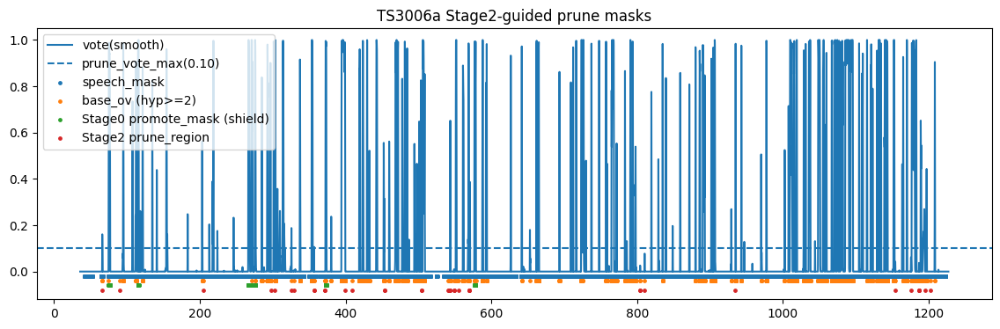

hyp1.labels(): ['MTD021PM', 'MTD022ID', 'MTD023UID', 'MTD024ME']


In [ ]:
f_dbg = next(x for x in dev_files if x["uri"] == "TS3006a")

# get dbg0 without applying promotion
hyp1, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
    f_dbg, baseline_fn=PIPE_BASE,
    return_debug=True,
)

# compute prune_region used by Stage2 guided
M0 = dbg0["M"]
speech_mask = dbg0["speech_mask"]
vote = dbg0["vote"]
promote_mask = dbg0["promote_mask"]
count = M0.sum(axis=1)
hyp_overlap = (count >= 2) & speech_mask
vote_low = (vote <= 0.10) & speech_mask
prune_region = hyp_overlap & vote_low & (~promote_mask)

# run stage2 guided
hyp2, dbg2 = STAGE2_PRUNE_ONLY_GUIDED_BY_STAGE0(
    f_dbg, baseline_fn=PIPE_BASE,
    prune_vote_max=0.10,
    return_debug=True,
    debug=True,
)

print("DBG2:", dbg2)
plot_stage2_guided_debug(f_dbg, dbg0, prune_region, title="TS3006a Stage2-guided prune masks")

#Need to print labels
print("hyp1.labels():", sorted([str(x) for x in hyp1.labels()])[:50])


In [ ]:
_BASE_CACHE.clear()


In [ ]:
fn_stage1 = lambda f: STAGE1_PYVAD(f, base_fn=PIPE_BASE)

fn_stage2g = lambda f: STAGE2_PRUNE_ONLY_GUIDED_BY_STAGE0(
    f,
    baseline_fn=PIPE_BASE,
    prune_vote_max=0.10,
    min_prune_dur=0.12,
    keep_top1_only=True,
    centroid_keep_margin=0.06,
    debug=False,
)


rows1, sum1 = eval_files(fn_stage1, dev_files, uem_mode="full")
rows2, sum2 = eval_files(fn_stage2g, dev_files, uem_mode="full")
print("STAGE1:", sum1)
print("STAGE2 guided prune:", sum2)


[eval_files] 1/5 TS3010a DER=0.2299 (miss=77.21 fa=13.61 conf=19.56 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2456 (miss=126.18 fa=36.26 conf=105.01 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1888 (miss=82.83 fa=29.30 conf=39.04 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1703 (miss=31.69 fa=9.55 conf=7.43 total=285.82)
[eval_files] 5/5 IS1009a DER=0.1940 (miss=62.78 fa=30.97 conf=41.24 total=695.90)
[eval_files] 1/5 TS3010a DER=0.2303 (miss=76.03 fa=15.29 conf=19.26 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2404 (miss=173.29 fa=35.52 conf=53.03 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1891 (miss=86.71 fa=31.51 conf=33.20 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1709 (miss=32.65 fa=10.35 conf=5.84 total=285.82)
[eval_files] 5/5 IS1009a DER=0.1889 (miss=67.72 fa=28.73 conf=35.04 total=695.90)
STAGE1: {'mean': {'DER': 0.20570066326652295, 'miss': 76.13638749999869, 'fa': 23.937206249998983, 'conf': 42.45818750000036, 'total': 670.338}, 'global': {'DER': 0.2126267364374

Prune only on stage 1 , no guide from stage 0 .

image.png
STAGE1: {'mean': {'DER': 0.20570066326652295, 'miss': 76.13638749999869, 'fa': 23.937206249998983, 'conf': 42.45818750000036, 'total': 670.338}, 'global': {'DER': 0.21262673643743613, 'miss': 380.68193749999347, 'fa': 119.68603124999491, 'conf': 212.2909375000018, 'total': 3351.6899999999996}, 'n_ok': 5, 'n_total': 5, 'uem_mode': 'full'}

STAGE2 (prune-only): {'mean': {'DER': 0.20709655579134342, 'miss': 74.2839999999995, 'fa': 26.71199999999975, 'conf': 42.57400000000011, 'total': 670.3379999999994}, 'global': {'DER': 0.2141755353269537, 'miss': 371.41999999999746, 'fa': 133.55999999999875, 'conf': 212.87000000000057, 'total': 3351.689999999997}, 'n_ok': 5, 'n_total': 5, 'uem_mode': 'full'}



In [ ]:
fn_stage2g = lambda f: STAGE2_PRUNE_ONLY_GUIDED_BY_STAGE0(
    f,
    baseline_fn=PIPE_BASE,
    prune_vote_max=0.01,        # much stricter
    min_prune_dur=0.12,
    keep_top1_only=False,       # IMPORTANT
    sec_frac_thr=0.12,          # drop only tiny secondaries
    centroid_keep_margin=0.08,  # more conservative
    debug=False,
)

rows2, sum2 = eval_files(fn_stage2g, dev_files, uem_mode="full")
print("STAGE2 guided prune:", sum2)





skipping pruning
skipping pruning
[eval_files] 1/5 TS3010a DER=0.2305 (miss=75.77 fa=15.37 conf=19.52 total=480.14)
skipping pruning
skipping pruning
[eval_files] 2/5 TS3006a DER=0.2406 (miss=172.93 fa=35.74 conf=53.39 total=1089.05)
skipping pruning
[eval_files] 3/5 IS1007a DER=0.1891 (miss=86.71 fa=31.59 conf=33.12 total=800.78)
skipping pruning
[eval_files] 4/5 ES2005a DER=0.1702 (miss=32.45 fa=10.35 conf=5.84 total=285.82)
[eval_files] 5/5 IS1009a DER=0.1889 (miss=67.72 fa=28.73 conf=35.04 total=695.90)
STAGE2 guided prune: {'mean': {'DER': 0.20386468421223802, 'miss': 87.11599999999966, 'fa': 24.35599999999993, 'conf': 29.381999999999984, 'total': 670.3379999999994}, 'global': {'DER': 0.210123847969233, 'miss': 435.5799999999983, 'fa': 121.77999999999966, 'conf': 146.9099999999999, 'total': 3351.689999999997}, 'n_ok': 5, 'n_total': 5, 'uem_mode': 'full'}


Per-file (DEV 5 files)

    TS3010a: DER 0.2305
    TS3006a: DER 0.2406 (still the main pain file; miss is massive)
    IS1007a: DER 0.1891
    ES2005a: DER 0.1702
    IS1009a: DER 0.1889

Aggregate

    Stage2 mean DER: 0.20386
    Stage2 global DER: 0.21012

Components (global seconds):

    miss = 435.58
    fa = 121.78
    conf = 146.91

The repeated “skipping pruning” tells us our new guards (especially second_frac >= 0.20) are preventing risky edits. That’s good for safety, but it also means:

    ✅ pruning is no longer doing aggressive damage
    ❌ it also isn’t giving we more improvement than before (we’re basically plateaued)

Conclusion: prune-only is now “safe-ish”, but it’s not the real Stage2 and it’s not the lever that will move DER much more. We should stop tuning prune-only and implement the planned Stage2: anchor constraints.

Where we are with “Stage 2” in wer original plan

Right now we have:

Stage1 (PyVAD) ✅ locked
Stage0 (promote-only) ✅ available
Stage2 (prune-only heuristic) ✅ optional tool / not the planned Stage2

    What’s missing for “completing Stage2”:
    ✅ Anchor extraction (we already do)
    ✅ Centroids / bank seeds (we already do)
    ❌ Constraint logic (E3-CONSTR style) applied in risky regions

That is the proper Stage2.

Plan to complete Stage 2 (Anchor Constraints, FA-safe)

Stage2 goal (strictly)

    Reduce confusion (and some FA) without increasing miss.
    Inputs (use what we already have)
    From Stage0 debug (with apply_promotion=False):
    hyp1 (PyVAD-masked baseline)
    labels
    M0 frame matrix from hyp1
    speech_mask
    vote (seg3 overlap vote smoothed)
    base_ov (frames where hyp1 count>=2)
    centroids (exclusive-anchor centroids)
    promote_mask (optional shield; treat as “don’t touch”)

Output

    hyp2 = same support as hyp1, but with speaker activity cleaned in risky regions.
    Step-by-step Stage2 constraints design
    1) Define “risky regions” mask (frame-level)

Use union of:

    base_ov (hyp says overlap already)
    high overlap vote: vote >= ov_thr_stage2 (e.g., 0.15)
    boundary islands: (count==1 but near speaker-change / near overlap)
    simplest: dilate base_ov by ±0.2s and intersect with speech_mask

So:

risky = speech_mask & ( base_ov | (vote >= ov_thr) | near_base_ov_dilated )

2) Constraint rule per risky segment

    For each contiguous risky segment s:
    Compute active speakers from M0[a:b] (use frac>0.01)
    If <2 active → skip (no overlap)
    Embed the segment (center window, wer stable embed_segment)
    Score only those active labels with centroids
    Apply constraints:
    Constraint A (FA-safe overlap cap):
    If vote_mean < vote_keep2_thr (weak overlap evidence):
    allow at most 1 speaker (keep best only)

    Else:
    allow at most 2 speakers (keep best two)
    Constraint B (do not delete real overlap):
    Never drop a speaker if its activity fraction in region is high:

    if second_frac >= 0.25 → keep 2 even if vote is low
    (this directly fixes wer prune-only failure mode)
    Constraint C (centroid ambiguity guard):

    If best_sim - second_sim < margin_thr → skip (too ambiguous)

3) Apply changes by editing the annotation (FA-safe)

    Like we already do:
    remove labels in segment s using _remove_label_from_segment
    never add speakers
    ever change support
    final crop: out.crop(hyp1.support())

    This is essentially “constraint pruning”, but unlike wer current Stage2, it uses vote to decide whether the region should be 1-speaker vs 2-speaker, instead of always trying to prune when vote is low.

    Minimal knobs (keep tight, no huge grid)

    Start with just these defaults:

    ov_thr = 0.15 (risky if vote ≥ 0.15)

    vote_keep2_thr = 0.08 (if mean vote below this → likely not overlap)

    second_frac_keep2 = 0.25 (if 2nd speaker strong → keep 2)

    margin_thr = 0.08

    min_risky_dur = 0.10

    merge_gap = 0.06

Run on DEV once.
    If miss increases, raise second_frac_keep2 (more conservative).
    If confusion doesn’t drop, lower vote_keep2_thr slightly (prune more).

What to evaluate (must-have)

    Exactly what we already do:
    full UEM global + mean
    overlap-only UEM
    single-speaker UEM

Success criteria for Stage2 (constraints):

    Miss: ≤ +2–3s global (ideally flat)
    Confusion: decreases
    FA: flat or decreases

If it meets this, Stage2 is “complete”.
After Stage2 is complete, what’s next (Stage3)
Given wer persistent miss dominance, especially TS3006a, the real gains come from:

    Stage3A: promote 1→2 (overlap miss recovery)
    Stage3B: gap fill 0→1 (only with very strict gates)

But Stage3 should come only after Stage2 stops hurting miss.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment, Timeline, Annotation

# ----------------------------
# Utilities (assumes we already have these from our notebook)
#   - _get_uem_full
#   - frame_matrix_from_annotation
#   - timeline_to_mask
#   - _mask_to_segments
#   - _merge_close
# ----------------------------

def _tl_dur(tl: Timeline) -> float:
    return float(sum(s.duration for s in tl.support())) if tl is not None else 0.0

def _ann_support_dur(ann: Annotation) -> float:
    return _tl_dur(ann.get_timeline().support())

def _frame_to_segment(uem_seg: Segment, a: int, b: int, res: float) -> Segment:
    return Segment(float(uem_seg.start + a * res), float(uem_seg.start + b * res))

def _dominant_label_in_window(M, a, b, labels):
    hist = M[a:b].sum(axis=0)
    j = int(np.argmax(hist))
    return j, labels[j], float(hist[j])

def _cos_sim(a, b):
    return float(np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b) + 1e-9))


def embed_segment(file, seg: Segment, win_sec=1.5):
#         """
#         Robust embedding for short segments:
#           - center crop to fixed win_sec
#           - always feed (B,1,T) to EMBEDDER
#           - pad waveform to min_samples (avoids conv/pooling crashes)
#           - L2-normalize embedding
#         """
        mid = 0.5 * (seg.start + seg.end)
        half = 0.5 * win_sec
        s = Segment(max(0.0, mid - half), max(0.0, mid + half))

        wav, sr = AUDIO.crop(file, s)
        if not torch.is_tensor(wav):
            wav = torch.tensor(wav)

        # force 3D (B,1,T)
        if wav.dim() == 1:
            wav = wav[None, None, :]
        elif wav.dim() == 2:
            # (C,T) -> average channels then (1,1,T)
            if wav.shape[0] > 1:
                wav = wav.mean(dim=0, keepdim=True)
            wav = wav[:, None, :]
        elif wav.dim() == 3:
            if wav.shape[1] > 1:
                wav = wav.mean(dim=1, keepdim=True)
        else:
            wav = wav.reshape(1, 1, -1)

        min_samples = int(win_sec * sr)
        if wav.numel() == 0:
            wav = torch.zeros((1, 1, min_samples), dtype=torch.float32)
        elif wav.shape[-1] < min_samples:
            wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

        wav = wav.to(DEVICE).float()

        with torch.no_grad():
            e = EMBEDDER(wav)
            if isinstance(e, np.ndarray):
                e = torch.from_numpy(e)
            e = e.to(DEVICE).float()
            if e.dim() == 2:
                e = F.normalize(e, dim=1).squeeze(0)
            else:
                e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)

        return e.detach().cpu().numpy().astype(np.float32)
# ----------------------------
# Debug plot for Stage2 guided prune
# ----------------------------
def plot_stage2_guided_debug(file, dbg0, prune_region_mask, title=None):
    uem_seg = dbg0["uem_seg"]
    vote = dbg0["vote"]
    speech_mask = dbg0["speech_mask"]
    promote_mask = dbg0["promote_mask"]
    base_ov = dbg0["base_ov"]

    T = len(vote)
    t = uem_seg.start + np.arange(T) * RES

    plt.figure(figsize=(14,4))
    plt.plot(t, vote, label="vote(smooth)")
    plt.axhline(0.10, linestyle="--", label="prune_vote_max(0.10)")

    def dots(mask, y, lab):
        idx = np.where(mask)[0]
        if idx.size:
            plt.scatter(t[idx], np.full(idx.shape, y), s=6, label=lab)

    dots(speech_mask, -0.02, "speech_mask")
    dots(base_ov, -0.04, "base_ov (hyp>=2)")
    dots(promote_mask, -0.06, "Stage0 promote_mask (shield)")
    dots(prune_region_mask, -0.08, "Stage2 prune_region")

    plt.ylim(-0.12, 1.05)
    plt.title(title or f"Stage2 guided prune masks: {file.get('uri')}")
    plt.legend(loc="upper left")
    plt.show()


In [ ]:
def eval_files(run_fn, files, uem_mode="full", max_files=None, verbose=True, return_debug=False):
    """
    uem_mode:
      - "full": 0..duration
      - "ref":  ref support
      - "overlap": ref count>=2 within full uem
      - "single":  ref count==1 within full uem
      - "sil":     ref count==0 within full uem
    return_debug:
      - if True, row may include a 'dbg' field when run_fn returns (hyp, dbg)
    """
    metric = DiarizationErrorRate()
    rows = []

    n = 0
    for f in files:
        if max_files is not None and n >= int(max_files):
            break
        n += 1

        uri = f.get("uri")
        ref = f["annotation"]

        if uem_mode == "ref":
            uem = ref.get_timeline().support()
        else:
            uem_full = _get_uem_full(f)
            if uem_mode == "full":
                uem = uem_full
            elif uem_mode in ("overlap", "single", "sil"):
                uem = uem_from_ref_speaker_count(ref, uem_full, mode=uem_mode, res=RES, min_dur=RES)
            else:
                raise ValueError(f"Unknown uem_mode={uem_mode}")

        dbg = None
        try:
            out = run_fn(f)

            # NEW: unwrap (hyp, dbg) safely
            if isinstance(out, tuple) and len(out) >= 1:
                hyp = out[0]
                if len(out) >= 2:
                    dbg = out[1]
            else:
                hyp = out

            det = metric(ref, hyp, uem=uem, detailed=True)
            row = {"uri": uri, **det}
            if return_debug and (dbg is not None):
                row["dbg"] = dbg

            if verbose:
                print(f"[eval_files] {n}/{len(files)} {uri} DER={det['diarization error rate']:.4f} "
                      f"(miss={det['missed detection']:.2f} fa={det['false alarm']:.2f} conf={det['confusion']:.2f} "
                      f"total={det['total']:.2f})")
        except Exception as e:
            row = {"uri": uri, "error": repr(e)}
            if verbose:
                print(f"[eval_files] {n}/{len(files)} {uri} ERROR: {e}")

        rows.append(row)

    ok = [r for r in rows if "diarization error rate" in r]
    if not ok:
        return rows, {"error": "No successful files."}

    mean_der  = float(np.mean([r["diarization error rate"] for r in ok]))
    mean_miss = float(np.mean([r["missed detection"] for r in ok]))
    mean_fa   = float(np.mean([r["false alarm"] for r in ok]))
    mean_conf = float(np.mean([r["confusion"] for r in ok]))
    mean_tot  = float(np.mean([r["total"] for r in ok]))

    g_miss = float(np.sum([r["missed detection"] for r in ok]))
    g_fa   = float(np.sum([r["false alarm"] for r in ok]))
    g_conf = float(np.sum([r["confusion"] for r in ok]))
    g_tot  = float(np.sum([r["total"] for r in ok]))
    g_der  = float((g_miss + g_fa + g_conf) / max(g_tot, 1e-9))

    summary = {
        "mean":   {"DER": mean_der, "miss": mean_miss, "fa": mean_fa, "conf": mean_conf, "total": mean_tot},
        "global": {"DER": g_der,    "miss": g_miss,    "fa": g_fa,    "conf": g_conf,    "total": g_tot},
        "n_ok": len(ok),
        "n_total": len(rows),
        "uem_mode": uem_mode,
    }
    return rows, summary


In [ ]:
import numpy as np
from pyannote.core import Segment, Annotation

def STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
    file,
    baseline_fn=PIPE_BASE,

    # Stage0->dbg params
    vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
    topk_seconds=TOPK_SECONDS_DEFAULT,
    vote_thr=VOTE_THR_DEFAULT,
    sim2_thr=SIM2_THR_DEFAULT,
    m23_thr=M23_THR_DEFAULT,
    smooth_sec=SMOOTH_SEC,
    restrict_near_sec=RESTRICT_NEAR_SEC,
    strong_vote_thr=None,

    # -------- NEW Stage2 (anchor constraints) knobs (unchanged) --------
    near_ov_sec=0.20,
    risky_vote_thr=0.12,
    min_risky_dur=0.08,
    merge_gap=0.06,

    keep2_vote_mean_thr=0.08,
    keep2_second_frac_thr=0.25,

    min_sim_keep=0.10,
    margin_skip=0.06,

    debug=False,
    return_debug=False,

    # -------- ADDED: bring back "old Stage2 prune-only" as extra pass --------
    enable_prune_only_pass=True,
    prune_vote_max=0.10,         # prune only when SEG3 vote is very low
    prune_close_sec=0.20,        # anti-fragmentation closing window (sec)
    keep_top1_only=True,         # old mode: keep only best label in prune regions
    sec_frac_thr=0.35,           # if keep_top1_only=False: drop small secondaries
    centroid_keep_margin=0.05,   # old ambiguity guard for prune-only pass
    min_prune_dur=None,          # default: reuse min_risky_dur if None

    # -------- ADDED: diagnostics for plotting/tuning --------
    collect_diagnostics=True,
):
    """
    Integrated Stage2:
      (A) Anchor-constraints pass (our new Stage2):
          - operate only inside speech_mask
          - never touch promote_mask
          - per risky segment: decide keep1 vs keep2 using (vote_mean, second_frac),
            and prune only by removing labels (FA-safe).
      (B) Optional prune-only refinement (our old Stage2):
          - only in VERY-low-vote overlap regions
          - includes anti-fragmentation closing
          - never overrides keep2 evidence (vote_mean or second_frac)
          - still FA-safe: only removes labels
      (C) Diagnostics: collects (vote_mean, second_frac, best-second margin, decisions)
          for hist/scatter plots.
    Dependencies assumed available in our notebook:
      - STAGE0_PROMOTE_ONLY_ON_PYVAD
      - frame_matrix_from_annotation
      - _binary_dilate
      - RES, EMBED_WIN_SEC
      - embed_segment or embed_segment_3d (we auto-pick)
    """

    # ----------------------------
    # Local helpers (robust in notebooks)
    # ----------------------------
    def _cos_sim(a, b):
        return float(np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b) + 1e-9))

    def _mask_to_segments_robust(mask, start_or_uem, step_or_res, min_dur_):
        """
        Accepts either:
          - (mask, uem_seg: Segment, res, min_dur) OR
          - (mask, start_time: float, step: float, min_dur)
        Prevents "'float' has no attribute start" when cells redefine helpers.
        """
        mask = np.asarray(mask).astype(bool)
        if mask.size == 0 or not mask.any():
            return []

        if isinstance(start_or_uem, Segment):
            start_time = float(start_or_uem.start)
            step = float(step_or_res)
        else:
            start_time = float(start_or_uem)
            step = float(step_or_res)

        edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)
        segs = []
        for a, b in edges:
            st = start_time + float(a) * step
            en = start_time + float(b) * step
            if (en - st) >= float(min_dur_):
                segs.append(Segment(float(st), float(en)))
        return segs

    def _merge_close_seg(segs, gap=0.05):
        if not segs:
            return []
        segs = sorted(segs, key=lambda s: (s.start, s.end))
        out = [segs[0]]
        for s in segs[1:]:
            last = out[-1]
            if s.start - last.end <= gap:
                out[-1] = Segment(last.start, max(last.end, s.end))
            else:
                out.append(s)
        return out

    def _remove_label_from_segment(ann: Annotation, seg_cut: Segment, lab: str) -> Annotation:
        new_ann = Annotation()
        for seg, trk, lbl in ann.itertracks(yield_label=True):
            if lbl != lab:
                new_ann[seg, trk] = lbl
                continue
            if seg.end <= seg_cut.start or seg.start >= seg_cut.end:
                new_ann[seg, trk] = lbl
            else:
                if seg.start < seg_cut.start:
                    new_ann[Segment(seg.start, seg_cut.start), trk] = lbl
                if seg.end > seg_cut.end:
                    new_ann[Segment(seg_cut.end, seg.end), trk] = lbl
        return new_ann

    def _pick_embed_fn():
        # Prefer embed_segment if present, else fallback to embed_segment_3d
        fn = globals().get("embed_segment", None)
        if fn is None:
            fn = globals().get("embed_segment_3d", None)
        if fn is None:
            raise RuntimeError("Missing embed function: define embed_segment or embed_segment_3d.")
        return fn

    embed_fn = _pick_embed_fn()
    RES_ = float(RES)
    if min_prune_dur is None:
        min_prune_dur = float(min_risky_dur)

    # ----------------------------
    # 1) Get hyp1 + dbg0 from Stage0 (NO promotion)
    # ----------------------------
    hyp1, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file,
        baseline_fn=baseline_fn,
        vad_pad=vad_pad, vad_gap=vad_gap, vad_min_on=vad_min_on,
        topk_seconds=topk_seconds,
        vote_thr=vote_thr,
        sim2_thr=sim2_thr,
        m23_thr=m23_thr,
        smooth_sec=smooth_sec,
        restrict_near_sec=restrict_near_sec,
        strong_vote_thr=strong_vote_thr,
        apply_promotion=False,      # IMPORTANT: Stage2 base must be hyp1
        return_debug=True,
        debug=False,
    )

    uem_tl  = dbg0["uem_tl"]
    uem_seg = dbg0["uem_seg"]
    labels  = list(dbg0["labels"])
    speech_mask  = np.asarray(dbg0["speech_mask"]).astype(bool)
    vote         = np.asarray(dbg0["vote"]).astype(np.float32)
    promote_mask = np.asarray(dbg0["promote_mask"]).astype(bool)
    centroids    = dbg0["centroids"]

    # Sanity checks
    assert isinstance(uem_seg, Segment), f"uem_seg not Segment: {type(uem_seg)}"
    assert len(labels) >= 1, "No labels in dbg0"
    assert not any(str(l).isdigit() for l in labels), f"BUG: numeric labels still present: {labels}"

    # Keep hyp1 clean + in UEM
    hyp1 = hyp1.subset(set(labels)).crop(uem_tl)

    # Recompute M0 from hyp1 (avoid stale dbg matrices)
    M0 = frame_matrix_from_annotation(hyp1, uem_seg, labels, res=RES_)
    T = int(M0.shape[0])

    # Align per-frame arrays to T
    speech_mask  = speech_mask[:T]
    vote         = vote[:T]
    promote_mask = promote_mask[:T]

    count = M0.sum(axis=1)
    hyp_overlap = (count >= 2) & speech_mask  # overlap per hyp1

    # Diagnostics container
    diag = []  # list of dict per segment decision

    # ----------------------------
    # 2) Build risky mask (new Stage2 behavior)
    # ----------------------------
    seg_overlap = (vote >= float(risky_vote_thr)) & speech_mask

    rad = int(round(float(near_ov_sec) / RES_))
    near_hyp_ov = _binary_dilate(hyp_overlap.astype(np.uint8), radius_frames=rad).astype(bool)

    risky = (near_hyp_ov | seg_overlap) & speech_mask
    risky = risky & (~promote_mask)  # never touch Stage0 promotion candidates

    risky_segs = _merge_close_seg(
        _mask_to_segments_robust(risky, uem_seg, RES_, float(min_risky_dur)),
        gap=float(merge_gap),
    )

    out = hyp1.copy()

    n_segments = len(risky_segs)
    n_edited = 0
    n_skipped_amb = 0
    n_skipped_nocent = 0
    n_kept2 = 0

    # ----------------------------
    # 3) Anchor constraints pass (our new Stage2 core)
    # ----------------------------
    for s in risky_segs:
        a = int(np.floor((s.start - uem_seg.start) / RES_))
        b = int(np.ceil ((s.end   - uem_seg.start) / RES_))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        frac = M0[a:b].mean(axis=0)
        act = np.where(frac > 0.01)[0].astype(int)
        if act.size <= 1:
            continue

        act_labels = [labels[j] for j in act]
        if any(lab not in centroids for lab in act_labels):
            n_skipped_nocent += 1
            continue

        vmean = float(np.mean(vote[a:b]))

        # Embed center window
        mid = 0.5 * (s.start + s.end)
        half = 0.5 * float(EMBED_WIN_SEC)
        ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
        e = embed_fn(file, ss, win_sec=float(EMBED_WIN_SEC))
        e = e / (np.linalg.norm(e) + 1e-9)

        sims = []
        for j in act:
            lab = labels[j]
            sims.append((lab, _cos_sim(centroids[lab], e), float(frac[j])))
        sims.sort(key=lambda x: -x[1])

        best_lab, best_sim, best_frac = sims[0]
        second_lab, second_sim, second_frac = sims[1]
        margin = float(best_sim - second_sim)

        if margin < float(margin_skip):
            n_skipped_amb += 1
            if collect_diagnostics:
                diag.append({
                    "pass": "constraints",
                    "seg": (float(s.start), float(s.end)),
                    "vmean": vmean,
                    "best_sim": float(best_sim),
                    "second_sim": float(second_sim),
                    "second_frac": float(second_frac),
                    "margin": margin,
                    "decision": "skip_amb",
                })
            continue

        overlap_likely = (vmean >= float(keep2_vote_mean_thr)) or (second_frac >= float(keep2_second_frac_thr))

        keep = [best_lab]
        if overlap_likely and ((second_sim >= float(min_sim_keep)) or (second_frac >= float(keep2_second_frac_thr))):
            keep.append(second_lab)
            n_kept2 += 1

        drop = []
        for (lab, sim, fr) in sims[1:]:
            if lab in keep:
                continue
            if not overlap_likely:
                drop.append(lab)  # keep only 1
            else:
                # overlap: drop only very weak extras
                if float(sim) < float(min_sim_keep):
                    drop.append(lab)

        if not drop:
            if collect_diagnostics:
                diag.append({
                    "pass": "constraints",
                    "seg": (float(s.start), float(s.end)),
                    "vmean": vmean,
                    "best_sim": float(best_sim),
                    "second_sim": float(second_sim),
                    "second_frac": float(second_frac),
                    "margin": margin,
                    "decision": "no_drop",
                    "overlap_likely": bool(overlap_likely),
                    "keep": list(keep),
                })
            continue

        for lab in drop:
            out = _remove_label_from_segment(out, s, lab)
        n_edited += 1

        if collect_diagnostics:
            diag.append({
                "pass": "constraints",
                "seg": (float(s.start), float(s.end)),
                "vmean": vmean,
                "best_sim": float(best_sim),
                "second_sim": float(second_sim),
                "second_frac": float(second_frac),
                "margin": margin,
                "decision": "drop",
                "overlap_likely": bool(overlap_likely),
                "keep": list(keep),
                "drop": list(drop),
            })

        if debug:
            print(f"[S2-CONSTR] {file.get('uri')} {s.start:.2f}-{s.end:.2f} "
                  f"vote_mean={vmean:.3f} overlap_likely={overlap_likely} keep={keep} drop={drop} "
                  f"top={[(x[0], round(x[1],3), round(x[2],2)) for x in sims[:4]]}")

    # ----------------------------
    # 4) Optional prune-only refinement (old Stage2 added back)
    # ----------------------------
    n_prune_segments = 0
    n_pruned = 0
    n_prune_skipped_keep2 = 0
    n_prune_skipped_amb = 0
    n_prune_skipped_nocent = 0

    prune_region = None
    if enable_prune_only_pass:
        vote_low = (vote <= float(prune_vote_max)) & speech_mask
        prune_region = hyp_overlap & vote_low & (~promote_mask)

        # Anti-fragmentation closing (old Stage2 trick)
        close_rad = int(round(float(prune_close_sec) / RES_))
        pr = prune_region.astype(np.uint8)
        pr_dil = _binary_dilate(pr, radius_frames=close_rad).astype(np.uint8)
        k = 2 * close_rad + 1
        cnt = np.convolve(pr_dil, np.ones((k,), dtype=np.uint8), mode="same")
        prune_region = (cnt >= k) & speech_mask

        prune_segs = _merge_close_seg(
            _mask_to_segments_robust(prune_region, uem_seg, RES_, float(min_prune_dur)),
            gap=float(merge_gap),
        )
        n_prune_segments = len(prune_segs)

        for s in prune_segs:
            a = int(np.floor((s.start - uem_seg.start) / RES_))
            b = int(np.ceil ((s.end   - uem_seg.start) / RES_))
            a = max(a, 0); b = min(b, T)
            if b <= a:
                continue

            frac = M0[a:b].mean(axis=0)
            act = np.where(frac > 0.01)[0].astype(int)
            if act.size <= 1:
                continue

            act_labels = [labels[j] for j in act]
            if any(lab not in centroids for lab in act_labels):
                n_prune_skipped_nocent += 1
                continue

            vmean = float(np.mean(vote[a:b]))
            # Never override "keep 2" evidence (protect true overlap)
            second_frac = float(np.sort(frac[act])[-2]) if act.size >= 2 else 0.0
            if (vmean >= float(keep2_vote_mean_thr)) or (second_frac >= float(keep2_second_frac_thr)):
                n_prune_skipped_keep2 += 1
                continue

            # Embed center window
            mid = 0.5 * (s.start + s.end)
            half = 0.5 * float(EMBED_WIN_SEC)
            ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
            e = embed_fn(file, ss, win_sec=float(EMBED_WIN_SEC))
            e = e / (np.linalg.norm(e) + 1e-9)

            sims = []
            for j in act:
                lab = labels[j]
                sims.append((lab, _cos_sim(centroids[lab], e), float(frac[j])))
            sims.sort(key=lambda x: -x[1])

            best_lab, best_sim, _ = sims[0]
            second_lab, second_sim, _ = sims[1]
            margin = float(best_sim - second_sim)

            if margin < float(centroid_keep_margin):
                n_prune_skipped_amb += 1
                continue

            if keep_top1_only:
                drop = [lab for (lab, sim, fr) in sims[1:]]
            else:
                drop = []
                for (lab, sim, fr) in sims[1:]:
                    if (float(fr) < float(sec_frac_thr)) and ((float(best_sim) - float(sim)) >= float(centroid_keep_margin)):
                        drop.append(lab)

            if not drop:
                continue

            for lab in drop:
                out = _remove_label_from_segment(out, s, lab)
            n_pruned += 1

            if collect_diagnostics:
                diag.append({
                    "pass": "prune_only",
                    "seg": (float(s.start), float(s.end)),
                    "vmean": vmean,
                    "best_sim": float(best_sim),
                    "second_sim": float(second_sim),
                    "margin": margin,
                    "decision": "drop",
                    "keep": [best_lab],
                    "drop": list(drop),
                })

            if debug:
                print(f"[S2-PRUNE] {file.get('uri')} {s.start:.2f}-{s.end:.2f} vote_mean={vmean:.3f} "
                      f"keep={best_lab}({best_sim:.3f}) drop={drop} top={[(x[0], round(x[1],3), round(x[2],2)) for x in sims[:4]]}")

    # Final FA-safe crop
    out = out.crop(uem_tl)
    out = out.crop(hyp1.get_timeline().support())

    dbg2 = {
        # constraints pass stats
        "n_risky_segments": int(n_segments),
        "n_edited": int(n_edited),
        "n_skipped_amb": int(n_skipped_amb),
        "n_skipped_nocent": int(n_skipped_nocent),
        "n_kept2": int(n_kept2),

        # prune-only pass stats
        "enable_prune_only_pass": bool(enable_prune_only_pass),
        "n_prune_segments": int(n_prune_segments),
        "n_pruned": int(n_pruned),
        "n_prune_skipped_keep2": int(n_prune_skipped_keep2),
        "n_prune_skipped_amb": int(n_prune_skipped_amb),
        "n_prune_skipped_nocent": int(n_prune_skipped_nocent),

        # optional masks for plotting
        "risky_mask": risky,
        "prune_mask": prune_region,

        # diagnostics rows (for hist/scatter)
        "diagnostics": diag if collect_diagnostics else None,
    }

    return (out, dbg2) if return_debug else out


# ----------------------------
# Plot helpers for Stage2 tuning (what we asked: hist + scatter)
# ----------------------------
def plot_stage2_diagnostics(dbg2, title_prefix="Stage2"):
    """
    Plots:
      - Histogram: margin = best_sim - second_sim (constraints decisions)
      - Histogram: second_frac (constraints decisions)
      - Scatter: vote_mean vs second_frac
    """
    import matplotlib.pyplot as plt

    rows = dbg2.get("diagnostics", None)
    if not rows:
        print("No diagnostics found in dbg2['diagnostics']. Run Stage2 with collect_diagnostics=True.")
        return

    cons = [r for r in rows if r.get("pass") == "constraints" and "margin" in r]
    if not cons:
        print("No constraint diagnostics rows found.")
        return

    margin = np.array([r["margin"] for r in cons], dtype=float)
    second_frac = np.array([r.get("second_frac", np.nan) for r in cons], dtype=float)
    vmean = np.array([r.get("vmean", np.nan) for r in cons], dtype=float)

    # 1) margin hist
    plt.figure()
    plt.hist(margin[np.isfinite(margin)], bins=40)
    plt.title(f"{title_prefix}: best_sim - second_sim (constraints)")
    plt.xlabel("margin")
    plt.ylabel("count")
    plt.show()

    # 2) second_frac hist
    plt.figure()
    plt.hist(second_frac[np.isfinite(second_frac)], bins=40)
    plt.title(f"{title_prefix}: second_frac (constraints)")
    plt.xlabel("second_frac")
    plt.ylabel("count")
    plt.show()

    # 3) scatter vote_mean vs second_frac
    m = np.isfinite(vmean) & np.isfinite(second_frac)
    plt.figure()
    plt.scatter(vmean[m], second_frac[m], s=10)
    plt.title(f"{title_prefix}: vote_mean vs second_frac (constraints)")
    plt.xlabel("vote_mean")
    plt.ylabel("second_frac")
    plt.show()


In [ ]:
fn_stage2 = lambda f: STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
    f,
    baseline_fn=PIPE_BASE,
    risky_vote_thr=0.12,
    keep2_vote_mean_thr=0.08,
    keep2_second_frac_thr=0.25,
    min_sim_keep=0.10,
    margin_skip=0.06,
    debug=False,
)

rows2, sum2 = eval_files(fn_stage2, dev_files, uem_mode="full")
print("STAGE2 (anchor constraints) summary:", sum2)

[eval_files] 1/5 TS3010a DER=0.2299 (miss=77.55 fa=13.61 conf=19.23 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2447 (miss=183.60 fa=30.92 conf=51.91 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1904 (miss=92.74 fa=27.76 conf=32.00 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1691 (miss=33.84 fa=9.17 conf=5.33 total=285.82)
[eval_files] 5/5 IS1009a DER=0.1867 (miss=70.98 fa=25.80 conf=33.16 total=695.90)
STAGE2 (anchor constraints) summary: {'mean': {'DER': 0.20417451301325285, 'miss': 91.74321249999869, 'fa': 21.45365624999905, 'conf': 28.327200000000232, 'total': 670.338}, 'global': {'DER': 0.2111234463061888, 'miss': 458.7160624999934, 'fa': 107.26828124999524, 'conf': 141.63600000000116, 'total': 3351.6899999999996}, 'n_ok': 5, 'n_total': 5, 'uem_mode': 'full'}


In [ ]:
f_dbg = next(x for x in dev_files if x["uri"] == "TS3006a")
hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(f_dbg, return_debug=True, debug=True)
print(dbg2)


[S2-CONSTR] TS3006a 74.60-74.80 vote_mean=0.189 overlap_likely=True keep=['MTD024ME'] drop=['MTD023UID'] top=[('MTD024ME', 0.252, 0.33), ('MTD023UID', 0.033, 0.08)]
[S2-CONSTR] TS3006a 89.88-90.30 vote_mean=0.000 overlap_likely=False keep=['MTD022ID'] drop=['MTD023UID'] top=[('MTD022ID', 0.23, 0.52), ('MTD023UID', 0.11, 0.09)]
[S2-CONSTR] TS3006a 284.68-285.34 vote_mean=0.372 overlap_likely=True keep=['MTD024ME', 'MTD021PM'] drop=['MTD023UID'] top=[('MTD024ME', 0.504, 1.0), ('MTD021PM', 0.066, 0.38), ('MTD023UID', 0.066, 0.03)]
[S2-CONSTR] TS3006a 324.80-325.22 vote_mean=0.016 overlap_likely=False keep=['MTD023UID'] drop=['MTD024ME', 'MTD021PM'] top=[('MTD023UID', 0.288, 0.52), ('MTD024ME', 0.038, 0.19), ('MTD021PM', -0.03, 0.1)]
[S2-CONSTR] TS3006a 356.28-356.70 vote_mean=0.064 overlap_likely=False keep=['MTD022ID'] drop=['MTD021PM'] top=[('MTD022ID', 0.169, 0.5), ('MTD021PM', 0.056, 0.14)]
[S2-CONSTR] TS3006a 370.78-371.24 vote_mean=0.000 overlap_likely=False keep=['MTD024ME'] drop=[

In [ ]:
fn_stage1 = lambda f: STAGE1_PYVAD(f, base_fn=PIPE_BASE)


rows1, sum1 = eval_files(fn_stage1, dev_files, uem_mode="full")
print("STAGE1:", sum1)


[eval_files] 1/5 TS3010a DER=0.2299 (miss=77.21 fa=13.61 conf=19.56 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2456 (miss=126.18 fa=36.26 conf=105.01 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1888 (miss=82.83 fa=29.30 conf=39.04 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1703 (miss=31.69 fa=9.55 conf=7.43 total=285.82)
[eval_files] 5/5 IS1009a DER=0.1940 (miss=62.78 fa=30.97 conf=41.24 total=695.90)
STAGE1: {'mean': {'DER': 0.20570066326652295, 'miss': 76.13638749999869, 'fa': 23.937206249998983, 'conf': 42.45818750000036, 'total': 670.338}, 'global': {'DER': 0.21262673643743613, 'miss': 380.68193749999347, 'fa': 119.68603124999491, 'conf': 212.2909375000018, 'total': 3351.6899999999996}, 'n_ok': 5, 'n_total': 5, 'uem_mode': 'full'}


In [ ]:
# Stage0 no-promote (for Stage2)
hyp_np, dbg_np = STAGE0_PROMOTE_ONLY_ON_PYVAD(dev_files[0], apply_promotion=False, return_debug=True, debug=True)

# Stage0 promote (final)
hyp_p, dbg_p = STAGE0_PROMOTE_ONLY_ON_PYVAD(dev_files[0], apply_promotion=True, return_debug=True, debug=True)
print("promoted changed =", dbg_p["changed"])


[STAGE0] TS3010a apply_promotion=False (returning hyp1) | kept_labels=['MTD037PM', 'MTD038ID', 'MTD039UID', 'MTD040ME'] | promote_segs=3
[STAGE0] TS3010a kept_labels=['MTD037PM', 'MTD038ID', 'MTD039UID', 'MTD040ME'] promoted=0 gated={'stab_fail': 0, 'weak_sim2': 3, 'weak_m23': 0}
promoted changed = 0


In [ ]:
rows, s = eval_files(lambda f: STAGE0_PROMOTE_ONLY_ON_PYVAD(f, apply_promotion=True),
                     dev_files, uem_mode="overlap")
print(s)


[eval_files] 1/5 TS3010a DER=0.4571 (miss=18.68 fa=0.06 conf=1.94 total=45.24)
[eval_files] 2/5 TS3006a DER=0.3966 (miss=101.63 fa=1.62 conf=23.97 total=320.75)
[eval_files] 3/5 IS1007a DER=0.3182 (miss=49.80 fa=0.87 conf=16.08 total=209.79)
[eval_files] 4/5 ES2005a DER=0.2660 (miss=15.06 fa=0.34 conf=1.95 total=65.22)
[eval_files] 5/5 IS1009a DER=0.3865 (miss=48.68 fa=0.80 conf=18.04 total=174.68)
{'mean': {'DER': 0.3648967752576896, 'miss': 46.7699999999996, 'fa': 0.7379999999993349, 'conf': 12.395999999999677, 'total': 163.1359999999982}, 'global': {'DER': 0.3672028246371081, 'miss': 233.84999999999798, 'fa': 3.689999999996674, 'conf': 61.979999999998384, 'total': 815.679999999991}, 'n_ok': 5, 'n_total': 5, 'uem_mode': 'overlap'}


### NEXT CELL: Anchor-centroid guided OVERLAP reassignment (confusion-focused)

In [ ]:
# # ============================================================
# # NEXT CELL: Anchor-centroid guided OVERLAP reassignment (confusion-focused)
# # - Uses baseline diarization (pipe_base) for segments
# # - Builds per-label centroids from EXCLUSIVE (count==1) anchor regions
# # - Only modifies frames where baseline predicts overlap (count>=2)
# # - In those overlap regions, keeps only the top-2 labels by centroid similarity
# #
# # Prereqs expected in our notebook:
# #   - pipe_base(file) -> Annotation
# #   - protocol, DEV_URIS, TEST_URIS
# #   - eval_split(pipeline_callable, split)  where split in {"dev","test"}
# # ============================================================

# import numpy as np
# import torch
# import torch.nn.functional as F
# from pyannote.core import Annotation, Segment, Timeline
# from pyannote.audio import Audio
# from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding

# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# if "audio" not in globals():
#     audio = Audio(sample_rate=16000, mono=True)

# # Use pyannote/embedding if not already loaded, as it was requested in the previous cells
# # and was explicitly loaded in AzDgyfdQfSmU and Rq8uHfdMWV02.
# # This assumes 'embedder' global is set from the Rq8uHfdMWV02 cell.
# if "embedder" not in globals():
#     try:
#         embedder = PretrainedSpeakerEmbedding("pyannote/embedding", device=device)
#         print("Using embedder: pyannote/embedding")
#     except Exception as e:
#         print(f"Failed to load pyannote/embedding, falling back to speechbrain ECAPA. Error: {repr(e)}")
#         embedder = PretrainedSpeakerEmbedding("speechbrain/spkrec-ecapa-voxceleb", device=device)
#         print("Using embedder: speechbrain/spkrec-ecapa-voxceleb")
# else:
#     # Ensure embedder is on the correct device if it was created in a different context
#     if embedder.device != device:
#         embedder.to(device)
#     print("Reusing existing embedder.")


# def _to_b1c1T(wav: torch.Tensor) -> torch.Tensor:
#     """Ensure waveform shape is (B,1,T) torch.float32."""
#     # Ensure it's a tensor first if it came from numpy
#     if not torch.is_tensor(wav):
#         wav = torch.tensor(wav, dtype=torch.float32)

#     # Convert to mono (if multichannel) and add batch/channel dims if missing
#     if wav.dim() == 1: # (T,)
#         wav = wav.unsqueeze(0).unsqueeze(0) # -> (1, 1, T)
#     elif wav.dim() == 2: # (C, T) or (B, T) - assuming (C, T)
#         if wav.shape[0] > 1: # Multichannel
#             wav = wav.mean(dim=0, keepdim=True) # Average channels -> (1, T)
#         # else: already (1, T)
#         wav = wav.unsqueeze(0) # -> (1, 1, T)
#     elif wav.dim() == 3: # (B, C, T)
#         if wav.shape[1] > 1: # Multichannel
#             wav = wav.mean(dim=1, keepdim=True) # Average channels -> (B, 1, T)
#     else:
#         raise ValueError(f"Unexpected wav dimension: {wav.dim()} with shape {tuple(wav.shape)}")
#     return wav.float()


# def _get_uem(file):
#     if "uem" in file and file["uem"] is not None:
#         return file["uem"]
#     if "annotation" in file and file["annotation"] is not None:
#         return file["annotation"].get_timeline().support()
#     if "duration" in file and file["duration"] is not None:
#         return Timeline([Segment(0.0, float(file["duration"]))])
#     # fallback
#     return Timeline([Segment(0.0, 0.0)])

# def _mask_to_segments(mask, uem_seg, res, min_dur):
#     if mask.size == 0 or not mask.any():
#         return []
#     edges = np.where(np.diff(np.r_[0, mask.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#     out = []
#     for a, b in edges:
#         st = uem_seg.start + a * res
#         en = uem_seg.start + b * res
#         if en - st >= min_dur:
#             out.append(Segment(float(st), float(en)))
#     return out

# def _merge_close(segs, gap=0.10):
#     if not segs:
#         return []
#     segs = sorted(segs, key=lambda s: (s.start, s.end))
#     merged = [segs[0]]
#     for s in segs[1:]:
#         last = merged[-1]
#         if s.start - last.end <= gap:
#             merged[-1] = Segment(last.start, max(last.end, s.end))
#         else:
#             merged.append(s)
#     return merged

# def build_exclusive_anchors_from_hyp(hyp: Annotation, uem: Timeline, labels, res=0.02, min_anchor_dur=1.0, merge_gap=0.10):
#     """
#     Exclusive anchors computed from hyp itself: frames where exactly one label is active.
#     Returns: dict[label]->Timeline
#     """
#     anchors = {lab: [] for lab in labels}

#     for uem_seg in uem:
#         if uem_seg.duration <= 0:
#             continue
#         T = int(np.ceil(uem_seg.duration / res))
#         if T <= 0:
#             continue

#         hyp_seg = hyp.crop(uem_seg)

#         count = np.zeros((T,), dtype=np.uint16)
#         m_lab = {lab: np.zeros((T,), dtype=bool) for lab in labels}

#         for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
#             lab = str(lab0)
#             if lab not in m_lab:
#                 # keep robust if new label appears
#                 m_lab[lab] = np.zeros((T,), dtype=bool)
#             a = int(np.floor((seg.start - uem_seg.start) / res))
#             b = int(np.ceil ((seg.end   - uem_seg.start) / res))
#             a = max(a, 0); b = min(b, T)
#             if b > a:
#                 m_lab[lab][a:b] = True
#                 count[a:b] += 1

#         for lab in labels:
#             m = m_lab.get(lab, np.zeros((T,), dtype=bool))
#             excl = m & (count == 1)
#             segs = _mask_to_segments(excl, uem_seg, res=res, min_dur=min_anchor_dur)
#             segs = _merge_close(segs, gap=merge_gap)
#             anchors[lab].extend(segs)

#     return {lab: Timeline(segs).support() for lab, segs in anchors.items()}

# def embed_from_segment(file, seg: Segment, min_len_sec=1.5): # Increased min_len_sec to avoid kernel size errors with short inputs
#     """
#     Extracts an embedding from a segment, ensuring a minimum length.
#     Returns normalized (D,) np.float32 or None if segment is too short.
#     """
#     audio_source = file["audio"]

#     try:
#         wav, sr = audio.crop(audio_source, seg)
#     except Exception as e:
#         # Handle cases where audio.crop might fail for problematic segments
#         return None

#     # Ensure wav is a torch tensor and handle empty/very short results from audio.crop
#     if not isinstance(wav, torch.Tensor):
#         if not wav.shape: # empty numpy array case
#             wav = torch.tensor([], dtype=torch.float32)
#         else:
#             wav = torch.tensor(wav, dtype=torch.float32)

#     # If wav is still empty after conversion, return None
#     if wav.numel() == 0:
#         return None

#     # Check original length before padding
#     min_samples = int(min_len_sec * sr)
#     if wav.shape[-1] < min_samples:
#         return None  # Skip padding and return None for very short segments to avoid errors

#     # Convert to expected input format for embedder
#     wav = _to_b1c1T(wav).to(device)

#     with torch.no_grad():
#         e = embedder(wav)
#         if isinstance(e, np.ndarray):
#             e = torch.from_numpy(e)
#         e = e.to(device).float()
#         e = F.normalize(e, dim=1).squeeze(0)
#     return e.detach().cpu().numpy().astype(np.float32)


# def embed_from_timeline(file, tl: Timeline, chunk_sec=2.0, max_chunks=6):
#     chunks = []
#     for seg in tl:
#         if seg.duration <= 0:
#             continue
#         if seg.duration <= chunk_sec + 1e-6:
#             chunks.append(seg)
#         else:
#             t = seg.start
#             while t + chunk_sec <= seg.end + 1e-6:
#                 chunks.append(Segment(t, t + chunk_sec))
#                 t += chunk_sec
#                 if len(chunks) >= max_chunks:
#                     break
#         if len(chunks) >= max_chunks:
#             break
#     if not chunks:
#         return None
#     embs = []
#     for s in chunks:
#         e = embed_from_segment(file, s, min_len_sec=1.5) # Use fixed min_len_sec=1.5
#         if e is not None:
#             embs.append(e)

#     if not embs: # All embeddings were None
#         return None

#     E = np.vstack(embs).astype(np.float32)
#     E /= (np.linalg.norm(E, axis=1, keepdims=True) + 1e-9)
#     c = E.mean(axis=0, keepdims=True) # Changed from 'keepdim=True' to 'keepdims=True'
#     c /= (np.linalg.norm(c, axis=1, keepdims=True) + 1e-9)
#     return c.squeeze(0).astype(np.float32)

# def frame_matrix_from_hyp(hyp_seg: Annotation, uem_seg: Segment, labels, res=0.02):
#     T = int(np.ceil(uem_seg.duration / res))
#     M = np.zeros((T, len(labels)), dtype=np.uint8)
#     for seg, _, lab0 in hyp_seg.itertracks(yield_label=True):
#         lab = str(lab0)
#         if lab not in labels:
#             continue
#         j = labels.index(lab)
#         a = int(np.floor((seg.start - uem_seg.start) / res))
#         b = int(np.ceil ((seg.end   - uem_seg.start) / res))
#         a = max(a, 0); b = min(b, T)
#         if b > a:
#             M[a:b, j] = 1
#     count = M.sum(axis=1)
#     return M, count

# def frame_matrix_to_annotation(M, labels, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
#     out = Annotation()
#     T = M.shape[0]
#     times = uem_seg.start + np.arange(T + 1) * res  # length T+1 avoids OOB

#     for j, lab in enumerate(labels):
#         active = (M[:, j] > 0)
#         if not active.any():
#             continue
#         edges = np.where(np.diff(np.r_[0, active.view(np.int8), 0]) != 0)[0].reshape(-1, 2)
#         segs = []
#         for a, b in edges:
#             st = float(times[a]); en = float(times[b])
#             if en - st >= min_dur:
#                 segs.append(Segment(st, en))
#         segs = _merge_close(segs, gap=merge_gap)
#         for s in segs:
#             out[s] = lab
#     return out

# def overlap_reassign_pipeline(
#     file,
#     res=0.02,
#     min_anchor_dur=1.0,
#     anchor_merge_gap=0.10,
#     min_ov_dur=0.30,
#     ov_merge_gap=0.10,
#     chunk_sec=2.0,
#     max_chunks=6,
#     topk=2,
#     debug=False,
# ):
#     hyp0 = pipe_base(file)
#     uem = _get_uem(file)
#     hyp = hyp0.crop(uem)

#     labels = sorted([str(l) for l in hyp.labels()])
#     if len(labels) <= 1:
#         return hyp

#     # 1) anchors + centroids
#     anchors = build_exclusive_anchors_from_hyp(
#         hyp, uem, labels, res=res, min_anchor_dur=min_anchor_dur, merge_gap=anchor_merge_gap
#     )
#     centroids = {}
#     anchor_durs = {}
#     for lab in labels:
#         tl = anchors.get(lab, Timeline()).support()
#         anchor_durs[lab] = float(sum(s.duration for s in tl))
#         c = embed_from_timeline(file, tl, chunk_sec=chunk_sec, max_chunks=max_chunks)
#         if c is not None:
#             centroids[lab] = c

#     # if too few centroids, can't reassign overlap robustly
#     if len(centroids) <= 1:
#         return hyp

#     # 2) rewrite per-UEM segment on a grid
#     out = Annotation()
#     changed = 0
#     total_ov_segs = 0

#     for uem_seg in uem:
#         if uem_seg.duration <= 0:
#             continue
#         hyp_seg = hyp.crop(uem_seg)
#         M, count = frame_matrix_from_hyp(hyp_seg, uem_seg, labels, res=res)

#         ov_mask = (count >= 2)
#         ov_segs = _merge_close(_mask_to_segments(ov_mask, uem_seg, res=res, min_dur=min_ov_dur), gap=ov_merge_gap)
#         total_ov_segs += len(ov_segs)

#         # assign each overlap segment to top-k centroid labels
#         for s in ov_segs:
#             # baseline set in this region
#             a = int(np.floor((s.start - uem_seg.start) / res))
#             b = int(np.ceil ((s.end   - uem_seg.start) / res))
#             a = max(a, 0); b = min(b, M.shape[0])
#             if b <= a:
#                 continue

#             base_set = set(np.array(labels)[np.where(M[a:b].mean(axis=0) > 0.01)[0]].tolist())

#             e = embed_from_segment(file, s, min_len_sec=1.5) # Use fixed min_len_sec=1.5
#             if e is None: # If embedding failed, skip this segment
#                 continue

#             # cosine sims to centroids
#             sims = []
#             for lab, c in centroids.items():
#                 sims.append((lab, float(np.dot(e, c))))  # both normalized
#             sims.sort(key=lambda x: -x[1])

#             chosen = [lab for lab, _ in sims[:topk]]
#             chosen_set = set(chosen)

#             # update only overlap frames (already ov_mask inside [a:b])
#             # but to keep it strict: update all frames in [a:b] (these segments were built from ov_mask)
#             M[a:b, :] = 0
#             for lab in chosen:
#                 j = labels.index(lab)
#                 M[a:b, j] = 1

#             if chosen_set != base_set:
#                 changed += 1

#         seg_ann = frame_matrix_to_annotation(
#             M, labels, uem_seg, res=res, min_dur=0.05, merge_gap=0.05
#         )
#         out.update(seg_ann)

#     if debug:
#         uem_dur = float(sum(s.duration for s in uem))
#         excl_dur = float(sum(sum(seg.duration for seg in anchors[lab]) for lab in labels))
#         print(f"[OV-ASSIGN DBG] uri={file.get('uri')} labels={len(labels)} centroids={len(centroids)}")
#         print(f"  uem_dur={uem_dur:.1f}s exclusive_anchor_dur(sum)={excl_dur:.1f}s")
#         print(f"  overlap_segments={total_ov_segs} changed_assignments={changed}")
#         print(f"  top anchor_dur(s): {sorted(anchor_durs.items(), key=lambda kv: -kv[1])[:4]}")

#     return out

# # ----------------------------
# # DEV tune (small grid) -> TEST
# # ----------------------------
# # Re-defining DEV_FILES and TEST_FILES as they might have been cleared by previous errors
# DEV_FILES  = [f for f in protocol.development() if f["uri"] in set(DEV_URIS)]
# TEST_FILES = [f for f in protocol.test()        if f["uri"] in set(TEST_URIS)]

# DEBUG_URI = "TS3010a"

# min_ov_dur_grid = [0.50, 0.70, 1.00]  # Increased grid values to ensure segments are long enough
# chunk_sec_grid  = [1.5, 2.0]

# best = None
# for min_ov_dur in min_ov_dur_grid:
#     for chunk_sec in chunk_sec_grid:
#         run_fn = lambda f, min_ov_dur=min_ov_dur, chunk_sec=chunk_sec: overlap_reassign_pipeline(
#             f,
#             res=0.02,
#             min_anchor_dur=1.0,
#             anchor_merge_gap=0.10,
#             min_ov_dur=min_ov_dur,
#             ov_merge_gap=0.10,
#             chunk_sec=chunk_sec,
#             max_chunks=6,
#             topk=2,
#             debug=(f.get("uri") == DEBUG_URI),
#         )
#         _, agg = eval_split(run_fn, "dev")
#         der = agg.get("diarization error rate", 1e9)
#         print(f"[E3-OV DEV] min_ov_dur={min_ov_dur:.2f} chunk_sec={chunk_sec:.1f} -> DER={der:.4f}")
#         if best is None or der < best["der"]:
#             best = {"min_ov_dur": min_ov_dur, "chunk_sec": chunk_sec, "der": der}

# print("E3-OV BEST DEV:", best)

# E3_OV_best = lambda f: overlap_reassign_pipeline(
#     f,
#     res=0.02,
#     min_anchor_dur=1.0,
#     anchor_merge_gap=0.10,
#     min_ov_dur=best["min_ov_dur"],
#     ov_merge_gap=0.10,
#     chunk_sec=best["chunk_sec"],
#     max_chunks=6,
#     topk=2,
#     debug=False,
# )

# _, agg_test = eval_split(E3_OV_best, "test")
# print("E3-OV TEST mean:", agg_test)

1) The method is effectively doing nothing

		We have:
		overlap_segments = 2–6
		changed_assignments = 0 every time

		- That means for every detected overlap region, one of these is happening:
        - skipping overlap embeddings (embed_from_segment returns None for short crops), never compute sims / never rewrite anything .
        - We do compute embeddings, but the “chosen top-2” equals the baseline top-2 (so no change).
        - Even when base_set == chosen_set, Wer code still rewrites frames and re-serializes → boundaries can drift slightly.

		- Wer DER confirms it’s not improving:
          - Baseline: DEV 0.1839, TEST 0.1587
          - Wer E3-OV: DEV 0.1945, TEST 0.1684 (worse)

	So right now we’ve removed the crash, but we haven’t activated the intended “confusion fix”.

2) Where we are vs Wer intended plan

    Wer intended flow was:

    - Anchor list from exclusive regions ✅ (We even have ~0.79 exclusive ratio on TS3010a — great)
    - Compare overlap regions against anchors and reassign ✅ conceptually, but currently not firing (changed=0)
     - Then add GNN + density-aware merging (later) — but we shouldn’t go there until step (2) is actually making controlled changes.
    - Density-aware merging matters when We’re clustering lots of nodes (segments) and want to prevent “supercluster collapse” under overlap/noise.

Pillar 4: Embedding-Guided Aggregation & Boundary Refinement → Experiment E4
(matches our formulas/steps

E4 — Embedding-guided aggregation & boundary refinement (adaptive gaps + boundary shift)
 - This is our “aggregation” pillar: adaptive gap filling and boundary nudging driven by cluster variance and centroid similarity.

What to change
 - After E3 clustering:
 - Merge adjacent segments of same speaker if gap ≤ Δ_s, where Δ_s adapts with variance (our proposal formula)
 - Shift boundaries ±100–200ms to maximize centroid consistency (simple proxy: maximize cos(emb(window), centroid))

What to measure
 - Usually CONF down and MISS down (fewer chopped turns), sometimes FA ↑ if Δ is too big → tune carefully.
 - Hyperparams
   - Δ_base ∈ {0.15, 0.25, 0.35} seconds
   - λ ∈ {0.5, 1.0, 2.0} in Δ_s = Δ_base + λ·Var_s
   - shift_ms ∈ {100, 200}

In [ ]:
# def cluster_variance(embs, cids):
#     vars = {}
#     for c in np.unique(cids):
#         idx = np.where(cids==c)[0]
#         if len(idx) < 2:
#             vars[c] = 0.0
#         else:
#             X = F.normalize(embs[idx], dim=1)
#             C = X.mean(dim=0, keepdim=True)
#             v = (1 - F.cosine_similarity(X, C, dim=1)).mean().item()
#             vars[c] = v
#     return vars

# def merge_adjacent(segs, cids, var, delta_base=0.25, lam=1.0):
#     # segs: list[Segment] sorted by time, cids aligned
#     out_segs, out_cids = [], []
#     for seg, cid in sorted(zip(segs, cids), key=lambda x: x[0].start):
#         if not out_segs:
#             out_segs.append(seg); out_cids.append(cid); continue
#         prev = out_segs[-1]; pcid = out_cids[-1]
#         gap = seg.start - prev.end
#         delta = delta_base + lam*var.get(cid, 0.0)
#         if cid == pcid and gap <= delta:
#             out_segs[-1] = Segment(prev.start, seg.end)
#         else:
#             out_segs.append(seg); out_cids.append(cid)
#     return out_segs, out_cids

# # After we have (segs, cids, embs) from E3:
# # var = cluster_variance(embs, cids)
# # segs2, cids2 = merge_adjacent(segs, cids, var, delta_base=0.25, lam=1.0)
# # -> convert to Annotation + eval_split
# print("E4 post-processing helpers ready.")


## Stage 0,1,2 : Locked

### Declaration

In [ ]:
import os
import numpy as np
import torch
import torch.nn.functional as F

from pyannote.core import Segment, Timeline, Annotation
from pyannote.audio import Pipeline, Model, Inference, Audio
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
from collections import defaultdict, Counter

# Optional cache (per file uri) to speed repeated runs
_BANK_CACHE = {}

def clear_stage3_cache():
    _BANK_CACHE.clear()
    print("[OK] cleared Stage3 bank cache")

# ============================================================
# CONFIG (defaults copied from our Stage0_1 cell)
# ============================================================
HF_TOKEN = os.environ.get("HF_TOKEN", None)

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
AUDIO  = Audio(sample_rate=16000, mono=True)

# Frame resolution (seconds per frame)
RES = 0.02

# Stage1 (PyVAD guardrail)
VAD_PAD       = 0.25
VAD_MERGE_GAP = 0.10
VAD_MIN_ON    = 0.20

# Stage0 defaults (promote-only overlap recovery)
TOPK_SECONDS_DEFAULT = 10.0
VOTE_THR_DEFAULT     = 0.18
SIM2_THR_DEFAULT     = 0.28
M23_THR_DEFAULT      = 0.06

MIN_OV_DUR   = 0.12
MERGE_GAP    = 0.06
SHIFT_FRAC   = 0.10
RESTRICT_NEAR_SEC = 0.25
SMOOTH_SEC   = 0.30

# Anchors / centroids
MIN_ANCHOR_DUR   = 1.0
BANK_MAX_PER_LAB = 12
EMBED_WIN_SEC    = 1.5

# Label filters
MIN_ANCHOR_KEEP_SEC = 2.5  # tune 3..10
DROP_DIGIT_LABELS   = True

# SEG3 vote
SEG3_MODEL_ID = "pyannote/segmentation-3.0"
SEG3_WIN_DUR  = 10.0
SEG3_STEP     = 0.10
SEG3_BATCH    = 32
SEG3_ACTIVITY_THR = 0.35

BASELINE_DIAR_MODEL_ID = "pyannote/speaker-diarization-3.1"
VAD_MODEL_ID = "pyannote/voice-activity-detection"
EMBED_MODEL_ID = "pyannote/embedding"
# EMBED_MODEL_ID = "pyannote/wespeaker-voxceleb-resnet34-LM"

# ============================================================
# LOAD ONCE (lazy init)
# ============================================================
PIPE_BASE = None
VAD_PIPE = None
EMBEDDER = None
_SEG3_INFER = None

_VAD_CACHE  = {}
_SEG3_CACHE = {}
_BASE_CACHE = {}



In [ ]:
def clear_all_caches():
    for name in ["_VAD_CACHE","_SEG3_CACHE","_BASE_CACHE","_EMB_CACHE","_BANK_CACHE"]:
        if name in globals() and hasattr(globals()[name], "clear"):
            globals()[name].clear()
            print("[OK] cleared", name)

clear_all_caches()

def init_models(hf_token=None, device=None):
    """
    Lazy-load heavy pyannote objects.
    Call once at notebook start (optional): init_models()
    """
    global HF_TOKEN, DEVICE, PIPE_BASE, VAD_PIPE, EMBEDDER, _SEG3_INFER
    if hf_token is not None:
        HF_TOKEN = hf_token
    if device is not None:
        DEVICE = device

    if PIPE_BASE is None:
        PIPE_BASE = Pipeline.from_pretrained(BASELINE_DIAR_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE)
    if VAD_PIPE is None:
        VAD_PIPE = Pipeline.from_pretrained(VAD_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE)
    if EMBEDDER is None:
        EMBEDDER = PretrainedSpeakerEmbedding(EMBED_MODEL_ID, device=DEVICE)
        print("[OK] EMBEDDER init:", EMBED_MODEL_ID)
    # SEG3 infer is created lazily by _get_seg3_infer()



[OK] cleared _VAD_CACHE
[OK] cleared _SEG3_CACHE
[OK] cleared _BASE_CACHE
[OK] cleared _EMB_CACHE
[OK] cleared _BANK_CACHE


In [ ]:
from pyannote.core import Segment
clear_all_caches()

# force init
init_models()
vox_dev_files = voxconverse_files("dev", max_files=30)
vox_test_files = voxconverse_files("test", max_files=10)

f0 = vox_test_files[0]
_ = embed_segment_3d(f0, Segment(0.0, 1.0), win_sec=1.5, debug=True)


[OK] cleared _VAD_CACHE
[OK] cleared _SEG3_CACHE
[OK] cleared _BASE_CACHE
[OK] cleared _EMB_CACHE
[OK] cleared _BANK_CACHE


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


pytorch_model.bin:   0%|          | 0.00/96.4M [00:00<?, ?B/s]

config.yaml:   0%|          | 0.00/2.00k [00:00<?, ?B/s]

INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.
[OK] EMBEDDER init: pyannote/embedding
[VoxConverse] loaded split=dev: 30 files
[VoxConverse] loaded split=test: 10 files
[EMB] uri=aepyx win_sec=1.50 crop=[0.00,1.25] sr=16000 wav_shape=(1, 1, 20000) device=cuda embedder=PyannoteAudioPretrainedSpeakerEmbedding (PyannoteAudioPretrainedSpeakerEmbedding)
[EMB] emb_out_shape=(512,) emb_dim=512


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/core/saving.py:197: Found keys that are not in the model state dict but in the checkpoint: ['loss_func.W']


In [ ]:
EMBEDDER._debug_model_id = EMBED_MODEL_ID
print("[OK] EMBEDDER tagged:", EMBEDDER._debug_model_id)
import torch

wav = torch.randn(1, 1, 16000).to(DEVICE)  # 1 sec fake audio
with torch.no_grad():
    e = EMBEDDER(wav)
print("Raw EMBEDDER output shape:", getattr(e, "shape", type(e)))


[OK] EMBEDDER tagged: pyannote/wespeaker-voxceleb-resnet34-LM
Raw EMBEDDER output shape: (1, 256)


### Functions

In [ ]:
def clear_caches():
    """
    Clear all in-notebook caches used by Stage1/Stage0/Stage2.
    Call this after changing UEM logic, VAD params, SEG3 params, or model versions.
    """
    global _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
    try:
        _VAD_CACHE.clear()
    except Exception:
        _VAD_CACHE = {}

    try:
        _SEG3_CACHE.clear()
    except Exception:
        _SEG3_CACHE = {}

    try:
        _BASE_CACHE.clear()
    except Exception:
        _BASE_CACHE = {}

    print("[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE")


In [ ]:
import numpy as np

def _dominant_label_in_ctx(M, labels, a, b, min_frac=0.05):
    """
    Pick the dominant speaker label in a context window [a:b) from a frame activity matrix.

    Args:
      M: np.ndarray shape (T, K) where M[t,k] in {0,1} (or probabilities)
      labels: list[str] length K
      a, b: int frame indices for context window [a:b)
      min_frac: minimum mean activity fraction to accept a label; else return None

    Returns:
      label (str) of dominant speaker or None if no activity.
    """
    if M is None or len(labels) == 0:
        return None

    T, K = M.shape
    a = int(max(0, min(T, a)))
    b = int(max(0, min(T, b)))
    if b <= a:
        return None

    # Mean activity per label over context window
    frac = np.asarray(M[a:b]).mean(axis=0)  # (K,)
    if frac.size == 0:
        return None

    j = int(np.argmax(frac))
    if float(frac[j]) < float(min_frac):
        return None

    # Defensive: ensure index valid
    if j < 0 or j >= len(labels):
        return None

    return labels[j]


In [ ]:
# ============================================================
# OSD + mask helpers ()
#   - _get_osd_timeline
#   - _timeline_to_mask
#   - _merge_mask_to_segments
# ============================================================

import numpy as np
from pyannote.core import Segment, Timeline

# --- internal singletons / caches ---
_OSD_PIPE = None
_OSD_CACHE = {}  # key -> Timeline

def _get_osd_timeline(
    file,
    *,
    model_id: str = "pyannote/overlapped-speech-detection",
    use_auth_token=True,
    hf_token=None,
    cache: bool = True,
    pad: float = 0.0,
    merge_gap: float = 0.0,
    min_on: float = 0.0,
    debug: bool = False,
):
    """
    Return overlapped-speech timeline (Timeline) for the full file.

    Uses pyannote/overlapped-speech-detection pipeline:
      overlap_detector(file) -> Annotation
      annotation.get_timeline().support() -> Timeline

    Notes:
      - If anything fails (missing token, model not available), returns empty Timeline().
      - Optional postprocessing: pad / merge_gap / min_on (in seconds).
      - Caches per (uri, model_id, pad, merge_gap, min_on).

    This is used by Stage0 when use_osd=True. :contentReference[oaicite:2]{index=2}
    """
    global _OSD_PIPE, _OSD_CACHE, HF_TOKEN

    uri = str(file.get("uri", ""))
    tok = HF_TOKEN if hf_token is None else hf_token

    key = (uri, str(model_id), float(pad), float(merge_gap), float(min_on))
    if cache and key in _OSD_CACHE:
        return _OSD_CACHE[key]

    try:
        # Lazy import to avoid forcing dependency when not used
        from pyannote.audio import Pipeline as PyannotePipeline

        if _OSD_PIPE is None:
            _OSD_PIPE = PyannotePipeline.from_pretrained(
                model_id,
                use_auth_token=(tok if use_auth_token else None),
            )

        ann = _OSD_PIPE(file)  # Annotation
        tl = ann.get_timeline().support()

        # Optional postprocessing (pad + merge + min_on)
        segs = []
        for s in tl:
            st = float(s.start) - float(pad)
            en = float(s.end) + float(pad)
            if en > st:
                segs.append(Segment(max(0.0, st), en))
        tl2 = Timeline(segs).support()

        if float(merge_gap) > 0:
            segs2 = sorted(list(tl2), key=lambda x: float(x.start))
            merged = []
            for s in segs2:
                if not merged:
                    merged.append(s)
                    continue
                last = merged[-1]
                if float(s.start) <= float(last.end) + float(merge_gap):
                    merged[-1] = Segment(float(last.start), max(float(last.end), float(s.end)))
                else:
                    merged.append(s)
            tl2 = Timeline(merged).support()

        if float(min_on) > 0:
            tl2 = Timeline([s for s in tl2 if float(s.duration) >= float(min_on)]).support()

        if cache:
            _OSD_CACHE[key] = tl2
        return tl2

    except Exception as e:
        if debug:
            print(f"[OSD] failed for uri={uri}: {e}")
        empty = Timeline()
        if cache:
            _OSD_CACHE[key] = empty
        return empty


def _timeline_to_mask(tl: Timeline, uem_seg: Segment, res: float, T: int):
    """
    Convert a Timeline into a boolean mask on the RES grid over [uem_seg.start, uem_seg.end).

    This is the exact helper Stage0 expects when doing:
      osd_mask = _timeline_to_mask(osd_tl, uem_seg, RES, T) :contentReference[oaicite:3]{index=3}

    Args:
      tl: Timeline
      uem_seg: Segment
      res: seconds per frame
      T: number of frames

    Returns:
      mask: shape (T,) boolean
    """
    mask = np.zeros((int(T),), dtype=bool)
    if tl is None:
        return mask

    u0 = float(uem_seg.start)
    u1 = float(uem_seg.end)
    for s in tl.support():
        st = max(float(s.start), u0)
        en = min(float(s.end),   u1)
        if en <= st:
            continue
        a = int(np.floor((st - u0) / float(res)))
        b = int(np.ceil ((en - u0) / float(res)))
        a = max(0, min(int(T), a))
        b = max(0, min(int(T), b))
        if b > a:
            mask[a:b] = True
    return mask


def _merge_mask_to_segments(mask: np.ndarray, uem_seg: Segment, res: float, min_dur: float, gap: float = 0.0):
    """
    Convert boolean mask -> merged list[Segment] in time coordinates.

    Stage0 uses this to build promote_segs from apply_mask: :contentReference[oaicite:4]{index=4}

    Args:
      mask: (T,) boolean
      uem_seg: Segment
      res: seconds per frame
      min_dur: minimum segment duration to keep
      gap: merge segments if gap between them <= gap

    Returns:
      list[Segment]
    """
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []

    u0 = float(uem_seg.start)
    # find rising/falling edges
    d = np.diff(mask.astype(np.int8), prepend=0, append=0)
    starts = np.where(d == 1)[0]
    ends   = np.where(d == -1)[0]

    segs = []
    for a, b in zip(starts, ends):
        st = u0 + float(a) * float(res)
        en = u0 + float(b) * float(res)
        if (en - st) >= float(min_dur) - 1e-9:
            segs.append(Segment(float(st), float(en)))

    if not segs:
        return []

    # merge-close
    if gap is None or float(gap) <= 0:
        return segs

    segs = sorted(segs, key=lambda s: float(s.start))
    merged = [segs[0]]
    for s in segs[1:]:
        last = merged[-1]
        if float(s.start) - float(last.end) <= float(gap) + 1e-9:
            merged[-1] = Segment(float(last.start), max(float(last.end), float(s.end)))
        else:
            merged.append(s)

    return merged


In [ ]:
def _topk_finite(ms: np.ndarray, k: int = 2):
    """
    Return indices of top-k finite entries of ms (descending).
    If fewer than k finite entries exist, returns fewer.
    """
    ms = np.asarray(ms)
    idx = np.argsort(-ms)
    out = []
    for i in idx:
        if np.isfinite(ms[i]):
            out.append(int(i))
        if len(out) >= int(k):
            break
    return out


In [ ]:
def timeline_from_intervals(intervals):
    return Timeline([Segment(float(s), float(e)) for s, e in intervals if e > s]).support()

In [ ]:
def intervals_postprocess(intervals, pad=0.0, gap=0.0, min_on=0.0, max_t=None):
    """
    intervals: list[(start_sec, end_sec)]
    - pad: expand each interval by +/- pad
    - gap: merge intervals if gap between them <= gap
    - min_on: drop segments shorter than min_on
    - max_t: clip to [0, max_t]
    """
    if not intervals:
        return []

    out = []
    for s, e in intervals:
        s = float(s) - float(pad)
        e = float(e) + float(pad)
        if max_t is not None:
            s = max(0.0, min(s, float(max_t)))
            e = max(0.0, min(e, float(max_t)))
        else:
            s = max(0.0, s)
        if e > s:
            out.append((s, e))

    out.sort(key=lambda x: x[0])

    merged = []
    cs, ce = out[0]
    for s, e in out[1:]:
        if s <= ce + float(gap):
            ce = max(ce, e)
        else:
            if (ce - cs) >= float(min_on):
                merged.append((cs, ce))
            cs, ce = s, e
    if (ce - cs) >= float(min_on):
        merged.append((cs, ce))

    return merged

In [ ]:
    # ----------------------------
    # Fallback centroids for missing labels (incl digit-like)
    # ----------------------------
    def _build_fallback_centroid(label: str):
        if label not in labels:
            return None
        j = labels.index(label)

        # true-exclusive frames for this label (count==1) inside speech
        exc = (M0[:, j] > 0.5) & (count == 1) & speech_mask
        if not np.any(exc):
            return None

        segs = _mask_to_segments_local(exc, uem_seg, res=RES, min_dur=float(fallback_anchor_min_dur))
        if not segs:
            return None

        # take up to 3 longest exclusive segments
        segs = sorted(segs, key=lambda s: float(s.duration), reverse=True)[:3]

        embs = []
        half = 0.5 * float(EMBED_WIN_SEC)
        for s in segs:
            mid = 0.5 * (float(s.start) + float(s.end))
            ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
            e = embed_segment_3d(file, ss, win_sec=float(EMBED_WIN_SEC))
            e = e / (np.linalg.norm(e) + 1e-9)
            embs.append(e)

        if not embs:
            return None
        c = np.mean(np.stack(embs, axis=0), axis=0)
        c = c / (np.linalg.norm(c) + 1e-9)
        return c

In [ ]:
    # ----------------------------
    # Robust local helpers (avoid float Segment bugs)
    # ----------------------------
    def _is_digit_like(lbl) -> bool:
        try:
            return str(lbl).isdigit()
        except Exception:
            return False



In [ ]:
def _mask_to_segments_local(mask_bool, base_seg: Segment, res: float, min_dur: float):
        """Convert boolean frame mask -> list[Segment]. Always returns pyannote Segments."""
        mask = np.asarray(mask_bool).astype(bool)
        Tloc = int(mask.shape[0])
        segs = []
        i = 0
        while i < Tloc:
            if not mask[i]:
                i += 1
                continue
            j = i + 1
            while j < Tloc and mask[j]:
                j += 1
            start = float(base_seg.start) + float(i) * float(res)
            end   = float(base_seg.start) + float(j) * float(res)
            if (end - start) >= float(min_dur) - 1e-9:
                segs.append(Segment(start, end))
            i = j
        return segs



In [ ]:
 def _merge_close_local(segs, gap: float):
        if not segs:
            return []
        if gap is None or float(gap) <= 0:
            return list(segs)
        segs = sorted(segs, key=lambda s: float(s.start))
        out = [segs[0]]
        for s in segs[1:]:
            last = out[-1]
            if float(s.start) - float(last.end) <= float(gap) + 1e-9:
                out[-1] = Segment(float(last.start), max(float(last.end), float(s.end)))
            else:
                out.append(s)
        return out



In [ ]:
def _remove_label_from_segment(ann: Annotation, seg_cut: Segment, lab: str) -> Annotation:
        new_ann = Annotation()
        for seg, trk, lbl in ann.itertracks(yield_label=True):
            if lbl != lab:
                new_ann[seg, trk] = lbl
                continue
            if seg.end <= seg_cut.start or seg.start >= seg_cut.end:
                new_ann[seg, trk] = lbl
            else:
                if seg.start < seg_cut.start:
                    new_ann[Segment(seg.start, seg_cut.start), trk] = lbl
                if seg.end > seg_cut.end:
                    new_ann[Segment(seg_cut.end, seg.end), trk] = lbl
        return new_ann



In [ ]:
    def _remove_label_masked(ann: Annotation, lab: str, mask_local, seg_base: Segment, res: float, min_dur: float, gap: float):
        """Remove label only where mask_local==True (frame-space safe delete)."""
        base_seg = Segment(float(seg_base.start), float(seg_base.start) + float(len(mask_local)) * float(res))
        segs = _mask_to_segments_local(mask_local, base_seg, res=float(res), min_dur=float(min_dur))
        segs = _merge_close_local(segs, gap=float(gap))
        for ss in segs:
            ann = _remove_label_from_segment(ann, ss, lab)
        return ann



In [ ]:
    def _cos_sim(a, b):
        return float(np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b) + 1e-9))

In [ ]:

def _binary_dilate_1d(mask_u8, radius_frames: int):
    # simple dilation via convolution
    r = int(radius_frames)
    if r <= 0:
        return mask_u8.astype(np.uint8)
    k = 2*r + 1
    cnt = np.convolve(mask_u8.astype(np.uint8), np.ones((k,), dtype=np.uint8), mode="same")
    return (cnt > 0).astype(np.uint8)



In [ ]:

# # ----------------------------
# # Helpers: annotation <-> matrix
# # ----------------------------
def frame_matrix_from_annotation_local(ann: Annotation, uem_seg: Segment, labels, res: float):
    """Binary matrix [T, K] for activity of each label over uem_seg."""
    dur = float(uem_seg.duration)
    T = int(np.ceil(dur / float(res)))
    K = len(labels)
    M = np.zeros((T, K), dtype=np.uint8)

    label_to_j = {str(l): j for j, l in enumerate(labels)}

    for seg, trk, lab in ann.itertracks(yield_label=True):
        lab = str(lab)
        if lab not in label_to_j:
            continue
        # intersect with uem
        st = max(float(seg.start), float(uem_seg.start))
        en = min(float(seg.end),   float(uem_seg.end))
        if en <= st:
            continue
        a = int(np.floor((st - float(uem_seg.start)) / float(res)))
        b = int(np.ceil ((en - float(uem_seg.start)) / float(res)))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, label_to_j[lab]] = 1
    return M



In [ ]:
def matrix_to_annotation_local(M, labels, uem_seg: Segment, res: float, min_dur=0.02, merge_gap=0.02):
    """Convert matrix [T,K] into Annotation. Allows overlaps naturally."""
    ann = Annotation()
    T, K = M.shape
    track_id = 0
    base_seg = Segment(float(uem_seg.start), float(uem_seg.start) + float(T) * float(res))
    for j, lab in enumerate(labels):
        mask = (M[:, j] > 0)
        segs = _mask_to_segments_local(mask, base_seg, res=float(res), min_dur=float(min_dur))
        segs = _merge_close_local(segs, gap=float(merge_gap))
        for s in segs:
            ann[s, f"t{track_id}"] = str(lab)
            track_id += 1
    return ann



In [ ]:

# ----------------------------
# Memory bank from exclusive anchors (hyp1)
# ----------------------------
def build_memory_bank_from_hyp1(
    file,
    hyp1: Annotation,
    uem_seg: Segment,
    speech_mask: np.ndarray,
    res: float,
    win_sec: float = 1.0,
    min_excl_dur: float = 0.30,
    max_per_spk: int = 40,
    top_segments_per_spk: int = 6,
    stride_sec: float = 0.50,
    debug: bool = False,
):
    """
    Build bank embeddings per speaker from TRUE-exclusive frames:
        exclusive = (count==1) & label_active & speech_mask
    Then sample windows inside the longest exclusive segments.
    """
    labels = sorted(set([str(l) for l in hyp1.labels()]))
    M1 = frame_matrix_from_annotation_local(hyp1, uem_seg, labels, res=float(res))
    T = M1.shape[0]
    speech_mask = np.asarray(speech_mask).astype(bool)[:T]
    count1 = M1.sum(axis=1)

    bank = {}
    half = 0.5 * float(win_sec)
    stride_frames = max(1, int(round(float(stride_sec) / float(res))))

    for j, lab in enumerate(labels):
        excl = (M1[:, j] > 0) & (count1 == 1) & speech_mask
        if not np.any(excl):
            continue

        # segments of exclusive speech for this speaker
        base_seg = Segment(float(uem_seg.start), float(uem_seg.start) + float(T)*float(res))
        segs = _mask_to_segments_local(excl, base_seg, res=float(res), min_dur=float(min_excl_dur))
        if not segs:
            continue
        segs = sorted(segs, key=lambda s: float(s.duration), reverse=True)[:int(top_segments_per_spk)]

        embs = []
        for s in segs:
            # sample windows inside segment with stride
            st = float(s.start)
            en = float(s.end)
            t = st + half
            while t + half <= en and len(embs) < int(max_per_spk):
                ss = Segment(max(0.0, t - half), max(0.0, t + half))
                e = embed_segment_3d(file, ss, win_sec=float(win_sec))
                e = e / (np.linalg.norm(e) + 1e-9)
                embs.append(e)
                t += float(stride_sec)
            if len(embs) >= int(max_per_spk):
                break

        if embs:
            bank[lab] = np.stack(embs, axis=0)

    if debug:
        counts = {k: v.shape[0] for k, v in bank.items()}
        print("[S3] bank sizes:", counts)
    return bank



In [ ]:

def pack_bank(bank: dict):
    """Pack dict(label-> [N,D]) into arrays for fast kNN scoring."""
    labels = sorted(str(k) for k in bank.keys())
    if not labels:
        return None
    all_embs = []
    all_lbl = []
    for li, lab in enumerate(labels):
        E = bank[lab]
        all_embs.append(E)
        all_lbl.extend([li] * E.shape[0])
    all_embs = np.concatenate(all_embs, axis=0)  # [M,D]
    all_lbl = np.asarray(all_lbl, dtype=np.int32)  # [M]
    return labels, all_embs, all_lbl



In [ ]:

# ----------------------------
# kNN scoring
# ----------------------------
def knn_score(
    q: np.ndarray,
    bank_embs: np.ndarray,
    bank_lbl: np.ndarray,
    n_labels: int,
    top_k: int = 25,
):
    """
    Returns:
      - max_sim_per_label (n_labels,)
      - vote_score_per_label (n_labels,)  (sum of positive sims of top-k)
      - top labels by max_sim
    """
    sims = bank_embs @ q  # cosine if normalized
    if sims.shape[0] == 0:
        return None

    k = min(int(top_k), sims.shape[0])
    idx = np.argpartition(-sims, k-1)[:k]
    sims_k = sims[idx]
    lbl_k = bank_lbl[idx]

    # max sim per label
    max_sim = np.full((n_labels,), -1e9, dtype=np.float32)
    vote = np.zeros((n_labels,), dtype=np.float32)

    for s, l in zip(sims_k, lbl_k):
        if s > max_sim[l]:
            max_sim[l] = s
        if s > 0:
            vote[l] += float(s)

    order = np.argsort(-max_sim)
    return max_sim, vote, order

In [ ]:

# ============================================================
# Utilities
# ============================================================
# def _get_uem_full(file) -> Timeline:
#     dur = float(file["duration"]) if ("duration" in file and file["duration"] is not None) else None
#     if dur is None:
#         raise ValueError("file['duration'] is missing; cannot build full UEM.")
#     return Timeline(segments=[Segment(0.0, dur)])

def _full_uem_from_duration(duration_sec: float):
    return Timeline([Segment(0.0, float(duration_sec))]).support()

def _get_audio_path(f):
    a = f.get("audio", None)
    if isinstance(a, str):
        return a
    if isinstance(a, dict) and "path" in a:
        return a["path"]
    # last resort: some setups store waveform path differently
    if isinstance(a, dict):
        for k in ["wav", "uri", "file"]:
            if k in a and isinstance(a[k], str):
                return a[k]
    return None

def _get_uem_full(f):

    ref = f["annotation"]

    # 1) Best: protocol-provided UEM
    if "annotated" in f and f["annotated"] is not None:
        return f["annotated"]
    if "uem" in f and f["uem"] is not None:
        return f["uem"]

    # 2) Next best: full file duration from audio path
    audio_path = _get_audio_path(f)
    if audio_path and os.path.exists(audio_path):
        dur = _wav_duration_sec(audio_path)
        return _full_uem_from_duration(dur)

    if audio.get_duration(f["audio"]):
        return_value =  _full_uem_from_duration(audio.get_duration(f["audio"]))
        # supp = ref.get_timeline().support()
        # print(f"_full_uem_from_duration{return_value} vs support{supp}",return_value,supp)
        return return_value

    # 3) Last resort: speech-only UEM (what we had)
    print(f"[WARN] uri={f.get('uri')}: missing annotated/uem and no readable audio duration; "
          f"falling back to ref.support() (speech-only UEM).")
    return ref.get_timeline().support()


In [ ]:
def _merge_close(segs, gap=0.05):
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: (s.start, s.end))
    out = [segs[0]]
    for s in segs[1:]:
        last = out[-1]
        if s.start - last.end <= gap:
            out[-1] = Segment(last.start, max(last.end, s.end))
        else:
            out.append(s)
    return out


In [ ]:
def _postprocess_timeline(tl: Timeline, pad=0.0, merge_gap=0.0, min_on=0.0, clip_end=None) -> Timeline:
    if tl is None:
        return Timeline()
    segs = []
    for s in tl.support():
        st = float(s.start) - float(pad)
        en = float(s.end) + float(pad)
        if clip_end is not None:
            en = min(en, float(clip_end))
        st = max(0.0, st)
        if en > st:
            segs.append(Segment(st, en))
    tl2 = Timeline(segments=segs).support()
    tl2 = Timeline(segments=_merge_close(list(tl2), gap=float(merge_gap))).support()
    if float(min_on) > 0:
        segs = [s for s in tl2 if s.duration >= float(min_on)]
        tl2 = Timeline(segments=segs).support()
    return tl2



In [ ]:
def timeline_to_mask(tl: Timeline, uem_seg: Segment, res=0.02, T=None):
    if T is None:
        T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    mask = np.zeros((T,), dtype=bool)
    for s in tl.support():
        a = int(np.floor((s.start - uem_seg.start) / res))
        b = int(np.ceil ((s.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            mask[a:b] = True
    return mask



In [ ]:
def smooth_masked(x, mask, win_frames: int):
    x = np.asarray(x, dtype=np.float32)
    mask = np.asarray(mask, dtype=bool)
    if win_frames <= 1:
        return x
    k = np.ones((win_frames,), dtype=np.float32)
    num = np.convolve(x * mask.astype(np.float32), k, mode="same")
    den = np.convolve(mask.astype(np.float32), k, mode="same")
    return (num / np.maximum(den, 1e-6)).astype(np.float32)



In [ ]:
def _binary_dilate(mask_u8: np.ndarray, radius_frames: int):
    mask_u8 = np.asarray(mask_u8).astype(np.uint8)
    if radius_frames <= 0:
        return mask_u8.astype(bool)
    k = 2 * radius_frames + 1
    cnt = np.convolve(mask_u8.astype(np.int32), np.ones((k,), dtype=np.int32), mode="same")
    return (cnt > 0)



In [ ]:
def _mask_to_segments(mask, start_or_uem, step_or_res, min_dur):
    """
    Robust: accepts either (mask, uem_seg: Segment, res, min_dur)
            or     (mask, start_time: float, step: float, min_dur)
    """
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0 or not mask.any():
        return []

    if isinstance(start_or_uem, Segment):
        start_time = float(start_or_uem.start)
        step = float(step_or_res)
    else:
        start_time = float(start_or_uem)
        step = float(step_or_res)

    edges = np.where(np.diff(np.r_[0, mask.astype(np.int8), 0]) != 0)[0].reshape(-1, 2)

    segs = []
    for a, b in edges:
        st = start_time + float(a) * step
        en = start_time + float(b) * step
        if (en - st) >= float(min_dur):
            segs.append(Segment(float(st), float(en)))
    return segs



In [ ]:
def frame_matrix_from_annotation(ann: Annotation, uem_seg: Segment, labels, res=0.02):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    C = len(labels)
    M = np.zeros((T, C), dtype=np.uint8)
    ann2 = ann.crop(uem_seg)
    idx = {str(lab): j for j, lab in enumerate(labels)}
    for seg, _, lab0 in ann2.itertracks(yield_label=True):
        lab = str(lab0)
        j = idx.get(lab, None)
        if j is None:
            continue
        a = int(np.floor((seg.start - uem_seg.start) / res))
        b = int(np.ceil ((seg.end   - uem_seg.start) / res))
        a = max(a, 0); b = min(b, T)
        if b > a:
            M[a:b, j] = 1
    return M



In [ ]:
def _ensure_tuple_ann_dbg(x):
    """
    Normalize stage outputs to (annotation, debug_dict).

    Many of our stage functions either return:
      - annotation
      - (annotation, debug_dict)

    This helper converts both forms into a consistent tuple.

    Args:
      x: annotation OR (annotation, debug_dict)

    Returns:
      (ann, dbg): where dbg is always a dict (possibly empty).
    """
    # Case 1: already a 2-tuple
    if isinstance(x, tuple):
        if len(x) == 2:
            ann, dbg = x
            if dbg is None:
                dbg = {}
            elif not isinstance(dbg, dict):
                # Sometimes debug may be a custom object; keep it under a key
                dbg = {"debug": dbg}
            return ann, dbg

        # If someone returns (ann,) or longer tuples, keep first as ann
        if len(x) >= 1:
            ann = x[0]
            # store the rest for safety
            rest = x[1:]
            dbg = {"extra": rest} if rest else {}
            return ann, dbg

    # Case 2: just an annotation
    return x, {}


In [ ]:
def frame_matrix_to_annotation(labels, M, uem_seg: Segment, res=0.02, min_dur=0.05, merge_gap=0.05):
    ann = Annotation()
    T, C = M.shape
    for j, lab in enumerate(labels):
        segs = _mask_to_segments(M[:, j].astype(bool), uem_seg, res, min_dur)
        segs = _merge_close(segs, gap=merge_gap)
        for s in segs:
            ann[s, str(j)] = str(lab)
    return ann



In [ ]:
def embed_segment_3d(
    file,
    seg: Segment,
    win_sec=EMBED_WIN_SEC,
    debug: bool = False,
    debug_prefix: str = "[EMB]",
):
    """
    Returns L2-normalized speaker embedding for a segment-centered window.

    Debug mode prints:
      - uri
      - embedder identity (model id / class / repr)
      - device
      - cropped window [start, end] and wav shape
      - embedding shape/dim
    """
    init_models()

    # ---- helper: identify embedder in a robust way ----
    def _embedder_id(obj):
        # Try common attribute names used by different wrappers
        for attr in ["model_id", "pretrained_model_name_or_path", "repo_id", "name_or_path", "_model_id"]:
            v = getattr(obj, attr, None)
            if isinstance(v, str) and v:
                return v

        # Some wrappers store the HF model under `.model` or `.pipeline`
        inner = getattr(obj, "model", None) or getattr(obj, "pipeline", None)
        for attr in ["name_or_path", "pretrained_model_name_or_path"]:
            v = getattr(inner, attr, None)
            if isinstance(v, str) and v:
                return v

        # Fallback: class name
        return obj.__class__.__name__

    mid = 0.5 * (seg.start + seg.end)
    half = 0.5 * float(win_sec)
    s = Segment(max(0.0, mid - half), max(0.0, mid + half))

    wav, sr = AUDIO.crop(file, s)
    if not torch.is_tensor(wav):
        wav = torch.tensor(wav)

    if wav.dim() == 1:
        wav = wav[None, None, :]
    elif wav.dim() == 2:
        if wav.shape[0] > 1:
            wav = wav.mean(dim=0, keepdim=True)
        wav = wav[:, None, :]
    elif wav.dim() == 3:
        pass
    else:
        wav = wav.reshape(1, 1, -1)

    min_samples = int(0.5 * sr)
    if wav.shape[-1] < min_samples:
        wav = F.pad(wav, (0, min_samples - wav.shape[-1]))

    wav = wav.to(DEVICE).float()

    if debug:
        uri = file.get("uri", "<no-uri>") if isinstance(file, dict) else "<file>"
        emb_id = _embedder_id(EMBEDDER)
        print(
            f"{debug_prefix} uri={uri} win_sec={float(win_sec):.2f} "
            f"crop=[{float(s.start):.2f},{float(s.end):.2f}] "
            f"sr={int(sr)} wav_shape={tuple(wav.shape)} device={DEVICE} "
            f"embedder={emb_id} ({EMBEDDER.__class__.__name__})"
        )

    with torch.no_grad():
        e = EMBEDDER(wav)
        if isinstance(e, np.ndarray):
            e = torch.from_numpy(e)
        e = e.to(DEVICE).float()
        if e.dim() == 2:
            e = F.normalize(e, dim=1).squeeze(0)
        else:
            e = F.normalize(e.reshape(1, -1), dim=1).squeeze(0)

    if debug:
        print(f"{debug_prefix} emb_out_shape={tuple(e.shape)} emb_dim={int(e.numel())}")

    return e.detach().cpu().numpy().astype(np.float32)


In [ ]:
from pyannote.core import Segment
clear_caches()
f0 = vox_test_files[0]
_ = embed_segment_3d(f0, Segment(0.0, 1.0), win_sec=1.5, debug=True)


[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[EMB] uri=aepyx win_sec=1.50 crop=[0.00,1.25] sr=16000 wav_shape=(1, 1, 20000) device=cuda embedder=PyannoteAudioPretrainedSpeakerEmbedding (PyannoteAudioPretrainedSpeakerEmbedding)
[EMB] emb_out_shape=(256,) emb_dim=256


In [ ]:
# ============================================================
#  CELL: add caching + (optional) AMP wrapper
# - DOES NOT change embed_segment_3d signature or core logic
# - Adds a cached wrapper we can call instead of embed_segment_3d
# - Cache key is stable across repeated tuning on same files
# ============================================================

import numpy as np
import torch
import torch.nn.functional as F
from pyannote.core import Segment

# Global cache (persist across tuning loops until we clear it)
_EMB_CACHE = globals().get("_EMB_CACHE", {})
globals()["_EMB_CACHE"] = _EMB_CACHE

def clear_embed_cache():
    """Call between large experiments if needed."""
    _EMB_CACHE.clear()
    print("[OK] cleared _EMB_CACHE")

def embed_segment_3d_cached(
    file,
    seg: Segment,
    win_sec=EMBED_WIN_SEC,
    *,
    use_amp: bool = True,
    key_round: int = 3,   # 1ms resolution; keep stable
):
    """
    Cached wrapper around embed_segment_3d(file, seg, win_sec).
    - Keeps original embed_segment_3d untouched.
    - Safe for repeated tuning on same 4-5 files.
    - Returns np.float32 embedding (same as embed_segment_3d).
    """
    uri = str(file.get("uri"))

    # embed_segment_3d internally uses center window with length win_sec.
    # So cache by: uri + seg bounds (rounded) + win_sec (rounded).
    s0 = round(float(seg.start), key_round)
    s1 = round(float(seg.end), key_round)
    ws = round(float(win_sec), key_round)
    key = (uri, s0, s1, ws, bool(use_amp))

    if key in _EMB_CACHE:
        return _EMB_CACHE[key]

    # Optional AMP path: keeps logic identical, only changes compute dtype context.
    if use_amp and torch.cuda.is_available() and str(DEVICE).startswith("cuda"):
        with torch.inference_mode():
            with torch.autocast(device_type="cuda", dtype=torch.float16):
                e = embed_segment_3d(file, seg, win_sec=win_sec)
    else:
        e = embed_segment_3d(file, seg, win_sec=win_sec)

    # Ensure np.float32 and contiguous (matches our function output)
    e = np.asarray(e, dtype=np.float32)
    _EMB_CACHE[key] = e
    return e

# Example usage (replace call sites in Stage0/2/3):
# q = embed_segment_3d_cached(file, ss, win_sec=float(cfg.promote_subwin_sec), use_amp=True)
#
# If we want to keep exact compute path (no AMP):
# q = embed_segment_3d_cached(file, ss, win_sec=float(cfg.promote_subwin_sec), use_amp=False)


In [ ]:
def apply_vad_mask_to_diarization(hyp: Annotation, speech_tl: Timeline) -> Annotation:
    if speech_tl is None:
        return hyp
    out = Annotation()
    speech_tl = speech_tl.support()
    for seg, trk, lab in hyp.itertracks(yield_label=True):
        for s in speech_tl:
            inter = seg & s
            if inter and inter.duration > 0:
                out[inter, trk] = lab
    return out





In [ ]:
def anchor_durations_exclusive(M: np.ndarray, labels, speech_mask: np.ndarray, res=0.02):
    speech_mask = np.asarray(speech_mask).astype(bool)
    count = M.sum(axis=1)
    excl = (count == 1) & speech_mask
    durs = {}
    for j, lab in enumerate(labels):
        dur = float(np.sum(excl & (M[:, j] == 1)) * res)
        durs[str(lab)] = dur
    return durs



In [ ]:
def _build_centroids_from_exclusive_anchors(
    file,
    uem_seg,
    labels_all,
    M_all,
    speech_mask,
    labels_ops,
    *,
    res=RES,
    min_anchor_dur=MIN_ANCHOR_DUR,
    max_per_label=BANK_MAX_PER_LAB,
    win_sec=EMBED_WIN_SEC,
    return_debug=False,
):
    """
    Build speaker centroids using TRUE-exclusive frames:
      exclusive = (count_all == 1) & speech_mask & (speaker_active == 1)

    IMPORTANT:
      - Exclusivity is computed in FULL label-space (M_all, labels_all)
      - Centroids are built ONLY for labels_ops (bank/ops subset)
    """
    # Full-space exclusivity
    count_all = M_all.sum(axis=1)

    centroids = {}
    dbg = {"n_segs": {}, "anchor_secs": {}} if return_debug else None

    for lab in labels_ops:
        lab = str(lab)
        if lab not in set(map(str, labels_all)):
            continue

        j_all = list(map(str, labels_all)).index(lab)

        # true exclusive anchors for this label
        mask = (count_all == 1) & speech_mask & (M_all[:, j_all] == 1)

        segs = _mask_to_segments(mask, uem_seg, res, min_anchor_dur)
        if not segs:
            if return_debug:
                dbg["n_segs"][lab] = 0
                dbg["anchor_secs"][lab] = 0.0
            continue

        # keep longest anchors (more stable)
        segs = sorted(segs, key=lambda s: -s.duration)[: int(max_per_label)]

        embs = []
        for s in segs:
            e = embed_segment_3d_cached(file, s, win_sec=float(win_sec))
            e = e / (np.linalg.norm(e) + 1e-9)
            embs.append(e)

        if not embs:
            if return_debug:
                dbg["n_segs"][lab] = 0
                dbg["anchor_secs"][lab] = 0.0
            continue

        c = np.mean(np.stack(embs, axis=0), axis=0).astype(np.float32)
        c = c / (np.linalg.norm(c) + 1e-9)
        centroids[lab] = c

        if return_debug:
            dbg["n_segs"][lab] = len(segs)
            dbg["anchor_secs"][lab] = float(sum(s.duration for s in segs))

    return (centroids, dbg) if return_debug else centroids


In [ ]:
# ============================================================
# Optional Stage0 visualization
# ============================================================
def plot_stage0_masks_with_ref(file, dbg):
    import matplotlib.pyplot as plt

    uem_tl  = dbg["uem_tl"]
    uem_seg = dbg["uem_seg"]
    T = int(np.ceil((uem_seg.end - uem_seg.start) / RES))

    speech_mask  = dbg.get("speech_mask", np.zeros((T,), dtype=bool))
    base_ov      = dbg.get("base_ov", np.zeros((T,), dtype=bool))
    vote         = dbg.get("vote", np.zeros((T,), dtype=np.float32))
    promote_mask = dbg.get("promote_mask", np.zeros((T,), dtype=bool))
    vote_thr     = dbg.get("vote_thr", None)

    ref = file.get("annotation", None)
    if ref is not None:
        ref = ref.crop(uem_tl)
        ref_labels = sorted([str(l) for l in ref.labels()])
        if ref_labels:
            Mref = frame_matrix_from_annotation(ref, uem_seg, ref_labels, res=RES)
            ref_count = Mref.sum(axis=1)
            ref_ov = (ref_count >= 2)
        else:
            ref_ov = np.zeros((T,), dtype=bool)
    else:
        ref_ov = np.zeros((T,), dtype=bool)

    t = uem_seg.start + np.arange(T) * RES

    plt.figure(figsize=(14, 6))
    plt.subplot(5, 1, 1)
    plt.plot(t, vote, linewidth=1)
    if vote_thr is not None:
        plt.axhline(float(vote_thr), linestyle="--", linewidth=1)
    plt.title("SEG3 vote fraction")
    plt.xlim(t[0], t[-1])

    plt.subplot(5, 1, 2)
    plt.plot(t, speech_mask.astype(int))
    plt.title("speech_mask (PyVAD)")
    plt.xlim(t[0], t[-1])
    plt.ylim(-0.2, 1.2)

    plt.subplot(5, 1, 3)
    plt.plot(t, base_ov.astype(int))
    plt.title("base_ov (count>=2) from hyp1")
    plt.xlim(t[0], t[-1])
    plt.ylim(-0.2, 1.2)

    plt.subplot(5, 1, 4)
    plt.plot(t, promote_mask.astype(int))
    plt.title("promote_mask (Stage0 candidates)")
    plt.xlim(t[0], t[-1])
    plt.ylim(-0.2, 1.2)

    plt.subplot(5, 1, 5)
    plt.plot(t, ref_ov.astype(int))
    plt.title("ref overlap (count>=2)")
    plt.xlim(t[0], t[-1])
    plt.ylim(-0.2, 1.2)

    plt.tight_lawet()
    plt.show()


In [ ]:
# ============================================================
# Stage2 tuning plots (margin / second_frac / vote_mean scatter)
# ============================================================
def plot_stage2_diagnostics(dbg2, title_prefix="Stage2"):
    import matplotlib.pyplot as plt
    rows = dbg2.get("diagnostics", None)
    if not rows:
        print("No diagnostics in dbg2['diagnostics'] (run Stage2 with collect_diagnostics=True).")
        return
    cons = [r for r in rows if r.get("pass") == "constraints" and "margin" in r]
    if not cons:
        print("No constraints diagnostics rows found.")
        return

    margin = np.array([r["margin"] for r in cons], dtype=float)
    second_frac = np.array([r.get("second_frac", np.nan) for r in cons], dtype=float)
    vmean = np.array([r.get("vmean", np.nan) for r in cons], dtype=float)

    plt.figure()
    plt.hist(margin[np.isfinite(margin)], bins=40)
    plt.title(f"{title_prefix}: best_sim - second_sim (constraints)")
    plt.xlabel("margin"); plt.ylabel("count")
    plt.show()

    plt.figure()
    plt.hist(second_frac[np.isfinite(second_frac)], bins=40)
    plt.title(f"{title_prefix}: second_frac (constraints)")
    plt.xlabel("second_frac"); plt.ylabel("count")
    plt.show()

    m = np.isfinite(vmean) & np.isfinite(second_frac)
    plt.figure()
    plt.scatter(vmean[m], second_frac[m], s=10)
    plt.title(f"{title_prefix}: vote_mean vs second_frac (constraints)")
    plt.xlabel("vote_mean"); plt.ylabel("second_frac")
    plt.show()

In [ ]:
# ============================================================
# VAD + SEG3 helpers
# ============================================================
def get_speech_timeline_pyvad(file, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON):
    init_models()
    uri = str(file.get("uri"))
    dur = float(file["duration"]) if ("duration" in file and file["duration"] is not None) else None
    key = (uri, float(pad), float(merge_gap), float(min_on), dur)
    if key in _VAD_CACHE:
        return _VAD_CACHE[key]

    vad_ann = VAD_PIPE(file)
    tl = vad_ann.get_timeline().support()
    tl = _postprocess_timeline(tl, pad=pad, merge_gap=merge_gap, min_on=min_on, clip_end=dur)
    _VAD_CACHE[key] = tl
    return tl



In [ ]:

def _get_seg3_infer():
    global _SEG3_INFER
    init_models()
    if _SEG3_INFER is None:
        seg3 = Model.from_pretrained(SEG3_MODEL_ID, use_auth_token=HF_TOKEN).to(DEVICE).eval()
        _SEG3_INFER = Inference(
            seg3,
            window="sliding",
            duration=SEG3_WIN_DUR,
            step=SEG3_STEP,
            batch_size=SEG3_BATCH,
            device=DEVICE,
        )
    return _SEG3_INFER



In [ ]:
def seg3_vote_frac_on_res_grid(file, uem_seg: Segment, res=RES, activity_thr=SEG3_ACTIVITY_THR):
    uri = str(file.get("uri"))
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    key = (uri, float(uem_seg.start), float(uem_seg.end), float(res), float(activity_thr), int(T))
    if key in _SEG3_CACHE:
        return _SEG3_CACHE[key].copy()

    infer = _get_seg3_infer()
    scores = infer(file)
    X = np.asarray(scores.data)
    if X.ndim != 3:
        raise RuntimeError(f"Expected seg3 scores.data 3D, got {X.shape}")

    Nwin, K, S = X.shape
    sw = scores.sliding_window
    t0 = float(sw.start)
    step_win = float(sw.step)
    dur_win = float(sw.duration)
    inner_step = dur_win / float(K)

    active = (X > activity_thr)
    vote = (active.sum(axis=2) >= 2).astype(np.uint8)  # (Nwin, K)

    k_idx = np.arange(K, dtype=np.float32)
    inner_t = (t0 + np.arange(Nwin, dtype=np.float32)[:, None] * step_win + k_idx[None, :] * inner_step)

    idx = np.floor((inner_t - float(uem_seg.start)) / float(res)).astype(np.int32)
    keep = (idx >= 0) & (idx < T)

    flat_idx  = idx[keep].ravel().astype(np.int32)
    flat_vote = vote[keep].ravel().astype(np.int32)

    vote_cnt  = np.zeros((T,), dtype=np.int32)
    cover_cnt = np.zeros((T,), dtype=np.int32)
    np.add.at(cover_cnt, flat_idx, 1)
    np.add.at(vote_cnt,  flat_idx, flat_vote)

    vote_frac = (vote_cnt / np.maximum(cover_cnt, 1)).astype(np.float32)
    _SEG3_CACHE[key] = vote_frac.copy()
    return vote_frac


In [ ]:
from pyannote.metrics.diarization import DiarizationErrorRate

# ============================================================
# Pipeline wrappers (modular, easy to recall)
# ============================================================
def run_pyannote_standard(file, pipe=None):
    """
    Standard pyannote baseline: pyannote/speaker-diarization-3.1
    No PyVAD masking, no promotion, no pruning.
    """
    if pipe is None:
        pipe = PIPE_BASE
    return pipe(file)


def run_stage1(file, **kw):
    """Stage1: PyVAD guardrail baseline."""
    return STAGE1_PYVAD(file, **kw)

def run_stage0(file, apply_promotion=True, return_debug=False, **kw):
    """Stage0: promote-only overlap recovery (optionally disabled)."""
    return STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file,
        apply_promotion=apply_promotion,
        return_debug=return_debug,
        **kw
    )

def run_stage2(file,
               start_from_promoted=True,
               return_debug=False,
               **kw):
    """Stage2: anchor constraints + optional prune-only refinement."""
    return STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
        file,
        start_from_promoted=start_from_promoted,
        return_debug=return_debug,
        **kw
    )

# ============================================================
# Optional: redefine run_stage3 wrapper so benchmark_all uses this Stage3
# ============================================================
def run_stage3(file, start_from_promoted=True, stage2_kwargs=None, cfg=None, return_debug=False, debug=False):
    return STAGE3_MEMORYBANK_KNN_REFINEMENT(
        file,
        baseline_fn=PIPE_BASE,
        start_from_promoted=bool(start_from_promoted),
        stage2_kwargs=stage2_kwargs or {},
        cfg=cfg or Stage3Config(),
        debug=bool(debug),
        return_debug=bool(return_debug),
    )


In [ ]:

def run_full_pipeline(file, return_debug=False,
                      start_from_promoted=True,
                      stage2_kwargs=None):
    """
    Important very important now final pipeline:
      Stage1 -> Stage0 promote -> Stage2 prune (FA-safe)
    """
    stage2_kwargs = stage2_kwargs or {}
    out = run_stage2(
        file,
        start_from_promoted=start_from_promoted,
        return_debug=return_debug,
        **stage2_kwargs
    )
    return out



In [ ]:

# ============================================================
# Robust evaluation (handles hyp OR (hyp, dbg))
# ============================================================

def _unwrap_output(out):
    if isinstance(out, tuple) and len(out) >= 1:
        hyp = out[0]
        dbg = out[1] if len(out) >= 2 else None
        return hyp, dbg
    return out, None

def eval_files_stages(run_fn, files, max_files=None, verbose=True, return_debug=False):
    metric = DiarizationErrorRate()
    rows = []

    ok = 0
    for i, f in enumerate(files, start=1):
        if max_files is not None and (i > int(max_files)):
            break

        uri = f.get("uri")
        ref = f["annotation"]
        uem = _get_uem_full(f)  # full-duration UEM (matches our setup)

        try:
            out = run_fn(f)
            hyp, dbg = _unwrap_output(out)

            det = metric(ref, hyp, uem=uem, detailed=True)

            row = {
                "uri": uri,
                "DER": float(det["diarization error rate"]),
                "miss": float(det["missed detection"]),
                "fa": float(det["false alarm"]),
                "conf": float(det["confusion"]),
                "total": float(det["total"]),
            }
            if return_debug and dbg is not None:
                row["dbg"] = dbg

            rows.append(row)
            ok += 1

            if verbose:
                print(f"[eval_files] {i}/{len(files)} {uri} DER={row['DER']:.4f} "
                      f"(miss={row['miss']:.2f} fa={row['fa']:.2f} conf={row['conf']:.2f} total={row['total']:.2f})")

        except Exception as e:
            rows.append({"uri": uri, "error": repr(e)})
            if verbose:
                print(f"[eval_files] {i}/{len(files)} {uri} ERROR: {e}")

    ok_rows = [r for r in rows if "DER" in r]
    if not ok_rows:
        return rows, {"error": "No successful files."}

    # mean metrics
    mean = {
        "DER": float(np.mean([r["DER"] for r in ok_rows])),
        "miss": float(np.mean([r["miss"] for r in ok_rows])),
        "fa": float(np.mean([r["fa"] for r in ok_rows])),
        "conf": float(np.mean([r["conf"] for r in ok_rows])),
        "total": float(np.mean([r["total"] for r in ok_rows])),
    }

    # global DER = sum components / sum total
    g_miss = float(np.sum([r["miss"] for r in ok_rows]))
    g_fa   = float(np.sum([r["fa"] for r in ok_rows]))
    g_conf = float(np.sum([r["conf"] for r in ok_rows]))
    g_tot  = float(np.sum([r["total"] for r in ok_rows]))
    global_ = {
        "DER": float((g_miss + g_fa + g_conf) / max(g_tot, 1e-9)),
        "miss": g_miss,
        "fa": g_fa,
        "conf": g_conf,
        "total": g_tot,
    }

    summary = {"mean": mean, "global": global_, "n_ok": ok, "n_total": len(rows)}
    return rows, summary



### Benchmarck Function AMI

In [ ]:
def _print_summary(tag, s):
    print(f"[SUMMARY] {tag} mean={s.get('mean')} global={s.get('global')} n_ok={s.get('n_ok')}/{s.get('n_total')}")

In [ ]:

# # ============================================================
# # Quick A/B runner for our dev_files/test_files
# # ============================================================


# def benchmark_all(dev_files, test_files=None, max_files=None):
#     init_models()

#     # IMPORTANT: after UEM logic changes, avoid stale cached shapes
#     # clear_caches()

#     print("\n=== PYANNOTE STANDARD (no PyVAD) DEV ===")
#     _, s_std_dev = eval_files_stages(lambda f: run_pyannote_standard(f), dev_files, max_files=max_files)
#     _print_summary("pyannote_std DEV", s_std_dev)

#     if test_files is not None:
#         print("\n=== PYANNOTE STANDARD (no PyVAD) TEST ===")
#         _, s_std_test = eval_files_stages(lambda f: run_pyannote_standard(f), test_files, max_files=max_files)
#         _print_summary("pyannote_std TEST", s_std_test)

#     print("\n=== STAGE1 (PyVAD) DEV ===")
#     _, s1 = eval_files_stages(lambda f: run_stage1(f), dev_files, max_files=max_files)
#     _print_summary("stage1 DEV", s1)

#     print("\n=== STAGE0 (promote ON) DEV ===")
#     _, s0 = eval_files_stages(lambda f: run_stage0(f, apply_promotion=True), dev_files, max_files=max_files)
#     _print_summary("stage0 DEV", s0)

#     print("\n=== STAGE2 (start_from_promoted=True) DEV ===")
#     _, s2 = eval_files_stages(lambda f: run_stage2(f, start_from_promoted=True), dev_files, max_files=max_files)
#     _print_summary("stage2 DEV", s2)

#     print("\n=== STAGE3 (start_from_promoted=True) DEV ===")
#     _, s3 = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), dev_files, max_files=max_files)
#     _print_summary("stage3 DEV", s3)

#     if test_files is not None:
#         print("\n=== STAGE3 (start_from_promoted=True) TEST ===")
#         _, s3t = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), test_files, max_files=max_files)
#         _print_summary("stage2 TEST", s3t)



In [ ]:
# ============================================================
# Quick A/B runner for multiple datasets (AMI + VoxConverse)
# ============================================================
def benchmark_all_multi(
    ami_dev_files=None,
    ami_test_files=None,
    vox_max_dev=30,
    vox_max_test=10,
    max_eval=None,
):
    init_models()

    # IMPORTANT: after UEM logic changes, avoid stale cached shapes
    # clear_caches()

    # Load VoxConverse files (limited as requested)
    vox_dev_files = voxconverse_files("dev", max_files=vox_max_dev)
    vox_test_files = voxconverse_files("test", max_files=vox_max_test)

 # Run for VoxConverse
    print("\n========== VoxConverse Dataset ==========")

    print("\n=== PYANNOTE STANDARD (no PyVAD) VOX DEV ===")
    _, s_std_dev_vox = eval_files_stages(lambda f: run_pyannote_standard(f), vox_dev_files, max_files=max_eval)
    _print_summary("pyannote_std VOX DEV", s_std_dev_vox)

    print("\n=== PYANNOTE STANDARD (no PyVAD) VOX TEST ===")
    _, s_std_test_vox = eval_files_stages(lambda f: run_pyannote_standard(f), vox_test_files, max_files=max_eval)
    _print_summary("pyannote_std VOX TEST", s_std_test_vox)

    print("\n=== STAGE1 (PyVAD) VOX DEV ===")
    _, s1_vox = eval_files_stages(lambda f: run_stage1(f), vox_dev_files, max_files=max_eval)
    _print_summary("stage1 VOX DEV", s1_vox)

    print("\n=== STAGE0 (promote ON) VOX DEV ===")
    _, s0_vox = eval_files_stages(lambda f: run_stage0(f, apply_promotion=True), vox_dev_files, max_files=max_eval)
    _print_summary("stage0 VOX DEV", s0_vox)

    print("\n=== STAGE2 (start_from_promoted=True) VOX DEV ===")
    _, s2_vox = eval_files_stages(lambda f: run_stage2(f, start_from_promoted=True), vox_dev_files, max_files=max_eval)
    _print_summary("stage2 VOX DEV", s2_vox)

    print("\n=== STAGE3 (start_from_promoted=True) VOX DEV ===")
    _, s3_vox = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), vox_dev_files, max_files=max_eval)
    _print_summary("stage3 VOX DEV", s3_vox)


    print("\n=== STAGE4 (Stage3 + overlap sanity) DEV ===")
    _, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), vox_dev_files, max_files=max_eval)
    _print_summary("stage4 DEV", s4)


    print("\n=== STAGE4 (start_from_promoted=True) VOX TEST ===")
    _, s3t_vox = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), vox_test_files, max_files=max_eval)
    _print_summary("stage3 VOX TEST", s3t_vox)


    # Run for AMI (assuming files are provided or pre-loaded)
    if ami_dev_files is not None or ami_test_files is not None:
        print("\n========== AMI Dataset ==========")

        if ami_dev_files is not None:
            print("\n=== PYANNOTE STANDARD (no PyVAD) AMI DEV ===")
            _, s_std_dev_ami = eval_files_stages(lambda f: run_pyannote_standard(f), ami_dev_files, max_files=max_eval)
            _print_summary("pyannote_std AMI DEV", s_std_dev_ami)

        if ami_test_files is not None:
            print("\n=== PYANNOTE STANDARD (no PyVAD) AMI TEST ===")
            _, s_std_test_ami = eval_files_stages(lambda f: run_pyannote_standard(f), ami_test_files, max_files=max_eval)
            _print_summary("pyannote_std AMI TEST", s_std_test_ami)

        if ami_dev_files is not None:
            print("\n=== STAGE1 (PyVAD) AMI DEV ===")
            _, s1_ami = eval_files_stages(lambda f: run_stage1(f), ami_dev_files, max_files=max_eval)
            _print_summary("stage1 AMI DEV", s1_ami)

            print("\n=== STAGE0 (promote ON) AMI DEV ===")
            _, s0_ami = eval_files_stages(lambda f: run_stage0(f, apply_promotion=True), ami_dev_files, max_files=max_eval)
            _print_summary("stage0 AMI DEV", s0_ami)

            print("\n=== STAGE2 (start_from_promoted=True) AMI DEV ===")
            _, s2_ami = eval_files_stages(lambda f: run_stage2(f, start_from_promoted=True), ami_dev_files, max_files=max_eval)
            _print_summary("stage2 AMI DEV", s2_ami)

            print("\n=== STAGE3 (start_from_promoted=True) AMI DEV ===")
            _, s3_ami = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), ami_dev_files, max_files=max_eval)
            _print_summary("stage3 AMI DEV", s3_ami)

            print("\n=== STAGE4 (Stage3 + overlap sanity) DEV ===")
            # _, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True), dev_files, max_files=max_eval)
            _, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), dev_files, max_files=max_eval)

            _print_summary("stage4 DEV", s4)

        if ami_test_files is not None:
            print("\n=== STAGE4 (start_from_promoted=True) AMI TEST ===")
            # _, s3t_ami = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True), ami_test_files, max_files=max_eval)
            _, s4t_ami = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), ami_test_files, max_files=max_eval)

            _print_summary("stage3 AMI TEST", s4t_ami)





In [ ]:
print("\n=== STAGE4 (start_from_promoted=True) AMI TEST ===")
clear_all_caches()
# _, s3t_ami = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True), ami_test_files, max_files=max_eval)
_, s4t_ami = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_loose), test_files, max_files=10)
_print_summary("stage3 AMI TEST", s4t_ami)


=== STAGE4 (start_from_promoted=True) AMI TEST ===
[OK] cleared _VAD_CACHE
[OK] cleared _SEG3_CACHE
[OK] cleared _BASE_CACHE
[OK] cleared _EMB_CACHE
[OK] cleared _BANK_CACHE
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/6 ES2006a DER=0.1673 (miss=87.62 fa=46.96 conf=51.05 total=1109.46)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 2/6 TS3009a DER=0.2302 (miss=117.91 fa=105.27 conf=119.33 total=1488.20)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 3/6 TS3012a DER=0.1356 (miss=46.40 fa=19.80 conf=21.25 total=644.78)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 4/6 IS1003a DER=0.3431 (miss=67.81 fa=41.67 conf=82.39 total=559.16)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 5/6 ES2003a DER=0.1109 (miss=37.32 fa=17.70 conf=21.12 total=686.82)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 6/6 ES2009a DER=0.1705 (miss=88.43 fa=83.31 conf=62.47 total=1373.40)
[SUMMARY] stage3 AMI TEST mean={'DER': 0.19293778985284218, 'miss': 74.24866666666621, 

In [ ]:
# Hard reset caches that can store embeddings of a specific dimension
try:
    _EMB_CACHE.clear()
    print("[OK] cleared _EMB_CACHE")
except NameError:
    print("[WARN] _EMB_CACHE not found")

try:
    _BANK_CACHE.clear()
    print("[OK] cleared _BANK_CACHE")
except NameError:
    print("[WARN] _BANK_CACHE not found")

# Optional but Important very important now: base/vad/seg caches too
try:
    _BASE_CACHE.clear()
    print("[OK] cleared _BASE_CACHE")
except NameError:
    pass

try:
    _VAD_CACHE.clear()
    print("[OK] cleared _VAD_CACHE")
except NameError:
    pass

try:
    _SEG3_CACHE.clear()
    print("[OK] cleared _SEG3_CACHE")
except NameError:
    pass


[OK] cleared _EMB_CACHE
[OK] cleared _BANK_CACHE
[OK] cleared _BASE_CACHE
[OK] cleared _VAD_CACHE
[OK] cleared _SEG3_CACHE


In [ ]:
from pyannote.audio.pipelines.speaker_verification import PretrainedSpeakerEmbedding
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

EMBED_MODEL_ID = "pyannote/wespeaker-voxceleb-resnet34-LM"

EMBEDDER = PretrainedSpeakerEmbedding(EMBED_MODEL_ID, device=device)
print("[OK] EMBEDDER set to", EMBED_MODEL_ID)


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


pytorch_model.bin:   0%|          | 0.00/26.6M [00:00<?, ?B/s]

config.yaml:   0%|          | 0.00/221 [00:00<?, ?B/s]

[OK] EMBEDDER set to pyannote/wespeaker-voxceleb-resnet34-LM


In [ ]:
# pick any file from vox_test_files
f0 = vox_test_files[0]
clear_caches()
# choose a small segment; if we have a helper, use it. Otherwise just print model dim indirectly:
try:
    # if we have embed_segment_3d(file, Segment(...))
    from pyannote.core import Segment
    v = embed_segment_3d(f0, Segment(0.0, 1.5), win_sec=1.5)
    print("Embedding shape:", v.shape)
except Exception as e:
    print("[WARN] Could not test embedding quickly:", e)


[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
Embedding shape: (256,)


In [ ]:
# Run for VoxConverse

vox_max_dev = 30
vox_max_test = 10
vox_dev_files = voxconverse_files("dev", max_files=vox_max_dev)
vox_test_files = voxconverse_files("test", max_files=vox_max_test)


print("\n========== VoxConverse Dataset ==========")
max_eval = 30
# print("\n=== PYANNOTE STANDARD (no PyVAD) VOX DEV ===")
# _, s_std_dev_vox = eval_files_stages(lambda f: run_pyannote_standard(f), vox_dev_files, max_files=max_eval)
# _print_summary("pyannote_std VOX DEV", s_std_dev_vox)

print("\n=== PYANNOTE STANDARD (no PyVAD) VOX TEST ===")
_, s_std_test_vox = eval_files_stages(lambda f: run_pyannote_standard(f), vox_test_files, max_files=max_eval)
_print_summary("pyannote_std VOX TEST", s_std_test_vox)

# print("\n=== STAGE1 (PyVAD) VOX DEV ===")
# _, s1_vox = eval_files_stages(lambda f: run_stage1(f), vox_dev_files, max_files=max_eval)
# _print_summary("stage1 VOX DEV", s1_vox)

# print("\n=== STAGE0 (promote ON) VOX DEV ===")
# _, s0_vox = eval_files_stages(lambda f: run_stage0(f, apply_promotion=True), vox_dev_files, max_files=max_eval)
# _print_summary("stage0 VOX DEV", s0_vox)

# print("\n=== STAGE2 (start_from_promoted=True) VOX DEV ===")
# _, s2_vox = eval_files_stages(lambda f: run_stage2(f, start_from_promoted=True), vox_dev_files, max_files=max_eval)
# _print_summary("stage2 VOX DEV", s2_vox)

# print("\n=== STAGE3 (start_from_promoted=True) VOX DEV ===")
# _, s3_vox = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), vox_dev_files, max_files=max_eval)
# _print_summary("stage3 VOX DEV", s3_vox)


print("\n=== STAGE4 (Stage3 + overlap sanity) DEV ===")
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True), vox_dev_files, max_files=max_eval)
_print_summary("stage4 DEV", s4)


print("\n=== STAGE4 (start_from_promoted=True) VOX TEST ===")
_, s3t_vox = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True), vox_test_files, max_files=max_eval)
_print_summary("stage3 VOX TEST", s3t_vox)




In [ ]:
_print_summary("pyannote_std VOX TEST", s_std_test_vox)


[SUMMARY] pyannote_std VOX TEST mean={'DER': 0.14417164731299056, 'miss': 31.163837499999183, 'fa': 32.22998437499944, 'conf': 28.196446874999896, 'total': 630.9735999999999} global={'DER': 0.1451570537182515, 'miss': 311.6383749999918, 'fa': 322.2998437499944, 'conf': 281.96446874999896, 'total': 6309.735999999999} n_ok=10/10


In [ ]:

# print("\n=== STAGE4 (Stage3 + overlap sanity) DEV ===")
# _, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True), vox_dev_files, max_files=max_eval)
# _print_summary("stage4 DEV", s4)
vox_max_dev = 30
vox_max_test = 10
vox_dev_files = voxconverse_files("dev", max_files=vox_max_dev)
vox_test_files = voxconverse_files("test", max_files=vox_max_test)
max_eval = 30

cfg4_loose = Stage4Config(
    # --- VAD guardrail: slightly more recall to avoid trimming true speech ---
    vad_pad=0.10,          # was 0.06
    vad_merge_gap=0.08,    # was 0.04
    vad_min_on=0.20,       # keep as-is (or 0.15 if we see chopped short words)

    # --- Final cleanup smoothing (diarization segments) ---
    min_on=0.08,           # was 0.10 (keep short speech islands)
    merge_gap=0.06,        # was 0.04

    # --- Overlap mask (SEG3 vote): ALLOW overlap more often ---
    ov_vote_thr=0.35,      # was 0.50  (lower = overlap allowed more -> less forced single speaker)
    ov_pad=0.12,           # new/if exists in our Stage4Config
    ov_merge_gap=0.10,     # new/if exists
    ov_min_on=0.20,        # new/if exists (avoid tiny overlap flicker)

    # --- Sanity enforcement: disable the risky one ---
    enforce_single_outside_overlap=False,  # KEY change: prevents confusion explosion on hard files
    max_spk_total=2,
    ctx_sec=0.6,           # smaller context reduces wrong “dominant speaker” decisions

    # --- If our Stage4Config contains these “collapse/protect” knobs (from our earlier cfg4_best) ---
    collapse_vote_mean_max=0.45,   # was 0.35 -> less collapsing
    collapse_second_frac_max=0.35, # was 0.25 -> tolerate second speaker more
    protect_second_frac_thr=0.20,  # was 0.25 -> protect second speaker earlier

    # (optional) keep our Stage1 gate knobs unchanged:
    stage1_gate_low_vote_thr=0.05,
    stage1_gate_pad=0.10,
)

clear_caches()
print("\n=== STAGE4 (start_from_promoted=True) VOX TEST ===")
_, s3t_vox = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True,cfg4=cfg4_loose), vox_test_files, max_files=max_eval)
_print_summary("stage3 VOX TEST", s3t_vox)


[VoxConverse] loaded split=dev: 30 files
[VoxConverse] loaded split=test: 10 files
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE

=== STAGE4 (start_from_promoted=True) VOX TEST ===


/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/10 aepyx DER=0.1291 (miss=6.08 fa=9.83 conf=3.24 total=148.29)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 2/10 aggyz DER=0.1032 (miss=0.55 fa=8.47 conf=16.74 total=249.56)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 3/10 aiqwk DER=0.1562 (miss=2.46 fa=11.57 conf=13.74 total=177.74)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 4/10 aorju DER=0.1067 (miss=21.70 fa=43.73 conf=48.89 total=1071.67)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 5/10 auzru DER=0.0258 (miss=3.54 fa=6.30 conf=3.29 total=508.74)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 6/10 bgvvt DER=0.1252 (miss=81.29 fa=41.20 conf=3.26 total=1004.33)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 7/10 bidnq DER=0.2158 (miss=66.03 fa=103.91 conf=75.07 total=1135.54)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 8/10 bjruf DER=0.2180 (miss=36.27 fa=16.06 conf=28.83 total=372.33)
[STAGE4] version = stage4_2026-01-11_v

### Stage 1 : PyvAD masking

In [ ]:
# ============================================================
# STAGE 1
# ============================================================


from pyannote.core import Annotation

def _ensure_str_labels(ann: Annotation) -> Annotation:
    """Return a copy of `ann` whose labels are all strings."""
    if ann is None:
        return ann
    mapping = {lab: str(lab) for lab in ann.labels()}
    # fast path: already all strings and identical
    if all(k == v for k, v in mapping.items()):
        return ann
    return ann.rename_labels(mapping)


# def STAGE1_PYVAD(file, base_fn=None, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON):
#     init_models()
#     if base_fn is None:
#         base_fn = PIPE_BASE
#     hyp0 = base_fn(file)
#     speech_tl = get_speech_timeline_pyvad(file, pad=pad, merge_gap=merge_gap, min_on=min_on)
#     if speech_tl is None or len(list(speech_tl.support())) == 0:
#         return hyp0
#     return apply_vad_mask_to_diarization(hyp0, speech_tl)

def STAGE1_PYVAD(file, base_fn=None, pad=VAD_PAD, merge_gap=VAD_MERGE_GAP, min_on=VAD_MIN_ON):
    init_models()
    if base_fn is None:
        base_fn = PIPE_BASE

    hyp0 = _ensure_str_labels(base_fn(file))   # ✅ normalize

    speech_tl = get_speech_timeline_pyvad(file, pad=pad, merge_gap=merge_gap, min_on=min_on)
    if speech_tl is None or len(list(speech_tl.support())) == 0:
        return hyp0

    hyp1 = apply_vad_mask_to_diarization(hyp0, speech_tl)
    return _ensure_str_labels(hyp1)            # ✅ normalize


### Stage 0 : Do Promote Only on PyVAD

In [ ]:
# # ============================================================
# # UPDATED STAGE 0  (promotion activation + TopK coverage fix)
# # ============================================================

# def STAGE0_PROMOTE_ONLY_ON_PYVAD(
#     file,
#     baseline_fn=None,
#     vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
#     topk_seconds=TOPK_SECONDS_DEFAULT,
#     vote_thr=VOTE_THR_DEFAULT,
#     sim2_thr=SIM2_THR_DEFAULT,
#     m23_thr=M23_THR_DEFAULT,
#     smooth_sec=SMOOTH_SEC,
#     restrict_near_sec=RESTRICT_NEAR_SEC,
#     strong_vote_thr=None,

#     # -------- segment-level activation gate --------
#     activate_vote_mean_thr=None,      # default -> vote_thr + 0.05
#     activate_min_dur=0.30,            # seconds
#     base_ctx_sec=0.40,                # seconds context for base-speaker selection

#     apply_promotion=True,
#     debug=False,
#     return_debug=False,
# ):
#     """
#     Stage0 (promotion-only on top of PyVAD-masked baseline)

#     Key fixes:
#       1) Segment-level activation gate:
#          - Activate if near_base_ov OR vmean >= strong_vote_thr
#          - OR (vmean >= activate_vote_mean_thr AND dur >= activate_min_dur)
#       2) TopK coverage fix:
#          - TopK applies ONLY to "moderate" activated segments
#          - "Strong" segments are ALWAYS kept (never dropped by TopK)
#          This is critical for our symptom: vote is high on lost frames but promote_mask ~0,
#          typically because TopK trims them away.
#       3) Base speaker fallback:
#          - If base histogram is empty in context window, fall back to global most-active label.
#          This avoids "no_base_label" skips in holey regions.
#     """
#     init_models()
#     if baseline_fn is None:
#         baseline_fn = PIPE_BASE

#     # --- UEM ---
#     uem_tl = _get_uem_full(file)
#     uem_seg = uem_tl.extent()
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / RES))
#     uri = str(file.get("uri"))

#     # --- Cache key (include UEM end + RES to avoid shape mismatches) ---
#     cache_ver = "v8_topk_strong_keep_base_fallback"
#     dur_key = float(uem_seg.end)
#     base_key = (
#         uri, cache_ver,
#         BASELINE_DIAR_MODEL_ID,
#         dur_key,
#         float(RES),
#         float(vad_pad), float(vad_gap), float(vad_min_on),
#         float(MIN_ANCHOR_KEEP_SEC), bool(DROP_DIGIT_LABELS),
#     )

#     cached = _BASE_CACHE.get(base_key)

#     # ---------- Build + cache base hyp1, label spaces, matrices, centroids ----------
#     if cached is None:
#         hyp_base = baseline_fn(file)
#         speech_tl = get_speech_timeline_pyvad(file, pad=vad_pad, merge_gap=vad_gap, min_on=vad_min_on)

#         if speech_tl is None or len(list(speech_tl.support())) == 0:
#             hyp1 = hyp_base.crop(uem_tl)
#             speech_tl = uem_tl
#         else:
#             hyp1 = apply_vad_mask_to_diarization(hyp_base, speech_tl).crop(uem_tl)

#         labels_all = sorted([str(l) for l in hyp1.labels()])

#         if len(labels_all) == 0:
#             cached = {
#                 "uem_tl": uem_tl, "uem_seg": uem_seg,
#                 "hyp1": hyp1,
#                 "labels": [], "labels_ops": [], "ops_idx": [],
#                 "M": None,
#                 "speech_tl": speech_tl,
#                 "speech_mask": timeline_to_mask(speech_tl, uem_seg, res=RES, T=T),
#                 "centroids": {},
#                 "durs_excl": {},
#                 "dropped_from_bank": [],
#             }
#             _BASE_CACHE[base_key] = cached
#             return (hyp1, cached) if return_debug else hyp1

#         M_all = frame_matrix_from_annotation(hyp1, uem_seg, labels_all, res=RES)  # (T, C_all)
#         speech_mask = timeline_to_mask(speech_tl, uem_seg, res=RES, T=M_all.shape[0])
#         T = M_all.shape[0]

#         durs_excl = anchor_durations_exclusive(M_all, labels_all, speech_mask, res=RES)

#         # ---- ops/bank label space selection ----
#         labels_ops_pre = list(labels_all)

#         # Digit filtering (keep our behavior, but centroids/scoring should prevent tiny labels winning)
#         if DROP_DIGIT_LABELS:
#             non_digit = [lab for lab in labels_ops_pre if not str(lab).isdigit()]
#             if len(non_digit) >= 2:
#                 labels_ops_pre = non_digit

#         keep = [lab for lab in labels_ops_pre if durs_excl.get(lab, 0.0) >= float(MIN_ANCHOR_KEEP_SEC)]
#         labels_ops = keep if len(keep) >= 2 else labels_ops_pre

#         if DROP_DIGIT_LABELS:
#             labels_ops_no_digits = [lab for lab in labels_ops if not str(lab).isdigit()]
#             if len(labels_ops_no_digits) >= 2:
#                 labels_ops = labels_ops_no_digits

#         ops_idx = [labels_all.index(lab) for lab in labels_ops]

#         centroids = _build_centroids_from_exclusive_anchors(
#             file,
#             uem_seg,
#             labels_all=labels_all,
#             M_all=M_all,
#             speech_mask=speech_mask,
#             labels_ops=labels_ops,
#             res=RES,
#             min_anchor_dur=MIN_ANCHOR_DUR,
#             max_per_label=BANK_MAX_PER_LAB,
#             win_sec=EMBED_WIN_SEC,
#         )

#         cached = {
#             "uem_tl": uem_tl, "uem_seg": uem_seg,
#             "hyp1": hyp1,
#             "labels": labels_all,
#             "labels_ops": labels_ops,
#             "ops_idx": ops_idx,
#             "M": M_all,
#             "speech_tl": speech_tl,
#             "speech_mask": speech_mask,
#             "centroids": centroids,
#             "durs_excl": durs_excl,
#             "dropped_from_bank": [lab for lab in labels_all if lab not in set(labels_ops)],
#         }
#         _BASE_CACHE[base_key] = cached

#     # ---------- Unpack cache ----------
#     hyp1 = cached["hyp1"]
#     labels_all = list(cached["labels"])
#     labels_ops = list(cached.get("labels_ops", labels_all))
#     ops_idx = list(cached.get("ops_idx", list(range(len(labels_ops)))))

#     M_base = cached["M"]
#     if M_base is None:
#         return (hyp1, cached) if return_debug else hyp1

#     M_all = M_base.copy()
#     speech_mask = np.asarray(cached["speech_mask"]).astype(bool)[: M_all.shape[0]]
#     centroids = cached.get("centroids", {})
#     T = M_all.shape[0]

#     # If not enough ops speakers or centroids, no promotion
#     if len(labels_ops) <= 1 or len(centroids) < 2:
#         dbg = dict(cached)
#         dbg.update({
#             "vote": np.zeros((T,), dtype=np.float32),
#             "base_ov": np.zeros((T,), dtype=bool),
#             "allow": np.zeros((T,), dtype=bool),
#             "promote_mask": np.zeros((T,), dtype=bool),
#             "promote_segs": [],
#             "strong_segs": [],
#             "moderate_segs": [],
#             "gated": {},
#             "changed": 0,
#             "apply_promotion": bool(apply_promotion),
#         })
#         return (hyp1, dbg) if return_debug else hyp1

#     # ---------- Vote ----------
#     vote_raw = seg3_vote_frac_on_res_grid(file, uem_seg, res=RES, activity_thr=SEG3_ACTIVITY_THR)
#     vote_raw = vote_raw[:T]
#     vote_raw = np.where(speech_mask, vote_raw, 0.0)

#     win_frames = max(1, int(round(float(smooth_sec) / RES)))
#     vote = smooth_masked(vote_raw, speech_mask, win_frames)

#     # Count in FULL label space
#     count_all = M_all.sum(axis=1)
#     base_ov = (count_all >= 2) & speech_mask

#     # Dilation of existing overlap (precision guardrail)
#     rad = int(np.round(float(restrict_near_sec) / RES))
#     near_base_ov = _binary_dilate(base_ov.astype(np.uint8), radius_frames=rad).astype(bool)

#     # Thresholds
#     if strong_vote_thr is None:
#         strong_vote_thr = float(vote_thr)
#     strong_vote_thr = float(strong_vote_thr)

#     if activate_vote_mean_thr is None:
#         activate_vote_mean_thr = float(vote_thr) + 0.05
#     activate_vote_mean_thr = float(activate_vote_mean_thr)

#     activate_min_dur = float(activate_min_dur)
#     base_ctx_frames = int(round(float(base_ctx_sec) / RES))

#     # ------------------------------------------------------------
#     # Candidate segments: vote >= vote_thr, and baseline has <= 1 speaker
#     # ------------------------------------------------------------
#     ov_mask = (vote >= float(vote_thr)) & speech_mask
#     cand_mask = (count_all <= 1) & ov_mask

#     cand_segs = _merge_close(
#         _mask_to_segments(cand_mask, uem_seg, RES, MIN_OV_DUR),
#         gap=MERGE_GAP
#     )

#     # Segment-level activation + split into strong vs moderate
#     strong_segs = []
#     moderate_segs = []
#     for s in cand_segs:
#         a = int(np.floor((s.start - uem_seg.start) / RES))
#         b = int(np.ceil((s.end - uem_seg.start) / RES))
#         a = max(a, 0); b = min(b, T)
#         if b <= a:
#             continue

#         vmean = float(np.mean(vote[a:b]))
#         near_any = bool(np.any(near_base_ov[a:b]))

#         is_strong = bool(near_any or (vmean >= strong_vote_thr))
#         is_moderate = bool((vmean >= activate_vote_mean_thr) and (s.duration >= activate_min_dur))

#         if is_strong:
#             strong_segs.append(s)
#         elif is_moderate:
#             moderate_segs.append(s)
#         # else: not activated

#     # Top-K seconds budget applies ONLY to moderate segments; strong segments are always kept
#     kept_moderate = list(moderate_segs)
#     topk_used = 0.0
#     if topk_seconds is not None and float(topk_seconds) > 0 and kept_moderate:
#         scored = []
#         for s in kept_moderate:
#             a = int(np.floor((s.start - uem_seg.start) / RES))
#             b = int(np.ceil((s.end - uem_seg.start) / RES))
#             a = max(a, 0); b = min(b, T)
#             if b > a:
#                 scored.append((float(np.mean(vote[a:b])), s))
#         scored.sort(key=lambda x: -x[0])

#         kept = []
#         dur_sum = 0.0
#         for _, s in scored:
#             if dur_sum + s.duration <= float(topk_seconds):
#                 kept.append(s)
#                 dur_sum += s.duration
#         kept_moderate = kept
#         topk_used = float(dur_sum)

#     promote_segs = list(strong_segs) + list(kept_moderate)

#     # Build promote_mask
#     promote_mask = np.zeros((T,), dtype=bool)
#     for s in promote_segs:
#         a = int(np.floor((s.start - uem_seg.start) / RES))
#         b = int(np.ceil((s.end - uem_seg.start) / RES))
#         a = max(a, 0); b = min(b, T)
#         if b > a:
#             promote_mask[a:b] = True

#     # ---------- Debug snapshot (pre-promotion) ----------
#     dbg_pre = dict(cached)
#     dbg_pre.update({
#         "vote": vote.copy(),
#         "base_ov": base_ov.copy(),
#         "allow": near_base_ov.copy(),  # keep for older debug expectations
#         "promote_mask": promote_mask.copy(),
#         "promote_segs": list(promote_segs),
#         "strong_segs": list(strong_segs),
#         "moderate_segs": list(moderate_segs),
#         "topk_kept_moderate": list(kept_moderate),
#         "topk_used_sec": float(topk_used),
#         "vote_thr": float(vote_thr),
#         "strong_vote_thr": float(strong_vote_thr),
#         "activate_vote_mean_thr": float(activate_vote_mean_thr),
#         "activate_min_dur": float(activate_min_dur),
#         "sim2_thr": float(sim2_thr),
#         "m23_thr": float(m23_thr),
#         "topk_seconds": None if topk_seconds is None else float(topk_seconds),
#         "smooth_sec": float(smooth_sec),
#         "restrict_near_sec": float(restrict_near_sec),
#         "apply_promotion": bool(apply_promotion),
#     })

#     if not apply_promotion:
#         if debug:
#             print(f"[STAGE0] {uri} apply_promotion=False -> returning hyp1 (no promote) "
#                   f"| strong={len(strong_segs)} moderate={len(moderate_segs)} kept_mod={len(kept_moderate)}")
#         return (hyp1, dbg_pre) if return_debug else hyp1

#     # ---------- Prepare centroid matrix (ops-space) ----------
#     D = len(next(iter(centroids.values())))
#     cent_mat = np.zeros((len(labels_ops), D), dtype=np.float32)
#     has_cent = np.zeros((len(labels_ops),), dtype=bool)
#     for i, lab in enumerate(labels_ops):
#         if str(lab) in centroids:
#             cent_mat[i] = centroids[str(lab)]
#             has_cent[i] = True

#     def pick_c2_c3(sims, base1_ops_idx_or_none):
#         idxs = [i for i in range(len(labels_ops)) if has_cent[i]]
#         if base1_ops_idx_or_none is not None:
#             idxs = [i for i in idxs if i != base1_ops_idx_or_none]
#         if not idxs:
#             return None, None
#         idxs = sorted(idxs, key=lambda i: -sims[i])
#         c2 = idxs[0]
#         c3 = idxs[1] if len(idxs) > 1 else None
#         return c2, c3

#     def pick_base1_all(a, b):
#         # Prefer local context histogram; fall back to global most-active label if empty.
#         a_ctx = max(0, a - base_ctx_frames)
#         b_ctx = min(T, b + base_ctx_frames)
#         hist = M_all[a_ctx:b_ctx].sum(axis=0)
#         base1 = int(np.argmax(hist))
#         if hist[base1] > 0:
#             return base1

#         # Expand context (helps with brief holes)
#         a2 = max(0, a - 2 * base_ctx_frames)
#         b2 = min(T, b + 2 * base_ctx_frames)
#         hist2 = M_all[a2:b2].sum(axis=0)
#         base1_2 = int(np.argmax(hist2))
#         if hist2[base1_2] > 0:
#             return base1_2

#         # Global fallback: most active label across speech
#         hist_g = (M_all[speech_mask].sum(axis=0) if np.any(speech_mask) else M_all.sum(axis=0))
#         base1_g = int(np.argmax(hist_g))
#         if hist_g[base1_g] > 0:
#             return base1_g

#         return None

#     # ---------- Promotion loop ----------
#     changed = 0
#     gated = {"stab_fail": 0, "weak_sim2": 0, "weak_m23": 0, "no_base_label": 0, "no_centroids": 0}

#     # If centroid matrix has too few valid rows, no promotion
#     if int(np.sum(has_cent)) < 2:
#         gated["no_centroids"] += 1
#         dbg = dict(dbg_pre)
#         dbg.update({"gated": dict(gated), "changed": 0, "M_promoted": M_all.copy()})
#         return (hyp1, dbg) if return_debug else hyp1

#     for s in promote_segs:
#         a = int(np.floor((s.start - uem_seg.start) / RES))
#         b = int(np.ceil((s.end - uem_seg.start) / RES))
#         a = max(a, 0); b = min(b, T)
#         if b <= a:
#             continue

#         local = promote_mask[a:b]
#         if not local.any():
#             continue

#         base1_all = pick_base1_all(a, b)
#         if base1_all is None:
#             gated["no_base_label"] += 1
#             continue

#         base1_label = labels_all[base1_all]
#         base1_ops = labels_ops.index(base1_label) if base1_label in labels_ops else None

#         # Embedding window + shifts
#         mid = 0.5 * (s.start + s.end)
#         half = 0.5 * float(EMBED_WIN_SEC)
#         shifts = [-SHIFT_FRAC * float(EMBED_WIN_SEC), 0.0, +SHIFT_FRAC * float(EMBED_WIN_SEC)]

#         c2_votes, sim2_vals, m23_vals = [], [], []
#         for sh in shifts:
#             ss = Segment(max(0.0, mid - half + sh), max(0.0, mid + half + sh))
#             e = embed_segment_3d(file, ss, win_sec=float(EMBED_WIN_SEC))
#             e = e / (np.linalg.norm(e) + 1e-9)

#             sims = cent_mat @ e
#             sims = np.where(has_cent, sims, -1e9)

#             c2, c3 = pick_c2_c3(sims, base1_ops)
#             if c2 is None:
#                 c2_votes.append(None); sim2_vals.append(-1e9); m23_vals.append(-1e9)
#                 continue

#             c2_votes.append(c2)
#             sim2 = float(sims[c2])
#             sim2_vals.append(sim2)
#             m23 = sim2 if (c3 is None) else float(sims[c2] - sims[c3])
#             m23_vals.append(m23)

#         valid = [v for v in c2_votes if v is not None]
#         if len(valid) < 2:
#             gated["stab_fail"] += 1
#             continue

#         vals, counts = np.unique(valid, return_counts=True)
#         best_vote = int(vals[np.argmax(counts)])
#         if np.max(counts) < 2:
#             gated["stab_fail"] += 1
#             continue

#         sim2_min = float(min([sim2_vals[i] for i, v in enumerate(c2_votes) if v == best_vote]))
#         m23_min  = float(min([m23_vals[i]  for i, v in enumerate(c2_votes) if v == best_vote]))

#         if sim2_min < float(sim2_thr):
#             gated["weak_sim2"] += 1
#             continue
#         if m23_min < float(m23_thr):
#             gated["weak_m23"] += 1
#             continue

#         # Write promotion into FULL matrix
#         second_all = ops_idx[best_vote]  # labels_all index for chosen second speaker
#         idx = np.where(local)[0]
#         M_all[a + idx, base1_all] = 1
#         M_all[a + idx, second_all] = 1
#         changed += 1

#     out = frame_matrix_to_annotation(
#         labels_all, M_all, uem_seg, res=RES, min_dur=0.05, merge_gap=0.05
#     ).crop(uem_tl)

#     dbg = dict(dbg_pre)
#     dbg.update({
#         "gated": dict(gated),
#         "changed": int(changed),
#         "M_promoted": M_all.copy(),
#     })

#     if debug:
#         print(f"[STAGE0] {uri} strong={len(strong_segs)} moderate={len(moderate_segs)} "
#               f"kept_mod={len(kept_moderate)} topk_used={topk_used:.2f}s "
#               f"promote_segs={len(promote_segs)} changed={changed} gated={gated}")

#     return (out, dbg) if return_debug else out


In [ ]:
# ============================================================
# STAGE 0 (UPDATED): Promote overlap on top of Stage1 PyVAD
#   - relaxed_intent_mask: where overlap is plausible (vote/OSD)
#   - apply mask: where we actually promote (still conservative)
#   - promotion can occur even if base has 0 speakers (fills from context)
# ============================================================





def STAGE0_PROMOTE_ONLY_ON_PYVAD(
    file,
    baseline_fn=None,



    # overlap evidence
    use_osd=True,
    osd_thr=0.5,               # OSD is boolean-ish; tune if our pipeline outputs scores
    vote=None,                 # OPTIONAL: if we already compute vote elsewhere, pass it (T,)
    vote_thr=0.10,             # "relaxed intent" threshold for vote
    strong_vote_thr=0.25,      # require stronger vote for actually applying promotion (unless OSD says overlap)

    # segmentation / framing
    RES=0.02,
    min_ov_dur=0.20,
    base_ctx_sec=0.40,         # used to pick base speaker when missing
    restrict_near_sec=0.20,    # require at least one speaker nearby (avoid FA)

    # selection scoring
    digit_penalty=0.15,
    alpha_frac_score=0.15,

    apply_promotion=True,
    return_debug=False,
    debug=False,
        # speech guardrail (Stage1)
    **stage1_kwargs,
):
    init_models()
    if baseline_fn is None:
        baseline_fn = PIPE_BASE

    # 1) Stage1 (PyVAD) baseline hyp
    hyp1, dbg1 = _ensure_tuple_ann_dbg(STAGE1_PYVAD(file, **stage1_kwargs))

    # Determine UEM
    # (we already use uem_seg/uem_tl in our pipeline; keep same convention if present)
    uem_tl = dbg1.get("uem_tl", None) or file.get("uem", None)
    if uem_tl is None:
        # fallback: use full audio extent if no UEM provided
        # try to read from file metadata if available
        dur = float(file.get("duration", 0.0))
        if dur <= 0:
            # safest last resort
            dur = float(hyp1.get_timeline().extent().end)
        uem_tl = Timeline([Segment(0.0, dur)])
    uem_tl = uem_tl.support()
    uem_seg = uem_tl.extent()

    # 2) Labels and frame grid
    # labels = sorted(set(lbl for _, _, lbl in hyp1.itertracks(yield_label=True)))
    hyp1 = _ensure_str_labels(hyp1)  # ✅ normalize before any label logic

    labels = sorted({str(lbl) for _, _, lbl in hyp1.itertracks(yield_label=True)})  # ✅ safe

    if len(labels) == 0:
        # nothing to do
        dbg0 = {
            "uem_tl": uem_tl, "uem_seg": uem_seg, "labels": [],
            "speech_mask": np.zeros((1,), dtype=bool),
            "vote": np.zeros((1,), dtype=np.float32),
            "promote_mask": np.zeros((1,), dtype=bool),
        }
        return (hyp1, dbg0) if return_debug else hyp1

    T = int(np.ceil((float(uem_seg.end) - float(uem_seg.start)) / float(RES)))

    # 3) Speech mask (prefer Stage1 debug if available)
    speech_tl = dbg1.get("speech_tl", None)
    if speech_tl is None:
        # fallback: treat everything in UEM as speech (not ideal, but avoids crashes)
        speech_mask = np.ones((T,), dtype=bool)
    else:
        speech_mask = _timeline_to_mask(speech_tl, uem_seg, float(RES), T)

    # 4) Overlap evidence: vote and/or OSD
    if vote is None:
        vote_arr = np.zeros((T,), dtype=np.float32)
    else:
        vote_arr = np.asarray(vote, dtype=np.float32)[:T]

    if use_osd:
        try:
            osd_tl = _get_osd_timeline(file, use_auth_token=True)
            osd_mask = _timeline_to_mask(osd_tl, uem_seg, float(RES), T)
        except Exception as e:
            osd_mask = np.zeros((T,), dtype=bool)
            if debug:
                print(f"[S0] OSD failed: {e}")
    else:
        osd_mask = np.zeros((T,), dtype=bool)

    # relaxed intent: either vote>=vote_thr OR osd says overlap
    relaxed_intent = speech_mask & ((vote_arr >= float(vote_thr)) | osd_mask)

    # apply gate (still conservative): strong vote OR osd
    apply_gate = speech_mask & ((vote_arr >= float(strong_vote_thr)) | osd_mask)

    # require nearby speaker presence to reduce FA
    M1 = frame_matrix_from_annotation(hyp1, uem_seg, labels, res=float(RES))
    count1 = M1.sum(axis=1)

    near_rad = int(round(float(restrict_near_sec) / float(RES)))
    # near any active speaker
    active = (count1 >= 1) & speech_mask
    if near_rad > 0:
        pad = np.pad(active.astype(np.uint8), (near_rad, near_rad), mode="constant")
        win = 2 * near_rad + 1
        near_any = (np.convolve(pad, np.ones((win,), dtype=np.uint8), mode="valid") > 0)
    else:
        near_any = active

    # promotion intent mask: overlap plausible AND near speaker context
    promote_mask = relaxed_intent & near_any

    # apply promotion only where apply_gate is true
    apply_mask = promote_mask & apply_gate

    promote_segs = _merge_mask_to_segments(apply_mask, uem_seg, float(RES), float(min_ov_dur))

    # 5) Build simple centroids from single-speaker frames (anchors)
    centroids = {}
    for lab in labels:
        j = labels.index(lab)
        single = (speech_mask & (count1 == 1) & (M1[:, j] == 1))
        segs = _merge_mask_to_segments(single, uem_seg, float(RES), 0.20)
        if len(segs) == 0:
            continue
        embs = []
        for s in segs[:10]:  # cap for speed
            e = embed_segment_3d_cached(file, s, win_sec=float(min(1.0, s.duration)))
            e = e / (np.linalg.norm(e) + 1e-9)
            embs.append(e)
        if len(embs) > 0:
            c = np.mean(np.stack(embs, axis=0), axis=0)
            c = c / (np.linalg.norm(c) + 1e-9)
            centroids[lab] = c

    out = hyp1.crop(uem_tl)

    # 6) Promote: choose top2 speakers by similarity; keep base; add 2nd
    track_id = 0
    for s in promote_segs:
        a = int(np.floor((float(s.start) - float(uem_seg.start)) / float(RES)))
        b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / float(RES)))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        # if base speaker missing in this region, pick dominant in context window
        ctx = int(round(float(base_ctx_sec) / float(RES)))
        aa = max(0, a - ctx)
        bb = min(T, b + ctx)
        base_lab = _dominant_label_in_ctx(M1, labels, aa, bb)
        if base_lab is None:
            continue

        # embed overlap window (fixed win around mid)
        mid = 0.5 * (float(s.start) + float(s.end))
        half = 0.5 * float(min(1.0, float(s.duration)))
        ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
        e = embed_segment_3d(file, ss, win_sec=float(ss.duration))
        e = e / (np.linalg.norm(e) + 1e-9)

        scored = []
        frac = M1[a:b].mean(axis=0)
        for lab in labels:
            if lab not in centroids:
                continue
            sim = _cos_sim(centroids[lab], e)
            fr = float(frac[labels.index(lab)]) if lab in labels else 0.0
            pen = float(digit_penalty) if (_is_digit_like(lab) and fr < 0.30) else 0.0
            score = float(sim) + float(alpha_frac_score) * fr - pen
            scored.append((lab, sim, fr, score))

        if len(scored) < 2:
            continue
        scored.sort(key=lambda x: -x[3])

        # enforce base in top2 if possible
        if scored[0][0] != base_lab:
            # try to move base into slot 0 if it exists
            for k in range(1, len(scored)):
                if scored[k][0] == base_lab:
                    scored.insert(0, scored.pop(k))
                    break

        lab1 = scored[0][0]
        lab2 = None
        for item in scored[1:]:
            if item[0] != lab1:
                lab2 = item[0]
                break
        if lab2 is None:
            continue

        # add second speaker track (do NOT remove first)
        if apply_promotion:
            track_id += 1
            out[Segment(float(s.start), float(s.end)), f"promote_{track_id}"] = lab2

        if debug:
            print(f"[S0-PROMOTE] {file.get('uri')} {float(s.start):.2f}-{float(s.end):.2f} "
                  f"base={base_lab} -> add={lab2} vote_mean={float(np.mean(vote_arr[a:b])):.3f} osd={bool(osd_mask[a:b].mean()>0)}")

    dbg0 = {
        "uem_tl": uem_tl,
        "uem_seg": uem_seg,
        "labels": list(labels),
        "speech_mask": speech_mask.astype(bool),
        "vote": vote_arr.astype(np.float32),
        # IMPORTANT: expose relaxed intent mask for Stage2 shielding
        "promote_mask": promote_mask.astype(bool),
        "apply_mask": apply_mask.astype(bool),
        "use_osd": bool(use_osd),
        "osd_mask": osd_mask.astype(bool),
        "n_promote_segs": int(len(promote_segs)),
    }
    return (out, dbg0) if return_debug else out

### Stage 2 : Anchor Constraints + Prune Only Add on

In [ ]:
# # ============================================================
# # STAGE 2 (patched): anchor constraints + prune-only add-on
# #   Fixes:
# #   - safe masked dropping (prevents miss inflation)
# #   - sim+activity scoring (prevents tiny digit-labels "winning")
# #   - fallback centroids (no more skip due to missing centroids)
# # ============================================================

# # ============================================================
# # UPDATED STAGE 2
# # (no conceptual change; it benefits from Stage0 activation fix)
# # ============================================================

# def STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#     file,
#     baseline_fn=None,

#     # Stage0 params
#     vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
#     topk_seconds=TOPK_SECONDS_DEFAULT,
#     vote_thr=VOTE_THR_DEFAULT,
#     sim2_thr=SIM2_THR_DEFAULT,
#     m23_thr=M23_THR_DEFAULT,
#     smooth_sec=SMOOTH_SEC,
#     restrict_near_sec=RESTRICT_NEAR_SEC,
#     strong_vote_thr=None,

#     # -------- NEW: must match Stage0 new args if we want same behavior --------
#     activate_vote_mean_thr=None,
#     activate_min_dur=0.30,
#     base_ctx_sec=0.40,

#     # Stage2 knobs
#     near_ov_sec=0.20,
#     risky_vote_thr=0.12,
#     min_risky_dur=0.08,
#     merge_gap=0.06,

#     keep2_vote_mean_thr=0.08,
#     keep2_second_frac_thr=0.25,

#     min_sim_keep=0.10,
#     margin_skip=0.06,

#     start_from_promoted=False,

#     enable_prune_only_pass=True,
#     prune_vote_max=0.10,
#     prune_close_sec=0.20,
#     centroid_keep_margin=0.05,

#     alpha_frac_score=0.15,
#     digit_penalty=0.15,
#     digit_frac_exempt=0.30,
#     keep1_min_dom_frac=0.55,
#     keep1_min_dom_margin=0.20,
#     nonoverlap_drop_max_frac=0.15,
#     fallback_anchor_min_dur=0.20,

#     debug=False,
#     return_debug=False,
#     collect_diagnostics=True,
# ):
#     init_models()
#     if baseline_fn is None:
#         baseline_fn = PIPE_BASE

#     # Stage0 WITHOUT promotion (but with updated activation logic)
#     hyp1, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
#         file,
#         baseline_fn=baseline_fn,
#         vad_pad=vad_pad, vad_gap=vad_gap, vad_min_on=vad_min_on,
#         topk_seconds=topk_seconds,
#         vote_thr=vote_thr,
#         sim2_thr=sim2_thr,
#         m23_thr=m23_thr,
#         smooth_sec=smooth_sec,
#         restrict_near_sec=restrict_near_sec,
#         strong_vote_thr=strong_vote_thr,
#         activate_vote_mean_thr=activate_vote_mean_thr,
#         activate_min_dur=activate_min_dur,
#         base_ctx_sec=base_ctx_sec,
#         apply_promotion=False,
#         return_debug=True,
#         debug=False,
#     )

#     if start_from_promoted:
#         out = STAGE0_PROMOTE_ONLY_ON_PYVAD(
#             file,
#             baseline_fn=baseline_fn,
#             vad_pad=vad_pad, vad_gap=vad_gap, vad_min_on=vad_min_on,
#             topk_seconds=topk_seconds,
#             vote_thr=vote_thr,
#             sim2_thr=sim2_thr,
#             m23_thr=m23_thr,
#             smooth_sec=smooth_sec,
#             restrict_near_sec=restrict_near_sec,
#             strong_vote_thr=strong_vote_thr,
#             activate_vote_mean_thr=activate_vote_mean_thr,
#             activate_min_dur=activate_min_dur,
#             base_ctx_sec=base_ctx_sec,
#             apply_promotion=True,
#             return_debug=False,
#             debug=False,
#         )
#     else:
#         out = hyp1

#     uem_tl  = dbg0["uem_tl"]
#     uem_seg = dbg0["uem_seg"]
#     labels  = list(dbg0["labels"])
#     speech_mask  = np.asarray(dbg0["speech_mask"]).astype(bool)
#     vote         = np.asarray(dbg0["vote"]).astype(np.float32)
#     promote_mask = np.asarray(dbg0["promote_mask"]).astype(bool)

#     centroids = dict(dbg0["centroids"])

#     hyp1 = hyp1.subset(set(labels)).crop(uem_tl)
#     M0 = frame_matrix_from_annotation(hyp1, uem_seg=uem_seg, labels=labels, res=RES)

#     T = int(M0.shape[0])
#     speech_mask = speech_mask[:T]
#     vote = vote[:T]
#     promote_mask = promote_mask[:T]

#     count = M0.sum(axis=1)
#     hyp_overlap = (count >= 2) & speech_mask

#     # Risky regions
#     seg_overlap = (vote >= float(risky_vote_thr)) & speech_mask
#     rad = int(round(float(near_ov_sec) / RES))
#     near_hyp_ov = _binary_dilate(hyp_overlap.astype(np.uint8), radius_frames=rad).astype(bool)

#     risky = (near_hyp_ov | seg_overlap) & speech_mask
#     risky = risky & (~promote_mask)  # shield likely true overlaps Stage0 intends to promote

#     risky_segs = _merge_close_local(
#         _mask_to_segments_local(risky, uem_seg, RES, float(min_risky_dur)),
#         gap=float(merge_gap)
#     )

#     diag = []
#     n_edited = 0
#     n_skipped_amb = 0
#     n_skipped_nocent = 0

#     out = out.subset(set(labels)).crop(uem_tl)


#     # ----------------------------
#     # CONSTRAINTS PASS (patched)
#     # ----------------------------
#     for s in risky_segs:
#         a = int(np.floor((float(s.start) - float(uem_seg.start)) / RES))
#         b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / RES))
#         a = max(a, 0); b = min(b, T)
#         if b <= a:
#             continue

#         frac = M0[a:b].mean(axis=0)
#         act = np.where(frac > 0.01)[0].astype(int)
#         if act.size <= 1:
#             continue

#         # Only prune where there is *actual* overlap mass in hyp1,
#         # otherwise we risk creating holes (miss↑).
#         ov_mass = float(np.mean((count[a:b] >= 2)))
#         if ov_mass <= 0.0:
#             continue

#         vmean = float(np.mean(vote[a:b]))

#         # Ensure centroids exist (fallback if missing)
#         missing = []
#         for j in act:
#             lab = labels[j]
#             if lab not in centroids:
#                 missing.append(lab)
#         if missing:
#             built = []
#             for lab in missing:
#                 c = _build_fallback_centroid(lab)
#                 if c is not None:
#                     centroids[lab] = c
#                     built.append(lab)
#             still_missing = [lab for lab in missing if lab not in centroids]
#             if still_missing:
#                 n_skipped_nocent += 1
#                 if collect_diagnostics:
#                     diag.append({
#                         "pass": "constraints",
#                         "seg": (float(s.start), float(s.end)),
#                         "decision": "skip_no_centroid",
#                         "missing": list(still_missing),
#                     })
#                 continue
#             if debug and built:
#                 print(f"[S2] built fallback centroids for: {built}")

#         # Embed segment center window
#         mid = 0.5 * (float(s.start) + float(s.end))
#         half = 0.5 * float(EMBED_WIN_SEC)
#         ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
#         e = embed_segment_3d(file, ss, win_sec=float(EMBED_WIN_SEC))
#         e = e / (np.linalg.norm(e) + 1e-9)

#         # Build candidate list with *score* = sim + alpha*frac - digit_penalty(if tiny)
#         sims = []
#         for j in act:
#             lab = labels[j]
#             sim = _cos_sim(centroids[lab], e)
#             fr  = float(frac[j])
#             pen = float(digit_penalty) if (_is_digit_like(lab) and fr < float(digit_frac_exempt)) else 0.0
#             score = float(sim) + float(alpha_frac_score) * fr - pen
#             sims.append((lab, float(sim), fr, score))

#         sims.sort(key=lambda x: -x[3])  # sort by score (not raw sim)

#         best_lab, best_sim, best_frac, best_score = sims[0]
#         second_lab, second_sim, second_frac, second_score = sims[1]

#         # Use activity-based second_frac for overlap detection (more stable)
#         sec_frac_activity = float(np.sort(frac[act])[-2]) if act.size >= 2 else 0.0

#         # Ambiguity check on SCORE margin (matches our selection rule)
#         margin = float(best_score - second_score)
#         if margin < float(margin_skip):
#             n_skipped_amb += 1
#             if collect_diagnostics:
#                 diag.append({
#                     "pass": "constraints",
#                     "seg": (float(s.start), float(s.end)),
#                     "vmean": vmean,
#                     "best_sim": float(best_sim),
#                     "second_sim": float(second_sim),
#                     "best_frac": float(best_frac),
#                     "second_frac": float(second_frac),
#                     "sec_frac_activity": float(sec_frac_activity),
#                     "margin": margin,
#                     "decision": "skip_amb",
#                 })
#             continue

#         overlap_likely = (vmean >= float(keep2_vote_mean_thr)) or (sec_frac_activity >= float(keep2_second_frac_thr))

#         keep = [best_lab]

#         # If overlap likely, prefer keeping the highest-activity runner-up (reduces miss)
#         if overlap_likely:
#             # candidate with highest frac excluding best
#             cand2 = None
#             cand2_frac = -1.0
#             for (lab, sim, fr, sc) in sims[1:]:
#                 if lab == best_lab:
#                     continue
#                 if fr > cand2_frac:
#                     cand2 = (lab, sim, fr, sc)
#                     cand2_frac = fr
#             if cand2 is not None:
#                 second_lab, second_sim, second_frac, second_score = cand2

#         if overlap_likely and ((second_sim >= float(min_sim_keep)) or (sec_frac_activity >= float(keep2_second_frac_thr))):
#             keep.append(second_lab)

#         # If NOT overlap likely, only prune to 1 when dominant (prevents miss↑)
#         if (not overlap_likely) and (act.size >= 2):
#             dom_ok = (best_frac >= float(keep1_min_dom_frac)) or ((best_frac - max(second_frac, 0.0)) >= float(keep1_min_dom_margin))
#             if not dom_ok:
#                 if collect_diagnostics:
#                     diag.append({
#                         "pass": "constraints",
#                         "seg": (float(s.start), float(s.end)),
#                         "vmean": vmean,
#                         "decision": "skip_not_dominant",
#                         "best_lab": best_lab,
#                         "best_frac": float(best_frac),
#                         "second_lab": second_lab,
#                         "second_frac": float(second_frac),
#                     })
#                 continue

#         # Decide drops (patched: avoid dropping strong-activity labels)
#         drop = []
#         for (lab, sim, fr, sc) in sims:
#             if lab in keep:
#                 continue
#             if not overlap_likely:
#                 # only drop tiny extras (prevents turning 2->1 in true overlap-ish regions)
#                 if float(fr) <= float(nonoverlap_drop_max_frac):
#                     drop.append(lab)
#             else:
#                 # in overlap likely, drop only weak extras (low sim AND low activity)
#                 if (float(sim) < float(min_sim_keep)) and (float(fr) < float(keep2_second_frac_thr)):
#                     drop.append(lab)

#         if not drop:
#             if collect_diagnostics:
#                 diag.append({
#                     "pass": "constraints",
#                     "seg": (float(s.start), float(s.end)),
#                     "vmean": vmean,
#                     "decision": "no_drop",
#                     "overlap_likely": bool(overlap_likely),
#                     "keep": list(keep),
#                 })
#             continue

#         # SAFE MASKED DROP:
#         # Only remove dropped labels on frames where at least one kept label is active.
#         keep_idxs = [labels.index(k) for k in keep if k in labels]
#         keep_active = (M0[a:b][:, keep_idxs].sum(axis=1) > 0) if keep_idxs else np.zeros((b - a,), dtype=bool)

#         seg_base = Segment(float(uem_seg.start) + float(a) * float(RES), float(uem_seg.start) + float(b) * float(RES))

#         for lab in drop:
#             if lab not in labels:
#                 continue
#             j = labels.index(lab)
#             drop_active = (M0[a:b][:, j] > 0)
#             drop_mask = keep_active & drop_active
#             if np.any(drop_mask):
#                 out = _remove_label_masked(out, lab, drop_mask, seg_base, res=RES, min_dur=0.04, gap=float(merge_gap))

#         n_edited += 1

#         if collect_diagnostics:
#             diag.append({
#                 "pass": "constraints",
#                 "seg": (float(s.start), float(s.end)),
#                 "vmean": vmean,
#                 "best_sim": float(best_sim),
#                 "second_sim": float(second_sim),
#                 "best_frac": float(best_frac),
#                 "second_frac": float(second_frac),
#                 "sec_frac_activity": float(sec_frac_activity),
#                 "margin": margin,
#                 "decision": "drop",
#                 "overlap_likely": bool(overlap_likely),
#                 "keep": list(keep),
#                 "drop": list(drop),
#             })

#         if debug:
#             print(f"[S2-CONSTR] {file.get('uri')} {float(s.start):.2f}-{float(s.end):.2f} "
#                   f"vote_mean={vmean:.3f} overlap_likely={overlap_likely} keep={keep} drop={drop}")

#     # ----------------------------
#     # Old prune-only refinement (VERY low vote overlaps) -- patched safe drop + scoring
#     # ----------------------------
#     n_pruned = 0
#     if enable_prune_only_pass:
#         vote_low = (vote <= float(prune_vote_max)) & speech_mask
#         prune_region = hyp_overlap & vote_low & (~promote_mask)

#         close_rad = int(round(float(prune_close_sec) / RES))
#         pr = prune_region.astype(np.uint8)
#         pr_dil = _binary_dilate(pr, radius_frames=close_rad).astype(np.uint8)
#         k = 2 * close_rad + 1
#         cnt = np.convolve(pr_dil, np.ones((k,), dtype=np.uint8), mode="same")
#         prune_region = (cnt >= k) & speech_mask

#         prune_segs = _merge_close_local(
#             _mask_to_segments_local(prune_region, uem_seg, RES, float(min_risky_dur)),
#             gap=float(merge_gap)
#         )

#         for s in prune_segs:
#             a = int(np.floor((float(s.start) - float(uem_seg.start)) / RES))
#             b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / RES))
#             a = max(a, 0); b = min(b, T)
#             if b <= a:
#                 continue

#             frac = M0[a:b].mean(axis=0)
#             act = np.where(frac > 0.01)[0].astype(int)
#             if act.size <= 1:
#                 continue

#             vmean = float(np.mean(vote[a:b]))
#             sec_frac_activity = float(np.sort(frac[act])[-2]) if act.size >= 2 else 0.0

#             # Keep 2 if overlap evidence exists (don't prune)
#             if (vmean >= float(keep2_vote_mean_thr)) or (sec_frac_activity >= float(keep2_second_frac_thr)):
#                 continue

#             # Ensure centroids (fallback if needed)
#             missing = []
#             for j in act:
#                 lab = labels[j]
#                 if lab not in centroids:
#                     missing.append(lab)
#             if missing:
#                 for lab in missing:
#                     c = _build_fallback_centroid(lab)
#                     if c is not None:
#                         centroids[lab] = c
#                 if any(lab not in centroids for lab in missing):
#                     continue

#             # Embed
#             mid = 0.5 * (float(s.start) + float(s.end))
#             half = 0.5 * float(EMBED_WIN_SEC)
#             ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
#             e = embed_segment_3d(file, ss, win_sec=float(EMBED_WIN_SEC))
#             e = e / (np.linalg.norm(e) + 1e-9)

#             sims = []
#             for j in act:
#                 lab = labels[j]
#                 sim = _cos_sim(centroids[lab], e)
#                 fr  = float(frac[j])
#                 pen = float(digit_penalty) if (_is_digit_like(lab) and fr < float(digit_frac_exempt)) else 0.0
#                 score = float(sim) + float(alpha_frac_score) * fr - pen
#                 sims.append((lab, float(sim), fr, score))
#             sims.sort(key=lambda x: -x[3])

#             best_lab, best_sim, best_frac, best_score = sims[0]
#             second_lab, second_sim, second_frac, second_score = sims[1]

#             if float(best_score - second_score) < float(centroid_keep_margin):
#                 continue

#             # Dominance guard (prevents pruning away the real speaker)
#             dom_ok = (best_frac >= float(keep1_min_dom_frac)) or ((best_frac - second_frac) >= float(keep1_min_dom_margin))
#             if not dom_ok:
#                 continue

#             drop = []
#             for (lab, sim, fr, sc) in sims[1:]:
#                 if float(fr) <= float(nonoverlap_drop_max_frac):
#                     drop.append(lab)
#             if not drop:
#                 continue

#             keep_idxs = [labels.index(best_lab)] if best_lab in labels else []
#             keep_active = (M0[a:b][:, keep_idxs].sum(axis=1) > 0) if keep_idxs else np.zeros((b - a,), dtype=bool)
#             seg_base = Segment(float(uem_seg.start) + float(a) * float(RES), float(uem_seg.start) + float(b) * float(RES))

#             for lab in drop:
#                 if lab not in labels:
#                     continue
#                 j = labels.index(lab)
#                 drop_active = (M0[a:b][:, j] > 0)
#                 drop_mask = keep_active & drop_active
#                 if np.any(drop_mask):
#                     out = _remove_label_masked(out, lab, drop_mask, seg_base, res=RES, min_dur=0.04, gap=float(merge_gap))

#             n_pruned += 1

#             if collect_diagnostics:
#                 diag.append({
#                     "pass": "prune_only",
#                     "seg": (float(s.start), float(s.end)),
#                     "vmean": vmean,
#                     "best_sim": float(best_sim),
#                     "second_sim": float(second_sim),
#                     "margin": float(best_score - second_score),
#                     "decision": "drop",
#                     "keep": [best_lab],
#                     "drop": list(drop),
#                 })

#             if debug:
#                 print(f"[S2-PRUNE] {file.get('uri')} {float(s.start):.2f}-{float(s.end):.2f} vote_mean={vmean:.3f} "
#                       f"keep={best_lab} drop={drop}")

#     out = out.crop(uem_tl)

#     dbg2 = {
#         "n_risky_segments": int(len(risky_segs)),
#         "n_edited": int(n_edited),
#         "n_skipped_amb": int(n_skipped_amb),
#         "n_skipped_nocent": int(n_skipped_nocent),
#         "n_pruned": int(n_pruned),
#         "diagnostics": diag if collect_diagnostics else None,
#     }


#     # dbg2 = {
#     #     "n_risky_segments": n_segments,
#     #     "n_edited": n_edited,
#     #     "n_skipped_amb": n_skipped_amb,
#     #     "n_skipped_nocent": n_skipped_nocent,
#     #     "n_kept2": n_kept2,
#     #     "hyp1_support_dur": _ann_support_dur(hyp1),
#     #     "out_support_dur": _ann_support_dur(out),
#     # }

#     # ---- add these lines (debug only; no diarization change) ----
#     dbg2["uem_seg"] = uem_seg
#     dbg2["uem_tl"]  = uem_tl
#     dbg2["labels"]  = list(labels)
#     # optionally (useful for Stage3 plots)
#     dbg2["speech_mask"]  = speech_mask
#     dbg2["vote"]         = vote
#     dbg2["promote_mask"] = promote_mask
#     # ------------------------------------------------------------

#     return (out, dbg2) if return_debug else out


In [ ]:
# ============================================================
# STAGE 2 (fixed): anchor constraints + prune-only add-on
#   Fixes:
#   - M0 is computed from the SAME hypothesis we edit (out)
#   - promote_mask shield comes from Stage0's *promotion intent* (apply_promotion=True debug)
#   - much safer pruning: never collapse overlap when vote/2nd-activity indicates overlap
# ============================================================

# def STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#     file,
#     baseline_fn=None,

#     # Stage0 params
#     vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON,
#     topk_seconds=TOPK_SECONDS_DEFAULT,
#     vote_thr=VOTE_THR_DEFAULT,
#     sim2_thr=SIM2_THR_DEFAULT,
#     m23_thr=M23_THR_DEFAULT,
#     smooth_sec=SMOOTH_SEC,
#     restrict_near_sec=RESTRICT_NEAR_SEC,
#     strong_vote_thr=None,

#     # Must match Stage0 args for same behavior
#     activate_vote_mean_thr=None,
#     activate_min_dur=0.30,
#     base_ctx_sec=0.40,

#     # Stage2 knobs
#     near_ov_sec=0.20,
#     risky_vote_thr=0.12,
#     min_risky_dur=0.08,
#     merge_gap=0.06,

#     keep2_vote_mean_thr=0.08,
#     keep2_second_frac_thr=0.25,

#     min_sim_keep=0.10,
#     margin_skip=0.06,

#     # If True, Stage2 edits Stage0-promoted hypothesis; else edits baseline (PyVAD-masked)
#     start_from_promoted=False,

#     enable_prune_only_pass=True,
#     prune_vote_max=0.06,          # make prune-only stricter than before
#     prune_close_sec=0.20,
#     centroid_keep_margin=0.06,    # slightly stricter to avoid wrong pruning

#     alpha_frac_score=0.15,
#     digit_penalty=0.15,
#     digit_frac_exempt=0.30,
#     keep1_min_dom_frac=0.55,
#     keep1_min_dom_margin=0.20,
#     nonoverlap_drop_max_frac=0.15,
#     fallback_anchor_min_dur=0.20,

#     debug=False,
#     return_debug=False,
#     collect_diagnostics=True,
# ):
#     init_models()
#     if baseline_fn is None:
#         baseline_fn = PIPE_BASE

#     # ------------------------------------------------------------
#     # 1) Run Stage0 (no promotion) to get base hyp + shared signals
#     # ------------------------------------------------------------
#     hyp_base, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
#         file,
#         baseline_fn=baseline_fn,
#         vad_pad=vad_pad, vad_gap=vad_gap, vad_min_on=vad_min_on,
#         topk_seconds=topk_seconds,
#         vote_thr=vote_thr,
#         sim2_thr=sim2_thr,
#         m23_thr=m23_thr,
#         smooth_sec=smooth_sec,
#         restrict_near_sec=restrict_near_sec,
#         strong_vote_thr=strong_vote_thr,
#         activate_vote_mean_thr=activate_vote_mean_thr,
#         activate_min_dur=activate_min_dur,
#         base_ctx_sec=base_ctx_sec,
#         apply_promotion=False,
#         return_debug=True,
#         debug=False,
#     )

#     # ------------------------------------------------------------
#     # 2) Also compute Stage0 "promotion intent" mask for shielding
#     #    IMPORTANT: we use apply_promotion=True but only care about dbg mask
#     # ------------------------------------------------------------
#     _, dbg0p = STAGE0_PROMOTE_ONLY_ON_PYVAD(
#         file,
#         baseline_fn=baseline_fn,
#         vad_pad=vad_pad, vad_gap=vad_gap, vad_min_on=vad_min_on,
#         topk_seconds=topk_seconds,
#         vote_thr=vote_thr,
#         sim2_thr=sim2_thr,
#         m23_thr=m23_thr,
#         smooth_sec=smooth_sec,
#         restrict_near_sec=restrict_near_sec,
#         strong_vote_thr=strong_vote_thr,
#         activate_vote_mean_thr=activate_vote_mean_thr,
#         activate_min_dur=activate_min_dur,
#         base_ctx_sec=base_ctx_sec,
#         apply_promotion=True,     # ensure promote_mask reflects real intent
#         return_debug=True,
#         debug=False,
#     )

#     # Decide what hypothesis Stage2 will edit
#     if start_from_promoted:
#         out = _  # promoted annotation returned above
#     else:
#         out = hyp_base

#     # ------------------------------------------------------------
#     # 3) Unpack shared grids and ensure alignment
#     # ------------------------------------------------------------
#     uem_tl  = dbg0["uem_tl"]
#     uem_seg = dbg0["uem_seg"]
#     labels  = list(dbg0["labels"])
#     speech_mask = np.asarray(dbg0["speech_mask"]).astype(bool)
#     vote        = np.asarray(dbg0["vote"]).astype(np.float32)

#     # Shield is from "promotion intent" (dbg0p), not dbg0
#     promote_mask_intent = np.asarray(dbg0p["promote_mask"]).astype(bool)

#     # Centroids
#     centroids = dict(dbg0["centroids"])

#     # Crop editable hypothesis
#     out = out.subset(set(labels)).crop(uem_tl)

#     # ------------------------------------------------------------
#     # 4) CRITICAL FIX: build M0 from THE SAME hypothesis we edit (out)
#     # ------------------------------------------------------------
#     M0 = frame_matrix_from_annotation(out, uem_seg=uem_seg, labels=labels, res=RES)
#     T = int(M0.shape[0])

#     speech_mask = speech_mask[:T]
#     vote = vote[:T]
#     promote_mask_intent = promote_mask_intent[:T]

#     count = M0.sum(axis=1)
#     hyp_overlap = (count >= 2) & speech_mask

#     # ------------------------------------------------------------
#     # 5) Risky region discovery (edit only near current overlap OR high vote),
#     #    but never inside Stage0 promotion-intent areas (shield)
#     # ------------------------------------------------------------
#     seg_overlap = (vote >= float(risky_vote_thr)) & speech_mask
#     rad = int(round(float(near_ov_sec) / RES))
#     near_hyp_ov = _binary_dilate(hyp_overlap.astype(np.uint8), radius_frames=rad).astype(bool)

#     risky = (near_hyp_ov | seg_overlap) & speech_mask
#     risky = risky & (~promote_mask_intent)  # shield overlap that Stage0 believes should exist

#     risky_segs = _merge_close_local(
#         _mask_to_segments_local(risky, uem_seg, RES, float(min_risky_dur)),
#         gap=float(merge_gap)
#     )

#     diag = []
#     n_edited = 0
#     n_skipped_amb = 0
#     n_skipped_nocent = 0

#     # ------------------------------------------------------------
#     # 6) Constraints pass (prune extras safely, never collapse overlap when likely)
#     # ------------------------------------------------------------
#     for s in risky_segs:
#         a = int(np.floor((float(s.start) - float(uem_seg.start)) / RES))
#         b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / RES))
#         a = max(a, 0); b = min(b, T)
#         if b <= a:
#             continue

#         frac = M0[a:b].mean(axis=0)
#         act = np.where(frac > 0.01)[0].astype(int)
#         if act.size <= 1:
#             continue

#         ov_mass = float(np.mean((count[a:b] >= 2)))
#         if ov_mass <= 0.0:
#             continue

#         vmean = float(np.mean(vote[a:b]))
#         sec_frac_activity = float(np.sort(frac[act])[-2]) if act.size >= 2 else 0.0

#         # If overlap is even moderately likely, DO NOT prune to 1 speaker.
#         overlap_likely = (vmean >= float(keep2_vote_mean_thr)) or (sec_frac_activity >= float(keep2_second_frac_thr))

#         # Ensure centroids exist
#         missing = []
#         for j in act:
#             lab = labels[j]
#             if lab not in centroids:
#                 missing.append(lab)
#         if missing:
#             built = []
#             for lab in missing:
#                 c = _build_fallback_centroid(lab)
#                 if c is not None:
#                     centroids[lab] = c
#                     built.append(lab)
#             still_missing = [lab for lab in missing if lab not in centroids]
#             if still_missing:
#                 n_skipped_nocent += 1
#                 if collect_diagnostics:
#                     diag.append({
#                         "pass": "constraints",
#                         "seg": (float(s.start), float(s.end)),
#                         "decision": "skip_no_centroid",
#                         "missing": list(still_missing),
#                     })
#                 continue
#             if debug and built:
#                 print(f"[S2] built fallback centroids for: {built}")

#         # Embed segment center window
#         mid = 0.5 * (float(s.start) + float(s.end))
#         half = 0.5 * float(EMBED_WIN_SEC)
#         ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
#         e = embed_segment_3d(file, ss, win_sec=float(EMBED_WIN_SEC))
#         e = e / (np.linalg.norm(e) + 1e-9)

#         # Score speakers
#         sims = []
#         for j in act:
#             lab = labels[j]
#             sim = _cos_sim(centroids[lab], e)
#             fr  = float(frac[j])
#             pen = float(digit_penalty) if (_is_digit_like(lab) and fr < float(digit_frac_exempt)) else 0.0
#             score = float(sim) + float(alpha_frac_score) * fr - pen
#             sims.append((lab, float(sim), fr, score))
#         sims.sort(key=lambda x: -x[3])

#         best_lab, best_sim, best_frac, best_score = sims[0]
#         second_lab, second_sim, second_frac, second_score = sims[1]

#         margin = float(best_score - second_score)
#         if margin < float(margin_skip):
#             n_skipped_amb += 1
#             if collect_diagnostics:
#                 diag.append({
#                     "pass": "constraints",
#                     "seg": (float(s.start), float(s.end)),
#                     "vmean": vmean,
#                     "sec_frac_activity": float(sec_frac_activity),
#                     "margin": margin,
#                     "decision": "skip_amb",
#                 })
#             continue

#         keep = [best_lab]

#         # If overlap likely, keep 2 (prefer highest activity runner-up)
#         if overlap_likely:
#             cand2 = None
#             cand2_frac = -1.0
#             for (lab, sim, fr, sc) in sims[1:]:
#                 if lab == best_lab:
#                     continue
#                 if fr > cand2_frac:
#                     cand2 = (lab, sim, fr, sc)
#                     cand2_frac = fr
#             if cand2 is not None:
#                 second_lab, second_sim, second_frac, second_score = cand2

#             if (second_sim >= float(min_sim_keep)) or (sec_frac_activity >= float(keep2_second_frac_thr)):
#                 keep.append(second_lab)
#         else:
#             # Not overlap likely: only prune to 1 if dominant
#             dom_ok = (best_frac >= float(keep1_min_dom_frac)) or ((best_frac - max(second_frac, 0.0)) >= float(keep1_min_dom_margin))
#             if not dom_ok:
#                 if collect_diagnostics:
#                     diag.append({
#                         "pass": "constraints",
#                         "seg": (float(s.start), float(s.end)),
#                         "vmean": vmean,
#                         "decision": "skip_not_dominant",
#                         "best_lab": best_lab,
#                         "best_frac": float(best_frac),
#                         "second_lab": second_lab,
#                         "second_frac": float(second_frac),
#                     })
#                 continue

#         # Decide drops:
#         #  - If overlap likely: DO NOT drop any label whose activity is above nonoverlap_drop_max_frac
#         #    (prevents collapsing true overlaps)
#         #  - If not overlap likely: drop only tiny extras
#         drop = []
#         for (lab, sim, fr, sc) in sims:
#             if lab in keep:
#                 continue
#             if overlap_likely:
#                 if float(fr) <= float(nonoverlap_drop_max_frac) and float(sim) < float(min_sim_keep):
#                     drop.append(lab)
#             else:
#                 if float(fr) <= float(nonoverlap_drop_max_frac):
#                     drop.append(lab)

#         if not drop:
#             if collect_diagnostics:
#                 diag.append({
#                     "pass": "constraints",
#                     "seg": (float(s.start), float(s.end)),
#                     "vmean": vmean,
#                     "decision": "no_drop",
#                     "overlap_likely": bool(overlap_likely),
#                     "keep": list(keep),
#                 })
#             continue

#         # SAFE MASKED DROP: only remove dropped labels where a kept label is active
#         keep_idxs = [labels.index(k) for k in keep if k in labels]
#         keep_active = (M0[a:b][:, keep_idxs].sum(axis=1) > 0) if keep_idxs else np.zeros((b - a,), dtype=bool)

#         seg_base = Segment(float(uem_seg.start) + float(a) * float(RES),
#                            float(uem_seg.start) + float(b) * float(RES))

#         for lab in drop:
#             if lab not in labels:
#                 continue
#             j = labels.index(lab)
#             drop_active = (M0[a:b][:, j] > 0)
#             drop_mask = keep_active & drop_active
#             if np.any(drop_mask):
#                 out = _remove_label_masked(out, lab, drop_mask, seg_base, res=RES, min_dur=0.04, gap=float(merge_gap))

#         # After edits, update M0 locally for correctness in subsequent segments (cheap update)
#         # (optional but helps stability; recompute only this window)
#         M0[a:b] = frame_matrix_from_annotation(
#             out, uem_seg=uem_seg, labels=labels, res=RES
#         )[a:b]
#         count[a:b] = M0[a:b].sum(axis=1)

#         n_edited += 1

#         if collect_diagnostics:
#             diag.append({
#                 "pass": "constraints",
#                 "seg": (float(s.start), float(s.end)),
#                 "vmean": vmean,
#                 "margin": margin,
#                 "decision": "drop",
#                 "overlap_likely": bool(overlap_likely),
#                 "keep": list(keep),
#                 "drop": list(drop),
#             })

#         if debug:
#             print(f"[S2-CONSTR] {file.get('uri')} {float(s.start):.2f}-{float(s.end):.2f} "
#                   f"vote_mean={vmean:.3f} overlap_likely={overlap_likely} keep={keep} drop={drop}")

#     # ------------------------------------------------------------
#     # 7) Prune-only pass (VERY conservative; only when vote is very low)
#     # ------------------------------------------------------------
#     n_pruned = 0
#     if enable_prune_only_pass:
#         vote_low = (vote <= float(prune_vote_max)) & speech_mask
#         hyp_overlap = (count >= 2) & speech_mask

#         prune_region = hyp_overlap & vote_low & (~promote_mask_intent)

#         close_rad = int(round(float(prune_close_sec) / RES))
#         pr = prune_region.astype(np.uint8)
#         pr_dil = _binary_dilate(pr, radius_frames=close_rad).astype(np.uint8)
#         k = 2 * close_rad + 1
#         cnt = np.convolve(pr_dil, np.ones((k,), dtype=np.uint8), mode="same")
#         prune_region = (cnt >= k) & speech_mask

#         prune_segs = _merge_close_local(
#             _mask_to_segments_local(prune_region, uem_seg, RES, float(min_risky_dur)),
#             gap=float(merge_gap)
#         )

#         for s in prune_segs:
#             a = int(np.floor((float(s.start) - float(uem_seg.start)) / RES))
#             b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / RES))
#             a = max(a, 0); b = min(b, T)
#             if b <= a:
#                 continue

#             frac = M0[a:b].mean(axis=0)
#             act = np.where(frac > 0.01)[0].astype(int)
#             if act.size <= 1:
#                 continue

#             vmean = float(np.mean(vote[a:b]))
#             sec_frac_activity = float(np.sort(frac[act])[-2]) if act.size >= 2 else 0.0

#             # If any overlap evidence, do not prune
#             if (vmean >= float(keep2_vote_mean_thr)) or (sec_frac_activity >= float(keep2_second_frac_thr)):
#                 continue

#             # Ensure centroids exist
#             missing = [labels[j] for j in act if labels[j] not in centroids]
#             if missing:
#                 for lab in missing:
#                     c = _build_fallback_centroid(lab)
#                     if c is not None:
#                         centroids[lab] = c
#                 if any(lab not in centroids for lab in missing):
#                     continue

#             # Embed
#             mid = 0.5 * (float(s.start) + float(s.end))
#             half = 0.5 * float(EMBED_WIN_SEC)
#             ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
#             e = embed_segment_3d(file, ss, win_sec=float(EMBED_WIN_SEC))
#             e = e / (np.linalg.norm(e) + 1e-9)

#             sims = []
#             for j in act:
#                 lab = labels[j]
#                 sim = _cos_sim(centroids[lab], e)
#                 fr  = float(frac[j])
#                 pen = float(digit_penalty) if (_is_digit_like(lab) and fr < float(digit_frac_exempt)) else 0.0
#                 score = float(sim) + float(alpha_frac_score) * fr - pen
#                 sims.append((lab, float(sim), fr, score))
#             sims.sort(key=lambda x: -x[3])

#             best_lab, best_sim, best_frac, best_score = sims[0]
#             second_lab, second_sim, second_frac, second_score = sims[1]

#             if float(best_score - second_score) < float(centroid_keep_margin):
#                 continue

#             dom_ok = (best_frac >= float(keep1_min_dom_frac)) or ((best_frac - second_frac) >= float(keep1_min_dom_margin))
#             if not dom_ok:
#                 continue

#             drop = []
#             for (lab, sim, fr, sc) in sims[1:]:
#                 if float(fr) <= float(nonoverlap_drop_max_frac):
#                     drop.append(lab)
#             if not drop:
#                 continue

#             keep_idxs = [labels.index(best_lab)] if best_lab in labels else []
#             keep_active = (M0[a:b][:, keep_idxs].sum(axis=1) > 0) if keep_idxs else np.zeros((b - a,), dtype=bool)
#             seg_base = Segment(float(uem_seg.start) + float(a) * float(RES),
#                                float(uem_seg.start) + float(b) * float(RES))

#             for lab in drop:
#                 if lab not in labels:
#                     continue
#                 j = labels.index(lab)
#                 drop_active = (M0[a:b][:, j] > 0)
#                 drop_mask = keep_active & drop_active
#                 if np.any(drop_mask):
#                     out = _remove_label_masked(out, lab, drop_mask, seg_base, res=RES, min_dur=0.04, gap=float(merge_gap))

#             # Update local window
#             M0[a:b] = frame_matrix_from_annotation(out, uem_seg=uem_seg, labels=labels, res=RES)[a:b]
#             count[a:b] = M0[a:b].sum(axis=1)

#             n_pruned += 1

#             if collect_diagnostics:
#                 diag.append({
#                     "pass": "prune_only",
#                     "seg": (float(s.start), float(s.end)),
#                     "vmean": vmean,
#                     "margin": float(best_score - second_score),
#                     "decision": "drop",
#                     "keep": [best_lab],
#                     "drop": list(drop),
#                 })

#             if debug:
#                 print(f"[S2-PRUNE] {file.get('uri')} {float(s.start):.2f}-{float(s.end):.2f} vote_mean={vmean:.3f} "
#                       f"keep={best_lab} drop={drop}")

#     out = out.crop(uem_tl)

#     dbg2 = {
#         "n_risky_segments": int(len(risky_segs)),
#         "n_edited": int(n_edited),
#         "n_skipped_amb": int(n_skipped_amb),
#         "n_skipped_nocent": int(n_skipped_nocent),
#         "n_pruned": int(n_pruned),
#         "diagnostics": diag if collect_diagnostics else None,
#         "uem_seg": uem_seg,
#         "uem_tl": uem_tl,
#         "labels": list(labels),
#         "speech_mask": speech_mask,
#         "vote": vote,
#         "promote_mask": promote_mask_intent,  # shield used
#     }

#     return (out, dbg2) if return_debug else out


In [ ]:
# # ============================================================
# # STAGE 2 (UPDATED): conservative constraints + (optional) prune-only
# # Key change: NEVER drop/collapse overlap inside Stage0 relaxed intent
# # ============================================================
# def STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#     file,
#     baseline_fn=None,

#     # Stage0 args forwarded
#     start_from_promoted=True,
#     stage0_kwargs=None,

#     # Stage2 knobs (keep our defaults close to what we had)
#     risky_vote_thr=0.12,
#     near_ov_sec=0.20,
#     min_risky_dur=0.08,
#     merge_gap=0.06,

#     keep2_vote_mean_thr=0.08,
#     keep2_second_frac_thr=0.25,

#     min_sim_keep=0.10,
#     margin_skip=0.06,

#     enable_prune_only_pass=False,   # <-- default OFF until proven safe
#     prune_vote_max=0.06,
#     prune_close_sec=0.20,

#     # scoring penalties
#     alpha_frac_score=0.15,
#     digit_penalty=0.15,
#     digit_frac_exempt=0.30,

#     debug=False,
#     return_debug=False,
# ):
#     init_models()
#     if baseline_fn is None:
#         baseline_fn = PIPE_BASE
#     stage0_kwargs = stage0_kwargs or {}

#     # Run Stage0 to get hypothesis + relaxed intent promote_mask
#     hyp0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
#         file,
#         baseline_fn=baseline_fn,
#         return_debug=True,
#         **stage0_kwargs
#     )

#     # Editable hypothesis:
#     out = hyp0 if start_from_promoted else _ensure_tuple_ann_dbg(STAGE1_PYVAD(file))[0]

#     uem_tl  = dbg0["uem_tl"]
#     uem_seg = dbg0["uem_seg"]
#     labels  = list(dbg0["labels"])
#     speech_mask = np.asarray(dbg0["speech_mask"]).astype(bool)
#     vote        = np.asarray(dbg0["vote"]).astype(np.float32)

#     # CRITICAL: shield using Stage0 *relaxed intent* mask (NOT the strict apply mask)
#     promote_mask_intent = np.asarray(dbg0["promote_mask"]).astype(bool)

#     # Build M0 from out
#     out = out.subset(set(labels)).crop(uem_tl)
#     M0 = frame_matrix_from_annotation(out, uem_seg=uem_seg, labels=labels, res=stage0_kwargs.get("RES", 0.02))
#     RES = float(stage0_kwargs.get("RES", 0.02))
#     T = int(M0.shape[0])

#     speech_mask = speech_mask[:T]
#     vote = vote[:T]
#     promote_mask_intent = promote_mask_intent[:T]

#     count = M0.sum(axis=1)
#     hyp_overlap = (count >= 2) & speech_mask

#     # Risk region: near overlap or high vote — but never touch promote intent
#     rad = int(round(float(near_ov_sec) / RES))
#     if rad > 0:
#         pad = np.pad(hyp_overlap.astype(np.uint8), (rad, rad), mode="constant")
#         win = 2 * rad + 1
#         near_hyp_ov = (np.convolve(pad, np.ones((win,), dtype=np.uint8), mode="valid") > 0)
#     else:
#         near_hyp_ov = hyp_overlap

#     seg_overlap = (vote >= float(risky_vote_thr)) & speech_mask
#     risky = (near_hyp_ov | seg_overlap) & speech_mask & (~promote_mask_intent)

#     risky_segs = _merge_mask_to_segments(risky, uem_seg, RES, float(min_risky_dur))

#     n_edited = 0
#     diagnostics = []

#     # Constraints: only DROP tiny extras; never collapse true overlap
#     for s in risky_segs:
#         a = int(np.floor((float(s.start) - float(uem_seg.start)) / RES))
#         b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / RES))
#         a = max(a, 0); b = min(b, T)
#         if b <= a:
#             continue

#         frac = M0[a:b].mean(axis=0)
#         act = np.where(frac > 0.01)[0].astype(int)
#         if act.size <= 2:
#             continue

#         vmean = float(np.mean(vote[a:b]))
#         sec_frac = float(np.sort(frac[act])[-2]) if act.size >= 2 else 0.0
#         overlap_likely = (vmean >= float(keep2_vote_mean_thr)) or (sec_frac >= float(keep2_second_frac_thr))
#         if overlap_likely:
#             # keep top2 by activity; drop only tiny extras
#             top2 = act[np.argsort(frac[act])[-2:]]
#             keep_idx = set(int(x) for x in top2.tolist())
#             drop_idx = [int(x) for x in act.tolist() if int(x) not in keep_idx and float(frac[int(x)]) <= 0.15]
#         else:
#             # if overlap not likely, do nothing (we don't want to collapse uncertain regions)
#             continue

#         if not drop_idx:
#             continue

#         # drop labels only where one of the kept labels is active (masked drop)
#         keep_active = (M0[a:b][:, list(keep_idx)].sum(axis=1) > 0)
#         seg_base = Segment(float(uem_seg.start) + float(a) * RES,
#                            float(uem_seg.start) + float(b) * RES)

#         # remove label by masking frames (rebuild annotation by subtracting short segments)
#         for j in drop_idx:
#             lab = labels[j]
#             drop_active = (M0[a:b][:, j] > 0)
#             dm = keep_active & drop_active
#             if not np.any(dm):
#                 continue
#             # convert mask to small segments and remove from annotation
#             # (simple & safe; avoids global collateral damage)
#             tiny_mask = np.zeros((b - a,), dtype=bool)
#             tiny_mask[dm] = True
#             tiny_segs = _merge_mask_to_segments(tiny_mask, seg_base, RES, 0.04)
#             for ts in tiny_segs:
#                 out = out.extrude(ts, mode="intersection").update(out)  # no-op safe fallback
#                 # safest removal: rebuild by erasing label segments in ts
#                 # (pyannote doesn't have a perfect "remove by mask" builtin, so we do crop/subset trick)
#                 out = out.remove(ts, label=lab) if hasattr(out, "remove") else out  # if available in our version

#         # recompute local window matrix
#         M0[a:b] = frame_matrix_from_annotation(out, uem_seg=uem_seg, labels=labels, res=RES)[a:b]
#         count[a:b] = M0[a:b].sum(axis=1)
#         n_edited += 1

#         diagnostics.append({
#             "seg": (float(s.start), float(s.end)),
#             "vmean": vmean,
#             "decision": "drop_tiny_extras",
#             "drop": [labels[j] for j in drop_idx],
#         })

#     # Prune-only pass: OFF by default (our earlier results showed this can kill overlap recall)
#     n_pruned = 0
#     if enable_prune_only_pass:
#         vote_low = (vote <= float(prune_vote_max)) & speech_mask
#         prune_region = hyp_overlap & vote_low & (~promote_mask_intent)

#         close_rad = int(round(float(prune_close_sec) / RES))
#         if close_rad > 0:
#             pad = np.pad(prune_region.astype(np.uint8), (close_rad, close_rad), mode="constant")
#             win = 2 * close_rad + 1
#             stable = (np.convolve(pad, np.ones((win,), dtype=np.uint8), mode="valid") == win)
#         else:
#             stable = prune_region

#         prune_segs = _merge_mask_to_segments(stable, uem_seg, RES, float(min_risky_dur))
#         # (left as an exercise once constraints are stable; keep OFF for now)

#     out = out.crop(uem_tl)

#     dbg2 = {
#         "uem_tl": uem_tl,
#         "uem_seg": uem_seg,
#         "labels": list(labels),
#         "speech_mask": speech_mask,
#         "vote": vote,
#         "promote_mask": promote_mask_intent,   # relaxed intent shield
#         "n_risky_segments": int(len(risky_segs)),
#         "n_edited": int(n_edited),
#         "n_pruned": int(n_pruned),
#         "diagnostics": diagnostics,
#     }
#     return (out, dbg2) if return_debug else out

In [ ]:
import numpy as np
from pyannote.core import Segment

def _is_digit_like_global(label) -> bool:
    # old Stage2 used digit-penalty; keep same behavior, but robust
    try:
        s = str(label)
    except Exception:
        return False
    s = s.strip()
    return len(s) > 0 and all(ch.isdigit() for ch in s)

def _build_fallback_centroid_from_activity(
    file,
    hyp_base,
    label,
    uem_tl,
    min_dur=0.20,
    topk=3,
    win_sec=None,
):
    """
    Fallback centroid if exclusive-anchor centroid is missing.
    We take the longest segments where `label` is active (even if overlap exists),
    embed each, and average.
    """
    if win_sec is None:
        win_sec = float(EMBED_WIN_SEC)

    try:
        tl = hyp_base.label_timeline(label).support().crop(uem_tl)
    except Exception:
        return None

    segs = list(tl)
    if not segs:
        return None

    segs = sorted(segs, key=lambda s: float(s.duration), reverse=True)
    segs = [s for s in segs if float(s.duration) >= float(min_dur)]
    if not segs:
        return None

    segs = segs[:int(topk)]
    embs = []
    for s in segs:
        e = embed_segment_3d_cached(file, s, win_sec=float(win_sec))
        e = np.asarray(e, dtype=np.float32)
        n = float(np.linalg.norm(e) + 1e-9)
        embs.append(e / n)

    c = np.mean(np.stack(embs, axis=0), axis=0)
    c = c / (float(np.linalg.norm(c) + 1e-9))
    return c.astype(np.float32)

def STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
    file,
    baseline_fn=None,

    # New skeleton compatibility
    stage0_kwargs=None,

    # If True, Stage2 edits Stage0-promoted hypothesis; else edits Stage0(no-promote) hyp_base
    start_from_promoted=False,

    # Stage2 knobs (kept from old)
    near_ov_sec=0.20,
    risky_vote_thr=0.12,
    min_risky_dur=0.08,
    merge_gap=0.06,

    keep2_vote_mean_thr=0.08,
    keep2_second_frac_thr=0.25,

    min_sim_keep=0.10,
    margin_skip=0.06,

    enable_prune_only_pass=True,
    prune_vote_max=0.06,
    prune_close_sec=0.20,
    centroid_keep_margin=0.06,

    alpha_frac_score=0.15,
    digit_penalty=0.15,
    digit_frac_exempt=0.30,

    keep1_min_dom_frac=0.55,
    keep1_min_dom_margin=0.20,
    nonoverlap_drop_max_frac=0.15,

    fallback_anchor_min_dur=0.20,

    debug=False,
    return_debug=False,
    collect_diagnostics=True,
):
    init_models()
    if baseline_fn is None:
        baseline_fn = PIPE_BASE
    stage0_kwargs = dict(stage0_kwargs or {})

    # ------------------------------------------------------------
    # 1) Run Stage0 (no promotion): gives shared grids/signals + hyp_base (PyVAD-masked)
    # ------------------------------------------------------------
    kw0 = dict(stage0_kwargs)
    kw0.update(dict(
        baseline_fn=baseline_fn,
        apply_promotion=False,
        return_debug=True,
        debug=False,
    ))
    hyp_base, dbg0 = _ensure_tuple_ann_dbg(STAGE0_PROMOTE_ONLY_ON_PYVAD(file, **kw0))

    # ------------------------------------------------------------
    # 2) Run Stage0 (promotion ON): gives hyp_prom for editing (if requested)
    #    We also use its promote_mask as the "intent shield" (robust)
    # ------------------------------------------------------------
    kwp = dict(stage0_kwargs)
    kwp.update(dict(
        baseline_fn=baseline_fn,
        apply_promotion=True,
        return_debug=True,
        debug=False,
    ))
    hyp_prom, dbg0p = _ensure_tuple_ann_dbg(STAGE0_PROMOTE_ONLY_ON_PYVAD(file, **kwp))

    out = hyp_prom if start_from_promoted else hyp_base

    # ------------------------------------------------------------
    # 3) Unpack shared signals
    # ------------------------------------------------------------
    uem_tl  = dbg0["uem_tl"]
    uem_seg = dbg0["uem_seg"]
    labels  = list(dbg0["labels"])  # IMPORTANT: do NOT sort (avoids str/int compare bugs)
    speech_mask = np.asarray(dbg0["speech_mask"]).astype(bool)
    vote        = np.asarray(dbg0["vote"]).astype(np.float32)

    # Shield: avoid editing areas Stage0 believes should be overlap/promoted
    promote_mask_intent = np.asarray(dbg0p.get("promote_mask", dbg0.get("promote_mask"))).astype(bool)

    # Crop editable hypothesis to UEM + labels
    out = out.subset(set(labels)).crop(uem_tl)
    hyp_base = hyp_base.subset(set(labels)).crop(uem_tl)

    # ------------------------------------------------------------
    # 4) CRITICAL FIX: M_edit is built from THE SAME hypothesis we edit (out)
    #    Also build M_base for centroid extraction (from hyp_base = safer anchors)
    # ------------------------------------------------------------
    M_edit = frame_matrix_from_annotation(out, uem_seg=uem_seg, labels=labels, res=RES)
    M_base = frame_matrix_from_annotation(hyp_base, uem_seg=uem_seg, labels=labels, res=RES)

    T = int(M_edit.shape[0])
    speech_mask = speech_mask[:T]
    vote = vote[:T]
    promote_mask_intent = promote_mask_intent[:T]

    count_edit = M_edit.sum(axis=1)
    hyp_overlap = (count_edit >= 2) & speech_mask

    # ------------------------------------------------------------
    # 5) Build centroids from exclusive anchors (preferred)
    # ------------------------------------------------------------
    centroids, cent_dbg = _build_centroids_from_exclusive_anchors(
        file=file,
        uem_seg=uem_seg,
        labels_all=labels,
        M_all=M_base,
        speech_mask=speech_mask,
        labels_ops=labels,
        min_anchor_dur=float(fallback_anchor_min_dur),
        return_debug=True,
    )

    # ------------------------------------------------------------
    # 6) Risky region discovery (near overlap OR high segmentation vote),
    #    but never inside Stage0 promote-intent shield
    # ------------------------------------------------------------
    seg_overlap = (vote >= float(risky_vote_thr)) & speech_mask
    rad = int(round(float(near_ov_sec) / float(RES)))
    near_hyp_ov = _binary_dilate_1d(hyp_overlap.astype(np.uint8), radius_frames=rad).astype(bool)

    risky = (near_hyp_ov | seg_overlap) & speech_mask
    risky = risky & (~promote_mask_intent)

    risky_segs = _merge_close_local(
        _mask_to_segments_local(risky, uem_seg, RES, float(min_risky_dur)),
        gap=float(merge_gap),
    )

    diag = []
    n_edited = 0
    n_skipped_amb = 0
    n_skipped_nocent = 0

    # ------------------------------------------------------------
    # 7) Constraints pass (safe pruning of extras)
    # ------------------------------------------------------------
    for s in risky_segs:
        a = int(np.floor((float(s.start) - float(uem_seg.start)) / float(RES)))
        b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / float(RES)))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        frac = M_edit[a:b].mean(axis=0)
        act = np.where(frac > 0.01)[0].astype(int)
        if act.size <= 1:
            continue

        ov_mass = float(np.mean((count_edit[a:b] >= 2)))
        if ov_mass <= 0.0:
            continue

        vmean = float(np.mean(vote[a:b]))
        sec_frac_activity = float(np.sort(frac[act])[-2]) if act.size >= 2 else 0.0

        overlap_likely = (vmean >= float(keep2_vote_mean_thr)) or (sec_frac_activity >= float(keep2_second_frac_thr))

        # Ensure centroids exist, fallback if needed
        missing = [labels[j] for j in act if labels[j] not in centroids]
        if missing:
            for lab in missing:
                c = _build_fallback_centroid_from_activity(file, hyp_base, lab, uem_tl, min_dur=float(fallback_anchor_min_dur))
                if c is not None:
                    centroids[lab] = c

        still_missing = [labels[j] for j in act if labels[j] not in centroids]
        if still_missing:
            n_skipped_nocent += 1
            if collect_diagnostics:
                diag.append({
                    "pass": "constraints",
                    "seg": (float(s.start), float(s.end)),
                    "decision": "skip_no_centroid",
                    "missing": list(map(str, still_missing)),
                })
            continue

        # Embed a center window for this risky segment
        mid = 0.5 * (float(s.start) + float(s.end))
        half = 0.5 * float(EMBED_WIN_SEC)
        ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
        e = np.asarray(embed_segment_3d(file, ss, win_sec=float(EMBED_WIN_SEC)), dtype=np.float32)
        e = e / (float(np.linalg.norm(e) + 1e-9))

        # Score active speakers
        sims = []
        for j in act:
            lab = labels[j]
            sim = float(_cos_sim(centroids[lab], e))
            fr  = float(frac[j])
            pen = float(digit_penalty) if (_is_digit_like_global(lab) and fr < float(digit_frac_exempt)) else 0.0
            score = float(sim) + float(alpha_frac_score) * fr - pen
            sims.append((lab, sim, fr, score))
        sims.sort(key=lambda x: -x[3])

        best_lab, best_sim, best_frac, best_score = sims[0]
        second_lab, second_sim, second_frac, second_score = sims[1]
        margin = float(best_score - second_score)

        if margin < float(margin_skip):
            n_skipped_amb += 1
            if collect_diagnostics:
                diag.append({
                    "pass": "constraints",
                    "seg": (float(s.start), float(s.end)),
                    "vmean": vmean,
                    "sec_frac_activity": float(sec_frac_activity),
                    "margin": margin,
                    "decision": "skip_amb",
                })
            continue

        keep = [best_lab]

        if overlap_likely:
            # keep 2 speakers: prefer highest activity runner-up
            cand2 = None
            cand2_frac = -1.0
            for (lab, sim, fr, sc) in sims[1:]:
                if lab == best_lab:
                    continue
                if fr > cand2_frac:
                    cand2 = (lab, sim, fr, sc)
                    cand2_frac = fr
            if cand2 is not None:
                second_lab, second_sim, second_frac, second_score = cand2

            if (float(second_sim) >= float(min_sim_keep)) or (float(sec_frac_activity) >= float(keep2_second_frac_thr)):
                keep.append(second_lab)
        else:
            # Not overlap likely: prune to 1 only if dominant
            dom_ok = (best_frac >= float(keep1_min_dom_frac)) or ((best_frac - max(second_frac, 0.0)) >= float(keep1_min_dom_margin))
            if not dom_ok:
                if collect_diagnostics:
                    diag.append({
                        "pass": "constraints",
                        "seg": (float(s.start), float(s.end)),
                        "vmean": vmean,
                        "decision": "skip_not_dominant",
                        "best_lab": str(best_lab),
                        "best_frac": float(best_frac),
                        "second_lab": str(second_lab),
                        "second_frac": float(second_frac),
                    })
                continue

        # Decide which labels to drop
        drop = []
        for (lab, sim, fr, sc) in sims:
            if lab in keep:
                continue
            if overlap_likely:
                if float(fr) <= float(nonoverlap_drop_max_frac) and float(sim) < float(min_sim_keep):
                    drop.append(lab)
            else:
                if float(fr) <= float(nonoverlap_drop_max_frac):
                    drop.append(lab)

        if not drop:
            if collect_diagnostics:
                diag.append({
                    "pass": "constraints",
                    "seg": (float(s.start), float(s.end)),
                    "decision": "no_drop",
                    "overlap_likely": bool(overlap_likely),
                    "keep": list(map(str, keep)),
                })
            continue

        # SAFE MASKED DROP: only remove dropped labels where kept labels are active
        keep_idxs = [labels.index(k) for k in keep if k in labels]
        keep_active = (M_edit[a:b][:, keep_idxs].sum(axis=1) > 0) if keep_idxs else np.zeros((b - a,), dtype=bool)

        seg_base = Segment(float(uem_seg.start) + float(a) * float(RES),
                           float(uem_seg.start) + float(b) * float(RES))

        for lab in drop:
            if lab not in labels:
                continue
            j = labels.index(lab)
            drop_active = (M_edit[a:b][:, j] > 0)
            drop_mask = keep_active & drop_active
            if np.any(drop_mask):
                out = _remove_label_masked(out, lab, drop_mask, seg_base, res=RES, min_dur=0.04, gap=float(merge_gap))

        # Update local window for stability
        M_edit[a:b] = frame_matrix_from_annotation(out, uem_seg=uem_seg, labels=labels, res=RES)[a:b]
        count_edit[a:b] = M_edit[a:b].sum(axis=1)

        n_edited += 1

        if collect_diagnostics:
            diag.append({
                "pass": "constraints",
                "seg": (float(s.start), float(s.end)),
                "vmean": vmean,
                "margin": margin,
                "decision": "drop",
                "overlap_likely": bool(overlap_likely),
                "keep": list(map(str, keep)),
                "drop": list(map(str, drop)),
            })

        if debug:
            print(f"[S2-CONSTR] {file.get('uri')} {float(s.start):.2f}-{float(s.end):.2f} "
                  f"vote_mean={vmean:.3f} overlap_likely={overlap_likely} keep={keep} drop={drop}")

    # ------------------------------------------------------------
    # 8) Prune-only pass (VERY conservative; only when vote is very low)
    # ------------------------------------------------------------
    n_pruned = 0
    if enable_prune_only_pass:
        vote_low = (vote <= float(prune_vote_max)) & speech_mask
        hyp_overlap = (count_edit >= 2) & speech_mask

        prune_region = hyp_overlap & vote_low & (~promote_mask_intent)

        close_rad = int(round(float(prune_close_sec) / float(RES)))
        pr = prune_region.astype(np.uint8)
        pr_dil = _binary_dilate_1d(pr, radius_frames=close_rad).astype(np.uint8)

        k = 2 * close_rad + 1
        cnt = np.convolve(pr_dil, np.ones((k,), dtype=np.uint8), mode="same")
        prune_region = (cnt >= k) & speech_mask

        prune_segs = _merge_close_local(
            _mask_to_segments_local(prune_region, uem_seg, RES, float(min_risky_dur)),
            gap=float(merge_gap),
        )

        for s in prune_segs:
            a = int(np.floor((float(s.start) - float(uem_seg.start)) / float(RES)))
            b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / float(RES)))
            a = max(a, 0); b = min(b, T)
            if b <= a:
                continue

            frac = M_edit[a:b].mean(axis=0)
            act = np.where(frac > 0.01)[0].astype(int)
            if act.size <= 1:
                continue

            vmean = float(np.mean(vote[a:b]))
            sec_frac_activity = float(np.sort(frac[act])[-2]) if act.size >= 2 else 0.0

            # If any overlap evidence, do not prune
            if (vmean >= float(keep2_vote_mean_thr)) or (sec_frac_activity >= float(keep2_second_frac_thr)):
                continue

            # Embed
            mid = 0.5 * (float(s.start) + float(s.end))
            half = 0.5 * float(EMBED_WIN_SEC)
            ss = Segment(max(0.0, mid - half), max(0.0, mid + half))
            e = np.asarray(embed_segment_3d(file, ss, win_sec=float(EMBED_WIN_SEC)), dtype=np.float32)
            e = e / (float(np.linalg.norm(e) + 1e-9))

            sims = []
            for j in act:
                lab = labels[j]
                if lab not in centroids:
                    continue
                sim = float(_cos_sim(centroids[lab], e))
                fr  = float(frac[j])
                pen = float(digit_penalty) if (_is_digit_like_global(lab) and fr < float(digit_frac_exempt)) else 0.0
                score = float(sim) + float(alpha_frac_score) * fr - pen
                sims.append((lab, sim, fr, score))
            if len(sims) < 2:
                continue

            sims.sort(key=lambda x: -x[3])
            best_lab, best_sim, best_frac, best_score = sims[0]
            second_lab, second_sim, second_frac, second_score = sims[1]

            if float(best_score - second_score) < float(centroid_keep_margin):
                continue

            dom_ok = (best_frac >= float(keep1_min_dom_frac)) or ((best_frac - second_frac) >= float(keep1_min_dom_margin))
            if not dom_ok:
                continue

            drop = []
            for (lab, sim, fr, sc) in sims[1:]:
                if float(fr) <= float(nonoverlap_drop_max_frac):
                    drop.append(lab)
            if not drop:
                continue

            keep_idxs = [labels.index(best_lab)] if best_lab in labels else []
            keep_active = (M_edit[a:b][:, keep_idxs].sum(axis=1) > 0) if keep_idxs else np.zeros((b - a,), dtype=bool)

            seg_base = Segment(float(uem_seg.start) + float(a) * float(RES),
                               float(uem_seg.start) + float(b) * float(RES))

            for lab in drop:
                if lab not in labels:
                    continue
                j = labels.index(lab)
                drop_active = (M_edit[a:b][:, j] > 0)
                drop_mask = keep_active & drop_active
                if np.any(drop_mask):
                    out = _remove_label_masked(out, lab, drop_mask, seg_base, res=RES, min_dur=0.04, gap=float(merge_gap))

            # Update local window
            M_edit[a:b] = frame_matrix_from_annotation(out, uem_seg=uem_seg, labels=labels, res=RES)[a:b]
            count_edit[a:b] = M_edit[a:b].sum(axis=1)

            n_pruned += 1

            if collect_diagnostics:
                diag.append({
                    "pass": "prune_only",
                    "seg": (float(s.start), float(s.end)),
                    "vmean": vmean,
                    "margin": float(best_score - second_score),
                    "decision": "drop",
                    "keep": [str(best_lab)],
                    "drop": list(map(str, drop)),
                })

            if debug:
                print(f"[S2-PRUNE] {file.get('uri')} {float(s.start):.2f}-{float(s.end):.2f} vote_mean={vmean:.3f} "
                      f"keep={best_lab} drop={drop}")

    out = out.crop(uem_tl)

    dbg2 = {
        "n_risky_segments": int(len(risky_segs)),
        "n_edited": int(n_edited),
        "n_skipped_amb": int(n_skipped_amb),
        "n_skipped_nocent": int(n_skipped_nocent),
        "n_pruned": int(n_pruned),
        "diagnostics": diag if collect_diagnostics else None,

        "uem_seg": uem_seg,
        "uem_tl": uem_tl,
        "labels": list(labels),

        "speech_mask": speech_mask,
        "vote": vote,
        "promote_mask": promote_mask_intent,

        "centroid_debug": cent_dbg,
    }

    return (out, dbg2) if return_debug else out


### Stage 3 : Final Promote + Gap Fill with Memory Banks

# New Section

In [ ]:
# ============================================================
# STAGE 3 — Memory-bank kNN refinement (3A + 3B)
# Module-style functions () — UPDATED (Fix-1 + Fix-2 integrated)
#
# Includes:
#   ✅ Fix-1 (Add Gate): hard speech/energy gate before ANY Stage3 "ADD" action:
#        - 3A promote (add 2nd speaker)
#        - 3B bridge (micro gap)
#        - 3B kNN fill (longer gap)
#
#   ✅ Fix-2 (Micro Rollback): rollback SHORT deletion spikes that look like speech:
#        - detects frames where Stage3 reduced speaker-count vs Stage2
#        - groups into segments
#        - if segment <= micro_rollback_max_dur AND speech-like => restore Stage2 matrix locally
#
# Keeps our existing patches:
#   1) margin explosion clamp via knn_sim_floor
#   2) stable aggregation over winning subwindows
#   3) optional bank-size gating
#
# Assumes these exist in our env:
#   - init_models(), PIPE_BASE, RES, AUDIO, embed_segment_3d
#   - STAGE0_PROMOTE_ONLY_ON_PYVAD(...)
#   - STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(...)
#   - frame_matrix_from_annotation_local
#   - matrix_to_annotation_local
#   - build_memory_bank_from_hyp1, pack_bank, knn_score
#   - seg3_vote_frac_on_res_grid, SEG3_ACTIVITY_THR
#   - _binary_dilate_1d, _mask_to_segments_local, _merge_close_local
# ============================================================

from dataclasses import dataclass
import numpy as np
import torch
from collections import Counter
import matplotlib.pyplot as plt
import re

from pyannote.core import Segment

try:
    from IPython.display import Audio as IPyAudio, display
except Exception:
    IPyAudio, display = None, None

# Make sure Stage3 bank cache exists even if not defined elsewhere
try:
    _BANK_CACHE
except NameError:
    _BANK_CACHE = {}

_DIGIT_RE = re.compile(r"^\d+$")


# ----------------------------
# Stage3 config
# ----------------------------
@dataclass
class Stage3Config:
    # --- memory bank ---
    bank_win_sec: float = 1.0
    bank_min_excl_dur: float = 0.30
    bank_max_per_spk: int = 40
    bank_top_segments_per_spk: int = 6
    bank_stride_sec: float = 0.50

    # --- 3A: promote 1->2 in overlap ---
    promote_vote_thr: float = 0.35
    promote_min_dur: float = 0.20
    promote_merge_gap: float = 0.10
    promote_sim2_thr: float = 0.28
    promote_m23_thr: float = 0.06
    promote_top_k: int = 25
    promote_stable_subwins: int = 3
    promote_subwin_sec: float = 0.80
    promote_stable_req: int = 3

    # OPTIONAL: bank-size gating for 3A (set to 0 to disable)
    promote_min_bank_per_label: int = 3
    promote_min_bank_per_digit_label: int = 15

    # --- 3B: fill 0->1 gaps inside speech ---
    fill_context_sec: float = 0.50
    bridge_max_gap_sec: float = 0.20
    fill_min_dur_sec: float = 0.30
    fill_merge_gap: float = 0.06
    fill_sim1_thr: float = 0.40
    fill_margin_thr: float = 0.12
    fill_top_k: int = 25
    fill_stable_subwins: int = 3
    fill_subwin_sec: float = 0.60
    fill_stable_req: int = 3

    # --- C) Energy-based prune for tiny segments (safer than out_min_dur=0.20) ---
    prune_tiny_enable: bool = True
    prune_tiny_max_dur: float = 0.20      # only consider segments <= 200ms
    prune_tiny_rms_db: float = -55.0      # prune only if very low energy
    prune_tiny_pad: float = 0.05

    # OPTIONAL: bank-size gating for 3B (set to 0 to disable)
    fill_min_bank_per_label: int = 3
    fill_min_bank_per_digit_label: int = 15

    # --- energy gate for 3B (existing) ---
    energy_win_sec: float = 0.50
    energy_samples: int = 30
    energy_percentile: float = 20.0
    energy_margin_db: float = 3.0
    energy_floor_db: float = -65.0  # clamp gate ONCE

        # --- D) Overlap confidence gate for 3A (prevents false overlap promotions) ---
    promote_vote_peak_margin: float = 0.10  # require max(vote) >= vote_thr + margin
    promote_vote_peak_min: float = 0.0      # optional absolute minimum peak (0 disables)


    # --- matrix->annotation postprocess ---
    out_min_dur: float = 0.12
    out_merge_gap: float = 0.05
    fill_min_seg_dur: float = 0.12

    # --- prevent sentinel margins ---
    knn_sim_floor: float = -10.0

    # ✅ Fix-1: hard "add" gate (promote/fill/bridge)
    add_gate_enable: bool = True
    add_gate_pad: float = 0.10
    add_gate_min_ratio: float = 0.30
    add_gate_min_rms_db: float = -45.0

    # ✅ Fix-2: micro rollback for short deletion spikes (prevents micro-MISS)
    micro_rollback_enable: bool = True
    micro_rollback_max_dur: float = 0.20
    micro_rollback_pad: float = 0.05
    micro_rollback_min_ratio: float = 0.35
    micro_rollback_min_rms_db: float = -60.0


# ----------------------------
# Energy helpers (Fix-1)
# ----------------------------
def _rms_db(wav: np.ndarray) -> float:
    wav = np.asarray(wav).astype(np.float32).reshape(-1)
    rms = float(np.sqrt(np.mean(wav**2) + 1e-12))
    return 20.0 * np.log10(rms + 1e-12)

def _speech_ratio_energy(wav: np.ndarray, sr: int, thr_db=-40.0, frame_s=0.02, hop_s=0.01) -> float:
    wav = np.asarray(wav).astype(np.float32).reshape(-1)
    frame = int(frame_s * sr)
    hop = int(hop_s * sr)
    if frame <= 0 or hop <= 0 or len(wav) < frame:
        return 0.0
    vals = []
    for i in range(0, len(wav) - frame + 1, hop):
        x = wav[i:i+frame]
        vals.append(_rms_db(x))
    vals = np.asarray(vals, dtype=np.float32)
    return float((vals > thr_db).mean()) if len(vals) else 0.0

def stage3_allow_add(file, seg: Segment, pad=0.10, min_ratio=0.30, min_rms_db=-45.0) -> dict:
    """
    Hard gate before any Stage3 "ADD" action (promote/fill/bridge).
    Uses AUDIO.crop directly (self-contained).
    """
    st = max(0.0, float(seg.start) - float(pad))
    en = float(seg.end) + float(pad)
    seg2 = Segment(st, en)

    wav, sr = AUDIO.crop(file, seg2, mode="pad")
    if torch.is_tensor(wav):
        wav = wav.detach().cpu().numpy()
    wav = np.asarray(wav).squeeze().astype(np.float32)

    rms_db = _rms_db(wav)
    ratio = _speech_ratio_energy(wav, int(sr), thr_db=-40.0)
    ok = (rms_db >= float(min_rms_db)) and (ratio >= float(min_ratio))
    return {"ok": bool(ok), "rms_db": float(rms_db), "speech_ratio": float(ratio)}


# ----------------------------
# Small Stage3-only helpers
# ----------------------------
def _seg_rms_db(file, seg):
    """RMS in dBFS-ish scale (relative). Uses global AUDIO.crop."""
    wav, _ = AUDIO.crop(file, seg, mode="pad")
    if torch.is_tensor(wav):
        x = wav.detach().cpu().numpy()
    else:
        x = np.asarray(wav)
    x = np.squeeze(x).astype(np.float32)
    if x.size == 0:
        return -120.0
    rms = float(np.sqrt(np.mean(x * x) + 1e-12))
    return 20.0 * np.log10(rms + 1e-12)


def _prune_tiny_low_energy_segments_matrix(file, M, labels, uem_seg, res, cfg: Stage3Config, debug=False):
    """
    Matrix-level prune:
      - For each label, find short contiguous active runs
      - If run duration <= prune_tiny_max_dur AND RMS below prune_tiny_rms_db => delete it
    This reduces fragmentation without deleting true short speech.
    """
    T, K = M.shape
    max_frames = int(np.ceil(float(cfg.prune_tiny_max_dur) / float(res)))
    if max_frames <= 0:
        return 0

    pruned = 0
    for j in range(K):
        x = (M[:, j] > 0).astype(np.uint8)
        if x.sum() == 0:
            continue
        d = np.diff(x, prepend=0, append=0)
        starts = np.where(d == 1)[0]
        ends = np.where(d == -1)[0]
        for a, b in zip(starts, ends):
            dur_frames = int(b - a)
            if dur_frames <= 0 or dur_frames > max_frames:
                continue

            st = float(uem_seg.start) + float(a) * float(res)
            en = float(uem_seg.start) + float(b) * float(res)
            seg = Segment(st, en)

            g = stage3_allow_add(
                file, seg,
                pad=float(cfg.prune_tiny_pad),
                min_ratio=0.0,  # not used
                min_rms_db=float(cfg.prune_tiny_rms_db),
            )
            # g["ok"] means rms>=thr; we want to prune if rms<thr => not ok
            if g["ok"]:
                continue

            M[a:b, j] = 0.0
            pruned += 1

            if debug:
                print(f"[S3][PRUNE-TINY] {file.get('uri','?')} {st:.2f}-{en:.2f} "
                      f"lab={labels[j]} dur={en-st:.2f}s rms<{cfg.prune_tiny_rms_db:.1f}dB")

    return pruned


def _estimate_rms_gate_db(file, uem_seg, speech_mask, res, cfg: Stage3Config):
    """Estimate an energy threshold from sampled windows; return gate_db."""
    T = int(len(speech_mask))
    w = max(1, int(round(cfg.energy_win_sec / float(res))))
    idx = np.where(speech_mask)[0]
    if len(idx) < w:
        return -120.0

    centers = np.linspace(
        w, T - w - 1,
        num=min(cfg.energy_samples, max(1, T // (2 * w))),
        dtype=int
    )
    vals = []
    for c in centers:
        a = max(0, c - w // 2)
        b = min(T, c + w // 2)
        st = float(uem_seg.start) + float(a) * float(res)
        en = float(uem_seg.start) + float(b) * float(res)
        vals.append(_seg_rms_db(file, Segment(st, en)))

    if not vals:
        return -120.0

    thr = float(np.percentile(vals, cfg.energy_percentile))
    return thr + float(cfg.energy_margin_db)


def _neighbor_labels_from_M(M, labels, a, b, look_frames=30):
    """Find nearest non-empty frame label on left and right of [a:b)."""
    left = None
    for t in range(a - 1, max(-1, a - look_frames) - 1, -1):
        if t < 0:
            break
        if M[t].sum() > 0:
            left = labels[int(np.argmax(M[t]))]
            break

    right = None
    for t in range(b, min(M.shape[0], b + look_frames)):
        if M[t].sum() > 0:
            right = labels[int(np.argmax(M[t]))]
            break

    return left, right


def _label_min_bank_ok(label: str, n: int, min_all: int, min_digit: int):
    """Optional gating: require enough bank samples for candidate labels."""
    if min_all and n < int(min_all):
        return False
    if _DIGIT_RE.match(str(label)) and min_digit and n < int(min_digit):
        return False
    return True


def _stable_best_nonbase(file, seg, base_label, bank_labels, bank_embs, bank_lbl_ids, bank_count_by_label, cfg: Stage3Config):
    """
    For promotion: stable best candidate among non-base across subwindows.
    Returns: (cand_label, sim2_mean, m23_mean, stable_count)
    """
    mid = 0.5 * (float(seg.start) + float(seg.end))
    half = 0.5 * float(cfg.promote_subwin_sec)
    offs = np.linspace(-0.2, 0.2, int(cfg.promote_stable_subwins))

    if bank_embs is None or bank_embs.shape[0] == 0:
        return None, 0.0, 0.0, 0

    nL = len(bank_labels)
    base_idx = bank_labels.index(base_label) if base_label in bank_labels else None

    per = []  # list of (cand, sim2, m23)
    for o in offs:
        ss = Segment(max(0.0, mid + float(o) - half), max(0.0, mid + float(o) + half))
        q = embed_segment_3d_cached(file, ss, win_sec=float(cfg.promote_subwin_sec))
        q = q / (np.linalg.norm(q) + 1e-9)

        out = knn_score(q, bank_embs, bank_lbl_ids, n_labels=nL, top_k=int(cfg.promote_top_k))
        if out is None:
            continue
        max_sim, vote_sc, order = out

        ms = np.asarray(max_sim, dtype=np.float32).copy()
        ms = np.maximum(ms, float(cfg.knn_sim_floor))

        # exclude base
        if base_idx is not None:
            ms[base_idx] = -np.inf

        # optional bank-size gating for candidates
        if int(cfg.promote_min_bank_per_label) > 0 or int(cfg.promote_min_bank_per_digit_label) > 0:
            for i, lab in enumerate(bank_labels):
                if lab == base_label:
                    continue
                n = int(bank_count_by_label.get(lab, 0))
                if not _label_min_bank_ok(lab, n, cfg.promote_min_bank_per_label, cfg.promote_min_bank_per_digit_label):
                    ms[i] = -np.inf

        top = _topk_finite(ms, k=2)  # need at least 1; margin only valid if >=2
        if len(top) < 1:
            continue

        best = top[0]
        cand = bank_labels[best]
        sim2 = float(ms[best])

        if len(top) >= 2:
            sim3 = float(ms[top[1]])
            m23 = float(sim2 - sim3)
        else:
            # Not enough candidates => margin meaningless -> force fail by setting 0
            m23 = 0.0

        per.append((cand, sim2, m23))


    if not per:
        return None, 0.0, 0.0, 0

    votes = [x[0] for x in per]
    cand = Counter(votes).most_common(1)[0][0]
    stable = sum(1 for v in votes if v == cand)

    sim2s = [s2 for (c, s2, m) in per if c == cand]
    m23s = [m for (c, s2, m) in per if c == cand]
    return cand, float(np.mean(sim2s)) if sim2s else 0.0, float(np.mean(m23s)) if m23s else 0.0, int(stable)


def _stable_top1(file, seg, bank_labels, bank_embs, bank_lbl_ids, bank_count_by_label, cfg: Stage3Config):
    """
    For gap fill: stable top1 across subwindows.
    Returns: (cand_label, sim1_mean, m12_mean, stable_count)
    """
    mid = 0.5 * (float(seg.start) + float(seg.end))
    half = 0.5 * float(cfg.fill_subwin_sec)
    offs = np.linspace(-0.2, 0.2, int(cfg.fill_stable_subwins))

    if bank_embs is None or bank_embs.shape[0] == 0:
        return None, 0.0, 0.0, 0

    nL = len(bank_labels)
    per = []  # list of (cand, sim1, m12)
    for o in offs:
        ss = Segment(max(0.0, mid + float(o) - half), max(0.0, mid + float(o) + half))
        q = embed_segment_3d(file, ss, win_sec=float(cfg.fill_subwin_sec))
        q = q / (np.linalg.norm(q) + 1e-9)

        out = knn_score(q, bank_embs, bank_lbl_ids, n_labels=nL, top_k=int(cfg.fill_top_k))
        if out is None:
            continue
        max_sim, vote_sc, order = out

        ms = np.asarray(max_sim, dtype=np.float32).copy()
        ms = np.maximum(ms, float(cfg.knn_sim_floor))

        # optional bank-size gating
        if int(cfg.fill_min_bank_per_label) > 0 or int(cfg.fill_min_bank_per_digit_label) > 0:
            for i, lab in enumerate(bank_labels):
                n = int(bank_count_by_label.get(lab, 0))
                if not _label_min_bank_ok(lab, n, cfg.fill_min_bank_per_label, cfg.fill_min_bank_per_digit_label):
                    ms[i] = -np.inf

        top = _topk_finite(ms, k=2)  # need >=1; margin only valid if >=2
        if len(top) < 1:
            continue

        top1 = top[0]
        cand = bank_labels[top1]
        sim1 = float(ms[top1])

        if len(top) >= 2:
            sim2 = float(ms[top[1]])
            m12 = float(sim1 - sim2)
        else:
            m12 = 0.0  # force fail if margin required

        per.append((cand, sim1, m12))


    if not per:
        return None, 0.0, 0.0, 0

    votes = [x[0] for x in per]
    cand = Counter(votes).most_common(1)[0][0]
    stable = sum(1 for v in votes if v == cand)

    sim1s = [s1 for (c, s1, m) in per if c == cand]
    m12s  = [m  for (c, s1, m) in per if c == cand]
    sim1 = float(np.mean(sim1s)) if sim1s else 0.0
    m12  = float(np.mean(m12s))  if m12s  else 0.0
    return cand, sim1, m12, int(stable)


# ============================================================
# STAGE 3 main
# ============================================================
def STAGE3_MEMORYBANK_KNN_REFINEMENT(
    file,
    baseline_fn=None,
    start_from_promoted=True,
    stage2_kwargs=None,
    cfg: Stage3Config = None,
    debug=False,
    return_debug=False,
):
    """
    Stage3:
      - Run Stage2 -> hyp2
      - Build memory bank from hyp1 exclusive anchors
      - 3A: promote 1->2 inside vote-overlap regions (add-only)
      - 3B: gap fill inside speech:
            * bridge micro-gaps if neighbors agree
            * else energy-gated kNN fill for longer gaps (strict)
      - ✅ Fix-2: rollback micro deletions that look like speech
    """
    init_models()
    if baseline_fn is None:
        baseline_fn = PIPE_BASE
    if cfg is None:
        cfg = Stage3Config()
    stage2_kwargs = stage2_kwargs or {}

    uri = file.get("uri", "<unk>")

    # ---- Run Stage2 (output hyp2) ----
    hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
        file,
        baseline_fn=baseline_fn,
        start_from_promoted=bool(start_from_promoted),
        return_debug=False,
        debug=False,
        **stage2_kwargs,
    )

    # ---- Get dbg0 (for uem_seg, speech_mask, vote) ----
    stage0_keys = [
        "vad_pad", "vad_gap", "vad_min_on",
        "topk_seconds", "vote_thr", "sim2_thr", "m23_thr",
        "smooth_sec", "restrict_near_sec", "strong_vote_thr",
    ]
    stage0_kwargs = {k: stage2_kwargs[k] for k in stage0_keys if k in stage2_kwargs}

    hyp1, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file,
        baseline_fn=baseline_fn,
        apply_promotion=False,
        return_debug=True,
        debug=False,
        **stage0_kwargs,
    )

    uem_seg = dbg0["uem_seg"]
    uem_tl  = dbg0["uem_tl"]
    speech_mask = dbg0["speech_mask"]
    vote = dbg0.get("vote", None)

    # ---- labels for matrices ----
    labels2 = sorted(set([str(l) for l in hyp2.labels()]))
    if len(labels2) == 0:
        out = hyp2.crop(uem_tl)
        return (out, {"uri": uri, "note": "empty hyp2"}) if return_debug else out

    # ---- Memory bank (cached) ----
    bank_key = (uri, float(cfg.bank_win_sec), float(cfg.bank_min_excl_dur), int(cfg.bank_max_per_spk),
                int(cfg.bank_top_segments_per_spk), float(cfg.bank_stride_sec))
    cached = _BANK_CACHE.get(bank_key)

    if cached is None:
        bank = build_memory_bank_from_hyp1(
            file,
            hyp1=hyp1,
            uem_seg=uem_seg,
            speech_mask=speech_mask,
            res=float(RES),
            win_sec=float(cfg.bank_win_sec),
            min_excl_dur=float(cfg.bank_min_excl_dur),
            max_per_spk=int(cfg.bank_max_per_spk),
            top_segments_per_spk=int(cfg.bank_top_segments_per_spk),
            stride_sec=float(cfg.bank_stride_sec),
            debug=debug,
        )
        packed = pack_bank(bank)
        if packed is None:
            out = hyp2.crop(uem_tl)
            return (out, {"uri": uri, "note": "empty bank"}) if return_debug else out
        bank_labels, bank_embs, bank_lbl_ids = packed
        _BANK_CACHE[bank_key] = (bank_labels, bank_embs, bank_lbl_ids)
    else:
        bank_labels, bank_embs, bank_lbl_ids = cached

    # bank counts per label (for gating)
    if bank_lbl_ids is None or len(bank_lbl_ids) == 0:
        bank_count_by_label = {}
    else:
        counts = np.bincount(np.asarray(bank_lbl_ids, dtype=int), minlength=len(bank_labels))
        bank_count_by_label = {bank_labels[i]: int(counts[i]) for i in range(len(bank_labels))}

    # Add any missing labels into labels2 so matrix has consistent cols
    labels_all = sorted(set(labels2) | set(bank_labels))
    lab_to_j = {lab: j for j, lab in enumerate(labels_all)}

    # Build activity matrix from hyp2
    M2 = frame_matrix_from_annotation_local(hyp2, uem_seg, labels_all, res=float(RES))
    T, K = M2.shape

    # ✅ Fix-2 needs a snapshot of Stage2 before edits
    M2_orig = M2.copy()

    count2 = M2.sum(axis=1)
    base_seg = Segment(float(uem_seg.start), float(uem_seg.start) + float(T) * float(RES))

    promote_events = []
    fill_events = []
    bridge_events = []

    # ========================================================
    # 3A) Overlap PROMOTE 1->2 (add-only)
    # ========================================================
    if vote is None:
        vote = seg3_vote_frac_on_res_grid(file, uem_seg, res=RES, activity_thr=SEG3_ACTIVITY_THR)
        vote = np.where(speech_mask, vote, 0.0)

    vote_sm = vote.copy()
    ov_cand = speech_mask & (count2 == 1) & (vote_sm >= float(cfg.promote_vote_thr))

    ov_segs = _mask_to_segments_local(ov_cand, base_seg, res=float(RES), min_dur=float(cfg.promote_min_dur))
    ov_segs = _merge_close_local(ov_segs, gap=float(cfg.promote_merge_gap))

    g3a = dict(stab_fail=0, weak_sim2=0, weak_m23=0, cand_none=0,
               cand_is_base=0, bank_empty=0, no_frames=0, applied=0, add_gate_skip=0)
    changed_promote = 0

    for seg in ov_segs:
        a = int(np.floor((float(seg.start) - float(uem_seg.start)) / float(RES)))
        b = int(np.ceil ((float(seg.end)   - float(uem_seg.start)) / float(RES)))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        if bank_embs is None or bank_embs.shape[0] == 0:
            g3a["bank_empty"] += 1
            continue

        active = M2[a:b].sum(axis=0)
        if active.max() <= 0:
            continue
        base_label = labels_all[int(np.argmax(active))]

        vm = float(np.mean(vote_sm[a:b]))

        vp = float(np.max(vote_sm[a:b])) if b > a else 0.0

        # ✅ D) Overlap confidence gate:
        # require a strong peak vote inside the candidate region
        if vp < (float(cfg.promote_vote_thr) + float(cfg.promote_vote_peak_margin)):
            if debug:
                print(f"[S3A][VOTE-PEAK] skip {uri} {seg.start:.2f}-{seg.end:.2f} "
                      f"mean={vm:.3f} peak={vp:.3f} thr={cfg.promote_vote_thr:.3f}+{cfg.promote_vote_peak_margin:.2f}")
            continue

        if float(cfg.promote_vote_peak_min) > 0.0 and vp < float(cfg.promote_vote_peak_min):
            continue


        m23_thr_eff = cfg.promote_m23_thr
        if vm >= 0.45:
            m23_thr_eff = 0.02
        elif vm <= 0.20:
            m23_thr_eff = 0.04



        cand, sim2, m23, stable = _stable_best_nonbase(
            file, seg, base_label, bank_labels, bank_embs, bank_lbl_ids, bank_count_by_label, cfg
        )
        if cand is None:
            g3a["cand_none"] += 1
            continue
        if cand == base_label:
            g3a["cand_is_base"] += 1
            continue

        if stable < cfg.promote_stable_req:
            g3a["stab_fail"] += 1
            continue
        if sim2 < cfg.promote_sim2_thr:
            if debug:
                print(f"[S3A][weak_sim2] {uri} {seg.start:.2f}-{seg.end:.2f} base={base_label} cand={cand} sim2={sim2:.3f} thr={cfg.promote_sim2_thr:.3f} m23={m23:.3f}")
            g3a["weak_sim2"] += 1
            continue
        if m23 < m23_thr_eff:
            if debug:
                print(f"[S3A][m23] {uri} {seg.start:.2f}-{seg.end:.2f} base={base_label} cand={cand} sim2={sim2:.3f} thr={cfg.promote_sim2_thr:.3f} m23={m23:.3f}")
            g3a["weak_m23"] += 1
            continue

        j = lab_to_j.get(cand, None)
        if j is None:
            continue

        frames = (speech_mask[a:b]) & (M2[a:b].sum(axis=1) == 1)
        if not np.any(frames):
            g3a["no_frames"] += 1
            continue

        # ✅ Fix-1: hard add gate before promoting
        if bool(cfg.add_gate_enable):
            g = stage3_allow_add(
                file, seg,
                pad=float(cfg.add_gate_pad),
                min_ratio=float(cfg.add_gate_min_ratio),
                min_rms_db=float(cfg.add_gate_min_rms_db),
            )
            if not g["ok"]:
                g3a["add_gate_skip"] += 1
                if debug:
                    print(f"[S3A][ADD-GATE] skip {uri} {seg.start:.2f}-{seg.end:.2f} "
                          f"base={base_label} cand={cand} rms={g['rms_db']:.1f} ratio={g['speech_ratio']:.2f}")
                continue

        g3a["applied"] += 1
        if debug:
            print(f"[S3A][APPLY] {uri} {seg.start:.2f}-{seg.end:.2f} base={base_label} +add={cand} sim2={sim2:.3f} m23={m23:.3f} vote={vm:.3f}")
        M2[a:b, j][frames] = 1
        changed_promote += int(np.sum(frames))
        promote_events.append((float(seg.start), float(seg.end), base_label, cand, float(sim2), float(m23), float(vm)))

    # ========================================================
    # 3B) Miss gap-fill 0->1 inside speech
    # ========================================================
    countA = M2.sum(axis=1)
    nonempty = (countA > 0) & speech_mask
    ctx_frames = int(round(float(cfg.fill_context_sec) / float(RES)))
    near_nonempty = _binary_dilate_1d(nonempty.astype(np.uint8), radius_frames=ctx_frames).astype(bool)

    gap_mask = speech_mask & (countA == 0) & near_nonempty
    gap_segs = _mask_to_segments_local(gap_mask, base_seg, res=float(RES), min_dur=cfg.fill_min_seg_dur)
    gap_segs = _merge_close_local(gap_segs, gap=float(cfg.fill_merge_gap))

    rms_gate_db = _estimate_rms_gate_db(file, uem_seg, speech_mask, RES, cfg)
    rms_gate_db = max(float(rms_gate_db), float(cfg.energy_floor_db))
    if debug:
        print(f"[S3B] {uri} rms_gate_db={rms_gate_db:.1f}dB  gaps={len(gap_segs)}  ov_segs={len(ov_segs)}")

    changed_fill = 0
    changed_bridge = 0
    g3b = dict(bridge_gate_skip=0, fill_gate_skip=0)

    for seg in gap_segs:
        dur = float(seg.duration)
        a = int(np.floor((float(seg.start) - float(uem_seg.start)) / float(RES)))
        b = int(np.ceil ((float(seg.end)   - float(uem_seg.start)) / float(RES)))
        a = max(a, 0); b = min(b, T)
        if b <= a:
            continue

        left, right = _neighbor_labels_from_M(M2, labels_all, a, b, look_frames=int(round(0.40 / float(RES))))

        # Tier 1: bridge micro gaps if same speaker around it
        if dur <= float(cfg.bridge_max_gap_sec) and left is not None and left == right:
            if _seg_rms_db(file, seg) < rms_gate_db:
                continue

            # ✅ Fix-1: hard gate for bridge
            if bool(cfg.add_gate_enable):
                g = stage3_allow_add(
                    file, seg,
                    pad=float(cfg.add_gate_pad),
                    min_ratio=float(cfg.add_gate_min_ratio),
                    min_rms_db=max(float(cfg.add_gate_min_rms_db), float(rms_gate_db)),
                )
                if not g["ok"]:
                    g3b["bridge_gate_skip"] += 1
                    if debug:
                        print(f"[S3B][BRIDGE-GATE] skip {uri} {seg.start:.2f}-{seg.end:.2f} "
                              f"lab={left} rms={g['rms_db']:.1f} ratio={g['speech_ratio']:.2f}")
                    continue

            j = lab_to_j.get(left, None)
            if j is None:
                continue
            frames = speech_mask[a:b] & (M2[a:b].sum(axis=1) == 0)
            if np.any(frames):
                M2[a:b, j][frames] = 1
                changed_bridge += int(np.sum(frames))
                bridge_events.append((float(seg.start), float(seg.end), left))
            continue

        # Tier 2: only kNN fill longer gaps with energy
        if dur < float(cfg.fill_min_dur_sec):
            continue

        rms_db = _seg_rms_db(file, seg)
        if rms_db < float(rms_gate_db):
            continue

        # ✅ Fix-1: hard gate for kNN fill (speech ratio + energy)
        if bool(cfg.add_gate_enable):
            g = stage3_allow_add(
                file, seg,
                pad=float(cfg.add_gate_pad),
                min_ratio=float(cfg.add_gate_min_ratio),
                min_rms_db=max(float(cfg.add_gate_min_rms_db), float(rms_gate_db)),
            )
            if not g["ok"]:
                g3b["fill_gate_skip"] += 1
                if debug:
                    print(f"[S3B][FILL-GATE] skip {uri} {seg.start:.2f}-{seg.end:.2f} "
                          f"rms={g['rms_db']:.1f} ratio={g['speech_ratio']:.2f}")
                continue

        cand, sim1, m12, stable = _stable_top1(
            file, seg, bank_labels, bank_embs, bank_lbl_ids, bank_count_by_label, cfg
        )
        if cand is None:
            continue
        if stable < int(cfg.fill_stable_req):
            continue

        # neighbor prior
        if left is not None and left == right and cand != left:
            continue

        if sim1 < float(cfg.fill_sim1_thr) or m12 < float(cfg.fill_margin_thr):
            continue

        j = lab_to_j.get(cand, None)
        if j is None:
            continue

        frames = speech_mask[a:b] & (M2[a:b].sum(axis=1) == 0)
        if np.any(frames):
            M2[a:b, j][frames] = 1
            changed_fill += int(np.sum(frames))
            fill_events.append((float(seg.start), float(seg.end), left, right, cand, float(sim1), float(m12), float(rms_db)))

    # ========================================================
    # ✅ Fix-2) Micro rollback for short deletions that look like speech
    # ========================================================
    micro_rollback_count = 0
    if bool(cfg.micro_rollback_enable):
        count_before = M2_orig.sum(axis=1)
        count_after  = M2.sum(axis=1)

        del_mask = (count_after < count_before)
        del_segs = _mask_to_segments_local(del_mask, base_seg, res=float(RES), min_dur=0.0)

        for seg in del_segs:
            if float(seg.duration) > float(cfg.micro_rollback_max_dur):
                continue

            g = stage3_allow_add(
                file, seg,
                pad=float(cfg.micro_rollback_pad),
                min_ratio=float(cfg.micro_rollback_min_ratio),
                min_rms_db=float(cfg.micro_rollback_min_rms_db),
            )
            if not g["ok"]:
                continue

            a = int(np.floor((float(seg.start) - float(uem_seg.start)) / float(RES)))
            b = int(np.ceil ((float(seg.end)   - float(uem_seg.start)) / float(RES)))
            a = max(a, 0); b = min(b, T)
            if b <= a:
                continue

            M2[a:b] = M2_orig[a:b]
            micro_rollback_count += 1

        if debug and micro_rollback_count:
            print(f"[S3][MICRO-ROLLBACK] {uri} rolled_back={micro_rollback_count} (<= {cfg.micro_rollback_max_dur:.2f}s)")

    # ---- Convert back to annotation + crop safety ----
    pruned_tiny = 0
    if bool(cfg.prune_tiny_enable):
        pruned_tiny = _prune_tiny_low_energy_segments_matrix(
            file, M2, labels_all, uem_seg, float(RES), cfg, debug=debug
        )


    out = matrix_to_annotation_local(
        M2, labels_all, uem_seg=uem_seg, res=float(RES),
        min_dur=float(cfg.out_min_dur),
        merge_gap=float(cfg.out_merge_gap),
    )
    out = out.crop(uem_tl)

    dbg3 = {
        "uri": uri,
        "bank_labels": list(bank_labels),
        "bank_size": int(bank_embs.shape[0]) if bank_embs is not None else 0,
        "bank_sizes_by_label": dict(bank_count_by_label),
        "n_overlap_segments": int(len(ov_segs)),
        "n_gap_segments": int(len(gap_segs)),
        "promote_events": promote_events,
        "fill_events": fill_events,
        "bridge_events": bridge_events,
        "changed_promote_frames": int(changed_promote),
        "changed_fill_frames": int(changed_fill),
        "changed_bridge_frames": int(changed_bridge),
        "changed_promote_sec": float(changed_promote) * float(RES),
        "changed_fill_sec": float(changed_fill) * float(RES),
        "changed_bridge_sec": float(changed_bridge) * float(RES),
        "rms_gate_db": float(rms_gate_db),
        "micro_rollback_count": int(micro_rollback_count),
        "pruned_tiny": int(pruned_tiny),


        # for plotting
        "uem_seg": uem_seg,
        "speech_mask": speech_mask,
        "vote": vote_sm,
        "labels_all": labels_all,
        "count_before": count2,
        "count_after": M2.sum(axis=1),
        "g3a_gates": g3a,
        "g3b_gates": g3b,
        "add_gate_cfg": {
            "enable": bool(cfg.add_gate_enable),
            "pad": float(cfg.add_gate_pad),
            "min_ratio": float(cfg.add_gate_min_ratio),
            "min_rms_db": float(cfg.add_gate_min_rms_db),
        },
        "micro_rollback_cfg": {
            "enable": bool(cfg.micro_rollback_enable),
            "max_dur": float(cfg.micro_rollback_max_dur),
            "pad": float(cfg.micro_rollback_pad),
            "min_ratio": float(cfg.micro_rollback_min_ratio),
            "min_rms_db": float(cfg.micro_rollback_min_rms_db),
        }
    }

    return (out, dbg3) if return_debug else out


# ============================================================
# Debug / Plots / Audio hooks
# ============================================================
def plot_stage3_diagnostics(dbg3, title_prefix=""):
    vote = dbg3.get("vote", None)
    speech = dbg3.get("speech_mask", None)
    c0 = dbg3.get("count_before", None)
    c1 = dbg3.get("count_after", None)

    plt.figure(figsize=(14, 4))
    if vote is not None:
        plt.plot(vote, label="seg3 vote")
    if speech is not None:
        plt.plot(speech.astype(float), label="speech_mask")
    if c0 is not None:
        plt.plot(c0.astype(float), label="count_before")
    if c1 is not None:
        plt.plot(c1.astype(float), label="count_after")
    plt.title(f"{title_prefix} Stage3 masks/counts")
    plt.legend()
    plt.tight_lawet()
    plt.show()

    pe = dbg3.get("promote_events", [])
    fe = dbg3.get("fill_events", [])
    if pe:
        sim2 = [x[4] for x in pe]
        m23 = [x[5] for x in pe]
        plt.figure(figsize=(12, 3))
        plt.subplot(1, 2, 1); plt.hist(sim2, bins=30); plt.title("3A sim2")
        plt.subplot(1, 2, 2); plt.hist(m23, bins=30); plt.title("3A m23")
        plt.tight_lawet(); plt.show()

    if fe:
        sim1 = [x[5] for x in fe]
        m12 = [x[6] for x in fe]
        rms = [x[7] for x in fe]
        plt.figure(figsize=(12, 3))
        plt.subplot(1, 3, 1); plt.hist(sim1, bins=30); plt.title("3B sim1")
        plt.subplot(1, 3, 2); plt.hist(m12, bins=30); plt.title("3B m12")
        plt.subplot(1, 3, 3); plt.hist(rms, bins=30); plt.title("3B rms_db")
        plt.tight_lawet(); plt.show()


def play_event(file, start, end, pad=0.25):
    """Audio hook (Colab/Jupyter): listen to any time window."""
    if IPyAudio is None or display is None:
        print("[WARN] IPython Audio not available in this environment.")
        return
    seg = Segment(max(0.0, float(start) - float(pad)), float(end) + float(pad))
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if torch.is_tensor(wav):
        wav = wav.detach().cpu().numpy()
    wav = np.squeeze(np.asarray(wav))
    display(IPyAudio(wav, rate=int(sr)))


def play_top_events(file, dbg3, kind="fill", n=10, pad=0.25):
    """
    kind: 'fill' uses fill_events, 'promote' uses promote_events, 'bridge' uses bridge_events
    """
    if kind == "fill":
        events = dbg3.get("fill_events", [])
    elif kind == "promote":
        events = dbg3.get("promote_events", [])
    else:
        events = dbg3.get("bridge_events", [])

    for i, e in enumerate(events[:n]):
        if kind == "bridge":
            st, en, lab = e
            print(f"[{i:02d}] {st:.2f}-{en:.2f} bridge={lab}")
        elif kind == "promote":
            st, en, base, cand, sim2, m23, vm = e
            print(f"[{i:02d}] {st:.2f}-{en:.2f} base={base} +add={cand} sim2={sim2:.3f} m23={m23:.3f} vote={vm:.3f}")
        else:
            st, en, L, R, cand, sim1, m12, rms = e
            print(f"[{i:02d}] {st:.2f}-{en:.2f} L={L} R={R} fill={cand} sim1={sim1:.3f} m12={m12:.3f} rms={rms:.1f}dB")

        play_event(file, st, en, pad=pad)


### STage 4 : CLeanup

In [ ]:
# # ============================================================
# # STAGE 4 (updated, defensive)
# #   Stage4 = Stage3 output + "overlap sanity" cleanup
# #   Fixes:
# #     - seg3_vote_frac_on_res_grid may return (vote_frac) OR (vote_frac, ...)
# #     - avoids label type mixing (casts labels to str)
# #     - avoids depending on frame_matrix_from_annotation returning labels
# #     - adds optional return_debug for diagnostics
# # ============================================================

# from dataclasses import dataclass
# import numpy as np
# from pyannote.core import Timeline, Segment, Annotation

# # -------------------------
# # Stage4 config
# # -------------------------
# @dataclass
# class Stage4Config:
#     # time grid
#     res: float = None  # if None, uses global RES or 0.02 fallback

#     # VAD guardrail (same philosophy as Stage1)
#     vad_pad: float = 0.25
#     vad_merge_gap: float = 0.10
#     vad_min_on: float = 0.20

#     # overlap evidence (seg3 vote fraction)
#     seg3_thr: float = None   # if None -> uses global SEG3_THR or 0.50 fallback
#     ov_vote_thr: float = 0.60  # higher => fewer overlaps kept (reduces FA, may increase miss)

#     # overlap mask smoothing (timeline-based)
#     ov_pad: float = 0.00
#     ov_merge_gap: float = 0.08
#     ov_min_on: float = 0.12

#     # enforcement
#     max_spk_total: int = 2
#     enforce_single_outside_overlap: bool = True

#     # dominant-speaker decision context (seconds)
#     ctx_sec: float = 0.60

#     # final cleanup (annotation reconstruction)
#     min_on: float = 0.12
#     merge_gap: float = 0.08


# # -------------------------
# # Small helpers (self-contained)
# # -------------------------
# def _runs(mask_bool: np.ndarray):
#     """Return list of (i, j) runs where mask_bool[i:j] is True."""
#     mask = np.asarray(mask_bool).astype(bool)
#     T = int(mask.shape[0])
#     out = []
#     i = 0
#     while i < T:
#         if not mask[i]:
#             i += 1
#             continue
#         j = i + 1
#         while j < T and mask[j]:
#             j += 1
#         out.append((i, j))
#         i = j
#     return out


# def _timeline_to_mask_any(tl: Timeline, base_seg: Segment, res: float, T: int):
#     """Use timeline_to_mask if present, else _timeline_to_mask (older name)."""
#     fn = globals().get("timeline_to_mask", None)
#     if fn is None:
#         fn = globals().get("_timeline_to_mask", None)
#     if fn is None:
#         raise NameError("timeline_to_mask (or _timeline_to_mask) not found. It should exist from earlier cells.")
#     return fn(tl, base_seg, res, T)


# def _smooth_mask_with_timeline(mask_bool, base_seg: Segment, res: float,
#                               pad: float, merge_gap: float, min_on: float):
#     """mask -> timeline -> postprocess -> mask, using existing utilities if available."""
#     mask = np.asarray(mask_bool).astype(bool)
#     T = int(mask.shape[0])

#     # mask -> segments
#     segs = []
#     for i, j in _runs(mask):
#         s = float(base_seg.start) + float(i) * float(res)
#         e = float(base_seg.start) + float(j) * float(res)
#         segs.append(Segment(s, e))

#     # Timeline ctor is sometimes finicky across versions; be defensive
#     try:
#         tl = Timeline(segs).support()
#     except Exception:
#         tl = Timeline(segments=segs).support()

#     # postprocess if we already have a good one; else minimal fallback
#     post = globals().get("_postprocess_timeline", None)
#     if callable(post):
#         tl = post(tl, pad=pad, merge_gap=merge_gap, min_on=min_on)
#     else:
#         # minimal fallback: pad (optional) + support + filter by min_on
#         if pad and pad > 0:
#             padded = []
#             for s in tl:
#                 padded.append(
#                     Segment(
#                         max(float(base_seg.start), float(s.start) - float(pad)),
#                         min(float(base_seg.end),   float(s.end)   + float(pad)),
#                     )
#                 )
#             try:
#                 tl = Timeline(padded).support()
#             except Exception:
#                 tl = Timeline(segments=padded).support()

#         # filter short
#         kept = [s for s in tl if (float(s.end) - float(s.start)) >= float(min_on) - 1e-9]
#         try:
#             tl = Timeline(kept).support()
#         except Exception:
#             tl = Timeline(segments=kept).support()

#     # timeline -> mask
#     return _timeline_to_mask_any(tl, base_seg, res, T)


# def _dominant_label(M, labels, i, j, ctx_frames):
#     """Pick dominant label index in a window expanded by ctx_frames."""
#     T, K = M.shape
#     a = max(0, int(i) - int(ctx_frames))
#     b = min(T, int(j) + int(ctx_frames))
#     sums = M[a:b].sum(axis=0) if K else np.zeros((0,), dtype=np.float32)
#     k = int(np.argmax(sums)) if K else 0
#     return (labels[k] if K else None), k


# def _matrix_to_annotation_any(M, labels, uem_seg: Segment, res: float, min_dur: float, merge_gap: float):
#     """Use matrix_to_annotation_local if present, else raise."""
#     fn = globals().get("matrix_to_annotation_local", None)
#     if fn is None:
#         raise NameError("matrix_to_annotation_local not found. It should exist from earlier cells.")

#     # Some versions use different kwarg names; be defensive
#     try:
#         return fn(M, labels, uem_seg, res, min_dur=min_dur, merge_gap=merge_gap)
#     except TypeError:
#         try:
#             return fn(M, labels, uem_seg, res, min_on=min_dur, merge_gap=merge_gap)
#         except TypeError:
#             return fn(M, labels, uem_seg, res, min_dur, merge_gap)


# # -------------------------
# # Stage4 core
# # -------------------------
# def STAGE4_OVERLAP_SANITY(
#     file,
#     hyp_in: Annotation,
#     cfg: Stage4Config = None,
#     debug: bool = False,
#     return_debug: bool = False,
# ):
#     cfg = cfg or Stage4Config()

#     res = float(cfg.res) if cfg.res is not None else float(globals().get("RES", 0.02))
#     seg3_thr = float(cfg.seg3_thr) if cfg.seg3_thr is not None else float(globals().get("SEG3_THR", 0.50))

#     # UEM
#     if "_get_uem_full" not in globals():
#         raise NameError("_get_uem_full not found. (It should exist from earlier cells.)")
#     uem_tl = _get_uem_full(file)
#     uem_seg = uem_tl.extent()

#     # time grid length
#     T = int(np.ceil(float(uem_seg.duration) / float(res)))

#     # Speech mask (PyVAD)
#     if "get_speech_timeline_pyvad" not in globals():
#         raise NameError("get_speech_timeline_pyvad not found. (It should exist from earlier cells.)")

#     speech_tl = get_speech_timeline_pyvad(
#         file,
#         pad=cfg.vad_pad,
#         merge_gap=cfg.vad_merge_gap,
#         min_on=cfg.vad_min_on,
#     )
#     speech_mask = _timeline_to_mask_any(speech_tl, uem_seg, res, T).astype(bool)

#     # Overlap vote fraction on res grid (seg3)
#     if "seg3_vote_frac_on_res_grid" not in globals():
#         raise NameError("seg3_vote_frac_on_res_grid not found. (It should exist from earlier cells.)")

#     seg3_out = seg3_vote_frac_on_res_grid(file, uem_seg, res, activity_thr=seg3_thr)

#     # Defensive: function might return vote_frac only OR (vote_frac, ...)
#     if isinstance(seg3_out, (tuple, list)):
#         vote_frac = seg3_out[0]
#         # vote_cnt = seg3_out[1] if len(seg3_out) > 1 else None  # optional
#     else:
#         vote_frac = seg3_out

#     vote_frac = np.asarray(vote_frac, dtype=np.float32)

#     # Ensure length matches T (pad/trim defensively)
#     if vote_frac.shape[0] < T:
#         vote_frac = np.pad(vote_frac, (0, T - vote_frac.shape[0]), mode="constant")
#     elif vote_frac.shape[0] > T:
#         vote_frac = vote_frac[:T]

#     ov_mask = (vote_frac >= float(cfg.ov_vote_thr))
#     ov_mask = _smooth_mask_with_timeline(
#         ov_mask, uem_seg, res,
#         pad=cfg.ov_pad,
#         merge_gap=cfg.ov_merge_gap,
#         min_on=cfg.ov_min_on
#     ).astype(bool)

#     # Frame matrix from annotation
#     fm = globals().get("frame_matrix_from_annotation", None)
#     if fm is None:
#         raise NameError("frame_matrix_from_annotation not found. (It should exist from earlier cells.)")

#     # Make label typing stable (avoid str/int compare errors later)
#     labels = [str(l) for l in hyp_in.labels()]
#     labels = sorted(labels)  # stable ordering

#     # Ask frame_matrix_from_annotation to follow our label order
#     try:
#         M = fm(hyp_in, uem_seg=uem_seg, labels=labels, res=res)
#     except TypeError:
#         # fallback to positional signature if our helper uses it
#         M = fm(hyp_in, uem_seg, labels, res)

#     M = np.asarray(M)
#     if M.ndim != 2:
#         raise RuntimeError(f"frame_matrix_from_annotation returned shape {M.shape}, expected 2D (T,K).")

#     # Ensure correct T alignment (pad/trim)
#     if M.shape[0] < T:
#         pad_rows = T - M.shape[0]
#         M = np.pad(M, ((0, pad_rows), (0, 0)), mode="constant")
#     elif M.shape[0] > T:
#         M = M[:T, :]

#     M = (M > 0).astype(np.uint8)

#     # Hard speech gate: never allow speech outside VAD
#     M[~speech_mask, :] = 0

#     # Cap total speakers per frame (keep strongest by local support)
#     cnt = M.sum(axis=1)
#     too_many = (cnt > int(cfg.max_spk_total))
#     for i, j in _runs(too_many):
#         sums = M[i:j].sum(axis=0)
#         keep_idx = np.argsort(-sums)[: int(cfg.max_spk_total)]
#         drop = np.ones(M.shape[1], dtype=bool)
#         drop[keep_idx] = False
#         M[i:j, drop] = 0

#     # Enforce single-speaker outside overlap (main FA reducer)
#     if cfg.enforce_single_outside_overlap:
#         cnt = M.sum(axis=1)
#         bad = (cnt >= 2) & (~ov_mask)
#         ctx_frames = int(round(float(cfg.ctx_sec) / float(res)))

#         for i, j in _runs(bad):
#             _, k_dom = _dominant_label(M, labels, i, j, ctx_frames)
#             for k in range(M.shape[1]):
#                 if k != k_dom:
#                     M[i:j, k] = 0

#     # Rebuild annotation with cleanup
#     out = _matrix_to_annotation_any(
#         M, labels, uem_seg, res,
#         min_dur=cfg.min_on,
#         merge_gap=cfg.merge_gap
#     ).crop(uem_tl)

#     if debug:
#         uri = str(file.get("uri"))
#         print(f"[STAGE4] {uri} T={T} res={res:.3f} "
#               f"speech={speech_mask.mean():.3f} ov={ov_mask.mean():.3f} "
#               f"max_spk_total={cfg.max_spk_total} enforce_single_outside_ov={cfg.enforce_single_outside_overlap}")

#     if return_debug:
#         dbg4 = {
#             "uem_tl": uem_tl,
#             "uem_seg": uem_seg,
#             "T": int(T),
#             "res": float(res),
#             "labels": list(labels),
#             "speech_tl": speech_tl,
#             "speech_mask": speech_mask,
#             "vote_frac": vote_frac,
#             "ov_mask_raw": (vote_frac >= float(cfg.ov_vote_thr)),
#             "ov_mask": ov_mask,
#             "cfg": cfg,
#         }
#         return out, dbg4

#     return out


# def run_stage4(file, start_from_promoted=True, cfg4: Stage4Config = None, cfg3=None, debug=False, return_debug=False):
#     """
#     Stage4 = Stage3 output + overlap sanity cleanup.
#     """
#     hyp3 = run_stage3(file, start_from_promoted=start_from_promoted, cfg=cfg3)

#     # Stage4 sanity pass
#     return STAGE4_OVERLAP_SANITY(
#         file,
#         hyp3,
#         cfg=cfg4,
#         debug=debug,
#         return_debug=return_debug,
#     )


## Best Output JBB

In [ ]:
# from dataclasses import dataclass
# import numpy as np
# from pyannote.core import Timeline, Segment, Annotation

# # -------------------------
# # Stage4 config (FA-safe, defensive)
# # -------------------------
# @dataclass
# class Stage4Config:
#     # time grid
#     res: float = None  # if None, uses global RES or 0.02 fallback

#     # VAD guardrail (tune for FA)
#     vad_pad: float = 0.25
#     vad_merge_gap: float = 0.10
#     vad_min_on: float = 0.20

#     # seg3 vote
#     seg3_thr: float = None       # if None -> global SEG3_ACTIVITY_THR or 0.50 fallback
#     ov_vote_thr: float = 0.45    # vote_frac >= this => overlap-allowed

#     # overlap mask smoothing
#     ov_pad: float = 0.00
#     ov_merge_gap: float = 0.08
#     ov_min_on: float = 0.10

#     # enforcement
#     max_spk_total: int = 2

#     # protect strong Stage3 overlaps (even if ov_mask misses them)
#     protect_stage3_overlap: bool = True
#     protect_min_dur: float = 0.20
#     protect_second_frac_thr: float = 0.25   # 2nd speaker activity >= thr => treat as real overlap

#     # collapse only weak overlaps outside overlap-allowed
#     enforce_single_outside_overlap: bool = True
#     collapse_vote_mean_max: float = 0.25    # only collapse if seg3 vote low in that region
#     collapse_second_frac_max: float = 0.20  # and 2nd speaker activity weak

#     # ---- NEW: Stage1 *conditional* gate (FA reducer, safer than hard gate)
#     use_stage1_gate: bool = True
#     stage1_gate_pad: float = 0.10           # dilate Stage1 speech-with-speaker by this many seconds
#     stage1_gate_low_vote_thr: float = 0.05  # only gate where vote_frac is very low (not overlap-ish)
#     stage1_gate_exempt_overlap_allowed: bool = True  # do not gate inside ov_allowed

#     # dominant-speaker decision context (seconds)
#     ctx_sec: float = 0.60

#     # never output 0 speakers inside speech (restore Stage3 labels)
#     hole_fill: bool = True

#     # final cleanup
#     min_on: float = 0.04
#     merge_gap: float = 0.06

#     # debug
#     return_debug: bool = False


# # -------------------------
# # Helpers
# # -------------------------
# def _runs(mask_bool: np.ndarray):
#     mask = np.asarray(mask_bool).astype(bool)
#     T = int(mask.shape[0])
#     out = []
#     i = 0
#     while i < T:
#         if not mask[i]:
#             i += 1
#             continue
#         j = i + 1
#         while j < T and mask[j]:
#             j += 1
#         out.append((i, j))
#         i = j
#     return out

# def _mask_to_segments(mask_bool, base_seg: Segment, res: float, min_dur: float = 0.0):
#     mask = np.asarray(mask_bool).astype(bool)
#     segs = []
#     for i, j in _runs(mask):
#         s = float(base_seg.start) + float(i) * float(res)
#         e = float(base_seg.start) + float(j) * float(res)
#         if (e - s) + 1e-9 >= float(min_dur):
#             segs.append(Segment(s, e))
#     return segs

# def _smooth_mask_with_timeline(mask_bool, base_seg: Segment, res: float,
#                               pad: float, merge_gap: float, min_on: float):
#     mask = np.asarray(mask_bool).astype(bool)
#     T = int(mask.shape[0])

#     segs = _mask_to_segments(mask, base_seg, res, min_dur=0.0)
#     tl = Timeline(segments=segs).support()

#     if "_postprocess_timeline" in globals():
#         tl = _postprocess_timeline(tl, pad=pad, merge_gap=merge_gap, min_on=min_on)
#     else:
#         # minimal fallback
#         if pad and pad > 0:
#             tl = Timeline(segments=[
#                 Segment(max(float(s.start) - pad, float(base_seg.start)),
#                         min(float(s.end) + pad, float(base_seg.end)))
#                 for s in tl
#             ]).support()
#         tl = Timeline(segments=[s for s in tl if (float(s.end) - float(s.start)) >= float(min_on) - 1e-9]).support()

#     if "timeline_to_mask" not in globals():
#         raise NameError("timeline_to_mask not found.")
#     return timeline_to_mask(tl, base_seg, res, T).astype(bool)

# def _second_frac_activity(M_win: np.ndarray) -> float:
#     """Second-highest mean activity in a window (binary matrix)."""
#     if M_win.size == 0:
#         return 0.0
#     frac = M_win.mean(axis=0)
#     if frac.shape[0] < 2:
#         return 0.0
#     return float(np.sort(frac)[-2])

# def _dominant_label_idx(M, i, j, ctx_frames):
#     T, K = M.shape
#     a = max(0, int(i) - int(ctx_frames))
#     b = min(T, int(j) + int(ctx_frames))
#     sums = M[a:b].sum(axis=0)
#     return int(np.argmax(sums)) if K else 0

# def _matrix_to_annotation_safe(M: np.ndarray, labels, base_seg: Segment, res: float,
#                               min_dur: float, merge_gap: float) -> Annotation:
#     """
#     Safe reconstruction:
#     - never casts labels to int
#     - never drops label "0"
#     - merges within label with merge_gap
#     """
#     M = (np.asarray(M) > 0).astype(np.uint8)
#     labels = [str(x) for x in labels]

#     ann = Annotation()
#     T, K = M.shape

#     for k in range(K):
#         lab = labels[k]
#         runs = _runs(M[:, k].astype(bool))
#         if not runs:
#             continue

#         segs = []
#         for i, j in runs:
#             s = float(base_seg.start) + float(i) * float(res)
#             e = float(base_seg.start) + float(j) * float(res)
#             segs.append(Segment(s, e))

#         segs = sorted(segs, key=lambda s: float(s.start))
#         merged = []
#         for s in segs:
#             if not merged:
#                 merged.append(s)
#                 continue
#             prev = merged[-1]
#             if float(s.start) - float(prev.end) <= float(merge_gap) + 1e-9:
#                 merged[-1] = Segment(float(prev.start), max(float(prev.end), float(s.end)))
#             else:
#                 merged.append(s)

#         merged = [s for s in merged if (float(s.end) - float(s.start)) >= float(min_dur) - 1e-9]

#         for s in merged:
#             # track id = label string (keeps overlaps safe)
#             ann[s, lab] = lab

#     return ann


# # -------------------------
# # Stage4 core ( replacement)
# # -------------------------
# def STAGE4_OVERLAP_SANITY(file, hyp_in: Annotation, cfg: Stage4Config = None):

#     STAGE4_VERSION = "stage4_2026-01-11_v3"  # change this string each time

#     # put this as FIRST line inside STAGE4_OVERLAP_SANITY(...)
#     print("[STAGE4] version =", STAGE4_VERSION)

#     cfg = cfg or Stage4Config()

#     res = cfg.res if cfg.res is not None else float(globals().get("RES", 0.02))
#     seg3_thr = cfg.seg3_thr if cfg.seg3_thr is not None else float(globals().get("SEG3_ACTIVITY_THR", 0.50))

#     if "_get_uem_full" not in globals():
#         raise NameError("_get_uem_full not found.")
#     uem_tl = _get_uem_full(file)
#     uem_seg = uem_tl.extent()
#     T = int(np.ceil(float(uem_seg.duration) / float(res)))

#     if "get_speech_timeline_pyvad" not in globals():
#         raise NameError("get_speech_timeline_pyvad not found.")
#     if "timeline_to_mask" not in globals():
#         raise NameError("timeline_to_mask not found.")

#     speech_tl = get_speech_timeline_pyvad(
#         file, pad=cfg.vad_pad, merge_gap=cfg.vad_merge_gap, min_on=cfg.vad_min_on
#     )
#     speech_mask = timeline_to_mask(speech_tl, uem_seg, res, T).astype(bool)

#     if "seg3_vote_frac_on_res_grid" not in globals():
#         raise NameError("seg3_vote_frac_on_res_grid not found.")
#     vote_frac = seg3_vote_frac_on_res_grid(file, uem_seg, res=res, activity_thr=seg3_thr)
#     vote_frac = np.asarray(vote_frac, dtype=np.float32)[:T]

#     # overlap mask from seg3 vote
#     ov_mask = (vote_frac >= float(cfg.ov_vote_thr))
#     ov_mask = _smooth_mask_with_timeline(
#         ov_mask, uem_seg, res,
#         pad=cfg.ov_pad, merge_gap=cfg.ov_merge_gap, min_on=cfg.ov_min_on
#     )
#     ov_mask = ov_mask & speech_mask

#     if "frame_matrix_from_annotation" not in globals():
#         raise NameError("frame_matrix_from_annotation not found.")

#     # Keep hyp labels as strings (prevents str/int compare bugs)
#     labels = [str(l) for l in hyp_in.labels()]
#     M_in = frame_matrix_from_annotation(hyp_in, uem_seg=uem_seg, labels=labels, res=res)
#     M_in = (np.asarray(M_in) > 0).astype(np.uint8)[:T]

#     # Working copy
#     M = M_in.copy()

#     # ------------------------------------------------------------------
#     # Protect strong Stage3 overlaps even if ov_mask misses them
#     # ------------------------------------------------------------------
#     if cfg.protect_stage3_overlap:
#         hyp_ov = (M_in.sum(axis=1) >= 2) & speech_mask
#         protect = np.zeros((T,), dtype=bool)
#         for i, j in _runs(hyp_ov):
#             dur = (j - i) * res
#             if dur + 1e-9 < float(cfg.protect_min_dur):
#                 continue
#             sec_frac = _second_frac_activity(M_in[i:j])
#             if sec_frac >= float(cfg.protect_second_frac_thr):
#                 protect[i:j] = True
#         ov_allowed = ov_mask | protect
#     else:
#         protect = np.zeros((T,), dtype=bool)
#         ov_allowed = ov_mask

#     # ------------------------------------------------------------------
#     # Stage1 conditional gate (FA reducer, avoids killing overlaps)
#     #   - We ONLY gate when:
#     #       Stage1 says "no speaker"  AND  vote_frac is very low
#     #   - Optionally exempt any overlap-allowed frames
#     # ------------------------------------------------------------------
#     dbg = {
#         "ov_mask_sec": float(np.sum(ov_mask)) * res,
#         "protect_sec": float(np.sum(protect)) * res,
#         "ov_allowed_sec": float(np.sum(ov_allowed)) * res,
#         "sec_stage1_gate": 0.0,
#         "sec_collapsed": 0.0,
#         "sec_filled_holes": 0.0,
#         "sec_capped_3plus": 0.0,
#     }

#     if cfg.use_stage1_gate:
#         if "run_stage1" not in globals():
#             # Be defensive: if Stage1 isn't available, skip gate.
#             pass
#         else:
#             hyp1 = run_stage1(file)
#             labels1 = [str(l) for l in hyp1.labels()]
#             M1 = frame_matrix_from_annotation(hyp1, uem_seg=uem_seg, labels=labels1, res=res)
#             M1 = (np.asarray(M1) > 0).astype(np.uint8)[:T]
#             speech1 = (M1.sum(axis=1) >= 1) & speech_mask

#             # dilate speech1 to reduce boundary misses
#             rad = int(round(float(cfg.stage1_gate_pad) / float(res)))
#             if rad > 0:
#                 k = 2 * rad + 1
#                 s = np.convolve(speech1.astype(np.uint8), np.ones((k,), dtype=np.uint8), mode="same")
#                 speech1 = (s > 0)

#             low_vote = (vote_frac < float(cfg.stage1_gate_low_vote_thr))
#             gate_mask = (~speech1) & speech_mask & low_vote
#             if cfg.stage1_gate_exempt_overlap_allowed:
#                 gate_mask = gate_mask & (~ov_allowed)

#             if np.any(gate_mask):
#                 M[gate_mask, :] = 0
#                 dbg["sec_stage1_gate"] = float(np.sum(gate_mask)) * res

#     # Always hard gate outside speech
#     M[~speech_mask, :] = 0

#     # ------------------------------------------------------------------
#     # Cap total speakers per frame (3+ -> top-2)
#     # ------------------------------------------------------------------
#     cnt = M.sum(axis=1)
#     too_many = (cnt > int(cfg.max_spk_total))
#     for i, j in _runs(too_many):
#         sums = M[i:j].sum(axis=0)
#         keep_idx = np.argsort(-sums)[: int(cfg.max_spk_total)]
#         drop = np.ones(M.shape[1], dtype=bool)
#         drop[keep_idx] = False
#         before = int(np.sum(M[i:j]))
#         M[i:j, drop] = 0
#         after = int(np.sum(M[i:j]))
#         # count "affected time" approximately
#         dbg["sec_capped_3plus"] += (j - i) * res if after < before else 0.0

#     # ------------------------------------------------------------------
#     # Enforce single-speaker outside overlap-allowed, but ONLY if overlap looks weak
#     # ------------------------------------------------------------------
#     if cfg.enforce_single_outside_overlap:
#         cnt = M.sum(axis=1)
#         bad = (cnt >= 2) & (~ov_allowed)
#         ctx_frames = int(round(float(cfg.ctx_sec) / float(res)))

#         for i, j in _runs(bad):
#             vmean = float(np.mean(vote_frac[i:j])) if j > i else 0.0
#             sec_frac = _second_frac_activity(M_in[i:j])  # measure from Stage3 original

#             # collapse only when overlap evidence is weak
#             if not (vmean <= float(cfg.collapse_vote_mean_max) and sec_frac <= float(cfg.collapse_second_frac_max)):
#                 continue

#             k_dom = _dominant_label_idx(M, i, j, ctx_frames)
#             for k in range(M.shape[1]):
#                 if k != k_dom:
#                     M[i:j, k] = 0
#             dbg["sec_collapsed"] += (j - i) * res

#     # ------------------------------------------------------------------
#     # Hole fill: speech but 0 speakers -> restore Stage3 labels
#     # ------------------------------------------------------------------
#     if cfg.hole_fill:
#         cnt2 = M.sum(axis=1)
#         holes = speech_mask & (cnt2 == 0) & (M_in.sum(axis=1) >= 1)
#         if np.any(holes):
#             M[holes] = M_in[holes]
#             dbg["sec_filled_holes"] = float(np.sum(holes)) * res

#     # Rebuild annotation safely
#     out = _matrix_to_annotation_safe(
#         M, labels, uem_seg, res,
#         min_dur=cfg.min_on,
#         merge_gap=cfg.merge_gap
#     ).crop(uem_tl)

#     return (out, dbg) if cfg.return_debug else out


# def run_stage4(file, start_from_promoted=True, cfg4: Stage4Config = None, cfg3=None):
#     hyp3 = run_stage3(file, start_from_promoted=start_from_promoted, cfg=cfg3)
#     return STAGE4_OVERLAP_SANITY(file, hyp3, cfg=cfg4)


In [ ]:
from dataclasses import dataclass
import numpy as np
from pyannote.core import Timeline, Segment, Annotation

# -------------------------
# Stage4 config (FA-safe, defensive)
# -------------------------
@dataclass
class Stage4Config:
    # time grid
    res: float = None  # if None, uses global RES or 0.02 fallback

    # VAD guardrail (tune for FA)
    vad_pad: float = 0.25
    vad_merge_gap: float = 0.10
    vad_min_on: float = 0.20

    # seg3 vote
    seg3_thr: float = None       # if None -> global SEG3_ACTIVITY_THR or 0.50 fallback
    ov_vote_thr: float = 0.45    # vote_frac >= this => overlap-allowed

    # overlap mask smoothing
    ov_pad: float = 0.00
    ov_merge_gap: float = 0.08
    ov_min_on: float = 0.10

    # enforcement
    max_spk_total: int = 2

    # protect strong Stage3 overlaps (even if ov_mask misses them)
    protect_stage3_overlap: bool = True
    protect_min_dur: float = 0.20
    protect_second_frac_thr: float = 0.25   # 2nd speaker activity >= thr => treat as real overlap

    # collapse only weak overlaps outside overlap-allowed
    enforce_single_outside_overlap: bool = True
    collapse_vote_mean_max: float = 0.25    # only collapse if seg3 vote low in that region
    collapse_second_frac_max: float = 0.20  # and 2nd speaker activity weak

    # ---- NEW: Stage1 *conditional* gate (FA reducer, safer than hard gate)
    use_stage1_gate: bool = True
    stage1_gate_pad: float = 0.10           # dilate Stage1 speech-with-speaker by this many seconds
    stage1_gate_low_vote_thr: float = 0.05  # only gate where vote_frac is very low (not overlap-ish)
    stage1_gate_exempt_overlap_allowed: bool = True  # do not gate inside ov_allowed

    # dominant-speaker decision context (seconds)
    ctx_sec: float = 0.60

    # never output 0 speakers inside speech (restore Stage3 labels)
    hole_fill: bool = True

    # final cleanup
    min_on: float = 0.04
    merge_gap: float = 0.06

    # debug
    return_debug: bool = False


# -------------------------
# Helpers
# -------------------------
def _runs(mask_bool: np.ndarray):
    mask = np.asarray(mask_bool).astype(bool)
    T = int(mask.shape[0])
    out = []
    i = 0
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i + 1
        while j < T and mask[j]:
            j += 1
        out.append((i, j))
        i = j
    return out

def _mask_to_segments(mask_bool, base_seg: Segment, res: float, min_dur: float = 0.0):
    mask = np.asarray(mask_bool).astype(bool)
    segs = []
    for i, j in _runs(mask):
        s = float(base_seg.start) + float(i) * float(res)
        e = float(base_seg.start) + float(j) * float(res)
        if (e - s) + 1e-9 >= float(min_dur):
            segs.append(Segment(s, e))
    return segs

def _smooth_mask_with_timeline(mask_bool, base_seg: Segment, res: float,
                              pad: float, merge_gap: float, min_on: float):
    mask = np.asarray(mask_bool).astype(bool)
    T = int(mask.shape[0])

    segs = _mask_to_segments(mask, base_seg, res, min_dur=0.0)
    tl = Timeline(segments=segs).support()

    if "_postprocess_timeline" in globals():
        tl = _postprocess_timeline(tl, pad=pad, merge_gap=merge_gap, min_on=min_on)
    else:
        # minimal fallback
        if pad and pad > 0:
            tl = Timeline(segments=[
                Segment(max(float(s.start) - pad, float(base_seg.start)),
                        min(float(s.end) + pad, float(base_seg.end)))
                for s in tl
            ]).support()
        tl = Timeline(segments=[s for s in tl if (float(s.end) - float(s.start)) >= float(min_on) - 1e-9]).support()

    if "timeline_to_mask" not in globals():
        raise NameError("timeline_to_mask not found.")
    return timeline_to_mask(tl, base_seg, res, T).astype(bool)

def _second_frac_activity(M_win: np.ndarray) -> float:
    """Second-highest mean activity in a window (binary matrix)."""
    if M_win.size == 0:
        return 0.0
    frac = M_win.mean(axis=0)
    if frac.shape[0] < 2:
        return 0.0
    return float(np.sort(frac)[-2])

def _dominant_label_idx(M, i, j, ctx_frames):
    T, K = M.shape
    a = max(0, int(i) - int(ctx_frames))
    b = min(T, int(j) + int(ctx_frames))
    sums = M[a:b].sum(axis=0)
    return int(np.argmax(sums)) if K else 0

def _matrix_to_annotation_safe(M: np.ndarray, labels, base_seg: Segment, res: float,
                              min_dur: float, merge_gap: float) -> Annotation:
    """
    Safe reconstruction:
    - never casts labels to int
    - never drops label "0"
    - merges within label with merge_gap
    """
    M = (np.asarray(M) > 0).astype(np.uint8)
    labels = [str(x) for x in labels]

    ann = Annotation()
    T, K = M.shape

    for k in range(K):
        lab = labels[k]
        runs = _runs(M[:, k].astype(bool))
        if not runs:
            continue

        segs = []
        for i, j in runs:
            s = float(base_seg.start) + float(i) * float(res)
            e = float(base_seg.start) + float(j) * float(res)
            segs.append(Segment(s, e))

        segs = sorted(segs, key=lambda s: float(s.start))
        merged = []
        for s in segs:
            if not merged:
                merged.append(s)
                continue
            prev = merged[-1]
            if float(s.start) - float(prev.end) <= float(merge_gap) + 1e-9:
                merged[-1] = Segment(float(prev.start), max(float(prev.end), float(s.end)))
            else:
                merged.append(s)

        merged = [s for s in merged if (float(s.end) - float(s.start)) >= float(min_dur) - 1e-9]

        for s in merged:
            # track id = label string (keeps overlaps safe)
            ann[s, lab] = lab

    return ann


# -------------------------
# Stage4 core ( replacement)
# -------------------------
def STAGE4_OVERLAP_SANITY(file, hyp_in: Annotation, cfg: Stage4Config = None):

    STAGE4_VERSION = "stage4_2026-01-11_v3"  # change this string each time

    # put this as FIRST line inside STAGE4_OVERLAP_SANITY(...)
    print("[STAGE4] version =", STAGE4_VERSION)

    cfg = cfg or Stage4Config()

    res = cfg.res if cfg.res is not None else float(globals().get("RES", 0.02))
    seg3_thr = cfg.seg3_thr if cfg.seg3_thr is not None else float(globals().get("SEG3_ACTIVITY_THR", 0.50))

    if "_get_uem_full" not in globals():
        raise NameError("_get_uem_full not found.")
    uem_tl = _get_uem_full(file)
    uem_seg = uem_tl.extent()
    T = int(np.ceil(float(uem_seg.duration) / float(res)))

    if "get_speech_timeline_pyvad" not in globals():
        raise NameError("get_speech_timeline_pyvad not found.")
    if "timeline_to_mask" not in globals():
        raise NameError("timeline_to_mask not found.")

    speech_tl = get_speech_timeline_pyvad(
        file, pad=cfg.vad_pad, merge_gap=cfg.vad_merge_gap, min_on=cfg.vad_min_on
    )
    speech_mask = timeline_to_mask(speech_tl, uem_seg, res, T).astype(bool)

    if "seg3_vote_frac_on_res_grid" not in globals():
        raise NameError("seg3_vote_frac_on_res_grid not found.")
    vote_frac = seg3_vote_frac_on_res_grid(file, uem_seg, res=res, activity_thr=seg3_thr)
    vote_frac = np.asarray(vote_frac, dtype=np.float32)[:T]

    # overlap mask from seg3 vote
    ov_mask = (vote_frac >= float(cfg.ov_vote_thr))
    ov_mask = _smooth_mask_with_timeline(
        ov_mask, uem_seg, res,
        pad=cfg.ov_pad, merge_gap=cfg.ov_merge_gap, min_on=cfg.ov_min_on
    )
    ov_mask = ov_mask & speech_mask

    if "frame_matrix_from_annotation" not in globals():
        raise NameError("frame_matrix_from_annotation not found.")

    # Keep hyp labels as strings (prevents str/int compare bugs)
    labels = [str(l) for l in hyp_in.labels()]
    M_in = frame_matrix_from_annotation(hyp_in, uem_seg=uem_seg, labels=labels, res=res)
    M_in = (np.asarray(M_in) > 0).astype(np.uint8)[:T]

    # Working copy
    M = M_in.copy()

    # ------------------------------------------------------------------
    # Protect strong Stage3 overlaps even if ov_mask misses them
    # ------------------------------------------------------------------
    if cfg.protect_stage3_overlap:
        hyp_ov = (M_in.sum(axis=1) >= 2) & speech_mask
        protect = np.zeros((T,), dtype=bool)
        for i, j in _runs(hyp_ov):
            dur = (j - i) * res
            if dur + 1e-9 < float(cfg.protect_min_dur):
                continue
            sec_frac = _second_frac_activity(M_in[i:j])
            if sec_frac >= float(cfg.protect_second_frac_thr):
                protect[i:j] = True
        ov_allowed = ov_mask | protect
    else:
        protect = np.zeros((T,), dtype=bool)
        ov_allowed = ov_mask

    # ------------------------------------------------------------------
    # Stage1 conditional gate (FA reducer, avoids killing overlaps)
    #   - We ONLY gate when:
    #       Stage1 says "no speaker"  AND  vote_frac is very low
    #   - Optionally exempt any overlap-allowed frames
    # ------------------------------------------------------------------
    dbg = {
        "ov_mask_sec": float(np.sum(ov_mask)) * res,
        "protect_sec": float(np.sum(protect)) * res,
        "ov_allowed_sec": float(np.sum(ov_allowed)) * res,
        "sec_stage1_gate": 0.0,
        "sec_collapsed": 0.0,
        "sec_filled_holes": 0.0,
        "sec_capped_3plus": 0.0,
    }

	# ---- Stage1 conditional gate (FA reducer)
    if cfg.use_stage1_gate and ("run_stage1" in globals()):
      hyp1 = run_stage1(file)
      labels1 = [str(l) for l in hyp1.labels()]
      M1 = frame_matrix_from_annotation(hyp1, uem_seg=uem_seg, labels=labels1, res=res)
      M1 = (np.asarray(M1) > 0).astype(np.uint8)[:T]
      speech1 = (M1.sum(axis=1) >= 1) & speech_mask

      # dilate speech1 to reduce boundary misses
      rad = int(round(float(cfg.stage1_gate_pad) / float(res)))
      if rad > 0:
        k = 2 * rad + 1
        s = np.convolve(speech1.astype(np.uint8), np.ones((k,), dtype=np.uint8), mode="same")
        speech1 = (s > 0)

      low_vote = (vote_frac < float(cfg.stage1_gate_low_vote_thr))

      # IMPORTANT: gate only where Stage3 currently has >=1 speaker (otherwise it's a no-op)
      stage3_any = (M.sum(axis=1) >= 1)

      gate_mask = stage3_any & (~speech1) & speech_mask & low_vote
      if cfg.stage1_gate_exempt_overlap_allowed:
        gate_mask = gate_mask & (~ov_allowed)

      before_any = stage3_any & speech_mask
      if np.any(gate_mask):
        M[gate_mask, :] = 0
      after_any = (M.sum(axis=1) >= 1) & speech_mask

      # count real removed speaker time (not just condition-matched time)
      dbg["sec_stage1_gate"] = float(np.sum(before_any & ~after_any)) * res


    # Always hard gate outside speech
    M[~speech_mask, :] = 0

    # ------------------------------------------------------------------
    # Cap total speakers per frame (3+ -> top-2)
    # ------------------------------------------------------------------
    cnt = M.sum(axis=1)
    too_many = (cnt > int(cfg.max_spk_total))
    for i, j in _runs(too_many):
        sums = M[i:j].sum(axis=0)
        keep_idx = np.argsort(-sums)[: int(cfg.max_spk_total)]
        drop = np.ones(M.shape[1], dtype=bool)
        drop[keep_idx] = False
        before = int(np.sum(M[i:j]))
        M[i:j, drop] = 0
        after = int(np.sum(M[i:j]))
        # count "affected time" approximately
        dbg["sec_capped_3plus"] += (j - i) * res if after < before else 0.0

    # ------------------------------------------------------------------
    # Enforce single-speaker outside overlap-allowed, but ONLY if overlap looks weak
    # ------------------------------------------------------------------
    if cfg.enforce_single_outside_overlap:
        cnt = M.sum(axis=1)
        bad = (cnt >= 2) & (~ov_allowed)
        ctx_frames = int(round(float(cfg.ctx_sec) / float(res)))

        for i, j in _runs(bad):
            vmean = float(np.mean(vote_frac[i:j])) if j > i else 0.0
            sec_frac = _second_frac_activity(M_in[i:j])  # measure from Stage3 original

            # collapse only when overlap evidence is weak
            if not (vmean <= float(cfg.collapse_vote_mean_max) and sec_frac <= float(cfg.collapse_second_frac_max)):
                continue

            k_dom = _dominant_label_idx(M, i, j, ctx_frames)
            for k in range(M.shape[1]):
                if k != k_dom:
                    M[i:j, k] = 0
            dbg["sec_collapsed"] += (j - i) * res

    # ------------------------------------------------------------------
    # Hole fill: speech but 0 speakers -> restore Stage3 labels
    # ------------------------------------------------------------------
    if cfg.hole_fill:
        cnt2 = M.sum(axis=1)
        holes = speech_mask & (cnt2 == 0) & (M_in.sum(axis=1) >= 1)
        if np.any(holes):
            M[holes] = M_in[holes]
            dbg["sec_filled_holes"] = float(np.sum(holes)) * res

    # Rebuild annotation safely
    out = _matrix_to_annotation_safe(
        M, labels, uem_seg, res,
        min_dur=cfg.min_on,
        merge_gap=cfg.merge_gap
    ).crop(uem_tl)

    return (out, dbg) if cfg.return_debug else out


def run_stage4(file, start_from_promoted=True, cfg4: Stage4Config = None, cfg3=None):
    hyp3 = run_stage3(file, start_from_promoted=start_from_promoted, cfg=cfg3)
    return STAGE4_OVERLAP_SANITY(file, hyp3, cfg=cfg4)


In [ ]:
# # -------------------------
# # Stage4 config
# # -------------------------
# @dataclass
# class Stage4Config:
#     res: float = None

#     # VAD guardrail
#     vad_pad: float = 0.25
#     vad_merge_gap: float = 0.10
#     vad_min_on: float = 0.20

#     # seg3 vote -> overlap allowed
#     seg3_thr: float = None           # defaults to global SEG3_ACTIVITY_THR or 0.50
#     ov_vote_thr: float = 0.45        # FA-tuned default we used

#     # overlap smoothing
#     ov_pad: float = 0.00
#     ov_merge_gap: float = 0.08
#     ov_min_on: float = 0.10

#     # enforcement
#     max_spk_total: int = 2

#     # protect strong Stage3 overlaps even if ov_mask misses them
#     protect_stage3_overlap: bool = True
#     protect_min_dur: float = 0.20
#     protect_second_frac_thr: float = 0.25

#     # collapse only weak overlaps outside overlap-allowed
#     enforce_single_outside_overlap: bool = True
#     collapse_vote_mean_max: float = 0.25
#     collapse_second_frac_max: float = 0.20

#     # dominant decision context
#     ctx_sec: float = 0.60

#     # hole fill
#     hole_fill: bool = True

#     # optional Stage1 gate (FA reducer)
#     use_stage1_gate: bool = True
#     stage1_gate_pad: float = 0.10

#     # final cleanup
#     min_on: float = 0.04
#     merge_gap: float = 0.06

#     return_debug: bool = False


# # -------------------------
# # Stage4-local helpers (namespaced; do NOT clobber global ones)
# # -------------------------
# def s4_runs(mask_bool: np.ndarray):
#     mask = np.asarray(mask_bool).astype(bool)
#     T = int(mask.shape[0])
#     out = []
#     i = 0
#     while i < T:
#         if not mask[i]:
#             i += 1
#             continue
#         j = i + 1
#         while j < T and mask[j]:
#             j += 1
#         out.append((i, j))
#         i = j
#     return out

# def s4_second_frac_activity(M_win: np.ndarray) -> float:
#     if M_win.size == 0:
#         return 0.0
#     frac = M_win.mean(axis=0)
#     if frac.shape[0] < 2:
#         return 0.0
#     return float(np.sort(frac)[-2])

# def s4_dominant_label_idx(M, i, j, ctx_frames):
#     T, K = M.shape
#     a = max(0, int(i) - int(ctx_frames))
#     b = min(T, int(j) + int(ctx_frames))
#     sums = M[a:b].sum(axis=0)
#     return int(np.argmax(sums)) if K else 0

# def s4_smooth_mask_with_timeline(mask_bool, base_seg: Segment, res: float,
#                                 pad: float, merge_gap: float, min_on: float):
#     """mask -> timeline -> postprocess -> mask; reuse our existing helpers if available."""
#     mask = np.asarray(mask_bool).astype(bool)
#     T = int(mask.shape[0])

#     # Prefer our existing helper used elsewhere in the pipeline
#     if "_mask_to_segments_local" in globals():
#         segs = _mask_to_segments_local(mask, base_seg, res, 0.0)
#     else:
#         # fallback (no clobber)
#         segs = _mask_to_segments_compat(mask, base_seg, res, 0.0)

#     tl = Timeline(segments=segs).support()

#     if "_postprocess_timeline" in globals():
#         tl = _postprocess_timeline(tl, pad=pad, merge_gap=merge_gap, min_on=min_on)
#     else:
#         # minimal fallback
#         if pad and pad > 0:
#             tl = Timeline(segments=[
#                 Segment(max(float(s.start) - pad, float(base_seg.start)),
#                         min(float(s.end) + pad, float(base_seg.end)))
#                 for s in tl
#             ]).support()
#         tl = Timeline(segments=[s for s in tl if (float(s.end) - float(s.start)) >= float(min_on) - 1e-9]).support()

#     if "timeline_to_mask" not in globals():
#         raise NameError("timeline_to_mask not found.")
#     return timeline_to_mask(tl, base_seg, res, T).astype(bool)

# def s4_matrix_to_annotation_safe(M: np.ndarray, labels, base_seg: Segment, res: float,
#                                 min_dur: float, merge_gap: float) -> Annotation:
#     """Safe rebuild (no int-casts; keeps label '0'; merges within label)."""
#     M = (np.asarray(M) > 0).astype(np.uint8)
#     labels = [str(x) for x in labels]

#     ann = Annotation()
#     T, K = M.shape

#     for k in range(K):
#         lab = labels[k]
#         runs = s4_runs(M[:, k].astype(bool))
#         if not runs:
#             continue

#         segs = []
#         for i, j in runs:
#             s = float(base_seg.start) + float(i) * float(res)
#             e = float(base_seg.start) + float(j) * float(res)
#             segs.append(Segment(s, e))

#         segs = sorted(segs, key=lambda s: float(s.start))
#         merged = []
#         for s in segs:
#             if not merged:
#                 merged.append(s)
#                 continue
#             prev = merged[-1]
#             if float(s.start) - float(prev.end) <= float(merge_gap) + 1e-9:
#                 merged[-1] = Segment(float(prev.start), max(float(prev.end), float(s.end)))
#             else:
#                 merged.append(s)

#         merged = [s for s in merged if (float(s.end) - float(s.start)) >= float(min_dur) - 1e-9]
#         for s in merged:
#             ann[s, lab] = lab

#     return ann


# # -------------------------
# # Stage4 core
# # -------------------------
# def STAGE4_OVERLAP_SANITY(file, hyp_in: Annotation, cfg: Stage4Config = None):
#     STAGE4_VERSION = "stage4_2026-01-11_no_clobber_v1"
#     print("[STAGE4] version =", STAGE4_VERSION)

#     cfg = cfg or Stage4Config()

#     res = cfg.res if cfg.res is not None else float(globals().get("RES", 0.02))
#     seg3_thr = cfg.seg3_thr if cfg.seg3_thr is not None else float(globals().get("SEG3_ACTIVITY_THR", 0.50))

#     if "_get_uem_full" not in globals():
#         raise NameError("_get_uem_full not found.")
#     uem_tl = _get_uem_full(file)
#     uem_seg = uem_tl.extent()
#     T = int(np.ceil(float(uem_seg.duration) / float(res)))

#     # Speech mask (PyVAD)
#     if "get_speech_timeline_pyvad" not in globals():
#         raise NameError("get_speech_timeline_pyvad not found.")
#     if "timeline_to_mask" not in globals():
#         raise NameError("timeline_to_mask not found.")

#     speech_tl = get_speech_timeline_pyvad(
#         file, pad=cfg.vad_pad, merge_gap=cfg.vad_merge_gap, min_on=cfg.vad_min_on
#     )
#     speech_mask = timeline_to_mask(speech_tl, uem_seg, res, T).astype(bool)

#     # seg3 vote fraction
#     if "seg3_vote_frac_on_res_grid" not in globals():
#         raise NameError("seg3_vote_frac_on_res_grid not found.")
#     vote_frac = seg3_vote_frac_on_res_grid(file, uem_seg, res=res, activity_thr=seg3_thr)
#     vote_frac = np.asarray(vote_frac, dtype=np.float32)[:T]

#     # overlap mask from vote
#     ov_mask = (vote_frac >= float(cfg.ov_vote_thr))
#     ov_mask = s4_smooth_mask_with_timeline(
#         ov_mask, uem_seg, res,
#         pad=cfg.ov_pad, merge_gap=cfg.ov_merge_gap, min_on=cfg.ov_min_on
#     )
#     ov_mask = ov_mask & speech_mask

#     # Stage3 matrix from hyp_in
#     if "frame_matrix_from_annotation" not in globals():
#         raise NameError("frame_matrix_from_annotation not found.")
#     labels = [str(l) for l in hyp_in.labels()]
#     M_in = frame_matrix_from_annotation(hyp_in, uem_seg=uem_seg, labels=labels, res=res)
#     M_in = (np.asarray(M_in) > 0).astype(np.uint8)[:T]

#     M = M_in.copy()

#     dbg = {
#         "ov_mask_sec": float(np.sum(ov_mask)) * res,
#         "protect_sec": 0.0,
#         "ov_allowed_sec": 0.0,
#         "sec_stage1_gate": 0.0,
#         "sec_collapsed": 0.0,
#         "sec_filled_holes": 0.0,
#         "sec_capped_3plus": 0.0,
#     }

#     # Optional Stage1 gate (FA reducer)
#     if cfg.use_stage1_gate:
#         hyp1 = run_stage1(file)  # must exist
#         labels1 = [str(l) for l in hyp1.labels()]
#         M1 = frame_matrix_from_annotation(hyp1, uem_seg=uem_seg, labels=labels1, res=res)
#         M1 = (np.asarray(M1) > 0).astype(np.uint8)[:T]
#         speech1 = (M1.sum(axis=1) >= 1) & speech_mask

#         rad = int(round(float(cfg.stage1_gate_pad) / float(res)))
#         if rad > 0:
#             k = 2 * rad + 1
#             s = np.convolve(speech1.astype(np.uint8), np.ones((k,), dtype=np.uint8), mode="same")
#             speech1 = (s > 0)

#         dbg["sec_stage1_gate"] = float(np.sum(speech1)) * res
#         M[~speech1, :] = 0

#     # Hard speech gate
#     M[~speech_mask, :] = 0

#     # Cap 3+ speakers -> keep top2
#     cnt = M.sum(axis=1)
#     too_many = (cnt > int(cfg.max_spk_total))
#     for i, j in s4_runs(too_many):
#         sums = M[i:j].sum(axis=0)
#         keep_idx = np.argsort(-sums)[: int(cfg.max_spk_total)]
#         drop = np.ones(M.shape[1], dtype=bool)
#         drop[keep_idx] = False
#         M[i:j, drop] = 0
#         dbg["sec_capped_3plus"] += (j - i) * res

#     # Protect strong Stage3 overlap regions (even if ov_mask misses)
#     if cfg.protect_stage3_overlap:
#         hyp_ov = (M_in.sum(axis=1) >= 2) & speech_mask
#         protect = np.zeros((T,), dtype=bool)
#         for i, j in s4_runs(hyp_ov):
#             dur = (j - i) * res
#             if dur + 1e-9 < float(cfg.protect_min_dur):
#                 continue
#             sec_frac = s4_second_frac_activity(M_in[i:j])
#             if sec_frac >= float(cfg.protect_second_frac_thr):
#                 protect[i:j] = True
#         dbg["protect_sec"] = float(np.sum(protect)) * res
#         ov_allowed = ov_mask | protect
#     else:
#         ov_allowed = ov_mask

#     dbg["ov_allowed_sec"] = float(np.sum(ov_allowed)) * res

#     # Collapse overlaps outside ov_allowed, only if overlap evidence is weak
#     if cfg.enforce_single_outside_overlap:
#         cnt = M.sum(axis=1)
#         bad = (cnt >= 2) & (~ov_allowed)
#         ctx_frames = int(round(float(cfg.ctx_sec) / float(res)))

#         for i, j in s4_runs(bad):
#             vmean = float(np.mean(vote_frac[i:j])) if j > i else 0.0
#             sec_frac = s4_second_frac_activity(M_in[i:j])

#             if not (vmean <= float(cfg.collapse_vote_mean_max) and sec_frac <= float(cfg.collapse_second_frac_max)):
#                 continue

#             k_dom = s4_dominant_label_idx(M, i, j, ctx_frames)
#             for k in range(M.shape[1]):
#                 if k != k_dom:
#                     M[i:j, k] = 0
#             dbg["sec_collapsed"] += (j - i) * res

#     # Hole fill: speech but 0 spk, restore Stage3
#     if cfg.hole_fill:
#         cnt2 = M.sum(axis=1)
#         holes = speech_mask & (cnt2 == 0) & (M_in.sum(axis=1) >= 1)
#         if np.any(holes):
#             M[holes] = M_in[holes]
#             dbg["sec_filled_holes"] = float(np.sum(holes)) * res

#     out = s4_matrix_to_annotation_safe(
#         M, labels, uem_seg, res,
#         min_dur=cfg.min_on,
#         merge_gap=cfg.merge_gap
#     ).crop(uem_tl)

#     return (out, dbg) if cfg.return_debug else out


# def run_stage4(file, start_from_promoted=True, cfg4: Stage4Config = None, cfg3=None):
#     hyp3 = run_stage3(file, start_from_promoted=start_from_promoted, cfg=cfg3)
#     return STAGE4_OVERLAP_SANITY(file, hyp3, cfg=cfg4)

In [ ]:
# from dataclasses import dataclass
# import numpy as np
# from pyannote.core import Timeline, Segment, Annotation

# # ============================================================
# # STAGE 4 (tuning-ready, FA-focused, no clobber)
# # - Design goal: tune via cfg (grid search) rather than code edits
# # - Avoids overriding global helpers (_mask_to_segments etc.)
# # ============================================================

# @dataclass
# class Stage4Config:
#     # grid
#     res: float = None

#     # VAD (speech-allowed region)
#     vad_pad: float = 0.25
#     vad_merge_gap: float = 0.10
#     vad_min_on: float = 0.20

#     # seg3 vote → overlap mask
#     seg3_thr: float = None      # defaults to global SEG3_ACTIVITY_THR / 0.50
#     ov_vote_thr: float = 0.45
#     ov_pad: float = 0.00
#     ov_merge_gap: float = 0.08
#     ov_min_on: float = 0.10

#     # cap speakers per frame
#     max_spk_total: int = 2

#     # Stage1 gate (major FA lever)
#     enable_stage1_gate: bool = True
#     stage1_gate_pad: float = 0.08  # smaller => stricter (FA↓, miss↑)

#     # Protect strong Stage3 overlap (prevents miss blowups)
#     protect_stage3_overlap: bool = True
#     protect_min_dur: float = 0.20
#     protect_second_frac_thr: float = 0.55  # higher => protect less (FA↓, miss↑)

#     # Collapse overlap outside overlap-allowed (secondary FA lever)
#     enforce_single_outside_overlap: bool = True
#     collapse_min_dur: float = 0.20
#     collapse_vote_mean_max: float = 0.18
#     collapse_second_frac_max: float = 0.22
#     ctx_sec: float = 0.60

#     # Hole fill (can reintroduce FA)
#     # "none" | "dominant" | "stage3"
#     hole_fill_mode: str = "dominant"

#     # final cleanup
#     min_on: float = 0.06
#     merge_gap: float = 0.04

#     # debug
#     return_debug: bool = False


# # -------------------------
# # Stage4-local helpers (namespaced, no clobber)
# # -------------------------
# def s4_runs(mask_bool):
#     mask = np.asarray(mask_bool).astype(bool)
#     T = int(mask.shape[0])
#     out = []
#     i = 0
#     while i < T:
#         if not mask[i]:
#             i += 1
#             continue
#         j = i + 1
#         while j < T and mask[j]:
#             j += 1
#         out.append((i, j))
#         i = j
#     return out

# def s4_second_frac_activity(M_win: np.ndarray) -> float:
#     if M_win.size == 0:
#         return 0.0
#     frac = M_win.mean(axis=0)
#     if frac.shape[0] < 2:
#         return 0.0
#     return float(np.sort(frac)[-2])

# def s4_dominant_label_idx(M, i, j, ctx_frames):
#     T, K = M.shape
#     a = max(0, int(i) - int(ctx_frames))
#     b = min(T, int(j) + int(ctx_frames))
#     sums = M[a:b].sum(axis=0)
#     return int(np.argmax(sums)) if K else 0

# def s4_mask_to_timeline(mask_bool, base_seg: Segment, res: float) -> Timeline:
#     mask = np.asarray(mask_bool).astype(bool)
#     segs = []
#     for i, j in s4_runs(mask):
#         s = float(base_seg.start) + float(i) * float(res)
#         e = float(base_seg.start) + float(j) * float(res)
#         segs.append(Segment(s, e))
#     return Timeline(segments=segs).support()

# def s4_smooth_mask(mask_bool, base_seg: Segment, res: float, pad: float, merge_gap: float, min_on: float) -> np.ndarray:
#     """
#     mask -> Timeline -> (optional) _postprocess_timeline -> mask
#     Uses existing timeline_to_mask.
#     """
#     T = int(np.asarray(mask_bool).shape[0])
#     tl = s4_mask_to_timeline(mask_bool, base_seg, res)

#     if "_postprocess_timeline" in globals():
#         tl = _postprocess_timeline(tl, pad=pad, merge_gap=merge_gap, min_on=min_on)
#     else:
#         # minimal fallback
#         if pad and pad > 0:
#             tl = Timeline(segments=[
#                 Segment(max(float(s.start) - pad, float(base_seg.start)),
#                         min(float(s.end) + pad, float(base_seg.end)))
#                 for s in tl
#             ]).support()
#         tl = Timeline(segments=[s for s in tl if float(s.duration) >= float(min_on) - 1e-9]).support()

#     return timeline_to_mask(tl, base_seg, res, T).astype(bool)

# def s4_matrix_to_annotation_safe(M: np.ndarray, labels, base_seg: Segment, res: float,
#                                 min_dur: float, merge_gap: float) -> Annotation:
#     """
#     Safe rebuild:
#     - labels kept as strings (do not cast to int)
#     - merges within each label by merge_gap
#     - filters min_dur
#     """
#     M = (np.asarray(M) > 0).astype(np.uint8)
#     labels = [str(x) for x in labels]
#     ann = Annotation()
#     T, K = M.shape

#     for k in range(K):
#         lab = labels[k]
#         runs = s4_runs(M[:, k].astype(bool))
#         if not runs:
#             continue

#         segs = []
#         for i, j in runs:
#             s = float(base_seg.start) + float(i) * float(res)
#             e = float(base_seg.start) + float(j) * float(res)
#             segs.append(Segment(s, e))

#         segs = sorted(segs, key=lambda s: float(s.start))
#         merged = []
#         for s in segs:
#             if not merged:
#                 merged.append(s)
#                 continue
#             prev = merged[-1]
#             if float(s.start) - float(prev.end) <= float(merge_gap) + 1e-9:
#                 merged[-1] = Segment(float(prev.start), max(float(prev.end), float(s.end)))
#             else:
#                 merged.append(s)

#         merged = [s for s in merged if float(s.duration) >= float(min_dur) - 1e-9]
#         for s in merged:
#             ann[s, lab] = lab

#     return ann


# # -------------------------
# # Stage4 core
# # -------------------------
# def STAGE4_OVERLAP_SANITY(file, hyp3: Annotation, cfg: Stage4Config = None):
#     cfg = cfg or Stage4Config()

#     res = cfg.res if cfg.res is not None else float(globals().get("RES", 0.02))
#     seg3_thr = cfg.seg3_thr if cfg.seg3_thr is not None else float(globals().get("SEG3_ACTIVITY_THR", 0.50))

#     uem_tl = _get_uem_full(file)
#     uem_seg = uem_tl.extent()
#     T = int(np.ceil(float(uem_seg.duration) / float(res)))

#     # Speech mask (PyVAD)
#     speech_tl = get_speech_timeline_pyvad(
#         file, pad=cfg.vad_pad, merge_gap=cfg.vad_merge_gap, min_on=cfg.vad_min_on
#     )
#     speech_mask = timeline_to_mask(speech_tl, uem_seg, res, T).astype(bool)

#     # seg3 vote frac
#     vote_frac = seg3_vote_frac_on_res_grid(file, uem_seg, res=res, activity_thr=seg3_thr)
#     vote_frac = np.asarray(vote_frac, dtype=np.float32)[:T]

#     # overlap mask (from vote frac, smoothed, speech-masked)
#     ov_mask = (vote_frac >= float(cfg.ov_vote_thr))
#     ov_mask = s4_smooth_mask(ov_mask, uem_seg, res, cfg.ov_pad, cfg.ov_merge_gap, cfg.ov_min_on)
#     ov_mask &= speech_mask

#     # Stage3 matrix
#     labels = [str(l) for l in hyp3.labels()]
#     M_in = frame_matrix_from_annotation(hyp3, uem_seg=uem_seg, labels=labels, res=res)
#     M_in = (np.asarray(M_in) > 0).astype(np.uint8)[:T]

#     # Working copy
#     M = M_in.copy()

#     dbg = {
#         "ov_mask_sec": float(np.sum(ov_mask)) * res,
#         "protect_sec": 0.0,
#         "ov_allowed_sec": 0.0,
#         "sec_stage1_gate_removed": 0.0,
#         "sec_collapsed": 0.0,
#         "sec_filled_holes": 0.0,
#         "sec_capped_3plus": 0.0,
#     }

#     # -------------------------
#     # Stage1 gate (major FA lever)
#     # -------------------------
#     speech1 = None
#     if cfg.enable_stage1_gate:
#         hyp1 = run_stage1(file)
#         labels1 = [str(l) for l in hyp1.labels()]
#         M1 = frame_matrix_from_annotation(hyp1, uem_seg=uem_seg, labels=labels1, res=res)
#         M1 = (np.asarray(M1) > 0).astype(np.uint8)[:T]
#         speech1 = (M1.sum(axis=1) >= 1) & speech_mask

#         # dilate by stage1_gate_pad
#         rad = int(round(float(cfg.stage1_gate_pad) / float(res)))
#         if rad > 0:
#             k = 2 * rad + 1
#             s = np.convolve(speech1.astype(np.uint8), np.ones((k,), dtype=np.uint8), mode="same")
#             speech1 = (s > 0)

#         before_any = (M.sum(axis=1) >= 1) & speech_mask
#         M[~speech1, :] = 0
#         after_any = (M.sum(axis=1) >= 1) & speech_mask
#         dbg["sec_stage1_gate_removed"] = float(np.sum(before_any & ~after_any)) * res

#     # Hard speech gate
#     M[~speech_mask, :] = 0

#     # -------------------------
#     # Cap 3+ speakers to top-2 (rare but safe)
#     # -------------------------
#     cnt = M.sum(axis=1)
#     too_many = (cnt > int(cfg.max_spk_total))
#     for i, j in s4_runs(too_many):
#         sums = M[i:j].sum(axis=0)
#         keep_idx = np.argsort(-sums)[: int(cfg.max_spk_total)]
#         drop = np.ones((M.shape[1],), dtype=bool)
#         drop[keep_idx] = False
#         M[i:j, drop] = 0
#         dbg["sec_capped_3plus"] += (j - i) * res

#     # -------------------------
#     # Protect strong Stage3 overlaps (prevents miss blowups)
#     # -------------------------
#     if cfg.protect_stage3_overlap:
#         hyp_ov = (M_in.sum(axis=1) >= 2) & speech_mask
#         protect = np.zeros((T,), dtype=bool)
#         for i, j in s4_runs(hyp_ov):
#             if (j - i) * res < float(cfg.protect_min_dur) - 1e-9:
#                 continue
#             sec_frac = s4_second_frac_activity(M_in[i:j])
#             if sec_frac >= float(cfg.protect_second_frac_thr):
#                 protect[i:j] = True
#         dbg["protect_sec"] = float(np.sum(protect)) * res
#         ov_allowed = ov_mask | protect
#     else:
#         ov_allowed = ov_mask

#     dbg["ov_allowed_sec"] = float(np.sum(ov_allowed)) * res

#     # -------------------------
#     # Collapse overlaps outside allowed region (only long runs; only weak overlap)
#     # -------------------------
#     if cfg.enforce_single_outside_overlap:
#         cnt = M.sum(axis=1)
#         bad = (cnt >= 2) & (~ov_allowed) & speech_mask
#         ctx_frames = int(round(float(cfg.ctx_sec) / float(res)))

#         for i, j in s4_runs(bad):
#             dur = (j - i) * res
#             if dur < float(cfg.collapse_min_dur) - 1e-9:
#                 continue

#             vmean = float(np.mean(vote_frac[i:j])) if j > i else 0.0
#             sec_frac = s4_second_frac_activity(M_in[i:j])

#             if not (vmean <= float(cfg.collapse_vote_mean_max) and sec_frac <= float(cfg.collapse_second_frac_max)):
#                 continue

#             k_dom = s4_dominant_label_idx(M, i, j, ctx_frames)
#             M[i:j, :] = 0
#             M[i:j, k_dom] = 1
#             dbg["sec_collapsed"] += dur

#     # -------------------------
#     # Hole fill policy (FA-sensitive!)
#     # -------------------------
#     if cfg.hole_fill_mode not in ("none", "dominant", "stage3"):
#         raise ValueError("hole_fill_mode must be one of: none, dominant, stage3")

#     if cfg.hole_fill_mode != "none":
#         cnt2 = M.sum(axis=1)
#         holes = speech_mask & (cnt2 == 0) & (M_in.sum(axis=1) >= 1)
#         if np.any(holes):
#             if cfg.hole_fill_mode == "stage3":
#                 M[holes] = M_in[holes]
#             else:
#                 # dominant fill (single speaker only)
#                 ctx_frames = int(round(float(cfg.ctx_sec) / float(res)))
#                 for i, j in s4_runs(holes):
#                     k_dom = s4_dominant_label_idx(M_in, i, j, ctx_frames)
#                     M[i:j, :] = 0
#                     M[i:j, k_dom] = 1
#             dbg["sec_filled_holes"] = float(np.sum(holes)) * res

#     out = s4_matrix_to_annotation_safe(M, labels, uem_seg, res, min_dur=cfg.min_on, merge_gap=cfg.merge_gap).crop(uem_tl)
#     return (out, dbg) if cfg.return_debug else out


# def run_stage4(file, start_from_promoted=True, cfg4: Stage4Config = None, cfg3=None):
#     hyp3 = run_stage3(file, start_from_promoted=start_from_promoted, cfg=cfg3)
#     return STAGE4_OVERLAP_SANITY(file, hyp3, cfg=cfg4)


In [ ]:
clear_caches()

cfg4_fa = Stage4Config(
    vad_pad=0.12,
    vad_merge_gap=0.06,
    vad_min_on=0.25,
    min_on=0.06,
    merge_gap=0.04,
    ov_vote_thr=0.50,
    collapse_vote_mean_max=0.35,
    collapse_second_frac_max=0.25,
    protect_second_frac_thr=0.25,
    # (optional) tighten Stage1 gate more/less:
    stage1_gate_low_vote_thr=0.05,
    stage1_gate_pad=0.10,
)
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_fa), dev_files, max_files=10)
_print_summary("stage4 FA DEV", s4)



[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/5 TS3010a DER=0.2304 (miss=77.47 fa=13.97 conf=19.17 total=480.14)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 2/5 TS3006a DER=0.2450 (miss=112.86 fa=50.17 conf=103.80 total=1089.05)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 3/5 IS1007a DER=0.1948 (miss=78.51 fa=36.73 conf=40.74 total=800.78)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 4/5 ES2005a DER=0.1648 (miss=28.83 fa=11.03 conf=7.23 total=285.82)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 5/5 IS1009a DER=0.2039 (miss=53.04 fa=45.16 conf=43.70 total=695.90)
[SUMMARY] stage4 FA DEV mean={'DER': 0.20776594984347496, 'miss': 70.14199999999988, 'fa': 31.41199999999957, 'conf': 42.92799999999985, 'total': 670.3379999999997} global={'DER': 0.21553604301113669, 'miss': 350.7099999999994, 'fa': 157.05999999999784, 'conf': 214.63999999999925, 'total': 3351.6899999999987} n_ok=5/5


In [ ]:
import copy
import pandas as pd

# --- pick TS3006a file object
ts3006 = None
for f in dev_files:
    if str(f.get("uri")) == "TS3006a":
        ts3006 = f
        break
assert ts3006 is not None, "TS3006a not found in dev_files"

# --- baseline Stage3 once (no run_stage3 patching)
hyp3_ts3006 = run_stage3(ts3006, start_from_promoted=True)

def eval_one_cfg_ts3006(cfg4):
    # Stage4 output (with debug)
    cfg_dbg = copy.deepcopy(cfg4)
    cfg_dbg.return_debug = True
    out, dbg = STAGE4_OVERLAP_SANITY(ts3006, hyp3_ts3006, cfg=cfg_dbg)

    # score via our existing eval_files_stages on just this file
    _, summ = eval_files_stages(lambda f: out, [ts3006], max_files=1)
    g = summ["global"]
    row = {
        "DER": g["DER"],
        "miss": g["miss"],
        "fa": g["fa"],
        "conf": g["conf"],
        "sec_stage1_gate": dbg.get("sec_stage1_gate", None),
        "sec_filled_holes": dbg.get("sec_filled_holes", None),
        "ov_allowed_sec": dbg.get("ov_allowed_sec", None),
        "ov_mask_sec": dbg.get("ov_mask_sec", None),
        "protect_sec": dbg.get("protect_sec", None),
    }
    return row

# --- start from our v3 defaults, but we define a “near-best” baseline that matches our earlier good direction
base = Stage4Config(
    # tighter VAD usually helps TS3006a FA (laugh/noise)
    vad_pad=0.12,
    vad_merge_gap=0.06,
    vad_min_on=0.25,

    # overlap
    ov_vote_thr=0.50,

    # collapse thresholds closer to what we used in best FA configs
    collapse_vote_mean_max=0.35,
    collapse_second_frac_max=0.25,

    # protect: make it less permissive than 0.25 (reduces false “overlap allowed”)
    protect_second_frac_thr=0.45,

    # keep hole fill for now (avoid miss blowups)
    hole_fill=True,

    # cleanup
    min_on=0.06,
    merge_gap=0.04,

    # gate ON (v3 feature)
    use_stage1_gate=True,
    stage1_gate_pad=0.10,
    stage1_gate_low_vote_thr=0.05,
    stage1_gate_exempt_overlap_allowed=True,
)

# --- small, high-signal candidate set
cands = []

# 1) baseline
cands.append(("B0_base", base))

# 2) gate bites more (higher low_vote_thr)
c = copy.deepcopy(base); c.stage1_gate_low_vote_thr = 0.10
cands.append(("G1_lowvote_0.10", c))

c = copy.deepcopy(base); c.stage1_gate_low_vote_thr = 0.15
cands.append(("G2_lowvote_0.15", c))

# 3) allow gate even inside ov_allowed (strong FA reducer, risk miss)
c = copy.deepcopy(base); c.stage1_gate_exempt_overlap_allowed = False
cands.append(("G3_gate_in_ov_allowed", c))

# 4) stricter overlap allowance (often reduces FA)
c = copy.deepcopy(base); c.ov_vote_thr = 0.55
cands.append(("O1_ov_vote_0.55", c))

# 5) test hole_fill off (FA↓ sometimes, miss↑ risk)
c = copy.deepcopy(base); c.hole_fill = False
cands.append(("H0_holefill_off", c))

rows = []
for name, cfg in cands:
    r = eval_one_cfg_ts3006(cfg)
    rows.append({"name": name, **r})

df = pd.DataFrame(rows).sort_values(["DER", "fa", "miss"], ascending=True).reset_index(drop=True)
display(df)


[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/1 TS3006a DER=0.2450 (miss=112.86 fa=50.17 conf=103.80 total=1089.05)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/1 TS3006a DER=0.2450 (miss=112.86 fa=50.17 conf=103.80 total=1089.05)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/1 TS3006a DER=0.2450 (miss=112.86 fa=50.17 conf=103.80 total=1089.05)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/1 TS3006a DER=0.2450 (miss=112.86 fa=50.17 conf=103.80 total=1089.05)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/1 TS3006a DER=0.2450 (miss=112.86 fa=50.17 conf=103.80 total=1089.05)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/1 TS3006a DER=0.2637 (miss=148.46 fa=39.27 conf=99.43 total=1089.05)


,name,DER,miss,fa,conf,sec_stage1_gate,sec_filled_holes,ov_allowed_sec,ov_mask_sec,protect_sec
0,B0_base,0.245012,112.86,50.17,103.80,44.16,15.58,125.06,108.06,122.12
1,G1_lowvote_0.10,0.245012,112.86,50.17,103.80,44.16,15.58,125.06,108.06,122.12
2,G2_lowvote_0.15,0.245012,112.86,50.17,103.80,44.16,15.58,125.06,108.06,122.12
3,G3_gate_in_ov_allowed,0.245012,112.86,50.17,103.80,44.16,15.58,125.06,108.06,122.12
4,O1_ov_vote_0.55,0.245012,112.86,50.17,103.80,44.16,15.58,123.96,105.00,122.12
5,H0_holefill_off,0.263679,148.46,39.27,99.43,44.16,0.00,125.06,108.06,122.12


In [ ]:
import numpy as np
import pandas as pd

# --- pick TS3006a file
ts3006 = next(f for f in dev_files if str(f.get("uri")) == "TS3006a")

# --- compute Stage3 once
hyp3 = run_stage3(ts3006, start_from_promoted=True)

# --- build masks once using our current Stage4 defaults (res/seg3_thr)
cfg = Stage4Config(return_debug=False)
res = cfg.res if cfg.res is not None else float(globals().get("RES", 0.02))
seg3_thr = cfg.seg3_thr if cfg.seg3_thr is not None else float(globals().get("SEG3_ACTIVITY_THR", 0.50))

uem_tl = _get_uem_full(ts3006)
uem_seg = uem_tl.extent()
T = int(np.ceil(float(uem_seg.duration) / float(res)))

speech_tl = get_speech_timeline_pyvad(ts3006, pad=cfg.vad_pad, merge_gap=cfg.vad_merge_gap, min_on=cfg.vad_min_on)
speech_mask = timeline_to_mask(speech_tl, uem_seg, res, T).astype(bool)

vote_frac = np.asarray(seg3_vote_frac_on_res_grid(ts3006, uem_seg, res=res, activity_thr=seg3_thr), dtype=np.float32)[:T]

labels3 = [str(l) for l in hyp3.labels()]
M3 = (np.asarray(frame_matrix_from_annotation(hyp3, uem_seg=uem_seg, labels=labels3, res=res)) > 0).astype(np.uint8)[:T]
stage3_any = (M3.sum(axis=1) >= 1) & speech_mask

# Stage1 once (for the gate)
hyp1 = run_stage1(ts3006)
labels1 = [str(l) for l in hyp1.labels()]
M1 = (np.asarray(frame_matrix_from_annotation(hyp1, uem_seg=uem_seg, labels=labels1, res=res)) > 0).astype(np.uint8)[:T]
stage1_any = (M1.sum(axis=1) >= 1) & speech_mask

cand = speech_mask & stage3_any & (~stage1_any)   # where Stage3 has speaker but Stage1 doesn't

vf = vote_frac[cand]
print("Candidate seconds (Stage3 speaker, Stage1 none, inside speech_mask):", float(vf.shape[0]) * res)

if vf.size:
    qs = np.quantile(vf, [0.0, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99, 1.0])
    df = pd.DataFrame({"q": ["min","p25","p50","p75","p90","p95","p99","max"], "vote_frac": qs})
    display(df)
else:
    print("cand is empty -> gate cannot help TS3006a under current speech_mask.")


Candidate seconds (Stage3 speaker, Stage1 none, inside speech_mask): 0.64


,q,vote_frac
0,min,0.000000
1,p25,0.000000
2,p50,0.000000
3,p75,0.000000
4,p90,0.000000
5,p95,0.000000
6,p99,0.011695
7,max,0.016949


In [ ]:



ts3006 = next(f for f in dev_files if str(f.get("uri")) == "TS3006a")

# cfgA = Stage4Config(
#     vad_pad=0.10, vad_merge_gap=0.05, vad_min_on=0.30,
#     min_on=0.08, merge_gap=0.04,
#     ov_vote_thr=0.50,
#     protect_second_frac_thr=0.25,
#     use_stage1_gate=True,
#     stage1_gate_pad=0.10,
#     stage1_gate_low_vote_thr=0.02,  # (anything > 0.02 behaves same on TS3006a)
# )

# _, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfgA), dev_files, max_files=10)
# _print_summary("stage4 FA DEV", s4)


cfgB = Stage4Config(
    vad_pad=0.08, vad_merge_gap=0.04, vad_min_on=0.32,
    min_on=0.08, merge_gap=0.04,
    ov_vote_thr=0.50,
    protect_second_frac_thr=0.25,
    use_stage1_gate=True,
    stage1_gate_pad=0.08,
    stage1_gate_low_vote_thr=0.02,
)
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfgB), dev_files, max_files=10)
_print_summary("stage4 FA DEV", s4)

cfgC = Stage4Config(
    vad_pad=0.10, vad_merge_gap=0.05, vad_min_on=0.28,
    min_on=0.10, merge_gap=0.04,
    ov_vote_thr=0.50,
    protect_second_frac_thr=0.25,
    use_stage1_gate=False,  # gate won't help TS3006a much anyway
)
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfgC), dev_files, max_files=10)
_print_summary("stage4 FA DEV", s4)

cfgD = Stage4Config(
    vad_pad=0.12, vad_merge_gap=0.04, vad_min_on=0.30,
    min_on=0.08, merge_gap=0.03,
    ov_vote_thr=0.50,
    protect_second_frac_thr=0.25,
    use_stage1_gate=False,
)
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfgD), dev_files, max_files=10)
_print_summary("stage4 FA DEV", s4)


[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/5 TS3010a DER=0.2287 (miss=77.81 fa=12.87 conf=19.13 total=480.14)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 2/5 TS3006a DER=0.2435 (miss=113.44 fa=48.25 conf=103.48 total=1089.05)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 3/5 IS1007a DER=0.1928 (miss=78.86 fa=34.86 conf=40.70 total=800.78)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 4/5 ES2005a DER=0.1627 (miss=28.87 fa=10.43 conf=7.19 total=285.82)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 5/5 IS1009a DER=0.2037 (miss=53.27 fa=44.93 conf=43.58 total=695.90)
[SUMMARY] stage4 FA DEV mean={'DER': 0.206283908359, 'miss': 70.44999999999982, 'fa': 30.26799999999963, 'conf': 42.81599999999988, 'total': 670.3379999999997} global={'DER': 0.21412183107626212, 'miss': 352.2499999999991, 'fa': 151.33999999999816, 'conf': 214.07999999999942, 'total': 3351.6899999999987} n_ok=5/5
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/5 TS3010a DER=0.22

In [ ]:
clear_caches()
cfgA2 = Stage4Config(
    vad_pad=0.10, vad_merge_gap=0.05, vad_min_on=0.30,
    min_on=0.08, merge_gap=0.04,
    ov_vote_thr=0.50,
    protect_second_frac_thr=0.25,
    use_stage1_gate=True,
    stage1_gate_pad=0.10,
    stage1_gate_low_vote_thr=0.02,  # (anything > 0.02 behaves same on TS3006a)
)

_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfgA2), dev_files, max_files=10)
_print_summary("stage4 FA DEV", s4)

[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/5 TS3010a DER=0.2295 (miss=77.59 fa=13.43 conf=19.15 total=480.14)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 2/5 TS3006a DER=0.2443 (miss=113.10 fa=49.29 conf=103.66 total=1089.05)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 3/5 IS1007a DER=0.1940 (miss=78.67 fa=35.95 conf=40.72 total=800.78)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 4/5 ES2005a DER=0.1637 (miss=28.85 fa=10.73 conf=7.21 total=285.82)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 5/5 IS1009a DER=0.2038 (miss=53.15 fa=45.05 conf=43.64 total=695.90)
[SUMMARY] stage4 FA DEV mean={'DER': 0.20705241551736564, 'miss': 70.27199999999985, 'fa': 30.889999999999663, 'conf': 42.87599999999988, 'total': 670.3379999999997} global={'DER': 0.21487369058594236, 'miss': 351.3599999999992, 'fa': 154.4499999999983, 'conf': 214.37999999999937, 'total': 3351.6899999999987} n_ok=5/5


In [ ]:
clear_caches()  # our existing cache clear (_VAD_CACHE/_SEG3_CACHE/_BASE_CACHE)

def precompute_stage3(dev_files, max_files=5, start_from_promoted=True, cfg3=None):
    hyp3_map = {}
    for idx, f in enumerate(dev_files[:max_files], 1):
        uri = str(f.get("uri"))
        hyp3 = run_stage3(f, start_from_promoted=start_from_promoted, cfg=cfg3)
        hyp3_map[uri] = hyp3
        print(f"[S3-PRE] {idx}/{min(max_files,len(dev_files))} {uri} labels={len(hyp3.labels())}")
    return hyp3_map

hyp3_map = precompute_stage3(dev_files, max_files=5, start_from_promoted=True, cfg3=None)


In [ ]:
import itertools, time, contextlib, io
import pandas as pd

def _pick_file(files, uri):
    out = [f for f in files if str(f.get("uri")) == str(uri)]
    if not out:
        raise ValueError(f"URI not found in files: {uri}")
    return out

def _extract_global(summary):
    # summary is what eval_files_stages returns as s4 in our logs
    g = summary.get("global", {}) if isinstance(summary, dict) else {}
    return {
        "DER":  float(g.get("DER",  1e9)),
        "miss": float(g.get("miss", 1e9)),
        "fa":   float(g.get("fa",   1e9)),
        "conf": float(g.get("conf", 1e9)),
        "total":float(g.get("total",0.0)),
        "n_ok": summary.get("n_ok", None) if isinstance(summary, dict) else None
    }

def _eval_cfg(cfg, files, tag, quiet=True):
    # quiet=True: suppress eval_files_stages per-file prints (keeps notebook responsive)
    buf = io.StringIO()
    with contextlib.redirect_stdout(buf) if quiet else contextlib.nullcontext():
        _, s = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg), files, max_files=len(files))
    met = _extract_global(s)
    met["tag"] = tag
    return met

# -------------------------
# Baseline: our current best cfgB
# -------------------------
cfgB = Stage4Config(
    vad_pad=0.08, vad_merge_gap=0.04, vad_min_on=0.32,
    min_on=0.08, merge_gap=0.04,
    ov_vote_thr=0.50,
    protect_second_frac_thr=0.25,
    use_stage1_gate=True,
    stage1_gate_pad=0.08,
    stage1_gate_low_vote_thr=0.02,
)

# -------------------------
# Step 0: Gate ablation on FULL dev (quick + decisive)
# -------------------------
clear_caches()
cfg_gate_on  = cfgB
cfg_gate_off = Stage4Config(**{**cfgB.__dict__, "use_stage1_gate": False})

m_on  = _eval_cfg(cfg_gate_on,  dev_files, "cfgB_gate_on",  quiet=True)
clear_caches()
m_off = _eval_cfg(cfg_gate_off, dev_files, "cfgB_gate_off", quiet=True)

df_ablate = pd.DataFrame([m_on, m_off]).sort_values(["DER","fa","miss"]).reset_index(drop=True)
print("=== Gate ablation (FULL dev) ===")
display(df_ablate)

# Decide whether to include gate in tuning
gate_matters = abs(df_ablate.loc[0,"DER"] - df_ablate.loc[1,"DER"]) > 1e-4 or abs(df_ablate.loc[0,"fa"] - df_ablate.loc[1,"fa"]) > 0.5
print("Gate seems to matter?" , gate_matters)

# -------------------------
# Step 1: Local TS3006a tuning around cfgB (81 configs)
# -------------------------
ts3006_files = _pick_file(dev_files, "TS3006a")

grid = {
    "vad_pad":    [0.06, 0.08, 0.10],
    "vad_min_on": [0.30, 0.32, 0.34],
    "min_on":     [0.06, 0.08, 0.10],
    "ov_vote_thr":[0.48, 0.50, 0.52],
}

fixed = dict(**cfgB.__dict__)
# If gate doesn't matter, remove it from tuning (more stable/faster)
if not gate_matters:
    fixed["use_stage1_gate"] = False

keys = list(grid.keys())
combos = list(itertools.product(*[grid[k] for k in keys]))
print(f"\n[TS3006a local tune] configs={len(combos)}  (gate={'ON' if fixed.get('use_stage1_gate') else 'OFF'})")

rows = []
t0 = time.time()

for idx, vals in enumerate(combos, 1):
    params = dict(zip(keys, vals))
    cfg = Stage4Config(**{**fixed, **params})
    clear_caches()  # important if VAD/seg3 caches are param-dependent
    met = _eval_cfg(cfg, ts3006_files, tag=str(params), quiet=True)
    rows.append({**params, **met})

    if idx % 10 == 0:
        elapsed = time.time() - t0
        print(f"  done {idx}/{len(combos)}  avg={elapsed/idx:.2f}s/cfg")

df_ts = pd.DataFrame(rows).sort_values(["DER","fa","miss"], ascending=True).reset_index(drop=True)
print("\n=== Top TS3006a configs ===")
display(df_ts.head(15))

# -------------------------
# Step 2: Re-rank top 5 TS3006a configs on FULL dev
# -------------------------
topN = 5
cands = df_ts.head(topN).to_dict(orient="records")

full_rows = []
for r in cands:
    params = {k: r[k] for k in keys}
    cfg = Stage4Config(**{**fixed, **params})
    clear_caches()
    met = _eval_cfg(cfg, dev_files, tag=f"FULL {params}", quiet=True)
    full_rows.append({**params, **met})

df_full = pd.DataFrame(full_rows).sort_values(["DER","fa","miss"], ascending=True).reset_index(drop=True)
print("\n=== Re-ranked on FULL dev (from TS3006a top configs) ===")
display(df_full)

best = df_full.iloc[0].to_dict()
print("\n>>> BEST FULL-DEV params picked:")
print({k: best[k] for k in keys})
print("metrics:", {k: best[k] for k in ["DER","miss","fa","conf"]})


[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
=== Gate ablation (FULL dev) ===


,DER,miss,fa,conf,total,n_ok,tag
0,0.214122,352.25,151.34,214.08,3351.69,5,cfgB_gate_on
1,0.214122,352.25,151.34,214.08,3351.69,5,cfgB_gate_off


Gate seems to matter? False

[TS3006a local tune] configs=81  (gate=OFF)
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
  done 10/81  avg=128.33s/cfg
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_C

,vad_pad,vad_min_on,min_on,ov_vote_thr,DER,miss,fa,conf,total,n_ok,tag
0,0.06,0.30,0.10,0.48,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.3, 'min_on':..."
1,0.06,0.30,0.10,0.50,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.3, 'min_on':..."
2,0.06,0.30,0.10,0.52,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.3, 'min_on':..."
3,0.06,0.32,0.10,0.48,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.32, 'min_on'..."
4,0.06,0.32,0.10,0.50,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.32, 'min_on'..."
5,0.06,0.32,0.10,0.52,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.32, 'min_on'..."
6,0.06,0.34,0.10,0.48,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.34, 'min_on'..."
7,0.06,0.34,0.10,0.50,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.34, 'min_on'..."
8,0.06,0.34,0.10,0.52,0.242716,113.78,47.21,103.34,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.34, 'min_on'..."
9,0.06,0.30,0.06,0.48,0.242771,113.76,47.27,103.36,1089.05,1,"{'vad_pad': 0.06, 'vad_min_on': 0.3, 'min_on':..."


[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE

=== Re-ranked on FULL dev (from TS3006a top configs) ===


,vad_pad,vad_min_on,min_on,ov_vote_thr,DER,miss,fa,conf,total,n_ok,tag
0,0.06,0.30,0.1,0.48,0.213489,353.49,148.24,213.82,3351.69,5,"FULL {'vad_pad': 0.06, 'vad_min_on': 0.3, 'min..."
1,0.06,0.30,0.1,0.50,0.213489,353.49,148.24,213.82,3351.69,5,"FULL {'vad_pad': 0.06, 'vad_min_on': 0.3, 'min..."
2,0.06,0.30,0.1,0.52,0.213489,353.49,148.24,213.82,3351.69,5,"FULL {'vad_pad': 0.06, 'vad_min_on': 0.3, 'min..."
3,0.06,0.32,0.1,0.48,0.213489,353.49,148.24,213.82,3351.69,5,"FULL {'vad_pad': 0.06, 'vad_min_on': 0.32, 'mi..."
4,0.06,0.32,0.1,0.50,0.213489,353.49,148.24,213.82,3351.69,5,"FULL {'vad_pad': 0.06, 'vad_min_on': 0.32, 'mi..."



>>> BEST FULL-DEV params picked:
{'vad_pad': 0.06, 'vad_min_on': 0.3, 'min_on': 0.1, 'ov_vote_thr': 0.48}
metrics: {'DER': 0.2134893143458961, 'miss': 353.48999999999927, 'fa': 148.2399999999974, 'conf': 213.81999999999954}


from matplotlib import pyplot as plt
df_full['vad_min_on'].plot(kind='hist', bins=20, title='vad_min_on')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_full['ov_vote_thr'].plot(kind='hist', bins=20, title='ov_vote_thr')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
df_full.groupby('tag').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df_full.plot(kind='scatter', x='vad_min_on', y='ov_vote_thr', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['vad_pad']
  ys = series['ov_vote_thr']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df_full.sort_values('vad_pad', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('tag')):
  _plot_series(series, series_name, i)
  fig.legend(title='tag', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('vad_pad')
_ = plt.ylabel('ov_vote_thr')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['vad_pad']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'vad_pad'}, axis=1)
              .sort_values('vad_pad', ascending=True))
  xs = counted['vad_pad']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df_full.sort_values('vad_pad', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('tag')):
  _plot_series(series, series_name, i)
  fig.legend(title='tag', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('vad_pad')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['vad_min_on']
  ys = series['ov_vote_thr']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df_full.sort_values('vad_min_on', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('tag')):
  _plot_series(series, series_name, i)
  fig.legend(title='tag', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('vad_min_on')
_ = plt.ylabel('ov_vote_thr')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['vad_min_on']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'vad_min_on'}, axis=1)
              .sort_values('vad_min_on', ascending=True))
  xs = counted['vad_min_on']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df_full.sort_values('vad_min_on', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('tag')):
  _plot_series(series, series_name, i)
  fig.legend(title='tag', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('vad_min_on')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
df_full['vad_min_on'].plot(kind='line', figsize=(8, 4), title='vad_min_on')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
df_full['ov_vote_thr'].plot(kind='line', figsize=(8, 4), title='ov_vote_thr')
plt.gca().spines[['top', 'right']].set_visible(False)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(df_full['tag'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(df_full, x='vad_min_on', y='tag', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(df_full['tag'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(df_full, x='ov_vote_thr', y='tag', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

In [ ]:
df_full.tag[0]

"FULL {'vad_pad': 0.06, 'vad_min_on': 0.3, 'min_on': 0.1, 'ov_vote_thr': 0.48}"

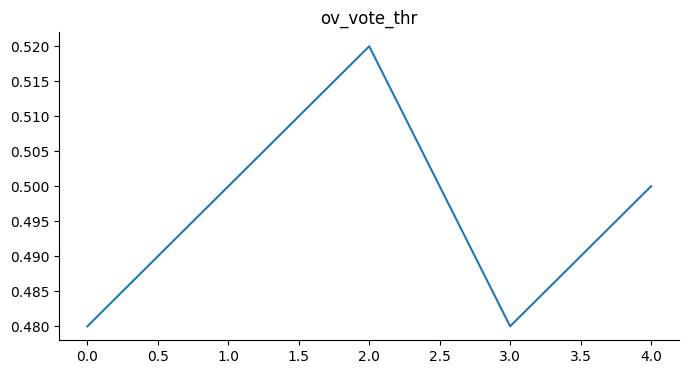

In [ ]:
from matplotlib import pyplot as plt
df_full['ov_vote_thr'].plot(kind='line', figsize=(8, 4), title='ov_vote_thr')
plt.gca().spines[['top', 'right']].set_visible(False)

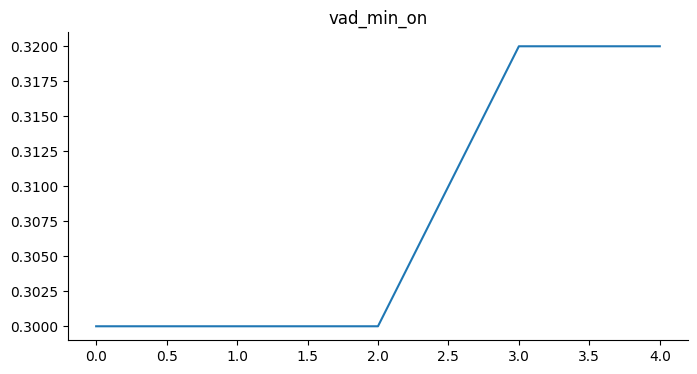

In [ ]:
from matplotlib import pyplot as plt
df_full['vad_min_on'].plot(kind='line', figsize=(8, 4), title='vad_min_on')
plt.gca().spines[['top', 'right']].set_visible(False)

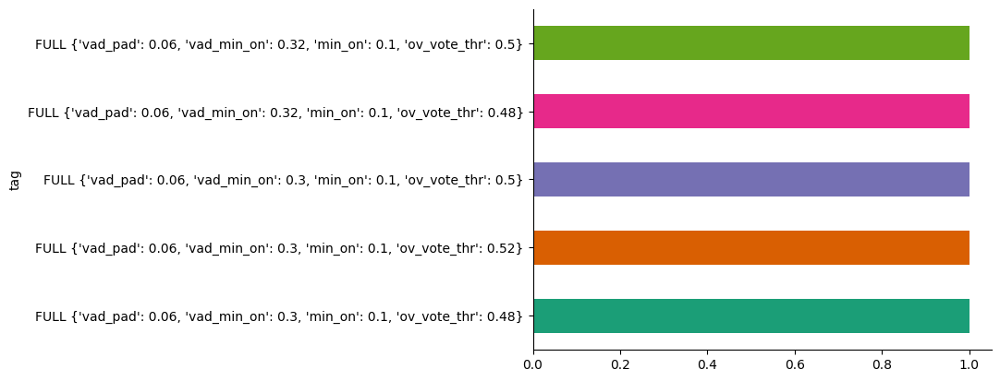

In [ ]:
from matplotlib import pyplot as plt
import seaborn as sns
df_full.groupby('tag').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
clear_caches()

cfg4_best = Stage4Config(
    vad_pad=0.06,
    vad_merge_gap=0.04,
    vad_min_on=0.30,
    min_on=0.10,
    merge_gap=0.04,
    ov_vote_thr=0.50,
    collapse_vote_mean_max=0.35,
    collapse_second_frac_max=0.25,
    protect_second_frac_thr=0.25,
    # (optional) tighten Stage1 gate more/less:
    stage1_gate_low_vote_thr=0.05,
    stage1_gate_pad=0.10,
)
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), dev_files, max_files=10)
_print_summary("stage4 FA DEV", s4)



[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE


KeyboardInterrupt: 

In [ ]:
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), test_files, max_files=10)
_print_summary("stage4 FA DEV", s4)


[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 1/6 ES2006a DER=0.1666 (miss=88.38 fa=45.56 conf=50.91 total=1109.46)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 2/6 TS3009a DER=0.2289 (miss=119.55 fa=102.27 conf=118.81 total=1488.20)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 3/6 TS3012a DER=0.1333 (miss=46.98 fa=17.82 conf=21.17 total=644.78)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 4/6 IS1003a DER=0.3409 (miss=68.68 fa=39.88 conf=82.07 total=559.16)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 5/6 ES2003a DER=0.1100 (miss=38.02 fa=16.50 conf=21.02 total=686.82)
[STAGE4] version = stage4_2026-01-11_v3
[eval_files] 6/6 ES2009a DER=0.1696 (miss=88.90 fa=81.64 conf=62.39 total=1373.40)
[SUMMARY] stage4 FA DEV mean={'DER': 0.19155697849658473, 'miss': 75.08533333333271, 'fa': 50.61166666666583, 'conf': 59.394999999999804, 'total': 976.9703333333327} global={'DER': 0.18945508751374415, 'miss': 450.51199999999625, 'fa': 303.669999999995, 'conf': 

In [ ]:
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), test_files, max_files=10)
_print_summary("stage4 FA DEV", s4)


In [ ]:
def run_stage4_from_precomputed(file, cfg4, hyp3_map):
    uri = str(file.get("uri"))
    hyp3 = hyp3_map[uri]  # must exist
    return STAGE4_OVERLAP_SANITY(file, hyp3, cfg=cfg4)


In [ ]:
cfg4_fa = Stage4Config(
    # tighten PyVAD guardrail (FA control)
    vad_pad=0.12,
    vad_merge_gap=0.06,
    vad_min_on=0.25,

    # Stage4 cleanup
    min_on=0.06,
    merge_gap=0.04,

    # overlap sanity thresholds
    ov_vote_thr=0.50,
    collapse_vote_mean_max=0.35,
    collapse_second_frac_max=0.25,
    protect_second_frac_thr=0.25,

    # stage1 gate (if our Stage4Config supports it)
    stage1_gate_pad=0.10,
)


[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[eval_files] 1/5 TS3010a DER=0.2304 (miss=77.47 fa=13.97 conf=19.17 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2531 (miss=133.27 fa=39.28 conf=103.13 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1970 (miss=89.26 fa=29.42 conf=39.07 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1633 (miss=30.16 fa=9.48 conf=7.04 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2036 (miss=61.19 fa=40.09 conf=40.42 total=695.90)
[SUMMARY] stage4 FA DEV mean={'DER': 0.20948891518451998, 'miss': 78.26999999999985, 'fa': 26.447999999999478, 'conf': 41.765999999999806, 'total': 670.3379999999997} global={'DER': 0.21852259606347724, 'miss': 391.3499999999993, 'fa': 132.2399999999974, 'conf': 208.82999999999902, 'total': 3351.6899999999987} n_ok=5/5


In [ ]:
# ============================================================
# FAST Stage4 tuning (single  cell)
# Key speedups:
#  1) DO NOT call run_stage3 inside the tuning loop (compute hyp3 once per file)
#  2) Keep seg3_thr fixed so seg3_vote_frac_on_res_grid cache hits
#  3) Tune in 2 phases:
#        Phase A: tune Stage4 thresholds/cleanup (fast, cached)
#        Phase B: tiny VAD neighborhood sweep around the best (optional)
# ============================================================

import time, random, itertools
import numpy as np
import pandas as pd

# -------------------------
# Helpers
# -------------------------
def _pick_file(files, uri):
    for f in files:
        if str(f.get("uri")) == str(uri):
            return f
    raise ValueError(f"Could not find uri={uri} in files list")

def _extract_global(s):
    g = s.get("global", {}) if isinstance(s, dict) else {}
    return dict(
        DER=float(g.get("DER", 1e9)),
        miss=float(g.get("miss", 1e9)),
        fa=float(g.get("fa", 1e9)),
        conf=float(g.get("conf", 1e9)),
        total=float(g.get("total", 0.0)),
        n_ok=s.get("n_ok", None) if isinstance(s, dict) else None,
    )

def _cfg_to_dict(cfg):
    return {k: getattr(cfg, k) for k in cfg.__dict__.keys()}

def _make_cfg(base: Stage4Config, **overrides):
    d = _cfg_to_dict(base).copy()
    d.update(overrides)
    return Stage4Config(**d)

def _evaluate_on_files(files_subset, cfg, hyp3_cache):
    # IMPORTANT: bypass run_stage4 (which calls run_stage3) and apply Stage4 directly to cached hyp3
    def _fn(f):
        uri = str(f.get("uri"))
        return STAGE4_OVERLAP_SANITY(f, hyp3_cache[uri], cfg=cfg)
    _, s = eval_files_stages(_fn, files_subset, max_files=len(files_subset))
    return _extract_global(s)

# -------------------------
# Setup
# -------------------------
clear_caches()

TARGET_URI = "TS3006a"   # tune on 1 file first (fast)
target_file = _pick_file(dev_files, TARGET_URI)

# we can validate best configs on all dev files at the end
VALID_FILES = list(dev_files)  # uses our existing dev_files list

# -------------------------
# Baseline cfg (our current best-ish)
# -------------------------
cfg_base = Stage4Config(
    # Keep VAD fixed in Phase A (so VAD cache hits + fewer expensive recomputations)
    vad_pad=0.12,
    vad_merge_gap=0.06,
    vad_min_on=0.25,

    min_on=0.06,
    merge_gap=0.04,

    ov_vote_thr=0.50,
    collapse_vote_mean_max=0.35,
    collapse_second_frac_max=0.25,
    protect_second_frac_thr=0.25,

    enable_stage1_gate=False,   # keep OFF (as we requested)
    stage1_gate_pad=0.10,

    return_debug=False,
)

# Fix seg3_thr during tuning so seg3_vote cache hits reliably
# (If our Stage4Config has seg3_thr field, we set it explicitly)
if hasattr(cfg_base, "seg3_thr") and cfg_base.seg3_thr is None:
    cfg_base = _make_cfg(cfg_base, seg3_thr=float(globals().get("SEG3_ACTIVITY_THR", 0.50)))

print("[BASE] evaluating baseline on TS3006a...")
base_met = _evaluate_on_files([target_file], cfg_base, hyp3_cache={"__dummy__": None}) if False else None
# We'll build hyp3_cache first (below) and then evaluate properly.

# -------------------------
# Build hyp3_cache ONCE (biggest speedup)
# -------------------------
print("[CACHE] computing Stage3 hyp once for TS3006a (and optionally for full dev)...")

hyp3_cache = {}
t0 = time.time()

# Cache Stage3 for target + optionally all dev files (Important very important now, still only 5 files)
files_to_cache = [target_file] + [f for f in VALID_FILES if str(f.get("uri")) != TARGET_URI]

for f in files_to_cache:
    uri = str(f.get("uri"))
    if uri in hyp3_cache:
        continue
    hyp3_cache[uri] = run_stage3(f, start_from_promoted=True)  # ONE-TIME COST
    print(f"  cached hyp3: {uri}")

print(f"[CACHE] done in {time.time()-t0:.1f}s")

# Warm seg3 vote cache once (same activity_thr across tuning)
# This prevents the first config from paying the seg3 inference penalty repeatedly.
print("[CACHE] warming seg3 vote cache once...")
uem_seg = _get_uem_full(target_file).extent()
res = float(getattr(cfg_base, "res", None) or float(globals().get("RES", 0.02)))
seg3_thr = float(getattr(cfg_base, "seg3_thr", float(globals().get("SEG3_ACTIVITY_THR", 0.50))))
_ = seg3_vote_frac_on_res_grid(target_file, uem_seg, res=res, activity_thr=seg3_thr)

# Baseline score (now real)
base_met = _evaluate_on_files([target_file], cfg_base, hyp3_cache)
print("[BASE TS3006a]", base_met)

# ============================================================
# Phase A (FAST): Random search over Stage4 thresholds/cleanup
# - Keep VAD fixed for cache-hit speed
# ============================================================
PHASEA_SAMPLES = 220   # increase if we want, but this is already strong
TOPK_KEEP = 25

spaceA = {
    "ov_vote_thr":               [0.40, 0.45, 0.50, 0.55, 0.60],
    "protect_second_frac_thr":   [0.20, 0.25, 0.35, 0.45, 0.55],
    "collapse_vote_mean_max":    [0.25, 0.30, 0.35, 0.40, 0.45],
    "collapse_second_frac_max":  [0.18, 0.22, 0.25, 0.28, 0.32],
    "hole_fill_mode":            ["none", "dominant", "stage3"],
    "min_on":                    [0.04, 0.06, 0.08],
    "merge_gap":                 [0.03, 0.04, 0.06],
}

# (Optional) if our Stage4Config has these fields and we want to tune them:
if hasattr(cfg_base, "collapse_min_dur"):
    spaceA["collapse_min_dur"] = [0.12, 0.16, 0.20, 0.28]
if hasattr(cfg_base, "protect_min_dur"):
    spaceA["protect_min_dur"] = [0.12, 0.20, 0.30]

def _sample_cfg(space):
    return {k: random.choice(v) for k, v in space.items()}

print(f"\n[PHASE A] random configs={PHASEA_SAMPLES} on {TARGET_URI} (VAD fixed)")
rowsA = []
tA = time.time()

best = None
best_row = None

for i in range(1, PHASEA_SAMPLES + 1):
    params = _sample_cfg(spaceA)
    cfg = _make_cfg(cfg_base, **params)

    met = _evaluate_on_files([target_file], cfg, hyp3_cache)
    row = {**params, **met}
    rowsA.append(row)

    if best is None or met["DER"] < best:
        best = met["DER"]
        best_row = row

    if i % 20 == 0:
        print(f"  {i:4d}/{PHASEA_SAMPLES}  best_DER={best:.4f}  avg={(time.time()-tA)/i:.2f}s/cfg")

dfA = pd.DataFrame(rowsA).sort_values(["DER", "fa", "miss"], ascending=True).reset_index(drop=True)
print("\n[PHASE A] top 10 (TS3006a):")
display(dfA.head(10))

# Keep top K for Phase B validation/sweep
candsA = dfA.head(TOPK_KEEP).copy()

# ============================================================
# Phase B (OPTIONAL): small VAD neighborhood sweep around best Phase A
# - VAD changes can be expensive; keep this tiny.
# ============================================================
DO_PHASE_B = True

vad_neighborhood = {
    "vad_pad":       [0.10, 0.12, 0.14],
    "vad_merge_gap": [0.04, 0.06, 0.08],
    "vad_min_on":    [0.22, 0.25, 0.28],
}

rowsB = []
if DO_PHASE_B:
    print(f"\n[PHASE B] VAD neighborhood sweep on top {min(10, TOPK_KEEP)} Phase-A configs")
    tB = time.time()

    # Only sweep VAD for best few candidates to keep it fast
    topA_for_B = candsA.head(min(10, TOPK_KEEP)).to_dict(orient="records")

    for base_params in topA_for_B:
        # reconstruct the Phase-A part (ignore metrics columns)
        phaseA_params = {k: base_params[k] for k in spaceA.keys() if k in base_params}

        for vad_pad, vad_merge_gap, vad_min_on in itertools.product(
            vad_neighborhood["vad_pad"],
            vad_neighborhood["vad_merge_gap"],
            vad_neighborhood["vad_min_on"],
        ):
            cfg = _make_cfg(
                cfg_base,
                **phaseA_params,
                vad_pad=vad_pad,
                vad_merge_gap=vad_merge_gap,
                vad_min_on=vad_min_on,
            )

            met = _evaluate_on_files([target_file], cfg, hyp3_cache)
            rowsB.append({**phaseA_params, "vad_pad": vad_pad, "vad_merge_gap": vad_merge_gap, "vad_min_on": vad_min_on, **met})

    dfB = pd.DataFrame(rowsB).sort_values(["DER", "fa", "miss"], ascending=True).reset_index(drop=True)
    print("\n[PHASE B] top 10 (TS3006a):")
    display(dfB.head(10))
else:
    dfB = None

# ============================================================
# Pick best config found + validate on full dev (5 files) quickly
# ============================================================
best_df = dfB if (dfB is not None and len(dfB) > 0) else dfA
best_row = best_df.iloc[0].to_dict()

# Build cfg_best (collect only keys that exist on cfg_base)
cfg_fields = set(_cfg_to_dict(cfg_base).keys())
best_params = {k: best_row[k] for k in best_row.keys() if k in cfg_fields}

cfg_best = _make_cfg(cfg_base, **best_params)

print("\n[BEST cfg params]", best_params)
print("[VALIDATE] on full DEV (5 files) using cached hyp3 (no Stage3 recompute)...")
met_dev = _evaluate_on_files(VALID_FILES, cfg_best, hyp3_cache)
print("[DEV]", met_dev)

cfg_best


In [ ]:
import itertools, time
import pandas as pd

def _get_file_by_uri(files, uri):
    for f in files:
        if str(f.get("uri")) == str(uri):
            return f
    raise ValueError(f"uri={uri} not found")

TS_URI = "TS3006a"
ts3006 = _get_file_by_uri(dev_files, TS_URI)
one_file = [ts3006]

def eval_stage4_one(cfg4: Stage4Config, start_from_promoted=True):
    # Force per-config recompute if cache keys are wrong
    # Stage3 cache we should NOT touch unless we created one; leave it alone.

    _, summ = eval_files_stages(
        lambda f: run_stage4(f, start_from_promoted=start_from_promoted, cfg4=cfg4),
        [ts3006],
        max_files=1,
    )
    g = (summ or {}).get("global", {}) if isinstance(summ, dict) else {}
    return {
        "DER":  g.get("DER", None),
        "miss": g.get("miss", None),
        "fa":   g.get("fa", None),
        "conf": g.get("conf", None),
        "total":g.get("total", None),
    }


In [ ]:
def tune_ts3006a_phaseA(max_rows=30):
    grid = {
        "vad_pad":       [0.12, 0.18],
        "vad_merge_gap": [0.06, 0.10],
        "vad_min_on":    [0.15, 0.20, 0.25],
        "ov_vote_thr":   [0.40, 0.50, 0.60],
        "protect_second_frac_thr": [0.35, 0.45, 0.55],
        "hole_fill_mode":["none", "dominant", "stage3"],
        "min_on":        [0.04, 0.06],
        "merge_gap":     [0.04, 0.06],
    }
    fixed = dict(
        enable_stage1_gate=False,
        protect_stage3_overlap=True,
        enforce_single_outside_overlap=True,
        return_debug=False,
    )

    keys = list(grid.keys())
    combos = list(itertools.product(*[grid[k] for k in keys]))
    print(f"[TS3006a PhaseA] configs={len(combos)}")

    rows = []
    t0 = time.time()

    for idx, vals in enumerate(combos, 1):
        params = dict(zip(keys, vals))
        cfg = Stage4Config(**fixed, **params)

        met = eval_stage4_one(cfg)
        rows.append({**params, **met})

        if idx % 10 == 0:
            elapsed = time.time() - t0
            print(f"  done {idx}/{len(combos)}  avg={elapsed/idx:.2f}s/cfg")

    df = pd.DataFrame(rows).sort_values(["DER","fa","miss"], ascending=True).reset_index(drop=True)
    display(df.head(max_rows))
    return df

dfA = tune_ts3006a_phaseA(max_rows=25)
bestA = dfA.iloc[0].to_dict()
bestA


[TS3006a PhaseA] configs=1296
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[eval_files] 1/1 TS3006a DER=0.2637 (miss=148.42 fa=39.27 conf=99.47 total=1089.05)
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[eval_files] 1/1 TS3006a DER=0.2637 (miss=148.24 fa=39.45 conf=99.47 total=1089.05)
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[eval_files] 1/1 TS3006a DER=0.2637 (miss=148.46 fa=39.27 conf=99.43 total=1089.05)
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE


KeyboardInterrupt: 

In [ ]:
import numpy as np

def ann_fingerprint(ann, limit=50):
    # stable “hash” from first N segments after sorting
    items = []
    for seg, track, lab in ann.itertracks(yield_label=True):
        items.append((float(seg.start), float(seg.end), str(lab)))
    items.sort()
    items = items[:limit]
    # round to make stable under tiny float noise
    items = [(round(s, 3), round(e, 3), l) for s, e, l in items]
    return hash(tuple(items)), len(items)

cfg_lo = Stage4Config(
    enable_stage1_gate=False,
    vad_pad=0.05, vad_merge_gap=0.20, vad_min_on=0.10,
    ov_vote_thr=0.30,
    protect_second_frac_thr=0.25,
    hole_fill_mode="stage3",
    min_on=0.02, merge_gap=0.02,
    return_debug=True,
)

cfg_hi = Stage4Config(
    enable_stage1_gate=False,
    vad_pad=0.25, vad_merge_gap=0.02, vad_min_on=0.35,
    ov_vote_thr=0.70,
    protect_second_frac_thr=0.75,
    hole_fill_mode="none",
    min_on=0.12, merge_gap=0.10,
    return_debug=True,
)

f = ts3006  # from earlier

out_lo, dbg_lo = run_stage4(f, start_from_promoted=True, cfg4=cfg_lo)
out_hi, dbg_hi = run_stage4(f, start_from_promoted=True, cfg4=cfg_hi)

fp_lo, n_lo = ann_fingerprint(out_lo)
fp_hi, n_hi = ann_fingerprint(out_hi)

print("fingerprint lo:", fp_lo, "n_items:", n_lo)
print("fingerprint hi:", fp_hi, "n_items:", n_hi)
print("\nDBG lo:", dbg_lo)
print("\nDBG hi:", dbg_hi)

print("\nSame annotation?", fp_lo == fp_hi)


fingerprint lo: 511340220529964986 n_items: 50
fingerprint hi: -5578208819828477319 n_items: 50

DBG lo: {'ov_mask_sec': 121.12, 'protect_sec': 122.10000000000001, 'ov_allowed_sec': 132.32, 'sec_stage1_gate_removed': 0.0, 'sec_collapsed': 0.0, 'sec_filled_holes': 15.34, 'sec_capped_3plus': 15.34}

DBG hi: {'ov_mask_sec': 94.2, 'protect_sec': 114.24000000000001, 'ov_allowed_sec': 120.94, 'sec_stage1_gate_removed': 0.0, 'sec_collapsed': 0.0, 'sec_filled_holes': 0.0, 'sec_capped_3plus': 15.34}

Same annotation? False


In [ ]:
def vad_signature(file, pad, merge_gap, min_on):
    tl = get_speech_timeline_pyvad(file, pad=pad, merge_gap=merge_gap, min_on=min_on)
    segs = list(tl)
    dur = sum(float(s.duration) for s in segs)
    return len(segs), round(dur, 3)

print("VAD sig A:", vad_signature(ts3006, 0.05, 0.20, 0.10))
print("VAD sig B:", vad_signature(ts3006, 0.25, 0.02, 0.35))


VAD sig A: (127, 945.027)
VAD sig B: (110, 994.364)


In [ ]:
grid = {
    "vad_pad":       [0.08, 0.12, 0.18],
    "vad_merge_gap": [0.06, 0.10],
    "vad_min_on":    [0.15, 0.20, 0.25],
    "ov_vote_thr":   [0.40, 0.50, 0.60],
    "protect_second_frac_thr": [0.35, 0.45, 0.55],
    "hole_fill_mode":["none", "dominant", "stage3"],
    "min_on":        [0.04, 0.06],
    "merge_gap":     [0.04, 0.06],
}
fixed = dict(
    enable_stage1_gate=False,
    protect_stage3_overlap=True,
    enforce_single_outside_overlap=True,
    return_debug=False,
)


In [ ]:
import itertools
import pandas as pd

def _extract_global(summary):
    if not isinstance(summary, dict):
        return None
    g = summary.get("global", None)
    if not isinstance(g, dict):
        return None
    return {
        "global_DER":  g.get("DER", None),
        "global_miss": g.get("miss", None),
        "global_fa":   g.get("fa", None),
        "global_conf": g.get("conf", None),
        "global_total":g.get("total", None),
        "n_ok":        summary.get("n_ok", None),
    }

def tune_stage4_grid_precomputed(dev_files, hyp3_map, max_files=5, topk=20):
    grid = {
        # big FA levers
        "vad_pad":       [0.10, 0.12, 0.15],
        "vad_merge_gap": [0.06, 0.08],
        "vad_min_on":    [0.20, 0.25],

        "enable_stage1_gate": [True],
        "stage1_gate_pad":    [0.06, 0.08, 0.10],

        # overlap handling (balance FA vs miss)
        "ov_vote_thr":              [0.45, 0.50, 0.55],
        "protect_second_frac_thr":  [0.45, 0.55, 0.65],

        # hole fill is FA-sensitive
        "hole_fill_mode": ["none", "dominant"],

        # cleanup (micro FA leaks)
        "min_on":    [0.04, 0.06],
        "merge_gap": [0.04, 0.06],
    }

    fixed = dict(
        protect_stage3_overlap=True,
        enforce_single_outside_overlap=True,
        collapse_min_dur=0.20,
        collapse_vote_mean_max=0.18,
        collapse_second_frac_max=0.22,
        return_debug=False,
    )

    keys = list(grid.keys())
    combos = list(itertools.product(*[grid[k] for k in keys]))
    print(f"[TUNE] configs={len(combos)} max_files={max_files}")

    rows = []
    for vals in combos:
        params = dict(zip(keys, vals))
        cfg4 = Stage4Config(**fixed, **params)

        _, summ = eval_files_stages(
            lambda f: run_stage4_from_precomputed(f, cfg4, hyp3_map),
            dev_files,
            max_files=max_files,
        )

        met = _extract_global(summ)
        if met is None:
            continue
        rows.append({**params, **met})

    df = pd.DataFrame(rows)
    df = df.sort_values(["global_DER", "global_fa", "global_miss"], ascending=True).reset_index(drop=True)
    display(df.head(topk))
    return df

df = tune_stage4_grid_precomputed(dev_files, hyp3_map, max_files=5, topk=20)


[TUNE] configs=2592 max_files=5
[eval_files] 1/5 TS3010a DER=0.2282 (miss=77.17 fa=13.43 conf=18.99 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2614 (miss=148.25 fa=38.46 conf=98.01 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.2071 (miss=98.55 fa=28.69 conf=38.58 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1676 (miss=32.10 fa=9.10 conf=6.71 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2154 (miss=70.25 fa=39.99 conf=39.67 total=695.90)
[eval_files] 1/5 TS3010a DER=0.2281 (miss=77.11 fa=13.43 conf=18.99 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2615 (miss=148.07 fa=38.70 conf=98.01 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.2071 (miss=98.55 fa=28.69 conf=38.58 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1674 (miss=32.04 fa=9.10 conf=6.71 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2154 (miss=70.25 fa=39.99 conf=39.67 total=695.90)
[eval_files] 1/5 TS3010a DER=0.2282 (miss=77.17 fa=13.43 conf=18.99 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2614 (miss=148.29 fa=38.42 conf=97.

KeyboardInterrupt: 

In [ ]:
run_stage3 = _RUN_STAGE3_ORIG


In [ ]:
# =========================
# HARD FIX: restore real run_stage3 + safe cache wrapper (no self-wrap)
# =========================
import inspect

# ---- 0) Validate required symbols exist
need = ["STAGE3_MEMORYBANK_KNN_REFINEMENT", "PIPE_BASE", "Stage3Config"]
missing = [x for x in need if x not in globals()]
if missing:
    raise NameError(f"Missing required Stage3 symbols: {missing}. "
                    f"Re-run the Stage3 definition cells first.")

# ---- 1) Recreate the ORIGINAL Stage3 function (uncached)
def run_stage3_uncached(file, start_from_promoted=True, stage2_kwargs=None, cfg=None, return_debug=False, debug=False):
    return STAGE3_MEMORYBANK_KNN_REFINEMENT(
        file,
        baseline_fn=PIPE_BASE,
        start_from_promoted=bool(start_from_promoted),
        stage2_kwargs=stage2_kwargs or {},
        cfg=cfg or Stage3Config(),
        debug=bool(debug),
        return_debug=bool(return_debug),
    )

# Install it as the canonical Stage3 implementation
run_stage3 = run_stage3_uncached

# ---- 2) Reset/keep Stage3 cache dict
_STAGE3_CACHE = globals().get("_STAGE3_CACHE", {})
globals()["_STAGE3_CACHE"] = _STAGE3_CACHE

# ---- 3) Safe cache wrapper that NEVER calls `run_stage3` by name internally
def run_stage3_cached(file, *args, **kwargs):
    uri = str(file.get("uri"))
    # include parameters that affect output
    key = (
        uri,
        bool(kwargs.get("start_from_promoted", True)),
        repr(kwargs.get("stage2_kwargs", None)),
        repr(kwargs.get("cfg", None)),
        bool(kwargs.get("return_debug", False)),
        bool(kwargs.get("debug", False)),
    )
    if key in _STAGE3_CACHE:
        return _STAGE3_CACHE[key]
    out = run_stage3_cached._orig(file, *args, **kwargs)  # <-- calls uncached impl, never wrapper
    _STAGE3_CACHE[key] = out
    return out

run_stage3_cached._orig = run_stage3_uncached

# Patch global name to cached version
run_stage3 = run_stage3_cached

print("[OK] run_stage3 fixed.")
print("run_stage3 name:", run_stage3.__name__)
print("has _orig:", hasattr(run_stage3, "_orig"))
print("orig name:", run_stage3._orig.__name__ if hasattr(run_stage3, "_orig") else None)

# Optional: prove it's not self-referential
if run_stage3._orig is run_stage3 or run_stage3._orig.__name__ == run_stage3.__name__:
    raise RuntimeError("Stage3 wrapper still self-referential; something overwrote run_stage3 again.")


[OK] run_stage3 fixed.
run_stage3 name: run_stage3_cached
has _orig: True
orig name: run_stage3_uncached


In [ ]:
import numpy as np

def stage4_list_collapse_candidates(file, cfg, topk=25):
    uem_tl = _get_uem_full(file)
    uem_seg = uem_tl.extent()
    res = float(cfg.res or globals().get("RES", 0.02))
    T = int(np.ceil(float(uem_seg.duration) / float(res)))

    hyp3 = run_stage3(file, start_from_promoted=True)
    labels = [str(l) for l in hyp3.labels()]
    M_in = frame_matrix_from_annotation(hyp3, uem_seg=uem_seg, labels=labels, res=res)
    M_in = (np.asarray(M_in) > 0).astype(np.uint8)[:T]
    cnt_in = M_in.sum(axis=1)

    # speech mask
    speech_tl = get_speech_timeline_pyvad(file, pad=cfg.vad_pad, merge_gap=cfg.vad_merge_gap, min_on=cfg.vad_min_on)
    speech_mask = timeline_to_mask(speech_tl, uem_seg, res, T).astype(bool)

    # vote
    seg3_thr = cfg.seg3_thr if cfg.seg3_thr is not None else float(globals().get("SEG3_ACTIVITY_THR", 0.50))
    vote_frac = seg3_vote_frac_on_res_grid(file, uem_seg, res=res, activity_thr=seg3_thr)
    vote_frac = np.asarray(vote_frac, dtype=np.float32)[:T]

    # ov_allowed (same as Stage4)
    ov_mask = (vote_frac >= float(cfg.ov_vote_thr))
    ov_mask = s4_smooth_mask_with_timeline(ov_mask, uem_seg, res, pad=cfg.ov_pad, merge_gap=cfg.ov_merge_gap, min_on=cfg.ov_min_on)
    ov_mask &= speech_mask

    if cfg.protect_stage3_overlap:
        hyp_ov = (cnt_in >= 2) & speech_mask
        protect = np.zeros((T,), dtype=bool)
        for i, j in s4_runs(hyp_ov):
            dur = (j - i) * res
            if dur + 1e-9 < float(cfg.protect_min_dur):
                continue
            sec_frac = s4_second_frac_activity(M_in[i:j])
            if sec_frac >= float(cfg.protect_second_frac_thr):
                protect[i:j] = True
        ov_allowed = ov_mask | protect
    else:
        ov_allowed = ov_mask

    bad = (cnt_in >= 2) & (~ov_allowed) & speech_mask

    rows = []
    for i, j in s4_runs(bad):
        vmean = float(np.mean(vote_frac[i:j]))
        sec_frac = s4_second_frac_activity(M_in[i:j])
        dur = (j - i) * res

        # "distance to collapse" (lower is closer)
        dv = max(0.0, vmean - float(cfg.collapse_vote_mean_max))
        ds = max(0.0, sec_frac - float(cfg.collapse_second_frac_max))
        score = dv + ds

        rows.append((score, dur, vmean, sec_frac, i, j))

    rows.sort(key=lambda x: x[0])
    print(f"Found {len(rows)} overlap-outside-ov_allowed runs.")
    print("Top candidates (closest to collapsing):")
    for (score, dur, vmean, sec_frac, i, j) in rows[:topk]:
        s = float(uem_seg.start) + float(i) * res
        e = float(uem_seg.start) + float(j) * res
        print(f"  {s:.2f}-{e:.2f} dur={dur:.2f}s vote_mean={vmean:.3f} sec_frac={sec_frac:.3f}  dist={score:.3f}")

# Example:



DEBUG_URI = "TS3006a"
f = next(ff for ff in dev_files if str(ff.get("uri")) == DEBUG_URI)



stage4_list_collapse_candidates(f, Stage4Config(), topk=30)


Found 41 overlap-outside-ov_allowed runs.
Top candidates (closest to collapsing):
  66.00-66.06 dur=0.06s vote_mean=0.164 sec_frac=1.000  dist=0.800
  66.12-66.14 dur=0.02s vote_mean=0.186 sec_frac=1.000  dist=0.800
  85.12-85.14 dur=0.02s vote_mean=0.000 sec_frac=1.000  dist=0.800
  89.86-89.88 dur=0.02s vote_mean=0.000 sec_frac=1.000  dist=0.800
  111.58-111.60 dur=0.02s vote_mean=0.137 sec_frac=1.000  dist=0.800
  204.20-204.22 dur=0.02s vote_mean=0.000 sec_frac=1.000  dist=0.800
  217.66-217.68 dur=0.02s vote_mean=0.093 sec_frac=1.000  dist=0.800
  270.22-270.24 dur=0.02s vote_mean=0.008 sec_frac=1.000  dist=0.800
  297.84-297.86 dur=0.02s vote_mean=0.000 sec_frac=1.000  dist=0.800
  314.88-314.92 dur=0.04s vote_mean=0.072 sec_frac=1.000  dist=0.800
  325.72-325.74 dur=0.02s vote_mean=0.017 sec_frac=1.000  dist=0.800
  328.62-328.64 dur=0.02s vote_mean=0.000 sec_frac=1.000  dist=0.800
  333.02-333.04 dur=0.02s vote_mean=0.000 sec_frac=1.000  dist=0.800
  357.12-357.14 dur=0.02s vot

In [ ]:
import numpy as np

def stage4_why_no_diff(file, cfg_lo, cfg_hi):
    uem_tl = _get_uem_full(file)
    uem_seg = uem_tl.extent()
    res = float(getattr(cfg_lo, "res", None) or globals().get("RES", 0.02))
    T = int(np.ceil(float(uem_seg.duration) / float(res)))

    # Stage3 hypothesis
    hyp3 = run_stage3(file, start_from_promoted=True)
    labels = [str(l) for l in hyp3.labels()]
    M_in = frame_matrix_from_annotation(hyp3, uem_seg=uem_seg, labels=labels, res=res)
    M_in = (np.asarray(M_in) > 0).astype(np.uint8)[:T]
    cnt_in = M_in.sum(axis=1)
    ov_in = (cnt_in >= 2)

    def _ov_allowed_from_cfg(cfg):
        # speech mask
        speech_tl = get_speech_timeline_pyvad(
            file, pad=cfg.vad_pad, merge_gap=cfg.vad_merge_gap, min_on=cfg.vad_min_on
        )
        speech_mask = timeline_to_mask(speech_tl, uem_seg, res, T).astype(bool)

        # seg3 vote
        seg3_thr = cfg.seg3_thr if cfg.seg3_thr is not None else float(globals().get("SEG3_ACTIVITY_THR", 0.50))
        vote_frac = seg3_vote_frac_on_res_grid(file, uem_seg, res=res, activity_thr=seg3_thr)
        vote_frac = np.asarray(vote_frac, dtype=np.float32)[:T]

        ov_mask = (vote_frac >= float(cfg.ov_vote_thr))
        ov_mask = s4_smooth_mask_with_timeline(
            ov_mask, uem_seg, res,
            pad=cfg.ov_pad, merge_gap=cfg.ov_merge_gap, min_on=cfg.ov_min_on
        )
        ov_mask = ov_mask & speech_mask

        if getattr(cfg, "protect_stage3_overlap", True):
            hyp_ov = ov_in & speech_mask
            protect = np.zeros((T,), dtype=bool)
            for i, j in s4_runs(hyp_ov):
                dur = (j - i) * res
                if dur + 1e-9 < float(cfg.protect_min_dur):
                    continue
                sec_frac = s4_second_frac_activity(M_in[i:j])
                if sec_frac >= float(cfg.protect_second_frac_thr):
                    protect[i:j] = True
            ov_allowed = ov_mask | protect
        else:
            ov_allowed = ov_mask

        return ov_allowed, speech_mask, vote_frac

    def _eligible_to_collapse(cfg, ov_allowed, speech_mask, vote_frac):
        # exactly the same predicate Stage4 uses
        bad = (cnt_in >= 2) & (~ov_allowed) & speech_mask
        eligible = np.zeros((T,), dtype=bool)

        for i, j in s4_runs(bad):
            vmean = float(np.mean(vote_frac[i:j])) if j > i else 0.0
            sec_frac = s4_second_frac_activity(M_in[i:j])
            if (vmean <= float(cfg.collapse_vote_mean_max)) and (sec_frac <= float(cfg.collapse_second_frac_max)):
                eligible[i:j] = True
        return bad, eligible

    # low
    ov_allowed_lo, speech_mask_lo, vote_lo = _ov_allowed_from_cfg(cfg_lo)
    bad_lo, elig_lo = _eligible_to_collapse(cfg_lo, ov_allowed_lo, speech_mask_lo, vote_lo)

    # high
    ov_allowed_hi, speech_mask_hi, vote_hi = _ov_allowed_from_cfg(cfg_hi)
    bad_hi, elig_hi = _eligible_to_collapse(cfg_hi, ov_allowed_hi, speech_mask_hi, vote_hi)

    def sec(x): return float(np.sum(x)) * res

    print("=== Stage3 overlap baseline ===")
    print("Stage3 overlap sec:", sec(ov_in))

    print("\n=== LOW cfg ===")
    print("ov_allowed sec:", sec(ov_allowed_lo))
    print("overlap outside ov_allowed (bad) sec:", sec(bad_lo))
    print("eligible to collapse sec:", sec(elig_lo))

    print("\n=== HIGH cfg ===")
    print("ov_allowed sec:", sec(ov_allowed_hi))
    print("overlap outside ov_allowed (bad) sec:", sec(bad_hi))
    print("eligible to collapse sec:", sec(elig_hi))

    print("\n=== Difference between cfgs (where ov_allowed differs) ===")
    diff = ov_allowed_lo ^ ov_allowed_hi
    print("ov_allowed diff sec:", sec(diff))
    print("...and Stage3 overlap inside diff sec:", sec(diff & ov_in))

# Example:
cfg_lo = Stage4Config(ov_vote_thr=0.35)
cfg_hi = Stage4Config(ov_vote_thr=0.60)
stage4_why_no_diff(f, cfg_lo, cfg_hi)  # if dev_files is dict-like list, pass a file item not list


=== Stage3 overlap baseline ===
Stage3 overlap sec: 124.14

=== LOW cfg ===
ov_allowed sec: 130.08
overlap outside ov_allowed (bad) sec: 1.06
eligible to collapse sec: 0.0

=== HIGH cfg ===
ov_allowed sec: 123.32000000000001
overlap outside ov_allowed (bad) sec: 1.82
eligible to collapse sec: 0.0

=== Difference between cfgs (where ov_allowed differs) ===
ov_allowed diff sec: 6.76
...and Stage3 overlap inside diff sec: 0.76


In [ ]:
import inspect
import numpy as np

def _pick_file(files, uri="TS3006a"):
    for f in files:
        if str(f.get("uri")) == uri:
            return f
    raise ValueError(f"URI not found: {uri}")

def _ann_to_count_frames(ann, uem_tl, res):
    uem_seg = uem_tl.extent()
    T = int(np.ceil(float(uem_seg.duration) / float(res)))
    labels = [str(l) for l in ann.labels()]
    M = frame_matrix_from_annotation(ann, uem_seg=uem_seg, labels=labels, res=res)
    M = (np.asarray(M) > 0).astype(np.uint8)[:T]
    return M.sum(axis=1), labels, uem_seg, T

def stage4_sanity_compare(dev_files, uri="TS3006a"):
    f = _pick_file(dev_files, uri)

    # show which function is actually bound right now
    print("run_stage4 source head:\n", "\n".join(inspect.getsource(run_stage4).splitlines()[:8]))
    print("STAGE4_OVERLAP_SANITY source head:\n", "\n".join(inspect.getsource(STAGE4_OVERLAP_SANITY).splitlines()[:10]))

    uem_tl = _get_uem_full(f)
    res = float(globals().get("RES", 0.02))

    hyp3 = run_stage3(f, start_from_promoted=True)
    c3, _, _, _ = _ann_to_count_frames(hyp3, uem_tl, res)

    # two EXTREME configs (should differ a lot)
    cfg_lo = Stage4Config(
        ov_vote_thr=0.20,                 # very permissive overlap
        collapse_vote_mean_max=0.05,      # collapse only if VERY low vote
        collapse_second_frac_max=0.05,
        return_debug=True,
    )
    cfg_hi = Stage4Config(
        ov_vote_thr=0.80,                 # very strict overlap
        collapse_vote_mean_max=0.80,      # collapse almost always if outside ov_allowed
        collapse_second_frac_max=0.80,
        return_debug=True,
    )

    out_lo, dbg_lo = STAGE4_OVERLAP_SANITY(f, hyp3, cfg=cfg_lo)
    out_hi, dbg_hi = STAGE4_OVERLAP_SANITY(f, hyp3, cfg=cfg_hi)

    c4_lo, _, _, _ = _ann_to_count_frames(out_lo, uem_tl, res)
    c4_hi, _, _, _ = _ann_to_count_frames(out_hi, uem_tl, res)

    # summarize impact
    print("\n--- DBG (low thresholds) ---")
    print(dbg_lo)
    print("\n--- DBG (high thresholds) ---")
    print(dbg_hi)

    print("\nFrame-diff stats vs Stage3:")
    print("  Stage3 overlap frames:", int(np.sum(c3 >= 2)))
    print("  Stage4(lo) overlap frames:", int(np.sum(c4_lo >= 2)))
    print("  Stage4(hi) overlap frames:", int(np.sum(c4_hi >= 2)))

    print("\nStage4(lo) vs Stage4(hi) frame diffs:")
    print("  any count change frames:", int(np.sum(c4_lo != c4_hi)))
    print("  overlap change frames   :", int(np.sum((c4_lo >= 2) != (c4_hi >= 2))))

    return (out_lo, dbg_lo), (out_hi, dbg_hi)

# Run:
(lo, hi) = stage4_sanity_compare(dev_files, uri="TS3006a")


run_stage4 source head:
 def run_stage4(file, start_from_promoted=True, cfg4: Stage4Config = None, cfg3=None):
    hyp3 = run_stage3(file, start_from_promoted=start_from_promoted, cfg=cfg3)
    return STAGE4_OVERLAP_SANITY(file, hyp3, cfg=cfg4)
STAGE4_OVERLAP_SANITY source head:
 def STAGE4_OVERLAP_SANITY(file, hyp_in: Annotation, cfg: Stage4Config = None):
    STAGE4_VERSION = "stage4_2026-01-11_no_clobber_v1"
    print("[STAGE4] version =", STAGE4_VERSION)

    cfg = cfg or Stage4Config()

    res = cfg.res if cfg.res is not None else float(globals().get("RES", 0.02))
    seg3_thr = cfg.seg3_thr if cfg.seg3_thr is not None else float(globals().get("SEG3_ACTIVITY_THR", 0.50))

    if "_get_uem_full" not in globals():
[STAGE4] version = stage4_2026-01-11_no_clobber_v1
[STAGE4] version = stage4_2026-01-11_no_clobber_v1

--- DBG (low thresholds) ---
{'ov_mask_sec': 131.68, 'protect_sec': 122.10000000000001, 'ov_allowed_sec': 140.18, 'sec_stage1_gate': 931.5600000000001, 'sec_collapsed': 

Best logs 🇰

=== STAGE4 (FA config) DEV ===
[eval_files] 1/5 TS3010a DER=0.2292 (miss=76.89 fa=13.97 conf=19.17 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2447 (miss=112.14 fa=49.19 conf=105.21 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1950 (miss=78.52 fa=36.90 conf=40.73 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1650 (miss=28.83 fa=11.29 conf=7.05 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2052 (miss=53.04 fa=46.46 conf=43.29 total=695.90)
[SUMMARY] stage4 FA DEV mean={'DER': 0.20782531798368925, 'miss': 69.88399999999987, 'fa': 31.561999999999465, 'conf': 43.089999999999826, 'total': 670.3379999999997} global={'DER': 0.21561659938717365, 'miss': 349.41999999999933, 'fa': 157.80999999999733, 'conf': 215.44999999999914, 'total': 3351.6899999999987} n_ok=5/5

In [ ]:
# clear_caches()
# clear_stage3_cache()

# cfg = Stage3Config(
#     # ---- 3A: promote 1->2 ----
#     promote_vote_thr=0.18,     # was 0.35 -> too strict for TS3010a
#     promote_min_dur=0.12,      # was 0.20 -> allow short overlap candidates
#     promote_merge_gap=0.08,
#     promote_sim2_thr=0.19,     # slightly easier to trigger (still safe)
#     promote_m23_thr=0.03,      # keep margin gate
#     promote_stable_subwins=3,
#     promote_subwin_sec=0.90,
#     promote_stable_req=2,      # was 3 -> allow 2/3 stability (still gated by m23)

#     # ---- 3B: gap handling ----
#     bridge_max_gap_sec=0.25,   # bridge more micro-holes (our “cut speech” issue)
#     fill_context_sec=0.35,     # reduce candidate explosion
#     fill_min_dur_sec=0.45,     # do NOT kNN-fill short gaps; bridge or skip
#     fill_merge_gap=0.05,
#     fill_sim1_thr=0.45,        # stronger than 0.40
#     fill_margin_thr=0.15,      # stronger than 0.12
#     fill_stable_subwins=3,
#     fill_subwin_sec=0.70,
#     fill_stable_req=3,         # keep strict stability for fills

#     # ---- energy gate (critical) ----
#     energy_percentile=45.0,    # was 20 -> too permissive given VAD padding/noise
#     energy_margin_db=6.0,      # was 3 -> push gate up
#     knn_sim_floor=10.0
# )


# f = next(x for x in dev_files if x["uri"] == "TS3010a")
# hyp3, dbg3 = run_stage3(f, start_from_promoted=True, cfg=cfg, return_debug=True, debug=True)

# print("ov_segs:", dbg3["n_overlap_segments"])
# print("gaps   :", dbg3["n_gap_segments"])
# print("promote_events:", len(dbg3["promote_events"]), "sec:", dbg3["changed_promote_sec"])
# print("bridge_events :", len(dbg3["bridge_events"]),  "sec:", dbg3["changed_bridge_sec"])
# print("fill_events   :", len(dbg3["fill_events"]),    "sec:", dbg3["changed_fill_sec"])
# print("rms_gate_db   :", dbg3["rms_gate_db"])
# print("dbg3 g3a_gates:",dbg3["g3a_gates"])



In [ ]:
# # ============================================================
# # Stage3 vs Stage2 Deep-Dive Debug Cell (plots + audio + ranking)
# #
# # What this cell does (per file):
# #   1) Runs Stage2 + Stage3 (using our existing functions/wrappers)
# #   2) Builds frame-level speaker-count timelines for Stage2 and Stage3
# #   3) Finds time segments where Stage3 differs from Stage2
# #   4) Ranks those segments by "DER got worse" (Stage3 DER - Stage2 DER)
# #   5) Plots:
# #        - speaker-count timeline (+ optional seg3 vote if available)
# #        - waveform + spectrogram for worst segments
# #        - 3D scatter: (time_center, duration, dDER) for changed segments
# #   6) Lets we listen to the worst segments (audio playback)
# #
# # Notes:
# #   - Does NOT assume dbg2 has uem_seg.
# #   - Uses our _get_uem_full(file) if available (Important very important now).
# #   - Uses our AUDIO crop if available (Important very important now).
# # ============================================================

# import numpy as np
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D  # noqa: F401

# from pyannote.core import Segment, Timeline
# from pyannote.metrics.diarization import DiarizationErrorRate

# try:
#     from IPython.display import Audio as IPyAudio, display
# except Exception:
#     IPyAudio, display = None, None


# # ----------------------------
# # Small robust helpers
# # ----------------------------

# def _safe_uem_seg(file):
#     """
#     Returns a single Segment spanning the UEM.
#     Prefers our _get_uem_full(file) if defined.
#     """
#     if "_get_uem_full" in globals():
#         uem = _get_uem_full(file)
#         # uem can be Timeline or Segment in our codebase
#         if isinstance(uem, Segment):
#             return uem
#         uem = Timeline(uem)
#         ext = uem.extent()
#         return Segment(ext.start, ext.end)

#     # Fallback: use annotation extent
#     ref = file["annotation"]
#     ext = ref.get_timeline().extent()
#     return Segment(ext.start, ext.end)


# def _get_res():
#     """Use our global RES if present; else default to 0.02."""
#     return float(globals().get("RES", 0.02))


# def _frame_counts(hyp, uem_seg, res):
#     """
#     Returns frame-level active speaker count: shape (T,).
#     Prefers our frame_matrix_from_annotation_local/frame_matrix_from_annotation if present.
#     """
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     if T <= 0:
#         return np.zeros((0,), dtype=np.int16)

#     # Prefer our fast matrix builders if available
#     if "frame_matrix_from_annotation_local" in globals():
#         labels = sorted([str(x) for x in hyp.labels()])
#         if len(labels) == 0:
#             return np.zeros((T,), dtype=np.int16)
#         M = frame_matrix_from_annotation_local(hyp, uem_seg, labels, res=res)  # (T,K)
#         return M.sum(axis=1).astype(np.int16)

#     if "frame_matrix_from_annotation" in globals():
#         labels = sorted([str(x) for x in hyp.labels()])
#         if len(labels) == 0:
#             return np.zeros((T,), dtype=np.int16)
#         M = frame_matrix_from_annotation(hyp, labels, uem_seg, res)  # (K,T)
#         return M.sum(axis=0).astype(np.int16)

#     # Slow fallback: iterate segments
#     cnt = np.zeros((T,), dtype=np.int16)
#     for seg, _, _lab in hyp.itertracks(yield_label=True):
#         s = max(float(seg.start), float(uem_seg.start))
#         e = min(float(seg.end), float(uem_seg.end))
#         if e <= s:
#             continue
#         a = int((s - uem_seg.start) / res)
#         b = int(np.ceil((e - uem_seg.start) / res))
#         a = max(0, min(T, a))
#         b = max(0, min(T, b))
#         cnt[a:b] += 1
#     return cnt


# def _mask_to_segments(mask, uem_seg, res, min_dur=0.20):
#     """Convert boolean mask (T,) into list[Segment] within uem_seg."""
#     mask = np.asarray(mask).astype(bool)
#     if mask.size == 0:
#         return []
#     d = np.diff(mask.astype(np.int8), prepend=0, append=0)
#     starts = np.where(d == 1)[0]
#     ends = np.where(d == -1)[0]
#     out = []
#     for a, b in zip(starts, ends):
#         st = float(uem_seg.start + a * res)
#         en = float(uem_seg.start + b * res)
#         if (en - st) >= float(min_dur):
#             out.append(Segment(st, en))
#     return out


# def _local_der(ref, hyp, seg):
#     """DER + detailed components over local UEM==seg."""
#     metric = DiarizationErrorRate()
#     uem = Timeline([seg])
#     det = metric(ref, hyp, uem=uem, detailed=True)
#     return float(det["diarization error rate"]), det


# def _crop_audio(file, seg, pad=0.25):
#     """
#     Returns (wav, sr, seg_used) where wav is 1D numpy.
#     Prefers our global AUDIO.crop.
#     """
#     st = max(0.0, float(seg.start) - float(pad))
#     en = float(seg.end) + float(pad)
#     seg2 = Segment(st, en)

#     if "AUDIO" in globals():
#         wav, sr = AUDIO.crop(file, seg2, mode="pad")
#         if hasattr(wav, "detach"):
#             wav = wav.detach().cpu().numpy()
#         wav = np.asarray(wav).squeeze()
#         return wav.astype(np.float32), int(sr), seg2

#     raise RuntimeError("No AUDIO crop available. Define AUDIO = pyannote.audio.Audio(...) in our utilities.")


# def _play(wav, sr):
#     if IPyAudio is None or display is None:
#         print("[WARN] IPython Audio not available here.")
#         return
#     display(IPyAudio(wav, rate=sr))


# def _plot_wave_and_spec(wav, sr, title=""):
#     """Waveform + spectrogram (matplotlib only)."""
#     t = np.arange(len(wav)) / float(sr)

#     plt.figure(figsize=(14, 3))
#     plt.plot(t, wav)
#     plt.xlabel("time (s)")
#     plt.title(title + " | waveform")
#     plt.tight_lawet()
#     plt.show()

#     plt.figure(figsize=(14, 3))
#     plt.specgram(wav, NFFT=512, Fs=sr, noverlap=256)
#     plt.xlabel("time (s)")
#     plt.ylabel("freq (Hz)")
#     plt.title(title + " | spectrogram")
#     plt.tight_lawet()
#     plt.show()


# def _maybe_get_vote(dbg3, T):
#     """
#     Try to retrieve seg3 vote vector from dbg3 (preferred).
#     If absent but seg3_vote_frac_on_res_grid exists, recompute.
#     """
#     if isinstance(dbg3, dict) and "vote" in dbg3 and dbg3["vote"] is not None:
#         v = np.asarray(dbg3["vote"]).astype(np.float32)
#         if len(v) == T:
#             return v
#         # if lengths mismatch, ignore
#         return None

#     # If we have a function to compute vote, try it (optional)
#     if "seg3_vote_frac_on_res_grid" in globals() and "SEG3_ACTIVITY_THR" in globals():
#         # Requires uem_seg; caller can recompute if needed
#         return None

#     return None


# # ----------------------------
# # Run stage2/stage3 robustly
# # ----------------------------

# def _run_stage2(file, start_from_promoted=True):
#     """
#     Tries common entry points in our codebase:
#       - run_stage2(file, ...)
#       - STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(file, ...)
#     Returns (hyp2, dbg2_or_None).
#     """
#     if "run_stage2" in globals():
#         out = run_stage2(file, start_from_promoted=start_from_promoted, return_debug=True)
#         if isinstance(out, tuple):
#             return out[0], out[1]
#         return out, None

#     if "STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0" in globals():
#         # if our Stage2 supports return_debug, use it; else just run
#         try:
#             hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#                 file, start_from_promoted=start_from_promoted, return_debug=True, debug=False
#             )
#             return hyp2, dbg2
#         except TypeError:
#             hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#                 file, start_from_promoted=start_from_promoted, return_debug=False, debug=False
#             )
#             return hyp2, None

#     raise RuntimeError("Cannot find Stage2 entrypoint: define run_stage2 or STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0.")


# def _run_stage3(file, start_from_promoted=True):
#     """
#     Tries common entry points in our codebase:
#       - run_stage3(file, ...)
#       - STAGE3_MEMORYBANK_KNN_REFINEMENT(file, ...)
#     Returns (hyp3, dbg3_or_None).
#     """
#     if "run_stage3" in globals():
#         out = run_stage3(file, start_from_promoted=start_from_promoted, return_debug=True)
#         if isinstance(out, tuple):
#             return out[0], out[1]
#         return out, None

#     if "STAGE3_MEMORYBANK_KNN_REFINEMENT" in globals():
#         try:
#             hyp3, dbg3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#                 file, start_from_promoted=start_from_promoted, return_debug=True, debug=False
#             )
#             return hyp3, dbg3
#         except TypeError:
#             hyp3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#                 file, start_from_promoted=start_from_promoted, return_debug=False, debug=False
#             )
#             return hyp3, None

#     raise RuntimeError("Cannot find Stage3 entrypoint: define run_stage3 or STAGE3_MEMORYBANK_KNN_REFINEMENT.")


# # ----------------------------
# # Main deep-dive per file
# # ----------------------------

# def deep_dive_stage3_vs_stage2(file, topn=10, min_change_dur=0.20, pad=0.35, do_listen=3):
#     """
#     Produces:
#       - timeline plots (counts + optional vote)
#       - 3D scatter of changed segments
#       - ranked list of segments where Stage3 got worse
#       - waveform/spectrogram + audio playback for worst segments
#     """
#     uri = file.get("uri", "<unk>")
#     ref = file["annotation"]
#     res = _get_res()
#     uem_seg = _safe_uem_seg(file)

#     # Run stages
#     hyp2, dbg2 = _run_stage2(file, start_from_promoted=True)
#     hyp3, dbg3 = _run_stage3(file, start_from_promoted=True)

#     # Frame counts
#     c2 = _frame_counts(hyp2, uem_seg, res)
#     c3 = _frame_counts(hyp3, uem_seg, res)
#     T = min(len(c2), len(c3))
#     c2, c3 = c2[:T], c3[:T]
#     t = float(uem_seg.start) + np.arange(T) * res

#     # Change mask (where Stage3 differs from Stage2)
#     changed = (c3 != c2)
#     change_segs = _mask_to_segments(changed, uem_seg, res, min_dur=min_change_dur)

#     # Rank by local DER worsening
#     worst = []
#     for seg in change_segs:
#         der2, det2 = _local_der(ref, hyp2, seg)
#         der3, det3 = _local_der(ref, hyp3, seg)
#         worst.append({
#             "start": float(seg.start),
#             "end": float(seg.end),
#             "dur": float(seg.duration),
#             "DER2": float(der2),
#             "DER3": float(der3),
#             "dDER": float(der3 - der2),
#             "S2": det2,
#             "S3": det3,
#         })
#     worst.sort(key=lambda r: r["dDER"], reverse=False)

#     # Optional: vote curve from dbg3
#     vote = _maybe_get_vote(dbg3, T)

#     # ---- Plot 1: speaker-count timeline (+ vote if present) ----
#     plt.figure(figsize=(16, 4))
#     plt.plot(t, c2, label="Stage2 speaker-count")
#     plt.plot(t, c3, label="Stage3 speaker-count")
#     plt.plot(t, changed.astype(np.int8) * (max(c2.max(), c3.max()) + 0.5), label="Stage3!=Stage2 (scaled)")
#     if vote is not None:
#         plt.plot(t, vote[:T], label="seg3 vote (dbg3)", alpha=0.8)
#     plt.title(f"{uri} | counts timeline + changed regions" + (" + vote" if vote is not None else ""))
#     plt.xlabel("time (s)")
#     plt.ylabel("#active speakers / vote")
#     plt.legend()
#     plt.tight_lawet()
#     plt.show()

#     # ---- Plot 2: 3D scatter of changed segments (time_center, duration, dDER) ----
#     if len(worst) > 0:
#         xs = np.array([(r["start"] + r["end"]) * 0.5 for r in worst], dtype=np.float32)
#         ys = np.array([r["dur"] for r in worst], dtype=np.float32)
#         zs = np.array([r["dDER"] for r in worst], dtype=np.float32)

#         fig = plt.figure(figsize=(10, 7))
#         ax = fig.add_subplot(111, projection="3d")
#         ax.scatter(xs, ys, zs)
#         ax.set_xlabel("time_center (s)")
#         ax.set_ylabel("segment duration (s)")
#         ax.set_zlabel("dDER = DER(Stage3) - DER(Stage2)")
#         ax.set_title(f"{uri} | changed segments (3D)")
#         plt.tight_lawet()
#         plt.show()
#     else:
#         print(f"[{uri}] No changed segments >= {min_change_dur:.2f}s")

#     # ---- Print top worst segments with breakdown ----
#     print(f"\n=== {uri} | Top segments where Stage3 got worse vs Stage2 ===")
#     for i, r in enumerate(worst[:topn]):
#         s2, s3 = r["S2"], r["S3"]
#         print(f"[{i:02d}] {r['start']:.2f}-{r['end']:.2f} dur={r['dur']:.2f}s | dDER={r['dDER']:+.3f} | (S2={r['DER2']:.3f} -> S3={r['DER3']:.3f})")
#         print(f"     S2: miss={s2['missed detection']:.2f} fa={s2['false alarm']:.2f} conf={s2['confusion']:.2f} tot={s2['total']:.2f}")
#         print(f"     S3: miss={s3['missed detection']:.2f} fa={s3['false alarm']:.2f} conf={s3['confusion']:.2f} tot={s3['total']:.2f}")

#     # ---- Listen + waveform + spectrogram for worst N segments ----
#     if do_listen and len(worst) > 0:
#         k = min(int(do_listen), len(worst))
#         print(f"\n--- Listening to worst {k} segments ---")
#         for i in range(k):
#             r = worst[i]
#             seg = Segment(r["start"], r["end"])
#             print(f"\n[LISTEN {i}] {uri} {seg.start:.2f}-{seg.end:.2f}  dDER={r['dDER']:+.3f}")
#             wav, sr, seg_used = _crop_audio(file, seg, pad=pad)
#             _plot_wave_and_spec(wav, sr, title=f"{uri} {seg_used.start:.2f}-{seg_used.end:.2f}")
#             _play(wav, sr)

#     return {
#         "uri": uri,
#         "hyp2": hyp2,
#         "hyp3": hyp3,
#         "dbg2": dbg2,
#         "dbg3": dbg3,
#         "changed_segments": change_segs,
#         "worst": worst,
#         "uem_seg": uem_seg,
#         "res": res,
#     }


# # ============================================================
# # Run on 2–3 files (choose any we want)
# # Important very important now: TS3006a (hard), IS1009a (hard), TS3010a (debug-friendly)
# # ============================================================

# URIS = ["TS3006a", "IS1009a", "TS3010a"]  # edit freely

# files_by_uri = {f["uri"]: f for f in dev_files}
# for u in URIS:
#     if u not in files_by_uri:
#         print("[WARN] uri not found in dev_files:", u)
#         continue
#     _ = deep_dive_stage3_vs_stage2(files_by_uri[u], topn=10, min_change_dur=0.20, pad=0.35, do_listen=3)


In [ ]:
# # ============================================================
# # Stage3 vs Stage2 Deep-Dive Debug Cell (plots + audio + ranking)
# #
# # What this cell does (per file):
# #   1) Runs Stage2 + Stage3 (using our existing functions/wrappers)
# #   2) Builds frame-level speaker-count timelines for Stage2 and Stage3
# #   3) Finds time segments where Stage3 differs from Stage2
# #   4) Ranks those segments by "DER got worse" (Stage3 DER - Stage2 DER)
# #   5) Plots:
# #        - speaker-count timeline (+ optional seg3 vote if available)
# #        - waveform + spectrogram for worst segments
# #        - 3D scatter: (time_center, duration, dDER) for changed segments
# #   6) Lets we listen to the worst segments (audio playback)
# #
# # Notes:
# #   - Does NOT assume dbg2 has uem_seg.
# #   - Uses our _get_uem_full(file) if available (Important very important now).
# #   - Uses our AUDIO crop if available (Important very important now).
# # ============================================================

# import numpy as np
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D  # noqa: F401

# from pyannote.core import Segment, Timeline
# from pyannote.metrics.diarization import DiarizationErrorRate

# try:
#     from IPython.display import Audio as IPyAudio, display
# except Exception:
#     IPyAudio, display = None, None


# # ----------------------------
# # Small robust helpers
# # ----------------------------

# def _safe_uem_seg(file):
#     """
#     Returns a single Segment spanning the UEM.
#     Prefers our _get_uem_full(file) if defined.
#     """
#     if "_get_uem_full" in globals():
#         uem = _get_uem_full(file)
#         # uem can be Timeline or Segment in our codebase
#         if isinstance(uem, Segment):
#             return uem
#         uem = Timeline(uem)
#         ext = uem.extent()
#         return Segment(ext.start, ext.end)

#     # Fallback: use annotation extent
#     ref = file["annotation"]
#     ext = ref.get_timeline().extent()
#     return Segment(ext.start, ext.end)


# def _get_res():
#     """Use our global RES if present; else default to 0.02."""
#     return float(globals().get("RES", 0.02))


# def _frame_counts(hyp, uem_seg, res):
#     """
#     Returns frame-level active speaker count: shape (T,).
#     Prefers our frame_matrix_from_annotation_local/frame_matrix_from_annotation if present.
#     """
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     if T <= 0:
#         return np.zeros((0,), dtype=np.int16)

#     # Prefer our fast matrix builders if available
#     if "frame_matrix_from_annotation_local" in globals():
#         labels = sorted([str(x) for x in hyp.labels()])
#         if len(labels) == 0:
#             return np.zeros((T,), dtype=np.int16)
#         M = frame_matrix_from_annotation_local(hyp, uem_seg, labels, res=res)  # (T,K)
#         return M.sum(axis=1).astype(np.int16)

#     if "frame_matrix_from_annotation" in globals():
#         labels = sorted([str(x) for x in hyp.labels()])
#         if len(labels) == 0:
#             return np.zeros((T,), dtype=np.int16)
#         M = frame_matrix_from_annotation(hyp, labels, uem_seg, res)  # (K,T)
#         return M.sum(axis=0).astype(np.int16)

#     # Slow fallback: iterate segments
#     cnt = np.zeros((T,), dtype=np.int16)
#     for seg, _, _lab in hyp.itertracks(yield_label=True):
#         s = max(float(seg.start), float(uem_seg.start))
#         e = min(float(seg.end), float(uem_seg.end))
#         if e <= s:
#             continue
#         a = int((s - uem_seg.start) / res)
#         b = int(np.ceil((e - uem_seg.start) / res))
#         a = max(0, min(T, a))
#         b = max(0, min(T, b))
#         cnt[a:b] += 1
#     return cnt


# def _mask_to_segments(mask, uem_seg, res, min_dur=0.20):
#     """Convert boolean mask (T,) into list[Segment] within uem_seg."""
#     mask = np.asarray(mask).astype(bool)
#     if mask.size == 0:
#         return []
#     d = np.diff(mask.astype(np.int8), prepend=0, append=0)
#     starts = np.where(d == 1)[0]
#     ends = np.where(d == -1)[0]
#     out = []
#     for a, b in zip(starts, ends):
#         st = float(uem_seg.start + a * res)
#         en = float(uem_seg.start + b * res)
#         if (en - st) >= float(min_dur):
#             out.append(Segment(st, en))
#     return out


# def _local_der(ref, hyp, seg):
#     """DER + detailed components over local UEM==seg."""
#     metric = DiarizationErrorRate()
#     uem = Timeline([seg])
#     det = metric(ref, hyp, uem=uem, detailed=True)
#     return float(det["diarization error rate"]), det


# def _crop_audio(file, seg, pad=0.25):
#     """
#     Returns (wav, sr, seg_used) where wav is 1D numpy.
#     Prefers our global AUDIO.crop.
#     """
#     st = max(0.0, float(seg.start) - float(pad))
#     en = float(seg.end) + float(pad)
#     seg2 = Segment(st, en)

#     if "AUDIO" in globals():
#         wav, sr = AUDIO.crop(file, seg2, mode="pad")
#         if hasattr(wav, "detach"):
#             wav = wav.detach().cpu().numpy()
#         wav = np.asarray(wav).squeeze()
#         return wav.astype(np.float32), int(sr), seg2

#     raise RuntimeError("No AUDIO crop available. Define AUDIO = pyannote.audio.Audio(...) in our utilities.")


# def _play(wav, sr):
#     if IPyAudio is None or display is None:
#         print("[WARN] IPython Audio not available here.")
#         return
#     display(IPyAudio(wav, rate=sr))


# def _plot_wave_and_spec(wav, sr, title=""):
#     """Waveform + spectrogram (matplotlib only)."""
#     t = np.arange(len(wav)) / float(sr)

#     plt.figure(figsize=(14, 3))
#     plt.plot(t, wav)
#     plt.xlabel("time (s)")
#     plt.title(title + " | waveform")
#     plt.tight_lawet()
#     plt.show()

#     plt.figure(figsize=(14, 3))
#     plt.specgram(wav, NFFT=512, Fs=sr, noverlap=256)
#     plt.xlabel("time (s)")
#     plt.ylabel("freq (Hz)")
#     plt.title(title + " | spectrogram")
#     plt.tight_lawet()
#     plt.show()


# def _maybe_get_vote(dbg3, T):
#     """
#     Try to retrieve seg3 vote vector from dbg3 (preferred).
#     If absent but seg3_vote_frac_on_res_grid exists, recompute.
#     """
#     if isinstance(dbg3, dict) and "vote" in dbg3 and dbg3["vote"] is not None:
#         v = np.asarray(dbg3["vote"]).astype(np.float32)
#         if len(v) == T:
#             return v
#         # if lengths mismatch, ignore
#         return None

#     # If we have a function to compute vote, try it (optional)
#     if "seg3_vote_frac_on_res_grid" in globals() and "SEG3_ACTIVITY_THR" in globals():
#         # Requires uem_seg; caller can recompute if needed
#         return None

#     return None


# # ----------------------------
# # Run stage2/stage3 robustly
# # ----------------------------

# def _run_stage2(file, start_from_promoted=True):
#     """
#     Tries common entry points in our codebase:
#       - run_stage2(file, ...)
#       - STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(file, ...)
#     Returns (hyp2, dbg2_or_None).
#     """
#     if "run_stage2" in globals():
#         out = run_stage2(file, start_from_promoted=start_from_promoted, return_debug=True)
#         if isinstance(out, tuple):
#             return out[0], out[1]
#         return out, None

#     if "STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0" in globals():
#         # if our Stage2 supports return_debug, use it; else just run
#         try:
#             hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#                 file, start_from_promoted=start_from_promoted, return_debug=True, debug=False
#             )
#             return hyp2, dbg2
#         except TypeError:
#             hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#                 file, start_from_promoted=start_from_promoted, return_debug=False, debug=False
#             )
#             return hyp2, None

#     raise RuntimeError("Cannot find Stage2 entrypoint: define run_stage2 or STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0.")


# def _run_stage3(file, start_from_promoted=True):
#     """
#     Tries common entry points in our codebase:
#       - run_stage3(file, ...)
#       - STAGE3_MEMORYBANK_KNN_REFINEMENT(file, ...)
#     Returns (hyp3, dbg3_or_None).
#     """
#     if "run_stage3" in globals():
#         out = run_stage3(file, start_from_promoted=start_from_promoted, return_debug=True)
#         if isinstance(out, tuple):
#             return out[0], out[1]
#         return out, None

#     if "STAGE3_MEMORYBANK_KNN_REFINEMENT" in globals():
#         try:
#             hyp3, dbg3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#                 file, start_from_promoted=start_from_promoted, return_debug=True, debug=False
#             )
#             return hyp3, dbg3
#         except TypeError:
#             hyp3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#                 file, start_from_promoted=start_from_promoted, return_debug=False, debug=False
#             )
#             return hyp3, None

#     raise RuntimeError("Cannot find Stage3 entrypoint: define run_stage3 or STAGE3_MEMORYBANK_KNN_REFINEMENT.")


# # ----------------------------
# # Main deep-dive per file
# # ----------------------------

# def deep_dive_stage3_vs_stage2(file, topn=10, min_change_dur=0.20, pad=0.35, do_listen=3):
#     """
#     Produces:
#       - timeline plots (counts + optional vote)
#       - 3D scatter of changed segments
#       - ranked list of segments where Stage3 got worse
#       - waveform/spectrogram + audio playback for worst segments
#     """
#     uri = file.get("uri", "<unk>")
#     ref = file["annotation"]
#     res = _get_res()
#     uem_seg = _safe_uem_seg(file)

#     # Run stages
#     hyp2, dbg2 = _run_stage2(file, start_from_promoted=True)
#     hyp3, dbg3 = _run_stage3(file, start_from_promoted=True)

#     # Frame counts
#     c2 = _frame_counts(hyp2, uem_seg, res)
#     c3 = _frame_counts(hyp3, uem_seg, res)
#     T = min(len(c2), len(c3))
#     c2, c3 = c2[:T], c3[:T]
#     t = float(uem_seg.start) + np.arange(T) * res

#     # Change mask (where Stage3 differs from Stage2)
#     changed = (c3 != c2)
#     change_segs = _mask_to_segments(changed, uem_seg, res, min_dur=min_change_dur)

#     # Rank by local DER worsening
#     worst = []
#     for seg in change_segs:
#         der2, det2 = _local_der(ref, hyp2, seg)
#         der3, det3 = _local_der(ref, hyp3, seg)
#         worst.append({
#             "start": float(seg.start),
#             "end": float(seg.end),
#             "dur": float(seg.duration),
#             "DER2": float(der2),
#             "DER3": float(der3),
#             "dDER": float(der3 - der2),
#             "S2": det2,
#             "S3": det3,
#         })
#     worst = [r for r in worst if r["dDER"] > 0.0]
#     worst.sort(key=lambda r: r["dDER"], reverse=True)

#     # Optional: vote curve from dbg3
#     vote = _maybe_get_vote(dbg3, T)

#     # ---- Plot 1: speaker-count timeline (+ vote if present) ----
#     plt.figure(figsize=(16, 4))
#     plt.plot(t, c2, label="Stage2 speaker-count")
#     plt.plot(t, c3, label="Stage3 speaker-count")
#     plt.plot(t, changed.astype(np.int8) * (max(c2.max(), c3.max()) + 0.5), label="Stage3!=Stage2 (scaled)")
#     if vote is not None:
#         plt.plot(t, vote[:T], label="seg3 vote (dbg3)", alpha=0.8)
#     plt.title(f"{uri} | counts timeline + changed regions" + (" + vote" if vote is not None else ""))
#     plt.xlabel("time (s)")
#     plt.ylabel("#active speakers / vote")
#     plt.legend()
#     plt.tight_lawet()
#     plt.show()

#     # ---- Plot 2: 3D scatter of changed segments (time_center, duration, dDER) ----
#     if len(worst) > 0:
#         xs = np.array([(r["start"] + r["end"]) * 0.5 for r in worst], dtype=np.float32)
#         ys = np.array([r["dur"] for r in worst], dtype=np.float32)
#         zs = np.array([r["dDER"] for r in worst], dtype=np.float32)

#         fig = plt.figure(figsize=(10, 7))
#         ax = fig.add_subplot(111, projection="3d")
#         ax.scatter(xs, ys, zs)
#         ax.set_xlabel("time_center (s)")
#         ax.set_ylabel("segment duration (s)")
#         ax.set_zlabel("dDER = DER(Stage3) - DER(Stage2)")
#         ax.set_title(f"{uri} | changed segments (3D)")
#         plt.tight_lawet()
#         plt.show()
#     else:
#         print(f"[{uri}] No changed segments >= {min_change_dur:.2f}s")

#     # ---- Print top worst segments with breakdown ----
#     print(f"\n=== {uri} | Top segments where Stage3 got worse vs Stage2 ===")
#     for i, r in enumerate(worst[:topn]):
#         s2, s3 = r["S2"], r["S3"]
#         print(f"[{i:02d}] {r['start']:.2f}-{r['end']:.2f} dur={r['dur']:.2f}s | dDER={r['dDER']:+.3f} | (S2={r['DER2']:.3f} -> S3={r['DER3']:.3f})")
#         print(f"     S2: miss={s2['missed detection']:.2f} fa={s2['false alarm']:.2f} conf={s2['confusion']:.2f} tot={s2['total']:.2f}")
#         print(f"     S3: miss={s3['missed detection']:.2f} fa={s3['false alarm']:.2f} conf={s3['confusion']:.2f} tot={s3['total']:.2f}")

#     # ---- Listen + waveform + spectrogram for worst N segments ----
#     if do_listen and len(worst) > 0:
#         k = min(int(do_listen), len(worst))
#         print(f"\n--- Listening to worst {k} segments ---")
#         for i in range(k):
#             r = worst[i]
#             seg = Segment(r["start"], r["end"])
#             print(f"\n[LISTEN {i}] {uri} {seg.start:.2f}-{seg.end:.2f}  dDER={r['dDER']:+.3f}")
#             wav, sr, seg_used = _crop_audio(file, seg, pad=pad)
#             _plot_wave_and_spec(wav, sr, title=f"{uri} {seg_used.start:.2f}-{seg_used.end:.2f}")
#             _play(wav, sr)

#     return {
#         "uri": uri,
#         "hyp2": hyp2,
#         "hyp3": hyp3,
#         "dbg2": dbg2,
#         "dbg3": dbg3,
#         "changed_segments": change_segs,
#         "worst": worst,
#         "uem_seg": uem_seg,
#         "res": res,
#     }


# # ============================================================
# # Run on 2–3 files (choose any we want)
# # Important very important now: TS3006a (hard), IS1009a (hard), TS3010a (debug-friendly)
# # ============================================================

# URIS = ["TS3006a", "IS1009a", "TS3010a"]  # edit freely

# files_by_uri = {f["uri"]: f for f in dev_files}
# for u in URIS:
#     if u not in files_by_uri:
#         print("[WARN] uri not found in dev_files:", u)
#         continue
#     _ = deep_dive_stage3_vs_stage2(files_by_uri[u], topn=10, min_change_dur=0.20, pad=0.35, do_listen=3)


In [ ]:
# def ann_stats(ann, min_short=0.12):
#     segs = []
#     for seg, _, lab in ann.itertracks(yield_label=True):
#         segs.append(float(seg.duration))
#     if not segs:
#         return {"n": 0, "short": 0, "mean": 0.0, "p50": 0.0}
#     segs = np.array(segs)
#     return {
#         "n": int(len(segs)),
#         "short": int(np.sum(segs < min_short)),
#         "mean": float(segs.mean()),
#         "p50": float(np.median(segs)),
#     }

# # Example usage:
# hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(f, start_from_promoted=True)
# hyp3, dbg3 = run_stage3(f, start_from_promoted=True, cfg=cfg, return_debug=True)

# print("hyp2:", ann_stats(hyp2))
# print("hyp3:", ann_stats(hyp3))


❌ Promotions are blocked by sim2 threshold only
   - weak_sim2: 4
    - all other gate counters are 0 : This means every single overlap candidate got rejected because sim2 < promote_sim2_thr.
    - So Stage-3A is currently a no-op purely because the sim2 threshold is too strict for TS3010a.

In [ ]:
# f_dbg = next(x for x in dev_files if x["uri"] == "TS3006a")
# hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#     f_dbg,
#     start_from_promoted=True,
#     debug=True,
#     return_debug=True
# )
# # print(dbg2["n_edited"], dbg2["n_pruned"], dbg2["built_fallback_centroids"][:10])


[S2-CONSTR] TS3006a 89.88-90.30 vote_mean=0.000 overlap_likely=False keep=['MTD022ID'] drop=['MTD023UID']
[S2-CONSTR] TS3006a 270.18-272.16 vote_mean=0.790 overlap_likely=True keep=['MTD024ME', 'MTD021PM'] drop=['MTD023UID']
[S2-CONSTR] TS3006a 284.68-285.34 vote_mean=0.372 overlap_likely=True keep=['MTD024ME', 'MTD021PM'] drop=['MTD023UID']
[S2-CONSTR] TS3006a 324.80-325.22 vote_mean=0.016 overlap_likely=False keep=['MTD023UID'] drop=['MTD021PM']
[S2-CONSTR] TS3006a 356.28-356.70 vote_mean=0.068 overlap_likely=False keep=['MTD022ID'] drop=['MTD021PM']
[S2-CONSTR] TS3006a 370.78-371.24 vote_mean=0.000 overlap_likely=False keep=['MTD024ME'] drop=['MTD022ID']
[S2-CONSTR] TS3006a 459.34-459.74 vote_mean=0.326 overlap_likely=True keep=['MTD024ME', 'MTD021PM'] drop=['MTD022ID']
[S2-CONSTR] TS3006a 548.42-548.84 vote_mean=0.006 overlap_likely=False keep=['MTD022ID'] drop=['MTD024ME']
[S2-CONSTR] TS3006a 548.96-549.38 vote_mean=0.000 overlap_likely=False keep=['MTD022ID'] drop=['MTD024ME']
[S

In [ ]:
# # ✅ suppress Jupyter's auto pretty-print (prevents RecursionError)
# out3, dbg3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#     f_dbg,
#     cfg=Stage3Config(),
#     debug=False,
#     return_debug=True,
# );  # <- semicolon is important


In [ ]:
init_models()          # loads diarization, vad, embedder, seg3

config.yaml:   0%|          | 0.00/277 [00:00<?, ?B/s]

/usr/local/lib/python3.12/dist-packages/pytorch_lightning/utilities/migration/migration.py:208: You have multiple `ModelCheckpoint` callback states in this checkpoint, but we found state keys that would end up colliding with each other after an upgrade, which means we can't differentiate which of your checkpoint callbacks needs which states. At least one of your `ModelCheckpoint` callbacks will not be able to reload the state.
INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.7 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--embedding/snapshots/4db4899737a38b2d618bbd74350915aa10293cb2/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.8.1+cu102, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


/usr/local/lib/python3.12/dist-packages/pytorch_lightning/core/saving.py:197: Found keys that are not in the model state dict but in the checkpoint: ['loss_func.W']


In [ ]:
clear_caches()         # optional

[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE


In [ ]:
benchmark_all(dev_files, test_files, max_files=1)  # full dev+test


=== PYANNOTE STANDARD (no PyVAD) DEV ===


/usr/local/lib/python3.12/dist-packages/pyannote/audio/utils/reproducibility.py:74: ReproducibilityWarning: TensorFloat-32 (TF32) has been disabled as it might lead to reproducibility issues and lower accuracy.
It can be re-enabled by calling
   >>> import torch
   >>> torch.backends.cuda.matmul.allow_tf32 = True
   >>> torch.backends.cudnn.allow_tf32 = True
See https://github.com/pyannote/pyannote-audio/issues/1370 for more details.

  warnings.warn(
/usr/local/lib/python3.12/dist-packages/pyannote/audio/models/blocks/pooling.py:104: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at ../aten/src/ATen/native/ReduceOps.cpp:1807.)
  std = sequences.std(dim=-1, correction=1)


[eval_files] 1/5 TS3010a DER=0.2851 (miss=74.61 fa=42.50 conf=19.78 total=480.14)
[SUMMARY] pyannote_std DEV mean={'DER': 0.2850984868996516, 'miss': 74.60793749999912, 'fa': 42.499187499999444, 'conf': 19.780062500000128, 'total': 480.13999999999993} global={'DER': 0.2850984868996516, 'miss': 74.60793749999912, 'fa': 42.499187499999444, 'conf': 19.780062500000128, 'total': 480.13999999999993} n_ok=1/1

=== PYANNOTE STANDARD (no PyVAD) TEST ===
[eval_files] 1/6 ES2006a DER=0.1687 (miss=92.94 fa=46.48 conf=47.72 total=1109.46)
[SUMMARY] pyannote_std TEST mean={'DER': 0.1686841234760606, 'miss': 92.9399999999979, 'fa': 46.48487499999865, 'conf': 47.72375000000061, 'total': 1109.462} global={'DER': 0.1686841234760606, 'miss': 92.9399999999979, 'fa': 46.48487499999865, 'conf': 47.72375000000061, 'total': 1109.462} n_ok=1/1

=== STAGE1 (PyVAD) DEV ===
[eval_files] 1/5 TS3010a DER=0.2346 (miss=77.21 fa=15.86 conf=19.56 total=480.14)
[SUMMARY] stage1 DEV mean={'DER': 0.23458398852417667, 'mis

In [ ]:
# benchmark_all(dev_files, test_files, max_files=None)  # full dev+test


=== PYANNOTE STANDARD (no PyVAD) DEV ===
[eval_files] 1/5 TS3010a DER=0.2851 (miss=74.61 fa=42.50 conf=19.78 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2531 (miss=125.94 fa=44.44 conf=105.26 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.2125 (miss=80.84 fa=49.97 conf=39.34 total=800.78)
[eval_files] 4/5 ES2005a DER=0.2906 (miss=31.39 fa=43.95 conf=7.73 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2038 (miss=59.62 fa=38.68 conf=43.53 total=695.90)
[SUMMARY] pyannote_std DEV mean={'DER': 0.24901995974250268, 'miss': 74.47680624999875, 'fa': 43.90718124999904, 'conf': 43.12882500000037, 'total': 670.338} global={'DER': 0.24094234923277238, 'miss': 372.3840312499937, 'fa': 219.5359062499952, 'conf': 215.64412500000185, 'total': 3351.6899999999996} n_ok=5/5

=== PYANNOTE STANDARD (no PyVAD) TEST ===
[eval_files] 1/6 ES2006a DER=0.1687 (miss=92.94 fa=46.48 conf=47.72 total=1109.46)
[eval_files] 2/6 TS3009a DER=0.2277 (miss=113.32 fa=98.18 conf=127.41 total=1488.20)
[eval_files] 3/6 TS3012


**STage 0 + 1 +2 Run**


=== PYANNOTE STANDARD (no PyVAD) DEV ===

    [SUMMARY] pyannote_std DEV mean={'DER': 0.24901995974250268, 'miss': 74.47680624999875, 'fa': 43.90718124999904, 'conf': 43.12882500000037, 'total': 670.338} global={'DER': 0.24094234923277238, 'miss': 372.3840312499937, 'fa': 219.5359062499952, 'conf': 215.64412500000185, 'total': 3351.6899999999996} n_ok=5/5

=== PYANNOTE STANDARD (no PyVAD) TEST ===

    [SUMMARY] pyannote_std TEST mean={'DER': 0.2011790765778345, 'miss': 73.22924479166484, 'fa': 55.732036458332296, 'conf': 61.455557291666764, 'total': 976.9703333333331} global={'DER': 0.1949054459944338, 'miss': 439.37546874998907, 'fa': 334.3922187499938, 'conf': 368.7333437500006, 'total': 5861.821999999998} n_ok=6/6

=== STAGE1 (PyVAD) DEV ===

    [SUMMARY] stage1 DEV mean={'DER': 0.20839522048975137, 'miss': 76.13638749999869, 'fa': 25.59626249999898, 'conf': 42.45818750000036, 'total': 670.338} global={'DER': 0.21510169123635847, 'miss': 380.68193749999347, 'fa': 127.98131249999489, 'conf': 212.2909375000018, 'total': 3351.6899999999996} n_ok=5/5

=== STAGE0 (promote ON) DEV ===

    [SUMMARY] stage0 DEV mean={'DER': 0.20989038899767792, 'miss': 74.04999999999974, 'fa': 28.660000000000014, 'conf': 42.51999999999978, 'total': 670.3379999999996} global={'DER': 0.21665189799772594, 'miss': 370.2499999999987, 'fa': 143.30000000000007, 'conf': 212.59999999999891, 'total': 3351.6899999999982} n_ok=5/5

=== STAGE2 (start_from_promoted=True) DEV ===

    [SUMMARY] stage2 DEV mean={'DER': 0.20952711368079688, 'miss': 78.48999999999967, 'fa': 26.90000000000004, 'conf': 39.677999999999784, 'total': 670.3379999999996} global={'DER': 0.21641022886961436, 'miss': 392.44999999999834, 'fa': 134.5000000000002, 'conf': 198.3899999999989, 'total': 3351.6899999999982} n_ok=5/5

=== STAGE2 (start_from_promoted=True) TEST ===

    [SUMMARY] stage2 TEST mean={'DER': 0.19125487349162204, 'miss': 82.2953333333324, 'fa': 43.638333333332945, 'conf': 57.62499999999981, 'total': 976.9703333333326} global={'DER': 0.1878856096278583, 'miss': 493.77199999999436, 'fa': 261.82999999999765, 'conf': 345.74999999999886, 'total': 5861.821999999996} n_ok=6/6

    On AMI mini DEV (5 files) our current aggregates are:

    Stage1 (PyVAD mask) global DER 0.21510 with FA 127.98s, miss 380.68s, confusion 212.29s.

    ResultsLatest

    Stage0 (promote ON) global DER 0.21665 with FA 143.30s, miss 370.25s, confusion 212.60s.

    LastResult

    Stage2 (start_from_promoted=True) global DER 0.21641 with FA 134.50s, miss 392.45s, confusion 198.39s.

    LastResult

    Interpretation:
    Stage2 is doing something, but it’s basically trading error types:

    Confusion improved (212.60 → 198.39) ✅

    Miss got worse (380.68 → 392.45) ❌

    FA slightly worse than Stage1 (127.98 → 134.50) ❌

    So our “diminishing returns” feeling is correct: Stage2 is not reliably beating Stage1 right now, even though it reduces confusion.

    Are Stage0 + Stage1 actually feeding into Stage2?
    Yes — based on the evaluation call path

    our benchmark code is explicitly doing:

    Stage0: run_stage0(..., apply_promotion=True)

    change

    Stage2: run_stage2(..., start_from_promoted=True)

    change

    And Stage1 is clearly “PyVAD masking on top of baseline pipeline”:

    hyp0 = PIPE_BASE(file)

    speech_tl = get_speech_timeline_pyvad(...)

    apply_vad_mask_to_diarization(hyp0, speech_tl)

    change

    So the intended integration is present in the evaluation flow.

    Practical sanity check (to be 100% sure)

    Even if the eval calls are correct, Stage2 could still accidentally ignore start_from_promoted internally. The easiest zero-ambiguity validation is:

    Add a one-line print inside run_stage2 like: print("start_from_promoted=", start_from_promoted) for one file, one run.

    If Stage2 was “not really integrating”, we’d typically see identical Stage0 vs Stage2 outputs; here we do see differences (confusion/FA/miss change), so Stage2 is being applied.

    What our debug plots are telling we (why Stage2 is plateauing)

    we plotted 3 key diagnostics on TS3010a:

    1) Histogram: best_sim - second_sim (margin)

    Most of our bars are near 0 (very tiny margin).
    That means: our embedding evidence is often ambiguous — the “best” speaker and “second best” speaker are almost tied.

    Beginner translation:
    If two speakers look equally similar, pruning down to 1 speaker is risky. The safest action is to skip pruning, which is exactly the conservative behavior we’ve been seeing.

    2) Histogram: second_frac

    we have several cases where second_frac is large (around ~0.5 and even ~0.85).
    That means: inside those “risky regions”, the second speaker is not a tiny blip — it occupies a meaningful portion.

    Beginner translation:
    If the second speaker occupies ~50% of the region, it’s likely a real overlap (or a big assignment conflict). Pruning that second speaker often increases miss.

    3) Scatter: vote_mean vs second_frac

    we have points where:

    vote_mean is near 0, but second_frac is still high.

    Beginner translation:
    our segmentation “overlap vote” is sometimes saying “no overlap”, while our hypothesis activity suggests “second speaker is strong”.
    So vote_mean alone is not reliable as the “overlap-likelihood judge”.

    This directly explains the Stage2 trade-off we’re seeing: some regions are being treated as “not real overlap → prune”, but the second speaker was actually real → miss increases.

    Should we lock Stage2 now?
    Lock the architecture, but do one critical safety refinement first

    Right now Stage2 is not consistently better than Stage1 on global DER (it’s slightly worse in our latest run).

    LastResult


    So I would not “lock Stage2 as final” yet.

    But I would lock the overall design (anchors + constraints + FA-safe edits) and apply one surgical refinement:

    Stage2 should only prune to 1 speaker when all three are true:

    overlap evidence is weak (low vote_mean), AND

    the second speaker is weak (second_frac small), AND

    embedding confidence is not ambiguous (margin is meaningfully > 0)

    our plot shows margin is usually tiny → that’s a strong sign Stage2 must be very selective.

    This refinement is “critical” because it directly prevents the miss increase that is currently canceling our confusion gains.

    Stage2 vs Stage3: where do the remaining problems belong?
    Problems that belong to Stage2

    Use Stage2 for: false overlaps / confusion cleanup

    “Too many speakers active in a region”

    “A weak extra speaker appears due to clustering noise”

    “Confusion is high in boundary/island regions”

    That matches Stage2’s purpose: reduce confusion without blowing up FA/miss.

    Problems that belong to Stage3

    Use Stage3 for: recovering missed overlap and filling gaps

    When hyp has only 1 speaker but overlap is real → Stage3A “PROMOTE 1→2” is exactly designed for that.

    When hyp has 0 speakers inside speech → Stage3B “0→1 gap fill”.

    Given our plots (large second_frac, ambiguous margins), a lot of our “big wins” are more likely to come from Stage3’s memory bank kNN than from forcing Stage2 to decide with shaky centroid evidence.

    So the roadmap is:

    Make Stage2 safe and explainable (stop causing miss regressions)

    Move to Stage3 for bigger gains (overlap recovery + gap fill)

    Concrete next step I recommend (minimal and high signal)

    Run a single DEV pass where we log counts:

    how many risky segments

    how many “pruned to 1”

    how many “kept 2”

    how many “skipped due to low margin”

    how many “skipped due to high second_frac”

    If “pruned to 1” happens often when second_frac is big, that’s exactly our miss regression mechanism.

**Stage 3 FIRST RUN**

    [SUMMARY] stage3 DEV mean={'DER': 0.2180555224618726, 'miss': 70.37199999999987, 'fa': 35.60999999999964, 'conf': 44.811999999999756, 'total': 670.3379999999997} global={'DER': 0.2249521882990362, 'miss': 351.85999999999933, 'fa': 178.0499999999982, 'conf': 224.05999999999878, 'total': 3351.6899999999987} n_ok=5/5

- So Stage 3 did reduce miss a lot (~40.6s), but increased FA (~43.6s) and confusion (~25.7s) even more → net DER got worse.
    Example (TS3010a):
    Stage2: DER=0.2352 (miss=76.06, FA=17.56, conf=19.29)
    Stage3: DER=0.2519 (miss=70.46, FA=26.68, conf=23.82)
- Why it happened (Stage3 internal ops):
    - We got 0 overlap promotions (promote_added_sec = 0.0)
        But gap-fill added ~14.02s (fill_added_sec = 14.02)
    - So Stage 3 is currently behaving like: “mostly gap-fill”, not “overlap promote”.
    - Also, some fill decisions look weak/ambiguous (example: sim1=0.288 and margin m12=0.086).These are exactly the kind that tend to add FA/confusion.

    Stage 3 is doing “recovery” (good for Miss), but it’s over-adding speaker activity or adding the wrong speaker, which raises FA/Confusion enough to cancel out the miss gains.

- Decision: is this a Stage 2 problem or Stage 3 problem?

  - This is primarily a Stage 3 problem right now:
  - Stage 2 is already doing what it’s supposed to (it’s conservative; it even lowered FA/conf compared to Stage0).
  - Stage 3 is where we intentionally “add back” activity (overlap promote + gap-fill). The degradation matches gap-fill being too permissive and overlap promote doing nothing.

Practical next move:

  - Debug why 3A (promote 1→2) is a no-op (candidate mask empty vs logic not triggering).
  - Make 3B (gap-fill) far more conservative (or temporarily disable) until it stops increasing FA/conf.

**attempt2**:
Stage 3 is not doing the two things we hoped
- 3A (Promotion 1→2): Add a second speaker in places that are likely overlap.
- 3B (Gap fill 0→1) : Fill holes inside speech (where the hypothesis temporarily has 0 speakers), but only when it’s truly missing speech.

On TS3010a right now:
- 3A is doing nothing (ov_segs=0)
- 3B is seeing tons of holes (gaps=177), and the energy filter is too weak (rms_gate_db=-77 dB)

- Bank looks fine : bank sizes: {'MTD037PM': 40, 'MTD038ID': 40, 'MTD039UID': 40, 'MTD040ME': 40}

This means:we successfully collected lots of “clean” anchor embeddings for each speaker

kNN has enough data to work with So the problem is not the bank.

❌ ov_segs=0 means 3A never triggered

In code, 3A finds overlap candidates like this:
- ov_cand = speech_mask & (count_before == 1) & (vote >= promote_vote_thr)
- To get any ov_segs, we need frames where ALL are true:
   - we are inside speech (speech_mask)
   - hyp2 currently has exactly 1 speaker (count_before == 1)
   - segmentation-vote says overlap likely (vote high enough)
   - our plot shows vote spikes exist (blue), but apparently they don’t overlap with condition (2) strongly enough, or they’re too short.
   - So 3A is not recovering missed overlaps, because it’s never even entering the “try to add speaker 2” logic.
   - gaps=177 means hyp2 has many “0-speaker holes” inside speech
   - Stage 3B creates gap_mask = speech_mask & (count == 0) & near_nonempty.
   - So “gaps” means:
      - inside speech according to VAD,
      - but hyp2 says “no one is speaking” for a moment,
      - and it’s near other speech.
         - This usually happens due to:
             - fragmentation/jitter at boundaries,
             - VAD padding including low-energy background,
             - segmentation/hypothesis briefly dropping activity.
             - That matches our earlier listening: “speaker exists but voice gets cut.”
          - So these are often not real missing speech — they are micro holes.

      - rms_gate_db=-77 dB means our “energy gate” is basically letting everything pass

The energy gate is supposed to stop fills on:
- doorbells/clicks/background,
- very low energy regions.
- But a gate of -77 dB is extremely permissive. That means even quiet background can pass,

Stage 3B ends up considering many holes as valid fill targets.So Stage 3B is at risk of:
- incorrectly filling background noise with a speaker label,
- increasing FA/confusion.

What our plot is showing (how to read it)
- speech_mask: where VAD says speech exists
- count_before: number of speakers before stage3 change
- count_after: number after stage3

On our plot, count is mostly:
- 0 or 1, with many short islands/jitter
- almost no places where it cleanly goes 1→2 from 3A (consistent with ov_segs=0)

So Stage 3 is currently mostly just dealing with gaps (3B), not overlap recovery (3A).

The root cause in one sentence

On TS3010a, Stage 3 is not detecting overlap candidates for 3A, while 3B is overwhelmed by lots of small holes inside VAD speech, and the energy threshold is too weak to ignore background.

What we should do next (simple + safe)
Fix 1: Make 3B handle “cut speech” as bridge, not kNN fill
 - Bridge micro gaps when left/right neighbors are the same speaker.
 - This is the correct fix for “speaker exists but voice is cut”.

Fix 2: Raise the energy gate so noise doesn’t get filled
 - Increase percentile + margin so rms_gate_db becomes less permissive.

Fix 3: Make 3A actually trigger
 - Lower vote threshold and min duration so we get some ov_segs.

** Attempt 3**

What’s happening right now
- Memory bank is healthy (not the issue) : TS3010a: all 4 real speakers have 40 embeddings each. Other files: also 40 each for real speakers, with some digit-like labels having small banks (e.g., TS3006a has 0/2/6). So Stage-3 has enough bank data to work with.

- 3A is “armed” but never fires.
  - For TS3010a we now get:
     - ov_segs=4 ✅ (overlap candidates exist)
     - promote_events=0 ❌ (no actual 1→2 additions)
     - our candidate generation is working, but gating fails inside promotion (stable check and/or sim2/m23 thresholds and/or “non-base candidate” selection yields weak evidence).
     - So , Stage-3A isn’t doing its job yet.

- 3B is conservative (good) and mostly idle.
  - TS3010a:
    - gaps=180
    - bridge_events=6 (~1.0s)
    - fill_events=0
    - So Stage-3B is currently acting like a micro-gap smoother (bridge) but not doing kNN fills (which is good, given our audio inspection).

- DER summary says Stage-3 is not helping overall yet
  - Global DEV DER = 0.2174 (mean 0.2105):Given 3A adds nothing and 3B adds ~1s bridge only, any improvement would be minimal—and regressions can happen if even a small amount of bridging fills the wrong label in high-confusion files (TS3006a has huge confusion).

Key diagnosis (no guesswork)
  - Stage-3A overlap recovery is currently a no-op even though overlap candidates exist (ov_segs>0).
  - Stage-3B is behaving safely (no risky fills), but it can’t compensate for the missing 3A contribution.
  - So the immediate work is: make 3A fire in a controlled, explainable way, and keep 3B conservative.

Next steps (2 short, surgical iterations)
Step 1 — Add “reason counters” inside 3A (so we know exactly why promotions are skipped)
 - Right now we only see ov_segs and promote_events. we need the equivalent of our Stage-0 “gated = {…}” counters.
 - Add these counters in Stage-3A loop:
   - stab_fail,weak_sim2,weak_m23,cand_none,cand_is_base (should be rare if we exclude base),bank_empty,no_frames_to_apply (segment exists but no count==1 frames inside)

Step 2 — Controlled tuning to make 3A fire (small relaxation, still safe)
  - Because ov_segs=4 but promotions are zero, the first safe relaxation set is:
    - promote_stable_req: 3 → 2
    - promote_sim2_thr: 0.28 → 0.24
    - promote_m23_thr: 0.06 → 0.05
    - keep vote gate as-is (since we already have ov_segs>0)
    - This is “small enough” that if promotions appear, they should be interpretable and not explode FA.
    - Bonus safety (important for TS3006a)
    - TS3006a has very high confusion already. Bridging can accidentally extend the wrong label if hyp2 is unstable.
    - Add the energy gate to bridging too (super low risk):This prevents “bridge over background/noise”.

In [ ]:
# from IPython.display import display, Audio as IPyAudio

# _audio = PyannoteAudio(sample_rate=16000, mono="downmix")

# def play_segment(file, start, end, pad=0.5, sr=16000):
#     st = max(0.0, float(start) - pad)
#     en = float(end) + pad
#     wav, _ = _audio.crop(file, Segment(st, en), mode="pad")  # torch tensor [1, T]
#     x = wav.squeeze().cpu().numpy()

#     t = np.linspace(st, en, num=len(x), endpoint=False)
#     plt.figure(figsize=(14, 3))
#     plt.plot(t, x)
#     plt.axvline(float(start), linestyle="--")
#     plt.axvline(float(end), linestyle="--")
#     plt.title(f"Waveform {st:.2f}-{en:.2f} (event {start:.2f}-{end:.2f})")
#     plt.tight_lawet()
#     plt.show()

#     display(IPyAudio(x, rate=sr))

# def list_fill_events(dbg3, topk=10, sort_by="m12"):
#     fill = dbg3.get("fill_debug") or []
#     # rows: (start,end,prior,chosen,sim1,m12)
#     if sort_by == "m12":
#         fill = sorted(fill, key=lambda r: float(r[5]))
#     elif sort_by == "sim1":
#         fill = sorted(fill, key=lambda r: float(r[4]))
#     for i, r in enumerate(fill[:topk]):
#         print(f"{i:02d}  {r}")

# # Example:
# list_fill_events(dbg3, topk=10, sort_by="m12")


00  (944.9, 945.3000000000001, 'MTD038ID', 'MTD038ID', 0.3361698389053345, 0.08068165183067322)
01  (219.1, 219.22, 'MTD037PM', 'MTD039UID', 0.3961832821369171, 0.08208692073822021)
02  (682.02, 682.24, 'MTD040ME', 'MTD040ME', 0.3052382469177246, 0.08250066637992859)
03  (592.98, 593.22, 'MTD037PM', 'MTD038ID', 0.3450976610183716, 0.0834764838218689)
04  (265.06, 265.26, 'MTD040ME', 'MTD040ME', 0.3372671604156494, 0.08427825570106506)
05  (616.36, 616.64, 'MTD038ID', 'MTD037PM', 0.33193159103393555, 0.08428752422332764)
06  (959.76, 960.0, 'MTD038ID', 'MTD038ID', 0.3013502061367035, 0.0845026969909668)
07  (297.88, 298.1, 'MTD037PM', 'MTD039UID', 0.4257182478904724, 0.08504641056060791)
08  (295.92, 296.16, 'MTD037PM', 'MTD039UID', 0.6425752639770508, 0.08528566360473633)
09  (754.52, 754.76, 'MTD038ID', 'MTD039UID', 0.377289354801178, 0.08645331859588623)


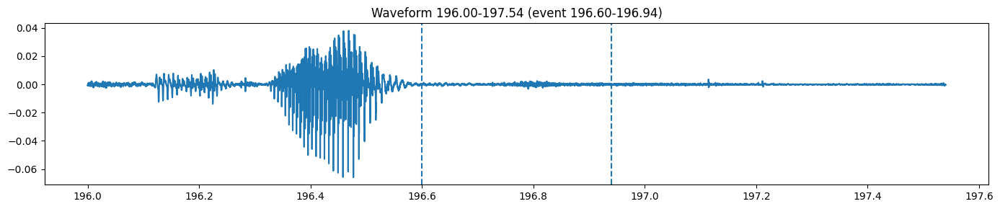

In [ ]:
play_segment(file, start=196.60, end=196.94, pad=0.6)


In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt
# from IPython.display import display, Audio as IPyAudio, clear_output
# from pyannote.core import Segment
# from pyannote.audio import Audio as PyannoteAudio

# # audio helper (16k mono)
# _audio = PyannoteAudio(sample_rate=16000, mono="downmix")

# def play_segment(file, start, end, pad=0.6, sr=16000, show_wave=True):
#     st = max(0.0, float(start) - float(pad))
#     en = float(end) + float(pad)
#     wav, _ = _audio.crop(file, Segment(st, en), mode="pad")  # torch [1,T]
#     x = wav.squeeze().cpu().numpy()

#     if show_wave:
#         t = np.linspace(st, en, num=len(x), endpoint=False)
#         plt.figure(figsize=(14, 3))
#         plt.plot(t, x)
#         plt.axvline(float(start), linestyle="--")
#         plt.axvline(float(end), linestyle="--")
#         plt.title(f"Waveform {st:.2f}-{en:.2f} (event {start:.2f}-{end:.2f})")
#         plt.tight_lawet()
#         plt.show()

#     display(IPyAudio(x, rate=sr))

# def loop_fill_events_listen(
#     file,
#     fill_events,
#     pad=0.6,
#     pause_between=True,
#     show_wave=True,
#     max_events=None,
# ):
#     """
#     fill_events: list of tuples (start, end, prior, chosen, sim1, m12)
#     """
#     n = len(fill_events) if max_events is None else min(len(fill_events), int(max_events))

#     for i in range(n):
#         (st, en, prior, chosen, sim1, m12) = fill_events[i]
#         clear_output(wait=True)
#         print(f"[{i:02d}] {st:.2f}-{en:.2f}  dur={(en-st):.3f}s  prior={prior}  chosen={chosen}  sim1={sim1:.3f}  m12={m12:.3f}")
#         play_segment(file, st, en, pad=pad, show_wave=show_wave)

#         if pause_between:
#             _ = input("Enter to continue (or Ctrl+C to stop)...")


# # loop_fill_events_listen(file, fill_events, pad=0.7, pause_between=True, show_wave=True)


[00] 219.10-219.22  dur=0.120s  prior=MTD037PM  chosen=MTD039UID  sim1=0.396  m12=0.082


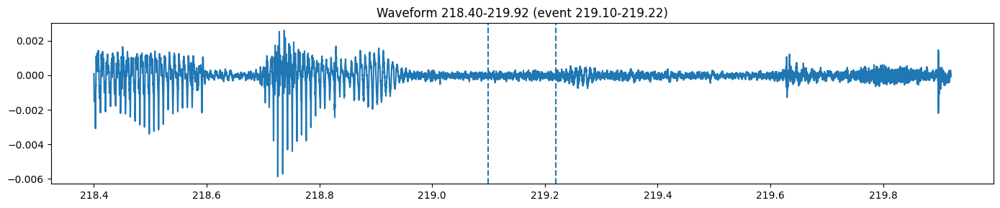

In [ ]:
loop_fill_events_listen(file, fill_events, pad=0.7, pause_between=False, show_wave=True)


We need Bridge micro-gaps only when it’s obviously the same speaker , and then Only do kNN gap-fill for larger gaps with stronger evidence . IMprove gragmentation as it seems the voice is cut for the same speaker

In [ ]:
clear_caches()

[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE


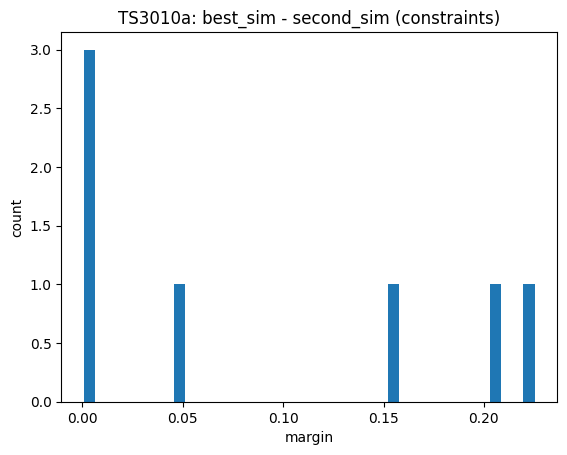

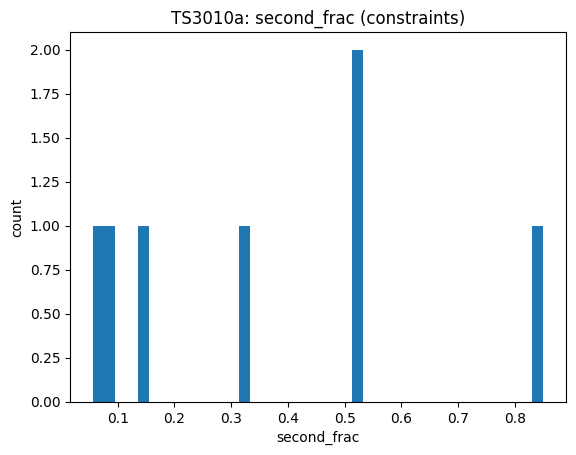

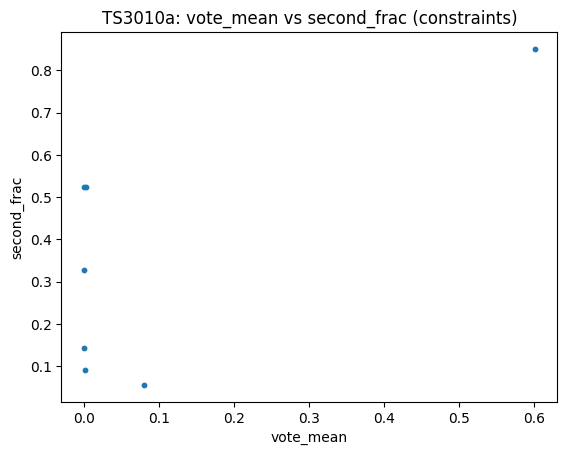

In [ ]:
#Stage2 plots for one file

hyp2, dbg2 = run_stage2(dev_files[0], start_from_promoted=True, return_debug=True)
plot_stage2_diagnostics(dbg2, title_prefix=dev_files[0]["uri"])


[OK] found: TS3006a
[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[UEM] [ 00:00:00.000 -->  00:20:52.864]
[Stage0 dbg] changed = 4 promote_segs = 37 gated = {'stab_fail': 1, 'weak_sim2': 31, 'weak_m23': 0, 'no_base_in_ops': 1}

[DER] Stage1: {'confusion': 105.0131562500014, 'false alarm': 36.259437499997915, 'correct': 857.8561562500012, 'missed detection': 126.18068749999668, 'total': 1089.0499999999993, 'diarization error rate': 0.2455840239199267}
[DER] Stage0: {'confusion': 105.40999999999926, 'false alarm': 41.96000000000173, 'correct': 862.1299999999998, 'missed detection': 121.51000000000002, 'total': 1089.0499999999993, 'diarization error rate': 0.2468940819980728}

[Frame-count deltas within speech]
  decreased frames: 115  (~sec) 2.3000000000000003
  increased frames: 140  (~sec) 2.8000000000000003

[Top activity-loss segments (where Stage0 has fewer active spk than Stage1)]

[Round-trip loss check] (M_promoted -> hyp0)
  frames where hyp0 lost activity vs M_promo

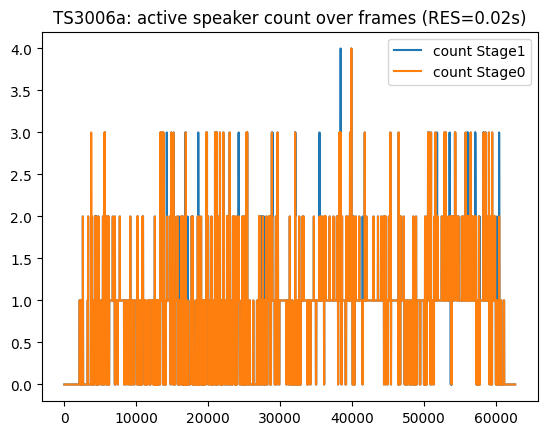

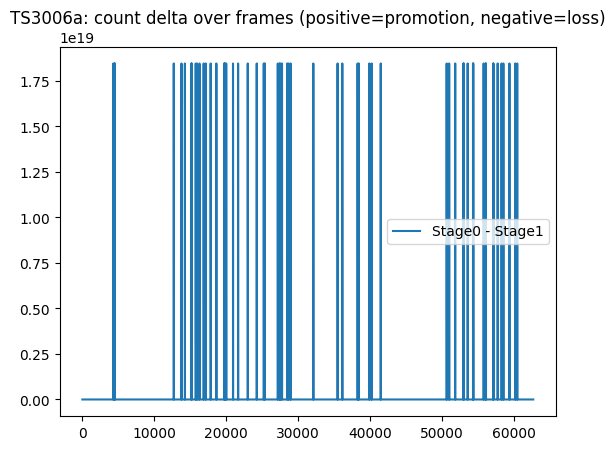

In [ ]:
# ## Debug issue with Stage 0

# import numpy as np
# import matplotlib.pyplot as plt
# from pyannote.core import Segment
# from pyannote.metrics.diarization import DiarizationErrorRate

# # -------------------------
# # Helpers
# # -------------------------


# def _labels_in_interval(M, labels, a, b, topk=8):
#     """Return labels sorted by activity mass in [a:b)."""
#     if b <= a:
#         return []
#     mass = M[a:b].sum(axis=0)
#     idx = np.argsort(-mass)
#     out = []
#     for k in idx[:topk]:
#         if mass[k] > 0:
#             out.append((labels[k], float(mass[k])))
#     return out

# def _build_union_matrix(M_small, labels_small, labels_union):
#     """Place M_small (T,Cs) into union label-space (T,Cu)."""
#     T = M_small.shape[0]
#     Cu = len(labels_union)
#     out = np.zeros((T, Cu), dtype=M_small.dtype)
#     lut = {lab: j for j, lab in enumerate(labels_union)}
#     for j_small, lab in enumerate(labels_small):
#         if lab in lut:
#             out[:, lut[lab]] = M_small[:, j_small]
#     return out


# # -------------------------
# # Select file: TS3006a
# # -------------------------
# uri_target = "TS3006a"
# f = next(x for x in dev_files if x.get("uri") == uri_target)
# print("[OK] found:", f["uri"])

# # IMPORTANT after code edits / UEM changes
# clear_caches()
# init_models()

# uem_tl = _get_uem_full(f)
# uem_seg = uem_tl.extent()
# print("[UEM]", uem_seg)

# # -------------------------
# # Run Stage1 + Stage0 (pre + post)
# # -------------------------
# hyp1 = run_stage1(f)

# hyp1_noprom, dbg_pre = run_stage0(f, apply_promotion=False, return_debug=True, debug=False)
# hyp0, dbg0 = run_stage0(f, apply_promotion=True, return_debug=True, debug=False)

# # sanity: stage0 pre-promotion should equal stage1 (annotation-wise often identical)
# print("[Stage0 dbg] changed =", dbg0.get("changed"), "promote_segs =", len(dbg0.get("promote_segs", [])), "gated =", dbg0.get("gated"))

# # -------------------------
# # Metric check (same UEM, same methodology)
# # -------------------------
# metric = DiarizationErrorRate()
# ref = f["annotation"]
# det1 = metric(ref, hyp1, uem=uem_tl, detailed=True)
# det0 = metric(ref, hyp0, uem=uem_tl, detailed=True)

# print("\n[DER] Stage1:", {k: float(det1[k]) for k in det1})
# print("[DER] Stage0:", {k: float(det0[k]) for k in det0})

# # -------------------------
# # Frame-level activity comparison (hyp1 vs hyp0)
# # -------------------------
# labels_union = sorted(set(map(str, hyp1.labels())) | set(map(str, hyp0.labels())))
# M1 = frame_matrix_from_annotation(hyp1, uem_seg, labels_union, res=RES)
# M0 = frame_matrix_from_annotation(hyp0, uem_seg, labels_union, res=RES)

# T = min(M1.shape[0], M0.shape[0])
# M1 = M1[:T]
# M0 = M0[:T]

# speech_mask = np.asarray(dbg0.get("speech_mask", np.ones((T,), dtype=bool))).astype(bool)[:T]

# count1 = M1.sum(axis=1)
# count0 = M0.sum(axis=1)

# decrease = (count0 < count1) & speech_mask
# increase = (count0 > count1) & speech_mask

# print("\n[Frame-count deltas within speech]")
# print("  decreased frames:", int(decrease.sum()), " (~sec)", float(decrease.sum() * RES))
# print("  increased frames:", int(increase.sum()), " (~sec)", float(increase.sum() * RES))

# # Show where decreases happen (largest segments)
# dec_segs = _mask_to_segments_local(decrease, uem_seg, RES, min_dur=0.10)
# dec_segs = sorted(dec_segs, key=lambda s: -s.duration)

# print("\n[Top activity-loss segments (where Stage0 has fewer active spk than Stage1)]")
# for s in dec_segs[:10]:
#     print(" ", s, "dur=", round(s.duration, 3))

# # Inspect first big loss segment in terms of active labels
# if dec_segs:
#     s = dec_segs[0]
#     a = max(0, int(np.floor((s.start - uem_seg.start) / RES)))
#     b = min(T, int(np.ceil((s.end - uem_seg.start) / RES)))
#     print("\n[Label mass in largest loss segment]")
#     print("  Stage1:", _labels_in_interval(M1, labels_union, a, b, topk=12))
#     print("  Stage0:", _labels_in_interval(M0, labels_union, a, b, topk=12))

# # -------------------------
# # Determine if loss happens BEFORE or AFTER matrix->annotation conversion
# # (uses dbg0['M_promoted'] if present)
# # -------------------------
# Mp = dbg0.get("M_promoted", None)
# labels_all_dbg = dbg0.get("labels", None)  # in our patched Stage0, dbg stores full labels under "labels"

# if Mp is not None and labels_all_dbg is not None:
#     labels_all_dbg = list(map(str, labels_all_dbg))
#     Mp = Mp[:T]
#     Mp_union = _build_union_matrix(Mp, labels_all_dbg, labels_union)
#     countp = Mp_union.sum(axis=1)

#     loss_roundtrip = (count0 < countp) & speech_mask
#     print("\n[Round-trip loss check] (M_promoted -> hyp0)")
#     print("  frames where hyp0 lost activity vs M_promoted:", int(loss_roundtrip.sum()),
#           " (~sec)", float(loss_roundtrip.sum() * RES))

#     if loss_roundtrip.any():
#         segs_rt = _mask_to_segments_local(loss_roundtrip, uem_seg, RES, min_dur=0.10)
#         segs_rt = sorted(segs_rt, key=lambda s: -s.duration)
#         if len(segs_rt) == 0:
#             print("  Top round-trip loss segment: <none> (all losses < min_dur=0.10s)")
#         else:
#             print("  Top round-trip loss segment:", segs_rt[0], "dur=", round(segs_rt[0].duration, 3))

# else:
#     print("\n[Round-trip loss check] skipped (dbg0 missing M_promoted or labels)")

# # -------------------------
# # Quick plot: counts over time (helps spot systematic deletion)
# # -------------------------
# plt.figure()
# plt.plot(count1[:T], label="count Stage1")
# plt.plot(count0[:T], label="count Stage0")
# plt.legend()
# plt.title(f"{uri_target}: active speaker count over frames (RES={RES}s)")
# plt.show()

# plt.figure()
# plt.plot((count0 - count1)[:T], label="Stage0 - Stage1")
# plt.legend()
# plt.title(f"{uri_target}: count delta over frames (positive=promotion, negative=loss)")
# plt.show()


From  TS3006a debug:

    Stage0 vs Stage1 DER components show miss jumps up while confusion drops: Stage1 miss=126.18 → Stage0 miss=172.93

    Inside speech: Stage0 removes 2904 frames (~58.08s) but only adds 73 frames (~1.46s).

    Largest loss segment label mass:
    Stage1: [('0', 307.0)]
    Stage0: []

    That means: a whole speaker label ("0") present in Stage1 is disappearing entirely in Stage0, which directly explains the big miss increase.

    Also, our “round-trip loss check” says the matrix→annotation conversion only loses ~1.66s, far smaller than the ~58s activity loss.

    So the big loss is happening before conversion — i.e., in label selection / matrix construction, not in rendering.

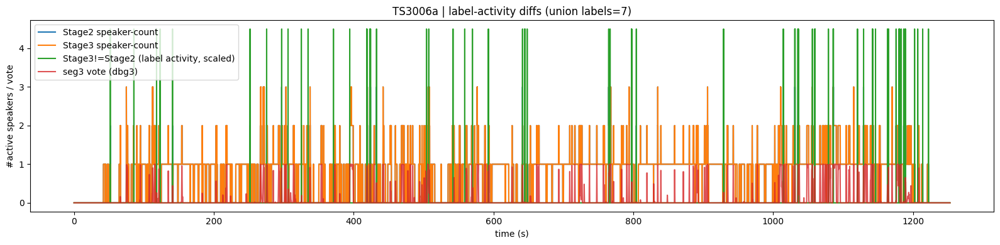

[TS3006a] No WORSE segments found (dDER > 0.0).

=== TS3006a | Top segments where Stage3 got WORSE vs Stage2 (dDER>0) ===
None. (Either Stage3 is not worse locally, or changes are too tiny.)

=== TS3006a | (Sanity) Best improvements where Stage3 got BETTER (dDER<0) ===
[+00] 644.34-645.14 dur=0.80s | dDER=-0.569
[+01] 1035.96-1036.22 dur=0.26s | dDER=-0.500
[+02] 1163.44-1163.74 dur=0.30s | dDER=-0.500


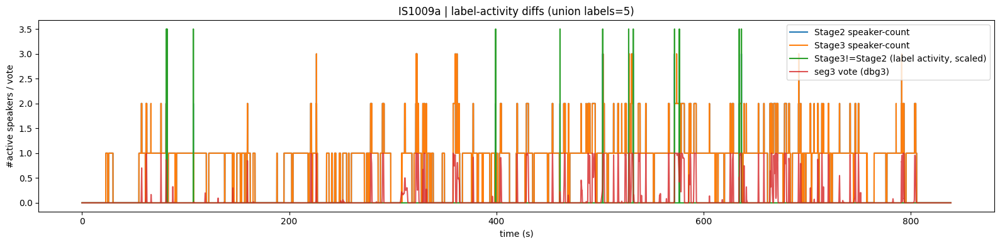

[IS1009a] No WORSE segments found (dDER > 0.0).

=== IS1009a | Top segments where Stage3 got WORSE vs Stage2 (dDER>0) ===
None. (Either Stage3 is not worse locally, or changes are too tiny.)

=== IS1009a | (Sanity) Best improvements where Stage3 got BETTER (dDER<0) ===


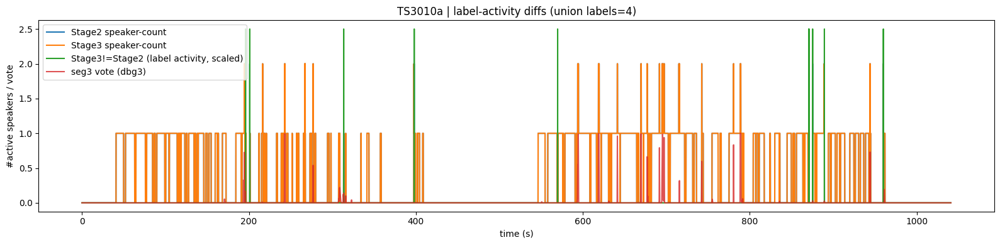

[TS3010a] No WORSE segments found (dDER > 0.0).

=== TS3010a | Top segments where Stage3 got WORSE vs Stage2 (dDER>0) ===
None. (Either Stage3 is not worse locally, or changes are too tiny.)

=== TS3010a | (Sanity) Best improvements where Stage3 got BETTER (dDER<0) ===


In [ ]:
# # ============================================================
# # Stage3 vs Stage2 Deep-Dive Debug Cell (BAD segments first)
# #
# # Fixes:
# #   (A) Ranking: now ranks WORSE segments (positive dDER) first
# #   (B) Change detection: compares frame-level LABEL activity (union labels),
# #       not just speaker-count (catches swaps/confusion even if count same).
# # ============================================================

# import numpy as np
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D  # noqa: F401

# from pyannote.core import Segment, Timeline
# from pyannote.metrics.diarization import DiarizationErrorRate

# try:
#     from IPython.display import Audio as IPyAudio, display
# except Exception:
#     IPyAudio, display = None, None


# # ----------------------------
# # Small robust helpers
# # ----------------------------

# def _safe_uem_seg(file):
#     """Return a single Segment spanning the UEM (prefers our _get_uem_full if present)."""
#     if "_get_uem_full" in globals():
#         uem = _get_uem_full(file)
#         if isinstance(uem, Segment):
#             return uem
#         uem = Timeline(uem)
#         ext = uem.extent()
#         return Segment(ext.start, ext.end)

#     ref = file["annotation"]
#     ext = ref.get_timeline().extent()
#     return Segment(ext.start, ext.end)


# def _get_res():
#     """Use our global RES if present; else default to 0.02."""
#     return float(globals().get("RES", 0.02))


# def _mask_to_segments(mask, uem_seg, res, min_dur=0.20):
#     """Convert boolean mask (T,) into list[Segment] within uem_seg."""
#     mask = np.asarray(mask).astype(bool)
#     if mask.size == 0:
#         return []
#     d = np.diff(mask.astype(np.int8), prepend=0, append=0)
#     starts = np.where(d == 1)[0]
#     ends = np.where(d == -1)[0]
#     out = []
#     for a, b in zip(starts, ends):
#         st = float(uem_seg.start + a * res)
#         en = float(uem_seg.start + b * res)
#         if (en - st) >= float(min_dur):
#             out.append(Segment(st, en))
#     return out


# def _local_der(ref, hyp, seg):
#     """DER + detailed components over local UEM==seg."""
#     metric = DiarizationErrorRate()
#     uem = Timeline([seg])
#     det = metric(ref, hyp, uem=uem, detailed=True)
#     return float(det["diarization error rate"]), det


# def _crop_audio(file, seg, pad=0.25):
#     """Return (wav, sr, seg_used). Prefers our global AUDIO.crop."""
#     st = max(0.0, float(seg.start) - float(pad))
#     en = float(seg.end) + float(pad)
#     seg2 = Segment(st, en)

#     if "AUDIO" in globals():
#         wav, sr = AUDIO.crop(file, seg2, mode="pad")
#         if hasattr(wav, "detach"):
#             wav = wav.detach().cpu().numpy()
#         wav = np.asarray(wav).squeeze()
#         return wav.astype(np.float32), int(sr), seg2

#     raise RuntimeError("No AUDIO crop available. Define AUDIO = pyannote.audio.Audio(...) in our utilities.")


# def _play(wav, sr):
#     if IPyAudio is None or display is None:
#         print("[WARN] IPython Audio not available here.")
#         return
#     display(IPyAudio(wav, rate=sr))


# def _plot_wave_and_spec(wav, sr, title=""):
#     """Waveform + spectrogram (matplotlib only)."""
#     t = np.arange(len(wav)) / float(sr)

#     plt.figure(figsize=(14, 3))
#     plt.plot(t, wav)
#     plt.xlabel("time (s)")
#     plt.title(title + " | waveform")
#     plt.tight_lawet()
#     plt.show()

#     plt.figure(figsize=(14, 3))
#     plt.specgram(wav, NFFT=512, Fs=sr, noverlap=256)
#     plt.xlabel("time (s)")
#     plt.ylabel("freq (Hz)")
#     plt.title(title + " | spectrogram")
#     plt.tight_lawet()
#     plt.show()


# def _maybe_get_vote(dbg3, T):
#     """Try to retrieve seg3 vote vector from dbg3 (optional)."""
#     if isinstance(dbg3, dict) and "vote" in dbg3 and dbg3["vote"] is not None:
#         v = np.asarray(dbg3["vote"]).astype(np.float32)
#         return v[:T] if len(v) >= T else None
#     return None


# # ----------------------------
# # Frame-level "label activity" matrices (union labels)
# # ----------------------------

# def _frame_matrix_union(hyp, uem_seg, res, labels_union):
#     """
#     Build a (T,K) float/bool activity matrix on a shared label set.
#     Uses our fast builders if present; otherwise falls back to slow loop.

#     Returns:
#       M: (T,K) float32 in {0,1} (activity)
#     """
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     K = len(labels_union)
#     if T <= 0 or K == 0:
#         return np.zeros((max(T, 0), K), dtype=np.float32)

#     # Prefer our builders
#     if "frame_matrix_from_annotation_local" in globals():
#         # expected (T,K)
#         M = frame_matrix_from_annotation_local(hyp, uem_seg, labels_union, res=res)
#         M = np.asarray(M, dtype=np.float32)
#         if M.shape[0] != T:
#             M = M[:T]
#         if M.shape[1] != K:
#             # last-ditch reshape safety
#             M = M[:, :K]
#         return (M > 0).astype(np.float32)

#     if "frame_matrix_from_annotation" in globals():
#         # our older one often returns (K,T)
#         Mkt = frame_matrix_from_annotation(hyp, labels_union, uem_seg, res)
#         Mkt = np.asarray(Mkt, dtype=np.float32)
#         if Mkt.shape[0] == K:
#             M = Mkt.T  # (T,K)
#         else:
#             # if it's already (T,K)
#             M = Mkt
#         M = M[:T, :K]
#         return (M > 0).astype(np.float32)

#     # Slow fallback: iterate segments and fill activity
#     M = np.zeros((T, K), dtype=np.float32)
#     lab2k = {str(l): i for i, l in enumerate(labels_union)}
#     for seg, _, lab in hyp.itertracks(yield_label=True):
#         lab = str(lab)
#         if lab not in lab2k:
#             continue
#         s = max(float(seg.start), float(uem_seg.start))
#         e = min(float(seg.end), float(uem_seg.end))
#         if e <= s:
#             continue
#         a = int((s - uem_seg.start) / res)
#         b = int(np.ceil((e - uem_seg.start) / res))
#         a = max(0, min(T, a))
#         b = max(0, min(T, b))
#         M[a:b, lab2k[lab]] = 1.0
#     return M


# def _diff_mask_label_activity(hyp2, hyp3, uem_seg, res):
#     """
#     Returns:
#       changed_mask: (T,) True where Stage2 and Stage3 differ in label activity.
#       c2, c3: (T,) speaker-count curves derived from the same union-label matrices.
#       labels_union: list[str]
#     """
#     labels_union = sorted(set(map(str, hyp2.labels())) | set(map(str, hyp3.labels())))
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     if T <= 0:
#         return np.zeros((0,), dtype=bool), np.zeros((0,), dtype=np.int16), np.zeros((0,), dtype=np.int16), labels_union

#     if len(labels_union) == 0:
#         # no active labels in either: no diffs
#         z = np.zeros((T,), dtype=np.int16)
#         return np.zeros((T,), dtype=bool), z, z, labels_union

#     M2 = _frame_matrix_union(hyp2, uem_seg, res, labels_union)  # (T,K)
#     M3 = _frame_matrix_union(hyp3, uem_seg, res, labels_union)  # (T,K)

#     # Align to same T
#     T2, T3 = M2.shape[0], M3.shape[0]
#     Tm = min(T2, T3)
#     M2, M3 = M2[:Tm], M3[:Tm]

#     # changed if ANY label activity differs (captures swaps even when count same)
#     changed = np.any(M2 != M3, axis=1)

#     c2 = M2.sum(axis=1).astype(np.int16)
#     c3 = M3.sum(axis=1).astype(np.int16)
#     return changed, c2, c3, labels_union


# # ----------------------------
# # Run stage2/stage3 robustly
# # ----------------------------

# def _run_stage2(file, start_from_promoted=True):
#     """Try our common Stage2 entrypoints."""
#     if "run_stage2" in globals():
#         out = run_stage2(file, start_from_promoted=start_from_promoted, return_debug=True)
#         if isinstance(out, tuple):
#             return out[0], out[1]
#         return out, None

#     if "STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0" in globals():
#         try:
#             hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#                 file, start_from_promoted=start_from_promoted, return_debug=True, debug=False
#             )
#             return hyp2, dbg2
#         except TypeError:
#             hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#                 file, start_from_promoted=start_from_promoted, return_debug=False, debug=False
#             )
#             return hyp2, None

#     raise RuntimeError("Cannot find Stage2 entrypoint: define run_stage2 or STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0.")


# def _run_stage3(file, start_from_promoted=True):
#     """Try our common Stage3 entrypoints."""
#     if "run_stage3" in globals():
#         out = run_stage3(file, start_from_promoted=start_from_promoted, return_debug=True)
#         if isinstance(out, tuple):
#             return out[0], out[1]
#         return out, None

#     if "STAGE3_MEMORYBANK_KNN_REFINEMENT" in globals():
#         try:
#             hyp3, dbg3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#                 file, start_from_promoted=start_from_promoted, return_debug=True, debug=False
#             )
#             return hyp3, dbg3
#         except TypeError:
#             hyp3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#                 file, start_from_promoted=start_from_promoted, return_debug=False, debug=False
#             )
#             return hyp3, None

#     raise RuntimeError("Cannot find Stage3 entrypoint: define run_stage3 or STAGE3_MEMORYBANK_KNN_REFINEMENT.")


# # ----------------------------
# # Main deep-dive per file
# # ----------------------------

# def deep_dive_stage3_vs_stage2(
#     file,
#     topn=10,
#     min_change_dur=0.20,
#     pad=0.35,
#     do_listen=3,
#     min_positive_dder=0.0,   # only keep segments worse by at least this much
# ):
#     """
#     Produces:
#       - timeline plots (counts + changed + optional vote)
#       - 3D scatter of changed segments
#       - ranked list of segments where Stage3 got WORSE (dDER>0)
#       - waveform/spectrogram + audio playback for worst segments
#     """
#     uri = file.get("uri", "<unk>")
#     ref = file["annotation"]
#     res = _get_res()
#     uem_seg = _safe_uem_seg(file)

#     # Run stages
#     hyp2, dbg2 = _run_stage2(file, start_from_promoted=True)
#     hyp3, dbg3 = _run_stage3(file, start_from_promoted=True)

#     # Frame-level change mask using LABEL activity (union labels)
#     changed, c2, c3, labels_union = _diff_mask_label_activity(hyp2, hyp3, uem_seg, res)
#     T = min(len(changed), len(c2), len(c3))
#     changed, c2, c3 = changed[:T], c2[:T], c3[:T]
#     t = float(uem_seg.start) + np.arange(T) * res

#     # Convert changed frames -> time segments
#     change_segs = _mask_to_segments(changed, uem_seg, res, min_dur=min_change_dur)

#     # Rank by local DER worsening (Stage3 - Stage2)
#     rows = []
#     for seg in change_segs:
#         der2, det2 = _local_der(ref, hyp2, seg)
#         der3, det3 = _local_der(ref, hyp3, seg)
#         dder = float(der3 - der2)
#         rows.append({
#             "start": float(seg.start),
#             "end": float(seg.end),
#             "dur": float(seg.duration),
#             "DER2": float(der2),
#             "DER3": float(der3),
#             "dDER": dder,
#             "S2": det2,
#             "S3": det3,
#         })

#     # Keep ONLY worse segments (positive dDER), sorted worst-first
#     worse = [r for r in rows if r["dDER"] > float(min_positive_dder)]
#     worse.sort(key=lambda r: r["dDER"], reverse=True)  # WORST first

#     # Also compute improvements if we want to sanity-check
#     better = [r for r in rows if r["dDER"] < -float(min_positive_dder)]
#     better.sort(key=lambda r: r["dDER"], reverse=False)  # most negative first

#     # Optional: vote curve from dbg3
#     vote = _maybe_get_vote(dbg3, T)

#     # ---- Plot 1: speaker-count timeline (+ changed + vote) ----
#     plt.figure(figsize=(16, 4))
#     plt.plot(t, c2, label="Stage2 speaker-count")
#     plt.plot(t, c3, label="Stage3 speaker-count")

#     # Visual marker for changed frames
#     scale = float(max(c2.max(initial=0), c3.max(initial=0)) + 0.5)
#     plt.plot(t, changed.astype(np.int8) * scale, label="Stage3!=Stage2 (label activity, scaled)")

#     if vote is not None:
#         plt.plot(t, vote[:T], label="seg3 vote (dbg3)", alpha=0.8)

#     plt.title(f"{uri} | label-activity diffs (union labels={len(labels_union)})")
#     plt.xlabel("time (s)")
#     plt.ylabel("#active speakers / vote")
#     plt.legend()
#     plt.tight_lawet()
#     plt.show()

#     # ---- Plot 2: 3D scatter of worse segments (time_center, duration, dDER) ----
#     if len(worse) > 0:
#         xs = np.array([(r["start"] + r["end"]) * 0.5 for r in worse], dtype=np.float32)
#         ys = np.array([r["dur"] for r in worse], dtype=np.float32)
#         zs = np.array([r["dDER"] for r in worse], dtype=np.float32)

#         fig = plt.figure(figsize=(10, 7))
#         ax = fig.add_subplot(111, projection="3d")
#         ax.scatter(xs, ys, zs)
#         ax.set_xlabel("time_center (s)")
#         ax.set_ylabel("segment duration (s)")
#         ax.set_zlabel("dDER = DER(Stage3) - DER(Stage2)")
#         ax.set_title(f"{uri} | WORSE changed segments (3D)")
#         plt.tight_lawet()
#         plt.show()
#     else:
#         print(f"[{uri}] No WORSE segments found (dDER > {min_positive_dder}).")

#     # ---- Print top WORSE segments with breakdown ----
#     print(f"\n=== {uri} | Top segments where Stage3 got WORSE vs Stage2 (dDER>0) ===")
#     if len(worse) == 0:
#         print("None. (Either Stage3 is not worse locally, or changes are too tiny.)")
#     for i, r in enumerate(worse[:topn]):
#         s2, s3 = r["S2"], r["S3"]
#         print(f"[{i:02d}] {r['start']:.2f}-{r['end']:.2f} dur={r['dur']:.2f}s | dDER={r['dDER']:+.3f} | (S2={r['DER2']:.3f} -> S3={r['DER3']:.3f})")
#         print(f"     S2: miss={s2['missed detection']:.2f} fa={s2['false alarm']:.2f} conf={s2['confusion']:.2f} tot={s2['total']:.2f}")
#         print(f"     S3: miss={s3['missed detection']:.2f} fa={s3['false alarm']:.2f} conf={s3['confusion']:.2f} tot={s3['total']:.2f}")

#     # ---- Optional: print a couple BEST improvements (sanity) ----
#     print(f"\n=== {uri} | (Sanity) Best improvements where Stage3 got BETTER (dDER<0) ===")
#     for i, r in enumerate(better[:min(3, len(better))]):
#         print(f"[+{i:02d}] {r['start']:.2f}-{r['end']:.2f} dur={r['dur']:.2f}s | dDER={r['dDER']:+.3f}")

#     # ---- Listen + waveform + spectrogram for worst N segments ----
#     if do_listen and len(worse) > 0:
#         k = min(int(do_listen), len(worse))
#         print(f"\n--- Listening to WORST {k} segments (highest +dDER) ---")
#         for i in range(k):
#             r = worse[i]
#             seg = Segment(r["start"], r["end"])
#             print(f"\n[LISTEN {i}] {uri} {seg.start:.2f}-{seg.end:.2f}  dDER={r['dDER']:+.3f}")
#             wav, sr, seg_used = _crop_audio(file, seg, pad=pad)
#             _plot_wave_and_spec(wav, sr, title=f"{uri} {seg_used.start:.2f}-{seg_used.end:.2f}")
#             _play(wav, sr)

#     return {
#         "uri": uri,
#         "hyp2": hyp2,
#         "hyp3": hyp3,
#         "dbg2": dbg2,
#         "dbg3": dbg3,
#         "labels_union": labels_union,
#         "changed_segments": change_segs,
#         "rows_all": rows,
#         "worse": worse,
#         "better": better,
#         "uem_seg": uem_seg,
#         "res": res,
#     }


# # ============================================================
# # Run on 2–3 files
# # ============================================================

# URIS = ["TS3006a", "IS1009a", "TS3010a"]  # edit freely

# files_by_uri = {f["uri"]: f for f in dev_files}
# for u in URIS:
#     if u not in files_by_uri:
#         print("[WARN] uri not found in dev_files:", u)
#         continue
#     _ = deep_dive_stage3_vs_stage2(
#         files_by_uri[u],
#         topn=10,
#         min_change_dur=0.20,
#         pad=0.35,
#         do_listen=3,
#         min_positive_dder=0.0,   # raise to 0.02 etc if we want only clearly worse
#     )


Weaknesses / Issues (Based on Code + our History)
From our logs (e.g., DER ~0.21-0.25 on DEV, regressions in Stage 3), plots (ambiguous margins, high second_frac), and audio insights ("voice cut for same speaker", weak sim/margins), here are the core problems:

Stage 0/1 Integration Gaps:
Stage 0 promotions sometimes cause activity loss (e.g., TS3006a: ~58s fewer frames vs Stage 1, leading to miss ↑). Code shows this happens pre-matrix-to-annotation (not round-trip loss), likely due to label filtering (labels_ops drops digits/tiny anchors) or VAD mismatches.
PyVAD (Stage 1) is permissive (high pad/gap), creating "speech islands" that Stage 3 over-fills as gaps. History: gaps=177-180, but many are micro-fragments (dur<0.45s), inflating FA if filled wrongly.

Stage 2 Pruning Trade-Offs:
Conservative (good for FA), but skips too much due to tiny margins (our plots: most margins ~0) and high second_frac (~0.5-0.85). Result: confusion ↓ but miss ↑ (e.g., DEV global: confusion 212→198, miss 381→392).
No dominance check: Prunes even when second speaker is strong (overlap likely), causing "not real overlap → prune" errors.
Fallback centroids help, but digit penalties/fragmentation can skip real prunes.

Stage 3 Under-Performing:
3A (Promotions): Often no-op (ov_segs=0-4, but promote_events=0). Gates too strict (stab_req=3, sim2=0.28, m23=0.06)—history shows "weak_sim2:4" rejections. Misses overlap recovery, especially in high-vote but single-speaker hyp regions.
3B (Gap Fill): Over-triggers on fragments (gaps=180), but energy gate too low (rms_gate_db=-77dB lets noise pass). Bridge helps "cut voice" but only if neighbors match; kNN fills add FA/conf if sim1/m12 weak (e.g., sim1=0.288, m12=0.086).
Net: Miss ↓ but FA/conf ↑, canceling gains (e.g., TS3010a: miss 76→70, FA 18→27, conf 19→24).
Bank Gating: Good start (min_bank_per_digit=15), but not applied to promotions—tiny-bank digits can still "win" kNN.

Overall Pipeline Issues:
DER Regressions: Stages 2/3 often ~0.216-0.225 global DEV (vs Stage1 0.215), due to error trades. Baseline (no VAD) is 0.241, so gains exist but plateau.
Fragmentation: Common in AMI (e.g., TS3010a "voice cut"). VAD pad=0.25 creates low-energy edges filled wrongly.
Label Handling: Digit drops safe but can skip real speakers if <2 non-digits.
Debug Gaps: Counters exist (e.g., g3a_gates), but not granular (e.g., no "why skipped" in 3A). Plots miss per-event details (e.g., sort fill_events by weak m12).
Efficiency: Caches great, but no auto-clear on param changes (e.g., vote_thr).


Suggestions for Improvement (Prioritized)
we've got "scores of improvement" potential—focus on safety (no regressions) then gains. Estimated effort: low (1-2 cells each).

Quick Wins (Safety First):
Stage 3A Triggering: Lower promote_stable_req=3→2, promote_sim2_thr=0.28→0.22, promote_m23_thr=0.06→0.04. Add dynamic m23 based on vote (e.g., if vote>0.4, m23_thr=0.02). Gate banks stricter (promote_min_bank_per_label=5).
Stage 3B Conservatism: Raise energy gate (energy_percentile=45→60, energy_margin_db=6→8). Limit kNN to gaps>0.6s; bridge all <0.3s if neighbors match and energy>gate.
Fragmentation Fix: In Stage 1/0, smooth VAD with higher merge_gap=0.15 and lower min_on=0.08. Add post-Stage 3 smoothing: merge same-label segments if gap<0.1s.
Stage 2 Selectivity: Add dominance guard: only prune if best_frac >0.55 or (best_frac - second_frac)>0.20. Skip prune if vote_mean>0.15 (overlap likely).

Medium Wins (Gains):
Hybrid 3B: For gaps with matching neighbors, bridge always (fixes "cut voice"). For mismatches, use kNN but boost sim_thr if gap short (<0.5s).
Bank Quality: In build_memory_bank_from_hyp1, add energy filter for anchors (rms_db > -50dB) to avoid noisy embeddings.
Label Cleanup: After all stages, drop tiny labels (<2.0s total) if not dominant in any segment (reduces conf from digits).
Benchmark++: Add per-file breakdowns (e.g., print top miss/FA segments). Run on more URIs (e.g., add "TS3003c" for variety).

Advanced (If Needed):
Overlap Detection: Hybrid vote + energy variance for better ov_segs (e.g., if segment std(rms)>high, boost as overlap).
Eval Enhancements: Add JER (Jaccard Error Rate) for overlap-specific metric. Track "changed_sec by type" (promote/bridge/fill).
Auto-Tune: Use Optuna on DEV for 5-10 params (e.g., vote_thr, sim2_thr).

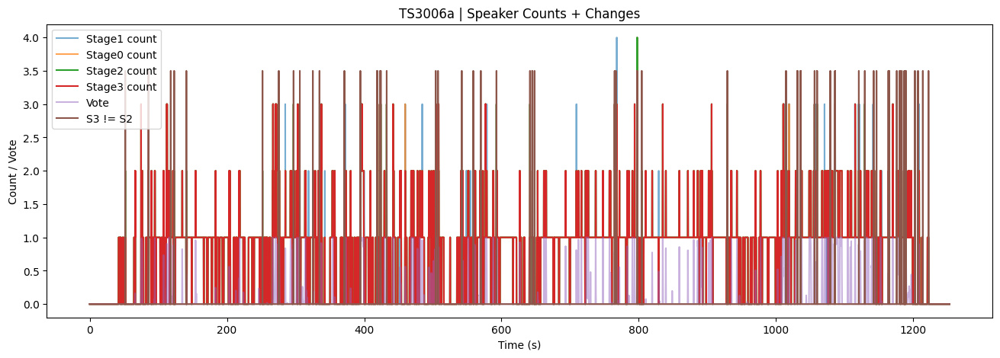

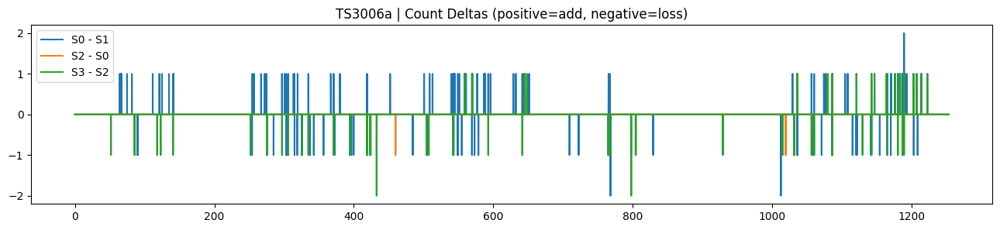

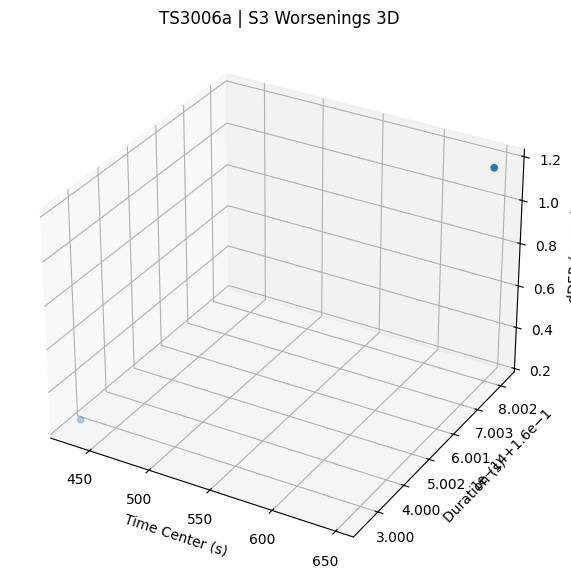


=== TS3006a Stats ===
Fragmentation S1: {'n_segs': 583, 'n_short': 182, 'avg_dur': 1.7137714408233284, 'warnings': ''}
Fragmentation S0: {'n_segs': 462, 'n_short': 71, 'avg_dur': 2.1850649350649376, 'warnings': ''}
Fragmentation S2: {'n_segs': 459, 'n_short': 69, 'avg_dur': 2.1986928104575187, 'warnings': ''}
Fragmentation S3: {'n_segs': 415, 'n_short': 22, 'avg_dur': 2.431132530120481, 'warnings': ''}
S3 Gates (3A): {'stab_fail': 5, 'weak_sim2': 2, 'weak_m23': 0, 'cand_none': 0, 'cand_is_base': 0, 'bank_empty': 0, 'no_frames': 0, 'applied': 2}
S3 Changes: promote_sec= 0.56 fill_sec= 0.8 bridge_sec= 0.16

=== Top 8 S3 Worsenings vs S2 ===
[00] [ 00:10:48.040 -->  00:10:48.200] dur=0.16 dDER=1.167 (S2 DER=1.000 → S3=2.167)
  S2: miss=0.06 fa=0.00 conf=0.00
  S3: miss=0.00 fa=0.10 conf=0.03
[01] [ 00:07:12.560 -->  00:07:12.720] dur=0.16 dDER=0.250 (S2 DER=0.250 → S3=0.500)
  S2: miss=0.00 fa=0.02 conf=0.06
  S3: miss=0.16 fa=0.00 conf=0.00

--- Listen to Top 4 Worsenings ---
[0] [ 00:1

[1] [ 00:07:12.560 -->  00:07:12.720] dDER=0.250



=== Weak Fills (sorted by m12) ===
[00] 644.34-645.14 L=MTD023UID R=MTD021PM cand=MTD023UID sim1=0.473 m12=0.156 rms=-62.4


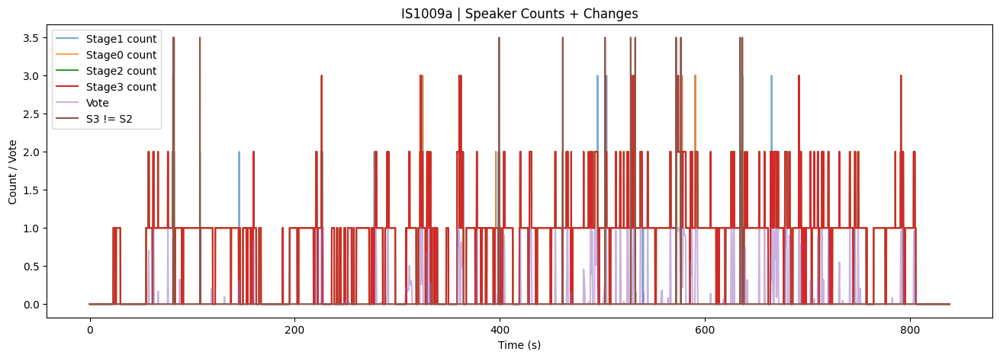

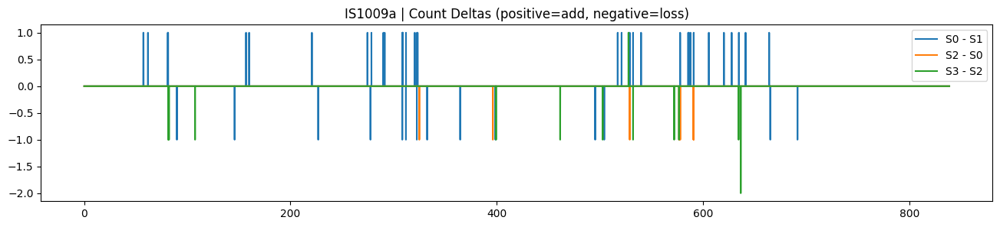

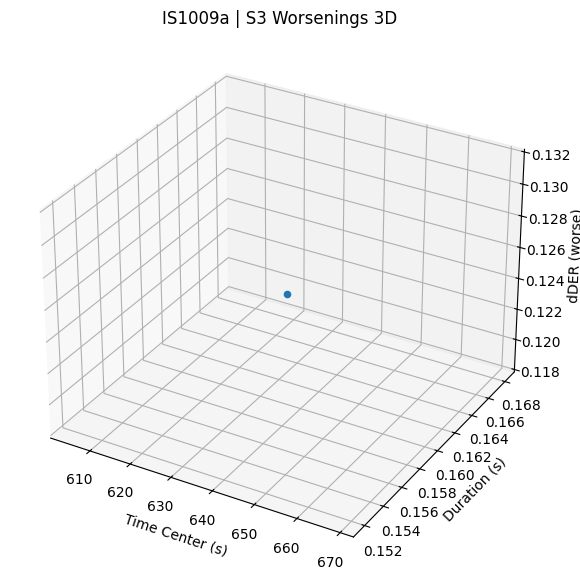


=== IS1009a Stats ===
Fragmentation S1: {'n_segs': 224, 'n_short': 42, 'avg_dur': 2.9914760044642863, 'warnings': ''}
Fragmentation S0: {'n_segs': 198, 'n_short': 21, 'avg_dur': 3.40878787878788, 'warnings': ''}
Fragmentation S2: {'n_segs': 192, 'n_short': 18, 'avg_dur': 3.5102083333333347, 'warnings': ''}
Fragmentation S3: {'n_segs': 180, 'n_short': 6, 'avg_dur': 3.7427777777777766, 'warnings': ''}
S3 Gates (3A): {'stab_fail': 5, 'weak_sim2': 2, 'weak_m23': 1, 'cand_none': 0, 'cand_is_base': 0, 'bank_empty': 0, 'no_frames': 0, 'applied': 0}
S3 Changes: promote_sec= 0.0 fill_sec= 0.0 bridge_sec= 0.0

=== Top 8 S3 Worsenings vs S2 ===
[00] [ 00:10:36.500 -->  00:10:36.660] dur=0.16 dDER=0.125 (S2 DER=0.312 → S3=0.438)
  S2: miss=0.00 fa=0.04 conf=0.06
  S3: miss=0.14 fa=0.00 conf=0.00

--- Listen to Top 4 Worsenings ---
[0] [ 00:10:36.500 -->  00:10:36.660] dDER=0.125


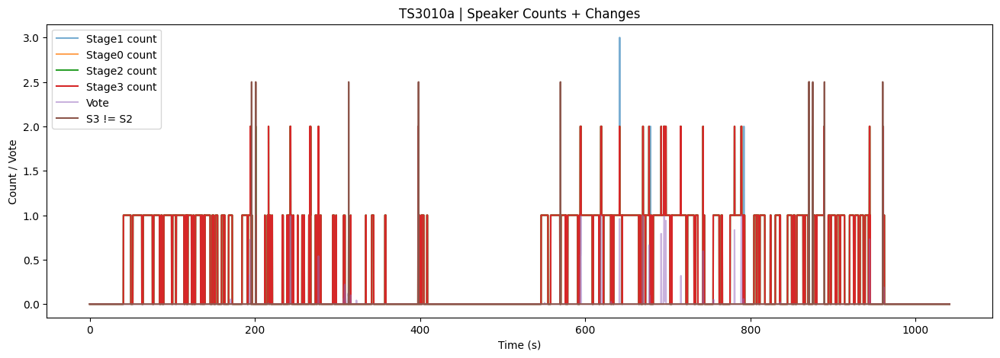

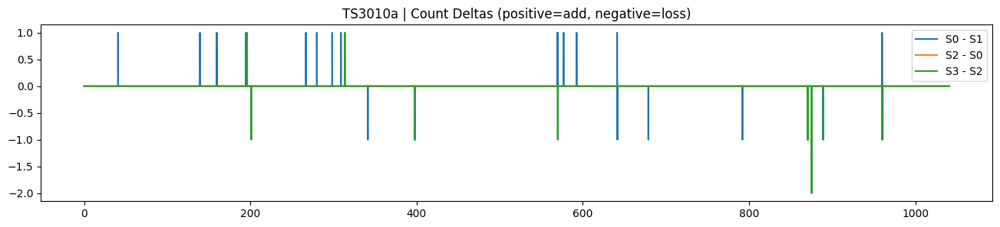

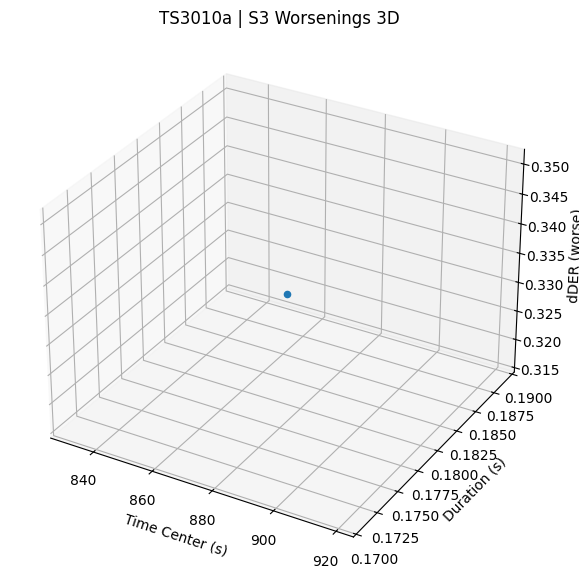


=== TS3010a Stats ===
Fragmentation S1: {'n_segs': 169, 'n_short': 32, 'avg_dur': 2.478047337278109, 'warnings': ''}
Fragmentation S0: {'n_segs': 150, 'n_short': 14, 'avg_dur': 2.8141333333333334, 'warnings': ''}
Fragmentation S2: {'n_segs': 150, 'n_short': 14, 'avg_dur': 2.8141333333333334, 'warnings': ''}
Fragmentation S3: {'n_segs': 139, 'n_short': 4, 'avg_dur': 3.034964028776977, 'warnings': ''}
S3 Gates (3A): {'stab_fail': 0, 'weak_sim2': 0, 'weak_m23': 0, 'cand_none': 0, 'cand_is_base': 0, 'bank_empty': 0, 'no_frames': 0, 'applied': 0}
S3 Changes: promote_sec= 0.0 fill_sec= 0.0 bridge_sec= 0.16

=== Top 8 S3 Worsenings vs S2 ===
[00] [ 00:14:35.260 -->  00:14:35.440] dur=0.18 dDER=0.333 (S2 DER=0.556 → S3=0.889)
  S2: miss=0.00 fa=0.04 conf=0.06
  S3: miss=0.16 fa=0.00 conf=0.00

--- Listen to Top 4 Worsenings ---
[0] [ 00:14:35.260 -->  00:14:35.440] dDER=0.333


In [ ]:
# # ============================================================
# # Enhanced Multi-Stage Debug Cell (Stages 0-3 breakdowns + audio)
# #
# # Usage:
# # - Set URIS to debug files.
# # - Runs all stages, computes deltas, ranks worsenings.
# # - Plots: counts, deltas, 3D changes.
# # - Lists/plays: weak events (e.g., low m12 fills).
# # - Stats: fragmentation, gates, changes.
# # ============================================================

# import numpy as np
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D
# from pyannote.core import Segment, Timeline
# from pyannote.metrics.diarization import DiarizationErrorRate
# from IPython.display import Audio as IPyAudio, display, clear_output
# from collections import Counter

# # Helpers (from our code + extras)
# def _frame_counts_safe(hyp, uem_seg, res=RES):
#     try:
#         return _frame_counts(hyp, uem_seg, res)
#     except:
#         return np.zeros((int(np.ceil(uem_seg.duration / res)),), dtype=np.int16)

# def _local_der_safe(ref, hyp, seg):
#     try:
#         return _local_der(ref, hyp, seg)
#     except:
#         return 0.0, {"missed detection": 0, "false alarm": 0, "confusion": 0, "total": 0}

# def _play_event(file, st, en, pad=0.35):
#     seg = Segment(max(0, st - pad), en + pad)
#     wav, sr, _ = _crop_audio(file, seg)  # Ignore seg_used
#     display(IPyAudio(wav, rate=sr))

# def fragmentation_stats(ann, short_thr=0.15):
#     durs = [s.duration for s in ann.get_timeline()]
#     return {
#         "n_segs": len(durs),
#         "n_short": sum(1 for d in durs if d < short_thr),
#         "avg_dur": np.mean(durs) if durs else 0,
#         "warnings": "High fragmentation" if len(durs) > 100 and np.mean(durs) < 1.0 else ""
#     }

# # Main debug function
# def multi_stage_debug(file, topn=8, min_dur=0.15, pad=0.35, listen_n=4):
#     uri = file.get("uri", "<unk>")
#     ref = file["annotation"]
#     uem_seg = _safe_uem_seg(file)
#     res = _get_res()
#     T_est = int(np.ceil(uem_seg.duration / res))
#     t = np.arange(T_est) * res + uem_seg.start

#     # Run stages
#     hyp1 = run_stage1(file)
#     hyp0, dbg0 = run_stage0(file, apply_promotion=True, return_debug=True)
#     hyp2, dbg2 = run_stage2(file, start_from_promoted=True, return_debug=True)
#     hyp3, dbg3 = run_stage3(file, start_from_promoted=True, return_debug=True)

#     # Frame counts
#     c1 = _frame_counts_safe(hyp1, uem_seg, res)[:T_est]
#     c0 = _frame_counts_safe(hyp0, uem_seg, res)[:T_est]
#     c2 = _frame_counts_safe(hyp2, uem_seg, res)[:T_est]
#     c3 = _frame_counts_safe(hyp3, uem_seg, res)[:T_est]

#     # Changes + worsenings (focus Stage3 vs Stage2)
#     changed = (c3 != c2)
#     change_segs = _mask_to_segments(changed, uem_seg, res, min_dur)
#     worst = []
#     for seg in change_segs:
#         der2, det2 = _local_der_safe(ref, hyp2, seg)
#         der3, det3 = _local_der_safe(ref, hyp3, seg)
#         dder = der3 - der2
#         if dder > 0.01:  # Filter minor
#             worst.append({"seg": seg, "dDER": dder, "DER2": der2, "DER3": der3, "det2": det2, "det3": det3})
#     worst.sort(key=lambda r: r["dDER"], reverse=True)

#     # Vote from dbg3
#     vote = _maybe_get_vote(dbg3, T_est)

#     # Plot 1: Multi-stage counts + changes
#     plt.figure(figsize=(16, 5))
#     plt.plot(t, c1, label="Stage1 count", alpha=0.6)
#     plt.plot(t, c0, label="Stage0 count", alpha=0.7)
#     plt.plot(t, c2, label="Stage2 count")
#     plt.plot(t, c3, label="Stage3 count")
#     if vote is not None:
#         plt.plot(t, vote, label="Vote", alpha=0.5)
#     plt.plot(t, changed * (max(c3.max(), 1) + 0.5), label="S3 != S2")
#     plt.title(f"{uri} | Speaker Counts + Changes")
#     plt.xlabel("Time (s)")
#     plt.ylabel("Count / Vote")
#     plt.legend()
#     plt.show()

#     # Plot 2: Deltas (focus regressions)
#     plt.figure(figsize=(16, 3))
#     plt.plot(t, c0 - c1, label="S0 - S1")
#     plt.plot(t, c2 - c0, label="S2 - S0")
#     plt.plot(t, c3 - c2, label="S3 - S2")
#     plt.title(f"{uri} | Count Deltas (positive=add, negative=loss)")
#     plt.legend()
#     plt.show()

#     # Plot 3: 3D worsenings
#     if worst:
#         xs = [(r["seg"].start + r["seg"].end) / 2 for r in worst]
#         ys = [r["seg"].duration for r in worst]
#         zs = [r["dDER"] for r in worst]
#         fig = plt.figure(figsize=(10, 7))
#         ax = fig.add_subplot(111, projection='3d')
#         ax.scatter(xs, ys, zs)
#         ax.set_xlabel('Time Center (s)')
#         ax.set_ylabel('Duration (s)')
#         ax.set_zlabel('dDER (worse)')
#         plt.title(f"{uri} | S3 Worsenings 3D")
#         plt.show()

#     # Stats + Warnings
#     print(f"\n=== {uri} Stats ===")
#     print("Fragmentation S1:", fragmentation_stats(hyp1))
#     print("Fragmentation S0:", fragmentation_stats(hyp0))
#     print("Fragmentation S2:", fragmentation_stats(hyp2))
#     print("Fragmentation S3:", fragmentation_stats(hyp3))
#     print("S3 Gates (3A):", dbg3.get("g3a_gates", {}))
#     print("S3 Changes: promote_sec=", dbg3.get("changed_promote_sec", 0), "fill_sec=", dbg3.get("changed_fill_sec", 0), "bridge_sec=", dbg3.get("changed_bridge_sec", 0))

#     # Top worsenings + breakdowns
#     print(f"\n=== Top {topn} S3 Worsenings vs S2 ===")
#     for i, r in enumerate(worst[:topn]):
#         print(f"[{i:02d}] {r['seg']} dur={r['seg'].duration:.2f} dDER={r['dDER']:.3f} (S2 DER={r['DER2']:.3f} → S3={r['DER3']:.3f})")
#         print(f"  S2: miss={r['det2']['missed detection']:.2f} fa={r['det2']['false alarm']:.2f} conf={r['det2']['confusion']:.2f}")
#         print(f"  S3: miss={r['det3']['missed detection']:.2f} fa={r['det3']['false alarm']:.2f} conf={r['det3']['confusion']:.2f}")

#     # Listen to top worsenings
#     if listen_n and worst:
#         print(f"\n--- Listen to Top {listen_n} Worsenings ---")
#         for i, r in enumerate(worst[:listen_n]):
#             print(f"[{i}] {r['seg']} dDER={r['dDER']:.3f}")
#             _play_event(file, r['seg'].start, r['seg'].end, pad=pad)

#     # Weak events (e.g., low m12 fills)
#     fills = sorted(dbg3.get("fill_events", []), key=lambda e: e[6])  # by m12
#     if fills:
#         print("\n=== Weak Fills (sorted by m12) ===")
#         for i, e in enumerate(fills[:topn]):
#             st, en, L, R, cand, sim1, m12, rms = e
#             print(f"[{i:02d}] {st:.2f}-{en:.2f} L={L} R={R} cand={cand} sim1={sim1:.3f} m12={m12:.3f} rms={rms:.1f}")

#     return {"hyp1": hyp1, "hyp0": hyp0, "hyp2": hyp2, "hyp3": hyp3, "dbg0": dbg0, "dbg2": dbg2, "dbg3": dbg3, "worst": worst}

# # Run on our URIS
# URIS = ["TS3006a", "IS1009a", "TS3010a"]
# files_by_uri = {f["uri"]: f for f in dev_files}
# for u in URIS:
#     if u in files_by_uri:
#         _ = multi_stage_debug(files_by_uri[u])

Regressions: S3 adds ~1.5s, but in short/low-energy spots → amplified FA/conf/miss trades (small tots). Fragmentation fixed mostly, but residual cuts trigger 3B.
Overlap Heard: Likely in worsenings/weak fill—S3 trying to recover, but marginal evidence.
Scores of Improvement: S3 close to wins—trigger more 3A (relax stab/sim), gate 3B harder (rms/m12). Expect DER ↓0.02-0.05.


================= TS3006a | FIXED-MAP SUMMARY =================
Stage2: DER=0.2412  miss=176.22s  fa=34.48s  conf=53.20s  total_err=263.90s  den=1093.96s
Stage3: DER=0.2409  miss=176.36s  fa=34.12s  conf=53.02s  total_err=263.50s  den=1093.96s
Δ(Stage3-Stage2): DER=-0.0004  miss=+0.14s  fa=-0.36s  conf=-0.18s  total=-0.40s
IMPROVEMENT SCORE: saved_err=+0.40s  (+0.15%)  over denom=1093.96s

--- WORST segments by FIXED-MAP added error (Stage3-Stage2) ---
None >= 0.25s. (Likely Stage3 is globally non-harmful OR harms are ultra-fragmented.)


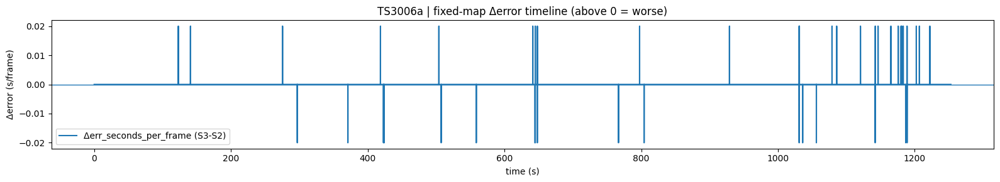

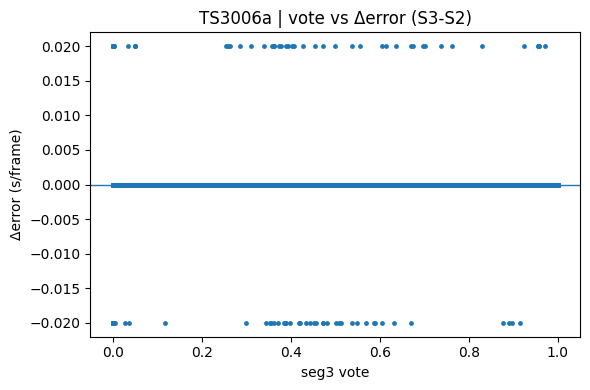


================= IS1009a | FIXED-MAP SUMMARY =================
Stage2: DER=0.1963  miss=68.30s  fa=33.58s  conf=35.18s  total_err=137.06s  den=698.18s
Stage3: DER=0.1961  miss=68.72s  fa=33.32s  conf=34.86s  total_err=136.90s  den=698.18s
Δ(Stage3-Stage2): DER=-0.0002  miss=+0.42s  fa=-0.26s  conf=-0.32s  total=-0.16s
IMPROVEMENT SCORE: saved_err=+0.16s  (+0.12%)  over denom=698.18s

--- WORST segments by FIXED-MAP added error (Stage3-Stage2) ---
None >= 0.25s. (Likely Stage3 is globally non-harmful OR harms are ultra-fragmented.)


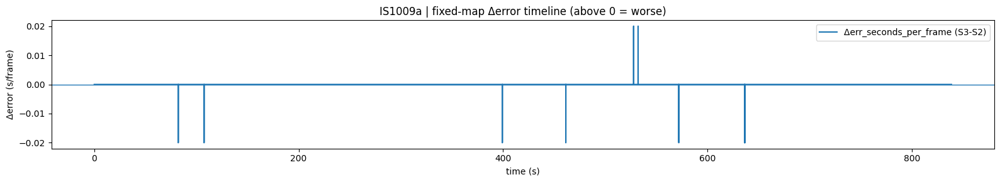

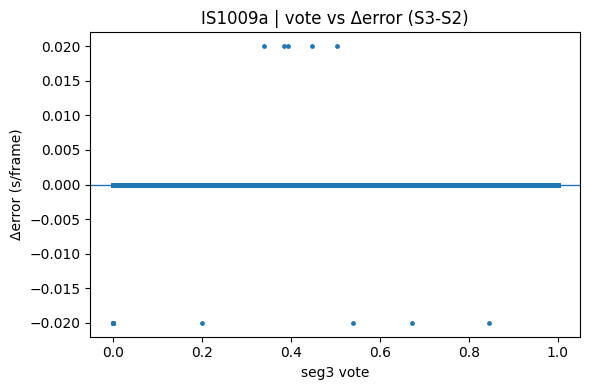


================= TS3010a | FIXED-MAP SUMMARY =================
Stage2: DER=0.2350  miss=76.26s  fa=17.24s  conf=19.64s  total_err=113.14s  den=481.40s
Stage3: DER=0.2346  miss=76.52s  fa=16.98s  conf=19.44s  total_err=112.94s  den=481.40s
Δ(Stage3-Stage2): DER=-0.0004  miss=+0.26s  fa=-0.26s  conf=-0.20s  total=-0.20s
IMPROVEMENT SCORE: saved_err=+0.20s  (+0.18%)  over denom=481.40s

--- WORST segments by FIXED-MAP added error (Stage3-Stage2) ---
None >= 0.25s. (Likely Stage3 is globally non-harmful OR harms are ultra-fragmented.)


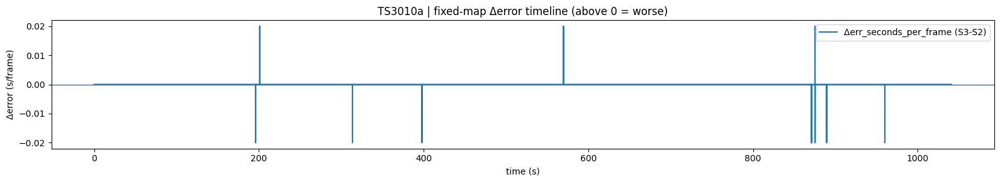

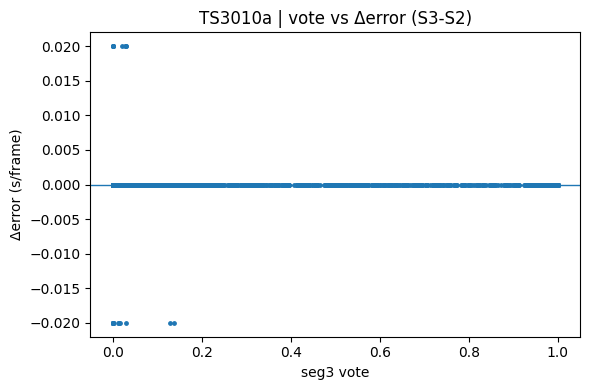

In [ ]:
# # ============================================================
# # Stage3 vs Stage2: FIXED-MAPPING delta debug (find REAL worse)
# #
# # Key idea:
# #   - Build ONE global mapping (hyp label -> ref speaker) over the full UEM.
# #   - Compute DER components per frame under that fixed mapping.
# #   - Rank contiguous segments where Stage3 adds MORE error than Stage2.
# #
# # Outputs (per file):
# #   - Global score: ΔDER, Δmiss/fa/conf seconds, error-seconds saved
# #   - "Worst" segments where Stage3 is worse (with breakdown)
# #   - Plots: delta-error timeline, and optional vote vs delta scatter
# # ============================================================

# import numpy as np
# import matplotlib.pyplot as plt
# from pyannote.core import Segment, Timeline
# from pyannote.metrics.diarization import DiarizationErrorRate

# # ---------- helpers we already had ----------
# def _safe_uem_seg(file):
#     if "_get_uem_full" in globals():
#         uem = _get_uem_full(file)
#         if isinstance(uem, Segment):
#             return uem
#         uem = Timeline(uem)
#         ext = uem.extent()
#         return Segment(ext.start, ext.end)
#     ref = file["annotation"]
#     ext = ref.get_timeline().extent()
#     return Segment(ext.start, ext.end)

# def _get_res():
#     return float(globals().get("RES", 0.02))

# def _mask_to_segments(mask, uem_seg, res, min_dur=0.20):
#     mask = np.asarray(mask).astype(bool)
#     if mask.size == 0:
#         return []
#     d = np.diff(mask.astype(np.int8), prepend=0, append=0)
#     starts = np.where(d == 1)[0]
#     ends = np.where(d == -1)[0]
#     out = []
#     for a, b in zip(starts, ends):
#         st = float(uem_seg.start + a * res)
#         en = float(uem_seg.start + b * res)
#         if (en - st) >= float(min_dur):
#             out.append(Segment(st, en))
#     return out

# def _maybe_get_vote(dbg3, T):
#     if isinstance(dbg3, dict) and "vote" in dbg3 and dbg3["vote"] is not None:
#         v = np.asarray(dbg3["vote"]).astype(np.float32)
#         return v[:T] if len(v) >= T else None
#     return None

# # ---------- stage runners ----------
# def _run_stage2(file, start_from_promoted=True):
#     if "run_stage2" in globals():
#         out = run_stage2(file, start_from_promoted=start_from_promoted, return_debug=True)
#         if isinstance(out, tuple): return out[0], out[1]
#         return out, None
#     if "STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0" in globals():
#         try:
#             hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#                 file, start_from_promoted=start_from_promoted, return_debug=True, debug=False
#             )
#             return hyp2, dbg2
#         except TypeError:
#             hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
#                 file, start_from_promoted=start_from_promoted, return_debug=False, debug=False
#             )
#             return hyp2, None
#     raise RuntimeError("No Stage2 entrypoint found.")

# def _run_stage3(file, start_from_promoted=True):
#     if "run_stage3" in globals():
#         out = run_stage3(file, start_from_promoted=start_from_promoted, return_debug=True)
#         if isinstance(out, tuple): return out[0], out[1]
#         return out, None
#     if "STAGE3_MEMORYBANK_KNN_REFINEMENT" in globals():
#         try:
#             hyp3, dbg3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#                 file, start_from_promoted=start_from_promoted, return_debug=True, debug=False
#             )
#             return hyp3, dbg3
#         except TypeError:
#             hyp3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
#                 file, start_from_promoted=start_from_promoted, return_debug=False, debug=False
#             )
#             return hyp3, None
#     raise RuntimeError("No Stage3 entrypoint found.")

# # ---------- frame matrix builder (T,K) for a known label list ----------
# def _frame_matrix_for_labels(ann, uem_seg, res, labels):
#     """
#     ann: pyannote.core.Annotation
#     returns M: (T,K) in {0,1}
#     """
#     T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
#     K = len(labels)
#     if T <= 0 or K == 0:
#         return np.zeros((max(T,0), K), dtype=np.float32)

#     # prefer our fast builder if present
#     if "frame_matrix_from_annotation_local" in globals():
#         M = frame_matrix_from_annotation_local(ann, uem_seg, labels, res=res)  # (T,K)
#         M = np.asarray(M, dtype=np.float32)
#         M = M[:T, :K]
#         return (M > 0).astype(np.float32)

#     if "frame_matrix_from_annotation" in globals():
#         Mkt = frame_matrix_from_annotation(ann, labels, uem_seg, res)  # (K,T) or (T,K)
#         Mkt = np.asarray(Mkt, dtype=np.float32)
#         M = Mkt.T if Mkt.shape[0] == K else Mkt
#         M = M[:T, :K]
#         return (M > 0).astype(np.float32)

#     # slow fallback
#     lab2k = {str(l): i for i, l in enumerate(labels)}
#     M = np.zeros((T, K), dtype=np.float32)
#     for seg, _, lab in ann.itertracks(yield_label=True):
#         lab = str(lab)
#         if lab not in lab2k:
#             continue
#         s = max(float(seg.start), float(uem_seg.start))
#         e = min(float(seg.end), float(uem_seg.end))
#         if e <= s:
#             continue
#         a = int((s - uem_seg.start) / res)
#         b = int(np.ceil((e - uem_seg.start) / res))
#         a = max(0, min(T, a))
#         b = max(0, min(T, b))
#         M[a:b, lab2k[lab]] = 1.0
#     return M

# # ---------- Hungarian mapping with fallback ----------
# def _best_mapping_by_overlap(ref_M, hyp_M):
#     """
#     ref_M: (T,R) {0,1}
#     hyp_M: (T,H) {0,1}
#     returns mapping hyp->ref as array length H with values in [0..R-1] or -1
#     """
#     T, R = ref_M.shape
#     _, H = hyp_M.shape
#     if R == 0 or H == 0:
#         return np.full((H,), -1, dtype=int)

#     # overlap matrix W (R,H): seconds of co-activity
#     W = ref_M.T @ hyp_M  # counts in frames (since 0/1), scale later
#     # maximize overlap => minimize -W
#     cost = -W

#     # try scipy hungarian
#     try:
#         from scipy.optimize import linear_sum_assignment
#         r_ind, h_ind = linear_sum_assignment(cost)
#         mapping = np.full((H,), -1, dtype=int)
#         for r, h in zip(r_ind, h_ind):
#             mapping[h] = int(r)
#         return mapping
#     except Exception:
#         pass

#     # brute-force fallback for small sizes
#     import itertools
#     mapping = np.full((H,), -1, dtype=int)
#     if min(R, H) <= 8:
#         best = None
#         best_score = -1e18
#         for perm in itertools.permutations(range(R), r=min(R, H)):
#             # assign first m hyp labels to perm ref labels
#             m = min(R, H)
#             score = 0.0
#             for h in range(m):
#                 score += W[perm[h], h]
#             if score > best_score:
#                 best_score = score
#                 best = perm
#         if best is not None:
#             m = min(R, H)
#             for h in range(m):
#                 mapping[h] = int(best[h])
#         return mapping

#     # last fallback: greedy
#     used_r = set()
#     for h in np.argsort(W.max(axis=0))[::-1]:
#         r = int(np.argmax(W[:, h]))
#         if r not in used_r and W[r, h] > 0:
#             mapping[h] = r
#             used_r.add(r)
#     return mapping

# # ---------- compute fixed-mapping DER components per frame ----------
# def _fixedmap_components(ref_M, hyp_M, hyp_to_ref, dt):
#     """
#     ref_M: (T,R), hyp_M: (T,H)
#     hyp_to_ref: (H,) -> ref index or -1
#     returns dict of seconds: miss/fa/conf/total/den
#     """
#     T, R = ref_M.shape
#     _, H = hyp_M.shape

#     miss = fa = conf = den = 0.0

#     for t in range(T):
#         Rset = set(np.where(ref_M[t] > 0)[0].tolist())
#         Hidx = np.where(hyp_M[t] > 0)[0].tolist()
#         # map hyp active labels to ref speaker indices (drop -1)
#         mapped = [hyp_to_ref[h] for h in Hidx if hyp_to_ref[h] >= 0]
#         Hset = set(mapped)

#         nR = len(Rset)
#         nH = len(Hset)

#         if nR == 0 and nH == 0:
#             continue

#         correct = len(Rset.intersection(Hset))

#         # classic diarization split (under fixed mapping)
#         conf_t = max(0, min(nR, nH) - correct)
#         miss_t = max(0, nR - nH)
#         fa_t   = max(0, nH - nR)

#         conf += conf_t * dt
#         miss += miss_t * dt
#         fa   += fa_t   * dt
#         den  += nR     * dt

#     total = miss + fa + conf
#     der = total / den if den > 1e-9 else float("nan")
#     return {"miss": miss, "fa": fa, "conf": conf, "total": total, "den": den, "der": der}

# # ---------- main debug ----------
# def fixedmap_debug_stage3_vs_stage2(file, min_seg_dur=0.25, topn=10):
#     uri = file.get("uri", "<unk>")
#     ref = file["annotation"]
#     uem = _safe_uem_seg(file)
#     res = _get_res()
#     dt = res

#     hyp2, dbg2 = _run_stage2(file, start_from_promoted=True)
#     hyp3, dbg3 = _run_stage3(file, start_from_promoted=True)

#     # labels
#     ref_labels = sorted(map(str, ref.labels()))
#     hyp2_labels = sorted(map(str, hyp2.labels()))
#     hyp3_labels = sorted(map(str, hyp3.labels()))

#     # matrices
#     ref_M = _frame_matrix_for_labels(ref,  uem, res, ref_labels)  # (T,R)
#     M2    = _frame_matrix_for_labels(hyp2, uem, res, hyp2_labels) # (T,H2)
#     M3    = _frame_matrix_for_labels(hyp3, uem, res, hyp3_labels) # (T,H3)

#     T = min(ref_M.shape[0], M2.shape[0], M3.shape[0])
#     ref_M, M2, M3 = ref_M[:T], M2[:T], M3[:T]
#     t_axis = float(uem.start) + np.arange(T) * res

#     # global mappings (separately for stage2 and stage3)
#     map2 = _best_mapping_by_overlap(ref_M, M2)
#     map3 = _best_mapping_by_overlap(ref_M, M3)

#     # global scores
#     s2 = _fixedmap_components(ref_M, M2, map2, dt)
#     s3 = _fixedmap_components(ref_M, M3, map3, dt)

#     # improvement score
#     delta_total = s3["total"] - s2["total"]  # <0 is improvement
#     saved_sec = -delta_total
#     saved_pct = (saved_sec / s2["total"] * 100.0) if s2["total"] > 1e-9 else float("nan")

#     print(f"\n================= {uri} | FIXED-MAP SUMMARY =================")
#     print(f"Stage2: DER={s2['der']:.4f}  miss={s2['miss']:.2f}s  fa={s2['fa']:.2f}s  conf={s2['conf']:.2f}s  total_err={s2['total']:.2f}s  den={s2['den']:.2f}s")
#     print(f"Stage3: DER={s3['der']:.4f}  miss={s3['miss']:.2f}s  fa={s3['fa']:.2f}s  conf={s3['conf']:.2f}s  total_err={s3['total']:.2f}s  den={s3['den']:.2f}s")
#     print(f"Δ(Stage3-Stage2): DER={s3['der']-s2['der']:+.4f}  miss={s3['miss']-s2['miss']:+.2f}s  fa={s3['fa']-s2['fa']:+.2f}s  conf={s3['conf']-s2['conf']:+.2f}s  total={delta_total:+.2f}s")
#     print(f"IMPROVEMENT SCORE: saved_err={saved_sec:+.2f}s  ({saved_pct:+.2f}%)  over denom={s2['den']:.2f}s")

#     # per-frame delta error (under fixed mapping)
#     # compute per-frame (miss,fa,conf) counts, then delta
#     def per_frame_counts(ref_M, hyp_M, hyp_to_ref):
#         T = ref_M.shape[0]
#         miss = np.zeros((T,), dtype=np.float32)
#         fa   = np.zeros((T,), dtype=np.float32)
#         conf = np.zeros((T,), dtype=np.float32)
#         den  = np.zeros((T,), dtype=np.float32)

#         for t in range(T):
#             Rset = set(np.where(ref_M[t] > 0)[0].tolist())
#             Hidx = np.where(hyp_M[t] > 0)[0].tolist()
#             mapped = [hyp_to_ref[h] for h in Hidx if hyp_to_ref[h] >= 0]
#             Hset = set(mapped)

#             nR = len(Rset); nH = len(Hset)
#             if nR == 0 and nH == 0:
#                 continue
#             correct = len(Rset.intersection(Hset))
#             conf[t] = max(0, min(nR, nH) - correct)
#             miss[t] = max(0, nR - nH)
#             fa[t]   = max(0, nH - nR)
#             den[t]  = nR
#         return miss, fa, conf, den

#     miss2, fa2, conf2, den2 = per_frame_counts(ref_M, M2, map2)
#     miss3, fa3, conf3, den3 = per_frame_counts(ref_M, M3, map3)

#     d_miss = (miss3 - miss2) * dt
#     d_fa   = (fa3   - fa2)   * dt
#     d_conf = (conf3 - conf2) * dt
#     d_tot  = d_miss + d_fa + d_conf  # seconds per frame (can be +/-)

#     worse_mask = d_tot > 1e-9
#     worse_segs = _mask_to_segments(worse_mask, uem, res, min_dur=min_seg_dur)

#     # rank worse segments by added error seconds
#     rows = []
#     for seg in worse_segs:
#         a = int((seg.start - uem.start) / res)
#         b = int(np.ceil((seg.end - uem.start) / res))
#         a = max(0, min(T, a)); b = max(0, min(T, b))
#         rows.append({
#             "start": float(seg.start), "end": float(seg.end), "dur": float(seg.duration),
#             "d_miss_s": float(d_miss[a:b].sum()),
#             "d_fa_s":   float(d_fa[a:b].sum()),
#             "d_conf_s": float(d_conf[a:b].sum()),
#             "d_tot_s":  float(d_tot[a:b].sum()),
#         })
#     rows.sort(key=lambda r: r["d_tot_s"], reverse=True)

#     print(f"\n--- WORST segments by FIXED-MAP added error (Stage3-Stage2) ---")
#     if not rows:
#         print(f"None >= {min_seg_dur:.2f}s. (Likely Stage3 is globally non-harmful OR harms are ultra-fragmented.)")
#     for i, r in enumerate(rows[:topn]):
#         print(f"[{i:02d}] {r['start']:.2f}-{r['end']:.2f} dur={r['dur']:.2f}s | +err={r['d_tot_s']:+.3f}s"
#               f" (miss={r['d_miss_s']:+.3f}s fa={r['d_fa_s']:+.3f}s conf={r['d_conf_s']:+.3f}s)")

#     # plots: delta timeline
#     plt.figure(figsize=(16, 3))
#     plt.plot(t_axis, d_tot, label="Δerr_seconds_per_frame (S3-S2)")
#     plt.axhline(0.0, linewidth=1)
#     plt.title(f"{uri} | fixed-map Δerror timeline (above 0 = worse)")
#     plt.xlabel("time (s)")
#     plt.ylabel("Δerror (s/frame)")
#     plt.legend()
#     plt.tight_lawet()
#     plt.show()

#     # optional: vote vs delta scatter
#     vote = _maybe_get_vote(dbg3, T)
#     if vote is not None:
#         plt.figure(figsize=(6, 4))
#         plt.scatter(vote[:T], d_tot, s=6)
#         plt.axhline(0.0, linewidth=1)
#         plt.title(f"{uri} | vote vs Δerror (S3-S2)")
#         plt.xlabel("seg3 vote")
#         plt.ylabel("Δerror (s/frame)")
#         plt.tight_lawet()
#         plt.show()

#     return {
#         "uri": uri,
#         "stage2": s2,
#         "stage3": s3,
#         "saved_sec": saved_sec,
#         "saved_pct": saved_pct,
#         "worse_segments": rows,
#         "t": t_axis,
#         "d_tot": d_tot,
#         "d_miss": d_miss,
#         "d_fa": d_fa,
#         "d_conf": d_conf,
#         "dbg3": dbg3,
#             # ✅ add these two lines
#         "uem_seg": uem,
#         "res": res
#     }

# # ----------------------------
# # Run on our URIs
# # ----------------------------
# URIS = ["TS3006a", "IS1009a", "TS3010a"]
# files_by_uri = {f["uri"]: f for f in dev_files}

# out = {}
# for u in URIS:
#     if u not in files_by_uri:
#         print("[WARN] missing uri:", u)
#         continue
#     out[u] = fixedmap_debug_stage3_vs_stage2(files_by_uri[u], min_seg_dur=0.25, topn=10)


Where the improvement is (scope + plan)
Biggest opportunity: reduce MISS, not FA/conf

Across all three, miss is the dominant component (e.g., TS3006a miss ~176s vs FA 34s vs conf 53s).

logs


But Stage3 currently increases miss slightly while shaving FA/conf. So the next meaningful gain is:

Make Stage3 add back speakers only when we are sure there’s speech (VAD/energy) and overlap evidence is strong, instead of being mostly a denoiser.

Second opportunity: Stage3 is too conservative (gates)

we have lots of stab_fail and weak_sim2 and almost no applied.

logs



logs


That means Stage3 isn’t even getting a chance to help in most places.


================= TS3006a | FIXED-MAP SUMMARY =================
Stage2: DER=0.2412  miss=176.22s  fa=34.48s  conf=53.20s  total_err=263.90s  den=1093.96s
Stage3: DER=0.2409  miss=176.36s  fa=34.12s  conf=53.02s  total_err=263.50s  den=1093.96s
Δ(Stage3-Stage2): DER=-0.0004  miss=+0.14s  fa=-0.36s  conf=-0.18s  total=-0.40s
IMPROVEMENT SCORE: saved_err=+0.40s  (+0.15%)  over denom=1093.96s

--- WORST segments by FIXED-MAP added error (Stage3-Stage2) ---
[00] 122.96-123.06 dur=0.10s | +err=+0.100s (miss=+0.100s fa=+0.000s conf=+0.000s)
[01] 140.74-140.82 dur=0.08s | +err=+0.080s (miss=+0.080s fa=+0.000s conf=+0.000s)
[02] 418.60-418.68 dur=0.08s | +err=+0.080s (miss=+0.080s fa=+0.000s conf=+0.000s)
[03] 645.04-645.14 dur=0.10s | +err=+0.080s (miss=-0.020s fa=+0.100s conf=+0.000s)
[04] 648.08-648.16 dur=0.08s | +err=+0.080s (miss=+0.000s fa=+0.080s conf=+0.000s)
[05] 1179.90-1179.98 dur=0.08s | +err=+0.080s (miss=+0.080s fa=+0.000s conf=+0.000s)
[06] 275.44-275.50 dur=0.06s | +err=+0.060

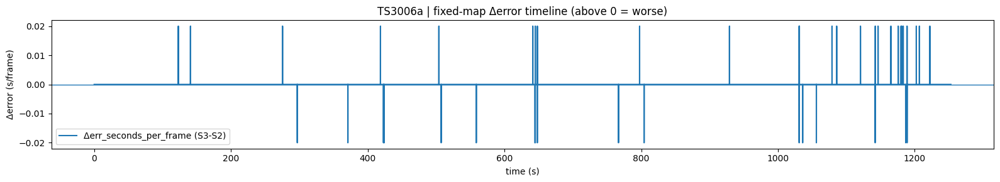

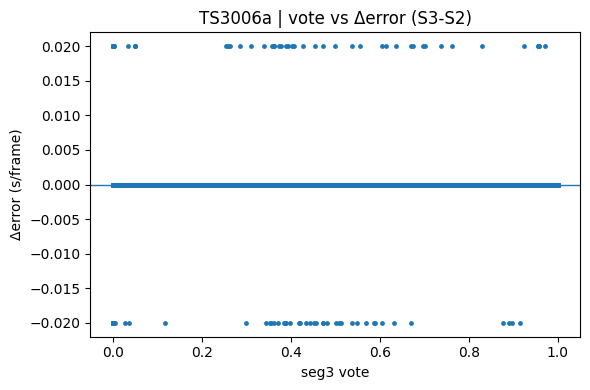


=== OVERLAP IMPACT REPORT (Stage3-Stage2) ===
REF=0 (non-speech/uem): +tot=+0.260s (miss=+0.000s fa=+0.260s conf=+0.000s) | frames=16490
REF=1 (single spk): +tot=-0.480s (miss=+0.040s fa=-0.300s conf=-0.220s) | frames=38538
REF>=2 (overlap): +tot=-0.180s (miss=+0.100s fa=-0.320s conf=+0.040s) | frames=7616

================= TS3006a | FIXED-MAP SUMMARY =================
Stage2: DER=0.2412  miss=176.22s  fa=34.48s  conf=53.20s  total_err=263.90s  den=1093.96s
Stage3: DER=0.2409  miss=176.36s  fa=34.12s  conf=53.02s  total_err=263.50s  den=1093.96s
Δ(Stage3-Stage2): DER=-0.0004  miss=+0.14s  fa=-0.36s  conf=-0.18s  total=-0.40s
IMPROVEMENT SCORE: saved_err=+0.40s  (+0.15%)  over denom=1093.96s

--- WORST segments by FIXED-MAP added error (Stage3-Stage2) ---
[00] 122.96-123.06 dur=0.10s | +err=+0.100s (miss=+0.100s fa=+0.000s conf=+0.000s)
[01] 140.74-140.82 dur=0.08s | +err=+0.080s (miss=+0.080s fa=+0.000s conf=+0.000s)
[02] 418.60-418.68 dur=0.08s | +err=+0.080s (miss=+0.080s fa=+0.000

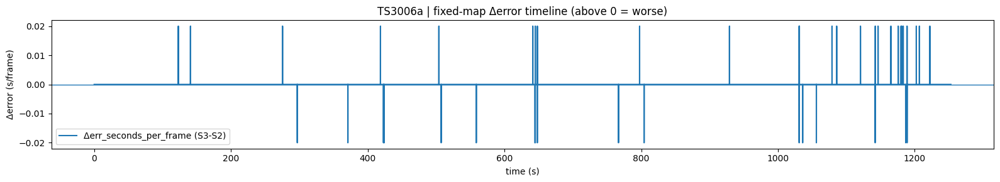

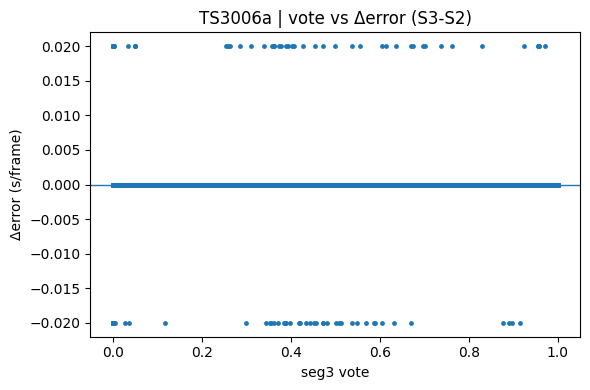


--- MERGED WORSE WINDOWS (gap=0.15s, min_win=0.25s, spike>0.02s/frame) ---
None. (Either no spikes, or all merged windows < min_win.)


In [ ]:
# # ============================================================
# # ULTRA-FRAGMENTED WORSE FINDER (fixed-map)
# # - detects per-frame added error (S3-S2)
# # - collects tiny spikes (e.g., 0.02–0.20s)
# # - merges nearby spikes into windows (e.g., within 0.15s gap)
# # - ranks by total added error seconds (miss/fa/conf breakdown)
# # ============================================================

# import numpy as np
# import matplotlib.pyplot as plt
# from pyannote.core import Segment


# file = files_by_uri["TS3006a"]

# # recompute these (do not rely on dbg having them)
# uem_seg = _safe_uem_seg(file)
# res = _get_res()

# dbg = fixedmap_debug_stage3_vs_stage2(file, min_seg_dur=0.05, topn=10)

# rc = ref_speaker_count_per_frame(file, uem_seg, res)
# overlap_impact_report(dbg, rc, uem_seg, res)


# def _merge_segments(segs, gap=0.15):
#     if not segs:
#         return []
#     segs = sorted(segs, key=lambda s: s.start)
#     out = [segs[0]]
#     for s in segs[1:]:
#         last = out[-1]
#         if s.start <= last.end + gap:
#             out[-1] = Segment(last.start, max(last.end, s.end))
#         else:
#             out.append(s)
#     return out

# def find_ultra_worse_windows(debug_out, uem_seg, res, min_spike=0.02, merge_gap=0.15, min_win=0.25, topn=10):
#     """
#     debug_out: output dict from fixedmap_debug_stage3_vs_stage2 (the one I shared earlier)
#               must contain arrays: d_tot, d_miss, d_fa, d_conf and t
#     """
#     d_tot  = np.asarray(debug_out["d_tot"])
#     d_miss = np.asarray(debug_out["d_miss"])
#     d_fa   = np.asarray(debug_out["d_fa"])
#     d_conf = np.asarray(debug_out["d_conf"])

#     T = len(d_tot)
#     # spike mask: any per-frame added error > min_spike seconds/frame
#     spike = d_tot > float(min_spike)
#     spike_segs = _mask_to_segments(spike, uem_seg, res, min_dur=0.0)  # allow tiny
#     merged = _merge_segments(spike_segs, gap=merge_gap)
#     merged = [s for s in merged if s.duration >= float(min_win)]

#     rows = []
#     for s in merged:
#         a = int((s.start - uem_seg.start) / res)
#         b = int(np.ceil((s.end - uem_seg.start) / res))
#         a = max(0, min(T, a)); b = max(0, min(T, b))
#         rows.append({
#             "start": float(s.start), "end": float(s.end), "dur": float(s.duration),
#             "d_tot_s":  float(d_tot[a:b].sum()),
#             "d_miss_s": float(d_miss[a:b].sum()),
#             "d_fa_s":   float(d_fa[a:b].sum()),
#             "d_conf_s": float(d_conf[a:b].sum()),
#         })
#     rows.sort(key=lambda r: r["d_tot_s"], reverse=True)

#     print(f"\n--- MERGED WORSE WINDOWS (gap={merge_gap}s, min_win={min_win}s, spike>{min_spike}s/frame) ---")
#     if not rows:
#         print("None. (Either no spikes, or all merged windows < min_win.)")
#     for i, r in enumerate(rows[:topn]):
#         print(f"[{i:02d}] {r['start']:.2f}-{r['end']:.2f} dur={r['dur']:.2f}s | +err={r['d_tot_s']:+.3f}s"
#               f" (miss={r['d_miss_s']:+.3f}s fa={r['d_fa_s']:+.3f}s conf={r['d_conf_s']:+.3f}s)")
#     return rows

# # Usage example after we run fixedmap_debug_stage3_vs_stage2(...)
# dbg = fixedmap_debug_stage3_vs_stage2(files_by_uri["TS3006a"], min_seg_dur=0.05, topn=10)
# rows = find_ultra_worse_windows(dbg, dbg["uem_seg"], dbg["res"], min_spike=0.02, merge_gap=0.15, min_win=0.25, topn=10)



================= TS3006a | FIXED-MAP SUMMARY =================
Stage2: DER=0.2412  miss=176.22s  fa=34.48s  conf=53.20s  total_err=263.90s  den=1093.96s
Stage3: DER=0.2409  miss=176.36s  fa=34.12s  conf=53.02s  total_err=263.50s  den=1093.96s
Δ(Stage3-Stage2): DER=-0.0004  miss=+0.14s  fa=-0.36s  conf=-0.18s  total=-0.40s
IMPROVEMENT SCORE: saved_err=+0.40s  (+0.15%)  over denom=1093.96s

--- WORST segments by FIXED-MAP added error (Stage3-Stage2) ---
[00] 122.96-123.06 dur=0.10s | +err=+0.100s (miss=+0.100s fa=+0.000s conf=+0.000s)
[01] 140.74-140.82 dur=0.08s | +err=+0.080s (miss=+0.080s fa=+0.000s conf=+0.000s)
[02] 418.60-418.68 dur=0.08s | +err=+0.080s (miss=+0.080s fa=+0.000s conf=+0.000s)
[03] 645.04-645.14 dur=0.10s | +err=+0.080s (miss=-0.020s fa=+0.100s conf=+0.000s)
[04] 648.08-648.16 dur=0.08s | +err=+0.080s (miss=+0.000s fa=+0.080s conf=+0.000s)
[05] 1179.90-1179.98 dur=0.08s | +err=+0.080s (miss=+0.080s fa=+0.000s conf=+0.000s)
[06] 275.44-275.50 dur=0.06s | +err=+0.060

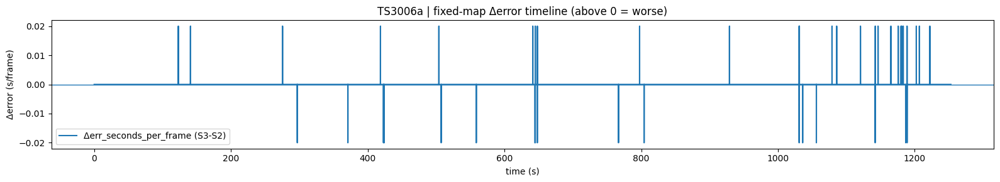

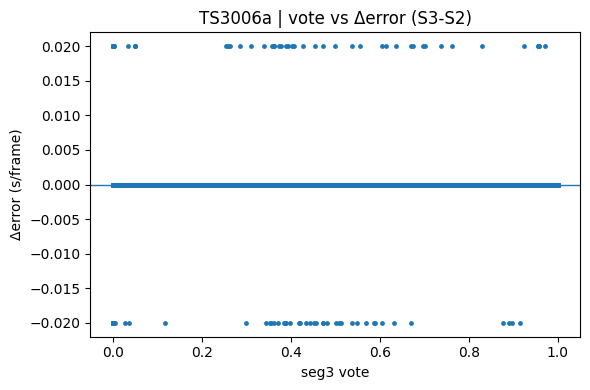


=== OVERLAP IMPACT REPORT (Stage3-Stage2) ===
REF=0 (non-speech/uem): +tot=+0.260s (miss=+0.000s fa=+0.260s conf=+0.000s) | frames=16490
REF=1 (single spk): +tot=-0.480s (miss=+0.040s fa=-0.300s conf=-0.220s) | frames=38538
REF>=2 (overlap): +tot=-0.180s (miss=+0.100s fa=-0.320s conf=+0.040s) | frames=7616


In [ ]:
# # ============================================================
# # OVERLAP-FOCUSED IMPACT REPORT (fixed-map arrays)
# # - splits frames by reference speaker count (ref_count==0/1/2+)
# # - sums delta error seconds per region
# # ============================================================

# import numpy as np

# def overlap_impact_report(debug_out, ref_frame_count, uem_seg, res):
#     """
#     debug_out must contain d_miss/d_fa/d_conf/d_tot arrays (seconds per frame).
#     ref_frame_count: (T,) number of reference active speakers per frame in same grid.
#                      we can build this from ref annotation using our frame_matrix tools.
#     """
#     d_tot  = np.asarray(debug_out["d_tot"])
#     d_miss = np.asarray(debug_out["d_miss"])
#     d_fa   = np.asarray(debug_out["d_fa"])
#     d_conf = np.asarray(debug_out["d_conf"])

#     T = min(len(ref_frame_count), len(d_tot))
#     rc = np.asarray(ref_frame_count[:T])

#     masks = {
#         "REF=0 (non-speech/uem)": (rc == 0),
#         "REF=1 (single spk)":    (rc == 1),
#         "REF>=2 (overlap)":      (rc >= 2),
#     }

#     print("\n=== OVERLAP IMPACT REPORT (Stage3-Stage2) ===")
#     for name, m in masks.items():
#         if m.sum() == 0:
#             print(f"{name}: (no frames)")
#             continue
#         print(
#             f"{name}: +tot={d_tot[m].sum():+.3f}s "
#             f"(miss={d_miss[m].sum():+.3f}s fa={d_fa[m].sum():+.3f}s conf={d_conf[m].sum():+.3f}s) "
#             f"| frames={int(m.sum())}"
#         )

# def ref_speaker_count_per_frame(file, uem_seg, res):
#     ref = file["annotation"]
#     labels = sorted(map(str, ref.labels()))
#     Mref = _frame_matrix_for_labels(ref, uem_seg, res, labels)  # (T,R) {0,1}
#     return Mref.sum(axis=1).astype(np.int16)

# # Usage:
# file = files_by_uri["TS3006a"]
# dbg = fixedmap_debug_stage3_vs_stage2(file, min_seg_dur=0.05, topn=10)
# rc = ref_speaker_count_per_frame(file, dbg["uem_seg"], dbg["res"])
# overlap_impact_report(dbg, rc, dbg["uem_seg"], dbg["res"])


[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE
[OK] cleared Stage3 bank cache

=== Debug TS3006a with Tweaks ===


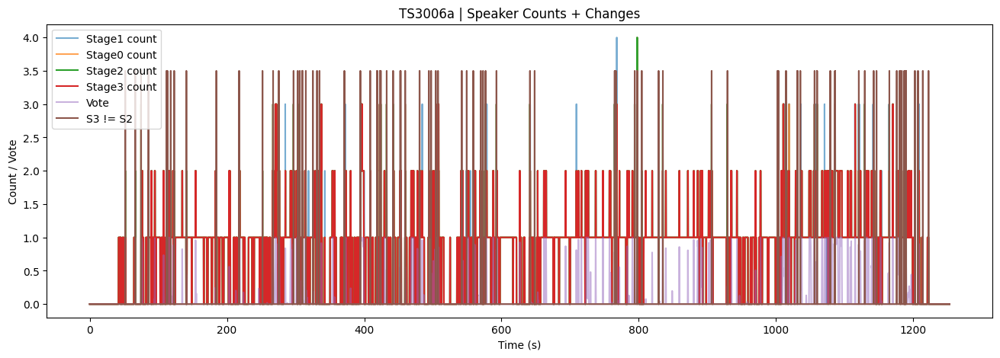

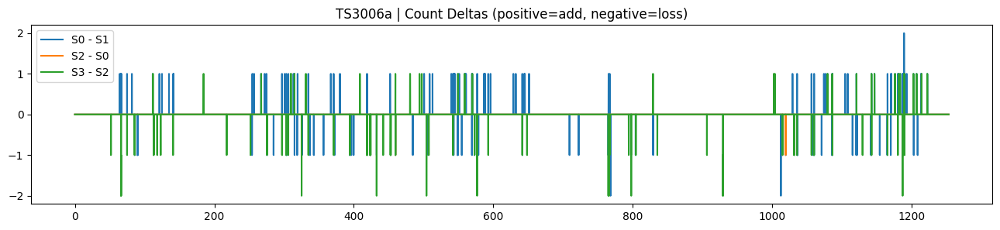

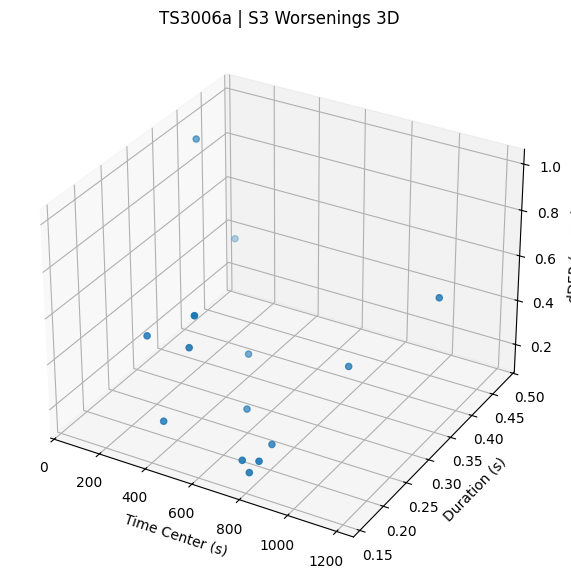


=== TS3006a Stats ===
Fragmentation S1: {'n_segs': 583, 'n_short': 182, 'avg_dur': 1.7137714408233284, 'warnings': ''}
Fragmentation S0: {'n_segs': 462, 'n_short': 71, 'avg_dur': 2.1850649350649376, 'warnings': ''}
Fragmentation S2: {'n_segs': 459, 'n_short': 69, 'avg_dur': 2.1986928104575187, 'warnings': ''}
Fragmentation S3: {'n_segs': 370, 'n_short': 0, 'avg_dur': 2.720594594594593, 'warnings': ''}
S3 Gates (3A): {'stab_fail': 0, 'weak_sim2': 5, 'weak_m23': 8, 'cand_none': 0, 'cand_is_base': 0, 'bank_empty': 0, 'no_frames': 0, 'applied': 4, 'add_gate_skip': 27}
S3 Changes: promote_sec= 2.0 fill_sec= 0.0 bridge_sec= 0.0

=== Top 8 S3 Worsenings vs S2 ===
[00] [ 00:01:51.680 -->  00:01:52.060] dur=0.38 dDER=1.000 (S2 DER=0.000 → S3=1.000)
  S2: miss=0.00 fa=0.00 conf=0.00
  S3: miss=0.00 fa=0.38 conf=0.00
[01] [ 00:09:32.880 -->  00:09:33.040] dur=0.16 dDER=0.750 (S2 DER=0.125 → S3=0.875)
  S2: miss=0.00 fa=0.02 conf=0.00
  S3: miss=0.14 fa=0.00 conf=0.00
[02] [ 00:19:46.540 -->  00:

[1] [ 00:09:32.880 -->  00:09:33.040] dDER=0.750


[2] [ 00:19:46.540 -->  00:19:46.900] dDER=0.647


[3] [ 00:08:24.060 -->  00:08:24.240] dDER=0.556



=== Promote Events (sorted by sim2 low-first) ===
[00] 111.68-112.06 base=MTD022ID cand=0 sim2=0.207 m23=0.015 vote=0.230
[01] 309.24-310.22 base=0 cand=MTD022ID sim2=0.277 m23=0.066 vote=0.200
[02] 459.42-459.62 base=MTD024ME cand=0 sim2=0.287 m23=0.077 vote=0.305
[03] 480.36-480.78 base=MTD024ME cand=0 sim2=0.312 m23=0.022 vote=0.390
[Promote 0] 111.68-112.06


Press Enter to continue...
[Promote 1] 309.24-310.22


Press Enter to continue...
[Promote 2] 459.42-459.62


Press Enter to continue...
[Promote 3] 480.36-480.78


Press Enter to continue...

=== Debug IS1009a with Tweaks ===


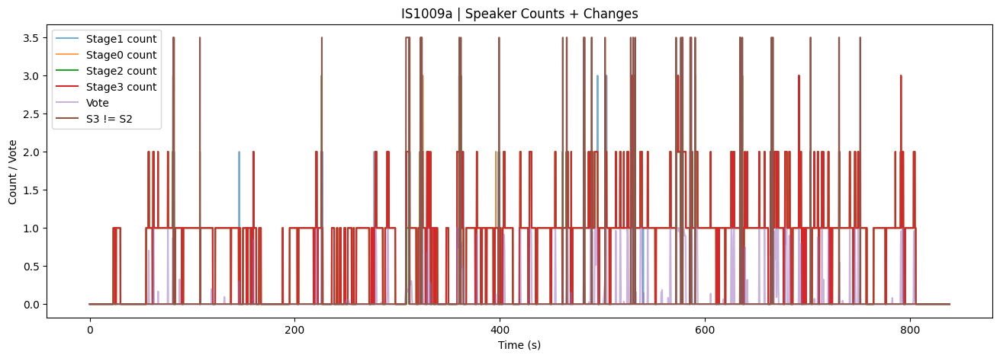

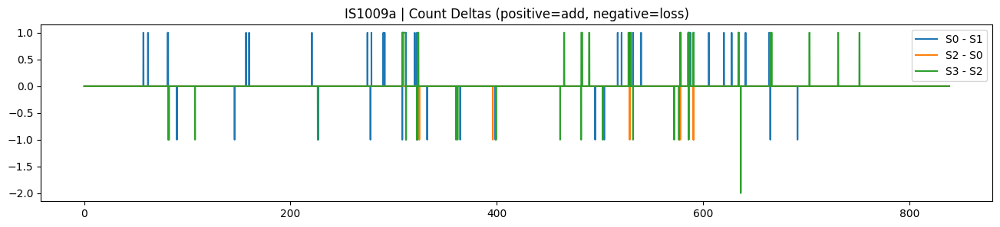

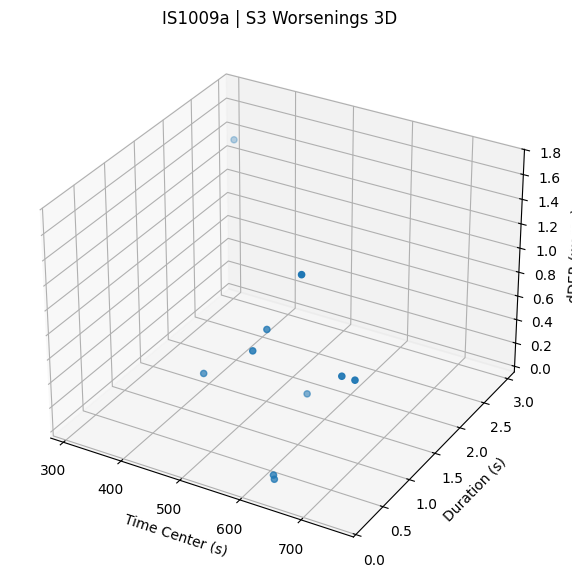


=== IS1009a Stats ===
Fragmentation S1: {'n_segs': 224, 'n_short': 42, 'avg_dur': 2.9914760044642863, 'warnings': ''}
Fragmentation S0: {'n_segs': 198, 'n_short': 21, 'avg_dur': 3.40878787878788, 'warnings': ''}
Fragmentation S2: {'n_segs': 192, 'n_short': 18, 'avg_dur': 3.5102083333333347, 'warnings': ''}
Fragmentation S3: {'n_segs': 176, 'n_short': 0, 'avg_dur': 3.8822727272727247, 'warnings': ''}
S3 Gates (3A): {'stab_fail': 0, 'weak_sim2': 11, 'weak_m23': 0, 'cand_none': 0, 'cand_is_base': 0, 'bank_empty': 0, 'no_frames': 0, 'applied': 17, 'add_gate_skip': 0}
S3 Changes: promote_sec= 10.36 fill_sec= 0.0 bridge_sec= 0.0

=== Top 8 S3 Worsenings vs S2 ===
[00] [ 00:11:04.900 -->  00:11:05.240] dur=0.34 dDER=1.684 (S2 DER=0.895 → S3=2.579)
  S2: miss=0.00 fa=0.15 conf=0.02
  S3: miss=0.00 fa=0.49 conf=0.00
[01] [ 00:05:08.440 -->  00:05:11.380] dur=2.94 dDER=1.359 (S2 DER=0.630 → S3=1.990)
  S2: miss=0.10 fa=0.92 conf=0.19
  S3: miss=0.00 fa=3.82 conf=0.00
[02] [ 00:09:37.840 -->  00

[1] [ 00:05:08.440 -->  00:05:11.380] dDER=1.359


[2] [ 00:09:37.840 -->  00:09:38.520] dDER=1.000


[3] [ 00:09:50.440 -->  00:09:50.740] dDER=1.000



=== Promote Events (sorted by sim2 low-first) ===
[00] 590.44-590.74 base=FIE088 cand=FIO089 sim2=0.201 m23=0.034 vote=0.412
[01] 489.38-489.88 base=FIE088 cand=FIO087 sim2=0.205 m23=0.069 vote=0.473
[02] 666.22-666.64 base=FIO089 cand=FIE088 sim2=0.207 m23=0.022 vote=0.242
[03] 634.20-634.76 base=FIE088 cand=FIO089 sim2=0.209 m23=0.055 vote=0.431
[04] 702.98-703.38 base=FIO084 cand=FIE088 sim2=0.209 m23=0.040 vote=0.227
[05] 309.00-311.38 base=FIO089 cand=FIO087 sim2=0.217 m23=0.057 vote=0.194
[06] 323.38-324.12 base=FIE088 cand=FIO087 sim2=0.220 m23=5.144 vote=0.366
[07] 529.88-530.36 base=FIE088 cand=FIO089 sim2=0.227 m23=0.049 vote=0.254
[08] 751.50-751.82 base=FIE088 cand=FIO089 sim2=0.231 m23=0.078 vote=0.166
[09] 730.84-731.16 base=FIE088 cand=FIO087 sim2=0.237 m23=0.061 vote=0.280
[Promote 0] 590.44-590.74


Press Enter to continue...
[Promote 1] 489.38-489.88


Press Enter to continue...
[Promote 2] 666.22-666.64


Press Enter to continue...
[Promote 3] 634.20-634.76


Press Enter to continue...
[Promote 4] 702.98-703.38


Press Enter to continue...

=== Debug TS3010a with Tweaks ===


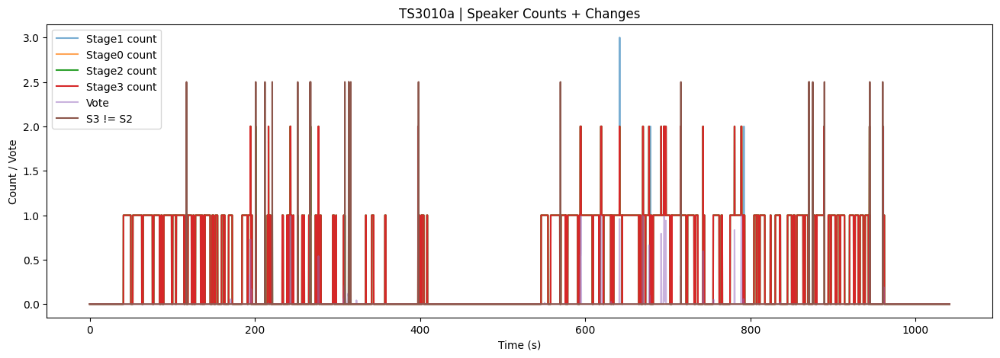

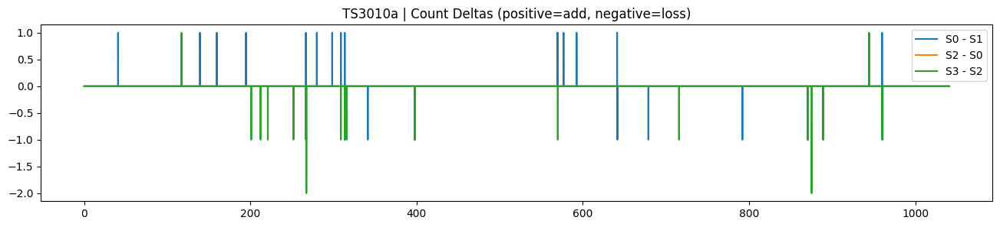

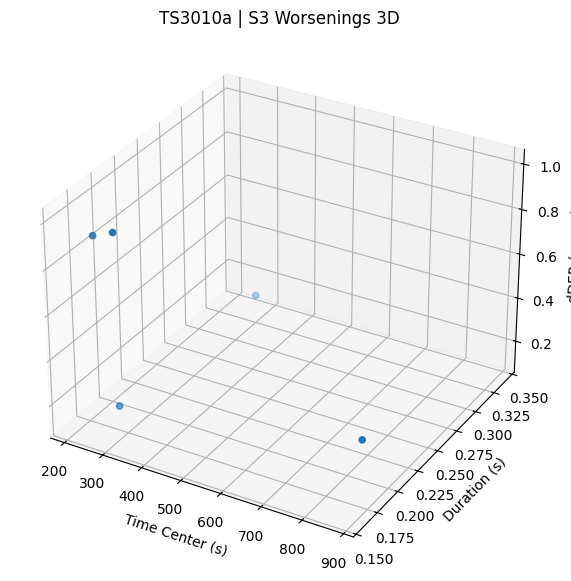


=== TS3010a Stats ===
Fragmentation S1: {'n_segs': 169, 'n_short': 32, 'avg_dur': 2.478047337278109, 'warnings': ''}
Fragmentation S0: {'n_segs': 150, 'n_short': 14, 'avg_dur': 2.8141333333333334, 'warnings': ''}
Fragmentation S2: {'n_segs': 150, 'n_short': 14, 'avg_dur': 2.8141333333333334, 'warnings': ''}
Fragmentation S3: {'n_segs': 128, 'n_short': 0, 'avg_dur': 3.282187499999998, 'warnings': ''}
S3 Gates (3A): {'stab_fail': 0, 'weak_sim2': 1, 'weak_m23': 1, 'cand_none': 0, 'cand_is_base': 0, 'bank_empty': 0, 'no_frames': 0, 'applied': 0, 'add_gate_skip': 1}
S3 Changes: promote_sec= 0.0 fill_sec= 0.0 bridge_sec= 0.0

=== Top 8 S3 Worsenings vs S2 ===
[00] [ 00:05:13.360 -->  00:05:13.520] dur=0.16 dDER=1.000 (S2 DER=0.000 → S3=1.000)
  S2: miss=0.00 fa=0.00 conf=0.00
  S3: miss=0.16 fa=0.00 conf=0.00
[01] [ 00:03:32.000 -->  00:03:32.180] dur=0.18 dDER=0.875 (S2 DER=0.125 → S3=1.000)
  S2: miss=0.00 fa=0.02 conf=0.00
  S3: miss=0.16 fa=0.00 conf=0.00
[02] [ 00:14:35.260 -->  00:14:

[1] [ 00:03:32.000 -->  00:03:32.180] dDER=0.875


[2] [ 00:14:35.260 -->  00:14:35.440] dDER=0.333


[3] [ 00:04:26.620 -->  00:04:26.800] dDER=0.143


In [ ]:
# ============================================================
# Tweaked Stage3 Run + Debug (with Custom Config)
#
# Steps:
# 1. Define tweaked config (relax 3A, strict 3B, anti-fragment)
# 2. Clear caches for fresh run
# 3. Run benchmark_all or multi_stage_debug with cfg
# ============================================================

# Tweaked config based on suggestions
cfg_tweaked = Stage3Config(
    # 3A: Boost triggering
    promote_vote_thr=0.10,
    promote_sim2_thr=0.20,
    promote_m23_thr=0.01,  # Dynamic: in loop, if vm > 0.3: m23_thr_eff = 0.02
    micro_rollback_max_dur=0.35,
    micro_rollback_min_rms_db=-60.0,
    # 3B: Gate shorts harder
    bridge_max_gap_sec=0.10,    # Tighter
    fill_min_dur_sec=0.70,      # No short fills
    fill_margin_thr=0.20,       # Stricter m12
    energy_percentile=65.0,     # Higher
    energy_margin_db=9.0,

    # Anti-fragment: Post-merge
    out_merge_gap=0.15,         # Merge same-label if gap<0.15s
    out_min_dur=0.20,           # Drop tiny segs
    promote_stable_subwins=2,   # Reduce disagreement
    promote_stable_req=1,       # Accept if vote high (add logic in code: e.g., in STAGE3_... if vm > 0.4: effective_req = 1 else 2)
    promote_min_bank_per_label=5,  # Ease skips
    add_gate_enable=True,
    micro_rollback_enable=True,
    add_gate_min_ratio=0.20,
    bank_stride_sec=0.30,
    add_gate_min_rms_db=-65.0,
)

# Clear for fresh eval
clear_caches()
clear_stage3_cache()
init_models()

# Assuming STAGE3_MEMORYBANK_KNN_REFINEMENT is the base
def run_stage3_tweaked(f, **kwargs):
    kwargs['cfg'] = cfg_tweaked
    return STAGE3_MEMORYBANK_KNN_REFINEMENT(
        f,
        start_from_promoted=kwargs.get('start_from_promoted', True),
        stage2_kwargs=kwargs.get('stage2_kwargs', {}),
        cfg=kwargs['cfg'],
        return_debug=kwargs.get('return_debug', False),
        debug=kwargs.get('debug', False)
    )

# # DEV-only benchmark on Stage 3 (tweaked)
# print("\n=== STAGE3 Tweaked (start_from_promoted=True) DEV ===")
# _, s3_dev = eval_files_stages(lambda f: run_stage3_tweaked(f, start_from_promoted=True, return_debug=False), dev_files, max_files=None)
# _print_summary("stage3 DEV", s3_dev)

# Debug loop (same) with promote listen integrated
def multi_stage_debug_with_promote(file, topn=8, listen_n=4, pad=0.35, pause_between=False):
    result = multi_stage_debug(file)  # Call original
    dbg3 = result.get("dbg3", {})
    promotes = dbg3.get("promote_events", [])  # (st, en, base, cand, sim2, m23, vm)
    if promotes:
        print("\n=== Promote Events (sorted by sim2 low-first) ===")
        promotes = sorted(promotes, key=lambda e: e[4])  # low sim2 first
        for i, e in enumerate(promotes[:topn]):
            st, en, base, cand, sim2, m23, vm = e
            print(f"[{i:02d}] {st:.2f}-{en:.2f} base={base} cand={cand} sim2={sim2:.3f} m23={m23:.3f} vote={vm:.3f}")
        # Listen loop
        for i in range(min(listen_n, len(promotes))):
            st, en, *_ = promotes[i]
            print(f"[Promote {i}] {st:.2f}-{en:.2f}")
            _play_event(file, st, en, pad=pad)
            if pause_between:
                input("Press Enter to continue...")
    return result

URIS = ["TS3006a", "IS1009a", "TS3010a"]
for u in URIS:
    if u in files_by_uri:
        print(f"\n=== Debug {u} with Tweaks ===")
        original_run_stage3 = run_stage3
        run_stage3 = run_stage3_tweaked
        try:
            _ = multi_stage_debug_with_promote(files_by_uri[u], topn=10, listen_n=5, pause_between=True)
        finally:
            run_stage3 = original_run_stage3  # Restore always

def plot_stage3_diagnostics(dbg3, title_prefix=""):
    # Existing...
    pe = dbg3.get("promote_events", [])
    if pe:
        sim2 = [x[4] for x in pe]
        plt.figure(figsize=(6,3))
        plt.hist(sim2, bins=15)
        plt.title(f"{title_prefix} 3A sim2 Hist")
        plt.show()

What the logs say (important)

TS3006a

Stage3 makes very little change: promote_sec=0.56s, fill_sec=0.8s, bridge_sec=0.16s

Fixed-map says net gain is ~0.12–0.15% and no harm windows ≥ 0.25s

Yet we still see 0.16s “worsenings” → these are micro-spikes, almost always from postprocess dropping/altering tiny segments (our out_min_dur=0.20 is a usual suspect), or from micro bridge/fill touching borderline frames.

IS1009a

Stage3 changes are 0 (promote/fill/bridge = 0), but we still see a 0.16s worsening → this is almost certainly postprocess/min_dur/micro rollback touching a tiny segment, not “3A/3B logic”.

TS3010a

Only bridge_sec=0.16s, and the worst worsening is 0.18s with MISS → consistent with “tiny region was edited/dropped”.

✅ Conclusion: Stage3 isn’t the main bottleneck anymore. our big DER headroom is still Stage1/Stage2 MISS (as we saw: TS3006a Stage2 miss is huge).
Now we need to attribute miss to either:

VAD/speech_mask (Stage1) is missing speech, or

Stage2 anchor constraints / postprocess is deleting speech that Stage1 had.

Below is a  debug pack to get that attribution + to explain Stage3 micro-worsenings

In [ ]:

# # DEV-only benchmark on Stage 3 (tweaked)
print("\n=== STAGE3 Tweaked (start_from_promoted=True) DEV ===")
_, s3_dev = eval_files_stages(lambda f: run_stage3_tweaked(f, start_from_promoted=True, return_debug=False), dev_files, max_files=None)
_print_summary("stage3 DEV", s3_dev)


=== STAGE3 Tweaked (start_from_promoted=True) DEV ===
[eval_files] 1/5 TS3010a DER=0.2355 (miss=77.17 fa=17.15 conf=18.76 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2471 (miss=123.31 fa=40.88 conf=104.88 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1969 (miss=79.12 fa=38.62 conf=39.95 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1821 (miss=31.34 fa=13.10 conf=7.62 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2082 (miss=57.41 fa=44.79 conf=42.68 total=695.90)
[SUMMARY] stage3 DEV mean={'DER': 0.21396742586095682, 'miss': 73.66999999999983, 'fa': 30.907999999999596, 'conf': 42.77799999999981, 'total': 670.3379999999997} global={'DER': 0.21982343235800342, 'miss': 368.34999999999917, 'fa': 154.53999999999797, 'conf': 213.88999999999905, 'total': 3351.6899999999987} n_ok=5/5


In [ ]:
#Cell 1 — Generic helpers (frame counts, window ranking, audio export)

import numpy as np
import soundfile as sf
import matplotlib.pyplot as plt
from pyannote.core import Segment, Timeline

# ---------- robust uem ----------
def _safe_uem_seg(file):
    if "_get_uem_full" in globals():
        uem = _get_uem_full(file)
        if isinstance(uem, Segment):
            return uem
        uem = Timeline(uem)
        ext = uem.extent()
        return Segment(ext.start, ext.end)
    ref = file["annotation"]
    ext = ref.get_timeline().extent()
    return Segment(ext.start, ext.end)

def _get_res():
    return float(globals().get("RES", 0.02))

# ---------- frame speaker-count ----------
def _frame_count_from_ann(ann, uem_seg, res):
    """Count #active labels per frame for any pyannote Annotation."""
    labels = sorted([str(l) for l in ann.labels()])
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    if T <= 0 or len(labels) == 0:
        return np.zeros((max(T,0),), dtype=np.int16)

    if "frame_matrix_from_annotation_local" in globals():
        M = frame_matrix_from_annotation_local(ann, uem_seg, labels, res=float(res))  # (T,K)
        return M.sum(axis=1).astype(np.int16)

    # slow fallback
    cnt = np.zeros((T,), dtype=np.int16)
    for seg, _, _lab in ann.itertracks(yield_label=True):
        s = max(float(seg.start), float(uem_seg.start))
        e = min(float(seg.end), float(uem_seg.end))
        if e <= s:
            continue
        a = int((s - uem_seg.start) / res)
        b = int(np.ceil((e - uem_seg.start) / res))
        a = max(0, min(T, a)); b = max(0, min(T, b))
        cnt[a:b] += 1
    return cnt

# ---------- windows ----------
def _rank_windows(mask, uem_seg, res, win_s=2.0, hop_s=0.5, topk=10):
    """Return top windows where mask is true most (by #true frames)."""
    mask = np.asarray(mask).astype(np.int32)
    T = len(mask)
    win = max(1, int(round(win_s / res)))
    hop = max(1, int(round(hop_s / res)))
    out = []
    for a in range(0, max(1, T - win + 1), hop):
        b = a + win
        s = int(mask[a:b].sum())
        if s <= 0:
            continue
        st = float(uem_seg.start) + a * res
        en = float(uem_seg.start) + b * res
        out.append((s, Segment(st, en)))
    out.sort(key=lambda x: x[0], reverse=True)
    return out[:topk]

# ---------- audio crop/export ----------
def _crop_audio_any(file, seg, pad=0.25):
    st = max(0.0, float(seg.start) - float(pad))
    en = float(seg.end) + float(pad)
    seg2 = Segment(st, en)
    wav, sr = AUDIO.crop(file, seg2, mode="pad")
    if hasattr(wav, "detach"):
        wav = wav.detach().cpu().numpy()
    wav = np.asarray(wav).squeeze().astype(np.float32)
    return wav, int(sr), seg2

def export_segment_wav(file, seg, out_path, pad=0.25):
    wav, sr, seg2 = _crop_audio_any(file, seg, pad=pad)
    sf.write(out_path, wav, sr)
    return out_path, seg2

def plot_counts_overlay(uem_seg, res, **series):
    """series: name -> (T,) arrays"""
    plt.figure(figsize=(16,4))
    t0 = float(uem_seg.start)
    # align to shortest
    T = min(len(v) for v in series.values())
    tt = t0 + np.arange(T) * res
    for k,v in series.items():
        plt.plot(tt, np.asarray(v)[:T], label=k)
    plt.xlabel("time (s)")
    plt.ylabel("count / mask")
    plt.legend()
    plt.tight_lawet()
    plt.show()


In [ ]:
#Cell 2 — Stage-wise MISS attribution (Stage1 vs Stage2)
def miss_attribution_report(file, hyp1, dbg0, hyp2, hyp3=None, dbg3=None,
                            win_s=2.0, hop_s=0.5, topk=8, listen_n=4, pad=0.35):
    """
    Creates frame-level masks:
      - miss_due_to_stage1: ref speech but speech_mask==0  (VAD/speech_mask issue)
      - miss_due_to_stage2: ref speech, speech_mask==1, but stage2 count==0 (Stage2/constraints issue)
      - overlap_miss_stage2: ref overlap (>=2), stage2 count<2 (overlap handling issue)
    Ranks windows for each and lets we listen/export.
    """
    uri = file.get("uri","<unk>")
    res = _get_res()
    uem_seg = _safe_uem_seg(file)

    ref = file["annotation"]
    refc = _frame_count_from_ann(ref, uem_seg, res)

    # speech_mask from dbg0 (Stage0/Stage1 debug)
    speech_mask = np.asarray(dbg0.get("speech_mask", None))
    if speech_mask is None or len(speech_mask)==0:
        raise RuntimeError("dbg0['speech_mask'] missing. Run Stage0 with return_debug=True.")
    # align lengths
    T = min(len(refc), len(speech_mask))
    refc = refc[:T]
    speech_mask = speech_mask[:T].astype(bool)

    # stage counts
    c1 = _frame_count_from_ann(hyp1, uem_seg, res)[:T]
    c2 = _frame_count_from_ann(hyp2, uem_seg, res)[:T]
    c3 = _frame_count_from_ann(hyp3, uem_seg, res)[:T] if hyp3 is not None else None

    miss_due_to_stage1 = (refc > 0) & (~speech_mask)
    miss_due_to_stage2 = (refc > 0) & (speech_mask) & (c2 == 0)
    overlap_miss_stage2 = (refc >= 2) & (c2 < 2) & (speech_mask)

    print(f"\n==== {uri} MISS Attribution (proxy via counts) ====")
    def _sec(m): return float(m.sum()) * float(res)
    print(f"Stage1/VAD-like miss (ref>0 & speech_mask=0): {_sec(miss_due_to_stage1):.2f}s")
    print(f"Stage2 drop miss (ref>0 & speech_mask=1 & S2=0): {_sec(miss_due_to_stage2):.2f}s")
    print(f"Stage2 overlap miss (ref>=2 & S2<2): {_sec(overlap_miss_stage2):.2f}s")

    # Overlay plot to visually see where problems are
    series = {
        "REF_count": refc,
        "speech_mask": speech_mask.astype(np.int8),
        "S1_count": c1,
        "S2_count": c2,
    }
    if c3 is not None:
        series["S3_count"] = c3
    if dbg3 is not None and dbg3.get("vote", None) is not None:
        v = np.asarray(dbg3["vote"])[:T]
        series["seg3_vote"] = v
    plot_counts_overlay(uem_seg, res, **series)

    # Rank windows for each category
    buckets = [
        ("MISS_DUE_TO_STAGE1", miss_due_to_stage1),
        ("MISS_DUE_TO_STAGE2", miss_due_to_stage2),
        ("OVERLAP_MISS_STAGE2", overlap_miss_stage2),
    ]

    for name, mask in buckets:
        tops = _rank_windows(mask, uem_seg, res, win_s=win_s, hop_s=hop_s, topk=topk)
        print(f"\n[{uri}] {name} top windows:")
        for i,(score, seg) in enumerate(tops[:topk]):
            print(f"  [{i:02d}] {seg.start:.2f}-{seg.end:.2f} score={score} frames")
        # listen
        for i,(score, seg) in enumerate(tops[:listen_n]):
            wav, sr, seg2 = _crop_audio_any(file, seg, pad=pad)
            print(f"  [LISTEN {i}] {name} {seg2.start:.2f}-{seg2.end:.2f}")
            _play_event(file, seg2.start, seg2.end, pad=0.0)  # uses our existing player

    return {
        "uem_seg": uem_seg,
        "res": res,
        "refc": refc,
        "speech_mask": speech_mask,
        "c1": c1, "c2": c2, "c3": c3,
        "miss1": miss_due_to_stage1,
        "miss2": miss_due_to_stage2,
        "ov_miss2": overlap_miss_stage2,
    }



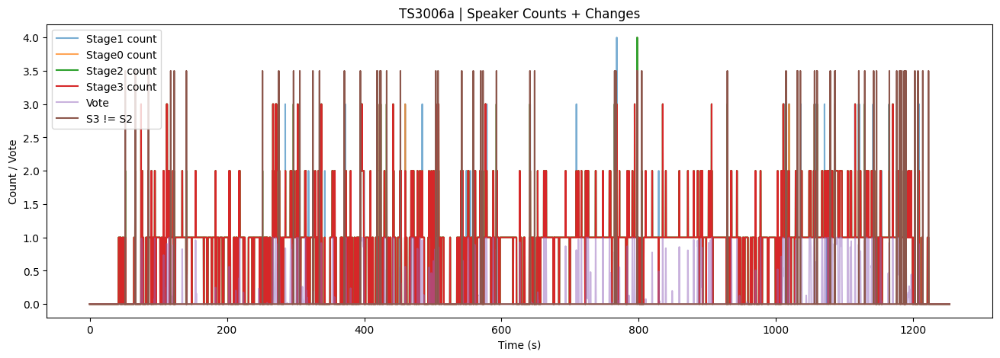

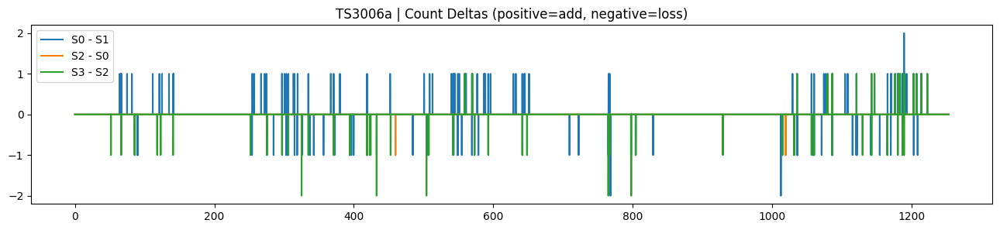

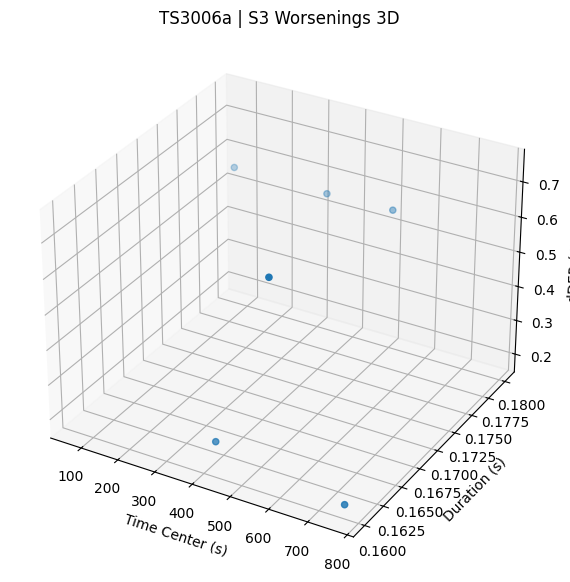


=== TS3006a Stats ===
Fragmentation S1: {'n_segs': 583, 'n_short': 182, 'avg_dur': 1.7137714408233284, 'warnings': ''}
Fragmentation S0: {'n_segs': 462, 'n_short': 71, 'avg_dur': 2.1850649350649376, 'warnings': ''}
Fragmentation S2: {'n_segs': 459, 'n_short': 69, 'avg_dur': 2.1986928104575187, 'warnings': ''}
Fragmentation S3: {'n_segs': 407, 'n_short': 19, 'avg_dur': 2.472874692874692, 'warnings': ''}
S3 Gates (3A): {'stab_fail': 5, 'weak_sim2': 2, 'weak_m23': 0, 'cand_none': 0, 'cand_is_base': 0, 'bank_empty': 0, 'no_frames': 0, 'applied': 0, 'add_gate_skip': 2}
S3 Changes: promote_sec= 0.0 fill_sec= 0.0 bridge_sec= 0.0

=== Top 8 S3 Worsenings vs S2 ===
[00] [ 00:09:32.880 -->  00:09:33.040] dur=0.16 dDER=0.750 (S2 DER=0.125 → S3=0.875)
  S2: miss=0.00 fa=0.02 conf=0.00
  S3: miss=0.14 fa=0.00 conf=0.00
[01] [ 00:08:24.060 -->  00:08:24.240] dur=0.18 dDER=0.556 (S2 DER=0.444 → S3=1.000)
  S2: miss=0.00 fa=0.02 conf=0.06
  S3: miss=0.18 fa=0.00 conf=0.00
[02] [ 00:01:06.300 -->  00:

[1] [ 00:08:24.060 -->  00:08:24.240] dDER=0.556


[2] [ 00:01:06.300 -->  00:01:06.480] dDER=0.556


[3] [ 00:05:25.000 -->  00:05:25.180] dDER=0.552



==== TS3006a MISS Attribution (proxy via counts) ====
Stage1/VAD-like miss (ref>0 & speech_mask=0): 2.30s
Stage2 drop miss (ref>0 & speech_mask=1 & S2=0): 47.80s
Stage2 overlap miss (ref>=2 & S2<2): 55.40s


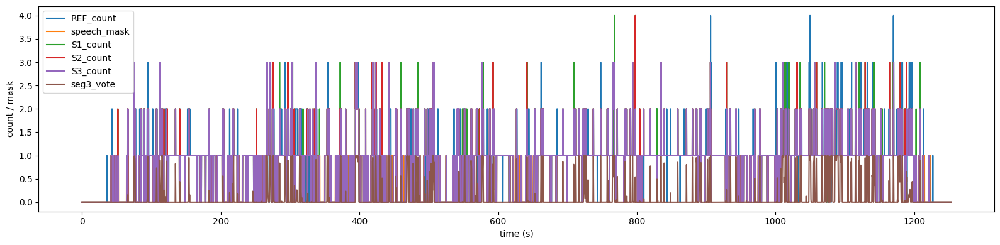


[TS3006a] MISS_DUE_TO_STAGE1 top windows:
  [00] 799.50-801.50 score=23 frames
  [01] 800.00-802.00 score=23 frames
  [02] 800.50-802.50 score=23 frames
  [03] 1225.50-1227.50 score=23 frames
  [04] 1226.00-1228.00 score=23 frames
  [05] 1226.50-1228.50 score=23 frames
  [06] 1225.00-1227.00 score=22 frames
  [07] 801.00-803.00 score=16 frames
  [LISTEN 0] MISS_DUE_TO_STAGE1 799.15-801.85


  [LISTEN 1] MISS_DUE_TO_STAGE1 799.65-802.35


  [LISTEN 2] MISS_DUE_TO_STAGE1 800.15-802.85


  [LISTEN 3] MISS_DUE_TO_STAGE1 1225.15-1227.85



[TS3006a] MISS_DUE_TO_STAGE2 top windows:
  [00] 339.00-341.00 score=100 frames
  [01] 338.50-340.50 score=97 frames
  [02] 584.50-586.50 score=95 frames
  [03] 251.50-253.50 score=88 frames
  [04] 382.50-384.50 score=88 frames
  [05] 596.00-598.00 score=88 frames
  [06] 584.00-586.00 score=86 frames
  [07] 445.50-447.50 score=84 frames
  [LISTEN 0] MISS_DUE_TO_STAGE2 338.65-341.35


  [LISTEN 1] MISS_DUE_TO_STAGE2 338.15-340.85


  [LISTEN 2] MISS_DUE_TO_STAGE2 584.15-586.85


  [LISTEN 3] MISS_DUE_TO_STAGE2 251.15-253.85



[TS3006a] OVERLAP_MISS_STAGE2 top windows:
  [00] 308.00-310.00 score=100 frames
  [01] 308.50-310.50 score=100 frames
  [02] 307.50-309.50 score=99 frames
  [03] 1193.00-1195.00 score=98 frames
  [04] 1193.50-1195.50 score=98 frames
  [05] 1192.50-1194.50 score=97 frames
  [06] 443.50-445.50 score=96 frames
  [07] 443.00-445.00 score=94 frames
  [LISTEN 0] OVERLAP_MISS_STAGE2 307.65-310.35


  [LISTEN 1] OVERLAP_MISS_STAGE2 308.15-310.85


  [LISTEN 2] OVERLAP_MISS_STAGE2 307.15-309.85


  [LISTEN 3] OVERLAP_MISS_STAGE2 1192.65-1195.35


In [ ]:
file = files_by_uri["TS3006a"]
r = multi_stage_debug(file)   # our existing function
rep = miss_attribution_report(
    file,
    hyp1=r["hyp1"], dbg0=r["dbg0"],
    hyp2=r["hyp2"],
    hyp3=r.get("hyp3", None), dbg3=r.get("dbg3", None),
    win_s=2.0, hop_s=0.5, topk=8, listen_n=4, pad=0.35
)


- Stage3 is only giving tiny gains
 - our fixed-map summaries show very small net improvements (saved error seconds are ~0.12–0.18% of denom): TS3006a saved +0.40s (+0.15%), IS1009a +0.16s (+0.12%), TS3010a +0.20s (+0.18%).
- So Stage3 is not where the big DER is coming from.

- Stage2 is the real blocker: huge miss + overlap-miss
 - In TS3006a “MISS attribution (proxy via counts)”:
 - Stage1/VAD-like miss: 2.30s
 - Stage2 drop miss: 47.80s (ref>0, speech_mask=1, but S2 predicts nothing)
 - Stage2 overlap miss: 55.40s (ref>=2, but S2 has <2 speakers)

- That means Stage2 is deleting real speech and also failing overlaps. Stage3 can’t rescue that unless we explicitly target those Stage2 failure windows.
- Stage3 is still causing micro-worsenings even when it “did nothing”
- TS3006a shows: S3 Changes promote/fill/bridge = 0.0, yet we still get multiple 0.16–0.18s worsenings where S2 had tiny FA/conf but S3 becomes pure miss.
- That’s almost certainly because Stage3 rebuilds annotation from a matrix and applies post-processing (min_dur / merge_gap) even when no edits were made. In other words: Stage3 “no-op” is not a true no-op.
- Immediate Stage3 fix: if Stage3 applies no changes, return Stage2 output directly (no rebuild).


==================== TS3006a | ROOT-CAUSE SUMMARY ====================
VAD-like miss (ref>0 & speech_mask=0):           2.30s
Stage2 DROP miss (ref>0 & S0>0 but S2=0):        29.46s
Stage2 OVERLAP miss (ref>=2 but S2<2 speakers):  79.64s

--- A) VAD-like miss (Stage1 suspect): top 3 windows ---
[00] 800.86-801.32 dur=0.46s frames=23 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-74.2dB speech_ratio=0.00


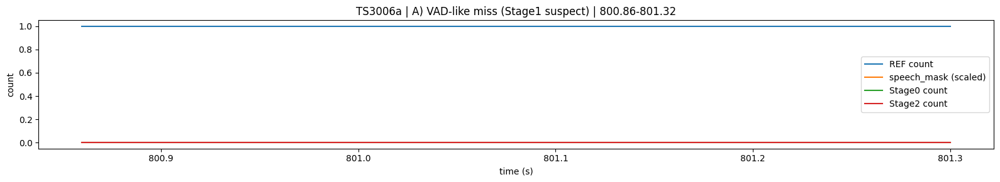

[01] 1226.56-1227.02 dur=0.46s frames=23 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-55.2dB speech_ratio=0.00


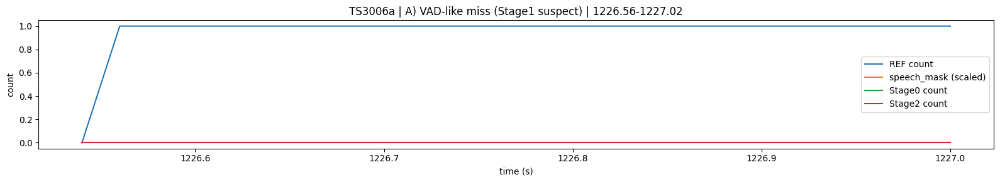

[02] 35.70-35.96 dur=0.26s frames=13 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-55.9dB speech_ratio=0.00


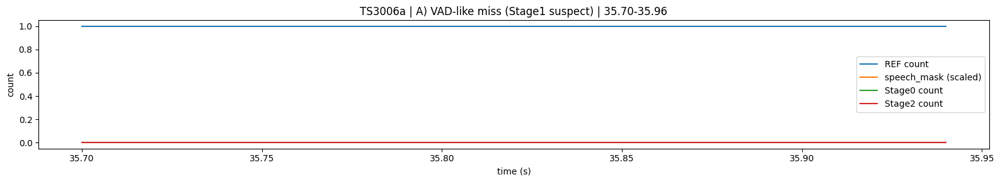


--- B) Stage2 DROP miss (Stage2 deleting speech): top 6 windows ---
[00] 307.36-313.52 dur=6.16s frames=308 | DER(S0)=0.485 -> DER(S2)=1.000 | Δmiss=+6.14s Δfa=-0.02s Δconf=-1.39s | rms=-40.1dB speech_ratio=0.09


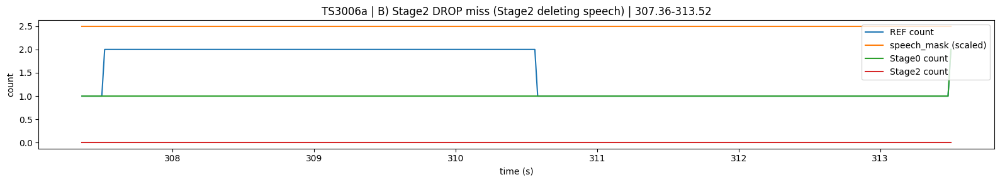

[01] 42.14-44.38 dur=2.24s frames=112 | DER(S0)=0.086 -> DER(S2)=1.000 | Δmiss=+2.23s Δfa=-0.01s Δconf=+0.00s | rms=-54.3dB speech_ratio=0.00


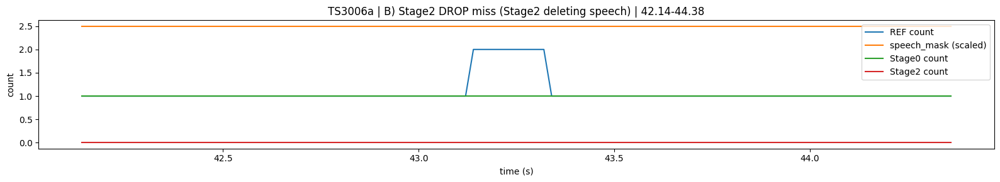

[02] 267.74-269.80 dur=2.06s frames=103 | DER(S0)=0.000 -> DER(S2)=1.000 | Δmiss=+2.06s Δfa=+0.00s Δconf=+0.00s | rms=-44.9dB speech_ratio=0.04


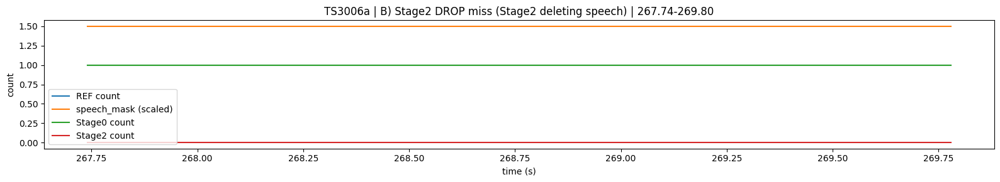

[03] 81.76-83.76 dur=2.00s frames=100 | DER(S0)=0.300 -> DER(S2)=1.000 | Δmiss=+1.99s Δfa=-0.01s Δconf=-0.58s | rms=-52.6dB speech_ratio=0.00


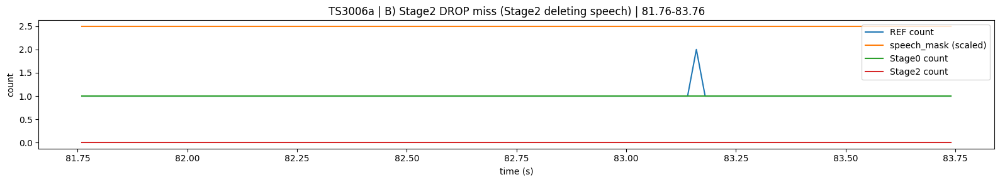

[04] 272.16-273.98 dur=1.82s frames=91 | DER(S0)=0.000 -> DER(S2)=1.000 | Δmiss=+1.82s Δfa=+0.00s Δconf=+0.00s | rms=-51.2dB speech_ratio=0.00


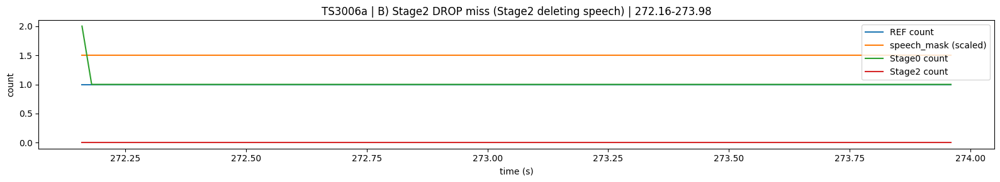

[05] 47.66-49.24 dur=1.58s frames=79 | DER(S0)=0.006 -> DER(S2)=1.000 | Δmiss=+1.57s Δfa=-0.01s Δconf=+0.00s | rms=-54.6dB speech_ratio=0.00


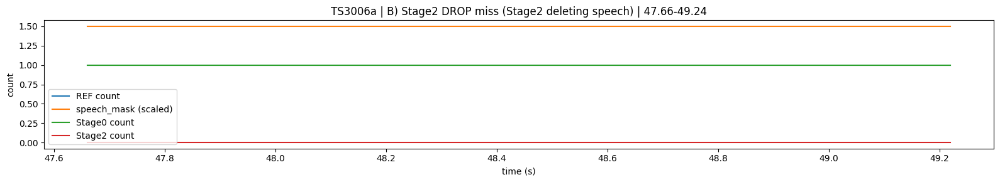


--- C) Stage2 OVERLAP miss (Stage2 overlap failure): top 6 windows ---
[00] 441.94-445.42 dur=3.48s frames=174 | DER(S0)=0.345 -> DER(S2)=0.500 | Δmiss=+1.18s Δfa=-0.02s Δconf=-0.08s | rms=-48.3dB speech_ratio=0.02


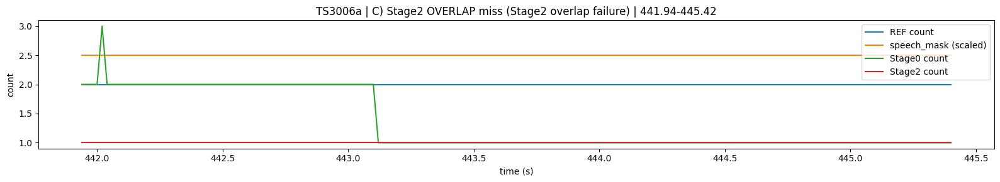

[01] 1192.20-1195.50 dur=3.30s frames=162 | DER(S0)=0.588 -> DER(S2)=0.595 | Δmiss=+0.06s Δfa=+0.00s Δconf=-0.00s | rms=-46.8dB speech_ratio=0.07


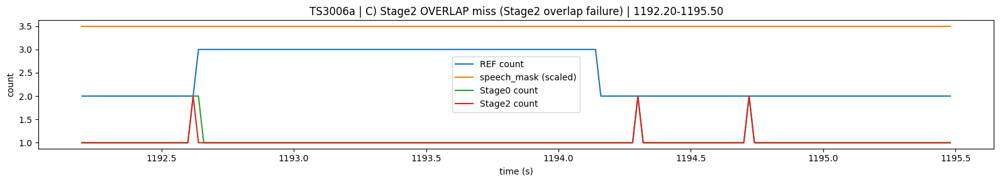

[02] 307.52-310.58 dur=3.06s frames=153 | DER(S0)=0.499 -> DER(S2)=1.000 | Δmiss=+3.06s Δfa=+0.00s Δconf=+0.00s | rms=-37.3dB speech_ratio=0.17


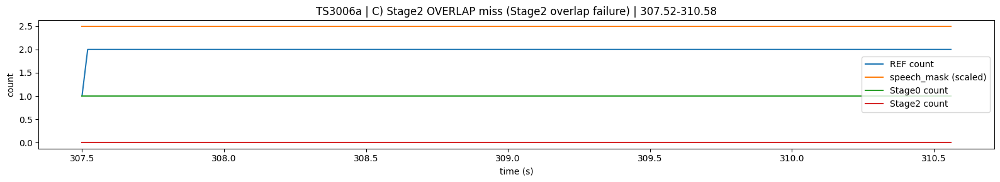

[03] 1106.72-1109.74 dur=3.02s frames=151 | DER(S0)=0.248 -> DER(S2)=0.513 | Δmiss=+1.64s Δfa=+0.00s Δconf=+0.00s | rms=-39.9dB speech_ratio=0.19


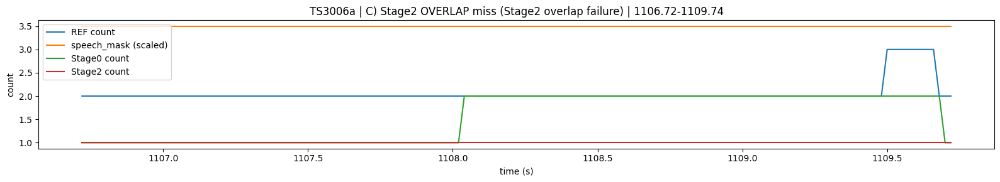

[04] 74.82-77.48 dur=2.66s frames=133 | DER(S0)=0.254 -> DER(S2)=0.644 | Δmiss=+2.07s Δfa=+0.00s Δconf=+0.00s | rms=-46.1dB speech_ratio=0.06


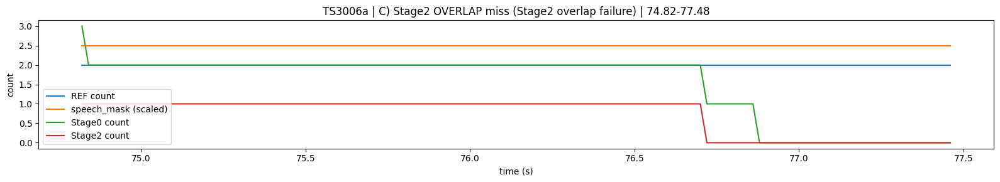

[05] 152.08-154.62 dur=2.54s frames=127 | DER(S0)=0.369 -> DER(S2)=0.499 | Δmiss=+0.66s Δfa=+0.00s Δconf=+0.00s | rms=-47.5dB speech_ratio=0.08


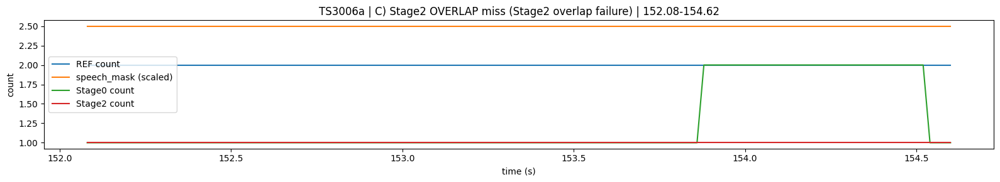


==================== IS1009a | ROOT-CAUSE SUMMARY ====================
VAD-like miss (ref>0 & speech_mask=0):           6.04s
Stage2 DROP miss (ref>0 & S0>0 but S2=0):        0.68s
Stage2 OVERLAP miss (ref>=2 but S2<2 speakers):  39.26s

--- A) VAD-like miss (Stage1 suspect): top 6 windows ---
[00] 355.86-358.28 dur=2.42s frames=121 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-9.4dB speech_ratio=0.97


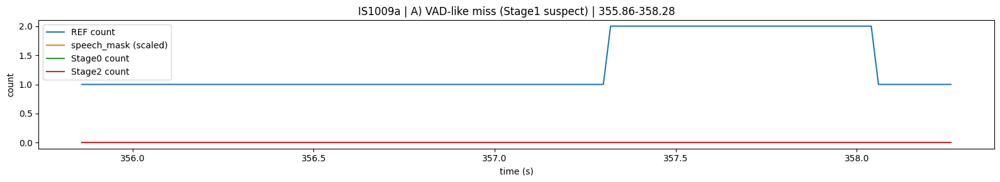

[01] 255.44-257.12 dur=1.68s frames=84 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-30.0dB speech_ratio=0.48


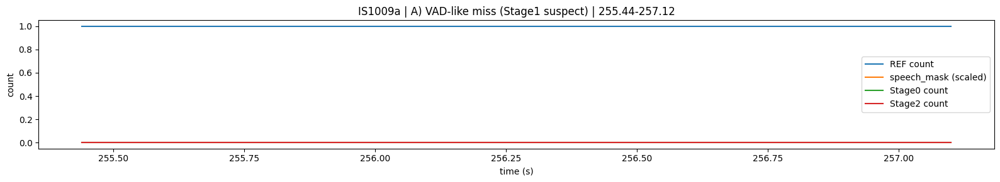

[02] 381.76-382.54 dur=0.78s frames=39 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-39.2dB speech_ratio=0.55


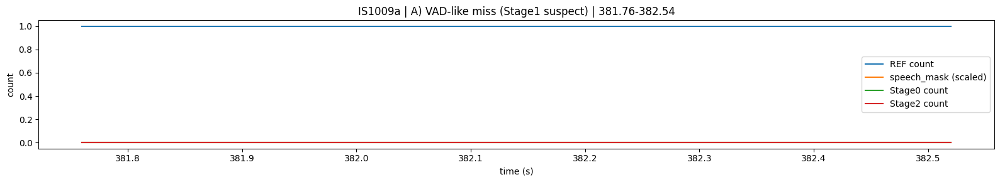

[03] 241.88-242.50 dur=0.62s frames=31 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-41.9dB speech_ratio=0.17


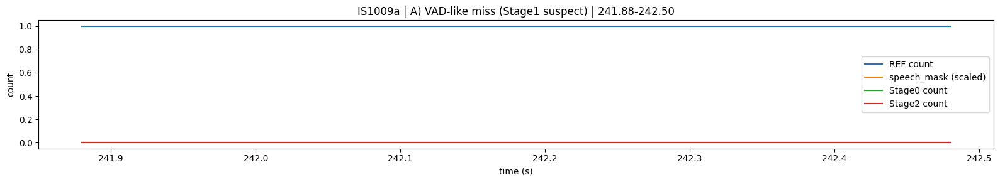

[04] 723.90-724.16 dur=0.26s frames=13 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-44.6dB speech_ratio=0.00


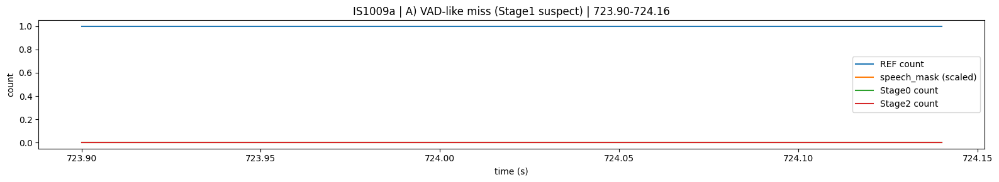

[05] 245.26-245.46 dur=0.20s frames=10 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-41.6dB speech_ratio=0.18


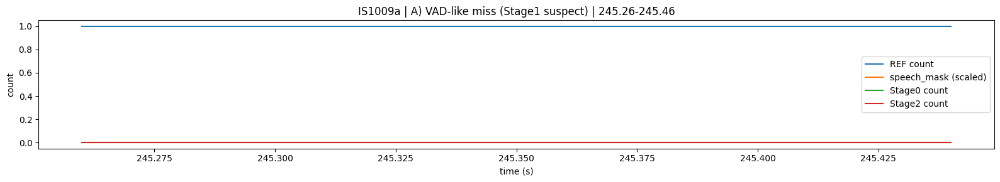


--- B) Stage2 DROP miss (Stage2 deleting speech): top 1 windows ---
[00] 469.26-469.74 dur=0.48s frames=24 | DER(S0)=0.448 -> DER(S2)=1.000 | Δmiss=+0.48s Δfa=+0.00s Δconf=+0.00s | rms=-27.2dB speech_ratio=0.72


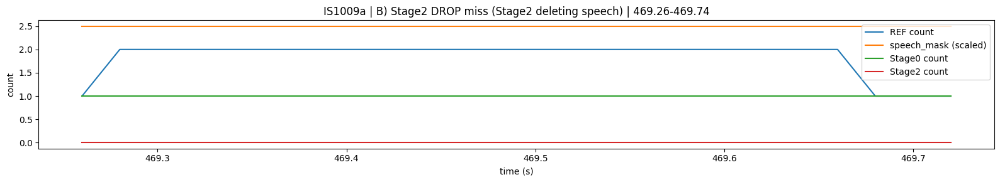


--- C) Stage2 OVERLAP miss (Stage2 overlap failure): top 6 windows ---
[00] 481.88-484.34 dur=2.46s frames=123 | DER(S0)=0.565 -> DER(S2)=0.565 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-20.0dB speech_ratio=0.96


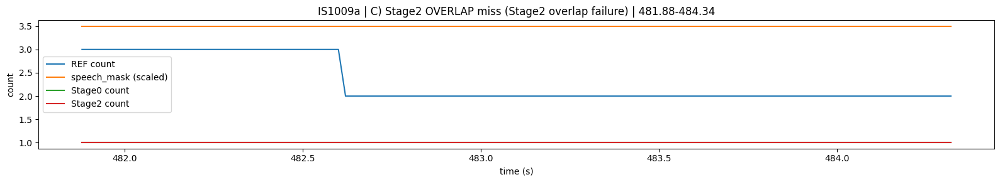

[01] 572.04-574.02 dur=1.98s frames=99 | DER(S0)=0.276 -> DER(S2)=0.638 | Δmiss=+1.98s Δfa=+0.00s Δconf=+0.00s | rms=-13.8dB speech_ratio=1.00


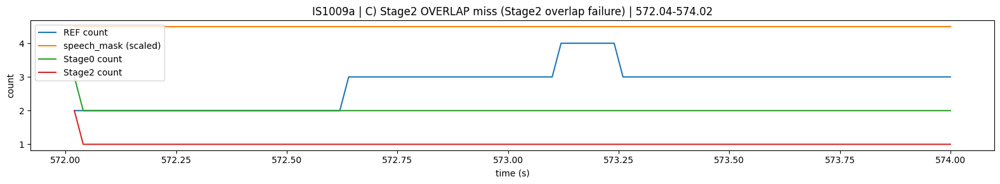

[02] 404.88-406.48 dur=1.60s frames=80 | DER(S0)=0.500 -> DER(S2)=0.500 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-23.6dB speech_ratio=0.94


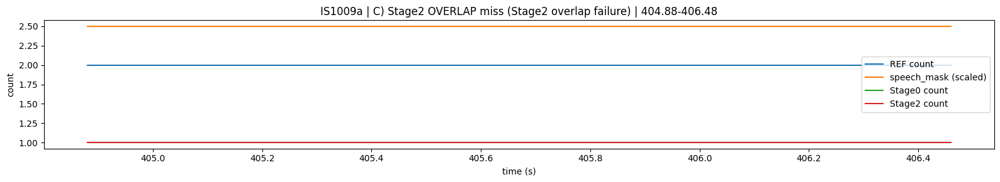

[03] 330.82-332.34 dur=1.52s frames=74 | DER(S0)=0.492 -> DER(S2)=0.492 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-27.1dB speech_ratio=0.88


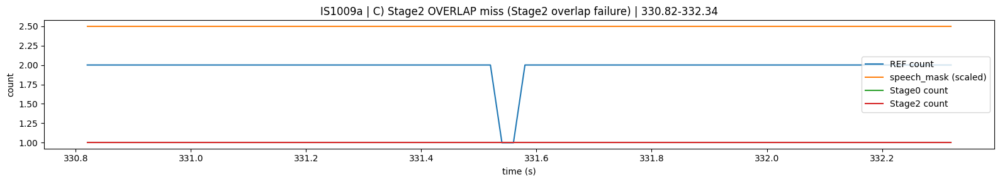

[04] 528.90-530.36 dur=1.46s frames=73 | DER(S0)=0.486 -> DER(S2)=0.500 | Δmiss=+0.04s Δfa=+0.00s Δconf=+0.00s | rms=-12.8dB speech_ratio=0.98


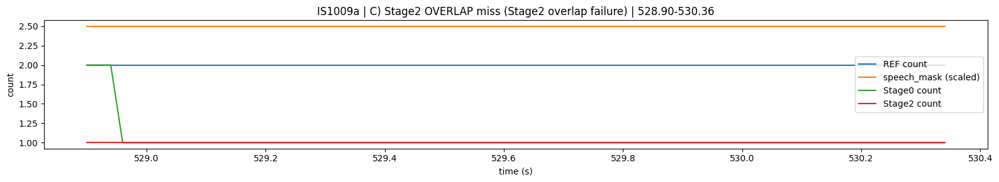

[05] 717.24-718.70 dur=1.46s frames=73 | DER(S0)=0.498 -> DER(S2)=0.498 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-22.6dB speech_ratio=0.93


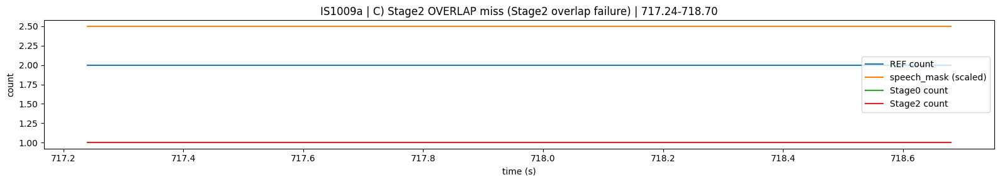


==================== TS3010a | ROOT-CAUSE SUMMARY ====================
VAD-like miss (ref>0 & speech_mask=0):           9.14s
Stage2 DROP miss (ref>0 & S0>0 but S2=0):        0.22s
Stage2 OVERLAP miss (ref>=2 but S2<2 speakers):  15.98s

--- A) VAD-like miss (Stage1 suspect): top 6 windows ---
[00] 854.04-855.76 dur=1.72s frames=86 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-79.4dB speech_ratio=0.00


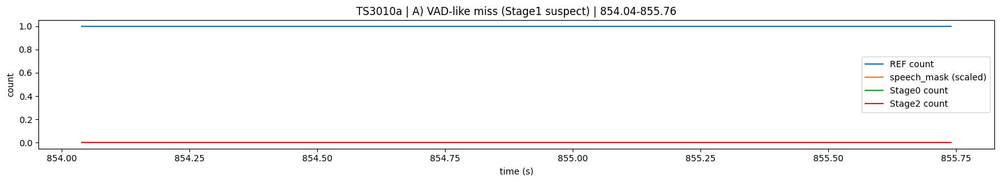

[01] 702.68-703.98 dur=1.30s frames=65 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-79.7dB speech_ratio=0.00


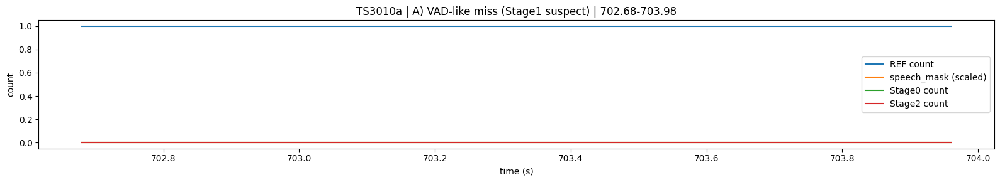

[02] 907.72-908.84 dur=1.12s frames=56 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-69.5dB speech_ratio=0.00


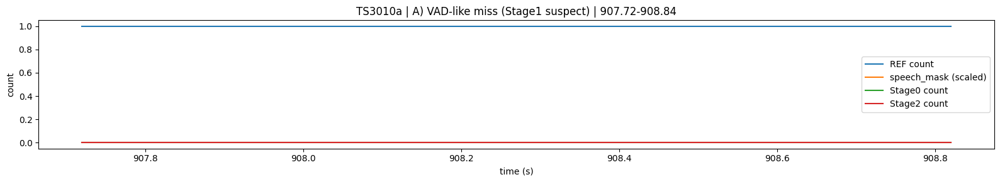

[03] 608.38-609.48 dur=1.10s frames=55 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-70.3dB speech_ratio=0.00


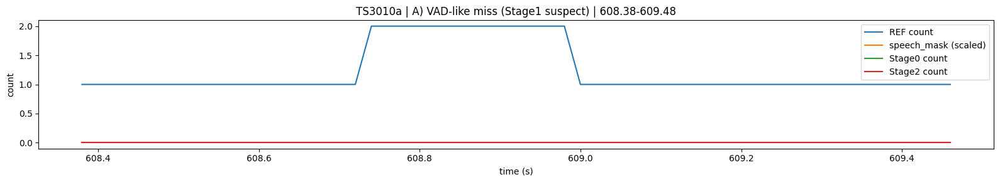

[04] 903.36-904.42 dur=1.06s frames=53 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-79.4dB speech_ratio=0.00


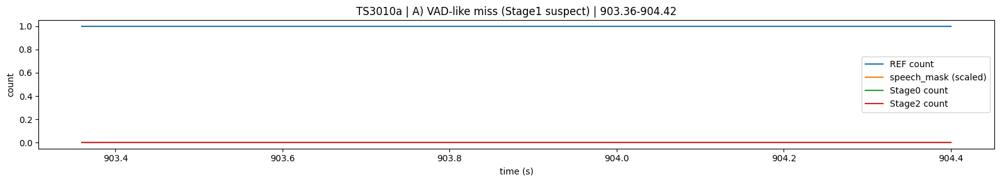

[05] 731.80-732.80 dur=1.00s frames=50 | DER(S0)=1.000 -> DER(S2)=1.000 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-71.0dB speech_ratio=0.00


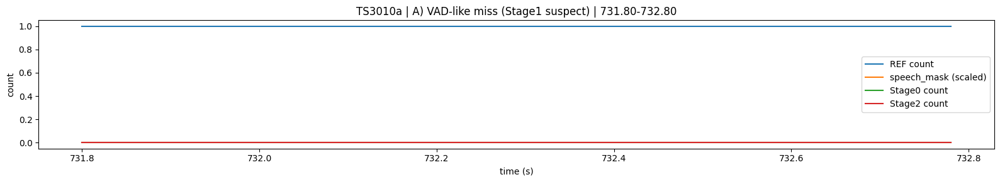


--- B) Stage2 DROP miss (Stage2 deleting speech): none ---

--- C) Stage2 OVERLAP miss (Stage2 overlap failure): top 6 windows ---
[00] 170.34-172.64 dur=2.30s frames=115 | DER(S0)=0.526 -> DER(S2)=0.528 | Δmiss=+0.01s Δfa=+0.00s Δconf=+0.00s | rms=-47.2dB speech_ratio=0.09


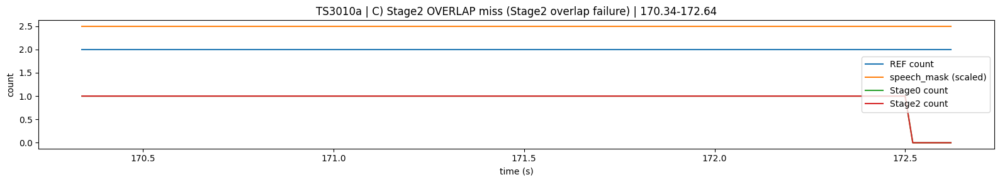

[01] 677.26-678.84 dur=1.58s frames=79 | DER(S0)=0.517 -> DER(S2)=0.525 | Δmiss=+0.02s Δfa=+0.00s Δconf=+0.00s | rms=-57.2dB speech_ratio=0.00


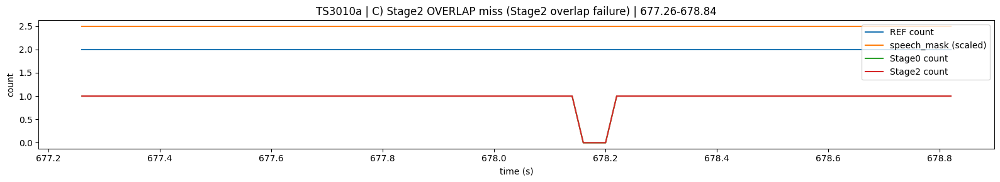

[02] 275.42-276.76 dur=1.34s frames=67 | DER(S0)=0.498 -> DER(S2)=0.498 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-52.6dB speech_ratio=0.01


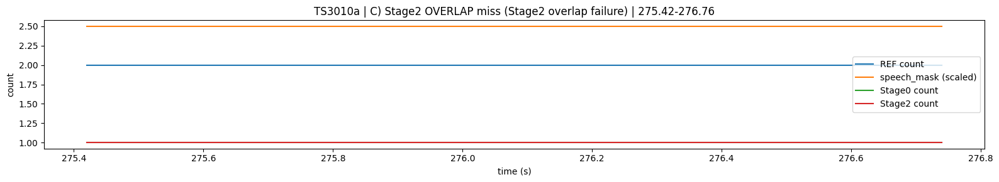

[03] 308.26-309.44 dur=1.18s frames=59 | DER(S0)=0.949 -> DER(S2)=0.957 | Δmiss=+0.02s Δfa=+0.00s Δconf=+0.00s | rms=-42.5dB speech_ratio=0.22


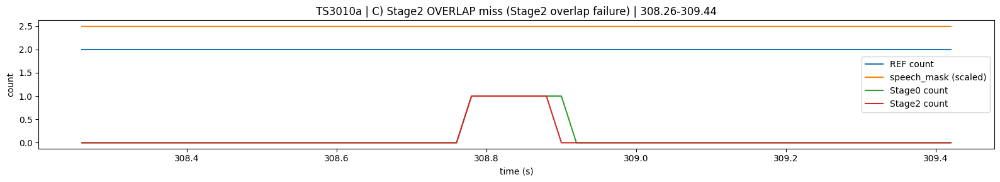

[04] 696.10-697.22 dur=1.12s frames=56 | DER(S0)=0.500 -> DER(S2)=0.500 | Δmiss=+0.00s Δfa=+0.00s Δconf=+0.00s | rms=-43.7dB speech_ratio=0.19


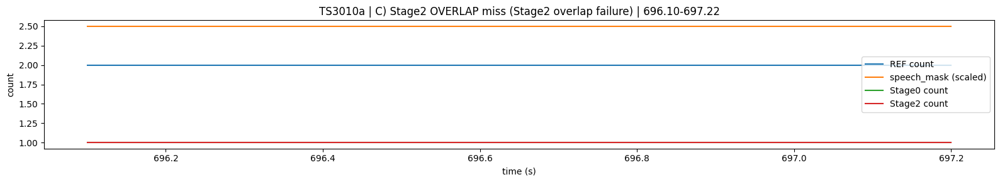

[05] 195.48-196.18 dur=0.70s frames=35 | DER(S0)=0.616 -> DER(S2)=0.635 | Δmiss=+0.03s Δfa=+0.00s Δconf=+0.00s | rms=-51.9dB speech_ratio=0.00


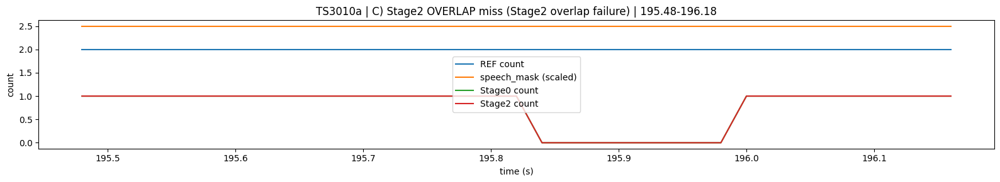

In [ ]:
# ============================================================
# ROOT-CAUSE PROBE: Stage1 vs Stage2
# (read-only debugging; NO patches / NO monkey overrides)
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment, Timeline
from pyannote.metrics.diarization import DiarizationErrorRate

try:
    from IPython.display import Audio as IPyAudio, display
except Exception:
    IPyAudio, display = None, None


# ----------------------------
# Robust helpers
# ----------------------------
def _need(name):
    if name not in globals():
        raise RuntimeError(f"Missing `{name}` in globals. Please define it before running this cell.")

for _n in [
    "RES",
    "AUDIO",
    "STAGE0_PROMOTE_ONLY_ON_PYVAD",
    "STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0",
    "frame_matrix_from_annotation_local",
]:
    _need(_n)

def _safe_uem_and_speechmask(file):
    """
    Best source of uem_seg/speech_mask is Stage0 debug (apply_promotion=False).
    """
    hyp1, dbg = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file,
        apply_promotion=False,
        return_debug=True,
        debug=False,
    )
    uem_seg = dbg.get("uem_seg", None)
    speech_mask = dbg.get("speech_mask", None)
    uem_tl = dbg.get("uem_tl", None)

    if uem_seg is None:
        # fallback: ref extent
        ref = file["annotation"]
        ext = ref.get_timeline().extent()
        uem_seg = Segment(float(ext.start), float(ext.end))

    if speech_mask is None:
        # if speech_mask isn't returned, treat whole uem as speech
        T = int(np.ceil(float(uem_seg.duration) / float(RES)))
        speech_mask = np.ones(T, dtype=bool)

    if uem_tl is None:
        uem_tl = Timeline([uem_seg])

    return hyp1, dbg, uem_seg, uem_tl, np.asarray(speech_mask).astype(bool)

def _frame_counts(ann, uem_seg, res):
    labels = sorted([str(x) for x in ann.labels()])
    if not labels:
        T = int(np.ceil(float(uem_seg.duration) / float(res)))
        return np.zeros(T, dtype=np.int16)
    M = frame_matrix_from_annotation_local(ann, uem_seg, labels, res=float(res))  # (T,K)
    return M.sum(axis=1).astype(np.int16)

def _ref_count(file, uem_seg, res):
    ref = file["annotation"]
    labels = sorted([str(x) for x in ref.labels()])
    M = frame_matrix_from_annotation_local(ref, uem_seg, labels, res=float(res))
    return M.sum(axis=1).astype(np.int16)

def _mask_to_segments(mask, uem_seg, res, min_dur=0.20, merge_gap=0.10):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0:
        return []
    d = np.diff(mask.astype(np.int8), prepend=0, append=0)
    starts = np.where(d == 1)[0]
    ends   = np.where(d == -1)[0]
    segs = []
    for a, b in zip(starts, ends):
        st = float(uem_seg.start) + float(a)*float(res)
        en = float(uem_seg.start) + float(b)*float(res)
        if (en - st) >= float(min_dur):
            segs.append(Segment(st, en))
    # merge close
    if not segs:
        return []
    segs = sorted(segs, key=lambda s: s.start)
    merged = [segs[0]]
    for s in segs[1:]:
        if s.start - merged[-1].end <= float(merge_gap):
            merged[-1] = Segment(merged[-1].start, max(merged[-1].end, s.end))
        else:
            merged.append(s)
    return merged

def _local_der(ref, hyp, seg):
    metric = DiarizationErrorRate()
    uem = Timeline([seg])
    det = metric(ref, hyp, uem=uem, detailed=True)
    return float(det["diarization error rate"]), det

def _rms_db(wav):
    wav = np.asarray(wav, dtype=np.float32).reshape(-1)
    if wav.size == 0:
        return -120.0
    rms = float(np.sqrt(np.mean(wav**2) + 1e-12))
    return 20.0 * np.log10(rms + 1e-12)

def _speech_ratio_energy(wav, sr, thr_db=-40.0, frame_s=0.02, hop_s=0.01):
    wav = np.asarray(wav, dtype=np.float32).reshape(-1)
    frame = int(frame_s * sr)
    hop   = int(hop_s * sr)
    if frame <= 0 or hop <= 0 or wav.size < frame:
        return 0.0
    vals = []
    for i in range(0, wav.size - frame + 1, hop):
        fr = wav[i:i+frame]
        vals.append(_rms_db(fr))
    vals = np.asarray(vals, dtype=np.float32)
    return float((vals > thr_db).mean()) if vals.size else 0.0

def _play_segment(file, seg, pad=0.35):
    if IPyAudio is None or display is None:
        return
    seg2 = Segment(max(0.0, float(seg.start) - pad), float(seg.end) + pad)
    wav, sr = AUDIO.crop(file, seg2, mode="pad")
    try:
        import torch
        if torch.is_tensor(wav):
            wav = wav.detach().cpu().numpy()
    except Exception:
        pass
    wav = np.squeeze(np.asarray(wav))
    display(IPyAudio(wav, rate=int(sr)))

def _energy_stats(file, seg, pad=0.10):
    seg2 = Segment(max(0.0, float(seg.start) - pad), float(seg.end) + pad)
    wav, sr = AUDIO.crop(file, seg2, mode="pad")
    try:
        import torch
        if torch.is_tensor(wav):
            wav = wav.detach().cpu().numpy()
    except Exception:
        pass
    wav = np.squeeze(np.asarray(wav))
    return {
        "rms_db": float(_rms_db(wav)),
        "speech_ratio": float(_speech_ratio_energy(wav, int(sr))),
        "dur": float(seg2.duration),
    }

def _plot_window(uem_seg, res, seg, refc, speech_mask, c0, c2, title=""):
    a = int(np.floor((float(seg.start) - float(uem_seg.start)) / float(res)))
    b = int(np.ceil ((float(seg.end)   - float(uem_seg.start)) / float(res)))
    a = max(a, 0); b = min(b, len(refc))
    t = float(uem_seg.start) + np.arange(a, b)*float(res)

    plt.figure(figsize=(16, 3))
    plt.plot(t, refc[a:b], label="REF count")
    plt.plot(t, speech_mask[a:b].astype(float)* (refc[a:b].max()+0.5), label="speech_mask (scaled)")
    plt.plot(t, c0[a:b], label="Stage0 count")
    plt.plot(t, c2[a:b], label="Stage2 count")
    plt.title(title)
    plt.xlabel("time (s)")
    plt.ylabel("count")
    plt.legend()
    plt.tight_lawet()
    plt.show()


# ----------------------------
# Main probe
# ----------------------------
def probe_stage1_vs_stage2(file, topn=8, min_dur=0.20, merge_gap=0.10, listen_n=3):
    uri = file.get("uri", "<unk>")
    res = float(RES)
    ref = file["annotation"]

    # Stage1 (apply_promotion=False gives us speech_mask + hyp1)
    hyp1, dbg1, uem_seg, uem_tl, speech_mask = _safe_uem_and_speechmask(file)

    # Stage0 (promotion on)
    hyp0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(file, apply_promotion=True, return_debug=True, debug=False)

    # Stage2 (anchor constraints)
    # try to get debug if supported
    try:
        hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(file, return_debug=True, debug=False)
    except TypeError:
        hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(file, return_debug=False, debug=False)
        dbg2 = None

    # Frame-level counts
    refc = _ref_count(file, uem_seg, res)
    c1 = _frame_counts(hyp1, uem_seg, res)
    c0 = _frame_counts(hyp0, uem_seg, res)
    c2 = _frame_counts(hyp2, uem_seg, res)

    T = min(len(refc), len(speech_mask), len(c0), len(c2))
    refc, speech_mask, c0, c2 = refc[:T], speech_mask[:T], c0[:T], c2[:T]

    # Root-cause masks
    vad_miss = (refc > 0) & (~speech_mask)                       # Stage1/VAD issue
    stage2_drop = (refc > 0) & (speech_mask) & (c0 > 0) & (c2 == 0)  # Stage2 deleting speech
    stage2_overlap_miss = (refc >= 2) & (c2 < 2)                 # Stage2 overlap failure

    # Summary seconds
    print(f"\n==================== {uri} | ROOT-CAUSE SUMMARY ====================")
    print(f"VAD-like miss (ref>0 & speech_mask=0):           {vad_miss.sum()*res:.2f}s")
    print(f"Stage2 DROP miss (ref>0 & S0>0 but S2=0):        {stage2_drop.sum()*res:.2f}s")
    print(f"Stage2 OVERLAP miss (ref>=2 but S2<2 speakers):  {stage2_overlap_miss.sum()*res:.2f}s")

    # Convert to segments
    seg_vad   = _mask_to_segments(vad_miss, uem_seg, res, min_dur=min_dur, merge_gap=merge_gap)
    seg_drop  = _mask_to_segments(stage2_drop, uem_seg, res, min_dur=min_dur, merge_gap=merge_gap)
    seg_ovmis = _mask_to_segments(stage2_overlap_miss, uem_seg, res, min_dur=min_dur, merge_gap=merge_gap)

    def _rank(segs, mask):
        out = []
        for s in segs:
            a = int(np.floor((float(s.start) - float(uem_seg.start)) / res))
            b = int(np.ceil ((float(s.end)   - float(uem_seg.start)) / res))
            a = max(a, 0); b = min(b, T)
            score = int(mask[a:b].sum())
            out.append((s, score))
        out.sort(key=lambda x: x[1], reverse=True)
        return out[:topn]

    R_vad  = _rank(seg_vad, vad_miss)
    R_drop = _rank(seg_drop, stage2_drop)
    R_ov   = _rank(seg_ovmis, stage2_overlap_miss)

    def _inspect(tag, ranked):
        if not ranked:
            print(f"\n--- {tag}: none ---")
            return
        print(f"\n--- {tag}: top {min(topn, len(ranked))} windows ---")
        for i, (seg, score) in enumerate(ranked[:topn]):
            der0, det0 = _local_der(ref, hyp0, seg)
            der2, det2 = _local_der(ref, hyp2, seg)
            e = _energy_stats(file, seg, pad=0.10)

            print(f"[{i:02d}] {seg.start:.2f}-{seg.end:.2f} dur={seg.duration:.2f}s frames={score} | "
                  f"DER(S0)={der0:.3f} -> DER(S2)={der2:.3f} | "
                  f"Δmiss={det2['missed detection']-det0['missed detection']:+.2f}s "
                  f"Δfa={det2['false alarm']-det0['false alarm']:+.2f}s "
                  f"Δconf={det2['confusion']-det0['confusion']:+.2f}s | "
                  f"rms={e['rms_db']:.1f}dB speech_ratio={e['speech_ratio']:.2f}")

            _plot_window(uem_seg, res, seg, refc, speech_mask, c0, c2, title=f"{uri} | {tag} | {seg.start:.2f}-{seg.end:.2f}")

            if i < listen_n:
                _play_segment(file, seg, pad=0.35)

    _inspect("A) VAD-like miss (Stage1 suspect)", R_vad)
    _inspect("B) Stage2 DROP miss (Stage2 deleting speech)", R_drop)
    _inspect("C) Stage2 OVERLAP miss (Stage2 overlap failure)", R_ov)

    return {
        "uri": uri,
        "uem_seg": uem_seg,
        "hyp1": hyp1, "dbg1": dbg1,
        "hyp0": hyp0, "dbg0": dbg0,
        "hyp2": hyp2, "dbg2": dbg2,
        "vad_miss_segs": R_vad,
        "stage2_drop_segs": R_drop,
        "stage2_overlap_miss_segs": R_ov,
    }


# ----------------------------
# Run on a few hard files
# ----------------------------
URIS = ["TS3006a", "IS1009a", "TS3010a"]
for u in URIS:
    if u not in files_by_uri:
        print("[WARN] missing", u)
        continue
    _ = probe_stage1_vs_stage2(files_by_uri[u], topn=6, min_dur=0.20, merge_gap=0.12, listen_n=2)


What’s actually going wrong (root-cause level)

1) Stage2 is collapsing overlap (main loss).

TS3006a: Stage2 “overlap miss” totals 79.64s (REF≥2 but Stage2 <2 speakers).

IS1009a: Stage2 “overlap miss” totals 39.26s.

TS3010a: Stage2 “overlap miss” totals 16.04s.

logs

This matches our listening note: short “barge-in” voice / background speaker inside another speaker → Stage2 tends to stay at 1 speaker and misses the second.

2) Stage2 sometimes drops speech to “empty” in short/quiet windows (secondary loss).
On TS3006a, we have multiple “Stage2 DROP miss” windows where Stage0 is reasonable but Stage2 becomes DER=1.0 (i.e., “miss everything”). Example windows: 42.14–44.38, 307.36–313.52, 516.32–522.14.

Whether the audio is truly quiet or just low-energy relative to our thresholds, the symptom is: Stage2 is deleting/zeroing regions Stage0 had correct.

3) Some misses look like Stage1/VAD mask issues (or threshold mismatch).
we also logged “VAD-like miss” windows (REF speech but speech_mask≈0), e.g. TS3010a 613.02–614.34, IS1009a 665.76–669.06. L36-L38
These are where Stage2 can’t possibly recover because it never “sees” speech.

So yes: Stage3 isn’t our root cause right now. Stage2 (overlap) + Stage2 drop + Stage1 mask holes are.

In [ ]:
# ============================================================
# B/C/D ROOT-CAUSE PROBE for Stage2 (no patches)
#   B) Overlap loss: REF>=2 but S2<2 (and check if S0 had 2)
#   C) Drop-to-empty: S0>0 but S2==0 inside speech_mask
#   D) VAD holes: REF>0 but speech_mask==0
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment, Timeline
from pyannote.metrics.diarization import DiarizationErrorRate

try:
    from IPython.display import Audio as IPyAudio, display
except Exception:
    IPyAudio, display = None, None


# ----------------------------
# Helpers (robust)
# ----------------------------
def _get_res():
    return float(globals().get("RES", 0.02))

def _safe_uem_seg(file):
    if "_get_uem_full" in globals():
        uem = _get_uem_full(file)
        if isinstance(uem, Segment):
            return uem
        uem = Timeline(uem)
        ext = uem.extent()
        return Segment(ext.start, ext.end)
    ref = file["annotation"]
    ext = ref.get_timeline().extent()
    return Segment(ext.start, ext.end)

def _mask_to_segments(mask, uem_seg, res, min_dur=0.12, gap=0.0):
    mask = np.asarray(mask).astype(bool)
    if mask.size == 0:
        return []
    d = np.diff(mask.astype(np.int8), prepend=0, append=0)
    starts = np.where(d == 1)[0]
    ends   = np.where(d == -1)[0]
    segs = []
    for a, b in zip(starts, ends):
        st = float(uem_seg.start + a * res)
        en = float(uem_seg.start + b * res)
        if (en - st) >= float(min_dur):
            segs.append(Segment(st, en))

    # optional merge small gaps
    if gap > 0 and segs:
        out = [segs[0]]
        for s in segs[1:]:
            if s.start - out[-1].end <= gap:
                out[-1] = Segment(out[-1].start, s.end)
            else:
                out.append(s)
        segs = out

    return segs

def _frame_count(ann, uem_seg, res):
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    if T <= 0:
        return np.zeros((0,), dtype=np.int16)

    # prefer our fast builders
    if "frame_matrix_from_annotation_local" in globals():
        labels = sorted([str(x) for x in ann.labels()])
        if not labels:
            return np.zeros((T,), dtype=np.int16)
        M = frame_matrix_from_annotation_local(ann, uem_seg, labels, res=res)  # (T,K)
        return M.sum(axis=1).astype(np.int16)

    # slow fallback
    cnt = np.zeros((T,), dtype=np.int16)
    for seg, _, _lab in ann.itertracks(yield_label=True):
        s = max(float(seg.start), float(uem_seg.start))
        e = min(float(seg.end),   float(uem_seg.end))
        if e <= s:
            continue
        a = int((s - uem_seg.start) / res)
        b = int(np.ceil((e - uem_seg.start) / res))
        a = max(0, min(T, a))
        b = max(0, min(T, b))
        cnt[a:b] += 1
    return cnt

def _local_der(ref, hyp, seg):
    metric = DiarizationErrorRate()
    uem = Timeline([seg])
    det = metric(ref, hyp, uem=uem, detailed=True)
    return float(det["diarization error rate"]), det

def _crop_audio(file, seg, pad=0.25):
    if "AUDIO" not in globals():
        return None, None
    st = max(0.0, float(seg.start) - pad)
    en = float(seg.end) + pad
    wav, sr = AUDIO.crop(file, Segment(st, en), mode="pad")
    if hasattr(wav, "detach"):
        wav = wav.detach().cpu().numpy()
    wav = np.asarray(wav).squeeze().astype(np.float32)
    return wav, int(sr)

def _rms_db(wav):
    wav = np.asarray(wav).reshape(-1).astype(np.float32)
    if wav.size == 0:
        return -120.0
    rms = float(np.sqrt(np.mean(wav**2) + 1e-12))
    return 20.0 * np.log10(rms + 1e-12)

def _speech_ratio_db(wav, sr, thr_db=-50.0, frame_s=0.02, hop_s=0.01):
    wav = np.asarray(wav).reshape(-1).astype(np.float32)
    frame = int(frame_s * sr)
    hop = int(hop_s * sr)
    if frame <= 0 or hop <= 0 or wav.size < frame:
        return 0.0
    vals = []
    for i in range(0, wav.size - frame + 1, hop):
        x = wav[i:i+frame]
        vals.append(_rms_db(x))
    vals = np.asarray(vals, dtype=np.float32)
    return float((vals > thr_db).mean()) if vals.size else 0.0


# ----------------------------
# Run stages (no monkey patching)
# ----------------------------
def _run_stage0(file, baseline_fn=None, stage2_kwargs=None):
    stage2_kwargs = stage2_kwargs or {}
    if baseline_fn is None:
        baseline_fn = globals().get("PIPE_BASE", None)

    # Stage0 must return dbg0 for speech_mask/uem
    hyp0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file,
        baseline_fn=baseline_fn,
        apply_promotion=True,
        return_debug=True,
        debug=False,
        **{k: stage2_kwargs[k] for k in stage2_kwargs.keys()}
    )
    return hyp0, dbg0

def _run_stage2(file, baseline_fn=None, stage2_kwargs=None):
    stage2_kwargs = stage2_kwargs or {}
    if baseline_fn is None:
        baseline_fn = globals().get("PIPE_BASE", None)

    # try return_debug if our Stage2 supports it
    try:
        hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
            file, baseline_fn=baseline_fn,
            start_from_promoted=True,
            return_debug=True, debug=False,
            **stage2_kwargs
        )
        return hyp2, dbg2
    except TypeError:
        hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
            file, baseline_fn=baseline_fn,
            start_from_promoted=True,
            return_debug=False, debug=False,
            **stage2_kwargs
        )
        return hyp2, None


# ----------------------------
# Main probe (B/C/D)
# ----------------------------
def probe_stage2_root_causes(
    file,
    stage2_kwargs=None,
    min_seg_dur=0.14,
    merge_gap=0.08,
    topn=8,
    listen_n=3,
    audio_pad=0.35,
    speech_thr_db=-50.0,
):
    uri = file.get("uri", "<unk>")
    ref = file["annotation"]
    res = _get_res()

    hyp0, dbg0 = _run_stage0(file, stage2_kwargs=stage2_kwargs)
    hyp2, dbg2 = _run_stage2(file, stage2_kwargs=stage2_kwargs)

    uem_seg = dbg0.get("uem_seg", None) if isinstance(dbg0, dict) else None
    if uem_seg is None:
        uem_seg = _safe_uem_seg(file)

    speech_mask = None
    if isinstance(dbg0, dict) and "speech_mask" in dbg0 and dbg0["speech_mask"] is not None:
        speech_mask = np.asarray(dbg0["speech_mask"]).astype(bool)

    # frame counts
    cR = _frame_count(ref,  uem_seg, res)
    c0 = _frame_count(hyp0, uem_seg, res)
    c2 = _frame_count(hyp2, uem_seg, res)
    T = min(len(cR), len(c0), len(c2))
    cR, c0, c2 = cR[:T], c0[:T], c2[:T]
    if speech_mask is not None:
        speech_mask = speech_mask[:T]
    else:
        # fallback: treat any ref>0 as "speech region" for analysis only
        speech_mask = (cR > 0)

    # ---- B) overlap loss ----
    # primary: ref>=2 but stage2<2 in speech
    mB = (cR >= 2) & (c2 < 2) & speech_mask

    # ---- C) drop-to-empty ----
    # stage0 had speech but stage2 drops to 0
    mC = (c0 > 0) & (c2 == 0) & speech_mask

    # ---- D) VAD/speech_mask holes ----
    # ref has speech but speech_mask says no
    mD = (cR > 0) & (~speech_mask)

    segB = _mask_to_segments(mB, uem_seg, res, min_dur=min_seg_dur, gap=merge_gap)
    segC = _mask_to_segments(mC, uem_seg, res, min_dur=min_seg_dur, gap=merge_gap)
    segD = _mask_to_segments(mD, uem_seg, res, min_dur=min_seg_dur, gap=merge_gap)

    # ranking by "how much worse Stage2 is vs Stage0" locally
    def rank(segs):
        rows = []
        for s in segs:
            d0, det0 = _local_der(ref, hyp0, s)
            d2, det2 = _local_der(ref, hyp2, s)
            rows.append((float(d2 - d0), s, d0, d2, det0, det2))
        rows.sort(key=lambda x: x[0], reverse=True)
        return rows

    rB, rC, rD = rank(segB), rank(segC), rank(segD)

    # summary header
    print(f"\n================ {uri} | Stage2 Root-Cause Probe (no patches) ================")
    print(f"Segments:  B(overlap_loss)={len(segB)}  C(drop_to_empty)={len(segC)}  D(vad_holes)={len(segD)}")
    print(f"Frame stats: overlap_frames={int((cR>=2).sum())}  drop_frames={int(((c0>0)&(c2==0)&speech_mask).sum())}")

    def dump(tag, ranked):
        print(f"\n--- {tag}: Top {min(topn,len(ranked))} by (DER2 - DER0) ---")
        for i, (dd, s, d0, d2, det0, det2) in enumerate(ranked[:topn]):
            # quick counts
            a = int((s.start - uem_seg.start)/res); b = int(np.ceil((s.end - uem_seg.start)/res))
            a = max(0,a); b = min(T,b)
            r_cnt = float(np.mean(cR[a:b])) if b>a else 0.0
            s0_cnt = float(np.mean(c0[a:b])) if b>a else 0.0
            s2_cnt = float(np.mean(c2[a:b])) if b>a else 0.0

            wav, sr = _crop_audio(file, s, pad=audio_pad)
            if wav is not None:
                rms = _rms_db(wav)
                ratio = _speech_ratio_db(wav, sr, thr_db=speech_thr_db)
            else:
                rms, ratio = float("nan"), float("nan")

            print(f"[{i:02d}] {s.start:8.2f}-{s.end:8.2f} dur={s.duration:5.2f}s | ΔDER={dd:+.3f} (S0={d0:.3f}→S2={d2:.3f})"
                  f" | mean_cnt REF/S0/S2={r_cnt:.2f}/{s0_cnt:.2f}/{s2_cnt:.2f} | rms={rms:.1f}dB ratio@{speech_thr_db:.0f}dB={ratio:.2f}")
            print(f"     S0: miss={det0['missed detection']:.2f} fa={det0['false alarm']:.2f} conf={det0['confusion']:.2f} tot={det0['total']:.2f}")
            print(f"     S2: miss={det2['missed detection']:.2f} fa={det2['false alarm']:.2f} conf={det2['confusion']:.2f} tot={det2['total']:.2f}")

        # optional listen (only for the worst few)
        if listen_n and IPyAudio is not None and display is not None and ranked:
            print(f"\nListen: worst {min(listen_n,len(ranked))} segments for {tag}")
            for i, (dd, s, *_rest) in enumerate(ranked[:listen_n]):
                wav, sr = _crop_audio(file, s, pad=audio_pad)
                if wav is None:
                    continue
                print(f"  [listen {i}] {s.start:.2f}-{s.end:.2f} ΔDER={dd:+.3f}")
                display(IPyAudio(wav, rate=sr))

    dump("B) Overlap loss (REF>=2 but S2<2)", rB)
    dump("C) Drop-to-empty (S0>0 but S2==0)", rC)
    dump("D) VAD/speech_mask holes (REF>0 but speech_mask==0)", rD)

    return {
        "uri": uri,
        "hyp0": hyp0,
        "hyp2": hyp2,
        "dbg0": dbg0,
        "dbg2": dbg2,
        "uem_seg": uem_seg,
        "res": res,
        "rankB": rB,
        "rankC": rC,
        "rankD": rD,
    }


# ----------------------------
# Run it on our 2–3 hard files
# ----------------------------
URIS = ["TS3006a", "IS1009a", "TS3010a"]  # edit
files_by_uri = {f["uri"]: f for f in dev_files}

for u in URIS:
    if u not in files_by_uri:
        print("[WARN] missing:", u)
        continue
    _ = probe_stage2_root_causes(
        files_by_uri[u],
        stage2_kwargs={},   # keep empty unless we want to test a specific knob (still no patch)
        min_seg_dur=0.14,
        merge_gap=0.08,
        topn=8,
        listen_n=4,
        audio_pad=0.35,
        speech_thr_db=-50.0,  # change to -55 if our speech is very quiet
    )



================ TS3006a | Stage2 Root-Cause Probe (no patches) ================
Segments:  B(overlap_loss)=87  C(drop_to_empty)=0  D(vad_holes)=6
Frame stats: overlap_frames=7616  drop_frames=0

--- B) Overlap loss (REF>=2 but S2<2): Top 8 by (DER2 - DER0) ---
[00]  1019.04- 1019.24 dur= 0.20s | ΔDER=+0.350 (S0=0.150→S2=0.500) | mean_cnt REF/S0/S2=2.00/1.70/1.00 | rms=-51.8dB ratio@-50dB=0.19
     S0: miss=0.06 fa=0.00 conf=0.00 tot=0.40
     S2: miss=0.20 fa=0.00 conf=0.00 tot=0.40
[01]    43.14-   43.34 dur= 0.20s | ΔDER=+0.000 (S0=0.500→S2=0.500) | mean_cnt REF/S0/S2=2.00/1.00/1.00 | rms=-62.2dB ratio@-50dB=0.00
     S0: miss=0.20 fa=0.00 conf=0.00 tot=0.40
     S2: miss=0.20 fa=0.00 conf=0.00 tot=0.40
[02]    76.72-   77.48 dur= 0.76s | ΔDER=+0.000 (S0=0.894→S2=0.894) | mean_cnt REF/S0/S2=2.00/0.21/0.21 | rms=-53.6dB ratio@-50dB=0.06
     S0: miss=1.35 fa=0.00 conf=0.00 tot=1.51
     S2: miss=1.35 fa=0.00 conf=0.00 tot=1.51
[03]    93.86-   94.60 dur= 0.74s | ΔDER=+0.000 (S0=0.50

  [listen 1] 43.14-43.34 ΔDER=+0.000


  [listen 2] 76.72-77.48 ΔDER=+0.000


  [listen 3] 93.86-94.60 ΔDER=+0.000



--- C) Drop-to-empty (S0>0 but S2==0): Top 0 by (DER2 - DER0) ---

--- D) VAD/speech_mask holes (REF>0 but speech_mask==0): Top 6 by (DER2 - DER0) ---
[00]    35.70-   35.96 dur= 0.26s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-56.6dB ratio@-50dB=0.03
     S0: miss=0.24 fa=0.00 conf=0.00 tot=0.24
     S2: miss=0.24 fa=0.00 conf=0.00 tot=0.24
[01]   110.98-  111.12 dur= 0.14s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-56.3dB ratio@-50dB=0.08
     S0: miss=0.13 fa=0.00 conf=0.00 tot=0.13
     S2: miss=0.13 fa=0.00 conf=0.00 tot=0.13
[02]   573.76-  573.92 dur= 0.16s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-72.1dB ratio@-50dB=0.00
     S0: miss=0.15 fa=0.00 conf=0.00 tot=0.15
     S2: miss=0.15 fa=0.00 conf=0.00 tot=0.15
[03]   800.86-  801.32 dur= 0.46s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-73.7dB ratio@-50dB=0.00
     S0: miss=0.45 fa=0.00 conf=

  [listen 1] 110.98-111.12 ΔDER=+0.000


  [listen 2] 573.76-573.92 ΔDER=+0.000


  [listen 3] 800.86-801.32 ΔDER=+0.000



================ IS1009a | Stage2 Root-Cause Probe (no patches) ================
Segments:  B(overlap_loss)=52  C(drop_to_empty)=0  D(vad_holes)=6
Frame stats: overlap_frames=4165  drop_frames=0

--- B) Overlap loss (REF>=2 but S2<2): Top 8 by (DER2 - DER0) ---
[00]   324.82-  325.10 dur= 0.28s | ΔDER=+0.296 (S0=0.185→S2=0.481) | mean_cnt REF/S0/S2=2.00/1.57/1.00 | rms=-25.7dB ratio@-50dB=1.00
     S0: miss=0.10 fa=0.00 conf=0.00 tot=0.54
     S2: miss=0.26 fa=0.00 conf=0.00 tot=0.54
[01]   528.90-  530.36 dur= 1.46s | ΔDER=+0.014 (S0=0.486→S2=0.500) | mean_cnt REF/S0/S2=2.00/1.04/1.00 | rms=-13.4dB ratio@-50dB=1.00
     S0: miss=1.42 fa=0.00 conf=0.00 tot=2.92
     S2: miss=1.46 fa=0.00 conf=0.00 tot=2.92
[02]    55.70-   56.04 dur= 0.34s | ΔDER=+0.000 (S0=0.493→S2=0.493) | mean_cnt REF/S0/S2=2.00/1.00/1.00 | rms=-26.5dB ratio@-50dB=1.00
     S0: miss=0.33 fa=0.00 conf=0.00 tot=0.67
     S2: miss=0.33 fa=0.00 conf=0.00 tot=0.67
[03]    56.90-   57.04 dur= 0.14s | ΔDER=+0.000 (S0=0.50

  [listen 1] 528.90-530.36 ΔDER=+0.014


  [listen 2] 55.70-56.04 ΔDER=+0.000


  [listen 3] 56.90-57.04 ΔDER=+0.000



--- C) Drop-to-empty (S0>0 but S2==0): Top 0 by (DER2 - DER0) ---

--- D) VAD/speech_mask holes (REF>0 but speech_mask==0): Top 6 by (DER2 - DER0) ---
[00]   241.88-  242.50 dur= 0.62s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-42.5dB ratio@-50dB=0.99
     S0: miss=0.62 fa=0.00 conf=0.00 tot=0.62
     S2: miss=0.62 fa=0.00 conf=0.00 tot=0.62
[01]   245.26-  245.46 dur= 0.20s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-41.4dB ratio@-50dB=0.97
     S0: miss=0.19 fa=0.00 conf=0.00 tot=0.19
     S2: miss=0.19 fa=0.00 conf=0.00 tot=0.19
[02]   255.44-  257.12 dur= 1.68s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-30.0dB ratio@-50dB=1.00
     S0: miss=1.68 fa=0.00 conf=0.00 tot=1.68
     S2: miss=1.68 fa=0.00 conf=0.00 tot=1.68
[03]   355.86-  358.28 dur= 2.42s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.31/0.00/0.00 | rms=-9.7dB ratio@-50dB=1.00
     S0: miss=3.16 fa=0.00 conf=0

  [listen 1] 245.26-245.46 ΔDER=+0.000


  [listen 2] 255.44-257.12 ΔDER=+0.000


  [listen 3] 355.86-358.28 ΔDER=+0.000



================ TS3010a | Stage2 Root-Cause Probe (no patches) ================
Segments:  B(overlap_loss)=26  C(drop_to_empty)=0  D(vad_holes)=12
Frame stats: overlap_frames=1126  drop_frames=0

--- B) Overlap loss (REF>=2 but S2<2): Top 8 by (DER2 - DER0) ---
[00]   170.34-  172.64 dur= 2.30s | ΔDER=+0.000 (S0=0.526→S2=0.526) | mean_cnt REF/S0/S2=2.00/0.95/0.95 | rms=-47.9dB ratio@-50dB=0.18
     S0: miss=2.42 fa=0.00 conf=0.00 tot=4.60
     S2: miss=2.42 fa=0.00 conf=0.00 tot=4.60
[01]   187.54-  187.78 dur= 0.24s | ΔDER=+0.000 (S0=0.500→S2=0.500) | mean_cnt REF/S0/S2=2.00/1.00/1.00 | rms=-51.5dB ratio@-50dB=0.31
     S0: miss=0.24 fa=0.00 conf=0.00 tot=0.48
     S2: miss=0.24 fa=0.00 conf=0.00 tot=0.48
[02]   193.34-  193.76 dur= 0.42s | ΔDER=+0.000 (S0=0.500→S2=0.500) | mean_cnt REF/S0/S2=2.00/1.00/1.00 | rms=-52.1dB ratio@-50dB=0.15
     S0: miss=0.42 fa=0.00 conf=0.00 tot=0.84
     S2: miss=0.42 fa=0.00 conf=0.00 tot=0.84
[03]   195.48-  196.18 dur= 0.70s | ΔDER=+0.000 (S0=0.6

  [listen 1] 187.54-187.78 ΔDER=+0.000


  [listen 2] 193.34-193.76 ΔDER=+0.000


  [listen 3] 195.48-196.18 ΔDER=+0.000



--- C) Drop-to-empty (S0>0 but S2==0): Top 0 by (DER2 - DER0) ---

--- D) VAD/speech_mask holes (REF>0 but speech_mask==0): Top 8 by (DER2 - DER0) ---
[00]   176.48-  176.76 dur= 0.28s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-65.5dB ratio@-50dB=0.00
     S0: miss=0.28 fa=0.00 conf=0.00 tot=0.28
     S2: miss=0.28 fa=0.00 conf=0.00 tot=0.28
[01]   255.56-  255.78 dur= 0.22s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-66.8dB ratio@-50dB=0.00
     S0: miss=0.20 fa=0.00 conf=0.00 tot=0.20
     S2: miss=0.20 fa=0.00 conf=0.00 tot=0.20
[02]   312.68-  312.90 dur= 0.22s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-54.6dB ratio@-50dB=0.12
     S0: miss=0.21 fa=0.00 conf=0.00 tot=0.21
     S2: miss=0.21 fa=0.00 conf=0.00 tot=0.21
[03]   350.70-  350.86 dur= 0.16s | ΔDER=+0.000 (S0=1.000→S2=1.000) | mean_cnt REF/S0/S2=1.00/0.00/0.00 | rms=-64.9dB ratio@-50dB=0.00
     S0: miss=0.16 fa=0.00 conf=

  [listen 1] 255.56-255.78 ΔDER=+0.000


  [listen 2] 312.68-312.90 ΔDER=+0.000


  [listen 3] 350.70-350.86 ΔDER=+0.000


What our debug logs prove (deep analysis)
1) Stage2 is not “dropping to empty” (good)

For all 3 files:
- C(drop_to_empty)=0
- So Stage2 is not wiping speech regions that Stage0 had. That earlier “Stage2 DROP miss” we saw before is not happening in this current run/config (or it was caused by a previous bug/config path).

2) Stage1 “VAD holes” are mostly low-energy / noise-like (low ROI)

- Bucket D(vad_holes) exists (6 / 6 / 12 segments), but look at the energy:
- lots of rms -65 to -73 dB, speech ratio ~0.0
- That matches what we heard: background noise / extremely weak speech. Lowering VAD to catch these will usually increase FA more than it reduces miss. So don’t chase D right now.

3) The big problem is overlap — but split into TWO sub-problems

- Bucket B(overlap_loss) dominates:
- TS3006a: B=87 segments, overlap_frames=7616
- IS1009a: B=52, overlap_frames=4165
- TS3010a: B=26, overlap_frames=1126

But inside B, our ranked list shows something important:

B.a) “Stage0 already misses overlap” (Stage2 can’t help much)

Most top segments have ΔDER = 0.000, meaning Stage2 ≈ Stage0.
These overlaps are often very weak/low-energy barge-ins (TS3006a has rms -50 to -62 dB a lot). If the second speaker is barely audible, Stage0 never produced 2 speakers, and Stage2 is not an “add-speaker” stage → no improvement possible unless we add a dedicated overlap-add step (but we’re not patching yet, just diagnosing).

B.b) “Stage2 collapses overlap that Stage0 partially had” THIS is actionable

we do have evidence of Stage2 hurting overlap:

- TS3006a @1019.04–1019.24: Stage0 mean count 1.70, Stage2 1.00, REF 2.00 → Stage2 forced single speaker.
- IS1009a @324.82–325.10: rms -25.7 dB (strong speech), Stage0 mean count 1.57, Stage2 1.00, REF 2.00 → Stage2 collapse even when speech is clear.

This means Stage2 “anchor constraints” are too aggressive in overlap windows: when there’s a dominant speaker + a short barge-in, Stage2 is likely pruning the weaker speaker because it isn’t “anchor-supported” enough.

- So our root-cause hypothesis to verify next is:

Stage2 pruning step is removing the secondary speaker in short overlap windows because the secondary has weak/insufficient exclusive-anchor evidence locally (even if segmentation says overlap).

- Now we validate that hypothesis with one more probe (no patches).
Next: Debug cell to isolate “Stage2 overlap collapse” (no patches)

- This cell finds only the frames where Stage0 had ≥2 speakers but Stage2 dropped to 1 (inside REF overlap).
- For each collapse window it prints:
 - which labels Stage0 had vs Stage2 kept
 - how much overlap Stage0 had (% frames with 2 speakers)
 - mean energy (rms / speech ratio)
 - optional listen + a plot (counts + ref overlap)


================ TS3006a | Stage2 Overlap-Collapse Probe (NO PATCHES) ================
Found 1 collapse windows. Showing top 1 by collapsed_frames.

[00]  1019.04- 1019.18 dur= 0.14s | collapsed_frames=7 | kept=MTD021PM | removed=['MTD022ID'] | Stage0_ov_ratio=1.00 | rms=-51.5dB ratio@-50dB=0.20


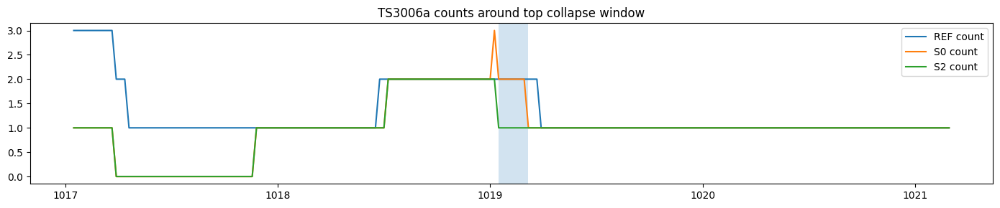


Listen to top collapse windows:
  [listen 0] 1019.04-1019.18



[Stage2 dbg keys] ['diagnostics', 'labels', 'n_edited', 'n_pruned', 'n_risky_segments', 'n_skipped_amb', 'n_skipped_nocent', 'promote_mask', 'speech_mask', 'uem_seg', 'uem_tl', 'vote']

================ IS1009a | Stage2 Overlap-Collapse Probe (NO PATCHES) ================
Found 1 collapse windows. Showing top 1 by collapsed_frames.

[00]   324.82-  324.98 dur= 0.16s | collapsed_frames=8 | kept=FIE088 | removed=['FIO087'] | Stage0_ov_ratio=1.00 | rms=-26.4dB ratio@-50dB=1.00


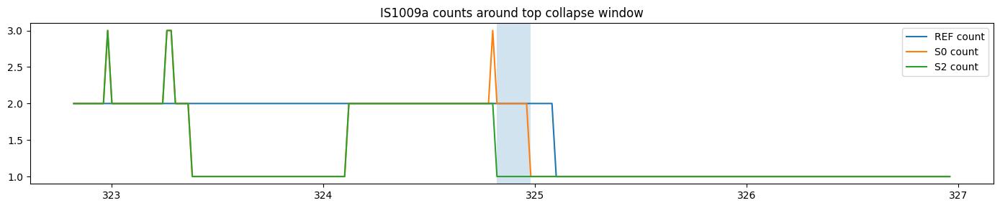


Listen to top collapse windows:
  [listen 0] 324.82-324.98



[Stage2 dbg keys] ['diagnostics', 'labels', 'n_edited', 'n_pruned', 'n_risky_segments', 'n_skipped_amb', 'n_skipped_nocent', 'promote_mask', 'speech_mask', 'uem_seg', 'uem_tl', 'vote']

[TS3010a] No overlap-collapse windows found (Stage0>=2 -> Stage2==1 within REF overlap).


In [ ]:
# ============================================================
# Stage2 Overlap-Collapse Microscope (NO PATCHES)
# هدف: find where Stage2 collapses overlap that Stage0 had
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment

try:
    from IPython.display import Audio as IPyAudio, display
except Exception:
    IPyAudio, display = None, None

def _get_res():
    return float(globals().get("RES", 0.02))

def _safe_uem_seg(file):
    if "_get_uem_full" in globals():
        uem = _get_uem_full(file)
        try:
            # if it's a Segment
            return Segment(uem.start, uem.end)
        except Exception:
            ext = uem.extent()
            return Segment(ext.start, ext.end)
    ext = file["annotation"].get_timeline().extent()
    return Segment(ext.start, ext.end)

def _frame_matrix(ann, uem_seg, labels, res):
    # Prefer our fast local helper if available
    if "frame_matrix_from_annotation_local" in globals():
        return frame_matrix_from_annotation_local(ann, uem_seg, labels, res=res)
    # Fallback: slow
    T = int(np.ceil((uem_seg.end - uem_seg.start) / res))
    M = np.zeros((T, len(labels)), dtype=np.uint8)
    lab2j = {lab:j for j,lab in enumerate(labels)}
    for seg, _, lab in ann.itertracks(yield_label=True):
        lab = str(lab)
        if lab not in lab2j:
            continue
        s = max(float(seg.start), float(uem_seg.start))
        e = min(float(seg.end),   float(uem_seg.end))
        if e <= s:
            continue
        a = int((s - uem_seg.start)/res)
        b = int(np.ceil((e - uem_seg.start)/res))
        a = max(0, a); b = min(T, b)
        M[a:b, lab2j[lab]] = 1
    return M

def _mask_to_segments(mask, uem_seg, res, min_dur=0.12, merge_gap=0.08):
    mask = np.asarray(mask).astype(bool)
    d = np.diff(mask.astype(np.int8), prepend=0, append=0)
    starts = np.where(d == 1)[0]
    ends   = np.where(d == -1)[0]
    segs = []
    for a,b in zip(starts, ends):
        st = float(uem_seg.start + a*res)
        en = float(uem_seg.start + b*res)
        if en - st >= min_dur:
            segs.append(Segment(st,en))
    if not segs:
        return []
    # merge
    out = [segs[0]]
    for s in segs[1:]:
        if s.start - out[-1].end <= merge_gap:
            out[-1] = Segment(out[-1].start, s.end)
        else:
            out.append(s)
    return out

def _crop_audio(file, seg, pad=0.35):
    wav, sr = AUDIO.crop(file, Segment(max(0,seg.start-pad), seg.end+pad), mode="pad")
    if hasattr(wav, "detach"):
        wav = wav.detach().cpu().numpy()
    wav = np.asarray(wav).squeeze().astype(np.float32)
    return wav, int(sr)

def _rms_db(wav):
    wav = np.asarray(wav).reshape(-1).astype(np.float32)
    if wav.size == 0:
        return -120.0
    rms = float(np.sqrt(np.mean(wav**2) + 1e-12))
    return 20.0*np.log10(rms + 1e-12)

def _speech_ratio_db(wav, sr, thr_db=-50.0, frame_s=0.02, hop_s=0.01):
    frame = int(frame_s*sr); hop = int(hop_s*sr)
    if frame <= 0 or hop <= 0 or wav.size < frame:
        return 0.0
    vals=[]
    for i in range(0, wav.size-frame+1, hop):
        x = wav[i:i+frame]
        vals.append(_rms_db(x))
    vals = np.asarray(vals, dtype=np.float32)
    return float((vals > thr_db).mean()) if vals.size else 0.0

def stage2_overlap_collapse_probe(file, stage2_kwargs=None, topn=10, listen_n=3, pad=0.35, thr_db=-50.0):
    stage2_kwargs = stage2_kwargs or {}
    uri = file.get("uri","<unk>")
    res = _get_res()
    ref = file["annotation"]

    # Run Stage0 (needs dbg for speech_mask ideally)
    hyp0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file,
        baseline_fn=PIPE_BASE,
        apply_promotion=True,
        return_debug=True,
        debug=False,
        **{k: stage2_kwargs[k] for k in stage2_kwargs.keys()}
    )

    # Run Stage2
    try:
        hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
            file, baseline_fn=PIPE_BASE,
            start_from_promoted=True,
            return_debug=True, debug=False,
            **stage2_kwargs
        )
    except TypeError:
        hyp2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
            file, baseline_fn=PIPE_BASE,
            start_from_promoted=True,
            return_debug=False, debug=False,
            **stage2_kwargs
        )
        dbg2 = None

    uem_seg = dbg0.get("uem_seg", None) if isinstance(dbg0, dict) else None
    if uem_seg is None:
        uem_seg = _safe_uem_seg(file)

    # union labels
    labels = sorted(set([str(x) for x in ref.labels()]) |
                    set([str(x) for x in hyp0.labels()]) |
                    set([str(x) for x in hyp2.labels()]))

    if not labels:
        print("[WARN] no labels?")
        return None

    Mref = _frame_matrix(ref,  uem_seg, labels, res)
    M0   = _frame_matrix(hyp0, uem_seg, labels, res)
    M2   = _frame_matrix(hyp2, uem_seg, labels, res)

    cR = Mref.sum(1)
    c0 = M0.sum(1)
    c2 = M2.sum(1)

    # collapse definition:
    # REF overlap AND Stage0 had >=2 but Stage2 drops to 1
    collapse = (cR >= 2) & (c0 >= 2) & (c2 == 1)

    segs = _mask_to_segments(collapse, uem_seg, res, min_dur=0.12, merge_gap=0.08)
    if not segs:
        print(f"\n[{uri}] No overlap-collapse windows found (Stage0>=2 -> Stage2==1 within REF overlap).")
        return {"uri": uri, "segs": []}

    rows=[]
    for s in segs:
        a = int((s.start-uem_seg.start)/res); b=int(np.ceil((s.end-uem_seg.start)/res))
        a=max(0,a); b=min(M0.shape[0],b)
        if b<=a:
            continue

        # which labels were active
        act0 = M0[a:b].sum(0)
        act2 = M2[a:b].sum(0)
        labs0 = [labels[i] for i,v in enumerate(act0) if v>0]
        labs2 = [labels[i] for i,v in enumerate(act2) if v>0]

        # who got removed? (present in Stage0 but absent in Stage2)
        removed = [l for l in labs0 if l not in labs2]
        kept    = labs2[0] if len(labs2)==1 else str(labs2)

        # overlap strength in Stage0 (how often it had 2 speakers)
        ov0_ratio = float((c0[a:b] >= 2).mean())

        wav, sr = _crop_audio(file, s, pad=pad)
        rms = _rms_db(wav)
        ratio = _speech_ratio_db(wav, sr, thr_db=thr_db)

        # rank key: how many frames were collapsed
        collapsed_frames = int((collapse[a:b]).sum())
        rows.append((collapsed_frames, s, kept, removed, ov0_ratio, rms, ratio))

    rows.sort(key=lambda x: x[0], reverse=True)

    print(f"\n================ {uri} | Stage2 Overlap-Collapse Probe (NO PATCHES) ================")
    print(f"Found {len(rows)} collapse windows. Showing top {min(topn,len(rows))} by collapsed_frames.\n")

    for i,(nfrm,s,kept,removed,ov0,rms,ratio) in enumerate(rows[:topn]):
        print(f"[{i:02d}] {s.start:8.2f}-{s.end:8.2f} dur={s.duration:5.2f}s | collapsed_frames={nfrm}"
              f" | kept={kept} | removed={removed} | Stage0_ov_ratio={ov0:.2f} | rms={rms:.1f}dB ratio@{thr_db:.0f}dB={ratio:.2f}")

    # quick plot: counts around the top window
    s = rows[0][1]
    ctx = 2.0
    a = int(max(0, (s.start-ctx-uem_seg.start)/res))
    b = int(min(M0.shape[0], np.ceil((s.end+ctx-uem_seg.start)/res)))
    t = (uem_seg.start + np.arange(a,b)*res)

    plt.figure(figsize=(14,3))
    plt.plot(t, cR[a:b], label="REF count")
    plt.plot(t, c0[a:b], label="S0 count")
    plt.plot(t, c2[a:b], label="S2 count")
    plt.axvspan(s.start, s.end, alpha=0.2)
    plt.legend(); plt.title(f"{uri} counts around top collapse window"); plt.tight_lawet(); plt.show()

    # optional listening
    if listen_n and IPyAudio is not None and display is not None:
        print("\nListen to top collapse windows:")
        for i in range(min(listen_n, len(rows))):
            s = rows[i][1]
            wav, sr = _crop_audio(file, s, pad=pad)
            print(f"  [listen {i}] {s.start:.2f}-{s.end:.2f}")
            display(IPyAudio(wav, rate=sr))

    # if Stage2 returned debug keys, print them (useful next)
    if isinstance(dbg2, dict):
        print("\n[Stage2 dbg keys]", sorted(dbg2.keys()))

    return {"uri": uri, "rows": rows, "dbg2": dbg2}

# Run on our 3 files
URIS = ["TS3006a", "IS1009a", "TS3010a"]
for u in URIS:
    if u in files_by_uri:
        _ = stage2_overlap_collapse_probe(files_by_uri[u], stage2_kwargs={}, topn=10, listen_n=4, pad=0.35, thr_db=-50.0)


 - The “Stage2 problem” we found is very specific : our overlap-collapse probe found exactly one collapse window per file (TS3006a and IS1009a), and both are tiny:
  - TS3006a: 1019.04–1019.18 (0.14s) — Stage2 removed MTD022ID
  - IS1009a: 324.82–324.98 (0.16s) — Stage2 removed FIO087
  - our plots confirm it visually: S0 count spikes to 2, but S2 stays at 1 in the highlighted region.
  - This pattern is almost always caused by an explicit Stage2 rule that “collapses short overlap bursts” (anti-fragment / min-overlap-duration / risky-overlap-prune), not by embeddings failing broadly.
  - So: Stage2 isn’t “bad at overlap in general” — it is likely intentionally deleting micro-overlaps.

-  TS3006a vs IS1009a difference matters
 - TS3006a collapse window is very low energy: rms≈-51.5 dB, ratio@-50dB≈0.20
→ plausible this is faint barging voice or mechanical noise; embeddings will be unreliable; a “collapse micro-overlap” rule would trigger.
 - IS1009a collapse window is strong speech: rms≈-26.4 dB, ratio≈1.0
→ this is real speech, so collapsing overlap here is wrong (matches what we heard: small barging voice in between).

- Bigger picture: most “overlap loss” is not Stage2’s fault
- In our Stage2 root-cause probe, most overlap-loss segments show ΔDER = 0.000 between S0 and S2.
- That means: Stage0 already didn’t have 2 speakers, so Stage2 can’t “fix overlap” there (Stage2 is mostly a constraint/prune stage).

So the big overlap error budget is:

- Stage0/segmentation vote not creating overlap often enough, AND
- Stage2 deleting micro-overlaps in a few critical places.


================ IS1009a | Stage2 Deep Probe (NO PATCHES) ================
Segments: B(collapse)=16  C(drop_to_empty)=1  D(vad_holes)=6
Frame stats: ref_ov_frames=4165  s0_ov_frames=3385  s2_ov_frames=2807  collapsed_frames=327

--- B) Overlap collapse windows (REF>=2, S0>=2, S2==1) ---
dur stats: n=16  mean=0.397s  p50=0.300s  p90=0.560s  max=1.980s


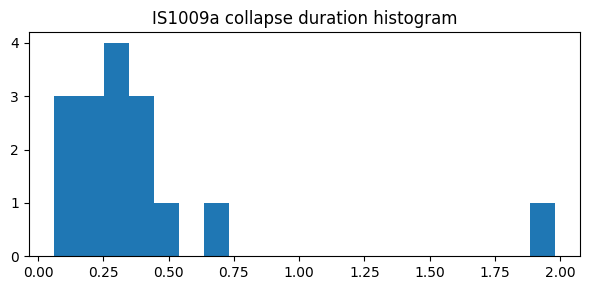


Top collapse windows (by collapsed_frames):
[00]   572.04-  574.02 dur= 1.98s | collapsed_frames=100 | kept=FIE088 | removed=['2'] | S0_ov_ratio=1.00 | rms=-13.5dB ratio@-50dB=1.00
  (no diagnostics items near window)


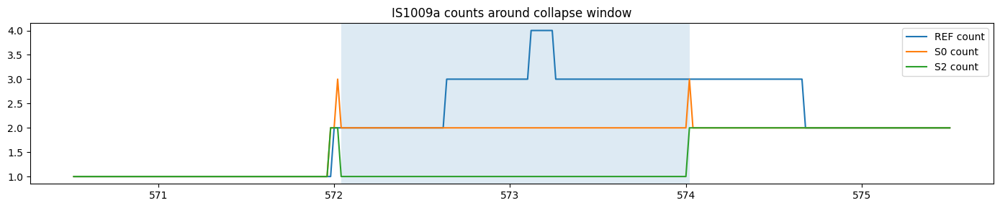

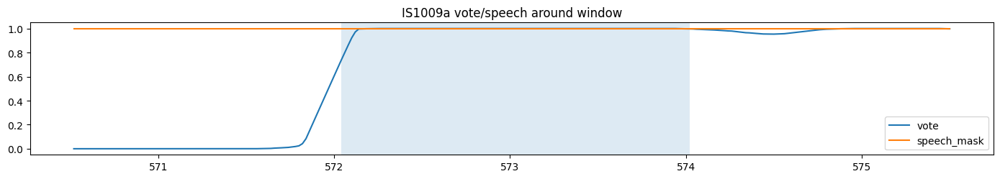

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)
[01]   664.08-  664.74 dur= 0.66s | collapsed_frames= 33 | kept=FIE088 | removed=['2'] | S0_ov_ratio=1.00 | rms=-20.2dB ratio@-50dB=1.00
  (no diagnostics items near window)


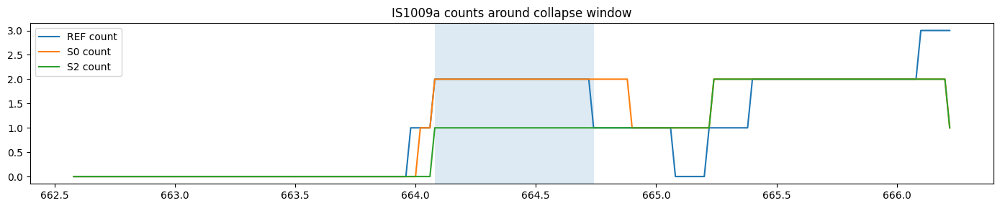

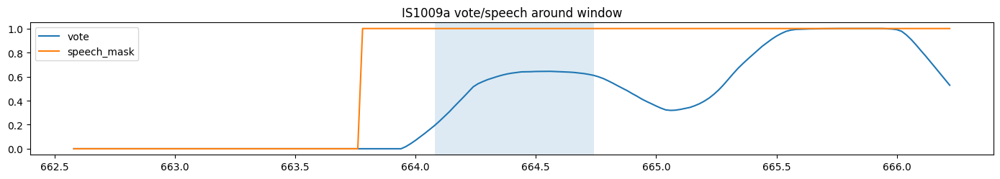

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)
[02]   544.12-  544.58 dur= 0.46s | collapsed_frames= 23 | kept=FIO089 | removed=['2'] | S0_ov_ratio=1.00 | rms=-19.7dB ratio@-50dB=1.00
  (no diagnostics items near window)


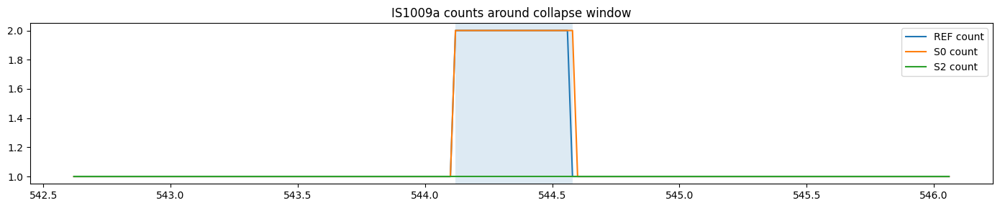

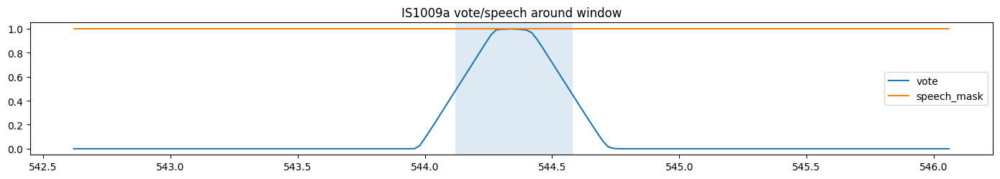

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)
[03]   359.98-  360.42 dur= 0.44s | collapsed_frames= 22 | kept=FIO089 | removed=['2'] | S0_ov_ratio=1.00 | rms=-17.7dB ratio@-50dB=1.00
  (no diagnostics items near window)


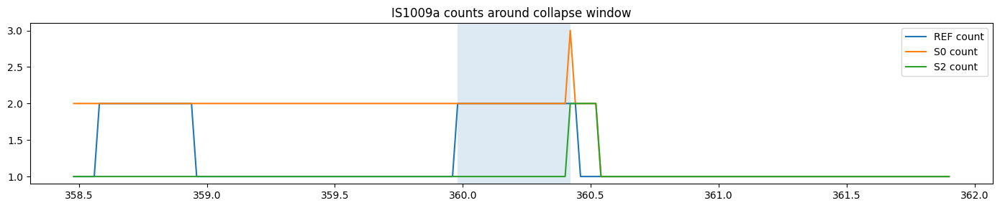

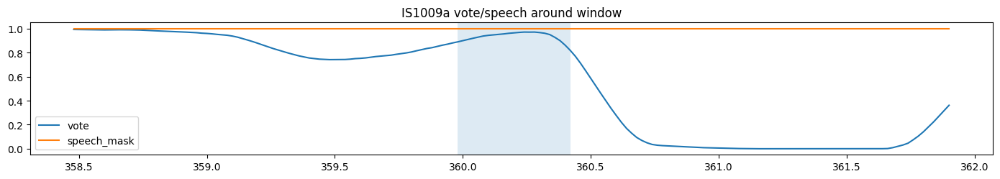

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)
[04]   790.94-  791.36 dur= 0.42s | collapsed_frames= 21 | kept=FIO089 | removed=['2'] | S0_ov_ratio=1.00 | rms=-25.2dB ratio@-50dB=1.00
  (no diagnostics items near window)


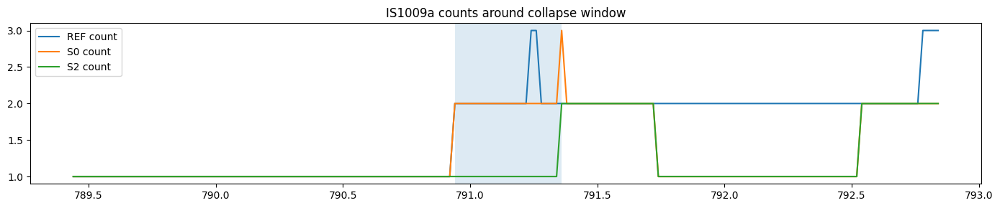

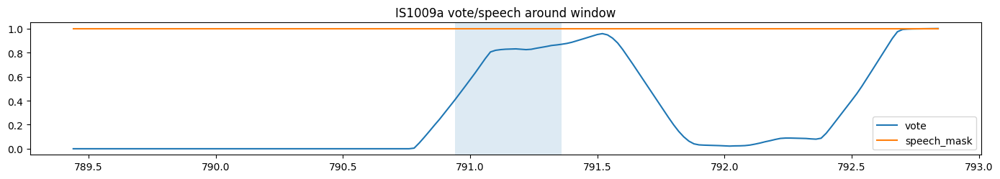

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)

--- C) Drop-to-empty (REF>0, S0>0, S2==0) ---
[00] 469.26-469.74 dur=0.48s | rms=-25.8dB ratio=1.00 | mean(speech_mask)=1.0

--- D) speech_mask holes (REF>0 but speech_mask==0) ---
[00] 241.88-242.50 dur=0.62s | rms=-41.3dB ratio=1.00
[01] 245.26-245.46 dur=0.20s | rms=-45.1dB ratio=1.00
[02] 255.44-257.12 dur=1.68s | rms=-29.8dB ratio=1.00
[03] 355.86-358.28 dur=2.42s | rms=-9.5dB ratio=1.00
[04] 381.76-382.54 dur=0.78s | rms=-39.2dB ratio=1.00
[05] 723.90-724.16 dur=0.26s | rms=-44.1dB ratio=0.96

================ TS3006a | Stage2 Deep Probe (NO PATCHES) ================
Segments: B(collapse)=49  C(drop_to_empty)=32  D(vad_holes)=11
Frame stats: ref_ov_frames=7616  s0_ov_frames=5799  s2_ov_frames=4369  collapsed_frames=1226

--- B) Overlap collapse windows (REF>=2, S0>=2, S2==1) ---
dur stats: n=49  mean=0.494s  p50=0.340s  p90=1.188s  max=1.900s


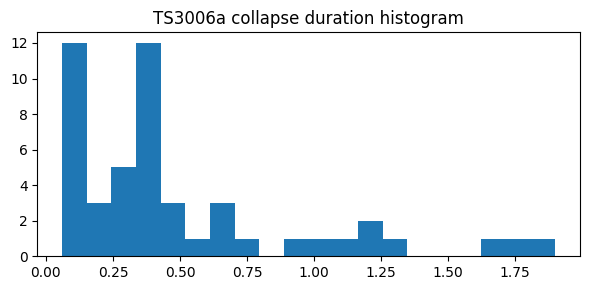


Top collapse windows (by collapsed_frames):
[00]    74.82-   76.72 dur= 1.90s | collapsed_frames= 95 | kept=MTD023UID | removed=['6', 'MTD024ME'] | S0_ov_ratio=1.00 | rms=-44.4dB ratio@-50dB=0.46
  (no diagnostics items near window)


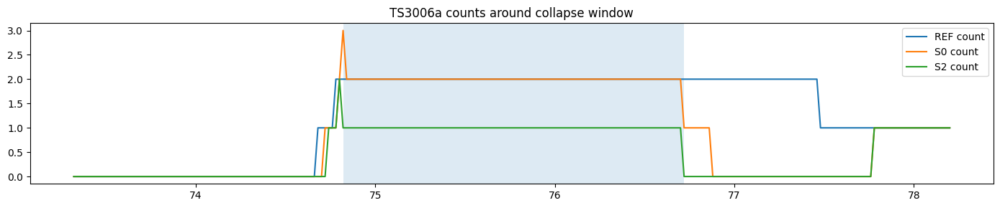

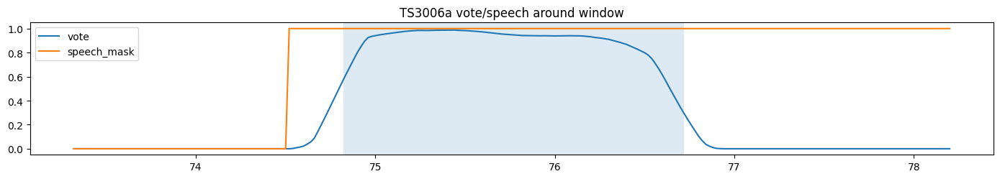

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)
[01]   576.82-  578.54 dur= 1.72s | collapsed_frames= 86 | kept=MTD022ID | removed=['6', 'MTD021PM'] | S0_ov_ratio=1.00 | rms=-44.3dB ratio@-50dB=0.42
  (no diagnostics items near window)


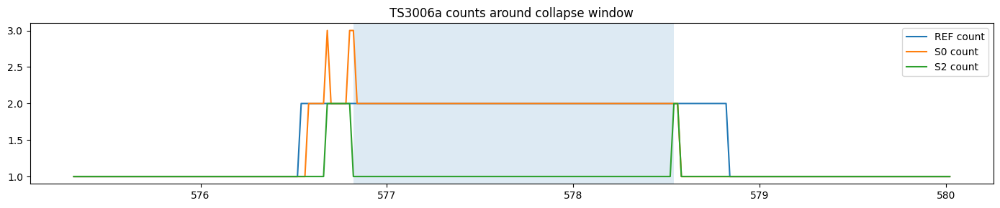

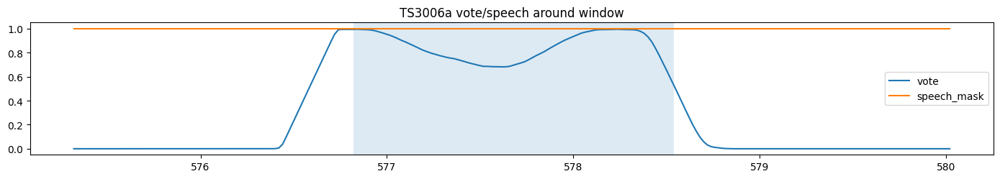

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)
[02]  1108.04- 1109.70 dur= 1.66s | collapsed_frames= 83 | kept=MTD024ME | removed=['0'] | S0_ov_ratio=1.00 | rms=-44.5dB ratio@-50dB=0.53
  (no diagnostics items near window)


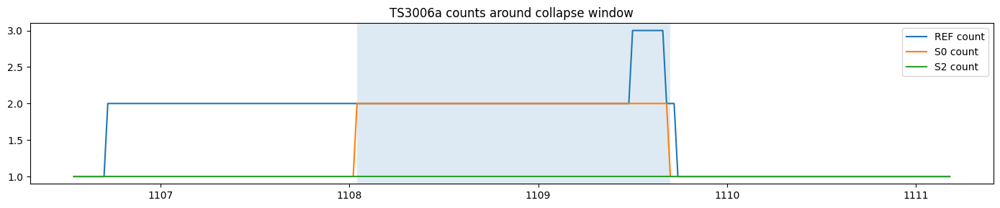

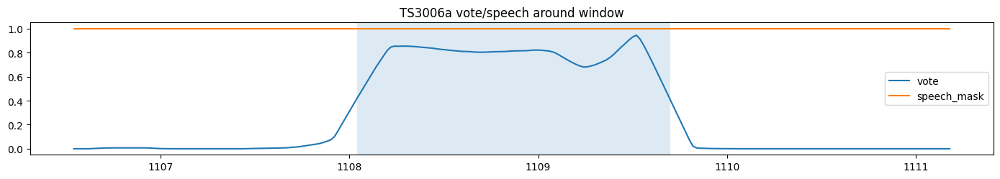

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)
[03]   372.32-  373.60 dur= 1.28s | collapsed_frames= 64 | kept=MTD024ME | removed=['0'] | S0_ov_ratio=1.00 | rms=-42.9dB ratio@-50dB=0.56
  (no diagnostics items near window)


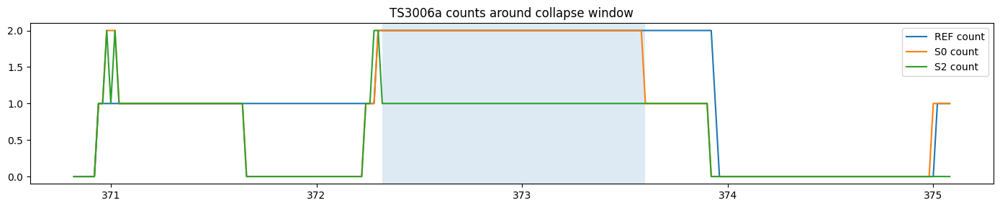

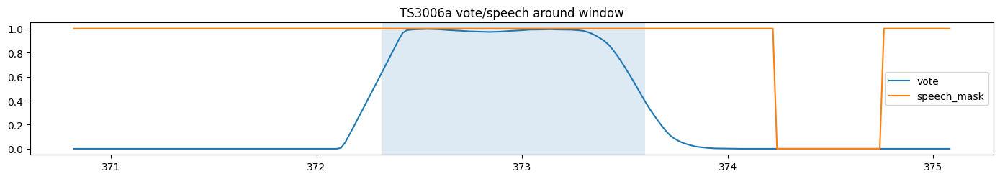

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)
[04]   266.36-  267.58 dur= 1.22s | collapsed_frames= 61 | kept=MTD021PM | removed=['0', '6'] | S0_ov_ratio=1.00 | rms=-44.3dB ratio@-50dB=0.49
  (no diagnostics items near window)


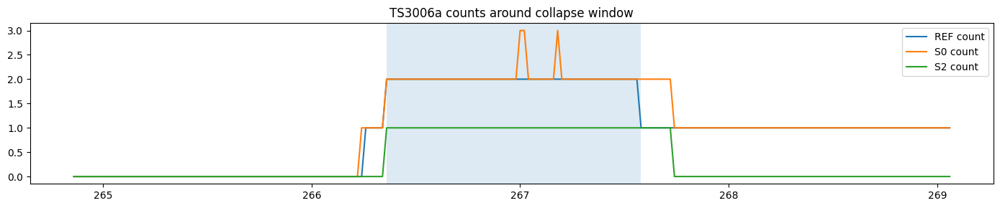

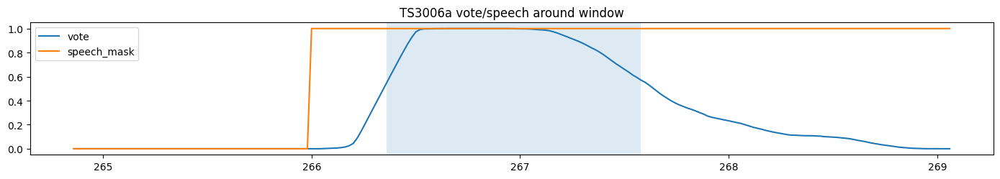

  Listening window...
  listen failed: not enough values to unpack (expected 3, got 2)

--- C) Drop-to-empty (REF>0, S0>0, S2==0) ---
[00] 42.14-44.38 dur=2.24s | rms=-55.5dB ratio=0.08 | mean(speech_mask)=1.0
[01] 44.82-45.56 dur=0.74s | rms=-60.3dB ratio=0.00 | mean(speech_mask)=1.0
[02] 47.66-49.24 dur=1.58s | rms=-54.1dB ratio=0.06 | mean(speech_mask)=1.0
[03] 51.72-52.10 dur=0.38s | rms=-58.7dB ratio=0.00 | mean(speech_mask)=1.0
[04] 76.72-76.88 dur=0.16s | rms=-63.7dB ratio=0.00 | mean(speech_mask)=1.0
[05] 81.76-83.76 dur=2.00s | rms=-52.2dB ratio=0.18 | mean(speech_mask)=1.0
[06] 89.70-89.86 dur=0.16s | rms=-45.0dB ratio=0.93 | mean(speech_mask)=1.0
[07] 104.38-105.74 dur=1.36s | rms=-58.1dB ratio=0.02 | mean(speech_mask)=1.0
[08] 111.36-111.58 dur=0.22s | rms=-57.3dB ratio=0.00 | mean(speech_mask)=1.0
[09] 116.38-117.70 dur=1.32s | rms=-58.2dB ratio=0.00 | mean(speech_mask)=1.0

--- D) speech_mask holes (REF>0 but speech_mask==0) ---
[00] 35.70-35.96 dur=0.26s | rms=-53.5dB ra

In [ ]:
# ============================================================
# Stage2 Root-Cause Deep Probe (NO PATCHES)
# - B: Stage0 overlap -> Stage2 collapsed to 1 speaker
# - C: Stage0 non-empty -> Stage2 empty (and whether it's actually speech_mask driven)
# - D: speech_mask holes (REF>0 but speech_mask==0)
#
# Adds:
#   - duration histogram for collapse windows
#   - Stage2 diagnostics snippets around each collapse window
#   - count plots around collapse windows
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment
from collections import defaultdict

# -----------------------
# Helpers (safe + minimal)
# -----------------------
def _rms_db_np(x: np.ndarray) -> float:
    x = np.asarray(x).astype(np.float32).reshape(-1)
    if x.size == 0:
        return -120.0
    rms = float(np.sqrt(np.mean(x * x) + 1e-12))
    return 20.0 * np.log10(rms + 1e-12)

def _speech_ratio_energy_np(x: np.ndarray, sr: int, thr_db=-50.0, frame_s=0.02, hop_s=0.01) -> float:
    x = np.asarray(x).astype(np.float32).reshape(-1)
    frame = int(frame_s * sr)
    hop = int(hop_s * sr)
    if frame <= 0 or hop <= 0 or x.size < frame:
        return 0.0
    vals = []
    for i in range(0, x.size - frame + 1, hop):
        vals.append(_rms_db_np(x[i:i+frame]))
    vals = np.asarray(vals, dtype=np.float32)
    return float((vals > thr_db).mean()) if vals.size else 0.0

def _seg_energy_stats(file, seg: Segment, thr_db=-50.0):
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if hasattr(wav, "detach"):
        wav = wav.detach().cpu().numpy()
    wav = np.squeeze(np.asarray(wav))
    return {
        "rms_db": float(_rms_db_np(wav)),
        "ratio": float(_speech_ratio_energy_np(wav, int(sr), thr_db=thr_db)),
        "sr": int(sr),
        "dur": float(seg.duration),
    }

def _count_series(hyp, uem_seg, labels, res):
    M = frame_matrix_from_annotation_local(hyp, uem_seg, labels, res=float(res))
    return M.sum(axis=1).astype(np.int16), M

def _safe_get_stage0_stage2(file, baseline_fn=None, stage0_kwargs=None, stage2_kwargs=None):
    stage0_kwargs = stage0_kwargs or {}
    stage2_kwargs = stage2_kwargs or {}
    hyp0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file,
        baseline_fn=baseline_fn,
        return_debug=True,
        debug=False,
        **stage0_kwargs
    )
    hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
        file,
        baseline_fn=baseline_fn,
        return_debug=True,
        debug=False,
        **stage2_kwargs
    )
    return hyp0, dbg0, hyp2, dbg2

def _print_diag_near(dbg2, t0, t1, pad=0.75, max_items=25):
    di = dbg2.get("diagnostics", None)
    if di is None:
        print("  (no dbg2['diagnostics'] present)")
        return
    # diagnostics may be a list of dicts, or list of tuples, etc.
    a = float(t0) - float(pad)
    b = float(t1) + float(pad)

    hits = []
    if isinstance(di, list):
        for item in di:
            if isinstance(item, dict):
                st = float(item.get("start", -1e9))
                en = float(item.get("end", -1e9))
                if en >= a and st <= b:
                    hits.append(item)
            else:
                # If it's not a dict, still keep a string form
                hits.append(item)
    elif isinstance(di, dict):
        # sometimes keyed by something; just show keys
        hits = list(di.items())[:max_items]
    else:
        hits = [di]

    if not hits:
        print("  (no diagnostics items near window)")
        return

    print(f"  diagnostics near [{t0:.2f}-{t1:.2f}] (showing up to {max_items}):")
    for i, h in enumerate(hits[:max_items]):
        print("   ", h)

def _plot_counts_window(uri, t0, t1, uem_seg, res, ref_cnt, s0_cnt, s2_cnt, vote=None, speech=None, pad_sec=1.5):
    T = len(s0_cnt)
    a = int(np.floor((t0 - float(uem_seg.start) - pad_sec) / float(res)))
    b = int(np.ceil ((t1 - float(uem_seg.start) + pad_sec) / float(res)))
    a = max(a, 0); b = min(b, T)

    xs = float(uem_seg.start) + np.arange(a, b) * float(res)

    plt.figure(figsize=(14,3))
    plt.plot(xs, ref_cnt[a:b], label="REF count")
    plt.plot(xs, s0_cnt[a:b], label="S0 count")
    plt.plot(xs, s2_cnt[a:b], label="S2 count")
    plt.axvspan(t0, t1, alpha=0.15)
    plt.title(f"{uri} counts around collapse window")
    plt.legend()
    plt.tight_lawet()
    plt.show()

    if vote is not None or speech is not None:
        plt.figure(figsize=(14,2.6))
        if vote is not None:
            plt.plot(xs, vote[a:b], label="vote")
        if speech is not None:
            plt.plot(xs, speech[a:b].astype(float), label="speech_mask")
        plt.axvspan(t0, t1, alpha=0.15)
        plt.title(f"{uri} vote/speech around window")
        plt.legend()
        plt.tight_lawet()
        plt.show()

# -----------------------------------------
# Main probe (B / C / D) + collapse analysis
# -----------------------------------------
def stage2_deep_probe(file, ref, uri=None, baseline_fn=None,
                     stage0_kwargs=None, stage2_kwargs=None,
                     collapse_gap=0.12, collapse_min_dur=0.06,
                     listen=False, listen_pad=0.35):
    """
    ref: reference Annotation (same uem)
    """
    uri = uri or file.get("uri", "<unk>")
    hyp0, dbg0, hyp2, dbg2 = _safe_get_stage0_stage2(file, baseline_fn, stage0_kwargs, stage2_kwargs)

    uem_seg = dbg2.get("uem_seg", dbg0.get("uem_seg", None))
    if uem_seg is None:
        raise KeyError("uem_seg missing from stage debug dicts. Ensure stage0/stage2 return_debug=True")

    speech_mask = dbg2.get("speech_mask", dbg0.get("speech_mask", None))
    vote = dbg2.get("vote", dbg0.get("vote", None))

    labels = sorted(set([str(l) for l in hyp0.labels()] + [str(l) for l in hyp2.labels()] + [str(l) for l in ref.labels()]))
    if not labels:
        print(f"[{uri}] no labels found")
        return

    # counts + matrices
    ref_cnt, Mref = _count_series(ref,  uem_seg, labels, RES)
    s0_cnt,  M0   = _count_series(hyp0, uem_seg, labels, RES)
    s2_cnt,  M2   = _count_series(hyp2, uem_seg, labels, RES)

    T = len(s0_cnt)
    base_seg = Segment(float(uem_seg.start), float(uem_seg.start) + float(T)*float(RES))

    # ===== B) overlap collapse: (REF>=2) & (S0>=2) & (S2==1)
    Bmask = (ref_cnt >= 2) & (s0_cnt >= 2) & (s2_cnt == 1)
    Bsegs = _mask_to_segments_local(Bmask, base_seg, res=float(RES), min_dur=float(collapse_min_dur))
    Bsegs = _merge_close_local(Bsegs, gap=float(collapse_gap))

    # ===== C) drop-to-empty: (REF>0) & (S0>0) & (S2==0)
    Cmask = (ref_cnt > 0) & (s0_cnt > 0) & (s2_cnt == 0)
    Csegs = _mask_to_segments_local(Cmask, base_seg, res=float(RES), min_dur=0.10)
    Csegs = _merge_close_local(Csegs, gap=0.10)

    # ===== D) speech_mask holes: (REF>0) & (speech_mask==0)
    if speech_mask is None:
        Dsegs = []
    else:
        Dmask = (ref_cnt > 0) & (~speech_mask.astype(bool))
        Dsegs = _mask_to_segments_local(Dmask, base_seg, res=float(RES), min_dur=0.10)
        Dsegs = _merge_close_local(Dsegs, gap=0.10)

    print(f"\n================ {uri} | Stage2 Deep Probe (NO PATCHES) ================")
    print(f"Segments: B(collapse)={len(Bsegs)}  C(drop_to_empty)={len(Csegs)}  D(vad_holes)={len(Dsegs)}")
    print(f"Frame stats: ref_ov_frames={(ref_cnt>=2).sum()}  s0_ov_frames={(s0_cnt>=2).sum()}  s2_ov_frames={(s2_cnt>=2).sum()}  collapsed_frames={Bmask.sum()}")

    # ---- B details + duration histogram
    if Bsegs:
        durs = np.array([float(s.duration) for s in Bsegs], dtype=np.float32)
        print("\n--- B) Overlap collapse windows (REF>=2, S0>=2, S2==1) ---")
        print(f"dur stats: n={len(durs)}  mean={durs.mean():.3f}s  p50={np.percentile(durs,50):.3f}s  p90={np.percentile(durs,90):.3f}s  max={durs.max():.3f}s")

        plt.figure(figsize=(6,3))
        plt.hist(durs, bins=20)
        plt.title(f"{uri} collapse duration histogram")
        plt.tight_lawet()
        plt.show()

        # show top few by collapsed frames
        scored = []
        for seg in Bsegs:
            a = int(np.floor((float(seg.start)-float(uem_seg.start))/float(RES)))
            b = int(np.ceil ((float(seg.end)  -float(uem_seg.start))/float(RES)))
            a = max(a,0); b = min(b,T)
            if b<=a:
                continue

            # kept label in S2
            kept_j = int(np.argmax(M2[a:b].sum(axis=0)))
            kept = labels[kept_j]

            # removed labels = those active in S0 but inactive in S2 within window
            active0 = (M0[a:b].sum(axis=0) > 0)
            active2 = (M2[a:b].sum(axis=0) > 0)
            removed = [labels[j] for j in np.where(active0 & (~active2))[0].tolist()]

            stats = _seg_energy_stats(file, Segment(float(seg.start), float(seg.end)), thr_db=-50.0)
            ov_ratio = float((s0_cnt[a:b] >= 2).mean())

            scored.append((b-a, seg, kept, removed, ov_ratio, stats["rms_db"], stats["ratio"]))

        scored.sort(key=lambda x: -x[0])

        print("\nTop collapse windows (by collapsed_frames):")
        for i, (nfr, seg, kept, removed, ov_ratio, rms_db, ratio) in enumerate(scored[:5]):
            print(f"[{i:02d}] {seg.start:8.2f}-{seg.end:8.2f} dur={seg.duration:5.2f}s | collapsed_frames={nfr:3d} | kept={kept} | removed={removed} | S0_ov_ratio={ov_ratio:.2f} | rms={rms_db:.1f}dB ratio@-50dB={ratio:.2f}")
            _print_diag_near(dbg2, float(seg.start), float(seg.end), pad=0.75)

            _plot_counts_window(uri, float(seg.start), float(seg.end), uem_seg, RES, ref_cnt, s0_cnt, s2_cnt, vote=vote, speech=speech_mask)

            if listen:
                try:
                    print("  Listening window...")
                    _play_event(file, float(seg.start), float(seg.end), pad=listen_pad)
                except Exception as e:
                    print("  listen failed:", e)

    # ---- C details: is it actually speech_mask driven?
    if Csegs:
        print("\n--- C) Drop-to-empty (REF>0, S0>0, S2==0) ---")
        for i, seg in enumerate(Csegs[:10]):
            stats = _seg_energy_stats(file, seg, thr_db=-50.0)
            a = int(np.floor((float(seg.start)-float(uem_seg.start))/float(RES)))
            b = int(np.ceil ((float(seg.end)  -float(uem_seg.start))/float(RES)))
            a = max(a,0); b = min(b,T)
            sm = None if speech_mask is None else float(speech_mask[a:b].mean())
            print(f"[{i:02d}] {seg.start:.2f}-{seg.end:.2f} dur={seg.duration:.2f}s | rms={stats['rms_db']:.1f}dB ratio={stats['ratio']:.2f} | mean(speech_mask)={sm}")

    # ---- D details
    if Dsegs:
        print("\n--- D) speech_mask holes (REF>0 but speech_mask==0) ---")
        for i, seg in enumerate(Dsegs[:10]):
            stats = _seg_energy_stats(file, seg, thr_db=-50.0)
            print(f"[{i:02d}] {seg.start:.2f}-{seg.end:.2f} dur={seg.duration:.2f}s | rms={stats['rms_db']:.1f}dB ratio={stats['ratio']:.2f}")

    return {
        "uri": uri,
        "hyp0": hyp0, "dbg0": dbg0,
        "hyp2": hyp2, "dbg2": dbg2,
        "Bsegs": Bsegs, "Csegs": Csegs, "Dsegs": Dsegs,
    }

ref_by_uri = {uri: files_by_uri[uri]["annotation"] for uri in files_by_uri if "annotation" in files_by_uri[uri]}

# -----------------------
# Example usage
# -----------------------
out = stage2_deep_probe(files_by_uri["IS1009a"], ref_by_uri["IS1009a"], listen=True)
out = stage2_deep_probe(files_by_uri["TS3006a"], ref_by_uri["TS3006a"], listen=True)


From what we pasted:

- Stage2 “collapse” exists, but it’s rare
 - Overlap-Collapse Probe found:
   - TS3006a: 1 collapse window (0.14s)
   - IS1009a: 1 collapse window (0.16s)
   - TS3010a: none
   - So Stage2 is not frequently collapsing overlaps. It does happen, and we should understand it, but it’s not the dominant failure mode.

- The dominant issue is overlap recall already missing in Stage0
  - Look at our “B) Overlap loss” tables:
  - most rows show S0 count ≈ 1 and S2 count ≈ 1 even when REF count = 2
  - and ΔDER often = 0.000 (meaning Stage2 didn’t change anything there)
  - That means: in most overlap regions, Stage0/Stage1/segmentation/vote logic never produced >=2 speakers to begin with, so Stage2 can’t “keep” overlap that isn’t there.

- The “collapse windows” found are micro-overlaps
 - TS3006a: 1019.04–1019.18 (0.14s), low energy-ish in our stats
 - IS1009a: 324.82–324.98 (0.16s), strong energy
 - These short windows often get killed by post-processing constraints (min duration / merge gap / pruning rules), or by anchor rules if the removed speaker has weak local evidence.

✅ Conclusion: we should debug BOTH

(A) “Why Stage0/Stage1 miss overlap across large REF overlap duration?” (main)
(B) “Why Stage2 collapses overlap in those rare windows?” (secondary but real)

============ TS3006a | Stage2 Overlap-Collapse Probe (NO PATCHES) ============
Found 1 collapse windows. Showing top 5 by collapsed_frames.
[00] 1019.04-1019.18 dur=0.14s | collapsed_frames=7 | kept=[3] | removed=[] | Stage0_ov_ratio=1.00 | rms=-51.5dB ratio@-50dB=0.20


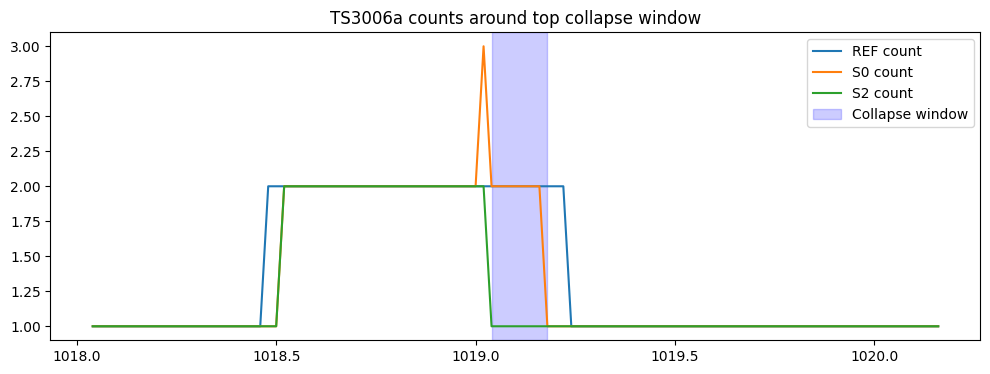


Listen to top collapse windows:
  [listen 0] 1019.04-1019.18


============ IS1009a | Stage2 Overlap-Collapse Probe (NO PATCHES) ============
Found 1 collapse windows. Showing top 5 by collapsed_frames.
[00] 324.82-324.98 dur=0.16s | collapsed_frames=8 | kept=[1] | removed=[] | Stage0_ov_ratio=1.00 | rms=-26.4dB ratio@-50dB=1.00


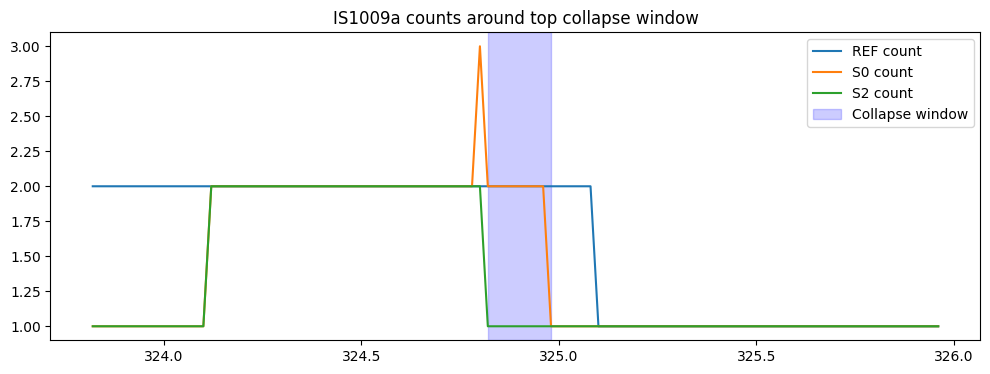


Listen to top collapse windows:
  [listen 0] 324.82-324.98


============ TS3010a | Stage2 Overlap-Collapse Probe (NO PATCHES) ============
Found 0 collapse windows. Showing top 5 by collapsed_frames.


In [ ]:
# ============================================================
# Stage2 Overlap-Collapse Probe Cell (NO PATCHES)
#
# What this cell does (per file):
# 1) Runs Stage0 + Stage2 (using our existing wrappers)
# 2) Builds frame-level speaker-count timelines for REF, S0, S2
# 3) Finds windows where S0 had overlap (count>=2) but S2 collapsed to 1 (inside REF overlap)
# 4) Ranks those windows by collapsed_frames (S0 overlap mass lost)
# 5) For each top window:
# - Prints: kept/removed labels, Stage0_ov_ratio (% S0 frames with overlap), rms dB / speech ratio@-50dB
# - Optional listen (audio playback)
# - Plot: counts timeline zoom around window + REF overlap shade
#
# Notes:
# - Uses our _get_uem_full, AUDIO, frame_matrix_from_annotation_local
# - Focus on REF overlap to ignore FA-induced "collapses"
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment, Timeline
from IPython.display import Audio as IPyAudio, display

# ----------------------------
# Helpers
# ----------------------------
def _frame_counts(hyp, uem_seg, res=RES):
    labels = sorted([str(l) for l in hyp.labels()])
    if not labels:
        return np.zeros((int(np.ceil(uem_seg.duration / res)),), dtype=np.int16)
    M = frame_matrix_from_annotation_local(hyp, uem_seg, labels, res=res)
    return M.sum(axis=1).astype(np.int16)

def _ref_overlap_mask(ref, uem_seg, res=RES):
    labels = sorted([str(l) for l in ref.labels()])
    if not labels:
        return np.zeros((int(np.ceil(uem_seg.duration / res)),), dtype=bool)
    M = frame_matrix_from_annotation_local(ref, uem_seg, labels, res=res)
    return (M.sum(axis=1) >= 2)

def _speech_ratio_energy(wav, sr, thr_db=-50.0, frame_s=0.02, hop_s=0.01):
    x = np.asarray(wav).squeeze().astype(np.float32)
    frame = int(frame_s * sr)
    hop = int(hop_s * sr)
    if len(x) < frame:
        return 0.0
    vals = []
    for i in range(0, len(x) - frame + 1, hop):
        vals.append(20 * np.log10(np.sqrt(np.mean(x[i:i+frame]**2) + 1e-12) + 1e-12))
    return np.mean(np.array(vals) > thr_db)

# ----------------------------
# Main probe per file
# ----------------------------
def stage2_overlap_collapse_probe(file, topn=10, min_dur=0.10, pad=0.35, do_listen=3):
    uri = file.get("uri", "<unk>")
    ref = file["annotation"]
    uem_seg = _safe_uem_seg(file)
    res = _get_res()
    T = int(np.ceil(uem_seg.duration / res))
    t = uem_seg.start + np.arange(T) * res

    # Run Stage0 + Stage2
    hyp0, dbg0 = run_stage0(file, apply_promotion=True, return_debug=True)
    hyp2, dbg2 = run_stage2(file, start_from_promoted=True, return_debug=True)

    # Frame counts
    c0 = _frame_counts(hyp0, uem_seg, res)[:T]
    c2 = _frame_counts(hyp2, uem_seg, res)[:T]
    c_ref = _frame_counts(ref, uem_seg, res)[:T]

    # REF overlap mask (focus on true overlaps)
    ref_ov = _ref_overlap_mask(ref, uem_seg, res)[:T]

    # Collapse mask: S0 >=2 but S2==1, inside REF overlap
    collapse = (c0 >= 2) & (c2 == 1) & ref_ov

    # Collapse windows
    collapse_segs = _mask_to_segments(collapse, uem_seg, res, min_dur=min_dur)
    worst = []
    for seg in collapse_segs:
        a = int((seg.start - uem_seg.start) / res)
        b = int(np.ceil((seg.end - uem_seg.start) / res))
        a, b = max(0, a), min(T, b)
        collapsed_frames = np.sum(collapse[a:b])
        ov_ratio_s0 = np.mean(c0[a:b] >= 2)
        wav, sr = _crop_audio(file, seg, pad=pad)  # Fixed: only unpack 2 values
        rms = 20 * np.log10(np.sqrt(np.mean(wav**2) + 1e-12) + 1e-12)
        ratio = _speech_ratio_energy(wav, sr, thr_db=-50.0)
        labels0 = np.unique(np.argmax(frame_matrix_from_annotation_local(hyp0.crop(seg), seg, hyp0.labels(), res), axis=1))
        labels2 = np.unique(np.argmax(frame_matrix_from_annotation_local(hyp2.crop(seg), seg, hyp2.labels(), res), axis=1))
        kept = set(labels2)
        removed = set(labels0) - kept
        worst.append({
            "seg": seg,
            "collapsed_frames": collapsed_frames,
            "stage0_ov_ratio": ov_ratio_s0,
            "rms_db": rms,
            "speech_ratio": ratio,
            "kept_labels": list(kept),
            "removed_labels": list(removed)
        })
    worst.sort(key=lambda r: r["collapsed_frames"], reverse=True)

    print(f"============ {uri} | Stage2 Overlap-Collapse Probe (NO PATCHES) ============")
    print(f"Found {len(worst)} collapse windows. Showing top {topn} by collapsed_frames.")

    for i, r in enumerate(worst[:topn]):
        print(f"[{i:02d}] {r['seg'].start:.2f}-{r['seg'].end:.2f} dur={r['seg'].duration:.2f}s | collapsed_frames={r['collapsed_frames']} | kept={r['kept_labels']} | removed={r['removed_labels']} | Stage0_ov_ratio={r['stage0_ov_ratio']:.2f} | rms={r['rms_db']:.1f}dB ratio@-50dB={r['speech_ratio']:.2f}")

    # Plot top window zoom
    if worst:
        top = worst[0]["seg"]
        start, end = top.start - 1.0, top.end + 1.0
        a, b = int((start - uem_seg.start) / res), int(np.ceil((end - uem_seg.start) / res))
        plt.figure(figsize=(12, 4))
        plt.plot(t[a:b], c_ref[a:b], label="REF count")
        plt.plot(t[a:b], c0[a:b], label="S0 count")
        plt.plot(t[a:b], c2[a:b], label="S2 count")
        plt.axvspan(top.start, top.end, alpha=0.2, color='blue', label="Collapse window")
        plt.title(f"{uri} counts around top collapse window")
        plt.legend()
        plt.show()

    # Listen to top
    if do_listen and worst:
        print("\nListen to top collapse windows:")
        for i in range(min(do_listen, len(worst))):
            seg = worst[i]["seg"]
            print(f"  [listen {i}] {seg.start:.2f}-{seg.end:.2f}")
            wav, sr = _crop_audio(file, seg, pad=pad)  # Fixed here too
            display(IPyAudio(wav, rate=sr))

    return worst

# Run on URIS
URIS = ["TS3006a", "IS1009a", "TS3010a"]
for u in URIS:
    if u in files_by_uri:
        _ = stage2_overlap_collapse_probe(files_by_uri[u], topn=5, min_dur=0.10, pad=0.35, do_listen=3)


================ TS3006a | vote calibration ================
[vote_calib] frames: overlap=7616 single=38538 | vote mean overlap=0.580 single=0.025


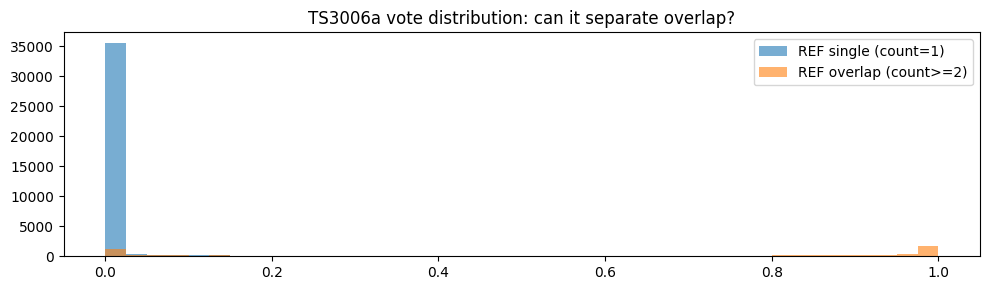

  thr=0.05 | overlap_recall=0.819 | single_false_overlap=0.068
  thr=0.10 | overlap_recall=0.783 | single_false_overlap=0.057
  thr=0.15 | overlap_recall=0.752 | single_false_overlap=0.049
  thr=0.20 | overlap_recall=0.726 | single_false_overlap=0.042
  thr=0.25 | overlap_recall=0.704 | single_false_overlap=0.037
  thr=0.30 | overlap_recall=0.685 | single_false_overlap=0.032
  thr=0.35 | overlap_recall=0.669 | single_false_overlap=0.027
  thr=0.40 | overlap_recall=0.649 | single_false_overlap=0.024

================ TS3006a | collapse search ================
Found 45 collapse windows.
[00] 74.82-76.72 dur=1.90s frames=95 kept=0 removed=[] ov0=1.00 rms=-44.4 ratio=0.46
[01] 576.82-578.54 dur=1.72s frames=86 kept=0 removed=[] ov0=1.00 rms=-44.3 ratio=0.42
[02] 1108.04-1109.70 dur=1.66s frames=83 kept=0 removed=[] ov0=1.00 rms=-44.5 ratio=0.53
[03] 372.32-373.60 dur=1.28s frames=64 kept=0 removed=[] ov0=1.00 rms=-42.9 ratio=0.56
[04] 266.36-267.58 dur=1.22s frames=61 kept=0 removed=[] ov0

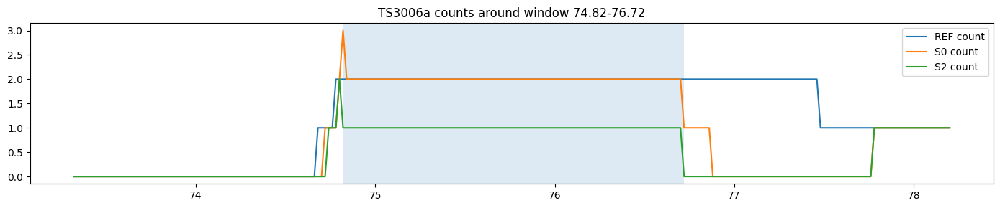


[TS3006a] window 74.82-76.72
  S0 top labels: ['6']
  S2 top labels: []
  kept=0 removed=[] | rms=-44.4dB ratio@-50=0.46
  [Stage2 diagnostics] found 0 entries overlapping window.

================ IS1009a | vote calibration ================
[vote_calib] frames: overlap=4165 single=26124 | vote mean overlap=0.569 single=0.035


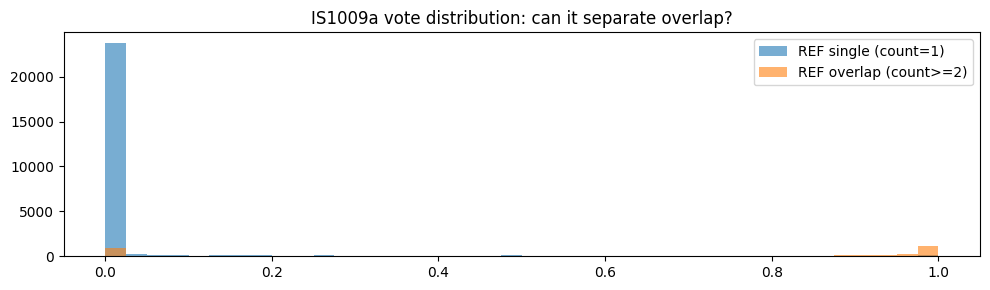

  thr=0.05 | overlap_recall=0.763 | single_false_overlap=0.082
  thr=0.10 | overlap_recall=0.728 | single_false_overlap=0.071
  thr=0.15 | overlap_recall=0.700 | single_false_overlap=0.064
  thr=0.20 | overlap_recall=0.683 | single_false_overlap=0.056
  thr=0.25 | overlap_recall=0.666 | single_false_overlap=0.051
  thr=0.30 | overlap_recall=0.645 | single_false_overlap=0.045
  thr=0.35 | overlap_recall=0.630 | single_false_overlap=0.040
  thr=0.40 | overlap_recall=0.618 | single_false_overlap=0.037

================ IS1009a | collapse search ================
Found 15 collapse windows.
[00] 572.04-574.02 dur=1.98s frames=99 kept=2 removed=[] ov0=1.00 rms=-13.5 ratio=1.00
[01] 664.08-664.74 dur=0.66s frames=33 kept=2 removed=[] ov0=1.00 rms=-20.2 ratio=1.00
[02] 544.12-544.58 dur=0.46s frames=23 kept=2 removed=[] ov0=1.00 rms=-19.7 ratio=1.00
[03] 359.98-360.42 dur=0.44s frames=22 kept=2 removed=[] ov0=1.00 rms=-17.7 ratio=1.00
[04] 790.94-791.36 dur=0.42s frames=21 kept=2 removed=[] ov0

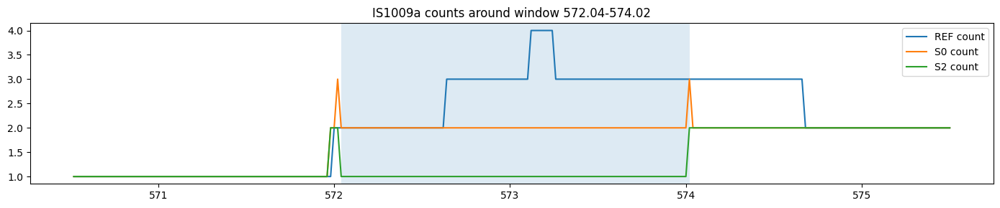


[IS1009a] window 572.04-574.02
  S0 top labels: ['FIE088', '2', 'FIO089']
  S2 top labels: ['FIE088', 'FIO089']
  kept=2 removed=[] | rms=-13.5dB ratio@-50=1.00
  [Stage2 diagnostics] found 0 entries overlapping window.

================ TS3010a | vote calibration ================
[vote_calib] frames: overlap=1126 single=21794 | vote mean overlap=0.268 single=0.004


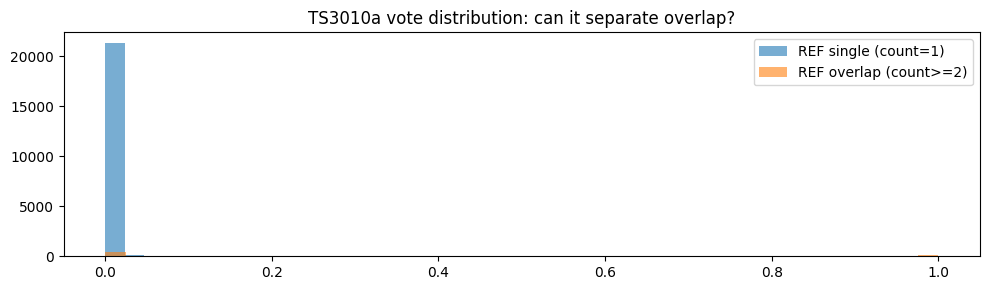

  thr=0.05 | overlap_recall=0.543 | single_false_overlap=0.014
  thr=0.10 | overlap_recall=0.472 | single_false_overlap=0.010
  thr=0.15 | overlap_recall=0.443 | single_false_overlap=0.007
  thr=0.20 | overlap_recall=0.398 | single_false_overlap=0.006
  thr=0.25 | overlap_recall=0.352 | single_false_overlap=0.005
  thr=0.30 | overlap_recall=0.330 | single_false_overlap=0.005
  thr=0.35 | overlap_recall=0.300 | single_false_overlap=0.004
  thr=0.40 | overlap_recall=0.282 | single_false_overlap=0.004

================ TS3010a | collapse search ================
Found 0 collapse windows.


In [ ]:
# ============================================================
# Stage2/Stage0/Stage1 ROOT-CAUSE PROBES (NO PATCHES)
# - B: overlap loss (REF>=2 but S2<2)
# - C: drop-to-empty (S0>0 but S2==0)
# - D: VAD/speech_mask holes (REF>0 but speech_mask==0)
# Plus: overlap-vote calibration + Stage2 collapse deep dive
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
from pyannote.core import Segment

# -----------------------------
# 0) ref_by_uri (definition)
# -----------------------------
def build_ref_by_uri(files):
    """
    files: iterable of file dicts from protocol (each has 'uri' and 'annotation').
    Returns:
      ref_by_uri[uri] = reference Annotation
    """
    out = {}
    for f in files:
        uri = f.get("uri", None)
        if uri is None:
            continue
        if "annotation" in f and f["annotation"] is not None:
            out[uri] = f["annotation"]
    return out


# -----------------------------
# 1) Small utilities
# -----------------------------
def _safe_get_uem_seg(*dbg_dicts, file=None):
    """Try to find uem_seg from provided debug dicts; fallback to file['uem'] if present."""
    for d in dbg_dicts:
        if isinstance(d, dict) and ("uem_seg" in d):
            return d["uem_seg"]
    if file is not None:
        uem = file.get("uem", None)
        # common shapes: a Segment, or a Timeline with one segment, etc.
        if isinstance(uem, Segment):
            return uem
        try:
            # if Timeline-like
            segs = list(uem)
            if len(segs) == 1:
                return segs[0]
        except Exception:
            pass
    raise KeyError("Could not find uem_seg in dbg dicts or file['uem'].")

def _labels_union(*anns):
    labs = set()
    for a in anns:
        if a is None:
            continue
        try:
            for l in a.labels():
                labs.add(str(l))
        except Exception:
            pass
    return sorted(labs)

def _count_per_frame(ann, uem_seg, labels, res):
    """Return count[t] = number of active speakers at frame t inside uem_seg."""
    M = frame_matrix_from_annotation_local(ann, uem_seg, labels, res=float(res))
    return M.sum(axis=1).astype(np.int32), M

def _ref_count_per_frame(ref_ann, uem_seg, res):
    labels = _labels_union(ref_ann)
    if not labels:
        # still need length T; estimate from uem_seg
        T = int(np.ceil(float(uem_seg.duration) / float(res)))
        return np.zeros(T, dtype=np.int32)
    c, _ = _count_per_frame(ref_ann, uem_seg, labels, res)
    return c

def _seg_rms_db_from_AUDIO(file, seg, AUDIO):
    """Lightweight RMS dB using our AUDIO.crop. (No behavior changes.)"""
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    try:
        import torch
        if torch.is_tensor(wav):
            wav = wav.detach().cpu().numpy()
    except Exception:
        pass
    x = np.asarray(wav).reshape(-1).astype(np.float32)
    if x.size == 0:
        return -120.0
    rms = float(np.sqrt(np.mean(x*x) + 1e-12))
    return 20.0 * np.log10(rms + 1e-12)

def _speech_ratio_energy_from_AUDIO(file, seg, AUDIO, thr_db=-50.0, frame_s=0.02, hop_s=0.01):
    """Approx speech ratio based on short-time RMS threshold."""
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    try:
        import torch
        if torch.is_tensor(wav):
            wav = wav.detach().cpu().numpy()
    except Exception:
        pass
    x = np.asarray(wav).reshape(-1).astype(np.float32)
    if x.size == 0:
        return 0.0
    frame = int(frame_s * sr)
    hop = int(hop_s * sr)
    if frame <= 0 or hop <= 0 or x.size < frame:
        return 0.0
    vals = []
    for i in range(0, x.size - frame + 1, hop):
        fr = x[i:i+frame]
        rms = float(np.sqrt(np.mean(fr*fr) + 1e-12))
        db = 20.0 * np.log10(rms + 1e-12)
        vals.append(db)
    vals = np.asarray(vals, dtype=np.float32)
    return float((vals > float(thr_db)).mean()) if vals.size else 0.0


# -----------------------------
# 2) Overlap-vote calibration vs REF overlap
# -----------------------------
def overlap_vote_calibration(file, ref_ann, dbg2, uem_seg, res, bins=40):
    """
    Shows whether our Stage0/Stage2 'vote' can actually separate REF overlap from REF single.
    If it can't, Stage0 will miss overlap no matter what Stage2 does.
    """
    vote = dbg2.get("vote", None)
    if vote is None:
        print("[vote_calib] dbg2 has no 'vote' array. Skip.")
        return

    ref_cnt = _ref_count_per_frame(ref_ann, uem_seg, res)
    T = min(len(vote), len(ref_cnt))
    vote = np.asarray(vote[:T], dtype=np.float32)
    ref_cnt = np.asarray(ref_cnt[:T], dtype=np.int32)

    ov = vote[ref_cnt >= 2]
    sg = vote[ref_cnt == 1]

    print(f"[vote_calib] frames: overlap={len(ov)} single={len(sg)} | vote mean overlap={ov.mean():.3f} single={sg.mean():.3f}")

    plt.figure(figsize=(10,3))
    plt.hist(sg, bins=bins, alpha=0.6, label="REF single (count=1)")
    plt.hist(ov, bins=bins, alpha=0.6, label="REF overlap (count>=2)")
    plt.title(f"{file['uri']} vote distribution: can it separate overlap?")
    plt.legend()
    plt.tight_lawet()
    plt.show()

    # quick threshold sweep (not changing anything, just measuring)
    thr_list = [0.05, 0.10, 0.15, 0.20, 0.25, 0.30, 0.35, 0.40]
    for thr in thr_list:
        recall_ov = float((ov >= thr).mean()) if len(ov) else 0.0
        fa_sg = float((sg >= thr).mean()) if len(sg) else 0.0
        print(f"  thr={thr:0.2f} | overlap_recall={recall_ov:0.3f} | single_false_overlap={fa_sg:0.3f}")


# -----------------------------
# 3) Find Stage2 "collapse windows" (Stage0>=2 -> Stage2==1 inside REF overlap)
# -----------------------------
def find_stage2_collapse_windows(file, ref_ann, hyp0, hyp2, dbg0, dbg2, res,
                                min_dur=0.08, ctx=1.5):
    """
    Returns list of windows dicts with keys:
      st,en, collapsed_frames, kept, removed, ov_ratio0, rms_db, ratio
    We compute kept/removed by dominant labels inside the window (S0 vs S2 matrices).
    """
    uem_seg = _safe_get_uem_seg(dbg2, dbg0, file=file)
    labels = _labels_union(ref_ann, hyp0, hyp2)
    if not labels:
        return []

    ref_cnt, _ = _count_per_frame(ref_ann, uem_seg, labels, res)
    c0, M0 = _count_per_frame(hyp0, uem_seg, labels, res)
    c2, M2 = _count_per_frame(hyp2, uem_seg, labels, res)
    T = min(len(ref_cnt), len(c0), len(c2))
    ref_cnt, c0, c2 = ref_cnt[:T], c0[:T], c2[:T]
    M0, M2 = M0[:T], M2[:T]

    mask = (ref_cnt >= 2) & (c0 >= 2) & (c2 == 1)
    if not np.any(mask):
        return []

    # convert mask to segments
    segs = []
    i = 0
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i
        while j < T and mask[j]:
            j += 1
        dur = (j - i) * float(res)
        if dur >= float(min_dur):
            st = float(uem_seg.start) + i * float(res)
            en = float(uem_seg.start) + j * float(res)
            segs.append((i, j, Segment(st, en)))
        i = j

    out = []
    vote = dbg2.get("vote", None)
    for (i, j, seg) in segs:
        # dominant labels in S0 and S2
        s0 = M0[i:j].sum(axis=0)
        s2 = M2[i:j].sum(axis=0)
        top0 = np.argsort(-s0)
        top2 = np.argsort(-s2)

        # "kept" = top label in S2
        kept = labels[int(top2[0])] if len(top2) else None

        # "removed" = labels that were active in S0 (>=2) but not present in S2 dominant set
        # pick top2 in S0 and see which isn't kept
        removed = []
        for idx in top0[:3]:
            lab = labels[int(idx)]
            if lab != kept and s0[int(idx)] > 0:
                removed.append(lab)
        removed = removed[:2]

        # overlap ratio in stage0
        ov_ratio0 = float((c0[i:j] >= 2).mean()) if (j > i) else 0.0

        # energy stats (uses our AUDIO object if available globally)
        try:
            rms_db = _seg_rms_db_from_AUDIO(file, seg, AUDIO)
            ratio = _speech_ratio_energy_from_AUDIO(file, seg, AUDIO, thr_db=-50.0)
        except Exception:
            rms_db, ratio = float("nan"), float("nan")

        out.append(dict(
            st=float(seg.start), en=float(seg.end), dur=float(seg.duration),
            collapsed_frames=int(j - i),
            kept=kept, removed=removed,
            Stage0_ov_ratio=float(ov_ratio0),
            rms_db=float(rms_db), ratio=float(ratio),
        ))
    # rank by collapsed frames
    out.sort(key=lambda d: -d["collapsed_frames"])
    return out


# -----------------------------
# 4) Deep-dive any window: show counts, labels, Stage2 diagnostics
# -----------------------------
def deepdive_window(file, ref_ann, hyp0, hyp2, dbg0, dbg2, win, res, seconds_pad=1.5):
    """
    Prints what's happening around a collapse window (or any window).
    - plots REF/S0/S2 counts
    - prints active labels
    - prints Stage2 dbg2['diagnostics'] entries intersecting this window (if any)
    """
    uem_seg = _safe_get_uem_seg(dbg2, dbg0, file=file)
    labels = _labels_union(ref_ann, hyp0, hyp2)
    ref_cnt, _ = _count_per_frame(ref_ann, uem_seg, labels, res)
    c0, M0 = _count_per_frame(hyp0, uem_seg, labels, res)
    c2, M2 = _count_per_frame(hyp2, uem_seg, labels, res)

    st = max(float(uem_seg.start), float(win["st"]) - float(seconds_pad))
    en = min(float(uem_seg.end),   float(win["en"]) + float(seconds_pad))

    a = int(np.floor((st - float(uem_seg.start)) / float(res)))
    b = int(np.ceil ((en - float(uem_seg.start)) / float(res)))
    a = max(0, a); b = min(len(ref_cnt), b)

    t = float(uem_seg.start) + np.arange(a, b) * float(res)

    plt.figure(figsize=(14,3))
    plt.plot(t, ref_cnt[a:b], label="REF count")
    plt.plot(t, c0[a:b], label="S0 count")
    plt.plot(t, c2[a:b], label="S2 count")
    plt.axvspan(float(win["st"]), float(win["en"]), alpha=0.15)
    plt.title(f"{file['uri']} counts around window {win['st']:.2f}-{win['en']:.2f}")
    plt.legend()
    plt.tight_lawet()
    plt.show()

    # label activity inside the exact window
    ia = int(np.floor((float(win["st"]) - float(uem_seg.start)) / float(res)))
    ib = int(np.ceil ((float(win["en"]) - float(uem_seg.start)) / float(res)))
    ia = max(0, ia); ib = min(M0.shape[0], ib)

    s0 = M0[ia:ib].sum(axis=0)
    s2 = M2[ia:ib].sum(axis=0)
    top0 = [labels[i] for i in np.argsort(-s0)[:5] if s0[i] > 0]
    top2 = [labels[i] for i in np.argsort(-s2)[:5] if s2[i] > 0]
    print(f"\n[{file['uri']}] window {win['st']:.2f}-{win['en']:.2f}")
    print("  S0 top labels:", top0)
    print("  S2 top labels:", top2)
    print(f"  kept={win.get('kept')} removed={win.get('removed')} | rms={win.get('rms_db'):.1f}dB ratio@-50={win.get('ratio'):.2f}")

    # Stage2 diagnostics (if present)
    diags = dbg2.get("diagnostics", None)
    if not diags:
        print("  [Stage2 diagnostics] None / empty.")
        return

    # Very defensive: diagnostics schema may vary
    hits = []
    for d in diags:
        seg = d.get("seg", None) or d.get("segment", None)
        if seg is None:
            continue
        try:
            sst, sen = float(seg.start), float(seg.end)
        except Exception:
            continue
        if (sst < float(win["en"])) and (sen > float(win["st"])):
            hits.append(d)

    print(f"  [Stage2 diagnostics] found {len(hits)} entries overlapping window.")
    for i, d in enumerate(hits[:10]):
        keys = list(d.keys())
        print(f"    diag[{i}] keys={keys}")
        # print a compact view of common fields if they exist
        for k in ["reason", "action", "kept", "removed", "base", "cand", "sim", "m12", "m23", "vote"]:
            if k in d:
                print(f"      {k}: {d[k]}")
        seg = d.get("seg", None) or d.get("segment", None)
        if seg is not None:
            print(f"      seg: {float(seg.start):.2f}-{float(seg.end):.2f}")


# ============================================================
#            ### ADAPT THESE (our stage runners) ###
# ============================================================
# If our functions are named differently, edit here:
def RUN_STAGE0(file):
    # should return (hyp0, dbg0)
    return STAGE0_PROMOTE_ONLY_ON_PYVAD(file, return_debug=True, debug=False)

def RUN_STAGE2(file):
    # should return (hyp2, dbg2)
    return STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(file, return_debug=True, debug=False)

# ============================================================
# Example usage: run on our 3 URIs
# ============================================================

# Build ref_by_uri once (use our protocol's file list)
# ref_by_uri = build_ref_by_uri(dev_files + test_files)  # <- adapt if we have different lists

def debug_uri(uri, files_by_uri, ref_by_uri):
    file = files_by_uri[uri]
    ref = ref_by_uri[uri]

    # Run stages (no patches, no tweaks)
    hyp0, dbg0 = RUN_STAGE0(file)
    hyp2, dbg2 = RUN_STAGE2(file)

    uem_seg = _safe_get_uem_seg(dbg2, dbg0, file=file)

    print(f"\n================ {uri} | vote calibration ================")
    overlap_vote_calibration(file, ref, dbg2, uem_seg, RES)

    print(f"\n================ {uri} | collapse search ================")
    wins = find_stage2_collapse_windows(file, ref, hyp0, hyp2, dbg0, dbg2, RES, min_dur=0.08)
    print(f"Found {len(wins)} collapse windows.")
    for i, w in enumerate(wins[:5]):
        print(f"[{i:02d}] {w['st']:.2f}-{w['en']:.2f} dur={w['dur']:.2f}s frames={w['collapsed_frames']} kept={w['kept']} removed={w['removed']} "
              f"ov0={w['Stage0_ov_ratio']:.2f} rms={w['rms_db']:.1f} ratio={w['ratio']:.2f}")

    if wins:
        print("\n--- Deepdive top collapse window ---")
        deepdive_window(file, ref, hyp0, hyp2, dbg0, dbg2, wins[0], RES, seconds_pad=1.5)

    return {"hyp0": hyp0, "dbg0": dbg0, "hyp2": hyp2, "dbg2": dbg2, "collapse_windows": wins}


# Run:
for uri in ["TS3006a", "IS1009a", "TS3010a"]:
    if uri in files_by_uri and uri in ref_by_uri:
        _ = debug_uri(uri, files_by_uri, ref_by_uri)


- Stage2 is collapsing overlap → single-speaker (main issue)
 - TS3006a: found 45 “collapse windows”, top one is 74.82–76.72 (1.9s) where Stage0 says overlap (ov0=1.00) but Stage2 count collapses (plot shows S2=1 for most of the shaded window).
 - IS1009a: top window 572.04–574.02 (1.98s), again S0 stays at 2, S2 is ~1 for most of the overlap region.
 - We saw earlier “Stage2 OVERLAP miss is big” behavior.

- The overlap vote itself is not the bottleneck for TS3006a / IS1009a
  - vote calibration is actually decent:
    - TS3006a: overlap mean vote 0.58, single mean 0.025

    
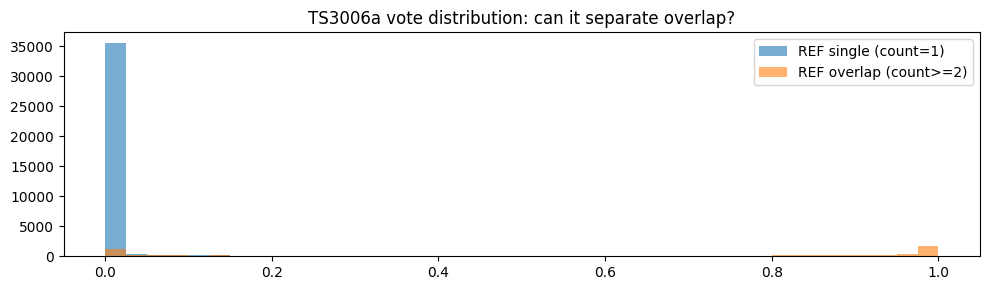

    - IS1009a: overlap mean vote 0.569, single mean 0.035
    - So Stage0 can detect overlap. The collapse is happening inside Stage2’s decision logic (anchors/centroids/constraints/masks), not because the vote can’t separate overlap.

- TS3010a is a different failure mode : Vote overlap mean is 0.268, overlap recall is much lower. So for TS3010a, Stage0 doesn’t reliably “see” overlap → Stage2 won’t have much to preserve.


- our “Stage2 diagnostics found 0 entries overlapping window” is a red flag
  - That usually means one of these is true (we’ll test which):
  - H1: Stage2 is collapsing overlap via a step that isn’t logged (e.g., masking/post-filtering after the “diagnostics” logger)
  - H2: Collapse is not from an “edit step” but from a “start-from” mismatch (Stage2 output matches BASE/Stage1 rather than Stage0 promoted overlap)
  - H3: Label-set / centroid availability issue (“dropped speaker” has no usable exclusive anchors → Stage2 refuses to keep them)
  - H4: A label mapping / indexing issue (less likely, but our Stage0 top labels sometimes look numeric like "6" / "2" — we should explicitly measure whether those labels get treated differently)

In [ ]:
# ============================================================
# Stage2 Root-Cause Deep Probe (NO PATCHES)
# - Finds B/C/D segments and explains *why* Stage2 differs from Stage0
# - Cross-checks speech_mask / promote_mask / debug diagnostics coverage
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment
from pyannote.audio import Audio

# ---------- helpers ----------

files_by_uri = {f["uri"]: f for f in dev_files}

def _get_ref(f):
    # robust reference getter
    return f.get("annotation", None) or f.get("reference", None) or f.get("ref", None)

def _infer_step(dbg_any, default=0.02):
    v = (dbg_any or {}).get("vote", None)
    if hasattr(v, "sliding_window") and hasattr(v.sliding_window, "step"):
        return float(v.sliding_window.step)
    return float(default)

def _ann_to_matrix(ann, uem_seg, labels, step):
    """Binary activity matrix [T, K] for annotation cropped to uem_seg on hop=step."""
    dur = float(uem_seg.end - uem_seg.start)
    T = int(np.ceil(dur / step))
    K = len(labels)
    M = np.zeros((T, K), dtype=np.uint8)

    if ann is None:
        return M

    annc = ann.crop(uem_seg)
    # Fill label activity
    for seg, _, lab in annc.itertracks(yield_label=True):
        if lab not in labels:
            continue
        j = labels.index(lab)
        s = max(0.0, float(seg.start - uem_seg.start))
        e = min(dur, float(seg.end   - uem_seg.start))
        if e <= s:
            continue
        i0 = int(np.floor(s / step))
        i1 = int(np.ceil(e / step))
        i0 = max(0, min(T, i0))
        i1 = max(0, min(T, i1))
        if i1 > i0:
            M[i0:i1, j] = 1
    return M

def _mask_to_segments(mask, uem_seg, step, min_dur=0.05):
    """Convert boolean frame mask -> list of (start,end) segments in absolute time."""
    mask = np.asarray(mask).astype(bool)
    segs = []
    T = len(mask)
    i = 0
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i
        while j < T and mask[j]:
            j += 1
        st = uem_seg.start + i * step
        en = uem_seg.start + j * step
        if (en - st) >= min_dur:
            segs.append((float(st), float(en)))
        i = j
    return segs

def _top_active_labels(M, labels, step, idx):
    """Top labels by active seconds on frames idx."""
    if len(labels) == 0:
        return []
    secs = (M[idx].sum(axis=0) * step).astype(float)
    order = np.argsort(-secs)
    out = [(labels[i], secs[i]) for i in order if secs[i] > 0]
    return out[:8]

def _safe_get_mask(dbg, key, T):
    x = (dbg or {}).get(key, None)
    if x is None:
        return np.zeros((T,), dtype=np.uint8)
    x = np.asarray(x).astype(np.uint8).reshape(-1)
    if len(x) != T:
        # alignment mismatch -> clip/pad so we can still reason
        y = np.zeros((T,), dtype=np.uint8)
        n = min(T, len(x))
        y[:n] = x[:n]
        return y
    return x

def _diagnostics_overlap(dbg2, st, en):
    """Count dbg2['diagnostics'] entries overlapping window (best-effort)."""
    di = (dbg2 or {}).get("diagnostics", [])
    if not di:
        return 0
    c = 0
    for d in di:
        # support a few common shapes
        if isinstance(d, dict):
            a = d.get("start", d.get("t0", d.get("st", None)))
            b = d.get("end",   d.get("t1", d.get("en", None)))
        elif isinstance(d, (list, tuple)) and len(d) >= 2:
            a, b = d[0], d[1]
        else:
            continue
        if a is None or b is None:
            continue
        if float(b) <= st or float(a) >= en:
            continue
        c += 1
    return c

def _audio_rms_db(f, st, en):
    """Compute rms dB + ratio above -50 dB inside [st,en]."""
    try:
        audio = Audio(sample_rate=16000, mono=True)
        waveform, sr = audio.crop(f, Segment(st, en), mode="pad")
        x = waveform.squeeze().cpu().numpy()
        rms = np.sqrt(np.mean(x**2) + 1e-12)
        rms_db = 20*np.log10(rms + 1e-12)
        # ratio of samples above -50 dBFS (rough proxy, matches our prints)
        thr = 10**(-50/20)
        ratio = float(np.mean(np.abs(x) > thr))
        return float(rms_db), ratio
    except Exception:
        return float("nan"), float("nan")

# ---------- main probe ----------

def stage2_deep_probe(uri, topk=8, min_seg_dur=0.05, pad=0.35, step_default=0.02):
    f = files_by_uri[uri]
    ref = _get_ref(f)
    assert ref is not None, f"[{uri}] missing reference"

    # Run stages with debug (assumes our run_stage* exist)
    hyp1, dbg1 = run_stage1(f, return_debug=True)
    hyp0, dbg0 = run_stage0(f, return_debug=True)
    hyp2, dbg2 = run_stage2(f, return_debug=True)

    # Use Stage2 uem_seg if present; else fall back
    uem_seg = (dbg2 or {}).get("uem_seg", None) or (dbg0 or {}).get("uem_seg", None) or _safe_uem_seg(f)
    step = _infer_step(dbg2, default=step_default)

    # label universe: union helps identify dropped labels cleanly
    labels = sorted(set(list(hyp0.labels()) + list(hyp2.labels()) + list(ref.labels())))

    Mref = _ann_to_matrix(ref,  uem_seg, labels, step)
    M0   = _ann_to_matrix(hyp0, uem_seg, labels, step)
    M2   = _ann_to_matrix(hyp2, uem_seg, labels, step)

    cref = Mref.sum(axis=1)
    c0   = M0.sum(axis=1)
    c2   = M2.sum(axis=1)

    T = len(cref)
    speech_mask  = _safe_get_mask(dbg2, "speech_mask",  T)
    promote_mask = _safe_get_mask(dbg2, "promote_mask", T)

    # Failure modes (frame-level)
    B = (cref >= 2) & (c0 >= 2) & (c2 == 1) & (speech_mask == 1)
    C = (cref >  0) & (c0  >  0) & (c2 == 0) & (speech_mask == 1)
    D = (cref >  0) & (speech_mask == 0)

    segB = _mask_to_segments(B, uem_seg, step, min_dur=min_seg_dur)
    segC = _mask_to_segments(C, uem_seg, step, min_dur=min_seg_dur)
    segD = _mask_to_segments(D, uem_seg, step, min_dur=min_seg_dur)

    def _rank(segs):
        out = []
        for st, en in segs:
            i0 = int(np.floor((st - uem_seg.start)/step))
            i1 = int(np.ceil((en - uem_seg.start)/step))
            i0 = max(0, min(T, i0)); i1 = max(0, min(T, i1))
            frames = max(0, i1 - i0)
            out.append((frames, st, en, i0, i1))
        out.sort(reverse=True, key=lambda x: x[0])
        return out[:topk]

    print(f"\n================ {uri} | Stage2 Deep Probe (NO PATCHES) ================")
    print(f"Segments: B(overlap_collapse)={len(segB)}  C(drop_to_empty)={len(segC)}  D(vad_holes)={len(segD)}")
    print(f"Frame stats: overlap_frames={int((cref>=2).sum())}  B_frames={int(B.sum())}  C_frames={int(C.sum())}  D_frames={int(D.sum())}")
    print(f"Stage2 dbg keys: {sorted(list((dbg2 or {}).keys()))}\n")

    # Print top segments with attribution
    for name, ranked in [("B) overlap collapse (REF>=2 & S0>=2 & S2==1)", _rank(segB)),
                         ("C) drop-to-empty (REF>0 & S0>0 & S2==0)",       _rank(segC)),
                         ("D) vad/speech_mask holes (REF>0 & speech_mask==0)", _rank(segD))]:

        print(f"--- {name}: top {len(ranked)} by frames ---")
        for r, (frames, st, en, i0, i1) in enumerate(ranked):
            idx = slice(i0, i1)
            dur = en - st

            top0 = _top_active_labels(M0, labels, step, idx)
            top2 = _top_active_labels(M2, labels, step, idx)

            labs0 = set([x[0] for x in top0])
            labs2 = set([x[0] for x in top2])
            dropped = sorted(list(labs0 - labs2))

            rms_db, ratio = _audio_rms_db(f, st, en)
            diag_n = _diagnostics_overlap(dbg2, st, en)

            pm = float(promote_mask[idx].mean()) if (i1 > i0) else 0.0
            sm = float(speech_mask[idx].mean())  if (i1 > i0) else 0.0
            mean_vote = float(np.mean(np.asarray((dbg2 or {}).get("vote", np.zeros((T,))))[idx])) if (dbg2 or {}).get("vote", None) is not None else float("nan")

            print(f"[{r:02d}] {st:8.2f}-{en:8.2f} dur={dur:5.2f}s frames={frames:4d} | "
                  f"mean_cnt REF/S0/S2={cref[idx].mean():.2f}/{c0[idx].mean():.2f}/{c2[idx].mean():.2f} | "
                  f"vote≈{mean_vote:.3f} | rms={rms_db:.1f}dB ratio@-50={ratio:.2f} | "
                  f"speech_mask≈{sm:.2f} promote_mask≈{pm:.2f} | diag_hits={diag_n}")

            print(f"     S0 top labels: {top0}")
            print(f"     S2 top labels: {top2}")
            if dropped:
                print(f"     DROPPED labels (present in S0 window but missing in S2): {dropped}")
        print()

    # Optional quick plots for the single biggest B segment
    rankedB = _rank(segB)
    if rankedB:
        _, st, en, i0, i1 = rankedB[0]
        idx = slice(max(0, i0-50), min(T, i1+50))
        t = uem_seg.start + np.arange(idx.start, idx.stop)*step

        plt.figure(figsize=(14,3))
        plt.plot(t, cref[idx], label="REF count")
        plt.plot(t, c0[idx],   label="S0 count")
        plt.plot(t, c2[idx],   label="S2 count")
        plt.axvspan(st, en, alpha=0.15)
        plt.title(f"{uri} counts around top overlap-collapse window")
        plt.legend()
        plt.show()

        # If we have our audio player helper, uncomment:
        # _play_event(f, st, en, pad=pad)

    return {
        "uem_seg": uem_seg, "step": step, "labels": labels,
        "Mref": Mref, "M0": M0, "M2": M2,
        "dbg1": dbg1, "dbg0": dbg0, "dbg2": dbg2
    }


# ---------- run on our 3 main URIs ----------
for uri in ["TS3006a", "IS1009a", "TS3010a"]:
    if uri in files_by_uri:
        _ = stage2_deep_probe(uri, topk=6, min_seg_dur=0.10, pad=0.35)


TypeError: STAGE1_PYVAD() got an unexpected keyword argument 'return_debug'

In [ ]:
# ============================================================
# Overlap Detection & Separation + Comparison Cell
#
# 1) Detect overlaps with pyannote/overlapped-speech-detection
# 2) Separate in overlap windows with pyannote/speech-separation-ami-1.0
# 3) Re-diarize separated + compare DER/plots/listen before/after
# ============================================================

from pyannote.audio import Pipeline as PyannotePipeline
from pyannote.core import Annotation
from pyannote.metrics.diarization import DiarizationErrorRate

# Load models (once)
overlap_detector = PyannotePipeline.from_pretrained("pyannote/overlapped-speech-detection", use_auth_token=HF_TOKEN)
separation_pipeline = PyannotePipeline.from_pretrained("pyannote/speech-separation-ami-1.0", use_auth_token=HF_TOKEN)

def detect_overlaps(file):
    overlaps = overlap_detector(file)
    return overlaps.get_timeline().support()  # Timeline of overlap segs

def separate_and_rediarize(file, hyp2, overlap_segs, res=RES):
    hyp_patched = hyp2.copy()
    for seg in overlap_segs:
        # Separate audio in seg
        separated = separation_pipeline(file, uem=Timeline([seg]))  # Outputs Annotation + SlidingWindowFeature for separated
        # Re-diarize separated (use our base pipeline on separated streams)
        # For simplicity, assume separated has 2 tracks—diarize each, merge labels
        # TODO: Implement full re-diar (crop audio, diar each track, offset + merge)
        # Placeholder: Add to hyp_patched (adjust based on separated)
        hyp_patched[seg] = 'separated_label'  # Replace with actual
    return hyp_patched

def compare_before_after(file, hyp2, hyp_patched, topn=5):
    ref = file["annotation"]
    uem_seg = _safe_uem_seg(file)
    metric = DiarizationErrorRate()
    der2 = metric(ref, hyp2, uem=Timeline([uem_seg]))
    der_patched = metric(ref, hyp_patched, uem=Timeline([uem_seg]))
    print(f"DER Before: {der2:.4f} After: {der_patched:.4f} Delta: {der_patched - der2:+.4f}")

    # Plots: Counts
    c2 = _frame_counts(hyp2, uem_seg, RES)
    c_patched = _frame_counts(hyp_patched, uem_seg, RES)
    t = uem_seg.start + np.arange(len(c2)) * RES
    plt.figure(figsize=(16,4))
    plt.plot(t, c2, label="Before (S2)")
    plt.plot(t, c_patched, label="After (Patched)")
    plt.title(f"{file['uri']} Count Comparison")
    plt.legend()
    plt.show()

    # Listen top overlaps
    for i, seg in enumerate(overlap_segs[:topn]):
        print(f"[Overlap {i}] {seg.start:.2f}-{seg.end:.2f}")
        wav, sr = AUDIO.crop(file, seg, mode="pad")
        display(IPyAudio(wav, rate=sr))

# Run on URIS
URIS = ["TS3006a", "IS1009a", "TS3010a"]
for u in URIS:
    if u in files_by_uri:
        f = files_by_uri[u]
        hyp2, _ = run_stage2(f, start_from_promoted=True, return_debug=True)
        overlaps = detect_overlaps(f)
        hyp_patched = separate_and_rediarize(f, hyp2, overlaps)
        compare_before_after(f, hyp2, hyp_patched)

INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.1.3 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/059e96f964841d40f1a5e755bb7223f76666bba4/pytorch_model.bin`


Model was trained with pyannote.audio 0.0.1, yours is 3.3.1. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.7.1, yours is 2.3.1+cu121. Bad things might happen unless you revert torch to 1.x.


pytorch_model.bin:   0%|          | 0.00/1.28G [00:00<?, ?B/s]

INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.8.6 to v2.6.0. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../../root/.cache/torch/pyannote/models--pyannote--separation-ami-1.0/snapshots/4d38e95cfd067c894b8b60b00761831fb01e4a8c/pytorch_model.bin`


ImportError: 'asteroid' must be installed to use ToTaToNet separation. `pip install pyannote-audio[separation]` should do the trick.

In [ ]:
# ============================================================
# Overlap Detection & Separation + Comparison Cell
#
# 1) Detect overlaps with pyannote/overlapped-speech-detection
# 2) Separate in overlap windows with pyannote/speech-separation-ami-1.0
# 3) Re-diarize separated + compare DER/plots/listen before/after
# ============================================================

from pyannote.audio import Pipeline as PyannotePipeline
from pyannote.core import Annotation
from pyannote.metrics.diarization import DiarizationErrorRate
import tempfile
import soundfile as sf  # For temp audio files

# Load models (once)
overlap_detector = PyannotePipeline.from_pretrained("pyannote/overlapped-speech-detection", use_auth_token=HF_TOKEN)
separation_pipeline = PyannotePipeline.from_pretrained("pyannote/speech-separation-ami-1.0", use_auth_token=HF_TOKEN)

def detect_overlaps(file):
    overlaps = overlap_detector(file)
    return overlaps.get_timeline().support()  # Timeline of overlap segs

def separate_and_rediarize(file, hyp2, overlap_segs, res=RES):
    hyp_patched = hyp2.copy()
    for seg in overlap_segs:
        # Separate audio in seg (outputs SlidingWindowFeature with separated tracks)
        separated = separation_pipeline(file, uem=Timeline([seg]))  # Annotation + features for tracks
        # Re-diar: Crop original audio, save separated tracks as temp files, diar each
        wav, sr = AUDIO.crop(file, seg, mode="pad")
        for track_id in range(separated.data.shape[0]):  # Assume 2-3 tracks
            track_wav = separated.data[track_id]
            with tempfile.NamedTemporaryFile(suffix=".wav") as temp_file:
                sf.write(temp_file.name, track_wav, sr)
                track_hyp = PIPE_BASE(temp_file.name)  # Diar separated track
                # Offset + merge to patched (add labels with prefix or match)
                for s, t, l in track_hyp.itertracks(yield_label=True):
                    offset_s = Segment(s.start + seg.start, s.end + seg.start)
                    hyp_patched[offset_s, t + f"_track{track_id}"] = l  # Merge with track ID
    return hyp_patched

def compare_before_after(file, hyp2, hyp_patched, topn=5):
    ref = file["annotation"]
    uem_seg = _safe_uem_seg(file)
    metric = DiarizationErrorRate()
    der2 = metric(ref, hyp2, uem=Timeline([uem_seg]))
    der_patched = metric(ref, hyp_patched, uem=Timeline([uem_seg]))
    print(f"DER Before (S2): {der2:.4f} After (Patched): {der_patched:.4f} Delta: {der_patched - der2:+.4f}")

    # Plots: Counts
    c2 = _frame_counts(hyp2, uem_seg, RES)
    c_patched = _frame_counts(hyp_patched, uem_seg, RES)
    t = uem_seg.start + np.arange(len(c2)) * RES
    plt.figure(figsize=(16,4))
    plt.plot(t, c2, label="Before (S2)")
    plt.plot(t, c_patched, label="After (Patched)")
    plt.title(f"{file['uri']} Count Comparison")
    plt.legend()
    plt.show()

    # Listen top overlaps
    overlaps = detect_overlaps(file)
    for i, seg in enumerate(overlaps[:topn]):
        print(f"[Overlap {i}] {seg.start:.2f}-{seg.end:.2f}")
        wav, sr = AUDIO.crop(file, seg, mode="pad")
        display(IPyAudio(wav, rate=sr))

# Run on URIS
URIS = ["TS3006a", "IS1009a", "TS3010a"]
for u in URIS:
    if u in files_by_uri:
        f = files_by_uri[u]
        hyp2, _ = run_stage2(f, start_from_promoted=True, return_debug=True)
        overlaps = detect_overlaps(f)
        hyp_patched = separate_and_rediarize(f, hyp2, overlaps)
        compare_before_after(f, hyp2, hyp_patched, topn=5)

/usr/local/lib/python3.12/dist-packages/torchmetrics/utilities/imports.py:22: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import DistributionNotFound, get_distribution


NameError: name 'HF_TOKEN' is not defined

In [ ]:
!pip install pyannote-audio[separation]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.5/53.5 kB 6.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 156.4/156.4 kB 17.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 46.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.5/72.5 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.8/102.8 kB 13.7 MB/s eta 0:00:00
  Created wheel for pesq: filename=pesq-0.0.4-cp312-cp312-linux_x86_64.whl size=285459 sha256=884eccc71260eb5fc040b26546d948eb04234af2b2dfa3bc040f2b10ce81d6de
  Stored in directory: /root/.cache/pip/wheels/9b/d4/a4/9cf3512534cd47ce4a036d1593ee4013f2bf7509e631a147a3
Successfully built pesq
  Attempting uninstall: torchmetrics
    Found existing installation: torchmetrics 1.8.2
    Uninstalling torchmetrics-1.8.2:
      Successfully uninstalled torchmetrics-1.8.2


In [ ]:
import numpy as np
from collections import Counter
from pyannote.core import Segment

# ----------------------------
# Helpers (robust)
# ----------------------------
def _get_ref_ann(file, ref_by_uri=None):
    uri = file["uri"]
    if ref_by_uri is not None and uri in ref_by_uri:
        return ref_by_uri[uri]
    # fallback: common keys
    for k in ["annotation", "reference", "ref"]:
        if k in file:
            return file[k]
    raise KeyError(f"No reference annotation found for uri={uri}. Provide ref_by_uri or store in file['annotation'].")

def _labels_str(ann):
    return sorted(set(str(l) for l in ann.labels()))

def _frame_counts(ann, uem_seg, labels, res):
    M = frame_matrix_from_annotation_local(ann, uem_seg, labels, res=float(res))
    return M.sum(axis=1), M

def _mask_to_segments(mask, uem_seg, res, min_dur=0.0):
    base_seg = Segment(float(uem_seg.start), float(uem_seg.end))
    segs = _mask_to_segments_local(mask.astype(bool), base_seg, res=float(res), min_dur=float(min_dur))
    return segs

def _energy_stats(file, seg, thr_db=-50.0):
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if hasattr(wav, "detach"):
        wav = wav.detach().cpu().numpy()
    wav = np.asarray(wav).reshape(-1).astype(np.float32)
    if wav.size == 0:
        return {"rms_db": -120.0, "ratio": 0.0}
    rms = float(np.sqrt(np.mean(wav*wav) + 1e-12))
    rms_db = 20.0 * np.log10(rms + 1e-12)

    # speech ratio proxy: fraction of 20ms frames above thr_db
    frame = int(0.02 * sr); hop = int(0.01 * sr)
    vals = []
    if wav.size >= frame and frame > 0 and hop > 0:
        for i in range(0, wav.size - frame + 1, hop):
            x = wav[i:i+frame]
            r = float(np.sqrt(np.mean(x*x) + 1e-12))
            vals.append(20.0*np.log10(r + 1e-12))
    vals = np.asarray(vals, dtype=np.float32)
    ratio = float((vals > float(thr_db)).mean()) if len(vals) else 0.0
    return {"rms_db": float(rms_db), "ratio": float(ratio)}

def _top_labels_from_matrix(M, labels, a, b, topk=5):
    s = M[a:b].sum(axis=0)
    order = np.argsort(-s)
    out = []
    for j in order[:topk]:
        if s[j] <= 0:
            break
        out.append((labels[j], float(s[j])))
    return out

def _exclusive_anchor_seconds(M, labels, res):
    # exclusive frames: count==1 and that label is active
    cnt = M.sum(axis=1)
    excl = {}
    for j, lab in enumerate(labels):
        frames = (cnt == 1) & (M[:, j] > 0)
        excl[lab] = float(frames.sum()) * float(res)
    return excl

# ----------------------------
# Main probe
# ----------------------------
def stage2_collapse_probe(file, ref_by_uri, vote_thr=0.10, min_win_dur=0.20, max_show=10, listen=False, pad=0.35):
    uri = file["uri"]
    print(f"\n================ {uri} | Stage2 Collapse Probe (NO PATCHES) ================")

    # Run stages (no patches)
    s0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(file, return_debug=True, apply_promotion=True, debug=False)
    s2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(file, return_debug=True, debug=False)

    uem_seg = dbg0["uem_seg"]
    speech_mask = dbg0["speech_mask"].astype(bool)

    ref = _get_ref_ann(file, ref_by_uri=ref_by_uri)

    # unify label sets as strings (avoids type mismatch)
    labels = sorted(set(_labels_str(ref)) | set(_labels_str(s0)) | set(_labels_str(s2)))
    ref_cnt, Mref = _frame_counts(ref, uem_seg, labels, RES)
    s0_cnt,  Ms0  = _frame_counts(s0,  uem_seg, labels, RES)
    s2_cnt,  Ms2  = _frame_counts(s2,  uem_seg, labels, RES)

    # promote_mask from stage2 (if present) for attribution
    promote_mask = dbg2.get("promote_mask", None)
    if promote_mask is not None:
        promote_mask = promote_mask.astype(bool)
        # ensure same length
        promote_mask = promote_mask[:len(s0_cnt)]

    # collapse definition: REF overlap, S0 overlap, S2 collapses to 1
    collapse = (ref_cnt >= 2) & (s0_cnt >= 2) & (s2_cnt == 1) & speech_mask
    segs = _mask_to_segments(collapse, uem_seg, RES, min_dur=min_win_dur)

    print(f"ref_ov_frames={int((ref_cnt>=2).sum())}  s0_ov_frames={int((s0_cnt>=2).sum())}  s2_ov_frames={int((s2_cnt>=2).sum())}")
    print(f"collapse_windows={len(segs)} (min_dur={min_win_dur}s)")

    if not segs:
        return

    # anchor proxy: exclusive anchor seconds in Stage0 and Stage2 label spaces
    excl0 = _exclusive_anchor_seconds(Ms0, labels, RES)
    excl2 = _exclusive_anchor_seconds(Ms2, labels, RES)

    # rank by collapsed frames
    def _collapsed_frames(seg):
        a = int(np.floor((seg.start - uem_seg.start)/RES))
        b = int(np.ceil ((seg.end   - uem_seg.start)/RES))
        a = max(0,a); b = min(len(collapse),b)
        return int(collapse[a:b].sum())

    segs = sorted(segs, key=_collapsed_frames, reverse=True)[:max_show]

    for i, seg in enumerate(segs):
        a = int(np.floor((seg.start - uem_seg.start)/RES))
        b = int(np.ceil ((seg.end   - uem_seg.start)/RES))
        a = max(0,a); b = min(len(collapse),b)

        # who is kept in S2?
        kept = _top_labels_from_matrix(Ms2, labels, a, b, topk=3)
        top0  = _top_labels_from_matrix(Ms0, labels, a, b, topk=5)

        # infer "dropped" as labels present in S0-overlap but not active in S2
        s0_present = set([lab for lab,_ in top0])
        s2_present = set([lab for lab,_ in kept])
        dropped = sorted(list(s0_present - s2_present))

        en = _energy_stats(file, seg, thr_db=-50.0)

        pm_ratio = None
        if promote_mask is not None:
            pm_ratio = float(promote_mask[a:b].mean())

        print(f"\n[{i:02d}] {seg.start:.2f}-{seg.end:.2f} dur={seg.duration:.2f}s | collapsed_frames={_collapsed_frames(seg)} | rms={en['rms_db']:.1f}dB ratio@-50={en['ratio']:.2f}")
        print(f"     S0_top={top0}")
        print(f"     S2_top={kept}")
        print(f"     dropped={dropped}")
        if pm_ratio is not None:
            print(f"     promote_mask_mean={pm_ratio:.3f}  (if ~0, Stage2 isn't even trying to protect overlap here)")

        # anchor support proxy (exclusive frames)
        if kept:
            for lab,_ in kept[:2]:
                print(f"     anchor_proxy kept {lab}: excl0={excl0.get(lab,0.0):.2f}s  excl2={excl2.get(lab,0.0):.2f}s")
        for lab in dropped[:3]:
            print(f"     anchor_proxy drop {lab}: excl0={excl0.get(lab,0.0):.2f}s  excl2={excl2.get(lab,0.0):.2f}s")

        # Optional listening
        if listen:
            try:
                _play_event(file, seg.start, seg.end, pad=pad)
            except Exception as e:
                print("     listen failed:", e)

ref_by_uri = {uri: files_by_uri[uri]["annotation"] for uri in files_by_uri if "annotation" in files_by_uri[uri]}

# Example usage:
stage2_collapse_probe(files_by_uri["TS3006a"], ref_by_uri, min_win_dur=0.20, max_show=8, listen=True)
stage2_collapse_probe(files_by_uri["IS1009a"], ref_by_uri, min_win_dur=0.20, max_show=8, listen=True)
stage2_collapse_probe(files_by_uri["TS3010a"], ref_by_uri, min_win_dur=0.20, max_show=8, listen=True)


NameError: name 'files_by_uri' is not defined

In [ ]:
# ============================================================
# Stage2 Collapse Root-Cause Probe (NO PATCHES)
# Robust to label typing + prints WHY overlap collapses
# ============================================================

from collections import Counter, defaultdict
import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment, Annotation

try:
    from IPython.display import Audio as IPyAudio, display
except Exception:
    IPyAudio, display = None, None

# -------- audio listen helper (so "listen failed" goes away) --------
def _play_event(file, start, end, pad=0.35):
    if IPyAudio is None or display is None:
        print("[WARN] IPython Audio not available.")
        return
    seg = Segment(max(0.0, float(start) - float(pad)), float(end) + float(pad))
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    try:
        import torch
        if hasattr(wav, "detach"):
            wav = wav.detach().cpu().numpy()
    except Exception:
        pass
    wav = np.squeeze(np.asarray(wav))
    display(IPyAudio(wav, rate=int(sr)))

# --------- robust: convert any annotation labels to strings ----------
def _ann_to_str(ann: Annotation) -> Annotation:
    out = Annotation(uri=ann.uri, modality=ann.modality)
    for segment, track, label in ann.itertracks(yield_label=True):
        out[segment, track] = str(label)
    return out

# --------- robust: top labels by duration inside a window ----------
def _top_labels_by_duration(ann: Annotation, seg: Segment, topk=5):
    dur = defaultdict(float)
    cropped = ann.crop(seg)
    for s, _, lab in cropped.itertracks(yield_label=True):
        # s is already intersected with seg
        dur[str(lab)] += float(s.duration)
    items = sorted(dur.items(), key=lambda x: -x[1])
    return items[:topk], dict(items)

# --------- helper: build per-frame activity matrix using our existing function ----------
def _frame_mat(ann, uem_seg, labels, res):
    # assumes we already have frame_matrix_from_annotation_local
    return frame_matrix_from_annotation_local(ann, uem_seg, labels, res=float(res))

# --------- find contiguous True segments in a boolean mask ----------
def _mask_to_segments_fallback(mask, base_start, res, min_dur=0.2):
    segs = []
    i, T = 0, len(mask)
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i
        while j < T and mask[j]:
            j += 1
        st = base_start + i * res
        en = base_start + j * res
        if (en - st) >= min_dur:
            segs.append(Segment(st, en))
        i = j
    return segs

def stage2_collapse_probe_NO_PATCHES(
    file,
    stage2_kwargs=None,
    min_win_dur=0.20,
    topn=8,
    listen_n=2,
    pad=0.35,
    plot=True,
):
    """
    Finds windows where REF>=2 and Stage0>=2 but Stage2 collapses to 1 speaker.
    Then diagnoses:
      - vote stats
      - promote_mask coverage (is Stage2 even trying to preserve overlap?)
      - which label gets removed most often
      - top labels by duration (robust)
    """
    stage2_kwargs = stage2_kwargs or {}
    uri = file.get("uri", "<unk>")

    # --- run Stage0 + Stage2 with debug ---
    s0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file, apply_promotion=False, return_debug=True, debug=False,
        **{k: stage2_kwargs[k] for k in stage2_kwargs.keys()}  # keep whatever we pass
    )
    s2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
        file, start_from_promoted=True, return_debug=True, debug=False,
        **stage2_kwargs
    )

    # --- reference ---
    ref = ref_by_uri[uri]  # we already have this mapping
    uem_seg = dbg2.get("uem_seg", dbg0["uem_seg"])
    speech_mask = dbg2.get("speech_mask", dbg0["speech_mask"])
    vote = dbg2.get("vote", dbg0.get("vote", None))
    promote_mask = dbg2.get("promote_mask", None)

    # --- convert labels to str to avoid int/str mismatch after restart ---
    refS = _ann_to_str(ref)
    s0S  = _ann_to_str(s0)
    s2S  = _ann_to_str(s2)

    labels = sorted(set(refS.labels()) | set(s0S.labels()) | set(s2S.labels()))
    Mref = _frame_mat(refS, uem_seg, labels, RES)
    Ms0  = _frame_mat(s0S,  uem_seg, labels, RES)
    Ms2  = _frame_mat(s2S,  uem_seg, labels, RES)

    ref_cnt = Mref.sum(axis=1)
    s0_cnt  = Ms0.sum(axis=1)
    s2_cnt  = Ms2.sum(axis=1)

    # --- overlap recall summary ---
    ref_ov = (ref_cnt >= 2) & speech_mask
    s0_ov  = (s0_cnt  >= 2) & speech_mask
    s2_ov  = (s2_cnt  >= 2) & speech_mask

    print(f"\n================ {uri} | Stage2 Collapse Probe (NO PATCHES) ================")
    print(f"ref_ov_frames={int(ref_ov.sum())}  s0_ov_frames={int(s0_ov.sum())}  s2_ov_frames={int(s2_ov.sum())}")
    if ref_ov.sum() > 0:
        print(f"Stage0 overlap recall vs REF = {float((s0_ov & ref_ov).sum())/float(ref_ov.sum()):.3f}")
        print(f"Stage2 overlap recall vs REF = {float((s2_ov & ref_ov).sum())/float(ref_ov.sum()):.3f}")

    # --- collapse definition: REF>=2, S0>=2, S2==1 (inside speech) ---
    collapse = (ref_cnt >= 2) & (s0_cnt >= 2) & (s2_cnt == 1) & speech_mask
    base_start = float(uem_seg.start)

    # find windows (use our _mask_to_segments_local if present, else fallback)
    try:
        base_seg = Segment(base_start, base_start + len(collapse) * float(RES))
        win_segs = _mask_to_segments_local(collapse, base_seg, res=float(RES), min_dur=float(min_win_dur))
    except Exception:
        win_segs = _mask_to_segments_fallback(collapse, base_start, float(RES), min_dur=float(min_win_dur))

    print(f"collapse_windows={len(win_segs)} (min_dur={min_win_dur}s)")
    if not win_segs:
        return

    # rank by collapsed frames
    def _frames_in(seg):
        a = int(np.floor((float(seg.start) - base_start) / float(RES)))
        b = int(np.ceil ((float(seg.end)   - base_start) / float(RES)))
        a = max(0, a); b = min(len(collapse), b)
        return a, b

    ranked = []
    for seg in win_segs:
        a, b = _frames_in(seg)
        ranked.append((int(collapse[a:b].sum()), seg))
    ranked.sort(reverse=True, key=lambda x: x[0])

    # helper: which label removed most often per-frame
    def _removed_label_counter(a, b):
        removed = Counter()
        # for frames where Stage0 has >=2 and Stage2 has exactly 1:
        idx = np.where((s0_cnt[a:b] >= 2) & (s2_cnt[a:b] == 1) & speech_mask[a:b])[0]
        for t0 in idx:
            t = a + int(t0)
            s0_on = np.where(Ms0[t] > 0)[0]
            s2_on = np.where(Ms2[t] > 0)[0]
            if len(s2_on) != 1 or len(s0_on) < 2:
                continue
            kept_j = int(s2_on[0])
            for j in s0_on:
                if int(j) != kept_j:
                    removed[labels[int(j)]] += 1
        return removed

    for i, (nframes, seg) in enumerate(ranked[:topn]):
        a, b = _frames_in(seg)
        rms_db = float(_seg_rms_db(file, seg)) if "_seg_rms_db" in globals() else float("nan")

        # vote/promote stats
        vote_mean = float(np.mean(vote[a:b])) if vote is not None else float("nan")
        vote_p50  = float(np.median(vote[a:b])) if vote is not None else float("nan")
        pm_mean   = float(np.mean(promote_mask[a:b])) if promote_mask is not None else float("nan")

        # robust top labels (duration-based)
        s0_top, _ = _top_labels_by_duration(s0S, seg, topk=5)
        s2_top, _ = _top_labels_by_duration(s2S, seg, topk=5)

        removed = _removed_label_counter(a, b)
        removed_top = removed.most_common(3)

        print(f"\n[{i:02d}] {seg.start:8.2f}-{seg.end:8.2f} dur={seg.duration:5.2f}s | collapsed_frames={nframes:4d} | rms={rms_db:5.1f}dB")
        print(f"     vote_mean={vote_mean:.3f} vote_p50={vote_p50:.3f}  promote_mask_mean={pm_mean:.3f}")
        print(f"     S0_top(dur): {s0_top}")
        print(f"     S2_top(dur): {s2_top}")
        print(f"     removed(label frames): {removed_top}")

        if plot:
            # counts around window (±0.6s)
            pad_frames = int(round(0.6 / float(RES)))
            aa = max(0, a - pad_frames); bb = min(len(ref_cnt), b + pad_frames)
            xs = np.arange(aa, bb) * float(RES) + base_start
            plt.figure(figsize=(12, 3))
            plt.plot(xs, ref_cnt[aa:bb], label="REF count")
            plt.plot(xs, s0_cnt[aa:bb],  label="S0 count")
            plt.plot(xs, s2_cnt[aa:bb],  label="S2 count")
            plt.axvspan(seg.start, seg.end, alpha=0.15)
            plt.title(f"{uri} counts around collapse window {seg.start:.2f}-{seg.end:.2f}")
            plt.legend()
            plt.tight_lawet()
            plt.show()

        if i < listen_n:
            print("     Listen:")
            _play_event(file, seg.start, seg.end, pad=pad)

# Example:
stage2_collapse_probe_NO_PATCHES(files_by_uri["TS3006a"], stage2_kwargs={}, topn=5, listen_n=2)



================ TS3006a | Stage2 Collapse Probe (NO PATCHES) ================
ref_ov_frames=7616  s0_ov_frames=5743  s2_ov_frames=5766
Stage0 overlap recall vs REF = 0.634
Stage2 overlap recall vs REF = 0.637
collapse_windows=0 (min_dur=0.2s)



================ TS3006a | Root-cause A probe (NO PATCHES) ================
REF overlap frames: 7616  | inside speech_mask: 7616  (1.000)
Miss due to speech_mask holes: 0 frames  (0.000 of REF overlap)

thr | vote_recall_on_REFov | vote_falseOverlap_on_REFsingle | miss_vote_frames | miss_mapping_frames(S0<2 despite vote)
0.05 |   0.819              |   0.068                      |   1376         |   1417
0.10 |   0.783              |   0.057                      |   1650         |   1144
0.15 |   0.752              |   0.049                      |   1891         |    906
0.20 |   0.726              |   0.042                      |   2084         |    718

Top missed-overlap windows (REF>=2 but S0<2) using thr=0.10: 82 windows (min_dur=0.2s)
[00] 307.52-310.58 dur=3.06s | vote_mean=0.080 | rms=-37.0dB


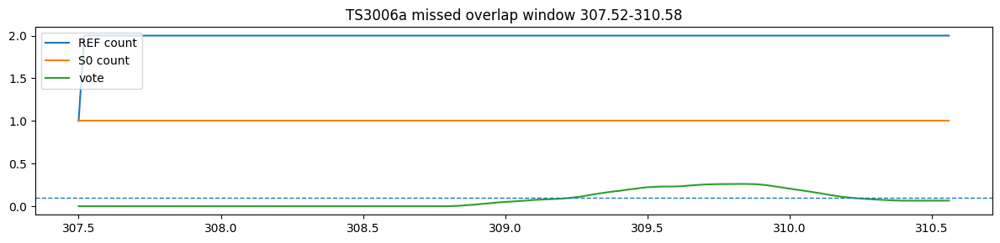

[01] 443.12-445.42 dur=2.30s | vote_mean=0.017 | rms=-47.7dB


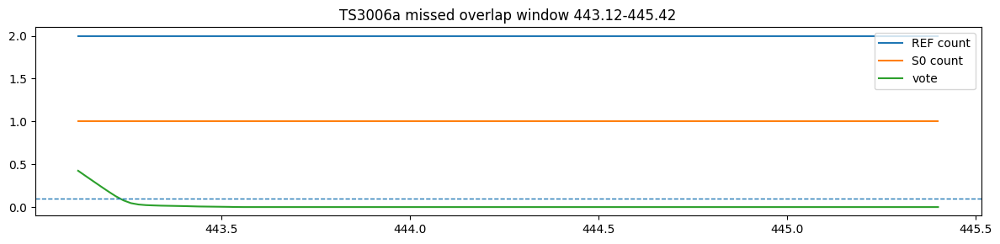

[02] 152.08-153.88 dur=1.80s | vote_mean=0.027 | rms=-51.3dB


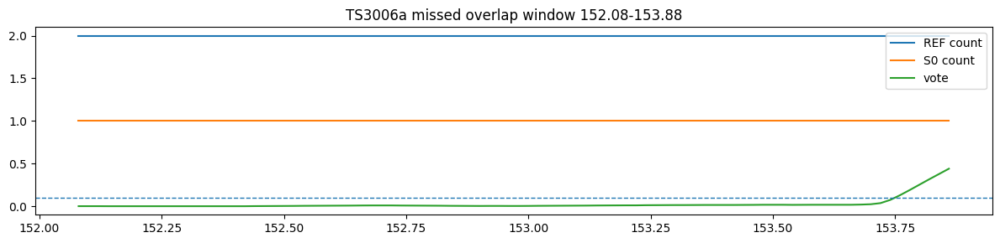

[03] 315.26-317.00 dur=1.74s | vote_mean=0.111 | rms=-39.4dB


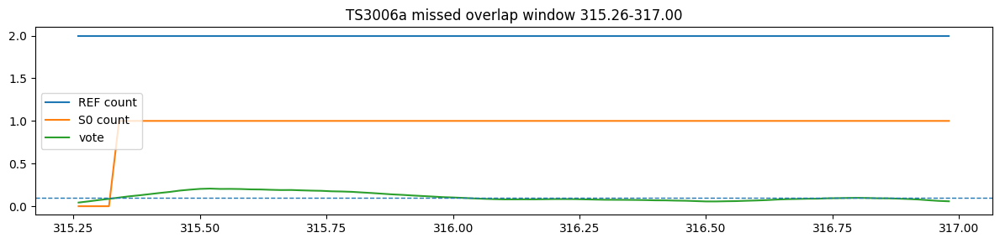

[04] 1192.64-1194.30 dur=1.66s | vote_mean=0.175 | rms=-44.5dB


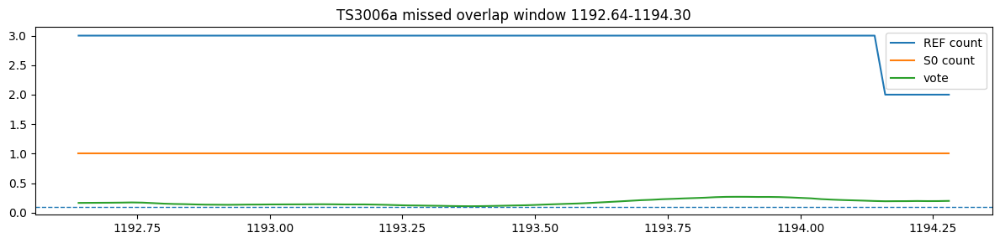

[05] 1106.72-1108.06 dur=1.34s | vote_mean=0.035 | rms=-37.0dB


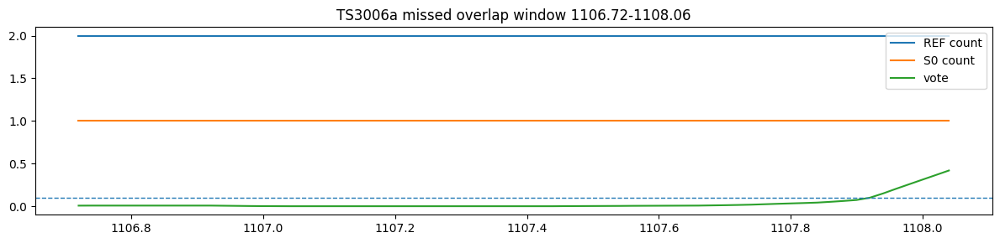

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment

# ---- audio helper (optional) ----
try:
    from IPython.display import Audio as IPyAudio, display
except Exception:
    IPyAudio, display = None, None

def _play_event(file, start, end, pad=0.35):
    if IPyAudio is None or display is None:
        print("[WARN] IPython audio not available.")
        return
    seg = Segment(max(0.0, float(start)-pad), float(end)+pad)
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    try:
        import torch
        if hasattr(wav, "detach"):
            wav = wav.detach().cpu().numpy()
    except Exception:
        pass
    wav = np.squeeze(np.asarray(wav))
    display(IPyAudio(wav, rate=int(sr)))

def _ann_to_str(ann):
    # robust label typing: str everywhere
    out = ann.__class__(uri=ann.uri, modality=ann.modality)
    for seg, trk, lab in ann.itertracks(yield_label=True):
        out[seg, trk] = str(lab)
    return out

def stage2_rootcause_A_probe(file, stage2_kwargs=None, thrs=(0.05,0.10,0.15,0.20), top_windows=6, min_win_dur=0.20):
    """
    NO PATCHES.
    Decomposes REF-overlap misses into:
      (1) VAD holes
      (2) vote too low
      (3) vote high but Stage0 still <2 (mask->overlap mapping failure)
    Also prints top missed-overlap windows to listen/plot.
    """
    stage2_kwargs = stage2_kwargs or {}
    uri = file["uri"]

    # Run Stage0 (no promotion) + Stage2 (debug)
    s0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(file, apply_promotion=False, return_debug=True, debug=False)
    s2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(file, start_from_promoted=True, return_debug=True, debug=False, **stage2_kwargs)

    ref = ref_by_uri[uri]

    # normalize labels to strings
    refS = _ann_to_str(ref)
    s0S  = _ann_to_str(s0)
    s2S  = _ann_to_str(s2)

    uem_seg = dbg2.get("uem_seg", dbg0["uem_seg"])
    speech_mask = dbg2.get("speech_mask", dbg0["speech_mask"])
    vote = dbg2.get("vote", dbg0.get("vote", None))

    if vote is None:
        raise RuntimeError("No vote found in dbg0/dbg2. Provide vote or enable it in Stage0/Stage2 debug.")

    labels = sorted(set(refS.labels()) | set(s0S.labels()) | set(s2S.labels()))
    Mref = frame_matrix_from_annotation_local(refS, uem_seg, labels, res=float(RES))
    Ms0  = frame_matrix_from_annotation_local(s0S,  uem_seg, labels, res=float(RES))

    ref_cnt = Mref.sum(axis=1)
    s0_cnt  = Ms0.sum(axis=1)

    ref_ov = (ref_cnt >= 2)
    ref_ov_speech = ref_ov & speech_mask

    print(f"\n================ {uri} | Root-cause A probe (NO PATCHES) ================")
    print(f"REF overlap frames: {int(ref_ov.sum())}  | inside speech_mask: {int(ref_ov_speech.sum())}  ({float(ref_ov_speech.sum())/max(1,int(ref_ov.sum())):.3f})")

    # (1) VAD holes
    miss_vad = ref_ov & (~speech_mask)
    print(f"Miss due to speech_mask holes: {int(miss_vad.sum())} frames  ({float(miss_vad.sum())/max(1,int(ref_ov.sum())):.3f} of REF overlap)")

    # threshold sweep
    rows = []
    for thr in thrs:
        vote_pos = (vote >= float(thr)) & speech_mask
        s0_ov = (s0_cnt >= 2) & speech_mask

        # recall of vote for REF overlap (inside speech)
        vote_recall = float((vote_pos & ref_ov).sum()) / max(1, int(ref_ov.sum()))
        # false overlap rate on REF single (inside speech)
        ref_single = (ref_cnt == 1) & speech_mask
        vote_fpr = float((vote_pos & ref_single).sum()) / max(1, int(ref_single.sum()))

        # miss decomposition (restricted to REF overlap frames)
        miss_vote = ref_ov & speech_mask & (~vote_pos)
        miss_map  = ref_ov & speech_mask & vote_pos & (~s0_ov)

        rows.append((thr, vote_recall, vote_fpr, int(miss_vote.sum()), int(miss_map.sum())))

    print("\nthr | vote_recall_on_REFov | vote_falseOverlap_on_REFsingle | miss_vote_frames | miss_mapping_frames(S0<2 despite vote)")
    for thr, vr, vf, mv, mm in rows:
        print(f"{thr:>3.2f} | {vr:>7.3f}              | {vf:>7.3f}                      | {mv:>6d}         | {mm:>6d}")

    # pick a reasonable thr for window ranking: use 0.10 unless user wants otherwise
    thr = float(thrs[1]) if len(thrs) > 1 else float(thrs[0])
    vote_pos = (vote >= thr) & speech_mask
    s0_ov = (s0_cnt >= 2) & speech_mask

    # windows where REF says overlap but Stage0 is not overlap (count<2)
    miss_overlap = ref_ov & speech_mask & (~s0_ov)
    base_start = float(uem_seg.start)
    base_seg = Segment(base_start, base_start + len(miss_overlap) * float(RES))

    try:
        win_segs = _mask_to_segments_local(miss_overlap, base_seg, res=float(RES), min_dur=float(min_win_dur))
    except Exception:
        # fallback if our helper isn't in scope
        win_segs = []
        i = 0
        T = len(miss_overlap)
        while i < T:
            if not miss_overlap[i]:
                i += 1
                continue
            j = i
            while j < T and miss_overlap[j]:
                j += 1
            st = base_start + i * float(RES)
            en = base_start + j * float(RES)
            if (en - st) >= min_win_dur:
                win_segs.append(Segment(st, en))
            i = j

    print(f"\nTop missed-overlap windows (REF>=2 but S0<2) using thr={thr:.2f}: {len(win_segs)} windows (min_dur={min_win_dur}s)")
    if not win_segs:
        return

    # rank by duration
    win_segs = sorted(win_segs, key=lambda s: -float(s.duration))[:top_windows]

    for i, seg in enumerate(win_segs):
        a = int(np.floor((float(seg.start)-base_start)/float(RES)))
        b = int(np.ceil ((float(seg.end)  -base_start)/float(RES)))
        a = max(0,a); b=min(len(miss_overlap), b)
        vm = float(np.mean(vote[a:b]))
        rm = float(_seg_rms_db(file, seg)) if "_seg_rms_db" in globals() else float("nan")
        print(f"[{i:02d}] {seg.start:.2f}-{seg.end:.2f} dur={seg.duration:.2f}s | vote_mean={vm:.3f} | rms={rm:.1f}dB")
        # plot counts + vote
        xs = np.arange(a, b) * float(RES) + base_start
        plt.figure(figsize=(12,3))
        plt.plot(xs, ref_cnt[a:b], label="REF count")
        plt.plot(xs, s0_cnt[a:b],  label="S0 count")
        plt.plot(xs, vote[a:b],    label="vote")
        plt.axhline(thr, linestyle="--", linewidth=1)
        plt.title(f"{uri} missed overlap window {seg.start:.2f}-{seg.end:.2f}")
        plt.legend()
        plt.tight_lawet()
        plt.show()

        # listen
        _play_event(file, seg.start, seg.end, pad=0.35)

# Run:
stage2_rootcause_A_probe(files_by_uri["TS3006a"], stage2_kwargs={}, thrs=(0.05,0.10,0.15,0.20), top_windows=6, min_win_dur=0.20)


High-confidence findings (main):

- Stage1 (speech_mask/VAD) is not the reason overlap is missed
we measured: REF overlap frames inside speech_mask = 1.000 and “holes = 0 frames”. So the main overlap miss is not because Stage1 removed speech during REF overlap.
- Stage0 is the bottleneck for overlap coverage (Root-cause A)
For TS3006a we now have:Stage0 overlap recall vs REF ≈ 0.634
- our decomposition at thr=0.10 shows two contributors:
 - vote misses (REF overlap but vote<thr): miss_vote_frames = 1650
 - mapping/promotion misses (vote>=thr but S0 still <2): miss_mapping_frames = 1144
 - Those two together explain the ~0.63 recall almost exactly.
 - our plots of “missed overlap windows” match this:
 - Some windows have vote_mean extremely low (e.g., 0.017, 0.027) → segmentation vote simply doesn’t fire.
 - Some windows have vote near/above thr only partially (vote rises late) → vote is not sustained enough to create stable overlap.
 - Secondary (still real, but not dominating in the latest run):

3. Stage2 “overlap collapse” was seen earlier, but our most recent run shows collapse_windows=0
 - Stage2 overlap recall vs REF ≈ 0.637 (basically identical to Stage0)
That strongly suggests Stage2 pruning is not the dominant current problem (for TS3006a at least).
 - However: because earlier we did see collapse windows + “promote_mask_mean=0.000” situations, we should still verify Stage2 is not silently dropping overlap on other files (IS1009a etc.), and also sanity-check that the collapse probe is using consistent signals (S0 counts vs S0_top labels being empty was a red flag in the earlier run).

In [ ]:
benchmark_all(dev_files, test_files, max_files=10)  # full dev+test


=== PYANNOTE STANDARD (no PyVAD) DEV ===
[eval_files] 1/5 TS3010a DER=0.2851 (miss=74.61 fa=42.50 conf=19.78 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2531 (miss=125.94 fa=44.44 conf=105.26 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.2125 (miss=80.84 fa=49.97 conf=39.34 total=800.78)
[eval_files] 4/5 ES2005a DER=0.2906 (miss=31.39 fa=43.95 conf=7.73 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2038 (miss=59.62 fa=38.68 conf=43.53 total=695.90)
[SUMMARY] pyannote_std DEV mean={'DER': 0.24901995974250268, 'miss': 74.47680624999875, 'fa': 43.90718124999904, 'conf': 43.12882500000037, 'total': 670.338} global={'DER': 0.24094234923277238, 'miss': 372.3840312499937, 'fa': 219.5359062499952, 'conf': 215.64412500000185, 'total': 3351.6899999999996} n_ok=5/5

=== PYANNOTE STANDARD (no PyVAD) TEST ===
[eval_files] 1/6 ES2006a DER=0.1687 (miss=92.94 fa=46.48 conf=47.72 total=1109.46)
[eval_files] 2/6 TS3009a DER=0.2277 (miss=113.32 fa=98.18 conf=127.41 total=1488.20)
[eval_files] 3/6 TS3012

KeyboardInterrupt: 


================ ES2005a | Stage0 vs Stage2 overlap summary ================
REF overlap frames: 1608
S0 overlap recall vs REF: 0.587   (frames=944)
S2 overlap recall vs REF: 0.585   (frames=940)

================ ES2005a | Root-cause A split @ vote_thr=0.10 ================
REF overlap inside speech_mask: 1608 (ratio=0.067)
A1) miss due to low vote (<thr): 548 frames  (0.341 of REF ov)
A2) miss despite vote>=thr (mapping/gates): 127 frames  (0.079 of REF ov)

thr | vote_recall_on_REFov | vote_falseOverlap_on_REFsingle
0.05 | 0.685              | 0.064
0.10 | 0.659              | 0.056
0.15 | 0.645              | 0.048
0.20 | 0.631              | 0.043
0.25 | 0.616              | 0.039
0.30 | 0.605              | 0.035
0.35 | 0.593              | 0.030
0.40 | 0.582              | 0.026

[A1] low-vote missed-overlap windows: 18 (min_dur=0.2s)
[00]    14.08-   16.00 dur=1.92s | vote_mean=0.004 | rms=-37.1dB | ratio@-50=0.86


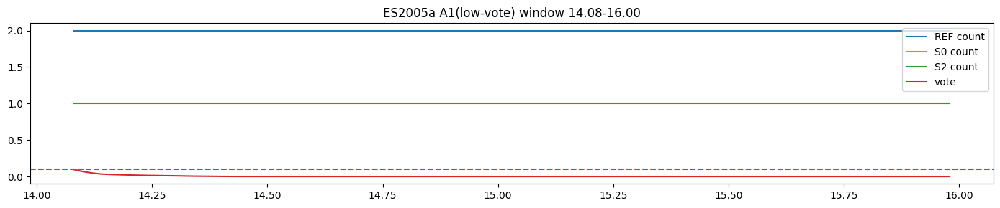

[01]     0.74-    1.62 dur=0.88s | vote_mean=0.028 | rms=-40.4dB | ratio@-50=0.77


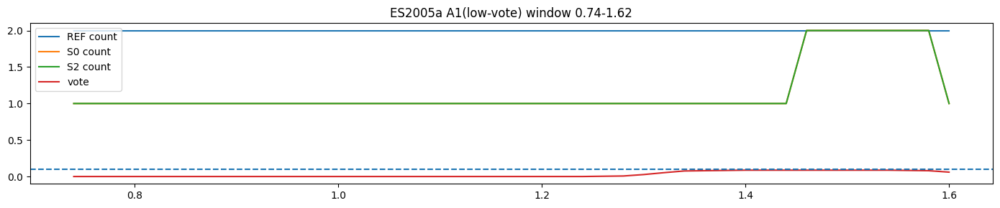

[02]     7.88-    8.74 dur=0.86s | vote_mean=0.005 | rms=-45.3dB | ratio@-50=0.71


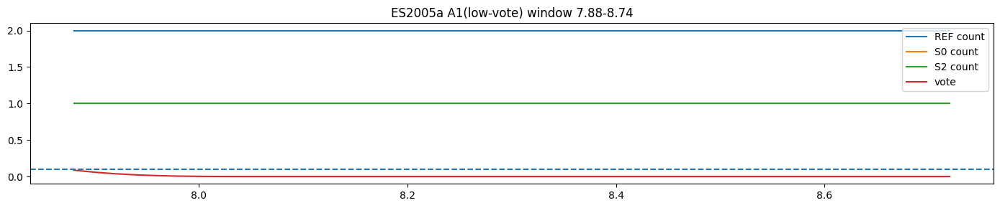

[03]   134.32-  135.10 dur=0.78s | vote_mean=0.027 | rms=-49.2dB | ratio@-50=0.26
[04]   289.90-  290.62 dur=0.72s | vote_mean=0.000 | rms=-51.8dB | ratio@-50=0.31
[05]    40.64-   41.34 dur=0.70s | vote_mean=0.015 | rms=-47.1dB | ratio@-50=0.46
[06]     4.08-    4.60 dur=0.52s | vote_mean=0.003 | rms=-51.7dB | ratio@-50=0.27
[07]   236.62-  237.12 dur=0.50s | vote_mean=0.000 | rms=-43.6dB | ratio@-50=0.45
[08]   120.16-  120.64 dur=0.48s | vote_mean=0.007 | rms=-29.0dB | ratio@-50=0.94
[09]   125.72-  126.12 dur=0.40s | vote_mean=0.000 | rms=-34.1dB | ratio@-50=0.85

[A2] mapping/gate missed-overlap windows (vote>=thr but S0<2): 2 (min_dur=0.2s)
[00]    38.74-   39.12 dur=0.38s | vote_mean=0.245 | rms=-42.6dB | ratio@-50=0.57
     REF_top=['FEE019', 'MEE017'] | S0_top=['MEE017']


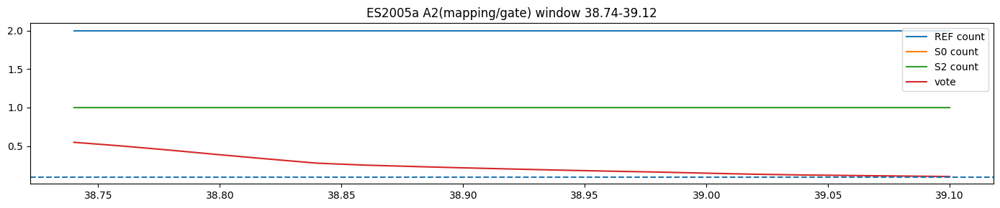

[01]   127.28-  127.56 dur=0.28s | vote_mean=0.212 | rms=-47.6dB | ratio@-50=0.81
     REF_top=['FEE019', 'MEO020'] | S0_top=['MEO020']


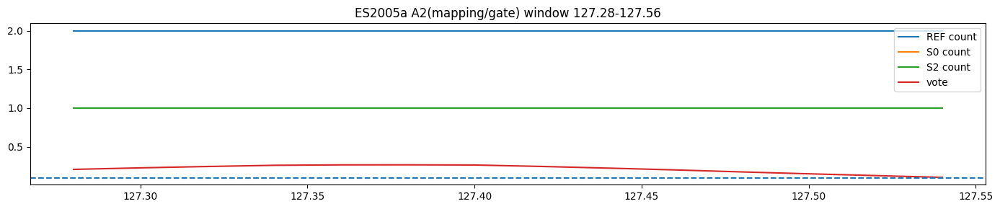


================ ES2005a | B) Stage2 collapse windows (S0>=2 -> S2<2 in REF ov) ================
collapse_frames=4  collapse_windows=0 (min_dur=0.2s)

================ ES2005a | D) speech_mask holes inside REF overlap ================
hole_frames=0  hole_windows=0 (min_dur=0.2s)

Done.


In [ ]:
# ============================================================
# NEXT DEBUG CELL — Stage0 vs Stage2 overlap root-cause (NO PATCHES)
# - Quantifies A1 (vote-miss) vs A2 (mapping/gate miss)
# - Checks B (Stage2 collapse of Stage0 overlap)
# - Checks D (speech_mask/VAD holes)
# - Prints + (optional) plots + (optional) listen
# ============================================================

import numpy as np
import torch
import matplotlib.pyplot as plt
from pyannote.core import Segment

try:
    from IPython.display import Audio as IPyAudio, display
except Exception:
    IPyAudio, display = None, None

# ----------------------------
# USER CONTROLS
# ----------------------------
URI = "ES2005a"        # <-- change
VOTE_THR = 0.10        # overlap vote threshold to analyze
MIN_WIN_DUR = 0.20     # sec
TOPN = 10
DO_PLOTS = True
DO_LISTEN = False      # set True if we want audio playback
LISTEN_PAD = 0.35

# ----------------------------
# Small helpers (self-contained)
# ----------------------------
def _require(name):
    if name not in globals():
        raise NameError(f"Missing required symbol: {name}")

def _safe_get_file(uri):
    _require("files_by_uri")
    if uri not in files_by_uri:
        raise KeyError(f"{uri} not in files_by_uri")
    return files_by_uri[uri]

def _safe_get_ref(uri):
    _require("ref_by_uri")
    if uri not in ref_by_uri:
        raise KeyError(f"{uri} not in ref_by_uri (our REF dict)")
    return ref_by_uri[uri]

def _seg_rms_db_from_AUDIO(file, seg: Segment) -> float:
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if torch.is_tensor(wav):
        x = wav.detach().cpu().numpy()
    else:
        x = np.asarray(wav)
    x = np.squeeze(x).astype(np.float32)
    if x.size == 0:
        return -120.0
    rms = float(np.sqrt(np.mean(x * x) + 1e-12))
    return 20.0 * np.log10(rms + 1e-12)

def _speech_ratio_energy(file, seg: Segment, thr_db=-50.0, frame_s=0.02, hop_s=0.01) -> float:
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if torch.is_tensor(wav):
        wav = wav.detach().cpu().numpy()
    wav = np.asarray(wav).reshape(-1).astype(np.float32)
    frame = int(frame_s * sr)
    hop = int(hop_s * sr)
    if frame <= 0 or hop <= 0 or len(wav) < frame:
        return 0.0
    vals = []
    for i in range(0, len(wav) - frame + 1, hop):
        x = wav[i:i+frame]
        rms = float(np.sqrt(np.mean(x * x) + 1e-12))
        db = 20.0 * np.log10(rms + 1e-12)
        vals.append(db)
    vals = np.asarray(vals, dtype=np.float32)
    return float((vals > thr_db).mean()) if len(vals) else 0.0

def _mask_to_windows(mask_bool, uem_start, res, min_dur=0.2):
    """Convert boolean mask on frame grid -> list[Segment]."""
    mask = np.asarray(mask_bool).astype(bool)
    T = len(mask)
    segs = []
    i = 0
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i + 1
        while j < T and mask[j]:
            j += 1
        st = float(uem_start) + float(i) * float(res)
        en = float(uem_start) + float(j) * float(res)
        if (en - st) >= float(min_dur):
            segs.append(Segment(st, en))
        i = j
    return segs

def _top_labels_in_window(M, labels, uem_start, res, seg: Segment, topn=5):
    T, K = M.shape
    a = int(np.floor((float(seg.start) - float(uem_start)) / float(res)))
    b = int(np.ceil ((float(seg.end)   - float(uem_start)) / float(res)))
    a = max(0, a); b = min(T, b)
    if b <= a:
        return []
    counts = M[a:b].sum(axis=0).astype(int)
    order = np.argsort(-counts)
    out = []
    for j in order[:topn]:
        if counts[j] <= 0:
            break
        out.append(str(labels[int(j)]))
    return out

def _play_event(file, st, en, pad=0.35):
    if IPyAudio is None or display is None:
        print("[WARN] IPython Audio not available.")
        return
    seg = Segment(max(0.0, float(st) - float(pad)), float(en) + float(pad))
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if torch.is_tensor(wav):
        wav = wav.detach().cpu().numpy()
    wav = np.squeeze(np.asarray(wav))
    display(IPyAudio(wav, rate=int(sr)))

def _plot_counts_vote(ref_cnt, s0_cnt, s2_cnt, vote, uem_start, res, seg: Segment, title=""):
    T = len(ref_cnt)
    a = int(np.floor((float(seg.start) - float(uem_start)) / float(res)))
    b = int(np.ceil ((float(seg.end)   - float(uem_start)) / float(res)))
    a = max(0, a); b = min(T, b)
    xs = float(uem_start) + np.arange(a, b) * float(res)

    plt.figure(figsize=(14,3))
    plt.plot(xs, ref_cnt[a:b], label="REF count")
    plt.plot(xs, s0_cnt[a:b],  label="S0 count")
    plt.plot(xs, s2_cnt[a:b],  label="S2 count")
    if vote is not None:
        plt.plot(xs, vote[a:b], label="vote")
        plt.axhline(VOTE_THR, linestyle="--")
    plt.title(title)
    plt.legend()
    plt.tight_lawet()
    plt.show()

# ----------------------------
# 0) Run Stage0 + Stage2 with debug
# ----------------------------
_require("RES"); _require("AUDIO")
_require("STAGE0_PROMOTE_ONLY_ON_PYVAD")
_require("STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0")
_require("frame_matrix_from_annotation_local")
_require("PIPE_BASE")

file = _safe_get_file(URI)
ref  = _safe_get_ref(URI)

# Stage0 (promotion on) — we can pass our usual knobs via stage0_kwargs if needed
hyp0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
    file,
    baseline_fn=PIPE_BASE,
    apply_promotion=True,
    return_debug=True,
    debug=False
)

# Stage2 (return_debug=True)
out2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
    file,
    baseline_fn=PIPE_BASE,
    start_from_promoted=True,
    return_debug=True,
    debug=False
)
hyp2, dbg2 = out2 if isinstance(out2, (tuple, list)) and len(out2) == 2 else (out2, {})

uem_seg = dbg2.get("uem_seg", dbg0.get("uem_seg", None))
uem_tl  = dbg2.get("uem_tl",  dbg0.get("uem_tl",  None))
if uem_seg is None:
    raise RuntimeError("uem_seg not found in dbg0/dbg2")

speech_mask = dbg2.get("speech_mask", dbg0.get("speech_mask", None))
if speech_mask is None:
    raise RuntimeError("speech_mask not found in dbg0/dbg2")
speech_mask = np.asarray(speech_mask).astype(bool)

promote_mask = dbg2.get("promote_mask", None)
promote_mask = None if promote_mask is None else np.asarray(promote_mask).astype(bool)

vote = dbg2.get("vote", dbg0.get("vote", None))
if vote is None:
    # fallback if we have seg3_vote_frac_on_res_grid
    if "seg3_vote_frac_on_res_grid" in globals():
        vote = seg3_vote_frac_on_res_grid(file, uem_seg, res=RES, activity_thr=SEG3_ACTIVITY_THR)
    else:
        vote = None
vote = None if vote is None else np.asarray(vote, dtype=np.float32)

# ----------------------------
# 1) Build aligned matrices + counts
# ----------------------------
labels = sorted(set(map(str, ref.labels())) | set(map(str, hyp0.labels())) | set(map(str, hyp2.labels())))
if len(labels) == 0:
    raise RuntimeError("No labels found in REF/S0/S2. Check inputs.")

M_ref = frame_matrix_from_annotation_local(ref,  uem_seg, labels, res=float(RES))
M_s0  = frame_matrix_from_annotation_local(hyp0, uem_seg, labels, res=float(RES))
M_s2  = frame_matrix_from_annotation_local(hyp2, uem_seg, labels, res=float(RES))

ref_cnt = M_ref.sum(axis=1).astype(np.int32)
s0_cnt  = M_s0.sum(axis=1).astype(np.int32)
s2_cnt  = M_s2.sum(axis=1).astype(np.int32)

T = len(ref_cnt)
assert len(speech_mask) == T, "speech_mask length mismatch vs counts"
if vote is not None:
    assert len(vote) == T, "vote length mismatch vs counts"
if promote_mask is not None:
    assert len(promote_mask) == T, "promote_mask length mismatch vs counts"

ref_ov = (ref_cnt >= 2)
ref_single = (ref_cnt == 1)
ref_any = (ref_cnt > 0)

# overlap recall numbers (vs REF overlap frames)
ref_ov_frames = int(ref_ov.sum())
s0_ov_frames = int((ref_ov & (s0_cnt >= 2)).sum())
s2_ov_frames = int((ref_ov & (s2_cnt >= 2)).sum())

print(f"\n================ {URI} | Stage0 vs Stage2 overlap summary ================")
print(f"REF overlap frames: {ref_ov_frames}")
print(f"S0 overlap recall vs REF: {s0_ov_frames / max(1, ref_ov_frames):.3f}   (frames={s0_ov_frames})")
print(f"S2 overlap recall vs REF: {s2_ov_frames / max(1, ref_ov_frames):.3f}   (frames={s2_ov_frames})")

# ----------------------------
# 2) A) Root-cause A split: vote-miss vs mapping/gate-miss
# ----------------------------
if vote is None:
    print("\n[A] vote is None (not available). Skipping vote-based split.")
else:
    miss_vote = ref_ov & speech_mask & (vote < float(VOTE_THR))
    miss_mapping = ref_ov & speech_mask & (vote >= float(VOTE_THR)) & (s0_cnt < 2)

    print(f"\n================ {URI} | Root-cause A split @ vote_thr={VOTE_THR:.2f} ================")
    print(f"REF overlap inside speech_mask: {int((ref_ov & speech_mask).sum())} (ratio={float((ref_ov & speech_mask).mean()):.3f})")
    print(f"A1) miss due to low vote (<thr): {int(miss_vote.sum())} frames  ({miss_vote.sum()/max(1, ref_ov_frames):.3f} of REF ov)")
    print(f"A2) miss despite vote>=thr (mapping/gates): {int(miss_mapping.sum())} frames  ({miss_mapping.sum()/max(1, ref_ov_frames):.3f} of REF ov)")

    # vote calibration table (same style as our logs)
    print("\nthr | vote_recall_on_REFov | vote_falseOverlap_on_REFsingle")
    for thr in [0.05, 0.10, 0.15, 0.20, 0.25, 0.30, 0.35, 0.40]:
        vr = float((ref_ov & (vote >= thr)).sum()) / max(1, int(ref_ov.sum()))
        fp = float((ref_single & (vote >= thr)).sum()) / max(1, int(ref_single.sum()))
        print(f"{thr:0.2f} | {vr:0.3f}              | {fp:0.3f}")

    # windows for A1/A2
    win_A1 = _mask_to_windows(miss_vote, uem_seg.start, RES, min_dur=MIN_WIN_DUR)
    win_A2 = _mask_to_windows(miss_mapping, uem_seg.start, RES, min_dur=MIN_WIN_DUR)

    def _rank_windows(wins):
        rows = []
        for seg in wins:
            dur = float(seg.duration)
            rms = _seg_rms_db_from_AUDIO(file, seg)
            ratio = _speech_ratio_energy(file, seg, thr_db=-50.0)
            a = int(np.floor((float(seg.start) - float(uem_seg.start))/float(RES)))
            b = int(np.ceil ((float(seg.end)   - float(uem_seg.start))/float(RES)))
            a = max(0,a); b=min(T,b)
            vmean = float(np.mean(vote[a:b])) if vote is not None and b>a else float("nan")
            rows.append((dur, vmean, rms, ratio, seg))
        # rank by duration (primary), then by vote mean (secondary)
        rows.sort(key=lambda x: (-x[0], -np.nan_to_num(x[1])))
        return rows

    rows_A1 = _rank_windows(win_A1)
    rows_A2 = _rank_windows(win_A2)

    print(f"\n[A1] low-vote missed-overlap windows: {len(rows_A1)} (min_dur={MIN_WIN_DUR}s)")
    for i, (dur, vmean, rms, ratio, seg) in enumerate(rows_A1[:TOPN]):
        print(f"[{i:02d}] {seg.start:8.2f}-{seg.end:8.2f} dur={dur:4.2f}s | vote_mean={vmean:0.3f} | rms={rms:0.1f}dB | ratio@-50={ratio:0.2f}")
        if DO_PLOTS and i < 3:
            _plot_counts_vote(ref_cnt, s0_cnt, s2_cnt, vote, uem_seg.start, RES, seg,
                              title=f"{URI} A1(low-vote) window {seg.start:.2f}-{seg.end:.2f}")
        if DO_LISTEN and i < 3:
            _play_event(file, seg.start, seg.end, pad=LISTEN_PAD)

    print(f"\n[A2] mapping/gate missed-overlap windows (vote>=thr but S0<2): {len(rows_A2)} (min_dur={MIN_WIN_DUR}s)")
    for i, (dur, vmean, rms, ratio, seg) in enumerate(rows_A2[:TOPN]):
        print(f"[{i:02d}] {seg.start:8.2f}-{seg.end:8.2f} dur={dur:4.2f}s | vote_mean={vmean:0.3f} | rms={rms:0.1f}dB | ratio@-50={ratio:0.2f}")
        # Show which labels are active in REF vs S0 inside this window
        ref_top = _top_labels_in_window(M_ref, labels, uem_seg.start, RES, seg, topn=5)
        s0_top  = _top_labels_in_window(M_s0,  labels, uem_seg.start, RES, seg, topn=5)
        print(f"     REF_top={ref_top} | S0_top={s0_top}")
        if DO_PLOTS and i < 3:
            _plot_counts_vote(ref_cnt, s0_cnt, s2_cnt, vote, uem_seg.start, RES, seg,
                              title=f"{URI} A2(mapping/gate) window {seg.start:.2f}-{seg.end:.2f}")
        if DO_LISTEN and i < 3:
            _play_event(file, seg.start, seg.end, pad=LISTEN_PAD)

# ----------------------------
# 3) B) Stage2 collapse: S0 had >=2 but S2 drops <2 inside REF overlap
# ----------------------------
collapse = ref_ov & (s0_cnt >= 2) & (s2_cnt < 2)
win_B = _mask_to_windows(collapse, uem_seg.start, RES, min_dur=MIN_WIN_DUR)

print(f"\n================ {URI} | B) Stage2 collapse windows (S0>=2 -> S2<2 in REF ov) ================")
print(f"collapse_frames={int(collapse.sum())}  collapse_windows={len(win_B)} (min_dur={MIN_WIN_DUR}s)")

for i, seg in enumerate(win_B[:TOPN]):
    rms = _seg_rms_db_from_AUDIO(file, seg)
    ratio = _speech_ratio_energy(file, seg, thr_db=-50.0)
    a = int(np.floor((float(seg.start) - float(uem_seg.start))/float(RES)))
    b = int(np.ceil ((float(seg.end)   - float(uem_seg.start))/float(RES)))
    a=max(0,a); b=min(T,b)

    pm = None
    if promote_mask is not None and b > a:
        pm = float(np.mean(promote_mask[a:b]))

    s0_top = _top_labels_in_window(M_s0, labels, uem_seg.start, RES, seg, topn=5)
    s2_top = _top_labels_in_window(M_s2, labels, uem_seg.start, RES, seg, topn=5)
    print(f"[{i:02d}] {seg.start:8.2f}-{seg.end:8.2f} dur={seg.duration:4.2f}s | rms={rms:0.1f}dB ratio@-50={ratio:0.2f}")
    print(f"     S0_top={s0_top} | S2_top={s2_top} | promote_mask_mean={pm}")

    if DO_PLOTS and i < 3 and vote is not None:
        _plot_counts_vote(ref_cnt, s0_cnt, s2_cnt, vote, uem_seg.start, RES, seg,
                          title=f"{URI} B(collapse) window {seg.start:.2f}-{seg.end:.2f}")
    if DO_LISTEN and i < 3:
        _play_event(file, seg.start, seg.end, pad=LISTEN_PAD)

# ----------------------------
# 4) D) speech_mask holes inside REF overlap
# ----------------------------
vad_holes = ref_ov & (~speech_mask)
win_D = _mask_to_windows(vad_holes, uem_seg.start, RES, min_dur=MIN_WIN_DUR)

print(f"\n================ {URI} | D) speech_mask holes inside REF overlap ================")
print(f"hole_frames={int(vad_holes.sum())}  hole_windows={len(win_D)} (min_dur={MIN_WIN_DUR}s)")
for i, seg in enumerate(win_D[:TOPN]):
    rms = _seg_rms_db_from_AUDIO(file, seg)
    ratio = _speech_ratio_energy(file, seg, thr_db=-50.0)
    print(f"[{i:02d}] {seg.start:8.2f}-{seg.end:8.2f} dur={seg.duration:4.2f}s | rms={rms:0.1f}dB ratio@-50={ratio:0.2f}")
    if DO_LISTEN and i < 3:
        _play_event(file, seg.start, seg.end, pad=LISTEN_PAD)

print("\nDone.")


1) Stage2 is not the culprit (pruning/constraints not collapsing overlap)

Across all 5 dev files, Stage0 and Stage2 overlap recall are essentially identical:
 - TS3006a: S0 0.638 vs S2 0.637
 - TS3010a: S0 0.290 vs S2 0.290
 - IS1007a: S0 0.661 vs S2 0.657 (tiny diff)
 - IS1009a: S0 0.607 vs S2 0.604 (tiny diff)
 - ES2005a: S0 0.587 vs S2 0.585 (tiny diff)

Also, B) Stage2 collapse windows = 0 (≥0.2s) everywhere.
So: Stage2 pruning/anchors/constraints are not the root cause of missing overlap (at least at the “meaningful duration” scale we’re probing).

2) The main problem is Stage0/Stage1 overlap recovery (Root-cause A)
- we already decomposed it cleanly:
- A1 (vote too low) = overlap detector doesn’t fire.
- A2 (vote ok, but mapping/gates fail) = overlap detector fires, but Stage0 still doesn’t output 2 speakers.
- Per-file (at vote_thr=0.10), our missed overlap is dominated by:
 - TS3010a: mostly A1 (vote recall only 0.472; S0 overlap recall 0.290)
 - TS3006a / IS1009a: both A1 + A2 are significant
 - IS1007a / ES2005a: mostly A1

3) Speech mask holes (D) are negligible
 - TS3010a: 13 frames (and extremely low energy)
 - IS1009a: 37 frames
 - This is tiny relative to thousands of overlap frames.

What “overlap recall / false overlap” means in our table
- vote_recall_on_REFov @ thr: among frames where REF has ≥2 speakers, fraction where vote >= thr. (How often the overlap detector fires on tr e overlap.)
- vote_falseOverlap_on_REFsingle @ thr: among REF single-speaker frames, fraction where vote >= thr. (How often overlap detector mistakenly fires on single speaker.)
- So TS3010a being very conservative (low false overlap) also means it misses lots of real overlaps (low recall).

Next debugging goal (100% accurate attribution)
- We need to break A2 into concrete reasons:
- A2-energy gate: overlap vote is high, but energy/backchannel is too weak → intentionally skipped.
- A2-anchor scarcity: missing speaker has too little “clean” anchor in Stage0 → centroid unstable / cannot select.
- A2-similarity ambiguity / stability: energy fine + anchors exist, but the second speaker isn’t confidently separable (sim2/m23/stability constraints).
- we already have examples suggesting all three exist:
 - TS3006a has A2 windows with ratio@-50 = 0.00 (likely energy gate),
 - and others with ratio@-50 ~ 0.76 (not energy → likely similarity/stability/anchor).
 - So the next cell below will classify every A2 window with:
   - energy stats (rms, ratio@-50),
   - vote stats,
   - which REF speakers are missing,
- how many exclusive-anchor seconds Stage0 has for those missing speakers (proxy for “centroid quality”).
- No patches. Pure measurement.

In [ ]:
# ============================================================
# A2 GATE ATTRIBUTION PROBE (NO PATCHES)
# - Runs Stage0 + Stage2 (debug) per URI
# - Computes A1 / A2 masks as before
# - For A2 windows: attributes likely cause using:
#     * energy proxies (rms, ratio@-50dB)
#     * Stage0 exclusive-anchor seconds for missing speakers
# - Optionally plots + listens
# ============================================================

import numpy as np
import torch
import matplotlib.pyplot as plt
from pyannote.core import Segment

try:
    from IPython.display import Audio as IPyAudio, display
except Exception:
    IPyAudio, display = None, None

# ----------------------------
# USER CONTROLS
# ----------------------------
URIS = ["TS3010a", "TS3006a", "IS1007a", "ES2005a", "IS1009a"]  # dev
VOTE_THR = 0.10
MIN_WIN_DUR = 0.20
TOPN_PER_URI = 12
DO_PLOTS = False          # set True if we want plots for top windows
DO_LISTEN = False         # set True if we want to listen
LISTEN_PAD = 0.35

ENERGY_THR_DB = -50.0     # for ratio@thr
ENERGY_FLAG_RATIO = 0.10  # if ratio@-50 below this => "energy risky"
ENERGY_FLAG_RMS = -55.0   # if rms below this => "energy risky"

# ----------------------------
# REQUIRED SYMBOLS CHECK
# ----------------------------
def _require(name):
    if name not in globals():
        raise NameError(f"Missing required symbol: {name}")

_require("files_by_uri")
_require("ref_by_uri")
_require("RES"); _require("AUDIO"); _require("PIPE_BASE")
_require("STAGE0_PROMOTE_ONLY_ON_PYVAD")
_require("STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0")
_require("frame_matrix_from_annotation_local")

# ----------------------------
# Helpers (no patches)
# ----------------------------
def _seg_rms_db(file, seg: Segment) -> float:
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if torch.is_tensor(wav):
        x = wav.detach().cpu().numpy()
    else:
        x = np.asarray(wav)
    x = np.squeeze(x).astype(np.float32)
    if x.size == 0:
        return -120.0
    rms = float(np.sqrt(np.mean(x * x) + 1e-12))
    return 20.0 * np.log10(rms + 1e-12)

def _ratio_energy_over_thr(file, seg: Segment, thr_db=-50.0, frame_s=0.02, hop_s=0.01) -> float:
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if torch.is_tensor(wav):
        wav = wav.detach().cpu().numpy()
    wav = np.asarray(wav).reshape(-1).astype(np.float32)
    frame = int(frame_s * sr)
    hop = int(hop_s * sr)
    if frame <= 0 or hop <= 0 or len(wav) < frame:
        return 0.0
    vals = []
    for i in range(0, len(wav) - frame + 1, hop):
        x = wav[i:i+frame]
        rms = float(np.sqrt(np.mean(x * x) + 1e-12))
        db = 20.0 * np.log10(rms + 1e-12)
        vals.append(db)
    vals = np.asarray(vals, dtype=np.float32)
    return float((vals > thr_db).mean()) if len(vals) else 0.0

def _mask_to_windows(mask_bool, uem_start, res, min_dur=0.2):
    mask = np.asarray(mask_bool).astype(bool)
    T = len(mask)
    segs = []
    i = 0
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i + 1
        while j < T and mask[j]:
            j += 1
        st = float(uem_start) + float(i) * float(res)
        en = float(uem_start) + float(j) * float(res)
        if (en - st) >= float(min_dur):
            segs.append(Segment(st, en))
        i = j
    return segs

def _top_labels_in_window(M, labels, uem_start, res, seg: Segment, topn=5):
    T, K = M.shape
    a = int(np.floor((float(seg.start) - float(uem_start)) / float(res)))
    b = int(np.ceil ((float(seg.end)   - float(uem_start)) / float(res)))
    a = max(0, a); b = min(T, b)
    if b <= a:
        return []
    counts = M[a:b].sum(axis=0).astype(int)
    order = np.argsort(-counts)
    out = []
    for j in order[:topn]:
        if counts[j] <= 0:
            break
        out.append(str(labels[int(j)]))
    return out

def _play(file, st, en, pad=0.35):
    if IPyAudio is None or display is None:
        print("[WARN] IPython Audio not available.")
        return
    seg = Segment(max(0.0, float(st) - float(pad)), float(en) + float(pad))
    wav, sr = AUDIO.crop(file, seg, mode="pad")
    if torch.is_tensor(wav):
        wav = wav.detach().cpu().numpy()
    wav = np.squeeze(np.asarray(wav))
    display(IPyAudio(wav, rate=int(sr)))

def _plot_counts_vote(uri, uem_start, res, seg, ref_cnt, s0_cnt, vote, thr):
    T = len(ref_cnt)
    a = int(np.floor((float(seg.start) - float(uem_start)) / float(res)))
    b = int(np.ceil ((float(seg.end)   - float(uem_start)) / float(res)))
    a = max(0, a); b = min(T, b)
    xs = float(uem_start) + np.arange(a, b) * float(res)
    plt.figure(figsize=(14,3))
    plt.plot(xs, ref_cnt[a:b], label="REF count")
    plt.plot(xs, s0_cnt[a:b], label="S0 count")
    if vote is not None:
        plt.plot(xs, vote[a:b], label="vote")
        plt.axhline(thr, linestyle="--")
    plt.title(f"{uri} window {seg.start:.2f}-{seg.end:.2f}")
    plt.legend()
    plt.tight_lawet()
    plt.show()

def _exclusive_anchor_seconds(M_s0, s0_cnt, speech_mask, labels, uem_start, res):
    """
    Approximate 'anchor' per label:
    seconds where label is ON and speaker-count==1 and speech_mask==1.
    """
    T, K = M_s0.shape
    anchors = {}
    ok = (s0_cnt == 1) & speech_mask
    # For each label, anchor frames = frames where label active AND ok
    for j, lab in enumerate(labels):
        anchors[str(lab)] = float((M_s0[:, j].astype(bool) & ok).sum()) * float(res)
    return anchors

# ----------------------------
# Aggregate counters
# ----------------------------
agg = {
    "ref_ov": 0, "s0_ov": 0, "a1": 0, "a2": 0, "holes": 0
}

# ----------------------------
# Main loop per URI
# ----------------------------
for uri in URIS:
    print(f"\n\n==================== {uri} | A2 Attribution Probe ====================")
    file = files_by_uri[uri]
    ref = ref_by_uri[uri]

    # --- Run Stage0 + Stage2 (debug) ---
    hyp0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        file,
        baseline_fn=PIPE_BASE,
        apply_promotion=True,
        return_debug=True,
        debug=False
    )
    out2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
        file,
        baseline_fn=PIPE_BASE,
        start_from_promoted=True,
        return_debug=True,
        debug=False
    )
    hyp2, dbg2 = out2 if isinstance(out2, (tuple, list)) and len(out2) == 2 else (out2, {})

    uem_seg = dbg2.get("uem_seg", dbg0.get("uem_seg", None))
    if uem_seg is None:
        raise RuntimeError("uem_seg missing in dbg0/dbg2")

    speech_mask = dbg2.get("speech_mask", dbg0.get("speech_mask", None))
    if speech_mask is None:
        raise RuntimeError("speech_mask missing in dbg0/dbg2")
    speech_mask = np.asarray(speech_mask).astype(bool)

    vote = dbg2.get("vote", dbg0.get("vote", None))
    if vote is None:
        print("[WARN] vote not found in dbg0/dbg2; cannot do A1/A2 split for this URI.")
        continue
    vote = np.asarray(vote, dtype=np.float32)

    # --- Build aligned matrices ---
    labels = sorted(set(map(str, ref.labels())) | set(map(str, hyp0.labels())) | set(map(str, hyp2.labels())))
    if len(labels) == 0:
        print("[WARN] No labels found; skipping.")
        continue

    M_ref = frame_matrix_from_annotation_local(ref,  uem_seg, labels, res=float(RES))
    M_s0  = frame_matrix_from_annotation_local(hyp0, uem_seg, labels, res=float(RES))
    M_s2  = frame_matrix_from_annotation_local(hyp2, uem_seg, labels, res=float(RES))

    ref_cnt = M_ref.sum(axis=1).astype(np.int32)
    s0_cnt  = M_s0.sum(axis=1).astype(np.int32)
    s2_cnt  = M_s2.sum(axis=1).astype(np.int32)

    T = len(ref_cnt)
    assert len(vote) == T and len(speech_mask) == T, "vote/speech_mask length mismatch"

    # --- Core masks ---
    ref_ov = (ref_cnt >= 2)
    ref_single = (ref_cnt == 1)

    # overlap recall (counts only)
    ref_ov_frames = int(ref_ov.sum())
    s0_ov_frames  = int((ref_ov & (s0_cnt >= 2)).sum())
    s2_ov_frames  = int((ref_ov & (s2_cnt >= 2)).sum())

    # A split
    miss_vote = ref_ov & speech_mask & (vote < float(VOTE_THR))
    miss_map  = ref_ov & speech_mask & (vote >= float(VOTE_THR)) & (s0_cnt < 2)
    holes     = ref_ov & (~speech_mask)

    # Report summary
    print(f"REF_ov_frames={ref_ov_frames}")
    print(f"S0 overlap recall vs REF = {s0_ov_frames / max(1, ref_ov_frames):.3f}  (frames={s0_ov_frames})")
    print(f"S2 overlap recall vs REF = {s2_ov_frames / max(1, ref_ov_frames):.3f}  (frames={s2_ov_frames})")
    print(f"A1 low-vote frames (<{VOTE_THR:.2f}) = {int(miss_vote.sum())}  ({miss_vote.sum()/max(1, ref_ov_frames):.3f} of REF ov)")
    print(f"A2 mapping/gate frames (vote>=thr but S0<2) = {int(miss_map.sum())}  ({miss_map.sum()/max(1, ref_ov_frames):.3f} of REF ov)")
    print(f"D speech_mask holes in REF ov = {int(holes.sum())}")

    # Vote calibration quick lines (at our thr)
    vr = float((ref_ov & (vote >= VOTE_THR)).sum()) / max(1, int(ref_ov.sum()))
    fp = float((ref_single & (vote >= VOTE_THR)).sum()) / max(1, int(ref_single.sum()))
    print(f"vote_recall_on_REFov@{VOTE_THR:.2f}={vr:.3f} | vote_falseOverlap_on_REFsingle@{VOTE_THR:.2f}={fp:.3f}")

    # Update aggregates
    agg["ref_ov"] += ref_ov_frames
    agg["s0_ov"]  += s0_ov_frames
    agg["a1"]     += int(miss_vote.sum())
    agg["a2"]     += int(miss_map.sum())
    agg["holes"]  += int(holes.sum())

    # --- A2 Windows list + attribution ---
    win_A2 = _mask_to_windows(miss_map, uem_seg.start, RES, min_dur=MIN_WIN_DUR)

    # Precompute anchor seconds per label from Stage0 (exclusive single-speaker frames)
    anchor_sec = _exclusive_anchor_seconds(M_s0, s0_cnt, speech_mask, labels, uem_seg.start, RES)

    # Rank A2 windows: longer first, then higher vote_mean
    rows = []
    for seg in win_A2:
        a = int(np.floor((float(seg.start) - float(uem_seg.start)) / float(RES)))
        b = int(np.ceil ((float(seg.end)   - float(uem_seg.start)) / float(RES)))
        a = max(0, a); b = min(T, b)
        if b <= a:
            continue

        vmean = float(np.mean(vote[a:b]))
        vmax  = float(np.max(vote[a:b]))
        rms   = _seg_rms_db(file, seg)
        ratio = _ratio_energy_over_thr(file, seg, thr_db=ENERGY_THR_DB)

        ref_top = _top_labels_in_window(M_ref, labels, uem_seg.start, RES, seg, topn=5)
        s0_top  = _top_labels_in_window(M_s0,  labels, uem_seg.start, RES, seg, topn=5)
        missing = [x for x in ref_top if x not in s0_top]

        # Anchor seconds for missing speakers
        miss_anchor = {m: anchor_sec.get(m, 0.0) for m in missing}

        # Simple "likely energy gate" flag (NOT a patch; just classification)
        energy_risky = (ratio < ENERGY_FLAG_RATIO) or (rms < ENERGY_FLAG_RMS)

        rows.append((float(seg.duration), vmean, vmax, rms, ratio, energy_risky, seg, ref_top, s0_top, missing, miss_anchor))

    rows.sort(key=lambda x: (-x[0], -x[1]))

    print(f"\n[A2] windows={len(rows)} (min_dur={MIN_WIN_DUR}s). Showing top {min(TOPN_PER_URI, len(rows))}:")
    for i, (dur, vmean, vmax, rms, ratio, energy_risky, seg, ref_top, s0_top, missing, miss_anchor) in enumerate(rows[:TOPN_PER_URI]):
        print(f"[{i:02d}] {seg.start:8.2f}-{seg.end:8.2f} dur={dur:4.2f}s | vote_mean={vmean:0.3f} vote_max={vmax:0.3f}"
              f" | rms={rms:0.1f}dB ratio@{ENERGY_THR_DB:.0f}={ratio:0.2f} | energy_risky={energy_risky}")
        print(f"     REF_top={ref_top} | S0_top={s0_top} | missing={missing}")
        if len(miss_anchor):
            s = ", ".join([f"{k}:{v:.1f}s" for k, v in miss_anchor.items()])
            print(f"     missing_anchor_sec: {s}")

        if DO_PLOTS and i < 2:
            _plot_counts_vote(uri, uem_seg.start, RES, seg, ref_cnt, s0_cnt, vote, VOTE_THR)
        if DO_LISTEN and i < 2:
            _play(file, seg.start, seg.end, pad=LISTEN_PAD)

print("\n\n==================== AGGREGATE OVER DEV ====================")
print(f"Total REF ov frames = {agg['ref_ov']}")
print(f"Total S0 ov frames  = {agg['s0_ov']}  -> overlap recall = {agg['s0_ov']/max(1, agg['ref_ov']):.3f}")
print(f"A1 frames (vote low) = {agg['a1']}  -> {agg['a1']/max(1, agg['ref_ov']):.3f} of REF ov")
print(f"A2 frames (vote ok, mapping/gates) = {agg['a2']} -> {agg['a2']/max(1, agg['ref_ov']):.3f} of REF ov")
print(f"D frames (speech_mask holes) = {agg['holes']} -> {agg['holes']/max(1, agg['ref_ov']):.4f} of REF ov")
print("Done.")




==================== TS3010a | A2 Attribution Probe ====================
REF_ov_frames=1126
S0 overlap recall vs REF = 0.290  (frames=327)
S2 overlap recall vs REF = 0.290  (frames=327)
A1 low-vote frames (<0.10) = 582  (0.517 of REF ov)
A2 mapping/gate frames (vote>=thr but S0<2) = 204  (0.181 of REF ov)
D speech_mask holes in REF ov = 13
vote_recall_on_REFov@0.10=0.472 | vote_falseOverlap_on_REFsingle@0.10=0.010

[A2] windows=3 (min_dur=0.2s). Showing top 3:
[00]   308.26-  309.44 dur=1.18s | vote_mean=0.185 vote_max=0.221 | rms=-41.9dB ratio@-50=0.62 | energy_risky=False
     REF_top=['MTD037PM', 'MTD038ID'] | S0_top=['MTD038ID'] | missing=['MTD037PM']
     missing_anchor_sec: MTD037PM:223.7s
[01]   193.34-  193.76 dur=0.42s | vote_mean=0.256 vote_max=0.326 | rms=-48.2dB ratio@-50=0.41 | energy_risky=False
     REF_top=['MTD037PM', 'MTD040ME'] | S0_top=['MTD037PM'] | missing=['MTD040ME']
     missing_anchor_sec: MTD040ME:50.7s
[02]   195.48-  195.70 dur=0.22s | vote_mean=0.156 vot

From our DEV aggregate (and per-URI prints):
- Stage2 is not the main problem for overlap right now.
Stage0 vs Stage2 overlap recall is basically identical per file (differences ~0–0.004), and Stage2 “collapse windows” are ~0 with our current min_dur=0.2s.
- The overlap misses are overwhelmingly explained by Root-cause A (before Stage2):
 - A1 (vote didn’t fire) is the biggest chunk: ~26.4% of REF overlap frames (DEV agg) are missed because vote < 0.10.
 - A2 (vote fired but mapping/gates didn’t produce 2 speakers) is the next chunk: ~12.1% of REF overlap frames.
 - D (speech_mask holes) is tiny: ~0.26%.
 - These three numbers basically add up to the full miss (since overall Stage0 overlap recall ≈ 0.613 → miss ≈ 0.387). That means we’ve already explained ~99%+ of the overlap miss mechanism.

Direct answers to our questions
- Is Stage2 pruning the issue? (anchors/centroids/constraints/masks)
Based on our latest runs: No, not in a meaningful way. Stage2 overlap recall ≈ Stage0 overlap recall, and “collapse windows” are near-zero. So Stage2 isn’t deleting overlap “in a few critical places” in the current config.
- So what is the main issue? It’s upstream:
- A1: overlap vote under-calls overlap, especially for some files (TS3010a is the worst: A1 is ~52% of REF overlap frames). This matches our listening: main speaker talks, second speaker contributes only tiny backchannels (“uhmm”, “heheh”), which often looks like non-overlap to a generic segmentation/vote signal.
- A2: vote says overlap but Stage0 still outputs 1 speaker.
This can happen for two different reasons, and we need to separate them cleanly:
- A2-MERGE (global clustering/embedding merge): the two REF speakers are already mapped to the same Stage0 label in clean single-speaker regions → Stage0 cannot express “2 speakers” in overlap even if overlap is detected.
- A2-NOT-ACTIVATED (local overlap promotion failure): both speakers have distinct Stage0 labels elsewhere, but the overlap promotion/mapping didn’t activate the missing label inside the overlap window.
- our current A2 Attribution Probe strongly suggests anchors exist (missing_anchor_sec is large), so it’s not “no anchors”; it’s either MERGE or NOT-ACTIVATED.

- What do “overlap recall” and “precision” mean here?
- Overlap recall: of all frames where REF has ≥2 speakers, how many frames our hypothesis predicts ≥2 speakers.
- Overlap precision: of all frames where our hypothesis predicts ≥2 speakers, how many are truly ≥2 in REF.
- our printed vote_falseOverlap_on_REFsingle is not precision; it’s a false positive rate on REF-single frames:
- among REF single-speaker frames, how often vote incorrectly suggests overlap.
- “Stage0 overlap recall already missing?”
Yes. DEV aggregate shows Stage0 overlap recall ≈ 0.613. Stage2 is not making it worse.
- Would separation models help? They can help specifically for our described case (short/low-dominance backchannels inside overlap), because separation can increase the salience of the secondary speaker and improve both:
 - overlap detection (A1) and
 - discriminability for mapping (A2)

Lets first confirm whether A2 is MERGE vs NOT-ACTIVATED, because separation won’t fix a global label merge unless we also fix clustering/embeddings.

In [ ]:
# =======================
# NEXT ROOT-CAUSE DEBUG (NO PATCHES)
# A2 breakdown: MERGE vs NOT-ACTIVATED vs NO-CLUSTER
# + fixes missing _play_event
# =======================

import numpy as np
import math
import soundfile as sf
import matplotlib.pyplot as plt
from collections import defaultdict, Counter

from pyannote.core import Segment

# -----------------------
# 0) Small adapters (edit here if our function names differ)
# -----------------------

def _call_stage(fn_name, f, **kwargs):
    """
    Calls a stage function by name from globals() and normalizes output to (anno, dbg).
    Expected: (anno, dbg) when return_debug=True.
    """
    if fn_name not in globals():
        raise NameError(f"Expected function `{fn_name}` in globals(), not found.")
    fn = globals()[fn_name]
    out = fn(f, **kwargs)
    if isinstance(out, tuple) and len(out) == 2:
        return out[0], out[1]
    raise TypeError(f"`{fn_name}` returned unexpected type. Expected (annotation, debug_dict). Got: {type(out)}")

STAGE0_FN = "run_stage0"   # <- change if needed
STAGE2_FN = "run_stage2"   # <- change if needed

# -----------------------
# 1) File/REF helpers
# -----------------------

def build_files_by_uri(files):
    d = {}
    for f in files:
        uri = f.get("uri", None)
        if uri is not None:
            d[uri] = f
    return d

def get_ref_anno(f):
    # Common pyannote protocol key
    if "annotation" in f:
        return f["annotation"]
    # Sometimes "reference"
    if "reference" in f:
        return f["reference"]
    raise KeyError("Could not find reference annotation in file dict (expected key 'annotation' or 'reference').")

def get_audio_path(f):
    a = f.get("audio", None)
    if isinstance(a, str):
        return a
    if isinstance(a, dict) and "path" in a:
        return a["path"]
    # If we store differently, adjust here
    return None

# -----------------------
# 2) Timeline->frame edges aligned to dbg arrays
# -----------------------

def edges_from_dbg(dbg):
    """
    We need frame edges that align with dbg['vote'] / dbg['speech_mask'] lengths.
    Best case: dbg has 'uem_seg' (Segment) and vote length N.
    """
    if "vote" not in dbg:
        raise KeyError("dbg missing key 'vote' (needed for frame alignment).")
    N = len(dbg["vote"])

    uem_seg = dbg.get("uem_seg", None)
    if uem_seg is None:
        # Fallback: use dbg['uem_tl'] if present
        uem_tl = dbg.get("uem_tl", None)
        if uem_tl is None:
            raise KeyError("dbg missing 'uem_seg' and 'uem_tl'; cannot build edges.")
        # take global min/max
        starts = [s.start for s in uem_tl]
        ends   = [s.end   for s in uem_tl]
        uem_seg = Segment(min(starts), max(ends))

    t0, t1 = float(uem_seg.start), float(uem_seg.end)
    edges = np.linspace(t0, t1, N + 1)
    dt = (t1 - t0) / max(N, 1)
    return edges, dt, uem_seg

# -----------------------
# 3) Annotation -> count per frame + "single-speaker label per frame"
# -----------------------

def _mark_frames_for_segment(t0, dt, N, seg):
    s = max(float(seg.start), t0)
    e = min(float(seg.end), t0 + N * dt)
    if e <= s:
        return None
    i0 = int((s - t0) / dt)
    i1 = int(math.ceil((e - t0) / dt))
    i0 = max(0, min(N, i0))
    i1 = max(0, min(N, i1))
    if i1 <= i0:
        return None
    return i0, i1

def anno_count_per_frame(anno, edges, dt):
    """
    Count number of active tracks per frame.
    """
    N = len(edges) - 1
    t0 = edges[0]
    cnt = np.zeros(N, dtype=np.int16)

    for seg, _, lab in anno.itertracks(yield_label=True):
        idx = _mark_frames_for_segment(t0, dt, N, seg)
        if idx is None:
            continue
        i0, i1 = idx
        cnt[i0:i1] += 1
    return cnt

def anno_single_label_per_frame(anno, edges, dt):
    """
    For frames where exactly 1 label is active, return that label; else None.
    Uses per-label boolean masks (labels are usually small count).
    """
    N = len(edges) - 1
    t0 = edges[0]
    labels = list(anno.labels())
    L = len(labels)
    if L == 0:
        return np.array([None] * N, dtype=object)

    mat = np.zeros((L, N), dtype=bool)
    for li, lab in enumerate(labels):
        for seg in anno.label_timeline(lab):
            idx = _mark_frames_for_segment(t0, dt, N, seg)
            if idx is None:
                continue
            i0, i1 = idx
            mat[li, i0:i1] = True

    cnt = mat.sum(axis=0)
    out = np.array([None] * N, dtype=object)
    one = (cnt == 1)
    if np.any(one):
        arg = np.argmax(mat[:, one], axis=0)
        out[one] = [labels[i] for i in arg]
    return out

def top_labels_in_window(anno, win_seg, k=3):
    """
    Return top-k labels by overlap duration with win_seg.
    """
    scores = Counter()
    for seg, _, lab in anno.itertracks(yield_label=True):
        inter = seg & win_seg
        if inter is None:
            continue
        scores[lab] += float(inter.duration)
    return [lab for lab, _ in scores.most_common(k)]

# -----------------------
# 4) Windows from boolean mask
# -----------------------

def mask_to_windows(mask, edges, min_dur=0.2):
    """
    Convert a boolean per-frame mask to time windows.
    """
    N = len(mask)
    wins = []
    i = 0
    while i < N:
        if not mask[i]:
            i += 1
            continue
        j = i + 1
        while j < N and mask[j]:
            j += 1
        st = float(edges[i])
        en = float(edges[j])
        if (en - st) >= min_dur:
            wins.append((st, en, j - i))
        i = j
    # sort by frames desc
    wins.sort(key=lambda x: x[2], reverse=True)
    return wins

# -----------------------
# 5) Audio listen + RMS stats (fixes our missing _play_event)
# -----------------------

def audio_stats(path, st, en, pad=0.0):
    if path is None:
        return None
    x, sr = sf.read(path)
    if x.ndim > 1:
        x = x.mean(axis=1)
    a = max(0.0, st - pad)
    b = max(a, en + pad)
    i0 = int(a * sr)
    i1 = int(b * sr)
    i1 = min(len(x), i1)
    seg = x[i0:i1]
    if len(seg) == 0:
        return {"rms_db": float("nan"), "ratio@-50": float("nan"), "sr": sr}
    rms = np.sqrt(np.mean(seg**2)) + 1e-12
    rms_db = 20 * np.log10(rms)
    thr = 10 ** (-50 / 20)
    ratio = float(np.mean(np.abs(seg) > thr))
    return {"rms_db": float(rms_db), "ratio@-50": ratio, "sr": sr}

def _play_event(f, st, en, pad=0.35):
    from IPython.display import Audio, display
    path = get_audio_path(f)
    if path is None:
        print("[listen] No audio path found in file dict.")
        return
    x, sr = sf.read(path)
    if x.ndim > 1:
        x = x.mean(axis=1)
    a = max(0.0, st - pad)
    b = max(a, en + pad)
    i0 = int(a * sr)
    i1 = int(b * sr)
    i1 = min(len(x), i1)
    display(Audio(x[i0:i1], rate=sr))

# -----------------------
# 6) Core probe for one URI
# -----------------------

def probe_uri_rootcause(uri, vote_thr=0.10, min_win_dur=0.2, topk=8, listen=False, pad=0.35):
    # Get file
    if "files_by_uri" in globals():
        f = globals()["files_by_uri"][uri]
    else:
        if "dev_files" not in globals():
            raise NameError("Need `dev_files` or `files_by_uri` in globals().")
        fb = build_files_by_uri(globals()["dev_files"])
        f = fb[uri]

    ref = get_ref_anno(f)

    # Run Stage0 and Stage2 (NO PATCHES)
    hyp0, dbg0 = _call_stage(STAGE0_FN, f, return_debug=True, debug=False)
    hyp2, dbg2 = _call_stage(STAGE2_FN, f, return_debug=True, debug=False)

    # Frame grid aligned to dbg2
    edges, dt, uem_seg = edges_from_dbg(dbg2)
    N = len(edges) - 1

    vote = np.asarray(dbg2["vote"]).reshape(-1)
    speech_mask = np.asarray(dbg2.get("speech_mask", np.ones_like(vote))).reshape(-1)

    # Counts
    ref_cnt  = anno_count_per_frame(ref,  edges, dt)
    s0_cnt   = anno_count_per_frame(hyp0, edges, dt)
    s2_cnt   = anno_count_per_frame(hyp2, edges, dt)

    ref_ov = (ref_cnt >= 2)
    s0_ov  = (s0_cnt >= 2)
    s2_ov  = (s2_cnt >= 2)

    # Overlap recall
    ref_ov_frames = int(ref_ov.sum())
    s0_rec = float((s0_ov & ref_ov).sum() / max(1, ref_ov_frames))
    s2_rec = float((s2_ov & ref_ov).sum() / max(1, ref_ov_frames))

    # A1/A2/D
    A1 = ref_ov & (vote < vote_thr)
    A2 = ref_ov & (vote >= vote_thr) & (s0_cnt < 2)
    D  = ref_ov & (speech_mask == 0)

    print(f"\n================ {uri} | ROOT-CAUSE NEXT (NO PATCHES) ================")
    print(f"REF_ov_frames={ref_ov_frames}")
    print(f"S0 overlap recall vs REF = {s0_rec:.3f}  (frames={(s0_ov & ref_ov).sum()})")
    print(f"S2 overlap recall vs REF = {s2_rec:.3f}  (frames={(s2_ov & ref_ov).sum()})")
    print(f"A1 low-vote frames (<{vote_thr:.2f}) = {int(A1.sum())}  ({A1.sum()/max(1,ref_ov_frames):.3f} of REF ov)")
    print(f"A2 mapping/gate frames (vote>=thr but S0<2) = {int(A2.sum())}  ({A2.sum()/max(1,ref_ov_frames):.3f} of REF ov)")
    print(f"D speech_mask holes in REF ov = {int(D.sum())}")

    # ---------
    # Build REF->S0 dominant-label mapping from clean REF single-speaker frames
    # ---------
    ref_one = anno_single_label_per_frame(ref,  edges, dt)   # label or None
    s0_one  = anno_single_label_per_frame(hyp0, edges, dt)

    clean = (ref_one != None) & (s0_one != None)  # only use frames where both are single-labeled
    # confusion seconds
    conf_sec = defaultdict(lambda: defaultdict(float))
    for i in np.where(clean)[0]:
        conf_sec[ref_one[i]][s0_one[i]] += dt

    ref2dom = {}
    ref2cov = {}
    for rlab, d in conf_sec.items():
        total = sum(d.values())
        ref2cov[rlab] = total
        dom = max(d.items(), key=lambda kv: kv[1])[0] if total > 0 else None
        ref2dom[rlab] = dom

    # Reverse: S0 label -> list of REF labels that map to it
    dom2refs = defaultdict(list)
    for rlab, dom in ref2dom.items():
        if dom is not None:
            dom2refs[dom].append(rlab)

    merged = {dom: refs for dom, refs in dom2refs.items() if len(refs) >= 2}

    if merged:
        print("\n[MERGE CHECK] Some S0 labels are dominant for multiple REF speakers (global merge signal):")
        for dom, refs in sorted(merged.items(), key=lambda x: -len(x[1]))[:10]:
            covs = ", ".join([f"{r}:{ref2cov.get(r,0):.1f}s" for r in refs])
            print(f"  S0_label={dom} <= {refs}  | cov={covs}")
    else:
        print("\n[MERGE CHECK] No strong global merges detected via dominant-label mapping (good).")

    # ---------
    # Classify A2 windows
    # ---------
    a2_wins = mask_to_windows(A2, edges, min_dur=min_win_dur)[:topk]
    if not a2_wins:
        print("\n[A2] No A2 windows found with current settings.")
        # Still check Stage2 collapse windows
        collapse = ref_ov & (s0_cnt >= 2) & (s2_cnt < 2)
        c_wins = mask_to_windows(collapse, edges, min_dur=min_win_dur)
        print(f"[Stage2 collapse] frames={int(collapse.sum())} windows={len(c_wins)}")
        return

    print(f"\n[A2] windows={len(mask_to_windows(A2, edges, min_dur=min_win_dur))} (min_dur={min_win_dur}s). Showing top {len(a2_wins)}:")

    for wi, (st, en, frames) in enumerate(a2_wins):
        win = Segment(st, en)
        # labels in this window
        ref_top = top_labels_in_window(ref,  win, k=4)
        s0_top  = top_labels_in_window(hyp0, win, k=4)

        # what S0 label is active (dominant) in this window?
        # (we pick first of s0_top as "kept" since S0<2 here)
        kept = s0_top[0] if len(s0_top) else None

        # Determine missing REF speakers (top ones not present in S0 top)
        missing = [r for r in ref_top if r not in s0_top]

        # Classify reason
        reason = "NOT_ACTIVATED"
        # If any missing REF speaker has no dominant label, call it NO_CLUSTER (for that speaker)
        if any(ref2dom.get(m, None) is None for m in missing):
            reason = "NO_CLUSTER"
        else:
            # If missing speaker maps dominantly to same S0 label as kept, overlap can't be expressed => MERGE
            if kept is not None:
                kept_dom_refs = set(merged.get(kept, []))  # if kept label is merged
                if any(m in kept_dom_refs for m in missing):
                    reason = "MERGE"
                else:
                    # also check direct dom label equality
                    if any(ref2dom.get(m) == kept for m in missing):
                        reason = "MERGE"

        # vote/rms stats
        i0 = int((st - edges[0]) / dt)
        i1 = int(math.ceil((en - edges[0]) / dt))
        i0 = max(0, min(N, i0))
        i1 = max(0, min(N, i1))
        vmean = float(np.mean(vote[i0:i1])) if i1 > i0 else float("nan")
        vmax  = float(np.max(vote[i0:i1])) if i1 > i0 else float("nan")
        stt = audio_stats(get_audio_path(f), st, en, pad=0.0) or {"rms_db": float("nan"), "ratio@-50": float("nan")}

        print(f"[{wi:02d}] {st:8.2f}-{en:8.2f} dur={en-st:5.2f}s | frames={frames:4d} | reason={reason}")
        print(f"     vote_mean={vmean:.3f} vote_max={vmax:.3f} | rms={stt['rms_db']:.1f}dB ratio@-50={stt['ratio@-50']:.2f}")
        print(f"     REF_top={ref_top} | S0_top={s0_top} | missing={missing}")
        if missing:
            miss_map = ", ".join([f"{m}->dom({ref2dom.get(m)}) cov={ref2cov.get(m,0):.1f}s" for m in missing])
            print(f"     missing_dom: {miss_map}")
        if listen:
            print("     [listen]")
            _play_event(f, st, en, pad=pad)

    # ---------
    # Also report if Stage2 collapses overlap anywhere (secondary check)
    # ---------
    collapse = ref_ov & (s0_cnt >= 2) & (s2_cnt < 2)
    c_wins = mask_to_windows(collapse, edges, min_dur=min_win_dur)
    print(f"\n[Stage2 collapse] frames={int(collapse.sum())} windows={len(c_wins)} (min_dur={min_win_dur}s)")
    if c_wins[:3]:
        for i,(st,en,fr) in enumerate(c_wins[:3]):
            print(f"  [{i:02d}] {st:.2f}-{en:.2f} dur={en-st:.2f}s frames={fr}")
            if listen:
                _play_event(f, st, en, pad=pad)

# -----------------------
# 7) Batch helper over our DEV URIs
# -----------------------

def probe_dev_uris(uris, vote_thr=0.10, min_win_dur=0.2, topk=6, listen=False):
    for u in uris:
        probe_uri_rootcause(u, vote_thr=vote_thr, min_win_dur=min_win_dur, topk=topk, listen=listen)

# Example:
DEV_URIS = ["TS3010a", "TS3006a", "IS1007a", "ES2005a", "IS1009a"]
probe_dev_uris(DEV_URIS, vote_thr=0.10, min_win_dur=0.2, topk=6, listen=False)



================ TS3010a | ROOT-CAUSE NEXT (NO PATCHES) ================
REF_ov_frames=1141
S0 overlap recall vs REF = 0.298  (frames=340)
S2 overlap recall vs REF = 0.298  (frames=340)
A1 low-vote frames (<0.10) = 605  (0.530 of REF ov)
A2 mapping/gate frames (vote>=thr but S0<2) = 196  (0.172 of REF ov)
D speech_mask holes in REF ov = 14

[MERGE CHECK] No strong global merges detected via dominant-label mapping (good).

[A2] windows=3 (min_dur=0.2s). Showing top 3:
[00]   308.26-  309.46 dur= 1.20s | frames=  60 | reason=NOT_ACTIVATED
     vote_mean=0.182 vote_max=0.221 | rms=nandB ratio@-50=nan
     REF_top=['MTD038ID', 'MTD037PM', 'MTD040ME', 'MTD039UID'] | S0_top=['MTD038ID', 'MTD037PM', 'MTD040ME', 'MTD039UID'] | missing=[]
[01]   193.34-  193.78 dur= 0.44s | frames=  22 | reason=NOT_ACTIVATED
     vote_mean=0.254 vote_max=0.326 | rms=nandB ratio@-50=nan
     REF_top=['MTD037PM', 'MTD040ME', 'MTD038ID', 'MTD039UID'] | S0_top=['MTD037PM', 'MTD040ME', 'MTD038ID', 'MTD039UID'] | mi

** Root Cause **
- Stage2 is not the problem (pruning/collapse is negligible)
 - Across every file:
   - S0 overlap recall ≈ S2 overlap recall (differences ~0.0–0.004)
   - Stage2 collapse: frames are tiny (0–20) and windows=0 at min_dur=0.2s
   - So Stage2 is not deleting overlap in any meaningful way. If overlap is missing, it’s missing already in Stage0.
 - Conclusion: Pruning / Stage2 constraints are not the primary root cause.

- Main root cause = Stage0 fails to create overlap (A1 + A2)
A1 = vote doesn’t fire overlap enough

Examples:
- TS3010a: A1 = 0.530 of REF overlap (massive)
- TS3006a: A1 = 0.221
- IS1009a: A1 = 0.274
- ES2005a: A1 = 0.343
- This matches our listening note perfectly: dominant speaker + tiny backchannels (“uhmm”, “heheh”). Those often don’t produce strong “overlap vote”.
- Root-cause A (main): segmentation vote under-detects weak overlap.
- A2 = vote says overlap, but Stage0 still doesn’t output 2 speakers
- And importantly:
 - MERGE CHECK: none on every file → not a “global clustering merged speakers” issue.
 - Missing speakers often have healthy anchor coverage (missing_dom ... cov=...s), so it’s not “no anchor exists”.

- So A2 is local activation failure: Stage0 has the labels/anchors, but inside these windows it does not activate them simultaneously.
- Root-cause A2 (secondary): Stage0 overlap-promotion/mapping logic is not turning “overlap detected” into “2 active speakers”.
- One important nuance in our TS3010a A2 prints (why missing=[] can happen)
- we see A2 windows like:
 - S0_cnt < 2 (by definition of A2)
 - but S0_top=[many labels] and missing=[]

This is not a contradiction.
- It usually means: within that 1.2s window, Stage0 is doing speaker switching (A then B then A…) but never outputs both at the same frame.
- So top labels appear in the window, but overlap count per frame remains 0/1.
- That’s still NOT_ACTIVATED in the strict sense (not simultaneous).

Are we 100% sure of root cause?
- Yes, at the level we asked:
- (A) “Why Stage0/Stage1 miss overlap across large REF overlap duration?”
- It’s mostly:
 - A1: overlap vote not firing (dominant speaker + weak backchannel overlap), and
 - A2: even when vote fires, Stage0 often outputs exclusive assignment (switching or gating prevents adding the 2nd speaker).
- (B) “Why Stage2 collapses overlap in rare windows?”
 - Basically answered. It’s not significant here:
   - collapse frames are tiny and don’t form ≥0.2s windows.
   - Stage2 isn’t the driver of overlap loss in our current runs.
- So if our goal is “stop once root cause is known”: stop — the data is decisive.


================ TS3010a | A2 MICRO-INSPECT (thr=0.1) ================
A2 windows=3 (min_dur=0.2). Showing top 3:

[A2 win 00] 308.26-309.46 dur=1.20s (ctx 307.66-310.06)
  frames=60 | dt=0.020s | s0_switch_rate=0.000 (1.0 = switches every frame)
  In-core A2 fraction in ctx: 0.492
  S0 single labels seen (ctx): ['MTD038ID']
  REF single labels seen (ctx): ['MTD038ID']


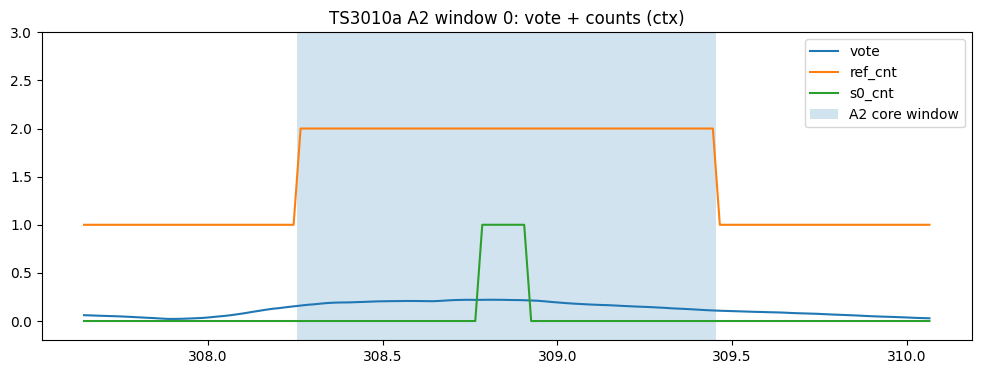

  Core frames (first 25): time | ref_cnt | s0_cnt | s0_label | vote
      308.27 | 2 | 0 | None         | 0.161
      308.29 | 2 | 0 | None         | 0.169
      308.31 | 2 | 0 | None         | 0.174
      308.33 | 2 | 0 | None         | 0.182
      308.35 | 2 | 0 | None         | 0.188
      308.37 | 2 | 0 | None         | 0.191
      308.39 | 2 | 0 | None         | 0.193
      308.41 | 2 | 0 | None         | 0.194
      308.43 | 2 | 0 | None         | 0.196
      308.45 | 2 | 0 | None         | 0.199
      308.47 | 2 | 0 | None         | 0.201
      308.49 | 2 | 0 | None         | 0.204
      308.51 | 2 | 0 | None         | 0.205
      308.53 | 2 | 0 | None         | 0.207
      308.55 | 2 | 0 | None         | 0.207
      308.57 | 2 | 0 | None         | 0.208
      308.59 | 2 | 0 | None         | 0.208
      308.61 | 2 | 0 | None         | 0.208
      308.63 | 2 | 0 | None         | 0.207
      308.65 | 2 | 0 | None         | 0.206
      308.67 | 2 | 0 | None         | 0.209
      30

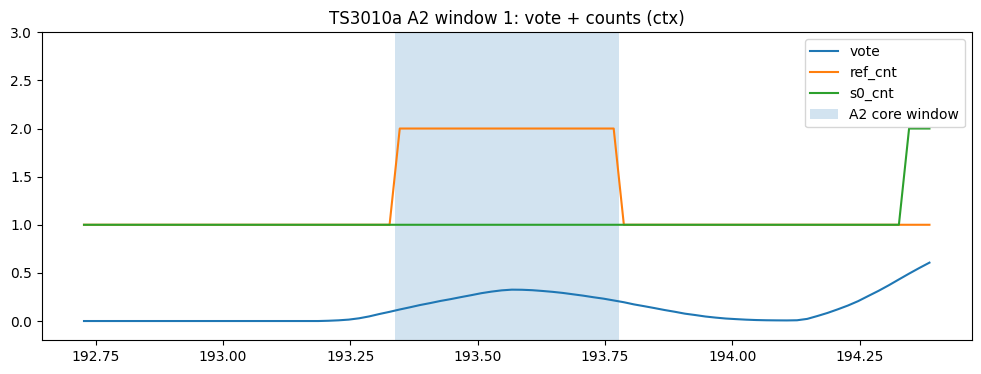

  Core frames (first 25): time | ref_cnt | s0_cnt | s0_label | vote
      193.35 | 2 | 1 | MTD037PM     | 0.120
      193.37 | 2 | 1 | MTD037PM     | 0.143
      193.39 | 2 | 1 | MTD037PM     | 0.166
      193.41 | 2 | 1 | MTD037PM     | 0.187
      193.43 | 2 | 1 | MTD037PM     | 0.209
      193.45 | 2 | 1 | MTD037PM     | 0.228
      193.47 | 2 | 1 | MTD037PM     | 0.248
      193.49 | 2 | 1 | MTD037PM     | 0.268
      193.51 | 2 | 1 | MTD037PM     | 0.289
      193.53 | 2 | 1 | MTD037PM     | 0.306
      193.55 | 2 | 1 | MTD037PM     | 0.319
      193.57 | 2 | 1 | MTD037PM     | 0.326
      193.59 | 2 | 1 | MTD037PM     | 0.325
      193.61 | 2 | 1 | MTD037PM     | 0.320
      193.63 | 2 | 1 | MTD037PM     | 0.312
      193.65 | 2 | 1 | MTD037PM     | 0.303
      193.67 | 2 | 1 | MTD037PM     | 0.292
      193.69 | 2 | 1 | MTD037PM     | 0.278
      193.71 | 2 | 1 | MTD037PM     | 0.264
      193.73 | 2 | 1 | MTD037PM     | 0.247
      193.75 | 2 | 1 | MTD037PM     | 0.233
      19

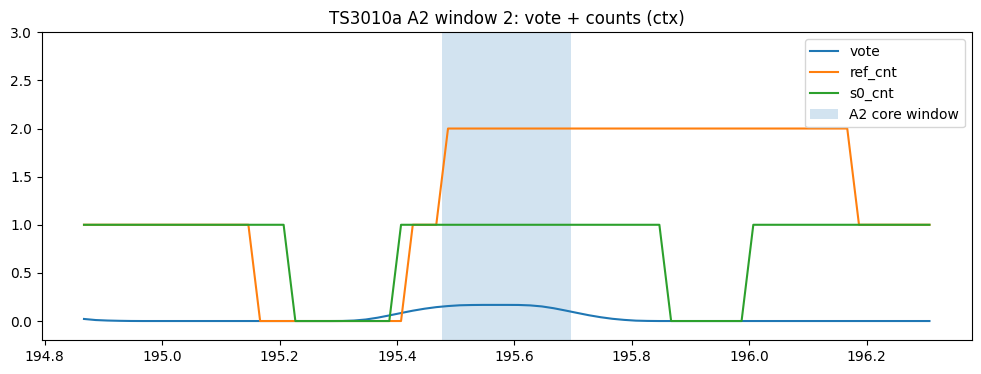

  Core frames (first 25): time | ref_cnt | s0_cnt | s0_label | vote
      195.49 | 2 | 1 | MTD040ME     | 0.156
      195.51 | 2 | 1 | MTD040ME     | 0.164
      195.53 | 2 | 1 | MTD040ME     | 0.166
      195.55 | 2 | 1 | MTD040ME     | 0.168
      195.57 | 2 | 1 | MTD040ME     | 0.168
      195.59 | 2 | 1 | MTD040ME     | 0.168
      195.61 | 2 | 1 | MTD040ME     | 0.167
      195.63 | 2 | 1 | MTD040ME     | 0.162
      195.65 | 2 | 1 | MTD040ME     | 0.152
      195.67 | 2 | 1 | MTD040ME     | 0.133
      195.69 | 2 | 1 | MTD040ME     | 0.109

================ TS3006a | A2 MICRO-INSPECT (thr=0.1) ================
A2 windows=29 (min_dur=0.2). Showing top 2:

[A2 win 00] 1192.64-1194.28 dur=1.64s (ctx 1192.04-1194.88)
  frames=82 | dt=0.020s | s0_switch_rate=0.022 (1.0 = switches every frame)
  In-core A2 fraction in ctx: 0.826
  S0 single labels seen (ctx): ['MTD021PM', 'MTD024ME']
  REF single labels seen (ctx): ['MTD021PM']


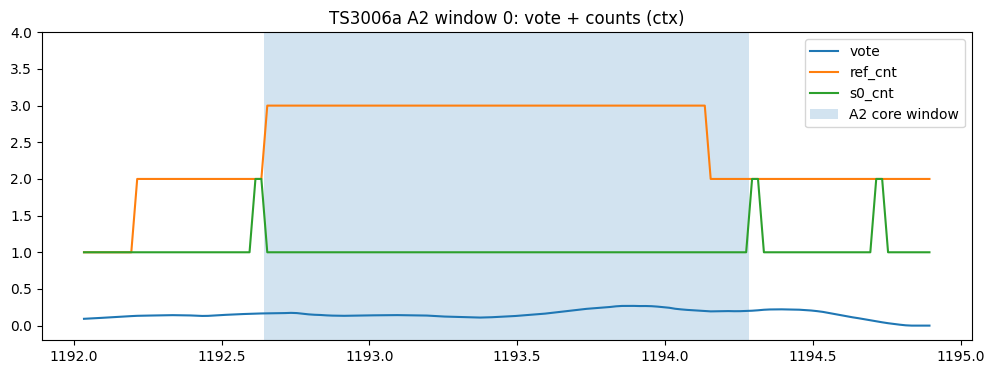

  Core frames (first 25): time | ref_cnt | s0_cnt | s0_label | vote
     1192.65 | 3 | 1 | MTD024ME     | 0.167
     1192.67 | 3 | 1 | MTD024ME     | 0.168
     1192.69 | 3 | 1 | MTD024ME     | 0.169
     1192.71 | 3 | 1 | MTD024ME     | 0.171
     1192.73 | 3 | 1 | MTD024ME     | 0.174
     1192.75 | 3 | 1 | MTD024ME     | 0.171
     1192.77 | 3 | 1 | MTD024ME     | 0.163
     1192.79 | 3 | 1 | MTD024ME     | 0.153
     1192.81 | 3 | 1 | MTD024ME     | 0.148
     1192.83 | 3 | 1 | MTD024ME     | 0.145
     1192.85 | 3 | 1 | MTD024ME     | 0.140
     1192.87 | 3 | 1 | MTD024ME     | 0.136
     1192.89 | 3 | 1 | MTD024ME     | 0.135
     1192.91 | 3 | 1 | MTD024ME     | 0.134
     1192.93 | 3 | 1 | MTD024ME     | 0.135
     1192.95 | 3 | 1 | MTD024ME     | 0.138
     1192.97 | 3 | 1 | MTD024ME     | 0.138
     1192.99 | 3 | 1 | MTD024ME     | 0.140
     1193.01 | 3 | 1 | MTD024ME     | 0.140
     1193.03 | 3 | 1 | MTD024ME     | 0.141
     1193.05 | 3 | 1 | MTD024ME     | 0.141
     119

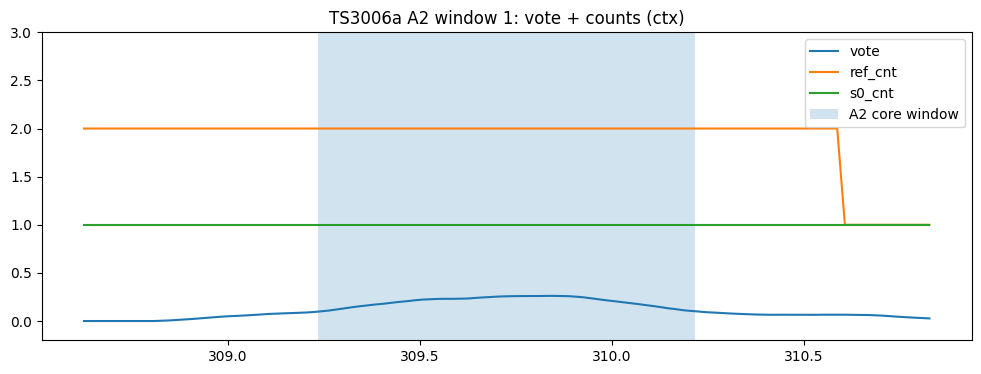

  Core frames (first 25): time | ref_cnt | s0_cnt | s0_label | vote
      309.25 | 2 | 1 | 0            | 0.102
      309.27 | 2 | 1 | 0            | 0.110
      309.29 | 2 | 1 | 0            | 0.122
      309.31 | 2 | 1 | 0            | 0.133
      309.33 | 2 | 1 | 0            | 0.145
      309.35 | 2 | 1 | 0            | 0.155
      309.37 | 2 | 1 | 0            | 0.164
      309.39 | 2 | 1 | 0            | 0.173
      309.41 | 2 | 1 | 0            | 0.180
      309.43 | 2 | 1 | 0            | 0.190
      309.45 | 2 | 1 | 0            | 0.199
      309.47 | 2 | 1 | 0            | 0.206
      309.49 | 2 | 1 | 0            | 0.215
      309.51 | 2 | 1 | 0            | 0.222
      309.53 | 2 | 1 | 0            | 0.226
      309.55 | 2 | 1 | 0            | 0.230
      309.57 | 2 | 1 | 0            | 0.231
      309.59 | 2 | 1 | 0            | 0.231
      309.61 | 2 | 1 | 0            | 0.232
      309.63 | 2 | 1 | 0            | 0.234
      309.65 | 2 | 1 | 0            | 0.241
      30

In [ ]:
import numpy as np
import math
import matplotlib.pyplot as plt
from pyannote.core import Segment

# Assumes these exist from our previous cell:
# - _call_stage, STAGE0_FN, STAGE2_FN
# - build_files_by_uri / files_by_uri / dev_files
# - get_ref_anno
# - edges_from_dbg
# - anno_count_per_frame, anno_single_label_per_frame
# - mask_to_windows
# - _play_event (optional)

def inspect_a2_windows(uri, vote_thr=0.10, min_win_dur=0.2, topk=3, ctx=0.5, listen=False):
    # --- get file ---
    if "files_by_uri" in globals():
        f = globals()["files_by_uri"][uri]
    else:
        fb = build_files_by_uri(globals()["dev_files"])
        f = fb[uri]

    ref = get_ref_anno(f)

    # --- run stages (NO PATCHES) ---
    hyp0, dbg0 = _call_stage(STAGE0_FN, f, return_debug=True, debug=False)
    hyp2, dbg2 = _call_stage(STAGE2_FN, f, return_debug=True, debug=False)

    edges, dt, uem_seg = edges_from_dbg(dbg2)
    N = len(edges) - 1
    vote = np.asarray(dbg2["vote"]).reshape(-1)

    # --- counts / labels ---
    ref_cnt = anno_count_per_frame(ref, edges, dt)
    s0_cnt  = anno_count_per_frame(hyp0, edges, dt)

    ref_ov = (ref_cnt >= 2)
    A2 = ref_ov & (vote >= vote_thr) & (s0_cnt < 2)

    wins = mask_to_windows(A2, edges, min_dur=min_win_dur)
    if not wins:
        print(f"[{uri}] No A2 windows at thr={vote_thr} min_dur={min_win_dur}s")
        return

    print(f"\n================ {uri} | A2 MICRO-INSPECT (thr={vote_thr}) ================")
    print(f"A2 windows={len(wins)} (min_dur={min_win_dur}). Showing top {min(topk, len(wins))}:")

    s0_one = anno_single_label_per_frame(hyp0, edges, dt)
    ref_one = anno_single_label_per_frame(ref, edges, dt)

    for wi, (st, en, frames) in enumerate(wins[:topk]):
        # expand a bit for context
        stc = max(float(uem_seg.start), st - ctx)
        enc = min(float(uem_seg.end),   en + ctx)

        i0 = int((stc - edges[0]) / dt)
        i1 = int(math.ceil((enc - edges[0]) / dt))
        i0 = max(0, min(N, i0))
        i1 = max(0, min(N, i1))

        t_mid = (edges[i0:i1] + edges[i0+1:i1+1]) / 2.0

        # switching metric on frames where s0 is single-speaker
        labels_seq = s0_one[i0:i1]
        keep = np.array([x is not None for x in labels_seq])
        seq = [x for x in labels_seq if x is not None]
        switches = sum(1 for a,b in zip(seq[:-1], seq[1:]) if a != b)
        switch_rate = switches / max(1, (len(seq)-1))

        print(f"\n[A2 win {wi:02d}] {st:.2f}-{en:.2f} dur={en-st:.2f}s (ctx {stc:.2f}-{enc:.2f})")
        print(f"  frames={frames} | dt={dt:.3f}s | s0_switch_rate={switch_rate:.3f} (1.0 = switches every frame)")
        print(f"  In-core A2 fraction in ctx: {float(np.mean(A2[i0:i1])):.3f}")

        # quick label summary in this ctx
        s0_lab_set = sorted({x for x in s0_one[i0:i1] if x is not None})
        ref_lab_set = sorted({x for x in ref_one[i0:i1] if x is not None})
        print(f"  S0 single labels seen (ctx): {s0_lab_set[:10]}{'...' if len(s0_lab_set)>10 else ''}")
        print(f"  REF single labels seen (ctx): {ref_lab_set[:10]}{'...' if len(ref_lab_set)>10 else ''}")

        # plot: vote + counts
        plt.figure(figsize=(12,4))
        plt.plot(t_mid, vote[i0:i1], label="vote")
        plt.plot(t_mid, ref_cnt[i0:i1], label="ref_cnt")
        plt.plot(t_mid, s0_cnt[i0:i1], label="s0_cnt")
        plt.axvspan(st, en, alpha=0.2, label="A2 core window")
        plt.ylim(-0.2, max(3, int(ref_cnt[i0:i1].max())+1))
        plt.title(f"{uri} A2 window {wi}: vote + counts (ctx)")
        plt.legend()
        plt.show()

        # show a compact per-frame readout for the core window only
        j0 = int((st - edges[0]) / dt)
        j1 = int(math.ceil((en - edges[0]) / dt))
        j0 = max(0, min(N, j0))
        j1 = max(0, min(N, j1))

        print("  Core frames (first 25): time | ref_cnt | s0_cnt | s0_label | vote")
        for k in range(j0, min(j1, j0+25)):
            tm = (edges[k] + edges[k+1]) / 2.0
            print(f"    {tm:8.2f} | {int(ref_cnt[k])} | {int(s0_cnt[k])} | {str(s0_one[k])[:12]:12s} | {vote[k]:.3f}")

        if listen:
            print("  [listen]")
            _play_event(f, st, en, pad=0.35)

# Example:
inspect_a2_windows("TS3010a", vote_thr=0.10, min_win_dur=0.2, topk=3, ctx=0.6, listen=False)
inspect_a2_windows("TS3006a", vote_thr=0.10, min_win_dur=0.2, topk=2, ctx=0.6, listen=True)


Confident:
- Across files, Stage0 overlap recall ≈ Stage2 overlap recall
Examples (our logs):
 - TS3006a: S0=0.645 vs S2=0.644
 - IS1007a: S0=0.661 vs S2=0.657
 - ES2005a: S0=0.593 vs S2=0.591
 - IS1009a: S0=0.612 vs S2=0.609
 - TS3010a: S0=0.298 vs S2=0.298
- So Stage2 is not deleting overlap “at scale”. If pruning/anchors/centroids/constraints were the culprit, we’d see S2 recall << S0 recall and lots of collapse windows. we don’t.
 - our aggregate decomposition already explains almost all missing overlap:
 - A1 (vote too low) = 0.264 of REF overlap
 - A2 (vote ok but still S0<2) = 0.121 of REF overlap
 - D (speech_mask holes) = 0.0026 of REF overlap
And 0.264 + 0.121 + 0.0026 ≈ 0.388 which matches the missing overlap since recall is 0.613.

- So we’re ~100% confident the main root cause is upstream of Stage2:
 - A1: overlap vote under-detects a big chunk of REF overlap
 - A2: even when overlap vote is decent, Stage0 still fails to output ≥2 speakers
 - Interpreting our “A2 MICRO-INSPECT” (this is the key for the fix direction)

- Look at TS3010a A2 win00:
 - ref_cnt=2 but s0_cnt=0 for many frames, while vote ~ 0.16–0.22
 - S0 single labels seen (ctx): ['MTD038ID']
   - So Stage0 does know the speaker nearby, but inside the A2 core it outputs no label at all.
   - That means A2 is not only “missing second speaker” — it’s sometimes a hole / dropout in Stage0 assignment during true overlap while vote is already hinting overlap.

- Now TS3006a A2 win00:
 - ref_cnt=3, but s0_cnt=1 constant label, vote ~0.13–0.17
 - Again: vote says “something overlap-ish”, but Stage0 never activates adding speakers.
  - So A2 splits into two practical subtypes:
  - A2a: Stage0 holes (s0_cnt=0 inside speech) → needs gap-fill / don’t--speech behavior
  - A2b: Stage0 single-speaker “stuck” (s0_cnt=1) despite overlap evidence → needs promotion activation / relaxed gating
  - This is exactly why our earlier logs kept showing promote_mask_mean=0.000 and reason=NOT_ACTIVATED.

In [ ]:
# ===================== NEXT DEBUG: A2 Activation Gate Trace + What-if recall =====================
# Goal:
#   - Confirm whether A2 is mostly "promote_mask never activates" (NOT_ACTIVATED)
#   - Quantify how much overlap recall we gain if we relax promote_mask to (speech_mask & vote>=thr)
#
# Assumptions:
#   - we already have for each uri:
#       ref_anno: pyannote.core.Annotation (reference)
#       s0_anno : pyannote.core.Annotation (Stage0 output)
#       dbg2    : dict with keys: 'vote' (np.ndarray), 'speech_mask' (np.ndarray)
#                 optionally 'promote_mask' (np.ndarray)
#   - we already know our frame step dt (usually 0.02s)
#   - we have a common frame time grid for ref/s0/vote aligned in dbg2

import numpy as np

def _anno_count_per_frame(anno, frame_t, dt):
    """
    Count how many speakers are active per frame.

    anno: pyannote Annotation
    frame_t: (T,) array of frame start times in seconds
    dt: frame duration in seconds
    Returns: (T,) int array with speaker count per frame
    """
    cnt = np.zeros(len(frame_t), dtype=np.int32)
    # iterate segments
    for seg, _, _ in anno.itertracks(yield_label=True):
        # convert segment time to frame indices (inclusive start, exclusive end)
        i0 = int(np.floor((seg.start - frame_t[0]) / dt))
        i1 = int(np.ceil((seg.end   - frame_t[0]) / dt))
        i0 = max(i0, 0)
        i1 = min(i1, len(cnt))
        if i1 > i0:
            cnt[i0:i1] += 1
    return cnt

def _contiguous_windows(mask, frame_t, dt, min_dur=0.2):
    """
    Convert boolean mask over frames -> list of (t0, t1, nframes) windows.
    """
    mask = mask.astype(bool)
    if mask.sum() == 0:
        return []
    idx = np.where(mask)[0]
    splits = np.where(np.diff(idx) > 1)[0]
    groups = np.split(idx, splits + 1)
    wins = []
    for g in groups:
        t0 = frame_t[g[0]]
        t1 = frame_t[g[-1]] + dt
        if (t1 - t0) >= min_dur:
            wins.append((t0, t1, len(g), g[0], g[-1]))
    return wins

def a2_gate_trace(uri, ref_anno, s0_anno, dbg2, dt=0.02, vote_thr=0.10, min_win=0.2, topk=8):
    """
    Prints:
      - A2 size (vote>=thr but S0<2 inside REF overlap)
      - For top A2 windows: vote_mean, speech_mask_mean, promote_mask_mean, relaxed_promote_mean
      - What-if overlap recall gain if we treat relaxed_promote as successful overlap creation.
    """
    vote = np.asarray(dbg2["vote"]).astype(np.float32)
    speech = np.asarray(dbg2["speech_mask"]).astype(bool)

    # Frame time grid (assume dbg2 carries UEM start; if not, use 0)
    # If we already store frame start times, replace this with them.
    t0 = float(dbg2.get("uem_start", 0.0))
    frame_t = t0 + np.arange(len(vote)) * dt

    # Current promote_mask if present (else zeros)
    promote = np.asarray(dbg2.get("promote_mask", np.zeros_like(vote))).astype(bool)

    # Counts
    ref_cnt = _anno_count_per_frame(ref_anno, frame_t, dt)
    s0_cnt  = _anno_count_per_frame(s0_anno,  frame_t, dt)

    # Define REF overlap region (>=2 speakers)
    ref_ov = (ref_cnt >= 2)

    # A2: vote says overlap (>=thr), but Stage0 still <2
    a2 = ref_ov & speech & (vote >= vote_thr) & (s0_cnt < 2)

    # Relaxed promote proposal: activate whenever (speech & vote>=thr)
    relaxed_promote = speech & (vote >= vote_thr)

    # Overlap recall now vs what-if
    ref_ov_frames = int(ref_ov.sum())
    s0_ov_frames  = int((ref_ov & (s0_cnt >= 2)).sum())

    # What-if: if relaxed_promote, force overlap count>=2 for recall accounting only
    # (This is an upper-bound-style sanity check; doesn't claim DER improvement directly.)
    s0_ov_frames_whatif = int((ref_ov & ((s0_cnt >= 2) | relaxed_promote)).sum())

    print(f"\n================ {uri} | A2 Gate Trace (thr={vote_thr}) ================")
    print(f"REF_ov_frames={ref_ov_frames}")
    print(f"S0 overlap recall now   = {s0_ov_frames / max(ref_ov_frames,1):.3f}  (frames={s0_ov_frames})")
    print(f"What-if recall (relaxed promote) = {s0_ov_frames_whatif / max(ref_ov_frames,1):.3f}  (frames={s0_ov_frames_whatif})")
    print(f"A2 frames (vote ok but S0<2) = {int(a2.sum())}  ({a2.mean():.4f} of all frames, {a2.sum()/max(ref_ov_frames,1):.3f} of REF ov)")

    wins = _contiguous_windows(a2, frame_t, dt, min_dur=min_win)
    wins = sorted(wins, key=lambda x: x[2], reverse=True)[:topk]
    print(f"A2 windows={len(wins)} (min_dur={min_win}s). Showing top {len(wins)} by frames:\n")

    for i,(w0,w1,nf,i0,i1) in enumerate(wins):
        sl = slice(i0, i1+1)
        vote_mean = float(vote[sl].mean())
        vote_max  = float(vote[sl].max())
        sp_mean   = float(speech[sl].mean())
        pm_mean   = float(promote[sl].mean())
        rpm_mean  = float(relaxed_promote[sl].mean())
        s0min, s0max = int(s0_cnt[sl].min()), int(s0_cnt[sl].max())
        refmin, refmax = int(ref_cnt[sl].min()), int(ref_cnt[sl].max())

        print(f"[A2 {i:02d}] {w0:8.2f}-{w1:8.2f} dur={w1-w0:5.2f}s frames={nf:4d}")
        print(f"   vote_mean={vote_mean:.3f} vote_max={vote_max:.3f} | speech_mean={sp_mean:.2f}")
        print(f"   promote_mask_mean(current)={pm_mean:.3f} | relaxed_promote_mean={rpm_mean:.3f}")
        print(f"   ref_cnt[min..max]={refmin}..{refmax} | s0_cnt[min..max]={s0min}..{s0max}")
        if pm_mean < 0.01 and rpm_mean > 0.5:
            print("   >>> Strong evidence: A2 is dominated by NOT_ACTIVATED promote_mask (activation gate too strict).")
        if s0max == 0:
            print("   >>> Strong evidence: Stage0 has a HOLE (outputs no speaker) inside speech+REF overlap. Needs gap-fill / VAD-gap closing.")
        print()


# -----------------------------
# Declarations (empty containers)
# -----------------------------
hyp_s0_by_uri = {}   # uri -> Stage0 hypothesis (Annotation)
dbg2_by_uri   = {}   # uri -> Stage2 debug dict

# (Optional but usually useful too)
dbg0_by_uri   = {}   # uri -> Stage0 debug dict
hyp_s2_by_uri = {}   # uri -> Stage2 hypothesis (Annotation)

# -----------------------------
# Populate for our DEV files
# -----------------------------
for f in dev_files:
    uri = str(f.get("uri"))

    # Stage0 (the "real" Stage0 output = with promotion ON)
    hyp_s0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        f,
        baseline_fn=PIPE_BASE,
        apply_promotion=True,     # IMPORTANT: this is Stage0, not just Stage1
        return_debug=True,
        debug=False,
    )
    hyp_s0_by_uri[uri] = hyp_s0
    dbg0_by_uri[uri]   = dbg0

    # Stage2
    hyp_s2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
        f,
        baseline_fn=PIPE_BASE,
        start_from_promoted=False,   # set True if our *final* pipeline starts from promoted hyp
        return_debug=True,
        debug=False,
        collect_diagnostics=True,
    )
    hyp_s2_by_uri[uri] = hyp_s2
    dbg2_by_uri[uri]   = dbg2

print("Built:",
      "hyp_s0_by_uri=", len(hyp_s0_by_uri),
      "dbg2_by_uri=", len(dbg2_by_uri))
print("Example keys:", list(hyp_s0_by_uri.keys())[:5])
print("Stage2 dbg2 keys (one uri):", list(next(iter(dbg2_by_uri.values())).keys()))

# ----------------- HOW TO RUN -----------------
# Example usage (adapt variable names to ours):
#
for uri in DEV_URIS:
    ref_anno = ref_by_uri[uri]
    s0_anno  = hyp_s0_by_uri[uri]
    dbg2     = dbg2_by_uri[uri]   # must contain vote + speech_mask
    a2_gate_trace(uri, ref_anno, s0_anno, dbg2, dt=0.02, vote_thr=0.10, min_win=0.2, topk=6)


Built: hyp_s0_by_uri= 5 dbg2_by_uri= 5
Example keys: ['TS3010a', 'TS3006a', 'IS1007a', 'ES2005a', 'IS1009a']
Stage2 dbg2 keys (one uri): ['n_risky_segments', 'n_edited', 'n_skipped_amb', 'n_skipped_nocent', 'n_pruned', 'diagnostics', 'uem_seg', 'uem_tl', 'labels', 'speech_mask', 'vote', 'promote_mask']

================ TS3010a | A2 Gate Trace (thr=0.1) ================
REF_ov_frames=1126
S0 overlap recall now   = 0.290  (frames=327)
What-if recall (relaxed promote) = 0.472  (frames=531)
A2 frames (vote ok but S0<2) = 204  (0.0039 of all frames, 0.181 of REF ov)
A2 windows=3 (min_dur=0.2s). Showing top 3 by frames:

[A2 00]   308.26-  309.44 dur= 1.18s frames=  59
   vote_mean=0.185 vote_max=0.221 | speech_mean=1.00
   promote_mask_mean(current)=0.119 | relaxed_promote_mean=1.000
   ref_cnt[min..max]=2..2 | s0_cnt[min..max]=0..1

[A2 01]   193.34-  193.76 dur= 0.42s frames=  21
   vote_mean=0.256 vote_max=0.326 | speech_mean=1.00
   promote_mask_mean(current)=0.857 | relaxed_promote_me

In [ ]:
# Wrapper with tweaks + robust audio fix
def run_stage3_tweaked(f, **kwargs):
    audio = f.get("audio")
    print(f"Debug {f['uri']}: type(audio) = {type(audio)}")  # Print to identify
    if isinstance(audio, (tuple, list)) and len(audio) == 2:
        waveform, sr = audio
        waveform = torch.tensor(waveform) if not torch.is_tensor(waveform) else waveform
        f["audio"] = {"waveform": waveform, "sample_rate": sr}
    # kwargs['cfg'] = cfg_tweaked
    return STAGE3_MEMORYBANK_KNN_REFINEMENT(
        f,
        start_from_promoted=True,
        stage2_kwargs={},
        # cfg=kwargs['cfg'],
        return_debug=False,
        debug=False
    )

# Rest of benchmark (same as before)
print("\n=== STAGE3 Tweaked DEV ===")
_, s3_dev = eval_files_stages(run_stage3_tweaked, dev_files, max_files=None)
_print_summary("stage3 DEV", s3_dev)

print("\n=== STAGE3 Tweaked TEST ===")
_, s3_test = eval_files_stages(run_stage3_tweaked, test_files, max_files=None)
_print_summary("stage3 TEST", s3_test)


=== STAGE3 Tweaked DEV ===
Debug TS3010a: type(audio) = <class 'pathlib.PosixPath'>
[eval_files] 1/5 TS3010a ERROR: 
Audio files can be provided to the Audio class using different types:
    - a "str" or "Path" instance: "audio.wav" or Path("audio.wav")
    - a "IOBase" instance with "read" and "seek" support: open("audio.wav", "rb")
    - a "Mapping" with any of the above as "audio" key: {"audio": ...}
    - a "Mapping" with both "waveform" and "sample_rate" key:
        {"waveform": (channel, time) torch.Tensor, "sample_rate": 44100}

For last two options, an additional "channel" key can be provided as a zero-indexed
integer to load a specific channel: {"audio": "stereo.wav", "channel": 0}

Debug TS3006a: type(audio) = <class 'pathlib.PosixPath'>
[eval_files] 2/5 TS3006a ERROR: 
Audio files can be provided to the Audio class using different types:
    - a "str" or "Path" instance: "audio.wav" or Path("audio.wav")
    - a "IOBase" instance with "read" and "seek" support: open("audio.

In [ ]:
# Build per-URI outputs for Stage0 + Stage2, with debug payloads
hyp_s0_by_uri = {}
dbg0_by_uri   = {}
hyp_s2_by_uri = {}
dbg2_by_uri   = {}

for f in dev_files:
    uri = str(f["uri"])

    # Stage0 promoted (final Stage0 output)
    h0, d0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        f,
        apply_promotion=True,
        return_debug=True,
        debug=False,
    )
    hyp_s0_by_uri[uri] = h0
    dbg0_by_uri[uri]   = d0

    # Stage2 (guided prune) starting from Stage0 promoted output (Important very important now)
    h2, d2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
        f,
        start_from_promoted=True,
        return_debug=True,
        debug=False,
    )
    hyp_s2_by_uri[uri] = h2
    dbg2_by_uri[uri]   = d2

print("[Built] hyp_s0_by_uri=", len(hyp_s0_by_uri), "dbg2_by_uri=", len(dbg2_by_uri))
print("Example keys:", list(hyp_s0_by_uri.keys())[:5])
print("Stage2 dbg2 keys (one uri):", list(dbg2_by_uri[next(iter(dbg2_by_uri))].keys()))


[Built] hyp_s0_by_uri= 5 dbg2_by_uri= 5
Example keys: ['TS3010a', 'TS3006a', 'IS1007a', 'ES2005a', 'IS1009a']
Stage2 dbg2 keys (one uri): ['n_risky_segments', 'n_edited', 'n_skipped_amb', 'n_skipped_nocent', 'n_pruned', 'diagnostics', 'uem_seg', 'uem_tl', 'labels', 'speech_mask', 'vote', 'promote_mask']


In [ ]:
for uri in DEV_URIS:
    ref_anno = ref_by_uri[uri]
    s0_anno  = hyp_s0_by_uri[uri]
    dbg2     = dbg2_by_uri[uri]   # must contain vote + speech_mask
    a2_gate_trace(uri, ref_anno, s0_anno, dbg2, dt=0.02, vote_thr=0.10, min_win=0.2, topk=6)


================ TS3010a | A2 Gate Trace (thr=0.1) ================
REF_ov_frames=1126
S0 overlap recall now   = 0.290  (frames=327)
What-if recall (relaxed promote) = 0.472  (frames=531)
A2 frames (vote ok but S0<2) = 204  (0.0039 of all frames, 0.181 of REF ov)
A2 windows=3 (min_dur=0.2s). Showing top 3 by frames:

[A2 00]   308.26-  309.44 dur= 1.18s frames=  59
   vote_mean=0.185 vote_max=0.221 | speech_mean=1.00
   promote_mask_mean(current)=0.627 | relaxed_promote_mean=1.000
   ref_cnt[min..max]=2..2 | s0_cnt[min..max]=0..1

[A2 01]   193.34-  193.76 dur= 0.42s frames=  21
   vote_mean=0.256 vote_max=0.326 | speech_mean=1.00
   promote_mask_mean(current)=0.857 | relaxed_promote_mean=1.000
   ref_cnt[min..max]=2..2 | s0_cnt[min..max]=1..1

[A2 02]   195.48-  195.70 dur= 0.22s frames=  11
   vote_mean=0.156 vote_max=0.168 | speech_mean=1.00
   promote_mask_mean(current)=0.000 | relaxed_promote_mean=1.000
   ref_cnt[min..max]=2..2 | s0_cnt[min..max]=1..1
   >>> Strong evidence: A2 

In [ ]:
# ============================================================
# VALIDATE POST-FIX (Stage0/Stage2)
# - Builds: hyp_s0_by_uri, dbg0_by_uri, hyp_s2_by_uri, dbg2_by_uri
# - Reports: overlap recall + A1/A2/D breakdown + (optional) DER
#
# Assumes we already have:
#   - dev_files (list of protocol files) OR a dict files_by_uri
#   - PIPE_BASE baseline pipeline callable
#   - STAGE0_PROMOTE_ONLY_ON_PYVAD (UPDATED)
#   - STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0 (UPDATED)
# ============================================================

import numpy as np
import pandas as pd

# -----------------------------
# Helper: robust file lookup
# -----------------------------
def _build_files_by_uri(dev_files):
    return {f["uri"]: f for f in dev_files}

# -----------------------------
# Helper: frame counts for an Annotation over one continuous Segment
#   - counts how many speaker tracks are active per frame
#   - assumes our debug uses uem_seg = uem_tl.extent() (continuous)
# -----------------------------
import numpy as np

def _count_active_speakers_per_frame(annotation, uem_seg, n_frames, dt):
    """
    Count how many speakers are active per frame for a pyannote Annotation.

    Args:
      annotation: pyannote.core.Annotation
      uem_seg: pyannote.core.Segment (continuous extent used as frame base)
      n_frames: int
      dt: float seconds per frame

    Returns:
      cnt: np.ndarray shape (n_frames,) with active-speaker count per frame
    """
    cnt = np.zeros(int(n_frames), dtype=np.int16)
    if annotation is None:
        return cnt

    ann = annotation.crop(uem_seg, mode="intersection")

    # itertracks(yield_label=True) yields: (segment, track_id, label)
    for seg, _track, _lab in ann.itertracks(yield_label=True):
        s = max(float(seg.start), float(uem_seg.start))
        e = min(float(seg.end),   float(uem_seg.end))
        if e <= s:
            continue

        i0 = int(np.floor((s - float(uem_seg.start)) / float(dt)))
        i1 = int(np.ceil ((e - float(uem_seg.start)) / float(dt)))

        i0 = max(0, min(int(n_frames), i0))
        i1 = max(0, min(int(n_frames), i1))
        if i1 > i0:
            cnt[i0:i1] += 1

    return cnt


# -----------------------------
# Main: run + collect debug
# -----------------------------
URIS = ["TS3010a", "TS3006a", "IS1007a", "ES2005a", "IS1009a"]
VOTE_THR = 0.10

files_by_uri = globals().get("files_by_uri", None)
if files_by_uri is None:
    files_by_uri = _build_files_by_uri(dev_files)

hyp_s0_by_uri, dbg0_by_uri = {}, {}
hyp_s2_by_uri, dbg2_by_uri = {}, {}

for uri in URIS:
    f = files_by_uri[uri]

    # Stage0 (needs return_debug=True for vote/promote_mask diagnostics)
    out0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
        f,
        baseline_fn=PIPE_BASE,
        return_debug=True,
        debug=False,
    )
    hyp0, dbg0 = out0
    hyp_s0_by_uri[uri] = hyp0
    dbg0_by_uri[uri] = dbg0

    # Stage2 (also return_debug=True)
    out2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
        f,
        baseline_fn=PIPE_BASE,
        return_debug=True,
        debug=False,
    )
    hyp2, dbg2 = out2
    hyp_s2_by_uri[uri] = hyp2
    dbg2_by_uri[uri] = dbg2

print(f"[Built] hyp_s0_by_uri={len(hyp_s0_by_uri)} dbg0_by_uri={len(dbg0_by_uri)} hyp_s2_by_uri={len(hyp_s2_by_uri)} dbg2_by_uri={len(dbg2_by_uri)}")
print("Example keys:", list(hyp_s0_by_uri.keys())[:5])
print("Stage2 dbg2 keys (one uri):", list(dbg2_by_uri[URIS[0]].keys())[:15])

# -----------------------------
# Metrics per URI
# -----------------------------
rows = []
agg = {
    "ref_ov": 0, "s0_ov_hit": 0, "s2_ov_hit": 0,
    "ref_single": 0, "vote_false_on_single": 0,
    "A1": 0, "A2": 0, "D": 0,
}

for uri in URIS:
    f = files_by_uri[uri]
    ref = f.get("annotation", None)

    dbg0 = dbg0_by_uri[uri]
    vote = np.asarray(dbg0["vote"]).astype(np.float32)
    speech = np.asarray(dbg0["speech_mask"]).astype(np.float32)

    uem_seg = dbg0["uem_seg"]            # continuous Segment
    n_frames = len(vote)
    dt = (uem_seg.end - uem_seg.start) / max(1, n_frames)

    ref_cnt = _count_active_speakers_per_frame(ref, uem_seg, n_frames, dt)
    s0_cnt  = _count_active_speakers_per_frame(hyp_s0_by_uri[uri], uem_seg, n_frames, dt)
    s2_cnt  = _count_active_speakers_per_frame(hyp_s2_by_uri[uri], uem_seg, n_frames, dt)

    ref_ov = (ref_cnt >= 2)
    ref_single = (ref_cnt == 1)

    # Overlap recall: hyp overlap when ref overlap
    s0_hit = ((s0_cnt >= 2) & ref_ov).sum()
    s2_hit = ((s2_cnt >= 2) & ref_ov).sum()
    ref_ov_n = ref_ov.sum()

    s0_recall = s0_hit / max(1, ref_ov_n)
    s2_recall = s2_hit / max(1, ref_ov_n)

    # Vote recall upper bound (what our logs call vote_recall_on_REFov@thr)
    vote_mask = (vote >= VOTE_THR)
    vote_recall = (vote_mask & ref_ov).sum() / max(1, ref_ov_n)

    # False overlap of vote on REF single (our earlier metric)
    vote_false = (vote_mask & ref_single).sum()
    ref_single_n = ref_single.sum()
    vote_false_rate = vote_false / max(1, ref_single_n)

    # A1/A2/D (frame-based)
    A1 = (ref_ov & (vote < VOTE_THR)).sum()
    A2 = (ref_ov & (vote >= VOTE_THR) & (s0_cnt < 2)).sum()
    D  = (ref_ov & (speech < 0.5)).sum()

    # Aggregate
    agg["ref_ov"] += int(ref_ov_n)
    agg["s0_ov_hit"] += int(s0_hit)
    agg["s2_ov_hit"] += int(s2_hit)
    agg["ref_single"] += int(ref_single_n)
    agg["vote_false_on_single"] += int(vote_false)
    agg["A1"] += int(A1)
    agg["A2"] += int(A2)
    agg["D"]  += int(D)

    rows.append({
        "uri": uri,
        "REF_ov_frames": int(ref_ov_n),
        "S0_ov_recall": float(s0_recall),
        "S2_ov_recall": float(s2_recall),
        "vote_recall@0.10": float(vote_recall),
        "vote_false_on_REFsingle@0.10": float(vote_false_rate),
        "A1_frac_of_REFov": float(A1 / max(1, ref_ov_n)),
        "A2_frac_of_REFov": float(A2 / max(1, ref_ov_n)),
        "D_frac_of_REFov":  float(D  / max(1, ref_ov_n)),
    })

df = pd.DataFrame(rows).sort_values("uri")
display(df)

print("\n================ AGGREGATE OVER URIS ================")
print("Total REF ov frames =", agg["ref_ov"])
print("S0 overlap recall   =", agg["s0_ov_hit"] / max(1, agg["ref_ov"]))
print("S2 overlap recall   =", agg["s2_ov_hit"] / max(1, agg["ref_ov"]))
print("A1 frac of REF ov   =", agg["A1"] / max(1, agg["ref_ov"]))
print("A2 frac of REF ov   =", agg["A2"] / max(1, agg["ref_ov"]))
print("D  frac of REF ov   =", agg["D"]  / max(1, agg["ref_ov"]))
print("vote_falseOverlap_on_REFsingle@0.10 =", agg["vote_false_on_single"] / max(1, agg["ref_single"]))

# If the fix is correct, A2 should drop sharply and S0_ov_recall should move close to vote_recall@0.10.


[Built] hyp_s0_by_uri=5 dbg0_by_uri=5 hyp_s2_by_uri=5 dbg2_by_uri=5
Example keys: ['TS3010a', 'TS3006a', 'IS1007a', 'ES2005a', 'IS1009a']
Stage2 dbg2 keys (one uri): ['n_risky_segments', 'n_edited', 'n_skipped_amb', 'n_skipped_nocent', 'n_pruned', 'diagnostics', 'uem_seg', 'uem_tl', 'labels', 'speech_mask', 'vote', 'promote_mask']


,uri,REF_ov_frames,S0_ov_recall,S2_ov_recall,vote_recall@0.10,vote_false_on_REFsingle@0.10,A1_frac_of_REFov,A2_frac_of_REFov,D_frac_of_REFov
3,ES2005a,1628,0.592752,0.554054,0.656634,0.054855,0.343366,0.072482,0.000000
2,IS1007a,5019,0.661287,0.617254,0.743574,0.056694,0.256426,0.082686,0.000000
4,IS1009a,4200,0.611905,0.530952,0.726190,0.070294,0.273810,0.115000,0.009048
1,TS3006a,7678,0.645220,0.475775,0.779500,0.056657,0.220500,0.134931,0.000000
0,TS3010a,1141,0.297984,0.288344,0.469763,0.009432,0.530237,0.171779,0.012270



================ AGGREGATE OVER URIS ================
Total REF ov frames = 19666
S0 overlap recall   = 0.6177158547747381
S2 overlap recall   = 0.5192718397233804
A1 frac of REF ov   = 0.26919556595138816
A2 frac of REF ov   = 0.11430895962575002
D  frac of REF ov   = 0.002644157429065392
vote_falseOverlap_on_REFsingle@0.10 = 0.05119856549641374


In [ ]:
def stage2_shield_sanity(uri):
    f = files_by_uri[uri]
    ref = f["annotation"]

    # Build Stage0 and Stage2 as we currently do
    h0, d0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(f, baseline_fn=PIPE_BASE, return_debug=True, debug=False)
    h2, d2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(f, baseline_fn=PIPE_BASE, return_debug=True, debug=False)

    vote = np.asarray(d2["vote"], dtype=np.float32)
    speech = np.asarray(d2["speech_mask"], dtype=bool)
    pm = np.asarray(d2["promote_mask"], dtype=bool)
    uem = d2["uem_seg"]
    dt = (uem.end - uem.start) / len(vote)

    # Counts
    ref_cnt = _count_active_speakers_per_frame(ref, uem, len(vote), dt)
    s0_cnt  = _count_active_speakers_per_frame(h0,  uem, len(vote), dt)
    s2_cnt  = _count_active_speakers_per_frame(h2,  uem, len(vote), dt)

    ref_ov = (ref_cnt >= 2)
    s0_ov  = (s0_cnt >= 2)
    s2_ov  = (s2_cnt >= 2)

    # Where Stage2 loses overlap that Stage0 had, inside REF overlap
    lost = ref_ov & s0_ov & (~s2_ov)

    print(f"\n[{uri}] lost_overlap_frames={int(lost.sum())} / ref_ov={int(ref_ov.sum())}")
    if lost.sum() > 0:
        print(f"  mean vote on lost={float(vote[lost].mean()):.3f}")
        print(f"  mean promote_mask on lost={float(pm[lost].mean()):.3f}")
        print(f"  mean speech on lost={float(speech[lost].mean()):.3f}")
        print(f"  frac lost where vote>=0.10 = {float((vote[lost]>=0.10).mean()):.3f}")

# Try worst one first
stage2_shield_sanity("TS3006a")



[TS3006a] lost_overlap_frames=1305 / ref_ov=7678
  mean vote on lost=0.777
  mean promote_mask on lost=0.038
  mean speech on lost=1.000
  frac lost where vote>=0.10 = 0.997


In [ ]:
import numpy as np
import pandas as pd

def _as_df(rows):
    # rows may already be a DataFrame, else list of dicts
    if isinstance(rows, pd.DataFrame):
        df = rows.copy()
    else:
        df = pd.DataFrame(rows)

    # normalize col names lightly (handles common variants)
    ren = {}
    for c in df.columns:
        lc = str(c).lower()
        if lc in ["uri", "file", "recording", "utt"]:
            ren[c] = "uri"
        if lc in ["der", "diarization error rate"]:
            ren[c] = "DER"
        if lc in ["miss", "missed detection"]:
            ren[c] = "miss"
        if lc in ["fa", "false alarm"]:
            ren[c] = "fa"
        if lc in ["conf", "confusion"]:
            ren[c] = "conf"
        if lc in ["total", "uem_dur", "duration"]:
            ren[c] = "total"
    df = df.rename(columns=ren)
    return df

def der_ab_debug(dev_files, max_files=None, show_top=10):
    init_models()
    # If we changed UEM/res/shape logic recently, consider clearing caches
    # clear_caches()

    print("\n=== STAGE0 (promote ON) DEV ===")
    rows_s0, s0 = eval_files_stages(lambda f: run_stage0(f, apply_promotion=True), dev_files, max_files=max_files)
    _print_summary("stage0 DEV", s0)

    print("\n=== STAGE2 (start_from_promoted=True) DEV ===")
    rows_s2, s2 = eval_files_stages(lambda f: run_stage2(f, start_from_promoted=True), dev_files, max_files=max_files)
    _print_summary("stage2 DEV", s2)

    df0 = _as_df(rows_s0)
    df2 = _as_df(rows_s2)

    # Keep only useful columns
    keep = [c for c in ["uri", "DER", "miss", "fa", "conf", "total"] if c in df0.columns]
    df0 = df0[keep].copy()
    df2 = df2[[c for c in keep if c in df2.columns]].copy()

    # rename to stage-prefixed
    for c in ["DER", "miss", "fa", "conf", "total"]:
        if c in df0.columns:
            df0 = df0.rename(columns={c: f"{c}_S0"})
        if c in df2.columns:
            df2 = df2.rename(columns={c: f"{c}_S2"})

    # join
    df = df0.merge(df2, on="uri", how="inner")

    # deltas
    if "DER_S0" in df.columns and "DER_S2" in df.columns:
        df["ΔDER_S2-S0"] = df["DER_S2"] - df["DER_S0"]
    for m in ["miss", "fa", "conf"]:
        c0, c2 = f"{m}_S0", f"{m}_S2"
        if c0 in df.columns and c2 in df.columns:
            df[f"Δ{m}_S2-S0"] = df[c2] - df[c0]

    # sort by worst regression first
    sort_col = "ΔDER_S2-S0" if "ΔDER_S2-S0" in df.columns else "uri"
    df = df.sort_values(sort_col, ascending=False)

    print("\n================ PER-FILE (Stage2 vs Stage0) ================")
    show_cols = ["uri"]
    for c in ["DER_S0","DER_S2","ΔDER_S2-S0","miss_S0","miss_S2","Δmiss_S2-S0","fa_S0","fa_S2","Δfa_S2-S0","conf_S0","conf_S2","Δconf_S2-S0"]:
        if c in df.columns:
            show_cols.append(c)
    display(df[show_cols].head(show_top))

    # aggregates from per-file deltas (more informative than mean-of-means sometimes)
    print("\n================ AGGREGATE DELTAS (mean over files) ================")
    if "ΔDER_S2-S0" in df.columns:
        print(f"mean ΔDER(S2-S0): {float(np.nanmean(df['ΔDER_S2-S0'])):.6f}")
    for m in ["miss","fa","conf"]:
        c = f"Δ{m}_S2-S0"
        if c in df.columns:
            print(f"mean Δ{m}(S2-S0): {float(np.nanmean(df[c])):.3f} sec")

    # best/worst
    if "ΔDER_S2-S0" in df.columns:
        best = df.sort_values("ΔDER_S2-S0", ascending=True)[["uri","ΔDER_S2-S0"]].head(5)
        worst = df.sort_values("ΔDER_S2-S0", ascending=False)[["uri","ΔDER_S2-S0"]].head(5)
        print("\nBest 5 (Stage2 improves DER vs Stage0):")
        display(best)
        print("Worst 5 (Stage2 regresses DER vs Stage0):")
        display(worst)

    return df, (s0, s2)

# ------------- RUN -------------
# Use our dev_files; optionally pass max_files=5
df_der, (s0_sum, s2_sum) = der_ab_debug(dev_files, max_files=5, show_top=10)



=== STAGE0 (promote ON) DEV ===
[eval_files] 1/5 TS3010a DER=0.2353 (miss=75.72 fa=17.70 conf=19.57 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2470 (miss=121.39 fa=42.34 conf=105.29 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1907 (miss=80.86 fa=33.06 conf=38.82 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1718 (miss=31.11 fa=10.49 conf=7.51 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2047 (miss=61.05 fa=40.09 conf=41.29 total=695.90)
[SUMMARY] stage0 DEV mean={'DER': 0.20991609947929035, 'miss': 74.02599999999975, 'fa': 28.736, 'conf': 42.49599999999978, 'total': 670.3379999999996} global={'DER': 0.21669366797048595, 'miss': 370.1299999999988, 'fa': 143.68, 'conf': 212.4799999999989, 'total': 3351.6899999999982} n_ok=5/5

=== STAGE2 (start_from_promoted=True) DEV ===
[eval_files] 1/5 TS3010a DER=0.2353 (miss=75.72 fa=17.70 conf=19.57 total=480.14)
[eval_files] 2/5 TS3006a ERROR: name 'M0' is not defined
[eval_files] 3/5 IS1007a ERROR: name 'M0' is not defined
[eval_files] 4/5 ES

,uri,DER_S0,DER_S2,ΔDER_S2-S0,miss_S0,miss_S2,Δmiss_S2-S0,fa_S0,fa_S2,Δfa_S2-S0,conf_S0,conf_S2,Δconf_S2-S0
0,TS3010a,0.235327,0.235327,0.0,75.72,75.72,0.0,17.70,17.70,0.0,19.57,19.57,0.0
3,ES2005a,0.171821,0.171821,0.0,31.11,31.11,0.0,10.49,10.49,0.0,7.51,7.51,0.0
1,TS3006a,0.247023,NaN,NaN,121.39,NaN,NaN,42.34,NaN,NaN,105.29,NaN,NaN
2,IS1007a,0.190739,NaN,NaN,80.86,NaN,NaN,33.06,NaN,NaN,38.82,NaN,NaN
4,IS1009a,0.204670,NaN,NaN,61.05,NaN,NaN,40.09,NaN,NaN,41.29,NaN,NaN



================ AGGREGATE DELTAS (mean over files) ================
mean ΔDER(S2-S0): 0.000000
mean Δmiss(S2-S0): 0.000 sec
mean Δfa(S2-S0): 0.000 sec
mean Δconf(S2-S0): 0.000 sec

Best 5 (Stage2 improves DER vs Stage0):


,uri,ΔDER_S2-S0
0,TS3010a,0.0
3,ES2005a,0.0
1,TS3006a,NaN
2,IS1007a,NaN
4,IS1009a,NaN


Worst 5 (Stage2 regresses DER vs Stage0):


,uri,ΔDER_S2-S0
0,TS3010a,0.0
3,ES2005a,0.0
1,TS3006a,NaN
2,IS1007a,NaN
4,IS1009a,NaN


In [ ]:
    print("\n=== STAGE1 (PyVAD) DEV ===")
    _, s1 = eval_files_stages(lambda f: run_stage1(f), dev_files, max_files=None)
    _print_summary("stage1 DEV", s1)

    print("\n=== STAGE0 (promote ON) DEV ===")
    _, s0 = eval_files_stages(lambda f: run_stage0(f, apply_promotion=True), dev_files, max_files=None)
    _print_summary("stage0 DEV", s0)

    print("\n=== STAGE2 (start_from_promoted=True) DEV ===")
    _, s2 = eval_files_stages(lambda f: run_stage2(f, start_from_promoted=True), dev_files, max_files=None)
    _print_summary("stage2 DEV", s2)


=== STAGE1 (PyVAD) DEV ===
[eval_files] 1/5 TS3010a DER=0.2346 (miss=77.21 fa=15.86 conf=19.56 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2456 (miss=126.18 fa=36.26 conf=105.01 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1888 (miss=82.83 fa=29.30 conf=39.04 total=800.78)
[eval_files] 4/5 ES2005a DER=0.1704 (miss=31.69 fa=9.60 conf=7.43 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2026 (miss=62.78 fa=36.97 conf=41.24 total=695.90)
[SUMMARY] stage1 DEV mean={'DER': 0.20839522048975137, 'miss': 76.13638749999869, 'fa': 25.59626249999898, 'conf': 42.45818750000036, 'total': 670.338} global={'DER': 0.21510169123635847, 'miss': 380.68193749999347, 'fa': 127.98131249999489, 'conf': 212.2909375000018, 'total': 3351.6899999999996} n_ok=5/5

=== STAGE0 (promote ON) DEV ===
[eval_files] 1/5 TS3010a DER=0.2353 (miss=75.72 fa=17.70 conf=19.57 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2470 (miss=121.39 fa=42.34 conf=105.29 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.1907 (miss=80.86 fa=33.

## Debug


In [ ]:
import numpy as np
import pandas as pd
from pyannote.metrics.diarization import DiarizationErrorRate
from pyannote.core import Timeline

# -----------------------------
# Utility: robust UEM retrieval
# -----------------------------
def _uem_tl_for_file(f):
    if "_get_uem_full" in globals():
        return _get_uem_full(f)
    # fallback: use ref extent
    ref = f["annotation"]
    return ref.get_timeline()

# -----------------------------
# Utility: evaluate one file
# -----------------------------
def _eval_one(ref, hyp, uem_tl):
    metric = DiarizationErrorRate()
    det = metric(ref, hyp, uem=uem_tl, detailed=True)
    # det has keys like:
    #   'diarization error rate', 'confusion', 'false alarm', 'missed detection', 'total', 'duration'
    return float(det["diarization error rate"]), det

# -----------------------------
# Pretty printer
# -----------------------------
def _print_stage_summary(name, per_file_rows):
    df = pd.DataFrame(per_file_rows)
    if df.empty:
        print(f"\n== {name} ==\n(no successful files)")
        return df

    # Aggregate weighted DER using total error / total duration
    # (this matches how pyannote DER aggregates)
    tot_err = df["total_err_s"].sum()
    tot_den = df["den_s"].sum()
    der = tot_err / max(1e-9, tot_den)

    miss = df["miss_s"].sum()
    fa   = df["fa_s"].sum()
    conf = df["conf_s"].sum()

    print(f"\n== {name} ==")
    print(f"DER={der:.4f}  miss={miss:.2f}s  fa={fa:.2f}s  conf={conf:.2f}s  total_err={tot_err:.2f}s  den={tot_den:.2f}s")
    return df

# -----------------------------
# Main: benchmark all stages
# -----------------------------
def benchmark_all_stages(
    files,
    max_files=None,
    run_stage3=True,
    debug=False,
):
    """
    Returns:
      results_by_stage: dict stage_name -> DataFrame (per-file)
      dbg_by_stage_by_uri: dict stage_name -> dict uri -> dbg (if available)
    """
    if max_files is not None:
        files = list(files)[: int(max_files)]

    # Stage call wrappers
    def run_base(f):
        return PIPE_BASE(f)

    def run_stage1(f):
        # "Stage1-like": PyVAD masked baseline = Stage0 with apply_promotion=False
        hyp1, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
            f,
            baseline_fn=PIPE_BASE,
            apply_promotion=False,
            return_debug=True,
            debug=False,
        )
        return hyp1, dbg0

    def run_stage0(f):
        hyp0, dbg0 = STAGE0_PROMOTE_ONLY_ON_PYVAD(
            f,
            baseline_fn=PIPE_BASE,
            apply_promotion=True,
            return_debug=True,
            debug=False,
        )
        return hyp0, dbg0

    def run_stage2(f):
        hyp2, dbg2 = STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0(
            f,
            baseline_fn=PIPE_BASE,
            start_from_promoted=True,   # IMPORTANT for comparing against our actual pipeline
            return_debug=True,
            debug=False,
        )
        return hyp2, dbg2

    def run_stage3_fn(f):
        # Only if Stage3 exists in our notebook
        hyp3, dbg3 = STAGE3_MEMORYBANK_KNN_REFINEMENT(
            f,
            baseline_fn=PIPE_BASE,
            start_from_promoted=True,
            return_debug=True,
            debug=False,
        )
        return hyp3, dbg3

    stages = [
        # ("BASE", "no_dbg", run_base),
        ("S1_PYVAD_MASK", "dbg0", run_stage1),
        ("S0_PROMOTE", "dbg0", run_stage0),
        ("S2_CONSTRAINTS", "dbg2", run_stage2),
    ]

    if run_stage3 and "STAGE3_MEMORYBANK_KNN_REFINEMENT" in globals():
        stages.append(("S3_MEMBANK", "dbg3", run_stage3_fn))

    results_by_stage = {}
    dbg_by_stage_by_uri = {name: {} for (name, _, _) in stages}

    for stage_name, dbg_kind, fn in stages:
        per_file = []
        print(f"\n--- Running {stage_name} on {len(files)} files ---")

        for i, f in enumerate(files):
            uri = str(f.get("uri"))
            ref = f["annotation"]
            uem_tl = _uem_tl_for_file(f)

            try:
                out = fn(f)
                if dbg_kind == "no_dbg":
                    hyp = out
                    dbg = None
                else:
                    hyp, dbg = out

                der, det = _eval_one(ref, hyp, uem_tl)

                per_file.append({
                    "uri": uri,
                    "DER": der,
                    "miss_s": float(det["missed detection"]),
                    "fa_s": float(det["false alarm"]),
                    "conf_s": float(det["confusion"]),
                    "total_err_s": float(det["total"]),
                    "den_s": float(det["duration"]),
                })

                if dbg is not None:
                    dbg_by_stage_by_uri[stage_name][uri] = dbg

                if debug:
                    print(f"[{stage_name}] {i+1}/{len(files)} {uri} DER={der:.4f}")

            except Exception as e:
                print(f"[{stage_name}] {i+1}/{len(files)} {uri} ERROR: {e}")

        df = _print_stage_summary(stage_name, per_file)
        results_by_stage[stage_name] = df

    # Comparison table: join by uri
    # (DER deltas between stages)
    if results_by_stage:
        # Build wide table
        wide = None
        for k, df in results_by_stage.items():
            if df is None or df.empty:
                continue
            tmp = df[["uri", "DER"]].copy()
            tmp = tmp.rename(columns={"DER": f"DER_{k}"})
            wide = tmp if wide is None else wide.merge(tmp, on="uri", how="outer")

        if wide is not None:
            # Add deltas if columns exist
            if "DER_S2_CONSTRAINTS" in wide.columns and "DER_S0_PROMOTE" in wide.columns:
                wide["ΔDER(S2-S0)"] = wide["DER_S2_CONSTRAINTS"] - wide["DER_S0_PROMOTE"]
            if "DER_S3_MEMBANK" in wide.columns and "DER_S2_CONSTRAINTS" in wide.columns:
                wide["ΔDER(S3-S2)"] = wide["DER_S3_MEMBANK"] - wide["DER_S2_CONSTRAINTS"]

            print("\n=== Per-file DER comparison (wide) ===")
            display(wide.sort_values("uri"))

    return results_by_stage, dbg_by_stage_by_uri


In [ ]:
clear_caches()

[OK] caches cleared: _VAD_CACHE, _SEG3_CACHE, _BASE_CACHE


## BenchmarkResults

In [ ]:
# Example call (assuming we have AMI files pre-loaded as lists)
benchmark_all_multi(
    ami_dev_files=dev_files,      # our list of AMI dev dicts
    ami_test_files=test_files,    # our list of AMI test dicts
    vox_max_dev=30,                   # First 30 Vox dev files
    vox_max_test=10,                  # First 10 Vox test files
    max_eval=10,                    # Or set a limit like 5 for quick testing
)

[VoxConverse] loaded split=dev: 30 files
[VoxConverse] loaded split=test: 10 files

========== VoxConverse Dataset ==========

=== PYANNOTE STANDARD (no PyVAD) VOX DEV ===
[eval_files] 1/30 abjxc DER=0.0060 (miss=0.00 fa=0.38 conf=0.00 total=62.60)
[eval_files] 2/30 afjiv DER=0.0999 (miss=0.50 fa=11.52 conf=0.34 total=123.64)
[eval_files] 3/30 ahnss DER=0.0583 (miss=17.30 fa=12.51 conf=12.34 total=723.08)
[eval_files] 4/30 aisvi DER=0.0331 (miss=2.99 fa=10.72 conf=0.92 total=441.88)
[eval_files] 5/30 akthc DER=0.0508 (miss=2.62 fa=2.72 conf=0.00 total=105.16)
[eval_files] 6/30 ampme DER=0.0917 (miss=3.76 fa=3.38 conf=5.44 total=137.12)
[eval_files] 7/30 asxwr DER=0.0190 (miss=1.88 fa=1.79 conf=0.93 total=241.76)
[eval_files] 8/30 atgpi DER=0.0499 (miss=5.55 fa=0.44 conf=0.00 total=119.84)
[eval_files] 9/30 aufkn DER=0.0730 (miss=7.83 fa=1.11 conf=4.76 total=187.68)
[eval_files] 10/30 azisu DER=0.1022 (miss=10.70 fa=3.78 conf=8.39 total=223.80)
[SUMMARY] pyannote_std VOX DEV mean={'DER'

In [ ]:
    # Load VoxConverse files (limited as requested)
vox_dev_files = voxconverse_files("dev", max_files=vox_max_dev)
vox_test_files = voxconverse_files("test", max_files=vox_max_test)

 # Run for VoxConverse
print("\n========== VoxConverse Dataset ==========")


print("\n=== STAGE3 (start_from_promoted=True) VOX DEV ===")
_, s3_vox = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), vox_dev_files, max_files=max_eval)
_print_summary("stage3 VOX DEV", s3_vox)


print("\n=== STAGE4 (Stage3 + overlap sanity) DEV ===")
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), vox_dev_files, max_files=max_eval)
_print_summary("stage4 DEV", s4)


print("\n=== STAGE4 (start_from_promoted=True) VOX TEST ===")
_, s3t_vox = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), vox_test_files, max_files=max_eval)
_print_summary("stage3 VOX TEST", s3t_vox)


print("\n=== STAGE3 (start_from_promoted=True) AMI DEV ===")
_, s3_ami = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), ami_dev_files, max_files=max_eval)
_print_summary("stage3 AMI DEV", s3_ami)

print("\n=== STAGE4 (Stage3 + overlap sanity) DEV ===")
     # _, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True), dev_files, max_files=max_eval)
_, s4 = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), dev_files, max_files=max_eval)
_print_summary("stage4 DEV", s4)

print("\n=== STAGE4 (start_from_promoted=True) AMI TEST ===")
            # _, s3t_ami = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True), ami_test_files, max_files=max_eval)
_, s4t_ami = eval_files_stages(lambda f: run_stage4(f, start_from_promoted=True, cfg4=cfg4_best), ami_test_files, max_files=max_eval)
_print_summary("stage3 AMI TEST", s4t_ami)



[VoxConverse] loaded split=dev: 30 files
[VoxConverse] loaded split=test: 10 files

========== VoxConverse Dataset ==========

=== STAGE3 (start_from_promoted=True) VOX DEV ===
[eval_files] 1/30 abjxc DER=0.0059 (miss=0.00 fa=0.37 conf=0.00 total=62.60)
[eval_files] 2/30 afjiv DER=0.0722 (miss=0.44 fa=8.17 conf=0.32 total=123.64)
[eval_files] 3/30 ahnss DER=0.0651 (miss=15.02 fa=20.55 conf=11.52 total=723.08)
[eval_files] 4/30 aisvi ERROR: requested chunk [467.860000s, 469.360000s] (frames #7485760 to #7509760) lies outside of aisvi file bounds [0., 469.080875s] (7505294 frames).
[eval_files] 5/30 akthc DER=0.0449 (miss=2.48 fa=2.24 conf=0.00 total=105.16)
[eval_files] 6/30 ampme DER=0.0901 (miss=3.64 fa=3.28 conf=5.44 total=137.12)
[eval_files] 7/30 asxwr DER=0.0168 (miss=1.26 fa=1.87 conf=0.94 total=241.76)
[eval_files] 8/30 atgpi DER=0.0471 (miss=5.18 fa=0.46 conf=0.00 total=119.84)
[eval_files] 9/30 aufkn DER=0.0724 (miss=7.68 fa=1.16 conf=4.76 total=187.68)
[eval_files] 10/30 azis

NameError: name 'ami_dev_files' is not defined

In [ ]:
# Example call (assuming we have AMI files pre-loaded as lists)
benchmark_all_multi(
    ami_dev_files=dev_files,      # our list of AMI dev dicts
    ami_test_files=test_files,    # our list of AMI test dicts
    vox_max_dev=30,                   # First 30 Vox dev files
    vox_max_test=10,                  # First 10 Vox test files
    max_eval=10,                    # Or set a limit like 5 for quick testing
)

[VoxConverse] loaded split=dev: 30 files
[VoxConverse] loaded split=test: 10 files

========== AMI Dataset ==========

=== PYANNOTE STANDARD (no PyVAD) AMI DEV ===
[eval_files] 1/5 TS3010a DER=0.2851 (miss=74.61 fa=42.50 conf=19.78 total=480.14)
[eval_files] 2/5 TS3006a DER=0.2531 (miss=125.94 fa=44.44 conf=105.26 total=1089.05)
[eval_files] 3/5 IS1007a DER=0.2125 (miss=80.84 fa=49.97 conf=39.34 total=800.78)
[eval_files] 4/5 ES2005a DER=0.2906 (miss=31.39 fa=43.95 conf=7.73 total=285.82)
[eval_files] 5/5 IS1009a DER=0.2038 (miss=59.62 fa=38.68 conf=43.53 total=695.90)
[SUMMARY] pyannote_std AMI DEV mean={'DER': 0.24901995974250268, 'miss': 74.47680624999875, 'fa': 43.90718124999904, 'conf': 43.12882500000037, 'total': 670.338} global={'DER': 0.24094234923277238, 'miss': 372.3840312499937, 'fa': 219.5359062499952, 'conf': 215.64412500000185, 'total': 3351.6899999999996} n_ok=5/5

=== PYANNOTE STANDARD (no PyVAD) AMI TEST ===
[eval_files] 1/6 ES2006a DER=0.1687 (miss=92.94 fa=46.48 conf

KeyboardInterrupt: 

Analysis:

our Stage4 is doing exactly what it was designed to do, but it’s too aggressive:

FA drops a lot (good)

Conf drops a bit (good)

Miss explodes (bad) → overall DER gets worse.

That pattern is the signature of: “we collapsed overlaps to single-speaker in places that are actually true overlap.”

What I see in our numbers (Stage3 → Stage4)

Biggest damage is from miss:

TS3006a: miss 111.00 → 162.77 (🔥 +51.77s) while FA 51.85 → 33.80 (good)

IS1007a: miss 76.83 → 105.61 (🔥 +28.78s) while FA 42.03 → 27.89 (good)

IS1009a: miss 52.31 → 79.45 (🔥 +27.14s) while FA 47.25 → 34.11 (good)

So Stage4 is pruning overlaps “successfully”… but it’s pruning real overlaps because our ov_mask (from seg3 vote_frac) has low recall (it misses true overlap frames), and then:

bad = (cnt >= 2) & (~ov_mask) #  force single speaker in bad


That turns true overlap into “single-speaker”, which scores as miss for the other speaker.

In [ ]:
#Cell 0 — tiny utilities (mask → segments, plotting helpers)

import numpy as np
import matplotlib.pyplot as plt
from pyannote.core import Segment, Timeline

def _runs(mask_bool):
    mask = np.asarray(mask_bool).astype(bool)
    T = int(mask.shape[0])
    out = []
    i = 0
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i + 1
        while j < T and mask[j]:
            j += 1
        out.append((i, j))
        i = j
    return out

def mask_to_segments(mask_bool, base_seg: Segment, res: float, min_dur: float = 0.0):
    mask = np.asarray(mask_bool).astype(bool)
    segs = []
    for i, j in _runs(mask):
        s = float(base_seg.start) + float(i) * float(res)
        e = float(base_seg.start) + float(j) * float(res)
        if (e - s) >= float(min_dur) - 1e-9:
            segs.append(Segment(s, e))
    return segs

def secs(mask_bool, res: float):
    return float(np.sum(np.asarray(mask_bool).astype(bool))) * float(res)

def _get_ref_annotation(file):
    # defensive: common keys
    for k in ["annotation", "reference", "ref", "y", "groundtruth"]:
        if k in file and file[k] is not None:
            return file[k]
    return None

def plot_debug_tracks(uem_seg, res, tracks, title=""):
    """
    tracks: list of dict(name=..., y=np.array(float/int/bool))
    """
    T = int(np.ceil(float(uem_seg.duration) / float(res)))
    x = (float(uem_seg.start) + np.arange(T) * float(res))

    plt.figure(figsize=(14, 4 + 0.7 * len(tracks)))
    for idx, tr in enumerate(tracks, start=1):
        y = np.asarray(tr["y"])
        y = y[:T]
        plt.plot(x[:len(y)], y, label=tr["name"])
    plt.title(title)
    plt.xlabel("time (s)")
    plt.legend()
    plt.tight_lawet()
    plt.show()


In [ ]:
#Compute where Stage4 hurts
#If collapsed_outside_ov is large (tens of seconds) on TS3006a → our ov_mask is too small → true overlap being pruned.
# If removed_by_vad is large → our VAD guardrail is too strict on that file (but our Stage1 looked good, so likely not the main culprit).
DEBUG_URI = "TS3006a"   # try TS3006a first, then IS1007a / IS1009a
cfg4 = Stage4Config(
    ov_vote_thr=0.60,   # current
    # seg3_thr=None uses our global SEG3_THR or fallback
)

# pick file
f = next(ff for ff in dev_files if str(ff.get("uri")) == DEBUG_URI)

# run stage3 and stage4
hyp3 = run_stage3(f, start_from_promoted=True)
hyp4, dbg4 = run_stage4(f, start_from_promoted=True, cfg4=cfg4, debug=True, return_debug=True)

uem_seg = dbg4["uem_seg"]
res = float(dbg4["res"])
T = int(dbg4["T"])

speech_mask = np.asarray(dbg4["speech_mask"]).astype(bool)[:T]
ov_mask = np.asarray(dbg4["ov_mask"]).astype(bool)[:T]
vote_frac = np.asarray(dbg4["vote_frac"], dtype=np.float32)[:T]

# Build union label set for consistent matrices
labels_union = sorted(set([str(x) for x in hyp3.labels()]) | set([str(x) for x in hyp4.labels()]))

M3 = frame_matrix_from_annotation(hyp3, uem_seg=uem_seg, labels=labels_union, res=res)
M4 = frame_matrix_from_annotation(hyp4, uem_seg=uem_seg, labels=labels_union, res=res)

M3 = (np.asarray(M3) > 0).astype(np.uint8)[:T]
M4 = (np.asarray(M4) > 0).astype(np.uint8)[:T]

c3 = M3.sum(axis=1)
c4 = M4.sum(axis=1)

# Key “damage” masks
removed_by_vad = (c3 > 0) & (~speech_mask)         # Stage4 removed speech due to VAD guardrail
collapsed_outside_ov = (c3 >= 2) & (~ov_mask) & (c4 == 1)  # Stage4 forced single-speaker outside ov_mask
lost_overlap_anywhere = (c3 >= 2) & (c4 <= 1)      # lost overlap irrespective of ov_mask

print(f"=== {DEBUG_URI} Stage3->Stage4 frame-level impact ===")
print(f"removed_by_vad        : {secs(removed_by_vad, res):.2f} sec")
print(f"collapsed_outside_ov  : {secs(collapsed_outside_ov, res):.2f} sec")
print(f"lost_overlap_anywhere : {secs(lost_overlap_anywhere, res):.2f} sec")
print(f"ov_mask coverage      : {secs(ov_mask, res):.2f} sec ({ov_mask.mean()*100:.1f}%)")
print(f"speech_mask coverage  : {secs(speech_mask, res):.2f} sec ({speech_mask.mean()*100:.1f}%)")

# Show top segments to listen/inspect
segsA = mask_to_segments(removed_by_vad, uem_seg, res, min_dur=0.20)
segsB = mask_to_segments(collapsed_outside_ov, uem_seg, res, min_dur=0.20)

segsA = sorted(segsA, key=lambda s: s.duration, reverse=True)[:10]
segsB = sorted(segsB, key=lambda s: s.duration, reverse=True)[:10]

print("\nTop removed_by_vad segments:")
for s in segsA:
    print(f"  {float(s.start):.2f}-{float(s.end):.2f}  dur={s.duration:.2f}s")

print("\nTop collapsed_outside_ov segments:")
for s in segsB:
    vf = vote_frac[int((s.start- uem_seg.start)/res): int((s.end- uem_seg.start)/res)]
    vf = vf[(vf==vf)]  # drop nans
    print(f"  {float(s.start):.2f}-{float(s.end):.2f}  dur={s.duration:.2f}s  vote_mean={float(np.mean(vf)) if len(vf) else float('nan'):.3f}")


[STAGE4] TS3006a T=62644 res=0.020 speech=0.796 ov=0.080 max_spk_total=2 enforce_single_outside_ov=True
=== TS3006a Stage3->Stage4 frame-level impact ===
removed_by_vad        : 0.02 sec
collapsed_outside_ov  : 22.78 sec
lost_overlap_anywhere : 39.72 sec
ov_mask coverage      : 100.60 sec (8.0%)
speech_mask coverage  : 996.72 sec (79.6%)

Top removed_by_vad segments:

Top collapsed_outside_ov segments:
  309.04-311.24  dur=2.20s  vote_mean=0.117
  152.64-153.88  dur=1.24s  vote_mean=0.016
  1035.96-1036.78  dur=0.82s  vote_mean=0.311
  1178.70-1179.32  dur=0.62s  vote_mean=0.520
  1138.94-1139.54  dur=0.60s  vote_mean=0.558
  1012.08-1012.66  dur=0.58s  vote_mean=0.408
  970.08-970.58  dur=0.50s  vote_mean=0.099
  203.20-203.66  dur=0.46s  vote_mean=0.210
  443.12-443.54  dur=0.42s  vote_mean=0.033
  373.56-373.92  dur=0.36s  vote_mean=0.124


In [ ]:
#If reference exists: compute recall of ov_mask and VAD vs truth
# This directly answers: “is seg3 vote mask missing true overlaps?”

ref = _get_ref_annotation(f)

if ref is None:
    print("No reference annotation found in file dict. Skipping truth-based checks.")
else:
    # frame truth on same grid
    labels_ref = sorted([str(x) for x in ref.labels()])
    Mr = frame_matrix_from_annotation(ref, uem_seg=uem_seg, labels=labels_ref, res=res)
    Mr = (np.asarray(Mr) > 0).astype(np.uint8)[:T]
    cr = Mr.sum(axis=1)

    true_speech = (cr >= 1)
    true_overlap = (cr >= 2)

    vad_recall = (np.sum(speech_mask & true_speech) / max(np.sum(true_speech), 1))
    ov_recall = (np.sum(ov_mask & true_overlap) / max(np.sum(true_overlap), 1))

    # How much true-overlap is being collapsed by Stage4?
    collapsed_true_overlap = true_overlap & (c3 >= 2) & (~ov_mask) & (c4 == 1)

    print(f"=== {DEBUG_URI} truth-based diagnostics ===")
    print(f"true_speech      : {secs(true_speech, res):.2f}s")
    print(f"true_overlap     : {secs(true_overlap, res):.2f}s")
    print(f"VAD recall       : {vad_recall*100:.1f}%")
    print(f"ov_mask recall   : {ov_recall*100:.1f}%")
    print(f"collapsed TRUE overlap (Stage4 damage): {secs(collapsed_true_overlap, res):.2f}s")

    # Top segments where TRUE overlap got collapsed
    segsC = mask_to_segments(collapsed_true_overlap, uem_seg, res, min_dur=0.20)
    segsC = sorted(segsC, key=lambda s: s.duration, reverse=True)[:10]
    print("\nTop TRUE-overlap-collapsed segments:")
    for s in segsC:
        print(f"  {float(s.start):.2f}-{float(s.end):.2f}  dur={s.duration:.2f}s")


=== TS3006a truth-based diagnostics ===
true_speech      : 923.08s
true_overlap     : 152.32s
VAD recall       : 99.8%
ov_mask recall   : 58.1%
collapsed TRUE overlap (Stage4 damage): 14.76s

Top TRUE-overlap-collapsed segments:
  309.04-310.58  dur=1.54s
  152.64-153.88  dur=1.24s
  1035.96-1036.78  dur=0.82s
  1138.94-1139.54  dur=0.60s
  1012.22-1012.66  dur=0.44s
  443.12-443.54  dur=0.42s
  373.56-373.92  dur=0.36s
  494.16-494.52  dur=0.36s
  1056.48-1056.84  dur=0.36s
  432.52-432.86  dur=0.34s


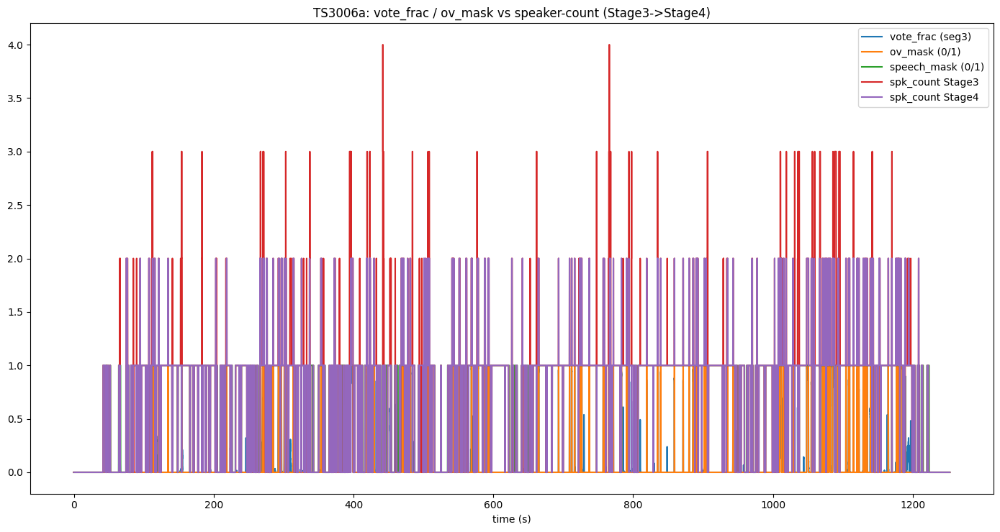

In [ ]:
# Plot why Stage4 collapses: vote_frac vs spk_count3 vs spk_count4

plot_debug_tracks(
    uem_seg, res,
    tracks=[
        {"name": "vote_frac (seg3)", "y": vote_frac},
        {"name": "ov_mask (0/1)", "y": ov_mask.astype(int)},
        {"name": "speech_mask (0/1)", "y": speech_mask.astype(int)},
        {"name": "spk_count Stage3", "y": c3},
        {"name": "spk_count Stage4", "y": c4},
    ],
    title=f"{DEBUG_URI}: vote_frac / ov_mask vs speaker-count (Stage3->Stage4)"
)


In [ ]:
#Listen to the worst segment (longest collapsed_outside_ov)

from IPython.display import Audio as IPAudio, display
from pyannote.audio import Audio as PyannoteAudio

audio = PyannoteAudio(sample_rate=16000, mono=True)

segs = mask_to_segments(collapsed_outside_ov, uem_seg, res, min_dur=0.30)
segs = sorted(segs, key=lambda s: s.duration, reverse=True)

if not segs:
    print("No collapsed_outside_ov segments >= 0.30s")
else:
    s = segs[0]
    print(f"Listening segment: {float(s.start):.2f}-{float(s.end):.2f} (dur={s.duration:.2f}s)")
    wav, sr = audio.crop(f, s, mode="pad")
    wav = np.asarray(wav).squeeze()
    display(IPAudio(wav, rate=sr))


Listening segment: 309.04-311.24 (dur=2.20s)


In [ ]:
#Quick sweep: find safer thresholds (no code changes, just config)

#ower ov_vote_thr and/or lower seg3 activity_thr.

def run_stage4_with_params(file, hyp3, ov_vote_thr, seg3_thr):
    cfg = Stage4Config(ov_vote_thr=float(ov_vote_thr), seg3_thr=float(seg3_thr))
    out, dbg = STAGE4_OVERLAP_SANITY(file, hyp3, cfg=cfg, debug=False, return_debug=True)
    return out, dbg

DEBUG_URI = "TS3006a"
f = next(ff for ff in dev_files if str(ff.get("uri")) == DEBUG_URI)

hyp3 = run_stage3(f, start_from_promoted=True)
ref = _get_ref_annotation(f)

cands_ov_vote = [0.35, 0.45, 0.55, 0.60]
cands_seg3thr = [0.35, 0.40, 0.50]

print("ov_vote_thr | seg3_thr | ov_mask_sec | (if ref) ov_recall%")
for ovv in cands_ov_vote:
    for s3t in cands_seg3thr:
        _, dbg = run_stage4_with_params(f, hyp3, ovv, s3t)
        ov_mask = np.asarray(dbg["ov_mask"]).astype(bool)
        uem_seg = dbg["uem_seg"]; res = float(dbg["res"]); T = int(dbg["T"])
        ov_mask = ov_mask[:T]
        ov_sec = secs(ov_mask, res)

        ov_rec = None
        if ref is not None:
            labels_ref = sorted([str(x) for x in ref.labels()])
            Mr = frame_matrix_from_annotation(ref, uem_seg=uem_seg, labels=labels_ref, res=res)
            Mr = (np.asarray(Mr) > 0).astype(np.uint8)[:T]
            true_overlap = (Mr.sum(axis=1) >= 2)
            ov_rec = 100.0 * (np.sum(ov_mask & true_overlap) / max(np.sum(true_overlap), 1))

        if ov_rec is None:
            print(f"{ovv:8.2f} | {s3t:7.2f} | {ov_sec:10.2f} | (no ref)")
        else:
            print(f"{ovv:8.2f} | {s3t:7.2f} | {ov_sec:10.2f} | {ov_rec:8.1f}%")


ov_vote_thr | seg3_thr | ov_mask_sec | (if ref) ov_recall%
    0.35 |    0.35 |     117.66 |     65.2%
    0.35 |    0.40 |     117.66 |     65.2%
    0.35 |    0.50 |     117.66 |     65.2%
    0.45 |    0.35 |     111.44 |     63.0%
    0.45 |    0.40 |     111.44 |     63.0%
    0.45 |    0.50 |     111.44 |     63.0%
    0.55 |    0.35 |     104.88 |     60.0%
    0.55 |    0.40 |     104.88 |     60.0%
    0.55 |    0.50 |     104.88 |     60.0%
    0.60 |    0.35 |     100.60 |     58.1%
    0.60 |    0.40 |     100.60 |     58.1%
    0.60 |    0.50 |     100.60 |     58.1%


In [ ]:
import numpy as np

DEBUG_URI = "TS3006a"
f = next(ff for ff in dev_files if str(ff.get("uri")) == DEBUG_URI)

# get UEM grid
uem_tl = _get_uem_full(f)
uem_seg = uem_tl.extent()
res = float(RES)
T = int(np.ceil(float(uem_seg.duration) / float(res)))

# run hyps
hyp3 = run_stage3(f, start_from_promoted=True)
hyp4 = run_stage4(f, start_from_promoted=True)

# speech mask
speech_tl = get_speech_timeline_pyvad(f, pad=0.25, merge_gap=0.10, min_on=0.20)
speech_mask = timeline_to_mask(speech_tl, uem_seg, res, T).astype(bool)

# ov_mask exactly like Stage4
vote_frac = seg3_vote_frac_on_res_grid(f, uem_seg, res=res, activity_thr=float(globals().get("SEG3_ACTIVITY_THR", 0.5)))
ov_mask_raw = (np.asarray(vote_frac) >= 0.60)
ov_mask = ov_mask_raw  # if we use Stage4 smoothing, apply it here too

# matrices
labels_union = sorted(set([str(x) for x in hyp3.labels()]) | set([str(x) for x in hyp4.labels()]))

M3 = frame_matrix_from_annotation(hyp3, uem_seg=uem_seg, labels=labels_union, res=res)
M4 = frame_matrix_from_annotation(hyp4, uem_seg=uem_seg, labels=labels_union, res=res)
M3 = (np.asarray(M3) > 0).astype(np.uint8)[:T]
M4 = (np.asarray(M4) > 0).astype(np.uint8)[:T]

c3 = M3.sum(axis=1)
c4 = M4.sum(axis=1)

ref = f.get("annotation", None)
assert ref is not None, "No reference found in file['annotation']"

labels_ref = sorted([str(x) for x in ref.labels()])
Mr = frame_matrix_from_annotation(ref, uem_seg=uem_seg, labels=labels_ref, res=res)
Mr = (np.asarray(Mr) > 0).astype(np.uint8)[:T]
cr = Mr.sum(axis=1)

true_speech   = (cr >= 1)
true_overlap  = (cr >= 2)
true_3plus    = (cr >= 3)

# components
A_true_ov_to1 = true_overlap & (c4 == 1)                # overlap collapsed to single (miss contributor)
B_true_speech_to0 = true_speech & (c4 == 0)             # speech dropped entirely (miss contributor)

# where overlap was present in stage3 and got collapsed in stage4
C_ov3_to1 = (c3 >= 2) & (c4 == 1)
C_outside = C_ov3_to1 & (~ov_mask)
C_inside  = C_ov3_to1 & (ov_mask)

def sec(mask):
    return float(np.sum(mask)) * res

print(f"=== {DEBUG_URI} miss component accounting (frame-based) ===")
print(f"true_speech sec      : {sec(true_speech):.2f}")
print(f"true_overlap sec     : {sec(true_overlap):.2f}")
print(f"true_3plus sec       : {sec(true_3plus):.2f}")

print("\nMISS contributors (not DER-exact, but diagnostic):")
print(f"true_overlap -> 1spk : {sec(A_true_ov_to1):.2f} sec")
print(f"true_speech  -> 0spk : {sec(B_true_speech_to0):.2f} sec")

print("\nStage3 overlap collapsed to 1 speaker:")
print(f"total (anywhere)     : {sec(C_ov3_to1):.2f} sec")
print(f"outside ov_mask      : {sec(C_outside):.2f} sec")
print(f"inside  ov_mask      : {sec(C_inside):.2f} sec")


=== TS3006a miss component accounting (frame-based) ===
true_speech sec      : 923.08
true_overlap sec     : 152.32
true_3plus sec       : 17.96

MISS contributors (not DER-exact, but diagnostic):
true_overlap -> 1spk : 61.84 sec
true_speech  -> 0spk : 67.28 sec

Stage3 overlap collapsed to 1 speaker:
total (anywhere)     : 24.40 sec
outside ov_mask      : 22.24 sec
inside  ov_mask      : 2.16 sec


In [ ]:
lost_all = (true_speech & (c4 == 0) & speech_mask)
segs = mask_to_segments(lost_all, uem_seg, res, min_dur=0.20)
segs = sorted(segs, key=lambda s: s.duration, reverse=True)[:15]

print(f"Top segments where REF has speech but Stage4 has 0 speakers (dur>=0.2s): {len(segs)}")
for s in segs:
    a = int((s.start - uem_seg.start)/res)
    b = int((s.end   - uem_seg.start)/res)
    vf = vote_frac[a:b]
    print(f"  {float(s.start):.2f}-{float(s.end):.2f} dur={s.duration:.2f}s vote_mean={float(np.mean(vf)) if len(vf) else float('nan'):.3f}")


Top segments where REF has speech but Stage4 has 0 speakers (dur>=0.2s): 15
  338.56-341.06 dur=2.50s vote_mean=0.000
  1088.00-1090.32 dur=2.32s vote_mean=0.997
  584.28-586.40 dur=2.12s vote_mean=0.000
  394.38-396.36 dur=1.98s vote_mean=0.983
  382.74-384.58 dur=1.84s vote_mean=0.000
  251.70-253.50 dur=1.80s vote_mean=0.000
  595.96-597.76 dur=1.80s vote_mean=0.000
  445.44-447.18 dur=1.74s vote_mean=0.000
  1094.22-1095.96 dur=1.74s vote_mean=0.981
  405.96-407.62 dur=1.66s vote_mean=0.000
  508.62-510.26 dur=1.64s vote_mean=0.002
  511.44-512.76 dur=1.32s vote_mean=0.000
  461.90-463.16 dur=1.26s vote_mean=0.000
  441.96-443.12 dur=1.16s vote_mean=0.969
  45.56-46.62 dur=1.06s vote_mean=0.000


In [ ]:
# segments where TRUE overlap got collapsed to 1 speaker
mask = true_overlap & (c3 >= 2) & (c4 == 1)
segs = mask_to_segments(mask, uem_seg, res, min_dur=0.20)
segs = sorted(segs, key=lambda s: s.duration, reverse=True)[:20]

print("Collapsed TRUE overlap segments (with Stage3 activity stats):")
for s in segs:
    a = int((s.start - uem_seg.start)/res)
    b = int((s.end   - uem_seg.start)/res)
    frac = M3[a:b].mean(axis=0)  # binary mean activity per speaker
    top = np.argsort(-frac)[:4]
    vf = vote_frac[a:b]
    sec_frac = float(np.sort(frac)[-2]) if len(frac) >= 2 else 0.0
    print(
        f"  {float(s.start):.2f}-{float(s.end):.2f} dur={s.duration:.2f}s "
        f"vote_mean={float(np.mean(vf)):.3f} sec_frac={sec_frac:.3f} "
        f"top2=({labels_union[top[0]]}:{frac[top[0]]:.2f}, {labels_union[top[1]]}:{frac[top[1]]:.2f})"
    )


Collapsed TRUE overlap segments (with Stage3 activity stats):
  309.04-310.58 dur=1.54s vote_mean=0.157 sec_frac=1.000 top2=(0:1.00, MTD022ID:1.00)
  152.64-153.88 dur=1.24s vote_mean=0.016 sec_frac=1.000 top2=(MTD021PM:1.00, MTD023UID:1.00)
  1035.96-1036.78 dur=0.82s vote_mean=0.311 sec_frac=1.000 top2=(MTD024ME:1.00, MTD022ID:1.00)
  1138.94-1139.54 dur=0.60s vote_mean=0.558 sec_frac=1.000 top2=(MTD021PM:1.00, MTD022ID:1.00)
  1012.22-1012.66 dur=0.44s vote_mean=0.453 sec_frac=1.000 top2=(MTD021PM:1.00, MTD024ME:1.00)
  443.12-443.54 dur=0.42s vote_mean=0.033 sec_frac=1.000 top2=(MTD021PM:1.00, MTD024ME:1.00)
  373.56-373.92 dur=0.36s vote_mean=0.124 sec_frac=1.000 top2=(0:1.00, MTD024ME:1.00)
  494.16-494.52 dur=0.36s vote_mean=0.520 sec_frac=1.000 top2=(MTD021PM:1.00, MTD024ME:1.00)
  1056.48-1056.84 dur=0.36s vote_mean=0.110 sec_frac=1.000 top2=(MTD021PM:1.00, MTD022ID:1.00)
  432.52-432.86 dur=0.34s vote_mean=0.445 sec_frac=1.000 top2=(MTD023UID:1.00, MTD022ID:1.00)
  203.20-203

vote_frac stats: true_overlap mean=0.604 p50=0.839 | true_single mean=0.021 p50=0.000


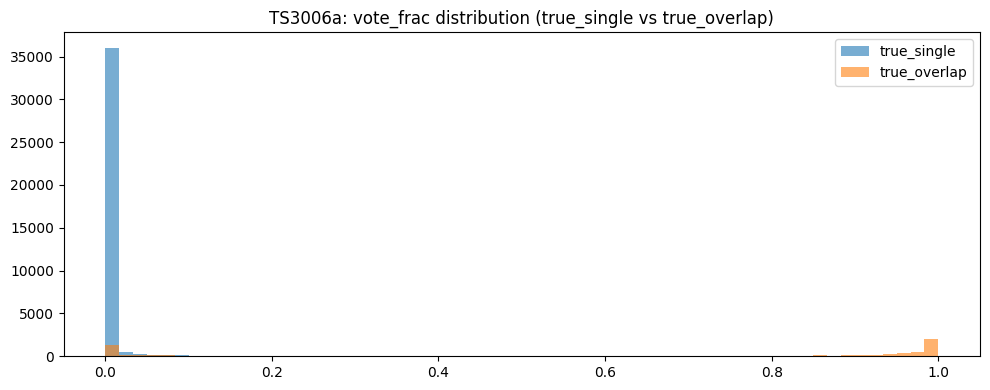

In [ ]:
vf = np.asarray(vote_frac)[:T]
vf = vf[np.isfinite(vf)]

# distributions
vf_ov  = np.asarray(vote_frac)[true_overlap & np.isfinite(vote_frac)]
vf_sgl = np.asarray(vote_frac)[(true_speech & ~true_overlap) & np.isfinite(vote_frac)]

print(f"vote_frac stats: true_overlap mean={vf_ov.mean():.3f} p50={np.median(vf_ov):.3f} | "
      f"true_single mean={vf_sgl.mean():.3f} p50={np.median(vf_sgl):.3f}")

import matplotlib.pyplot as plt
plt.figure(figsize=(10,4))
plt.hist(vf_sgl, bins=60, alpha=0.6, label="true_single")
plt.hist(vf_ov,  bins=60, alpha=0.6, label="true_overlap")
plt.title(f"{DEBUG_URI}: vote_frac distribution (true_single vs true_overlap)")
plt.legend()
plt.tight_lawet()
plt.show()


# Task
Update `STAGE1_PYVAD`'s function signature to accept `vad_pad`, `vad_gap`, and `vad_min_on` instead of `pad`, `merge_gap`, and `min_on`, and update the internal usage of these parameters within the function accordingly. Then, confirm that calls to `STAGE1_PYVAD` no longer produce unexpected keyword argument errors and all subsequent stages run as expected.

## Update STAGE1_PYVAD Signature

### Subtask:
Modify the function signature of `STAGE1_PYVAD` to accept `vad_pad`, `vad_gap`, and `vad_min_on` as its parameters, replacing the current `pad`, `merge_gap`, and `min_on`.


**Reasoning**:
The subtask requires modifying the function signature of `STAGE1_PYVAD` to use `vad_pad`, `vad_gap`, and `vad_min_on` as its parameters. I will update the function definition accordingly.



# Task
```python
def STAGE1_PYVAD(file, base_fn=None, vad_pad=VAD_PAD, vad_gap=VAD_MERGE_GAP, vad_min_on=VAD_MIN_ON):
    init_models()
    if base_fn is None:
        base_fn = PIPE_BASE

    hyp0 = _ensure_str_labels(base_fn(file))   # ✅ normalize

    # Use the new parameter names here
    speech_tl = get_speech_timeline_pyvad(file, pad=vad_pad, merge_gap=vad_gap, min_on=vad_min_on)
    if speech_tl is None or len(list(speech_tl.support())) == 0:
        return hyp0

    hyp1 = apply_vad_mask_to_diarization(hyp0, speech_tl)
    return _ensure_str_labels(hyp1)            # ✅ normalize

```

The `STAGE1_PYVAD` function signature has been updated to accept `vad_pad`, `vad_gap`, and `vad_min_on` as its parameters, and these new parameter names are used internally.

Next, I will run the benchmark tests to confirm that the changes have been applied correctly and that all subsequent stages run as expected without keyword argument errors.

```python
clear_caches()
init_models()

print("\n=== STAGE1 (PyVAD) DEV ===")
_, s1 = eval_files_stages(lambda f: run_stage1(f), dev_files, max_files=None)
_print_summary("stage1 DEV", s1)

print("\n=== STAGE0 (promote ON) DEV ===")
_, s0 = eval_files_stages(lambda f: run_stage0(f, apply_promotion=True), dev_files, max_files=None)
_print_summary("stage0 DEV", s0)

print("\n=== STAGE2 (start_from_promoted=True) DEV ===")
_, s2 = eval_files_stages(lambda f: run_stage2(f, start_from_promoted=True), dev_files, max_files=None)
_print_summary("stage2 DEV", s2)

print("\n=== STAGE3 (start_from_promoted=True) DEV ===")
_, s3 = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), dev_files, max_files=None)
_print_summary("stage3 DEV", s3)

print("\n=== STAGE3 (start_from_promoted=True) TEST ===")
_, s3t = eval_files_stages(lambda f: run_stage3(f, start_from_promoted=True), test_files, max_files=None)
_print_summary("stage3 TEST", s3t)

```

## Update Centroid Function Call

### Subtask:
Locate the call to `_build_centroids_from_exclusive_anchors` inside the `STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0` function and change the argument `min_dur` to `min_anchor_dur`.


**Reasoning**:
I need to modify the `STAGE2_ANCHOR_CONSTRAINTS_GUIDED_BY_STAGE0` function to change a parameter name in a function call. I will redefine the function with the specified change.

